### Intended as a script which generates a .cvs report in one run

In [1]:
import tensorflow as tf;
import numpy as np;
import matplotlib.pyplot as plt;
print(tf.__version__);
import pandas as pd;

from sklearn.preprocessing import StandardScaler;
from sklearn.metrics import mean_squared_error;

2.3.0


In [2]:
pd.set_option('display.max_columns', 300);
pd.set_option('display.max_rows', 300);
tf.keras.backend.set_floatx('float64');

In [3]:
from tensorflow.python.client import device_lib

def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

get_available_gpus()

[]

In [4]:
MONTHS = 72;
SPLIT = 60; # 2014-2018: training, 2019: testing.
# BATCH_SIZE = 19; # used in NN_v1
BATCH_SIZE = 24;
WINDOW_SIZE = 12;

TEST_LENGTH = MONTHS - SPLIT;

### Data preparation

In [5]:
multi_data = pd.read_csv('../data/zri_acs_bikeshare_merged.csv', index_col = 0);
zip_ids = multi_data.index.unique();

multi_data.drop(["City", "State", "Metro", "CountyName", "year", "month", "datetime"],\
                 axis = 1, inplace = True);

multi_data.head()

,zri,percent_white,percent_black,percent_asian,percent_hispanic,percent_native_am,percent_other_race,percent_0_17,percent_18_39,percent_40_64,percent_65+,percent_rental_units_vacant,percent_rental_units_occupied,percent_graduate_deg,percent_bachelors,percent_associates,percent_highschool,percent_less_highschool,percent_commute_public_transport,percent_commute_less_30,percent_buildings_less_10_units,percent_buildings_10_19_units,percent_buildings_20_49_units,percent_buildings_50+_units,percent_commute_30_to_59,percent_commute_60_to_89,percent_commute_90_more,percent_new_city,percent_new_unit,percent_units_owner_occupied,median_building_age,income_per_capita,poverty_rate,total_pop,percent_workforce_unemployed,percent_work_from_home,median_age,percent_female,gini_index,percent_not_us_citizen,bs_total_stations,bs_total_systems,has_bike_sharing
zip,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1013,928.0,0.728315,0.020951,0.013732,0.219830,0.0,0.004959,0.230010,0.311464,0.309663,0.148864,0.068131,0.931869,0.028046,0.056892,0.259500,0.384872,0.225671,0.023499,0.741732,0.890613,0.030177,0.034856,0.044355,0.227721,0.017344,0.013031,0.108543,0.040940,0.443651,62.0,20475.25,0.191440,22343.583333,0.104130,0.009346,36.416667,0.509533,0.420742,0.056062,0.0,0.0,0
1013,931.0,0.727052,0.021179,0.013708,0.220867,0.0,0.004917,0.229526,0.311552,0.310406,0.148516,0.067207,0.932793,0.028179,0.057377,0.259450,0.384586,0.225073,0.023365,0.740587,0.889943,0.030154,0.035083,0.044820,0.227757,0.017701,0.013401,0.108828,0.040926,0.441963,62.0,20517.50,0.192359,22296.166667,0.104147,0.009839,36.433333,0.508816,0.420483,0.056165,0.0,0.0,0
1013,934.0,0.725788,0.021408,0.013685,0.221904,0.0,0.004874,0.229041,0.311641,0.311150,0.148168,0.066283,0.933717,0.028313,0.057863,0.259400,0.384301,0.224475,0.023230,0.739441,0.889273,0.030131,0.035311,0.045285,0.227792,0.018058,0.013771,0.109112,0.040912,0.440275,62.0,20559.75,0.193277,22248.750000,0.104165,0.010332,36.450000,0.508100,0.420225,0.056267,0.0,0.0,0
1013,929.0,0.724525,0.021636,0.013661,0.222940,0.0,0.004832,0.228557,0.311729,0.311894,0.147820,0.065359,0.934641,0.028446,0.058348,0.259350,0.384016,0.223877,0.023096,0.738295,0.888603,0.030108,0.035538,0.045750,0.227828,0.018415,0.014142,0.109397,0.040897,0.438587,62.0,20602.00,0.194196,22201.333333,0.104182,0.010825,36.466667,0.507383,0.419967,0.056370,0.0,0.0,0
1013,929.0,0.723261,0.021864,0.013638,0.223977,0.0,0.004789,0.228072,0.311818,0.312638,0.147472,0.064435,0.935565,0.028579,0.058833,0.259299,0.383730,0.223279,0.022961,0.737149,0.887934,0.030086,0.035766,0.046215,0.227864,0.018772,0.014512,0.109682,0.040883,0.436898,62.0,20644.25,0.195114,22153.916667,0.104199,0.011318,36.483333,0.506666,0.419708,0.056472,0.0,0.0,0


In [6]:
FEATURES = multi_data.shape[1] - 1;

### Utility functions

In [7]:
@tf.autograph.experimental.do_not_convert
def windowed_dataset(series, window_size, batch_size, shuffle_buffer):
    dataset = tf.data.Dataset.from_tensor_slices(series); #(43,)
    dataset = dataset.window(window_size + 1, shift=1, drop_remainder=True);
    dataset = dataset.flat_map(lambda window: window.batch(window_size + 1)); #(13,43)
    dataset = dataset.shuffle(shuffle_buffer)\
                     .map(lambda window: (window[:-1], window[-1][0]));
    dataset = dataset.batch(batch_size).prefetch(1);
    return dataset;

In [8]:
def plot_series(time, series, format="-", start=0, end=None):
    plt.plot(time[start:end], series[start:end], format)
    plt.xlabel("Time Frame")
    plt.ylabel("ZRI")
    plt.grid(True)

### Neural network center

In [9]:
class myCallbacks(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        mse = logs.get("mse");
        if(mse < 0.005):
            print("\nGot an mse at {:.4f} in round {} and stopped training\n".format(mse, epoch));
            self.model.stop_training = True;

In [10]:
def NN_model(dataset, test = None):
    tf.keras.backend.clear_session();
    # dataset = windowed_dataset(x_train, window_size, batch_size, shuffle_buffer_size)

    callback = myCallbacks();
    
    model = tf.keras.models.Sequential([
#         tf.keras.layers.Lambda(lambda x: tf.expand_dims(x, axis=-1),
#                           input_shape=[None]),
#       tf.keras.layers.Conv1D(filters=32, kernel_size=3,
#                           strides=1, padding="causal",
#                           activation="relu",
#                           input_shape=[None, WINDOW_SIZE, FEATURES+1]),
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True, input_shape = [None, WINDOW_SIZE, FEATURES+1])),
        #tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True)),
        # tf.keras.layers.SimpleRNN(8, return_sequences=True),
        #  tf.keras.layers.SimpleRNN(16, return_sequences=True),
        tf.keras.layers.Dense(8, activation="relu"),
    #   tf.keras.layers.Dense(16, activation="relu"),
        tf.keras.layers.Dense(1)
        # tf.keras.layers.Lambda(lambda x: x * 2.0)
    ]);
    
    optimizer = tf.keras.optimizers.SGD(learning_rate=3e-4, momentum=0.9)
    model.compile(loss=tf.keras.losses.Huber(),
                  optimizer="adam",
                  metrics=["mae", "mse"])

    model.build((None,12,43))
    # model.summary()

    if not test: history = model.fit(dataset, epochs=500, callbacks = [callback], verbose = 0);
    else: history = model.fit(dataset, epochs=500, validation_data=test,\
                              callbacks=[callback], verbose = 0);
    return model;

In [11]:
def NN_forecast(model, series_transformed):
    forecast = []
    results = []
    for time in range(MONTHS - WINDOW_SIZE):
        forecast.append(model.predict(series_transformed[np.newaxis, time:time + WINDOW_SIZE, :]))

    results = [float(x[0][0]) for x in forecast];
    timeline = range(WINDOW_SIZE, MONTHS);
    time_test = range(SPLIT, MONTHS);
    actual = list(series_transformed[WINDOW_SIZE:, 0]);

    forecast = series_transformed[SPLIT - WINDOW_SIZE:,:].copy();

    for time in range(TEST_LENGTH): # Change temp[time + WINDOW_SIZE]
        forecast[time + WINDOW_SIZE, 0] =\
        model.predict(forecast[np.newaxis, time:time + WINDOW_SIZE, :])[0][0];

    pure_forecast = forecast[WINDOW_SIZE:,0];
    
    print(len(results), len(actual), len(pure_forecast))
    
    return results, actual, pure_forecast;

In [12]:
@tf.autograph.experimental.do_not_convert
def NN_test(ZONE, plot=False):
    '''
    Input: ZONE
    Output: the RMSE of a NN model on the predicted train, partially predicted test, and complete predicted test.
    '''
    # Collection of data
    series_frame = multi_data[multi_data.index == ZONE];
    # series_frame.sort_values("datetime", ascending = True, inplace = True);
    
    # Standardization
    scaler = StandardScaler();
    series_transformed = scaler.fit_transform(series_frame);
    
    # Train test split
    series_train = series_transformed[:SPLIT];
    series_test = series_transformed[SPLIT-WINDOW_SIZE:];
    
    # Window the training set to make input of the NN
    dataset_train = windowed_dataset(series_train, WINDOW_SIZE, BATCH_SIZE, 60);
    # dataset_test = windowed_dataset(series_test, WINDOW_SIZE, BATCH_SIZE, 60);
    
    model = NN_model(dataset_train);
    
    time_train = list(range(SPLIT));
    time_test = list(range(SPLIT, MONTHS));
    
    # Forecasting
    results, actual, pure_forecast = NN_forecast(model, series_transformed);
    
    # Compute MSE
    MSE_train = mean_squared_error(actual[:-TEST_LENGTH], results[:-TEST_LENGTH])**0.5 * scaler.var_[0]**0.5;
    MSE_test = mean_squared_error(actual[-TEST_LENGTH:], results[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    MSE_pure = mean_squared_error(actual[-TEST_LENGTH:], pure_forecast[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    
    if plot: # If the plot option is selected, plot the graph.
        time_actual = range(WINDOW_SIZE, MONTHS);
        plt.figure(figsize=(10, 6))
        plot_series(time_actual, actual);
        plot_series(time_actual, results);
        plot_series(time_test, pure_forecast);
        plt.show();

    return MSE_train, MSE_test, MSE_pure,\
        np.array(pure_forecast[-TEST_LENGTH:]) * scaler.var_[0]**0.5 + scaler.mean_[0];

### The script


Got an mse at 0.0050 in round 124 and stopped training

60 60 12


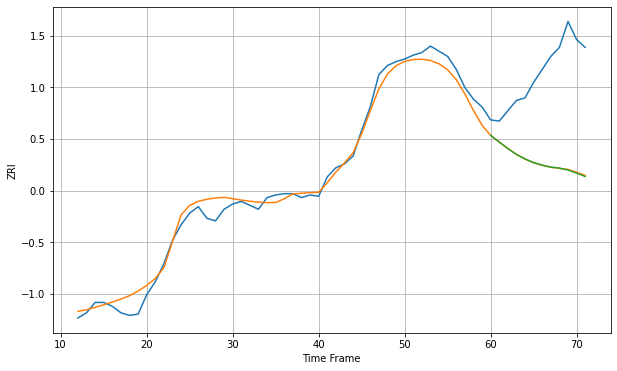

Wall time: 8.54 s
1013 7.3816460902949474 73.01008001644304 73.19235257886481 [1087.05569758 1081.85841331 1076.88908934 1072.34504564 1068.7818997
 1065.97882403 1064.02300947 1062.54118427 1061.76212988 1060.26396948
 1057.82387553 1055.2768892 ]

Got an mse at 0.0050 in round 132 and stopped training

60 60 12


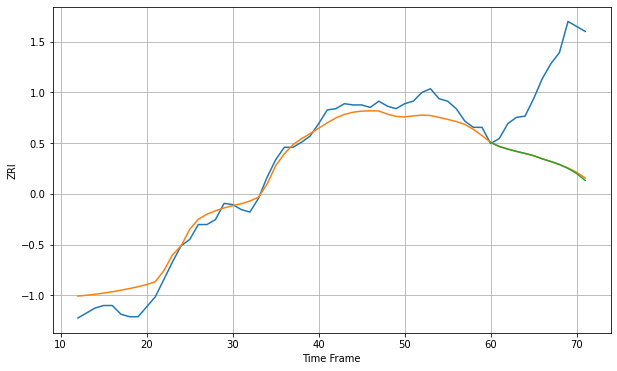

Wall time: 8.76 s
1020 10.586568803608772 72.97492443418034 73.41851002215668 [1115.96590934 1112.64089557 1110.57887675 1108.69820562 1107.09726029
 1105.25437229 1102.75176702 1100.59346051 1098.14806302 1095.08116886
 1090.96614857 1085.38778761]

Got an mse at 0.0050 in round 210 and stopped training

60 60 12


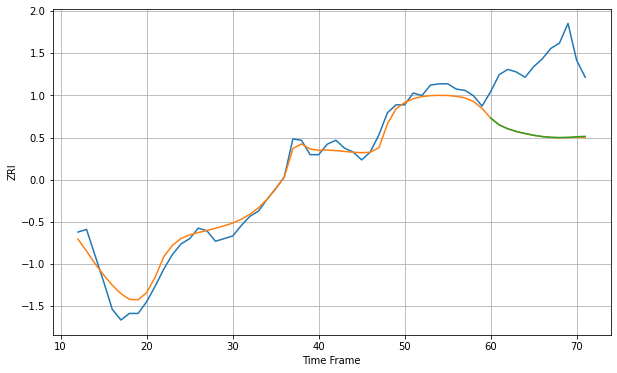

Wall time: 10.3 s
1040 7.41531082617445 55.51377846315967 55.37128086642829 [1091.91275673 1086.67078555 1083.72708341 1081.64710589 1080.13376615
 1078.77826914 1077.82026012 1077.21764462 1077.0226187  1077.17533809
 1077.66136483 1077.95976514]

Got an mse at 0.0050 in round 185 and stopped training

60 60 12


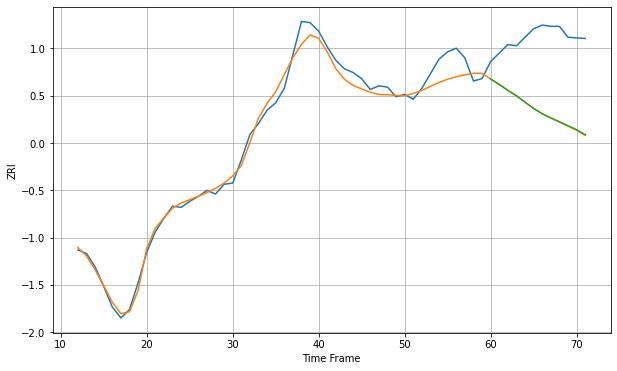

Wall time: 9.55 s
1085 8.211525202156105 61.78670201574384 61.64078553380826 [1157.63877136 1153.18500376 1148.34732357 1143.85738823 1138.53883827
 1133.45833101 1128.99611639 1125.57758471 1122.47651117 1119.17871142
 1115.93465587 1111.87335285]

Got an mse at 0.0050 in round 157 and stopped training

60 60 12


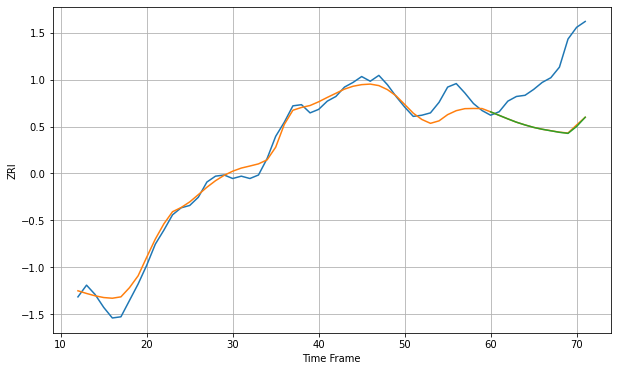

Wall time: 9.34 s
1104 8.347810032605212 49.31359540886995 49.55864093304409 [1115.87162803 1112.85878763 1109.88280184 1107.0507501  1104.70259467
 1102.62126342 1101.00950323 1099.73004932 1098.4269391  1097.50100975
 1103.39500852 1111.26330505]

Got an mse at 0.0049 in round 116 and stopped training

60 60 12


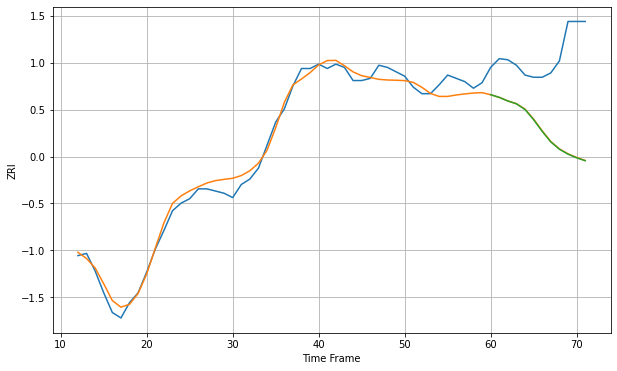

Wall time: 8.02 s
1108 7.873689366118387 74.15329838968879 74.40109445308617 [1173.06772133 1170.61650215 1167.29819944 1164.72549966 1159.49725954
 1150.24116341 1139.51318008 1129.88681738 1123.2347409  1118.71935148
 1115.36455808 1112.74418564]

Got an mse at 0.0050 in round 120 and stopped training

60 60 12


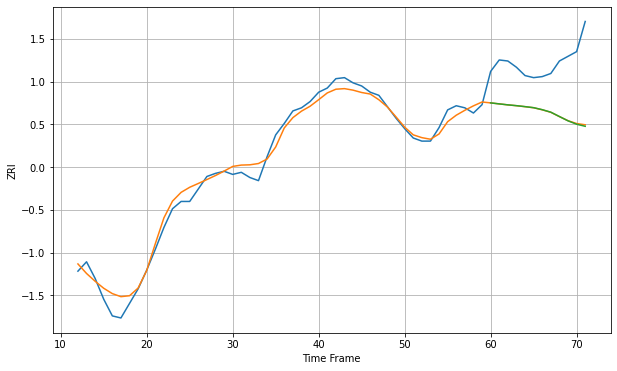

Wall time: 8.13 s
1109 8.15233364981599 51.08226515091966 51.37262017635822 [1158.73614383 1157.77440415 1156.84687819 1156.06786287 1155.14824999
 1154.13618439 1152.20873649 1149.80380049 1145.63434267 1141.48782834
 1138.23102015 1136.2509008 ]

Got an mse at 0.0049 in round 91 and stopped training

60 60 12


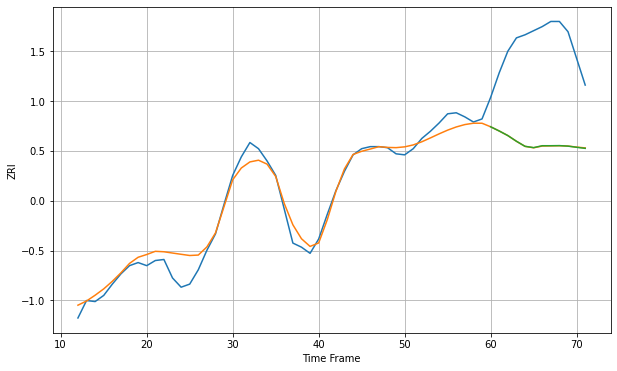

Wall time: 7.2 s
1420 10.30045163180335 96.77223323051209 96.73547692964843 [1223.3519578  1219.23356637 1214.78553141 1209.23330554 1204.31122308
 1203.03872799 1204.88140146 1204.88673855 1204.99617399 1204.50345463
 1203.35714205 1202.32356246]

Got an mse at 0.0049 in round 116 and stopped training

60 60 12


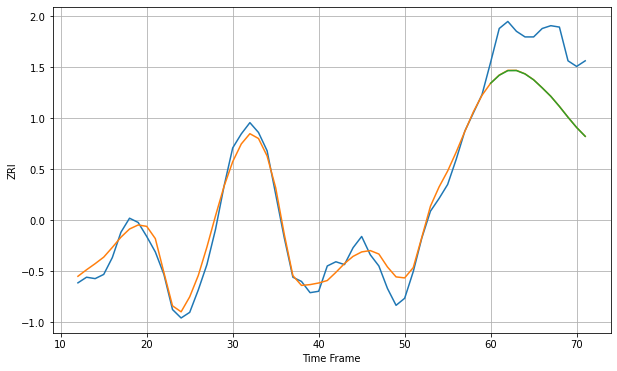

Wall time: 7.83 s
1440 7.77173844489532 39.584510384651885 39.63845713855108 [1200.0509178  1205.71741517 1208.99840028 1209.07472772 1206.65425671
 1202.46804976 1196.74216422 1190.70936428 1183.52251397 1175.83552246
 1168.55655878 1162.26961833]

Got an mse at 0.0050 in round 73 and stopped training

60 60 12


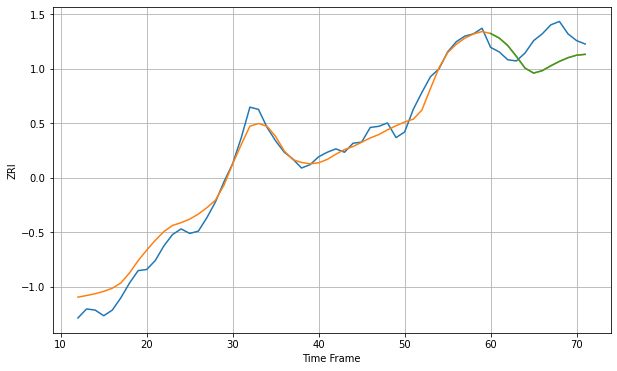

Wall time: 6.82 s
1453 9.852435248917914 22.016812838575543 22.028910026387315 [1331.33143874 1327.31815957 1320.58637512 1310.9840778  1300.67246028
 1296.23323291 1298.33951278 1302.7003732  1306.57323762 1309.82911859
 1312.06541099 1312.77516764]

Got an mse at 0.0050 in round 198 and stopped training

60 60 12


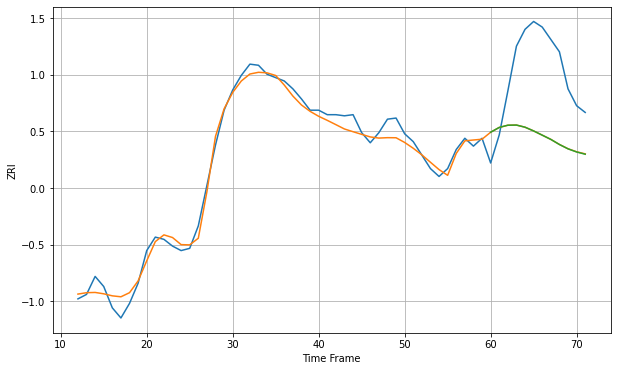

Wall time: 9.6 s
1545 7.737197286128096 66.84236207755494 66.87801464694138 [1528.36989635 1532.64754891 1534.62259491 1534.76362574 1532.85576963
 1529.52868901 1525.77266079 1521.9942694  1517.45777442 1513.59686246
 1510.80820478 1508.79223691]

Got an mse at 0.0050 in round 138 and stopped training

60 60 12


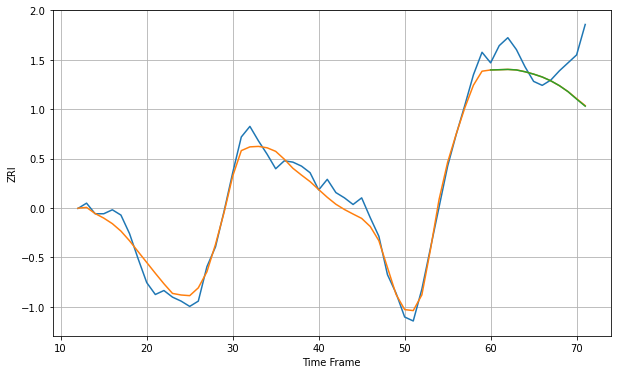

Wall time: 8.6 s
1550 7.755611219709769 23.636823854230823 23.766556549463456 [1227.63578178 1227.81302339 1228.04022672 1227.64483386 1226.27643379
 1224.48577261 1222.32469388 1219.4191679  1215.76229692 1211.238912
 1205.6116644  1200.27570929]

Got an mse at 0.0050 in round 122 and stopped training

60 60 12


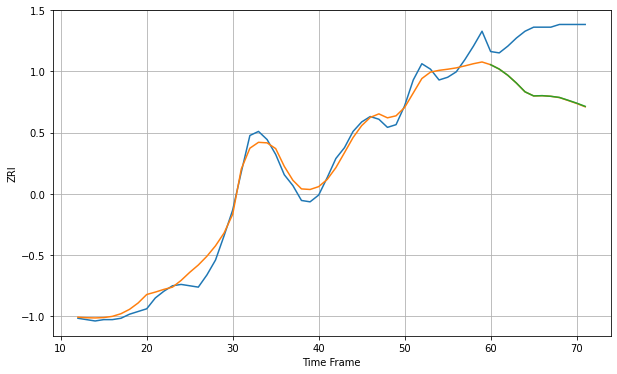

Wall time: 8.33 s
1602 7.286246892369886 45.39772949335554 45.295999732589955 [1380.28198057 1377.04452667 1372.454616   1366.71193228 1360.25843186
 1357.23203455 1357.40958227 1356.94955719 1356.11328722 1354.0628825
 1351.91352537 1349.50579319]

Got an mse at 0.0049 in round 154 and stopped training

60 60 12


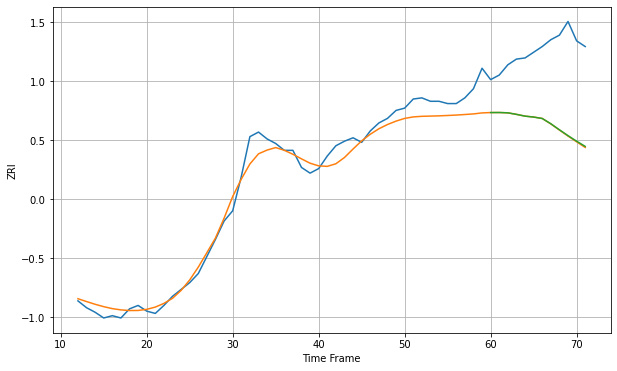

Wall time: 8.82 s
1603 11.082693244323012 67.07208940138968 66.82600404560587 [1272.12364901 1272.16578579 1271.88491331 1270.53946817 1268.98150645
 1268.16593858 1266.92185076 1262.33196138 1257.01737707 1251.86855176
 1247.02678804 1242.45569033]

Got an mse at 0.0050 in round 81 and stopped training

60 60 12


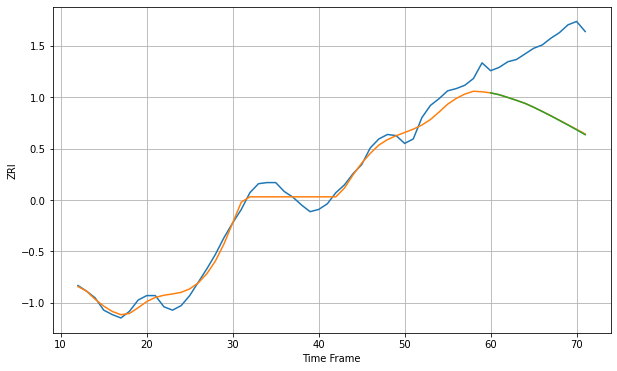

Wall time: 7.18 s
1604 8.324123782821626 63.3523480409137 63.554625783607285 [1324.17991921 1322.50190705 1320.06884332 1317.50808875 1314.80896992
 1311.35890812 1307.55749074 1303.64533367 1299.56057624 1295.41118596
 1291.17253294 1286.78197319]

Got an mse at 0.0048 in round 35 and stopped training

60 60 12


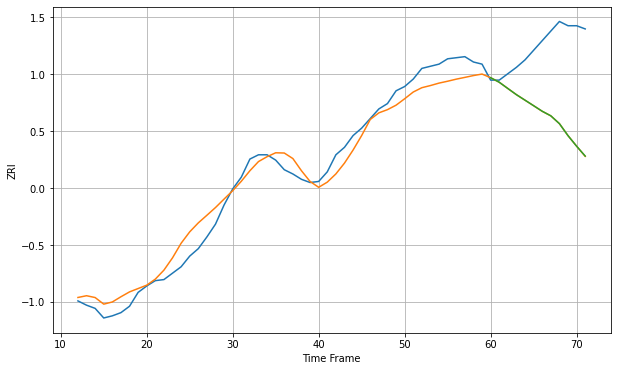

Wall time: 6.08 s
1605 12.990790982892864 72.18006478999976 72.14007295132875 [1301.25823369 1297.02350351 1291.15201607 1285.35822516 1280.19500467
 1275.0295589  1269.81491959 1265.53116429 1258.18443249 1246.94075746
 1237.03910963 1227.81900432]

Got an mse at 0.0050 in round 111 and stopped training

60 60 12


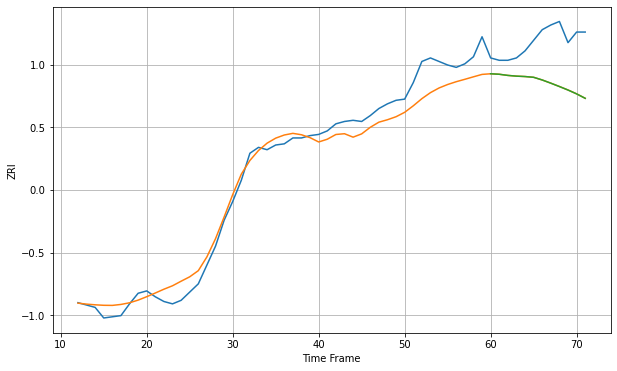

Wall time: 8.22 s
1610 12.614830180817355 37.702327522867854 37.72377661140666 [1306.55288436 1306.12850658 1305.15519166 1304.52924209 1304.19065833
 1303.53789256 1301.27123486 1298.55279382 1295.6938273  1292.72518656
 1289.45439574 1285.67282971]

Got an mse at 0.0049 in round 393 and stopped training

60 60 12


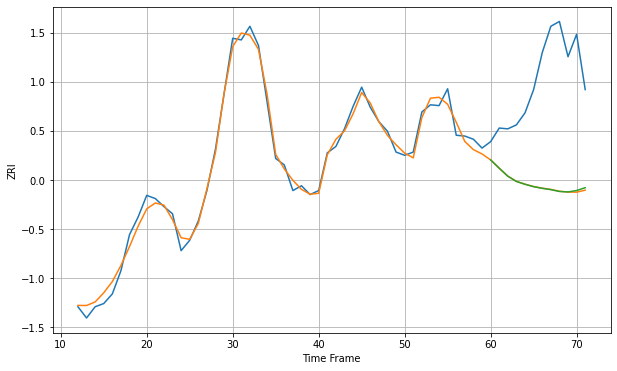

Wall time: 16.3 s
1702 9.107664312849288 139.05618483161155 138.68516333952476 [2254.25619736 2243.86381403 2233.9011859  2227.35298281 2223.80776245
 2220.8335246  2218.772539   2217.17243501 2214.86278433 2214.2588047
 2216.0637554  2219.55737151]

Got an mse at 0.0049 in round 137 and stopped training

60 60 12


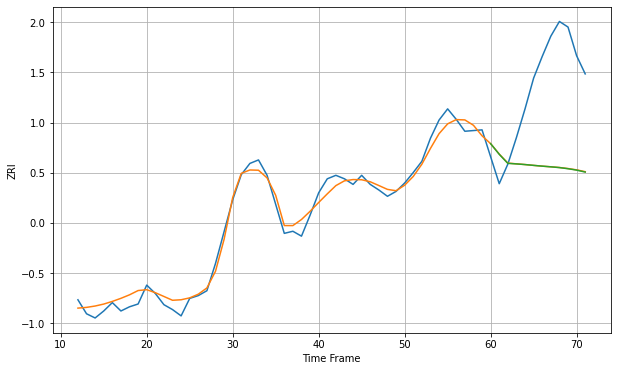

Wall time: 9.53 s
1752 11.792989502991986 134.07345146815456 134.20824305329887 [2047.25451876 2032.04664962 2019.06788339 2018.32322438 2017.36744433
 2016.21144088 2015.10306291 2014.130902   2013.05232623 2011.43214373
 2009.42645667 2006.63444291]

Got an mse at 0.0049 in round 234 and stopped training

60 60 12


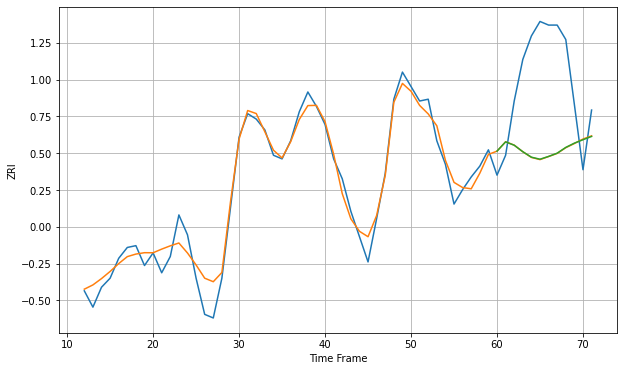

Wall time: 13 s
1757 7.251398498183739 48.85689290491785 48.761581517464364 [1455.28067361 1460.40580849 1458.55267127 1454.95732607 1451.93831722
 1450.80852252 1452.35977093 1454.15213939 1457.34708649 1459.71029753
 1461.58270896 1463.40847087]

Got an mse at 0.0049 in round 408 and stopped training

60 60 12


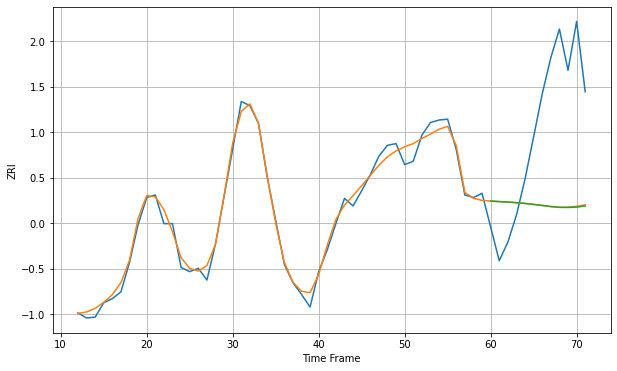

Wall time: 15.8 s
1760 8.89568901731554 129.64861324653373 129.962119954931 [2285.77789642 2285.15440488 2284.5984662  2283.88466748 2282.94771413
 2281.82520289 2280.55653681 2279.25202516 2278.30860233 2278.18737266
 2278.61321259 2279.92323855]

Got an mse at 0.0050 in round 186 and stopped training

60 60 12


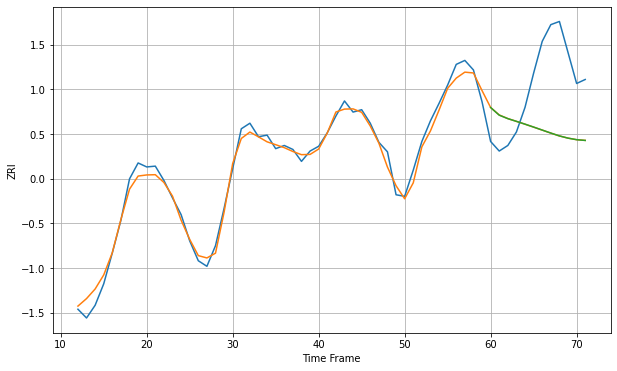

Wall time: 10.4 s
1801 9.808330713164795 83.95433894044307 83.92018517903938 [2245.73804588 2236.1121412  2231.74685528 2228.33524759 2224.80356083
 2221.14863583 2217.38827504 2213.6107218  2210.01901421 2207.24175813
 2205.27565959 2204.3433594 ]

Got an mse at 0.0050 in round 199 and stopped training

60 60 12


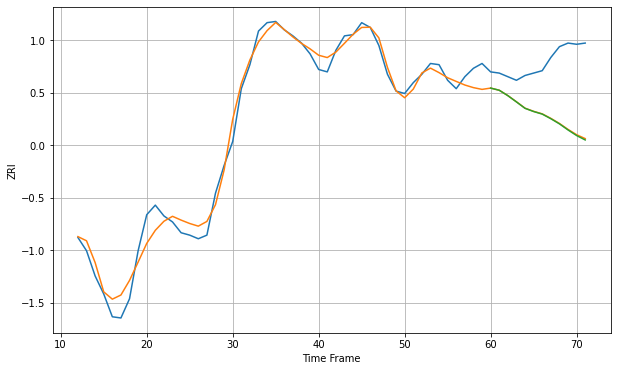

Wall time: 11.2 s
1830 9.735327873020939 48.16770130233422 48.56707584600789 [1612.50990829 1610.6942964  1606.20964053 1600.9835799  1595.64588801
 1592.97076191 1590.84208891 1587.00198969 1582.71402816 1577.63342391
 1572.9764388  1569.29642382]

Got an mse at 0.0048 in round 164 and stopped training

60 60 12


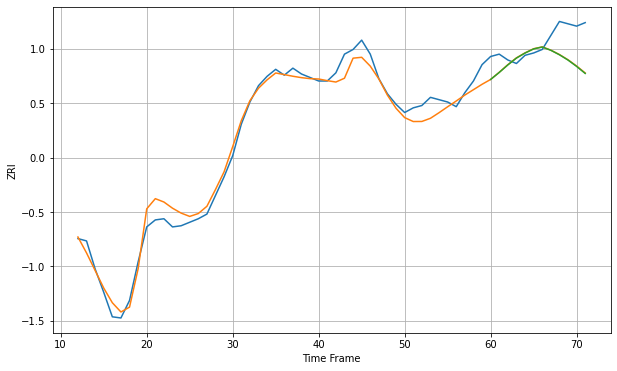

Wall time: 9.98 s
1832 8.957648157153379 21.65796883656819 21.82495392761577 [1567.33535913 1573.32988351 1579.76521672 1585.6305207  1589.92877511
 1593.48175226 1595.10896213 1592.31223141 1588.48468948 1583.93844453
 1578.50127863 1572.46906043]

Got an mse at 0.0050 in round 225 and stopped training

60 60 12


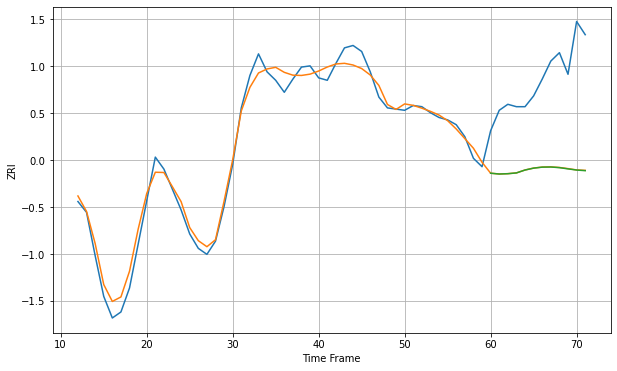

Wall time: 11.2 s
1841 8.18421030602382 78.19435461487865 78.29558137997142 [1556.59058394 1555.91688239 1556.18363393 1556.83183116 1559.24248623
 1560.82508691 1561.64407275 1561.75952821 1561.22855465 1560.20169177
 1559.2295348  1558.72090187]

Got an mse at 0.0050 in round 346 and stopped training

60 60 12


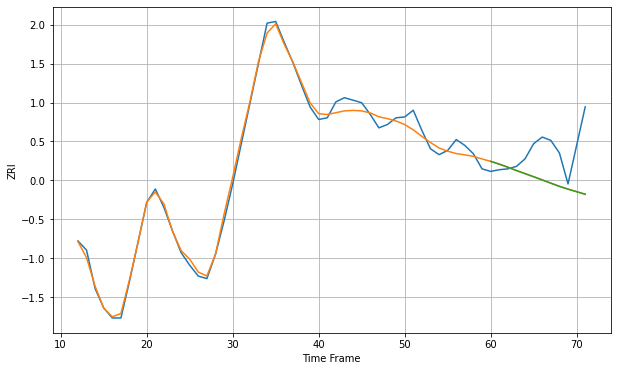

Wall time: 14.7 s
1843 7.8160429125370285 43.61068467746783 43.66665786181886 [1684.00830472 1680.66880809 1676.96704904 1673.04071329 1669.30691161
 1665.62290904 1661.82324226 1657.94440314 1654.11988444 1650.83197397
 1647.72876566 1644.63776912]

Got an mse at 0.0049 in round 179 and stopped training

60 60 12


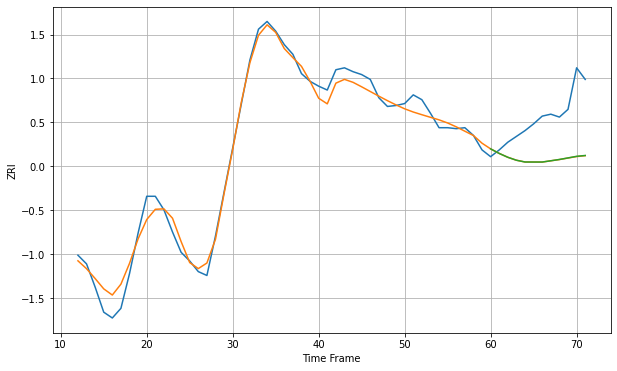

Wall time: 11 s
1844 10.632045438297547 47.69342444784036 47.60184718564134 [1675.08307965 1670.35128277 1666.36851162 1663.32088301 1661.49208488
 1661.46265951 1661.45139006 1662.76622553 1664.11245405 1665.72783838
 1667.37228466 1668.24214059]

Got an mse at 0.0049 in round 164 and stopped training

60 60 12


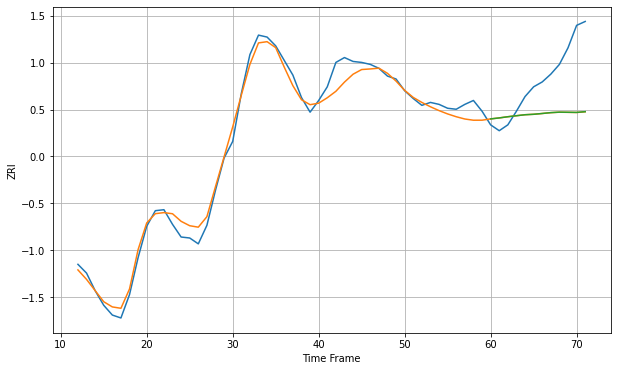

Wall time: 11.9 s
1845 9.935046542905784 47.7676896181055 47.719252831985045 [1800.09896138 1801.10576055 1802.32017784 1803.35459456 1804.3746694
 1804.83638996 1805.66132101 1806.53816563 1807.02042679 1806.89833321
 1806.77055874 1807.52123964]

Got an mse at 0.0050 in round 144 and stopped training

60 60 12


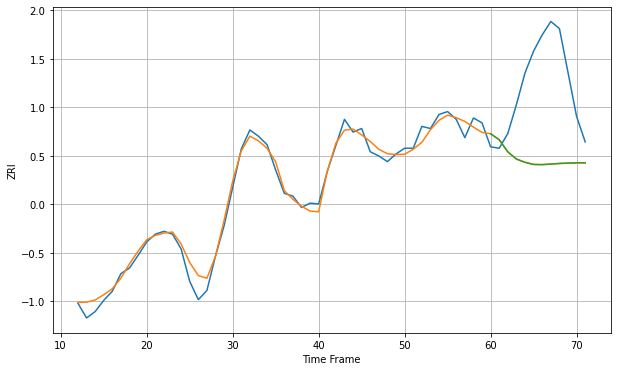

Wall time: 9.79 s
1850 11.459522338054674 123.34256215526777 123.38835544395342 [1983.57994253 1975.11630863 1957.8722939  1947.67777569 1942.94392038
 1939.88691066 1939.6542654  1940.49624473 1941.38373728 1941.87977008
 1942.31146424 1942.40105728]

Got an mse at 0.0050 in round 225 and stopped training

60 60 12


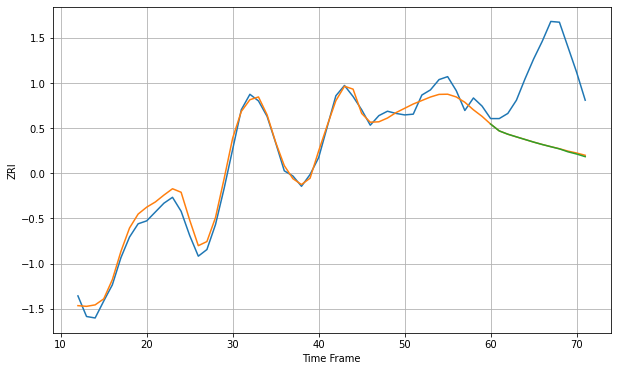

Wall time: 11.4 s
1851 11.65330356884152 107.60711547266972 107.97526259991658 [1977.51692005 1968.25856017 1963.76307685 1960.15285744 1956.60045659
 1953.04855135 1949.77908553 1946.77281885 1943.84151158 1939.82033153
 1936.84705123 1933.253271  ]

Got an mse at 0.0050 in round 142 and stopped training

60 60 12


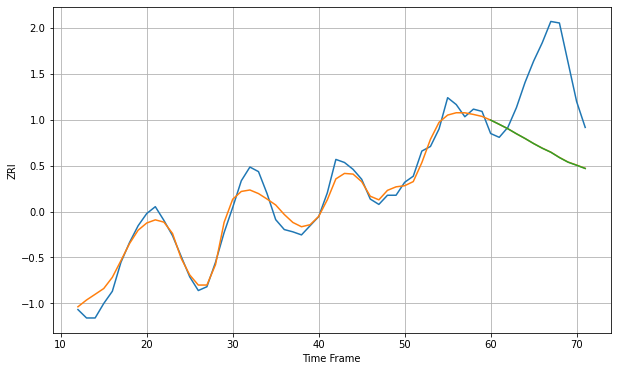

Wall time: 9.43 s
1852 13.359379160814322 102.26239175083634 102.33368879493075 [1982.63106631 1977.05187334 1971.2949481  1964.6852843  1958.49047372
 1951.8195905  1945.74885288 1940.46917565 1933.46954289 1927.42854747
 1923.36969733 1919.10595365]

Got an mse at 0.0050 in round 151 and stopped training

60 60 12


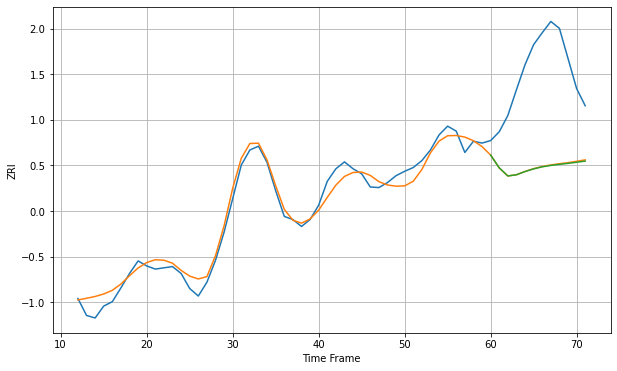

Wall time: 9.91 s
1854 14.682905794352415 156.18307100281322 156.79470217083284 [1988.86530505 1968.48543916 1955.57888667 1957.3887849  1962.55754091
 1966.84194764 1970.11254388 1972.37774709 1974.08271696 1975.62361692
 1977.39056107 1979.22224483]

Got an mse at 0.0048 in round 143 and stopped training

60 60 12


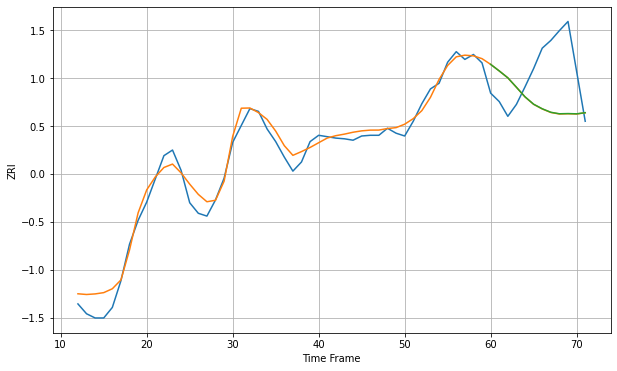

Wall time: 10.2 s
1876 14.842155662254536 72.53416977403303 72.36978245725 [2191.95124303 2182.60264375 2172.80433538 2159.38490948 2145.72199829
 2135.22691932 2128.73482575 2123.76328227 2121.6289821  2121.91269316
 2121.55321911 2123.12864844]

Got an mse at 0.0049 in round 312 and stopped training

60 60 12


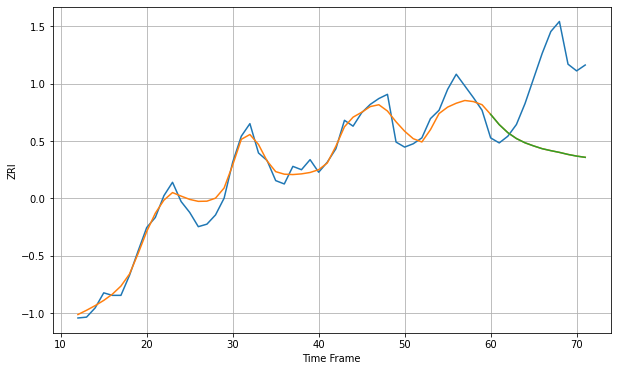

Wall time: 20.1 s
1880 12.749724126612197 92.19183353678686 92.19232101377695 [2205.11346057 2192.85754514 2183.25433449 2176.21176348 2171.13967107
 2167.42221244 2164.09592321 2161.77645777 2159.69616897 2157.25158959
 2155.2716073  2153.79379743]

Got an mse at 0.0049 in round 94 and stopped training

60 60 12


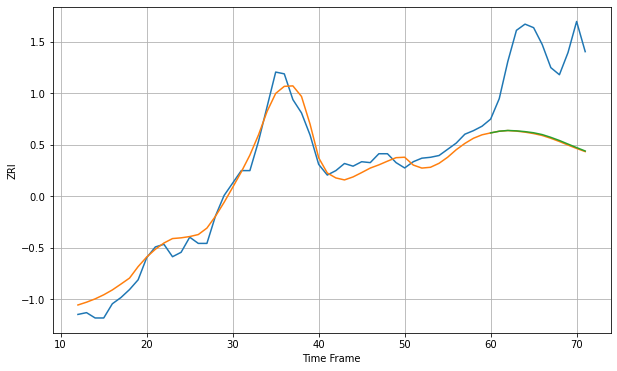

Wall time: 8.58 s
1902 12.322666165133516 98.34894541758366 97.64296929293795 [1746.4642744  1748.36918429 1749.22636172 1748.77433507 1747.90370762
 1746.62463575 1744.58340553 1741.47489379 1737.91555624 1733.89910821
 1729.92333024 1726.08399411]

Got an mse at 0.0049 in round 176 and stopped training

60 60 12


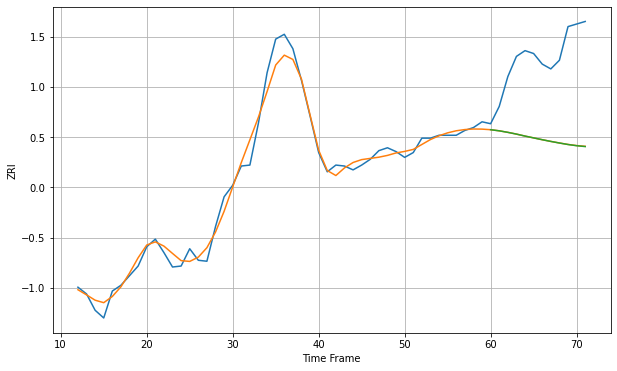

Wall time: 11.5 s
1905 9.558463285441045 88.16410049682052 88.22795199666619 [1749.77035303 1748.61948551 1747.02784067 1745.20670624 1743.14993639
 1741.25949398 1739.3758915  1737.59304059 1735.93076786 1734.37684918
 1733.13643929 1732.24177662]

Got an mse at 0.0049 in round 125 and stopped training

60 60 12


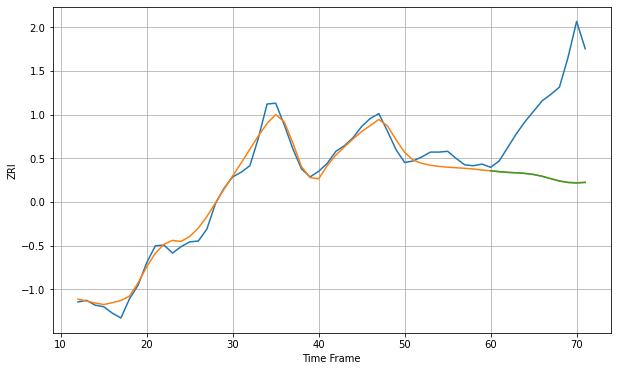

Wall time: 9.46 s
1915 10.213459988332714 108.04732991226244 108.18637005923478 [1813.65307522 1812.56127514 1811.69557737 1811.12606044 1810.36325536
 1809.01942603 1806.74623566 1803.76244429 1800.86802396 1799.04654534
 1798.49089323 1799.08232843]

Got an mse at 0.0049 in round 140 and stopped training

60 60 12


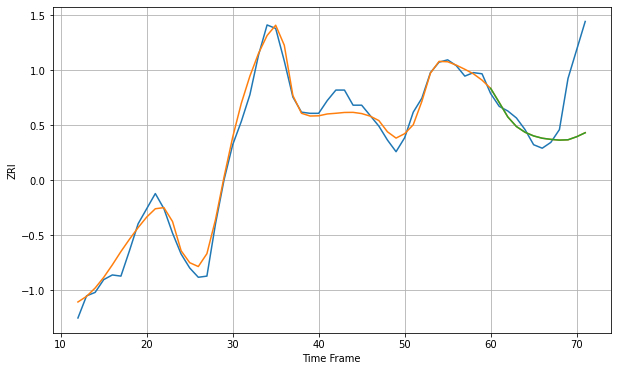

Wall time: 8.99 s
1930 9.016944622010703 38.55957749129915 38.56806102887415 [1771.4721194  1759.28733402 1746.84973156 1738.6320369  1733.72744561
 1730.56890574 1728.59488902 1727.59848373 1726.95508809 1727.23966275
 1729.8670171  1733.29366484]

Got an mse at 0.0050 in round 132 and stopped training

60 60 12


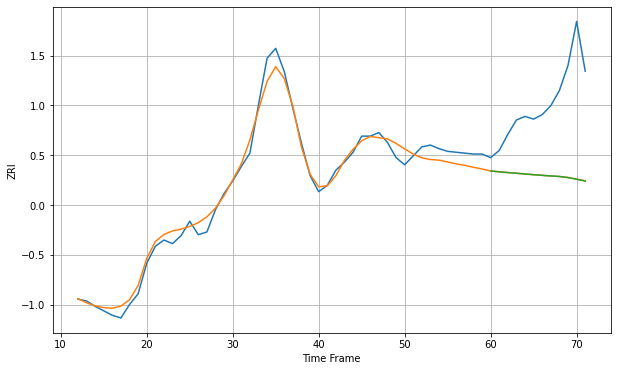

Wall time: 9.43 s
1960 10.15213955619457 89.3139560552524 89.36681602140499 [1779.11310846 1778.15600415 1777.33185748 1776.54416936 1775.74004988
 1774.94877694 1774.21214857 1773.54565272 1772.99703166 1771.73853981
 1769.87144423 1767.89018216]

Got an mse at 0.0049 in round 192 and stopped training

60 60 12


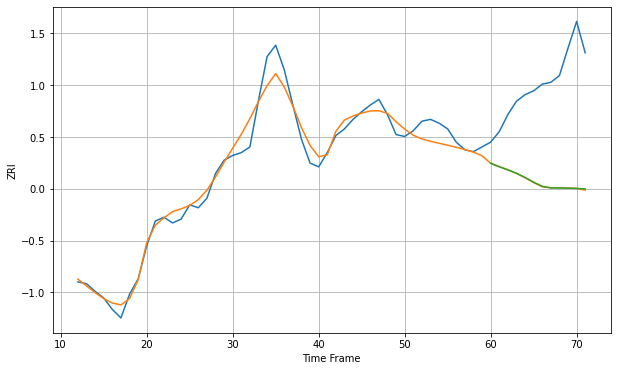

Wall time: 12.2 s
1970 12.176728101262523 107.73397458283227 107.52429210738326 [1814.80087452 1811.17209104 1807.86316571 1804.27709817 1799.86021391
 1794.93950523 1790.54714816 1788.86636834 1788.78614332 1788.6220189
 1788.30193784 1787.84839993]

Got an mse at 0.0050 in round 185 and stopped training

60 60 12


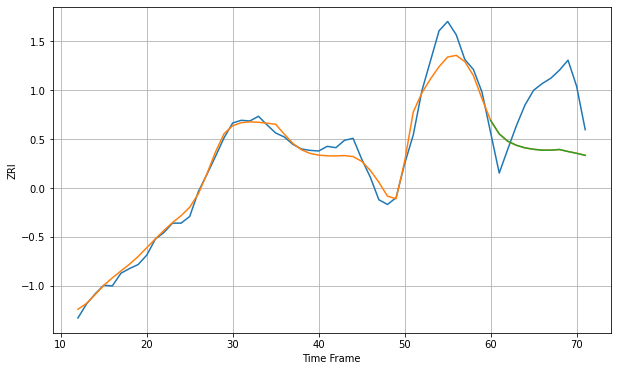

Wall time: 11 s
2026 16.33244503594934 82.94543026418064 82.9902972180624 [2216.84316229 2196.63947344 2185.61535634 2179.59409141 2175.71199009
 2173.56986584 2172.30285138 2172.22290367 2173.26450832 2170.25990074
 2167.55351722 2164.52583512]

Got an mse at 0.0049 in round 103 and stopped training

60 60 12


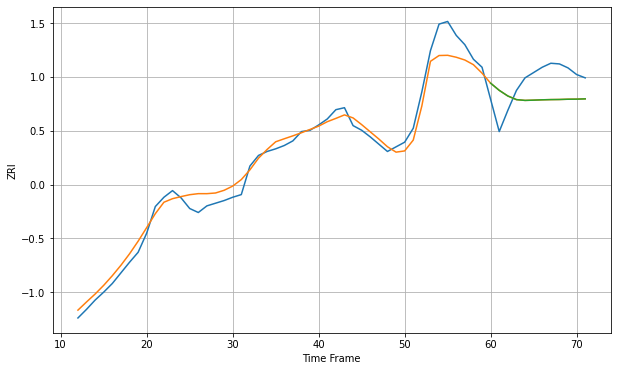

Wall time: 9.07 s
2062 16.649621543232442 41.72476410417788 41.75328190131857 [2161.95004272 2151.16944219 2142.64519367 2137.17956352 2135.98500949
 2136.38092221 2136.88386243 2137.20327727 2137.35153992 2137.75479326
 2137.86976063 2138.30597725]

Got an mse at 0.0049 in round 162 and stopped training

60 60 12


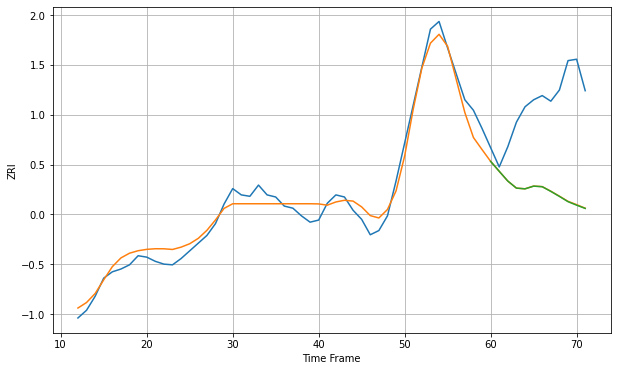

Wall time: 10.1 s
2072 15.910436689288327 132.04791689234554 132.32110082855763 [1910.91701004 1896.71712461 1882.73234897 1872.6866788  1871.6603813
 1875.51644274 1874.6777434  1868.02736269 1860.83251311 1853.30342075
 1848.31528473 1843.65261697]

Got an mse at 0.0050 in round 197 and stopped training

60 60 12


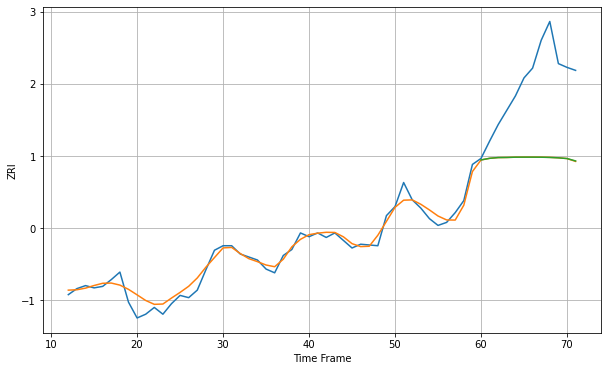

Wall time: 11.6 s
2111 9.725629656428705 107.91320462277604 107.89920528360824 [2851.98764984 2854.15728856 2855.15101189 2855.29775907 2855.6509397
 2855.69712758 2855.69589844 2855.61678953 2855.31863375 2854.77404716
 2853.86086109 2850.67309207]

Got an mse at 0.0050 in round 243 and stopped training

60 60 12


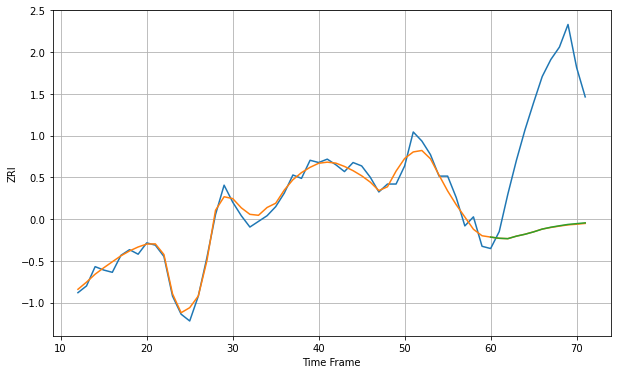

Wall time: 12.3 s
2113 6.56834646171206 114.01394930498509 113.81964257023203 [2604.12117951 2603.05891233 2602.74595749 2604.95660337 2606.63155631
 2608.7235565  2611.18097238 2612.83657741 2614.13078046 2615.30997642
 2616.01467446 2616.71706857]

Got an mse at 0.0049 in round 432 and stopped training

60 60 12


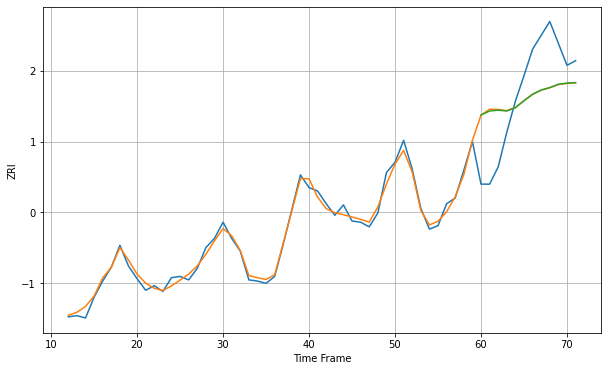

Wall time: 18.3 s
2114 4.4518949928739024 40.93410281585084 40.592956793700054 [2817.89105318 2821.40522151 2822.08369851 2821.41414037 2824.27945685
 2830.33419564 2835.8726542  2839.57893474 2841.71104716 2844.59231515
 2845.57159588 2845.96306027]

Got an mse at 0.0050 in round 272 and stopped training

60 60 12


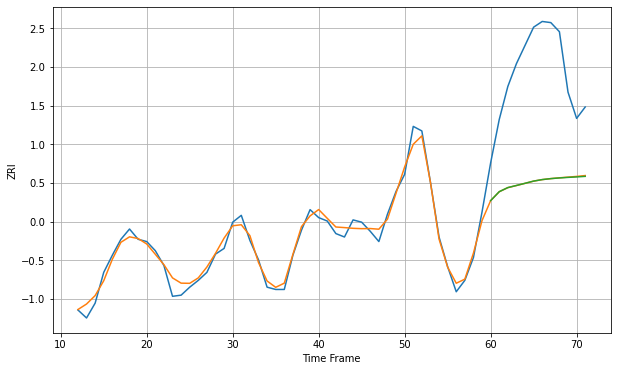

Wall time: 14.2 s
2115 6.212859899161562 101.38926052891647 101.44421489239667 [2919.88617722 2927.73919959 2931.34631729 2933.19153134 2935.09448894
 2937.02996593 2938.34900693 2939.19642177 2939.80031974 2940.27572059
 2940.68799889 2941.18060139]

Got an mse at 0.0049 in round 387 and stopped training

60 60 12


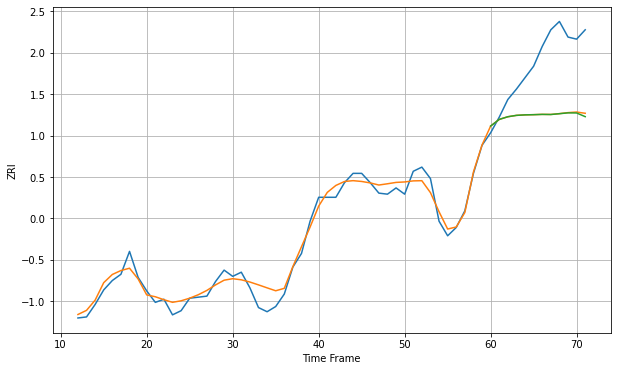

Wall time: 15.7 s
2116 8.54240541804917 57.56486458407312 58.080965270376495 [2828.46066139 2834.86212026 2837.42359789 2838.74119077 2839.22210172
 2839.40353032 2839.67821027 2839.57001206 2840.34821815 2841.14878445
 2841.03985961 2837.50844715]

Got an mse at 0.0050 in round 383 and stopped training

60 60 12


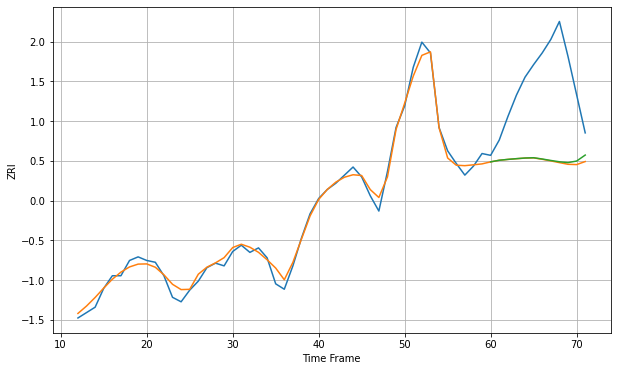

Wall time: 15.3 s
2118 7.200470699832202 93.60697630229008 92.70357535408326 [2945.73850374 2947.53161324 2948.48819539 2949.30663084 2950.02477809
 2950.33962643 2948.92851136 2947.30902225 2945.83083887 2944.94353505
 2946.63694134 2953.31162038]

Got an mse at 0.0050 in round 221 and stopped training

60 60 12


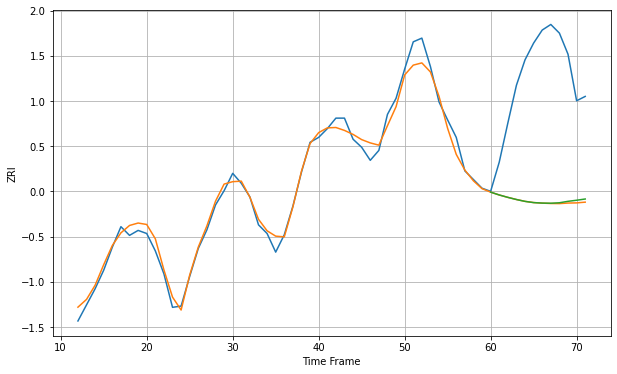

Wall time: 11.7 s
2119 14.263522167371136 208.0814982711543 207.0026791207634 [2781.69407036 2777.1323554  2773.26891099 2769.78788531 2766.78579686
 2764.83072089 2764.0407341  2763.81425009 2764.56398221 2766.88727319
 2768.649297   2770.63412781]

Got an mse at 0.0050 in round 306 and stopped training

60 60 12


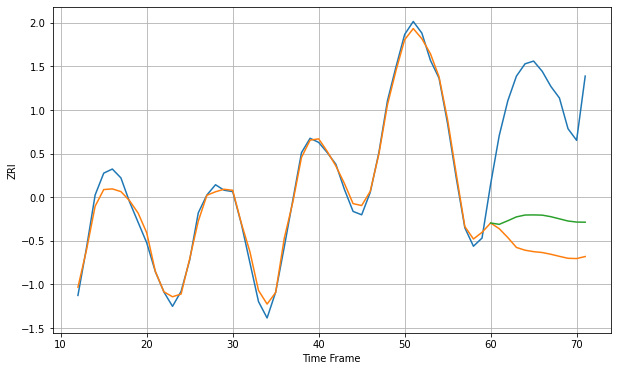

Wall time: 13.8 s
2120 10.585906313865861 223.07421484626525 178.73721581573403 [3124.01349179 3122.06460312 3127.35047627 3132.94575886 3135.67925979
 3135.86172774 3135.51960159 3133.25857915 3130.11332384 3126.92977774
 3125.37848706 3125.16462892]

Got an mse at 0.0050 in round 196 and stopped training

60 60 12


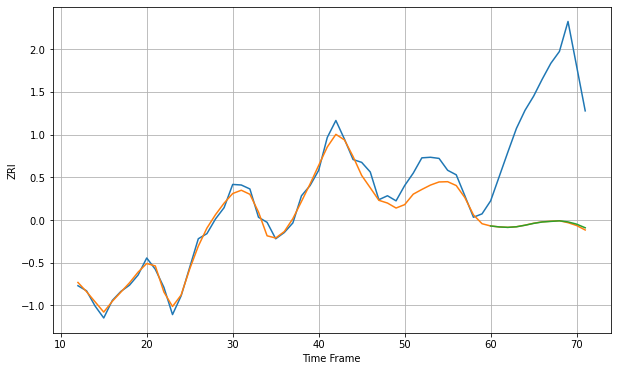

Wall time: 11.8 s
2121 18.155906783428133 229.2064537228744 228.58571164802478 [2367.59627145 2365.90096559 2365.12198338 2366.16090554 2368.86123835
 2372.15174782 2374.62820651 2375.68047527 2376.67510698 2374.77445617
 2370.81563063 2364.40340731]

Got an mse at 0.0050 in round 300 and stopped training

60 60 12


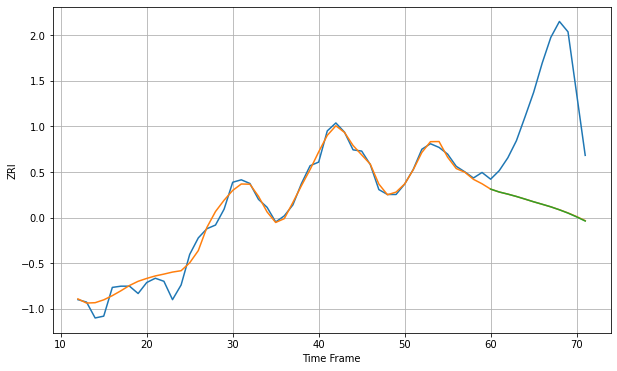

Wall time: 13.9 s
2122 12.52600951991683 188.89570196046247 188.99515101739166 [2391.76764188 2387.04961119 2383.5985131  2379.73589235 2375.45375496
 2371.06346766 2366.99877439 2362.80761549 2357.94553364 2352.57137548
 2346.35101073 2339.57861154]

Got an mse at 0.0049 in round 188 and stopped training

60 60 12


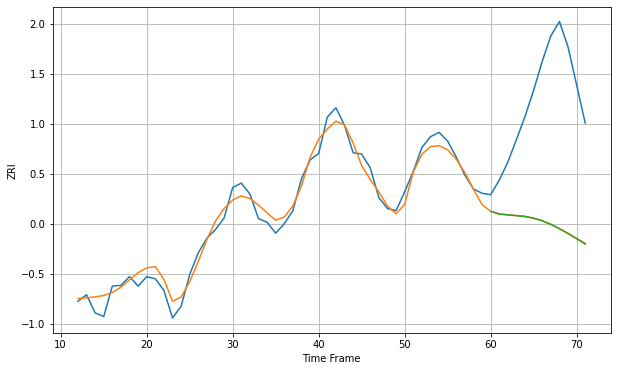

Wall time: 10.8 s
2124 13.34784401586526 183.72624900013574 183.95098482646713 [2284.12737548 2280.41242637 2279.24250363 2278.14894267 2277.0888947
 2274.57699093 2271.1087555  2266.11786894 2260.0933293  2253.44112223
 2246.36269789 2238.79427645]

Got an mse at 0.0050 in round 198 and stopped training

60 60 12


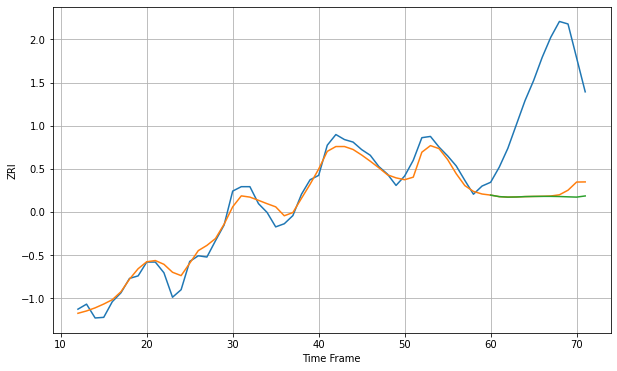

Wall time: 10.8 s
2125 14.018171138249109 182.11654670801346 187.64718829908 [2483.58480021 2481.15815124 2480.39607363 2480.60384537 2481.20044467
 2481.45850171 2481.57862067 2481.5869865  2481.34939012 2480.83692393
 2480.40267023 2482.2504373 ]

Got an mse at 0.0049 in round 127 and stopped training

60 60 12


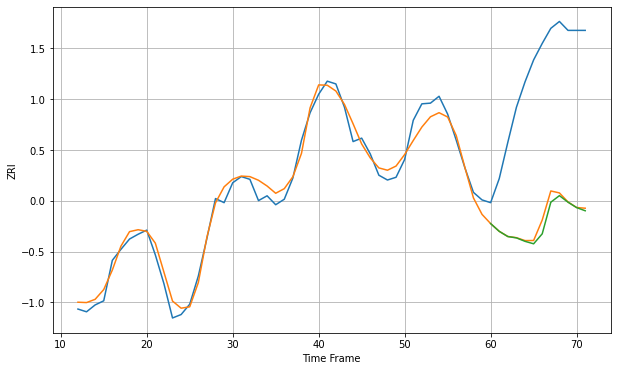

Wall time: 9.64 s
2126 14.664549016952302 217.06647745097555 222.03276653777039 [2256.49019713 2245.22346888 2237.62343132 2235.68561077 2230.6587622
 2227.07139331 2241.5998524  2287.66285579 2297.25164131 2287.66821258
 2279.83870408 2275.19780597]

Got an mse at 0.0050 in round 394 and stopped training

60 60 12


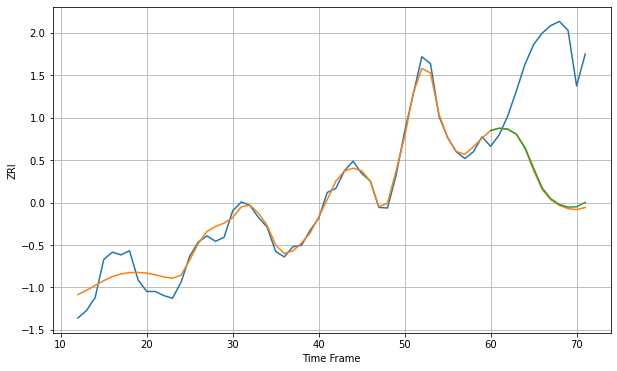

Wall time: 15.8 s
2127 15.884977227643898 182.80002896851232 180.52414483206567 [2884.29486294 2887.60223628 2886.2262713  2878.65265391 2859.16020677
 2828.81293001 2799.56111741 2783.66007919 2775.22089753 2771.34516766
 2771.83362688 2778.43270197]

Got an mse at 0.0050 in round 92 and stopped training

60 60 12


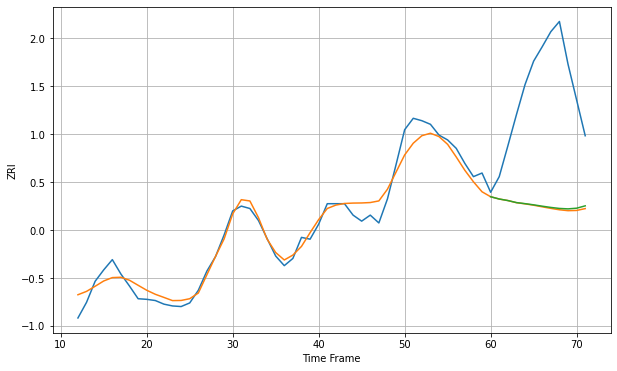

Wall time: 9.31 s
2128 17.5295054340034 202.2225486926704 200.71623161364099 [2452.58162304 2448.78485412 2446.25840943 2442.85088445 2441.08407502
 2439.12007205 2436.87228275 2434.80556471 2433.12796502 2432.40893532
 2433.5228435  2437.42993196]
60 60 12


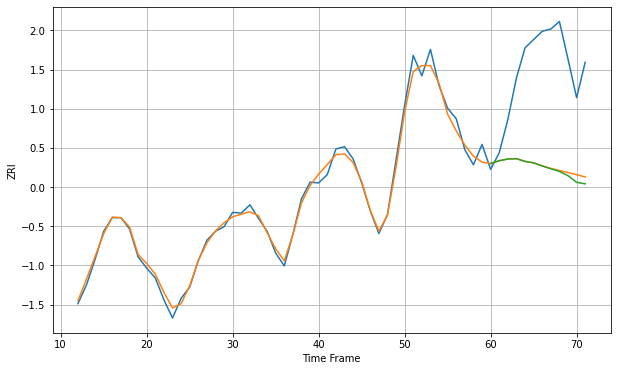

Wall time: 20.2 s
2129 8.673792042429373 136.84037147929308 139.00549547334612 [2783.71024189 2787.42640718 2789.70737961 2790.14690654 2786.48535919
 2784.54195207 2780.38282968 2776.71925149 2773.22146165 2767.59152531
 2758.76869304 2756.78588033]

Got an mse at 0.0049 in round 254 and stopped training

60 60 12


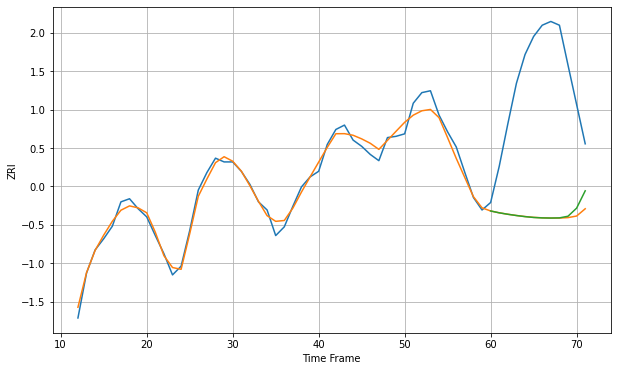

Wall time: 12.4 s
2130 11.604184406034031 226.41475140758405 224.47719550310856 [2607.41487544 2604.45819909 2602.12936002 2600.10458707 2598.35782898
 2597.0190523  2596.30878751 2596.07954429 2596.34274747 2598.99469815
 2611.93889113 2639.68991483]

Got an mse at 0.0049 in round 213 and stopped training

60 60 12


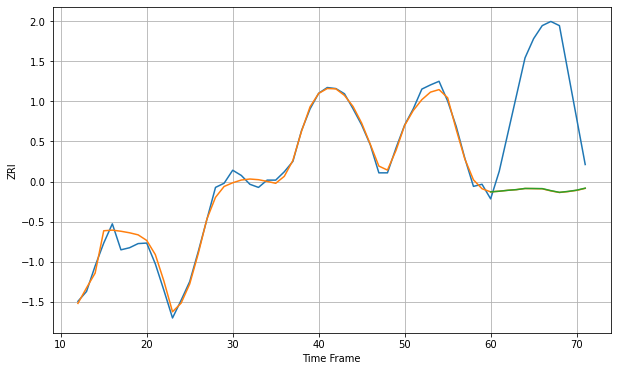

Wall time: 11.7 s
2131 12.230694550253974 218.71190838461752 218.48098444191822 [2380.43007215 2381.65672021 2383.43411272 2384.7330114  2386.99053117
 2386.85757114 2386.69193688 2382.84094235 2379.48818235 2381.29360303
 2383.68621146 2387.58238697]

Got an mse at 0.0050 in round 193 and stopped training

60 60 12


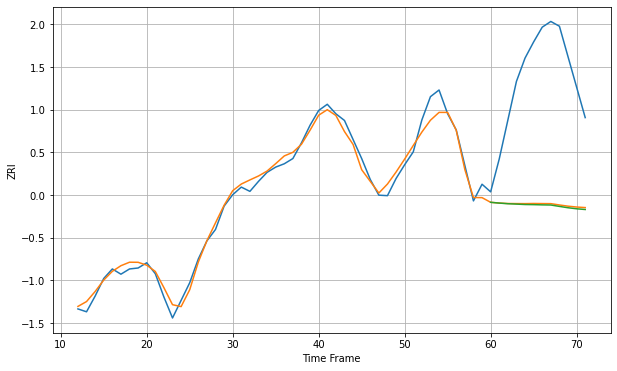

Wall time: 10.6 s
2132 16.69401492354766 279.4307963443336 281.7455542532213 [2351.03446559 2349.37272802 2348.06858339 2347.24745469 2346.3885523
 2346.11549518 2345.64693397 2345.34960362 2342.42385177 2339.61821894
 2337.40995032 2335.90440362]

Got an mse at 0.0050 in round 189 and stopped training

60 60 12


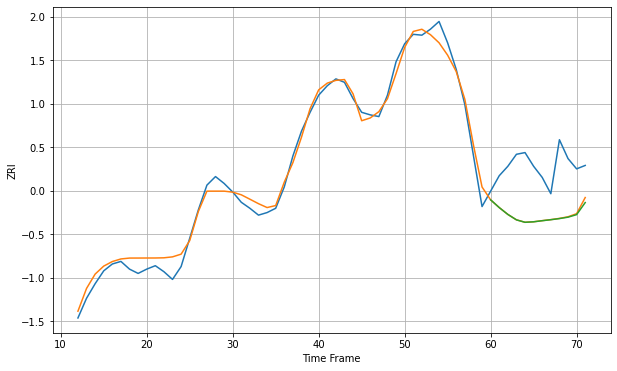

Wall time: 10.3 s
2134 10.580258161309818 59.10734853055857 59.61677756505307 [2591.83732799 2582.83677809 2574.84704787 2568.50971321 2565.64927075
 2566.22423714 2567.49508391 2568.65918257 2569.9753078  2571.61497426
 2574.58248892 2588.66432797]

Got an mse at 0.0049 in round 161 and stopped training

60 60 12


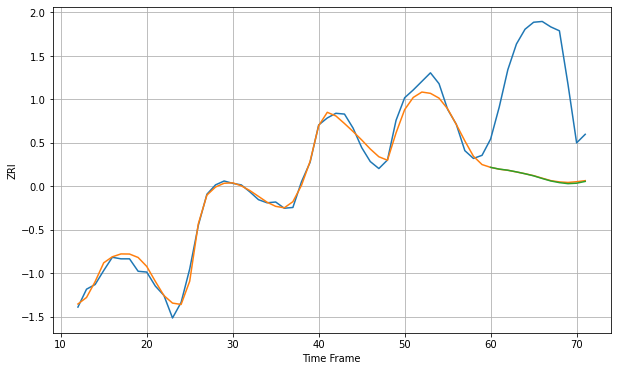

Wall time: 9.65 s
2135 9.60801641236408 148.29568030533386 148.6916997445337 [2711.52705455 2709.28626975 2707.87250753 2705.72538398 2703.31377375
 2700.64012935 2697.22619592 2694.05070135 2691.92981357 2690.58131005
 2691.1736668  2693.45835692]

Got an mse at 0.0049 in round 208 and stopped training

60 60 12


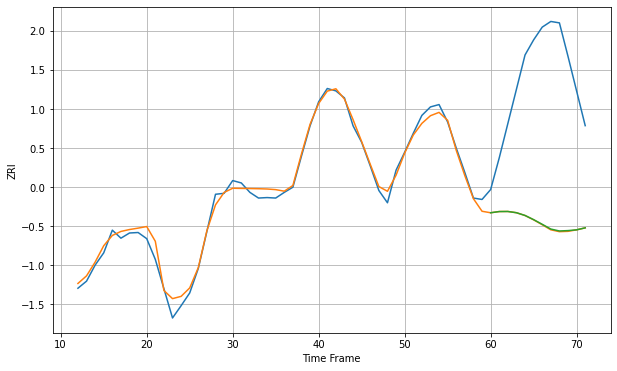

Wall time: 11.2 s
2136 14.442375850208276 318.2211744133861 317.54707679214255 [2318.83970534 2321.40577957 2321.56137063 2318.93870357 2313.13578614
 2304.28311689 2294.40358528 2284.34080767 2280.25689115 2281.08347456
 2282.66872811 2286.94858799]

Got an mse at 0.0050 in round 246 and stopped training

60 60 12


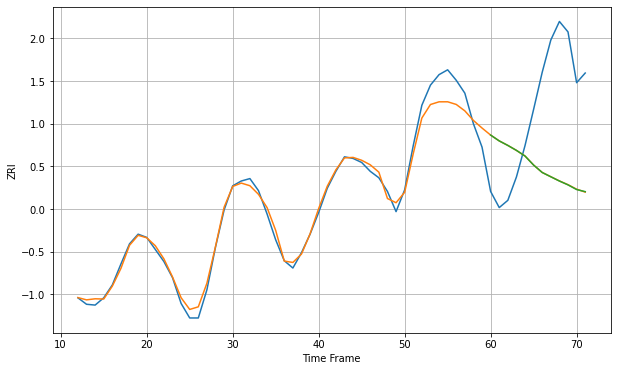

Wall time: 11.6 s
2138 12.012261879923436 122.86396408530368 122.89867179549739 [2590.98612111 2583.7397579  2578.15123498 2571.99252236 2564.98389929
 2553.76191486 2544.55996429 2539.24053227 2533.95108008 2529.18172416
 2523.39361001 2520.80542663]

Got an mse at 0.0050 in round 180 and stopped training

60 60 12


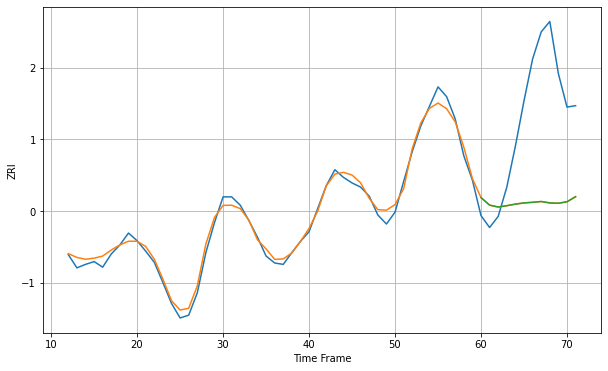

Wall time: 10.1 s
2139 9.049840886038725 150.29963678879963 150.281915461734 [2607.92759402 2597.10617644 2594.40562972 2596.33038937 2598.57739888
 2600.31003596 2601.17731071 2602.3233572  2600.31973404 2599.84206637
 2601.98389822 2609.25633941]

Got an mse at 0.0048 in round 197 and stopped training

60 60 12


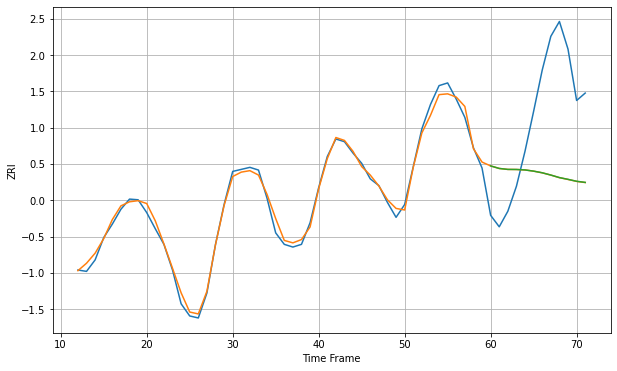

Wall time: 10.9 s
2140 8.196926084633464 133.49299765548804 133.40202230529695 [2585.14649751 2581.37204453 2579.96388759 2579.86688549 2579.1906915
 2577.40074021 2574.96596563 2571.6142273  2567.86881076 2565.25850494
 2562.40797326 2560.74737809]

Got an mse at 0.0050 in round 153 and stopped training

60 60 12


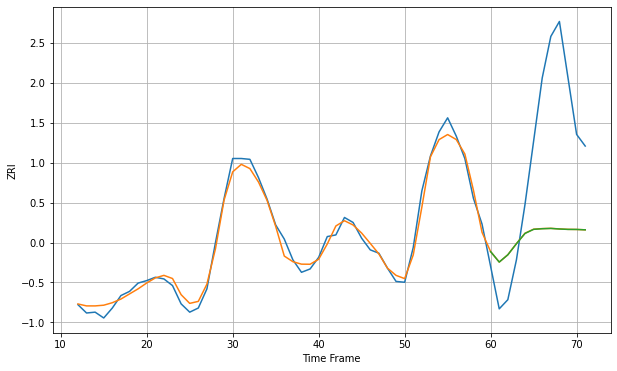

Wall time: 9.95 s
2141 8.639175592918436 136.7689564054165 136.83043212247836 [2530.87784038 2518.31177413 2527.05416455 2540.3804162  2552.82608838
 2557.72159823 2558.45972223 2558.82964059 2558.12837094 2557.63776228
 2557.59984565 2557.13079161]

Got an mse at 0.0050 in round 157 and stopped training

60 60 12


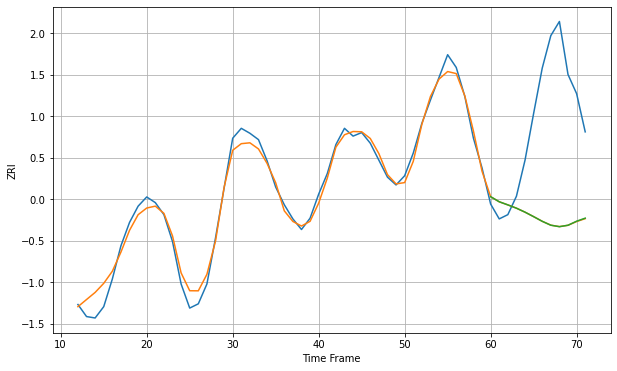

Wall time: 9.92 s
2143 12.897256850593678 164.19121205974332 164.12640178709603 [2434.37859954 2427.20260462 2422.80977034 2418.14972059 2412.5233021
 2406.18849927 2399.5971692  2394.08007292 2392.01470507 2394.03437058
 2399.7344321  2404.06153542]

Got an mse at 0.0049 in round 268 and stopped training

60 60 12


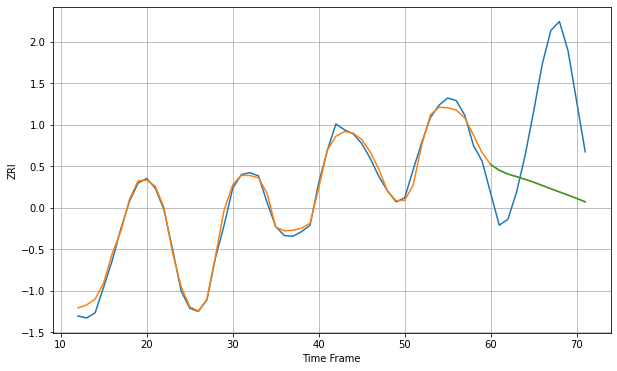

Wall time: 13.3 s
2144 9.617202580532238 149.7483640948353 149.68896987762307 [2589.51565031 2580.67306201 2574.88927492 2570.878324   2566.72313085
 2562.2697313  2557.25885397 2552.23594167 2547.25453199 2542.50128002
 2537.39962419 2532.06809723]

Got an mse at 0.0050 in round 177 and stopped training

60 60 12


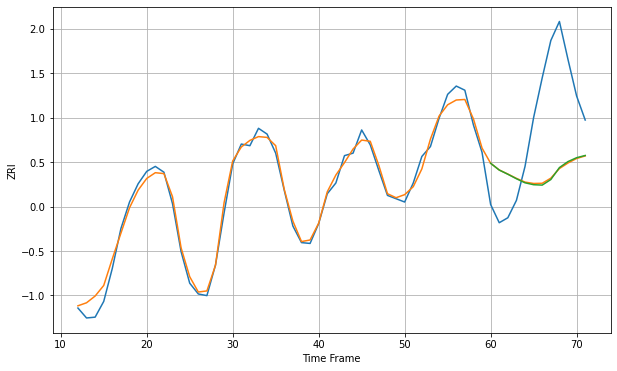

Wall time: 10.3 s
2145 9.006303132897804 98.00811009314252 98.13604564030089 [2389.78372571 2381.61166004 2376.5241017  2371.09124518 2366.20077433
 2363.89415434 2363.43190663 2370.14104779 2384.59062164 2391.83694657
 2396.51441785 2399.20268906]

Got an mse at 0.0050 in round 137 and stopped training

60 60 12


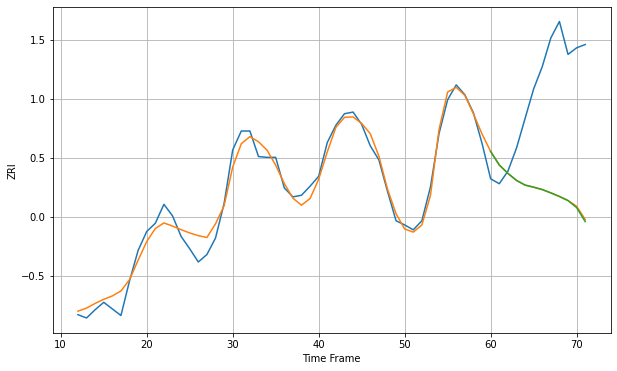

Wall time: 9.11 s
2148 12.16615563847203 141.48858188695672 141.99709142625133 [2229.2000737  2212.74521854 2202.5775538  2194.08132082 2188.34713677
 2185.77715598 2182.91505736 2178.88310524 2174.51137098 2169.53158718
 2161.04669077 2144.01077303]

Got an mse at 0.0049 in round 226 and stopped training

60 60 12


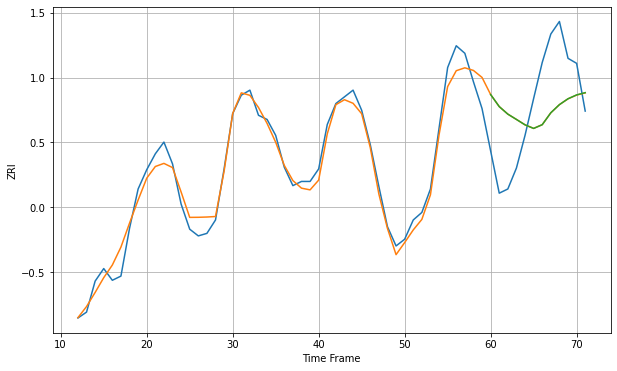

Wall time: 11.6 s
2149 13.855842579520921 68.59565995223144 68.57959354389267 [2318.76457168 2304.36707352 2295.36864071 2289.02547141 2282.59197965
 2278.29121454 2282.75707518 2296.99410289 2306.72767057 2313.71661979
 2318.31291171 2321.03522936]

Got an mse at 0.0050 in round 267 and stopped training

60 60 12


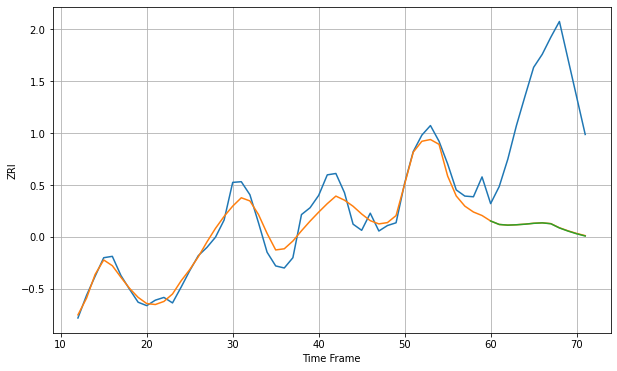

Wall time: 12.9 s
2150 18.537476107660662 198.0597163965939 198.2460612105206 [2353.63214425 2348.55725436 2347.5799611  2348.09513529 2348.9611589
 2350.22414871 2350.8804958  2349.62541527 2343.47221676 2338.91884524
 2334.9664731  2331.66225677]

Got an mse at 0.0050 in round 404 and stopped training

60 60 12


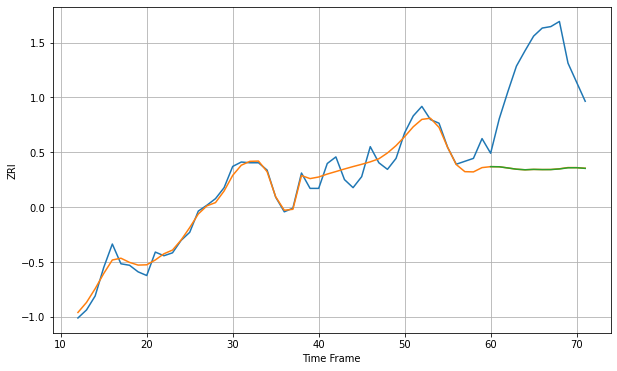

Wall time: 16.7 s
2151 12.872625578139711 145.2282571964555 145.31150870409905 [2342.68782543 2342.52152957 2340.90327607 2339.2184853  2338.42318657
 2338.94967593 2338.68354815 2338.69741516 2339.5610306  2341.14928542
 2341.24072458 2340.3360393 ]

Got an mse at 0.0050 in round 232 and stopped training

60 60 12


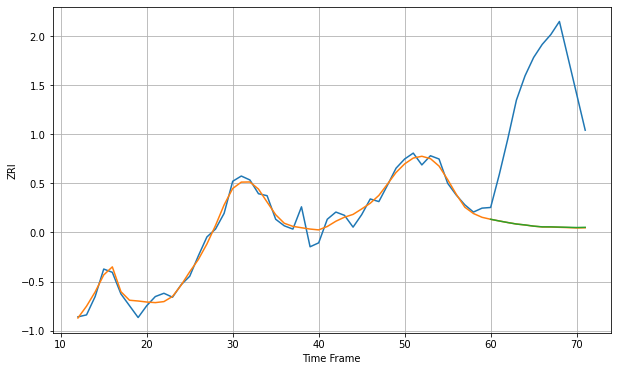

Wall time: 13.3 s
2152 11.1579944618114 217.92038053476534 217.68389117975215 [2424.98054801 2422.39790599 2419.9828043  2417.73295782 2416.33171174
 2414.5391028  2413.41812637 2413.39565732 2413.0676001  2412.75157305
 2412.37093134 2412.69634694]

Got an mse at 0.0049 in round 244 and stopped training

60 60 12


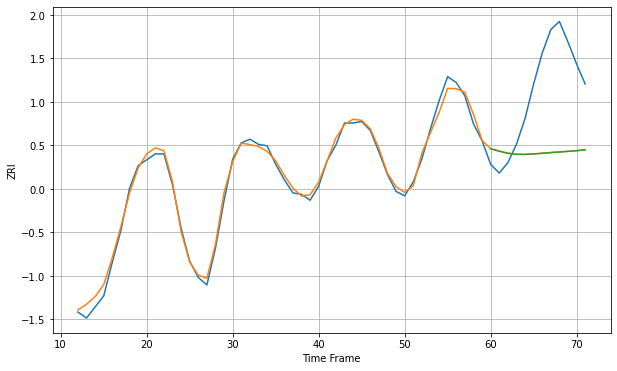

Wall time: 12.5 s
2155 7.559704698179304 105.99834640737734 106.05203051981147 [2368.02544909 2364.74452571 2361.89196411 2360.43796796 2360.34169354
 2361.00309509 2361.85146657 2362.83188397 2363.5483735  2364.45265454
 2365.35062631 2366.46203745]

Got an mse at 0.0050 in round 143 and stopped training

60 60 12


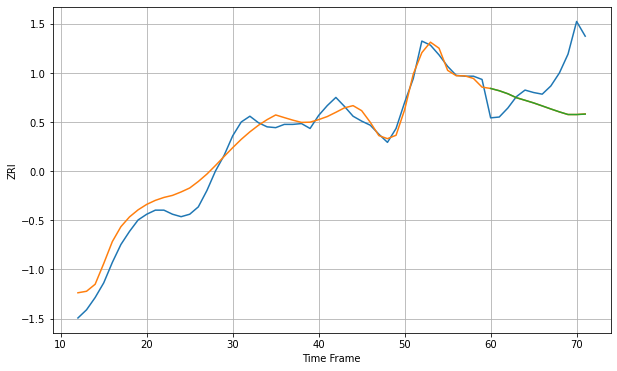

Wall time: 9.6 s
2169 15.359919497011868 53.022600644896144 53.05596687929834 [2015.98383389 2013.20222527 2009.51225752 2004.67033145 2001.52315757
 1998.29152404 1994.62840649 1990.89774572 1987.3142756  1984.09169302
 1984.05083192 1984.58131603]

Got an mse at 0.0050 in round 220 and stopped training

60 60 12


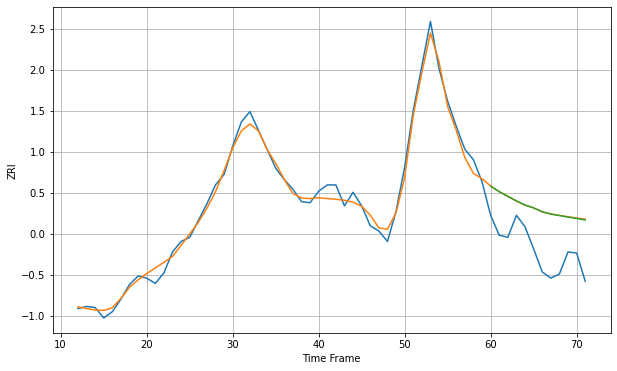

Wall time: 11.8 s
2170 6.785732886944561 42.94096027596564 42.748235660247104 [1934.9811949  1929.52558725 1925.10395979 1920.66449893 1916.71736084
 1914.04514599 1910.30964819 1908.14751843 1906.75285459 1905.29323212
 1903.98116806 1902.51542669]

Got an mse at 0.0050 in round 193 and stopped training

60 60 12


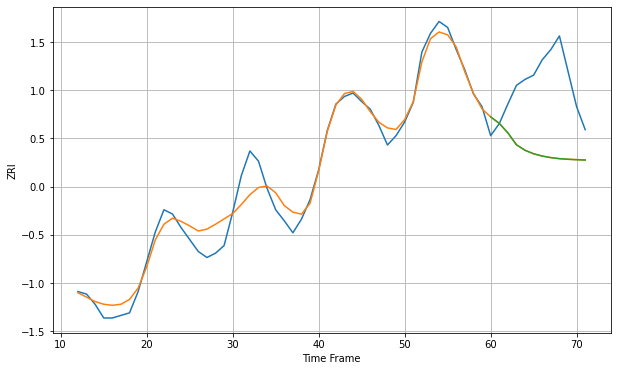

Wall time: 11.1 s
2171 16.167984598754344 85.28325277136092 85.29769392784664 [2188.06940074 2180.4128778  2169.31142704 2155.29038669 2148.81227861
 2144.68641665 2142.04663666 2140.22259972 2138.9802228  2138.23804018
 2137.74973278 2137.3070104 ]

Got an mse at 0.0050 in round 164 and stopped training

60 60 12


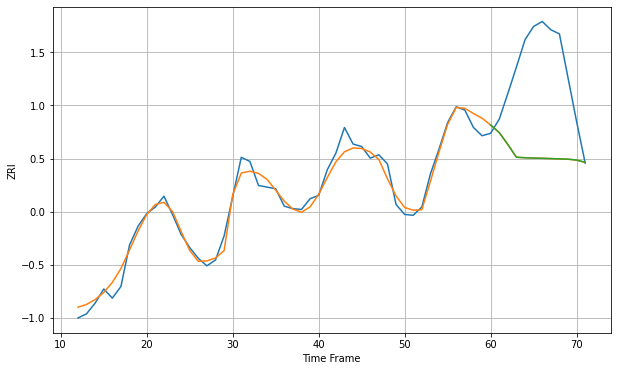

Wall time: 9.65 s
2176 10.415871088155205 110.94551474427232 110.92027259276286 [2276.95832329 2267.90984753 2253.47554783 2238.05756747 2237.47739531
 2237.04791557 2236.79627419 2236.46867536 2236.11829078 2235.73150449
 2234.69395836 2231.97498612]

Got an mse at 0.0050 in round 143 and stopped training

60 60 12


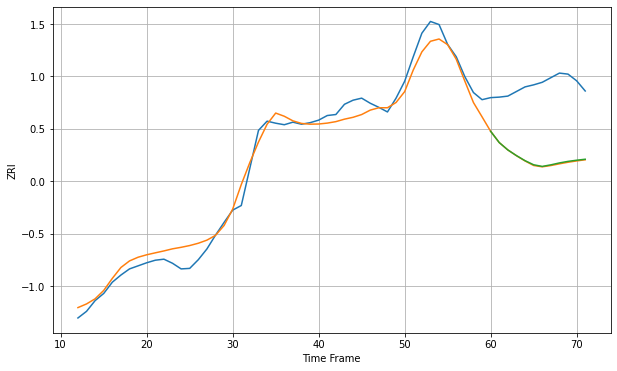

Wall time: 9.69 s
2184 21.06319212199437 143.09906675572415 142.12659369353986 [2129.17075059 2107.12062061 2092.72875416 2081.6214362  2071.71063346
 2063.70235946 2060.44851635 2063.53977451 2067.28074801 2070.31756796
 2072.58803671 2074.50883714]

Got an mse at 0.0050 in round 335 and stopped training

60 60 12


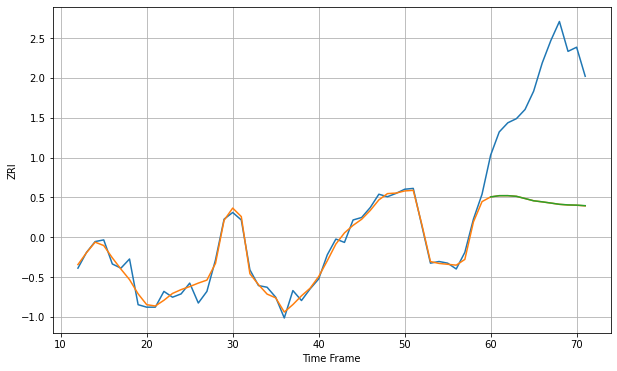

Wall time: 13.9 s
2210 7.816823179218953 148.11370135375287 148.04406700114592 [2873.74972065 2875.23168995 2875.26251661 2874.46344164 2871.82147269
 2869.11021544 2867.82078498 2866.38247796 2864.8735356  2864.15365528
 2863.8819283  2863.20153395]

Got an mse at 0.0049 in round 154 and stopped training

60 60 12


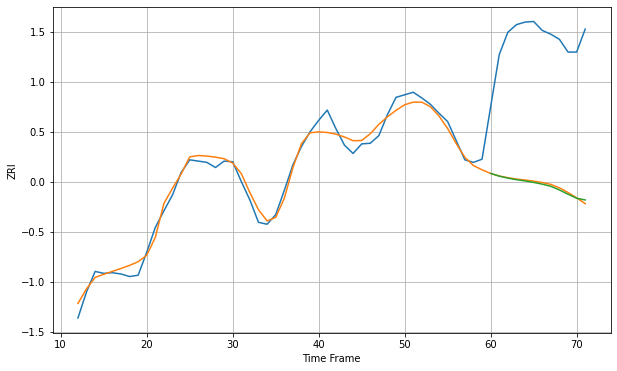

Wall time: 9.83 s
2215 12.56602866529267 228.05202595708437 228.97727337092826 [2348.6651251  2344.41811177 2341.31225403 2338.89381339 2336.95116249
 2334.60229695 2331.87289528 2328.51058452 2322.75796698 2316.07041689
 2309.8372077  2307.06663734]

Got an mse at 0.0048 in round 136 and stopped training

60 60 12


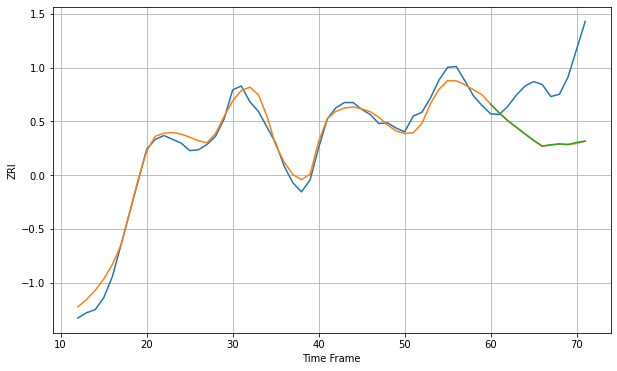

Wall time: 9.05 s
2301 11.93452858292886 80.204457884289 79.97555432033597 [1667.78891136 1656.19753045 1645.76005954 1636.9198262  1628.19373241
 1619.60727346 1612.01597451 1613.78846512 1614.89640484 1613.94712612
 1616.92588711 1618.55139541]

Got an mse at 0.0050 in round 86 and stopped training

60 60 12


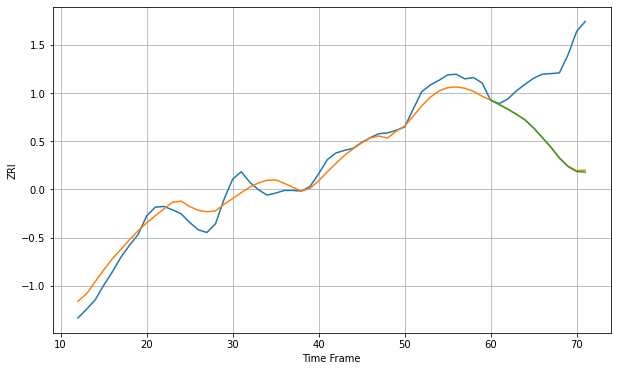

Wall time: 8.96 s
2302 16.700238752113293 118.24377421332967 119.05640804125429 [1701.28597182 1694.66331568 1687.6253371  1680.06938815 1671.67028454
 1659.51498717 1645.35074174 1630.78175686 1614.41297624 1601.72268013
 1594.28630651 1593.39826989]

Got an mse at 0.0050 in round 103 and stopped training

60 60 12


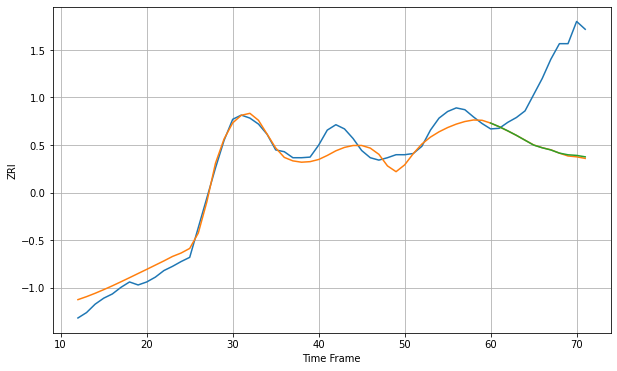

Wall time: 8.86 s
2360 17.566094685362117 132.92918628697257 132.0465649118395 [1778.69919162 1772.62846063 1765.69662381 1758.24157309 1750.15174912
 1742.07436792 1737.55330022 1733.95969492 1728.67032335 1725.86881774
 1724.86205711 1722.47841234]

Got an mse at 0.0050 in round 204 and stopped training

60 60 12


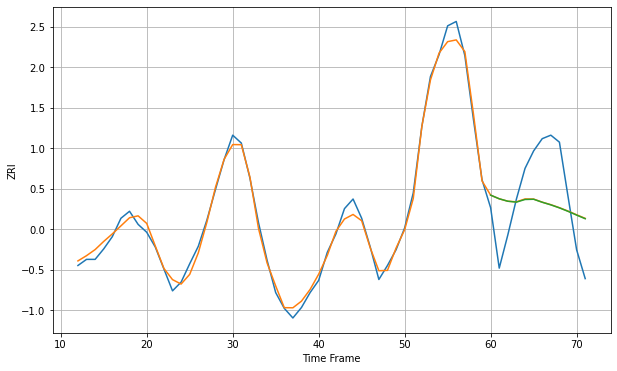

Wall time: 11.5 s
2445 7.861247839392315 54.810262568944104 54.86869041103056 [2804.42421473 2800.26541004 2797.46913681 2796.45873602 2799.46140708
 2799.73437252 2796.312317   2793.3290677  2789.87794324 2785.92908885
 2781.63205857 2777.48154967]

Got an mse at 0.0049 in round 131 and stopped training

60 60 12


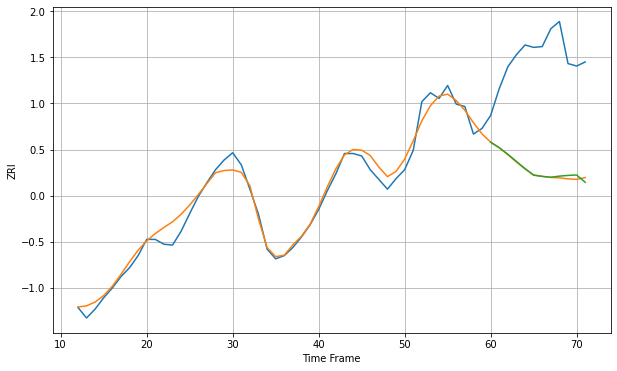

Wall time: 10 s
2446 10.81185824997496 141.62580762876183 140.96983210537368 [2879.98553637 2873.23654469 2865.09171095 2856.21615077 2847.38592867
 2839.26642405 2837.75571353 2836.74684314 2838.09085959 2838.96247085
 2839.49306474 2830.50554155]

Got an mse at 0.0050 in round 230 and stopped training

60 60 12


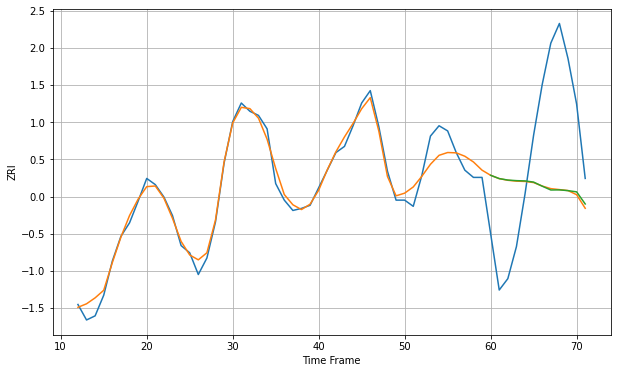

Wall time: 12 s
2451 9.639511208848278 95.91323073382969 95.86625308923881 [2436.03560126 2432.85166825 2431.42688509 2430.85936676 2430.60160307
 2429.45429745 2425.4969242  2421.80166338 2421.92214097 2421.18868047
 2420.01469454 2408.28665165]

Got an mse at 0.0050 in round 162 and stopped training

60 60 12


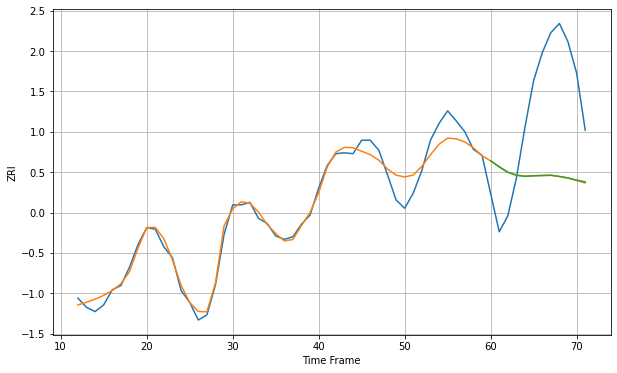

Wall time: 11.6 s
2453 12.147397068611834 114.15137941761205 114.05535320087601 [2411.46386118 2404.2633623  2397.8091857  2394.22715729 2392.99714266
 2393.60507508 2393.94675299 2394.25381029 2392.87375945 2391.10472856
 2388.48964328 2386.37968123]

Got an mse at 0.0050 in round 158 and stopped training

60 60 12


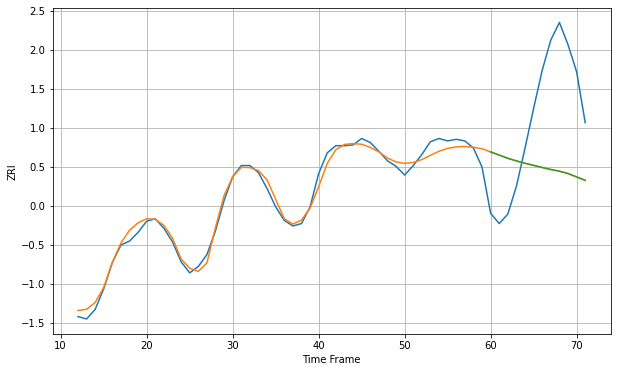

Wall time: 9.68 s
2458 8.381575122858374 111.9595542986597 111.96766221645322 [2566.15096103 2562.15315464 2558.11431902 2554.81845074 2551.82681206
 2549.19512605 2546.53140281 2543.96755202 2541.89127382 2538.95918882
 2534.73458301 2530.3687924 ]

Got an mse at 0.0048 in round 259 and stopped training

60 60 12


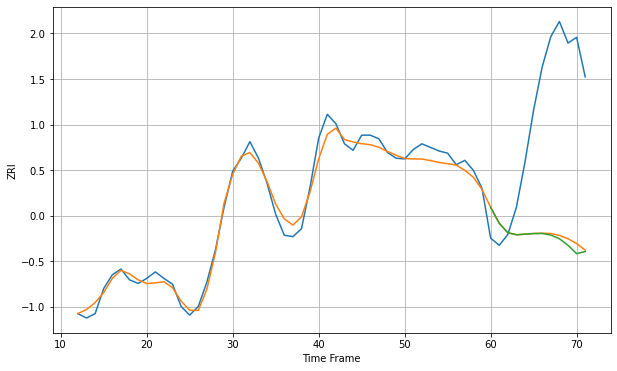

Wall time: 13 s
2460 11.843823899072818 198.8591217077698 202.6580235709857 [2591.82657792 2569.58132468 2556.47222856 2553.67822176 2554.45431386
 2555.29473698 2555.44245613 2553.25597261 2548.14416374 2538.975106
 2527.37514026 2530.33510745]

Got an mse at 0.0048 in round 211 and stopped training

60 60 12


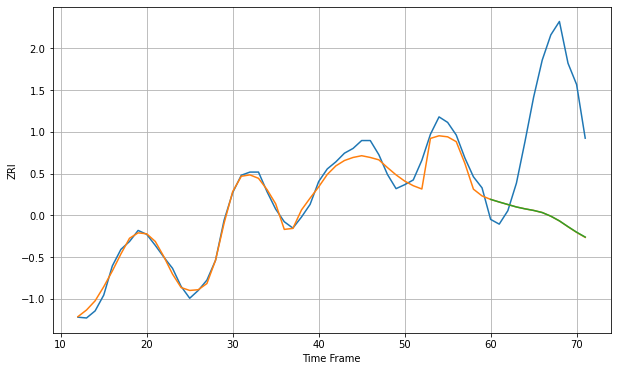

Wall time: 11.7 s
2472 10.665178784868731 152.3523073156783 152.27040786315402 [2376.36380633 2373.04064454 2369.88391342 2366.77367959 2364.39032557
 2362.38029522 2359.70338972 2355.10294517 2349.11926522 2341.79132626
 2334.77654343 2328.61521677]

Got an mse at 0.0048 in round 203 and stopped training

60 60 12


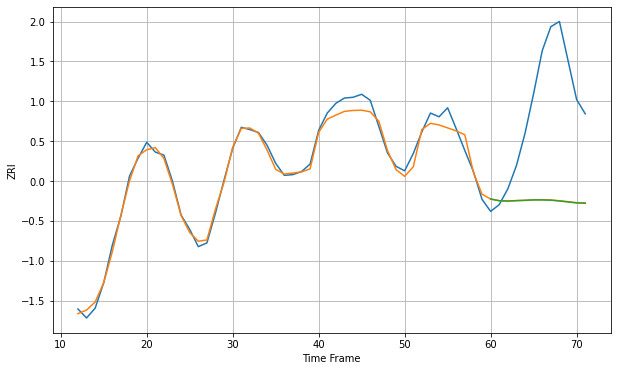

Wall time: 11.1 s
2474 9.574133906081832 144.0059127457541 144.19943574712414 [2355.46816444 2353.20586521 2352.76384971 2353.3238771  2353.73079422
 2354.31564721 2354.29602795 2353.93905318 2352.82847748 2351.52048459
 2350.27978409 2349.95852247]

Got an mse at 0.0049 in round 188 and stopped training

60 60 12


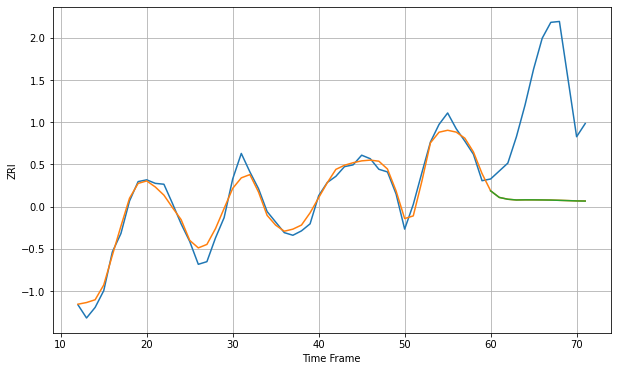

Wall time: 10.7 s
2476 9.226562976520905 125.72975053348804 125.7561538803572 [2268.48524919 2261.02179706 2258.94539597 2258.10987184 2258.26438608
 2258.23729145 2258.14075408 2258.00567589 2257.70083134 2257.38331898
 2257.02862812 2256.87801197]

Got an mse at 0.0050 in round 180 and stopped training

60 60 12


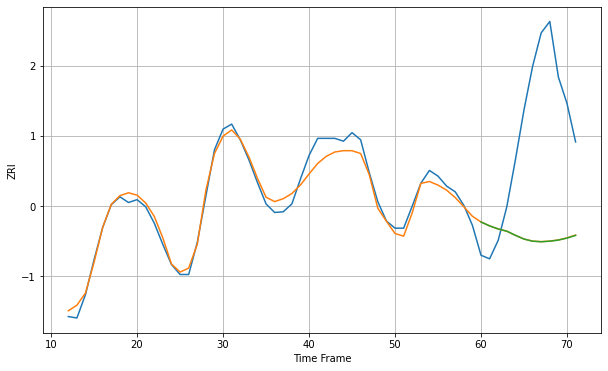

Wall time: 10.9 s
2478 12.343626767757636 181.5618382034753 181.69461430436226 [2445.67716732 2440.21531119 2435.8691935  2432.78151236 2426.95927722
 2421.74288543 2418.71898291 2417.91568486 2418.70812296 2420.27461838
 2423.06751631 2426.83898965]

Got an mse at 0.0050 in round 489 and stopped training

60 60 12


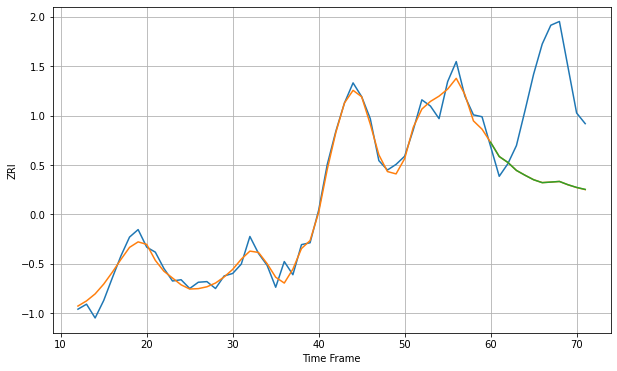

Wall time: 20.5 s
2494 13.924758835006298 152.38220727509676 152.36210469518556 [2802.13293946 2779.53463711 2770.16135742 2757.40081255 2749.67187405
 2742.511789   2737.87388457 2738.77441228 2739.78711966 2734.5313261
 2730.25787572 2727.08602368]

Got an mse at 0.0050 in round 167 and stopped training

60 60 12


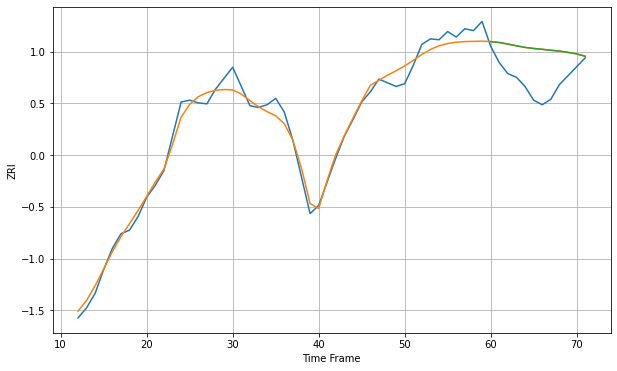

Wall time: 10.1 s
2703 9.909501248616547 37.01797805060701 37.07376463696182 [1434.97343862 1434.03591587 1432.32186476 1430.42705748 1428.66916032
 1427.49272705 1426.60726333 1425.54782035 1424.68392642 1423.30316676
 1421.60266782 1419.00256159]

Got an mse at 0.0049 in round 134 and stopped training

60 60 12


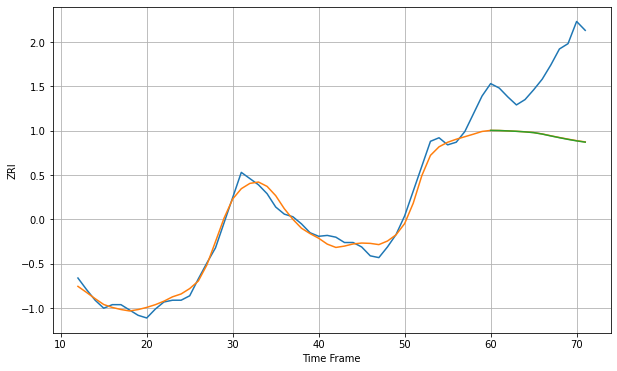

Wall time: 9.22 s
2721 10.10078182997658 79.87175082053284 80.02048712869865 [1052.29417965 1052.13999028 1051.72666267 1051.25436774 1050.63697639
 1049.7876939  1048.16464289 1046.06504723 1044.07394507 1042.1919123
 1040.48656527 1039.06494949]

Got an mse at 0.0050 in round 67 and stopped training

60 60 12


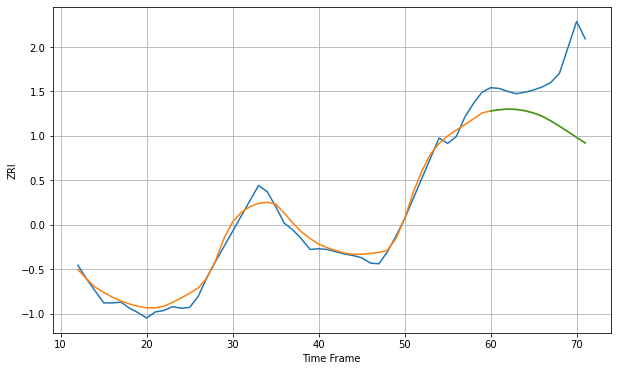

Wall time: 7.27 s
2723 10.428597858299709 75.7618780965073 75.65854415050907 [1150.08828437 1151.7578906  1152.49775702 1152.10843231 1150.32140786
 1147.38478061 1143.11399626 1136.89434066 1129.92194614 1122.60972264
 1114.98504895 1107.69811107]

Got an mse at 0.0048 in round 338 and stopped training

60 60 12


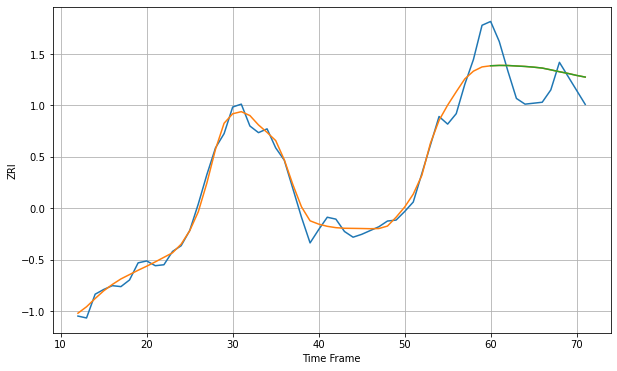

Wall time: 14.8 s
2740 10.503727868905521 28.784537878707415 28.78233827470838 [1256.37710223 1256.71881651 1256.63335568 1256.13901469 1255.66109689
 1254.92864758 1253.97250434 1252.10001055 1250.11393053 1248.32020432
 1246.22992324 1244.48375481]

Got an mse at 0.0050 in round 87 and stopped training

60 60 12


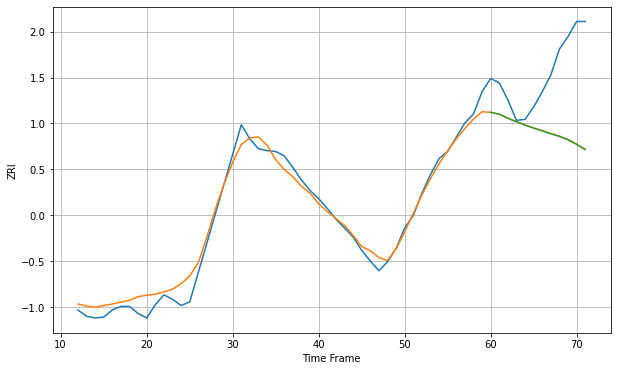

Wall time: 8.21 s
2746 11.077392531701033 77.72601766264582 77.87393928011083 [1109.97147322 1107.83856303 1103.37085729 1099.31212014 1095.66555363
 1092.29578265 1089.13169313 1085.94694969 1082.93577746 1079.12796879
 1073.98653697 1068.19035224]

Got an mse at 0.0049 in round 245 and stopped training

60 60 12


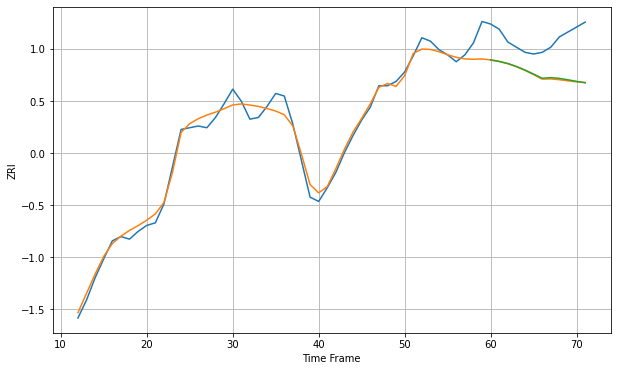

Wall time: 12.4 s
2780 10.879004131603493 43.31871916309053 42.77268805189453 [1374.12029975 1372.39493318 1369.93458122 1366.49477372 1362.27803585
 1357.58677331 1352.72445685 1353.4560945  1352.59070982 1350.9238715
 1349.08288464 1347.45508413]

Got an mse at 0.0050 in round 348 and stopped training

60 60 12


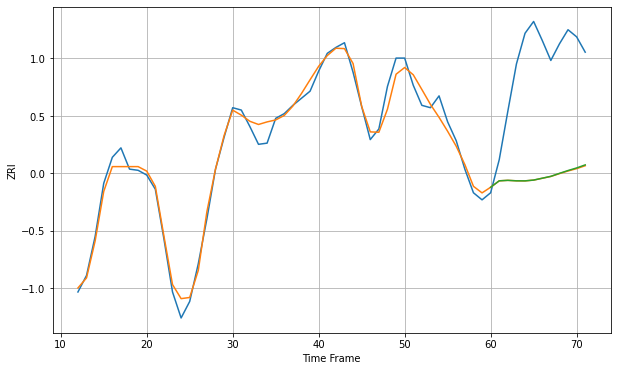

Wall time: 14.7 s
2840 8.051179974933357 99.38182398193554 99.18484390959965 [1819.65197289 1825.11671843 1825.50290078 1825.10993028 1825.06967274
 1825.73758126 1827.31299465 1828.90100055 1831.42040378 1833.81325105
 1835.99780244 1838.60042738]

Got an mse at 0.0049 in round 99 and stopped training

60 60 12


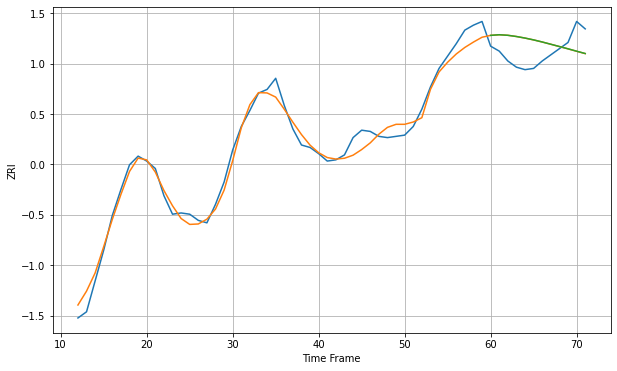

Wall time: 8.38 s
2860 7.489348740499682 17.81214761429819 17.802185616743877 [1208.75034894 1209.2562214  1208.80648854 1207.82461668 1206.55633822
 1205.07850445 1203.38955966 1201.56530614 1199.72155753 1197.87695864
 1195.93919426 1194.06340829]

Got an mse at 0.0050 in round 108 and stopped training

60 60 12


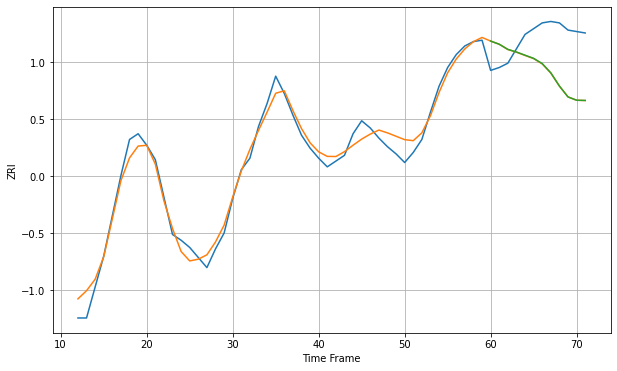

Wall time: 8.36 s
2861 7.08320898205788 31.72443637868267 31.67139392675812 [1196.38189435 1194.1783028  1190.60386023 1188.78590335 1186.5636495
 1184.38610215 1180.72925904 1174.29627246 1165.13068854 1157.55415645
 1155.28354538 1155.13096974]

Got an mse at 0.0049 in round 152 and stopped training

60 60 12


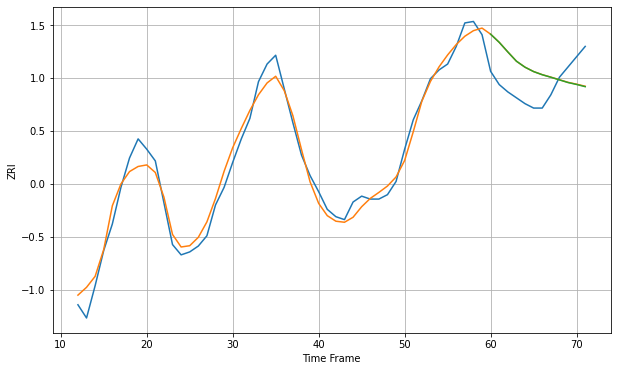

Wall time: 9.98 s
2863 7.893010757467416 22.23431818904004 22.271904032642254 [1225.32409381 1219.77872697 1213.22911463 1206.92709518 1202.83102817
 1199.8516906  1197.72065996 1196.01534491 1194.21316282 1192.39843963
 1191.07341535 1189.58544116]

Got an mse at 0.0049 in round 118 and stopped training

60 60 12


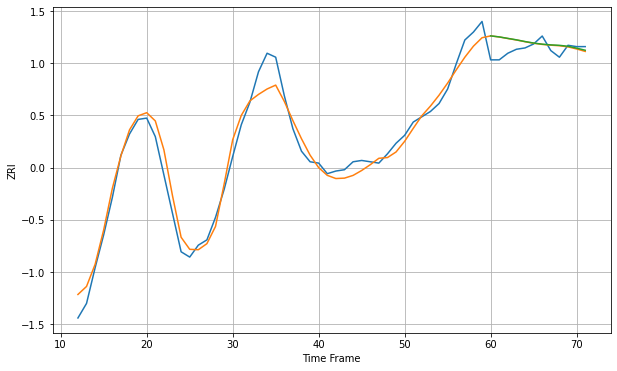

Wall time: 9.51 s
2864 9.396345022318187 8.996388096969241 9.013957851919708 [1277.10759955 1276.33386815 1275.21561784 1274.12228508 1272.83153848
 1271.69922421 1270.84315971 1270.3094794  1269.9676578  1269.25703916
 1267.8507125  1266.25239264]

Got an mse at 0.0049 in round 167 and stopped training

60 60 12


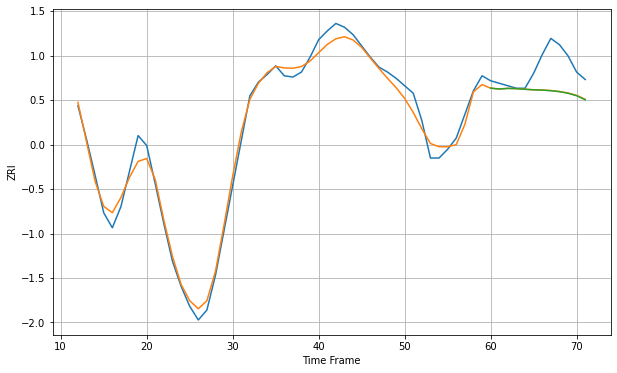

Wall time: 10.4 s
2891 7.325913486876681 21.79377380679333 21.902673235199924 [1198.06913341 1197.39562675 1197.8808872  1197.6814912  1197.17058722
 1196.75886863 1196.52027076 1196.04931186 1195.25567861 1193.99331739
 1192.00323967 1188.78657285]
60 60 12


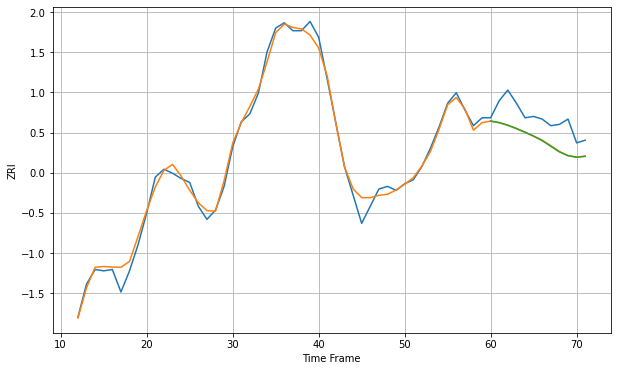

Wall time: 18.5 s
2893 5.660453398293427 17.39455904706827 17.541325244746847 [1229.50973339 1228.3120305  1226.34539493 1223.84042806 1221.04257944
 1218.04664829 1214.63583271 1210.38963225 1206.12813382 1203.23415495
 1202.08453465 1202.78245133]

Got an mse at 0.0050 in round 120 and stopped training

60 60 12


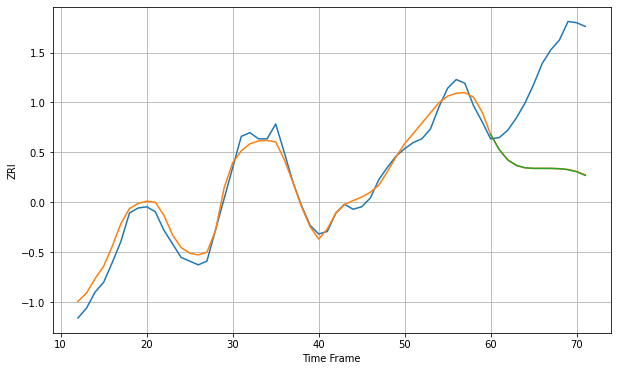

Wall time: 9.07 s
2895 7.930054966528955 81.69619050100414 81.79111047492528 [1071.55406949 1059.29697459 1050.91889835 1046.47791125 1044.58491979
 1044.0724225  1044.08047721 1044.0689289  1043.80970594 1043.05618586
 1041.36159798 1038.43696254]

Got an mse at 0.0050 in round 140 and stopped training

60 60 12


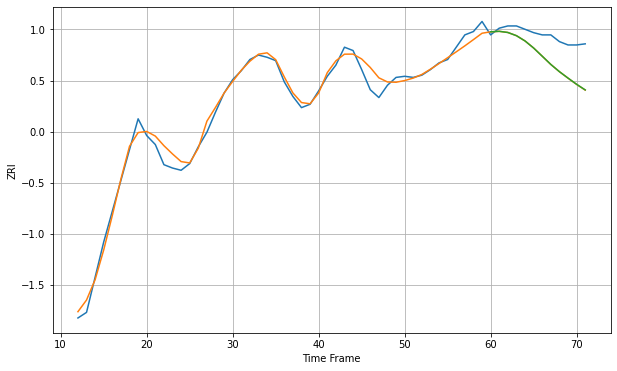

Wall time: 9.94 s
2904 6.99656332206785 22.422006568153602 22.38318937685874 [1241.7636086  1242.19285888 1241.15853374 1238.29852605 1233.58229847
 1227.26801209 1219.95799746 1212.59082881 1206.13575964 1200.38741605
 1194.85092182 1189.82304488]

Got an mse at 0.0049 in round 63 and stopped training

60 60 12


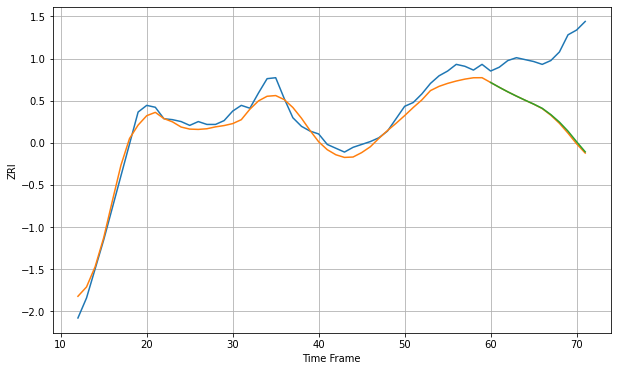

Wall time: 7.85 s
2905 9.562033780146718 71.92919398469489 70.97792257457915 [1257.99875826 1252.9790649  1248.18778252 1243.72046843 1239.45686274
 1235.36642676 1230.93463981 1224.33859117 1216.46636692 1206.95955287
 1195.84192718 1185.27982631]

Got an mse at 0.0049 in round 50 and stopped training

60 60 12


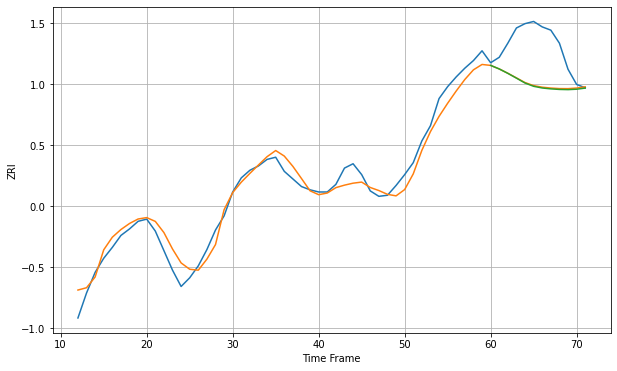

Wall time: 7 s
2906 10.322206850827085 38.11023915643845 38.56979321164114 [1548.54623064 1545.27634033 1541.22877627 1536.81383756 1532.31503435
 1529.2969793  1527.74774338 1526.93791514 1526.41934871 1526.24333611
 1526.62240403 1527.65669628]

Got an mse at 0.0050 in round 88 and stopped training

60 60 12


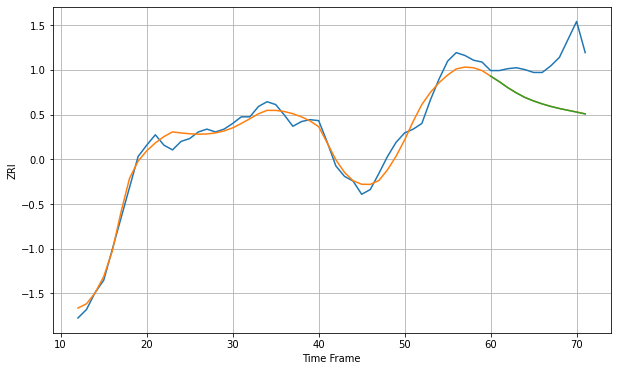

Wall time: 7.72 s
2907 8.69472424964208 48.28631860192839 48.33485208489692 [1246.10476902 1240.2877588  1233.89872787 1228.31579981 1223.47408323
 1219.80528793 1216.69888638 1214.03789365 1211.8099938  1209.89324338
 1208.02524495 1206.03759033]

Got an mse at 0.0049 in round 112 and stopped training

60 60 12


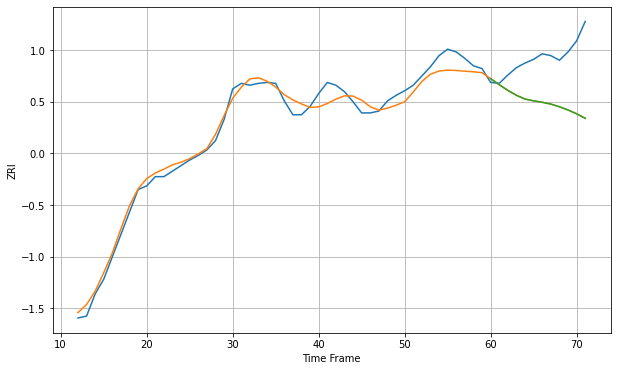

Wall time: 8.69 s
2908 9.64270889244094 53.15106188796228 53.1974524322361 [1265.12973153 1258.5498308  1252.40268225 1247.07721231 1242.99074105
 1241.08056573 1239.4928349  1237.54703157 1234.65503634 1231.14966644
 1227.02815546 1222.11673478]

Got an mse at 0.0049 in round 91 and stopped training

60 60 12


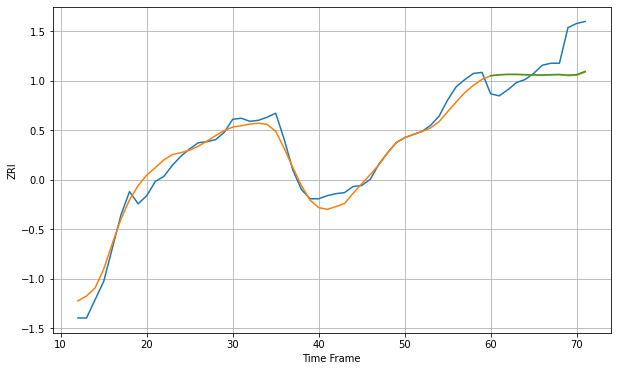

Wall time: 8.14 s
2909 9.55419661428804 26.875834006501076 26.602486647179962 [1251.73401265 1252.71810561 1253.05686574 1253.05446499 1252.80095418
 1252.55577299 1252.4345702  1252.7992163  1253.00415399 1252.31404266
 1252.81376756 1256.05356285]

Got an mse at 0.0050 in round 77 and stopped training

60 60 12


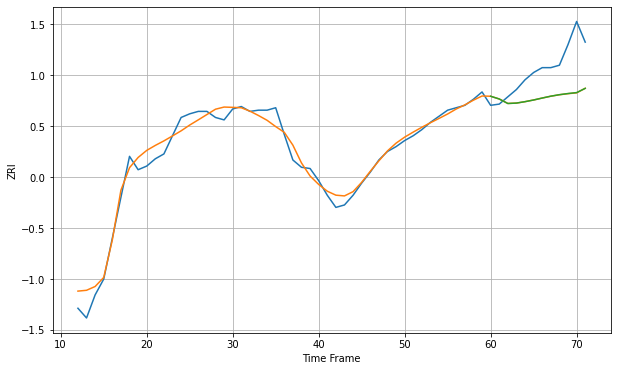

Wall time: 8.03 s
2910 7.348382999010573 27.9332738503975 27.878662586373608 [1212.46212573 1210.20624219 1206.49511032 1206.83676426 1208.00140032
 1209.38703025 1210.98851977 1212.52092097 1213.74782333 1214.69840243
 1215.46756929 1218.95041494]

Got an mse at 0.0050 in round 67 and stopped training

60 60 12


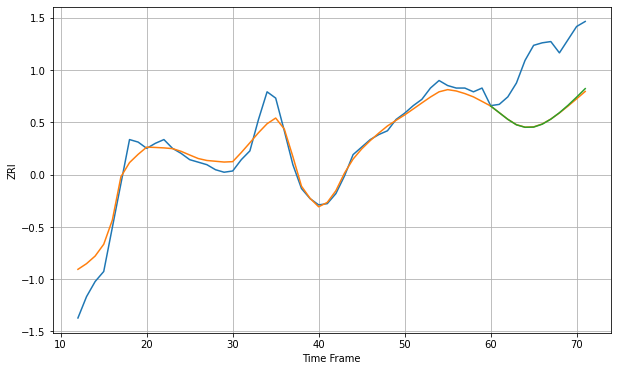

Wall time: 7.38 s
2914 10.516034505287694 48.28440279129642 47.926813479581774 [1251.72288746 1246.40711936 1241.08806044 1236.75772218 1234.77211687
 1234.9201743  1237.24555367 1241.23898244 1246.35894431 1252.27823384
 1258.76638052 1265.52881103]

Got an mse at 0.0050 in round 83 and stopped training

60 60 12


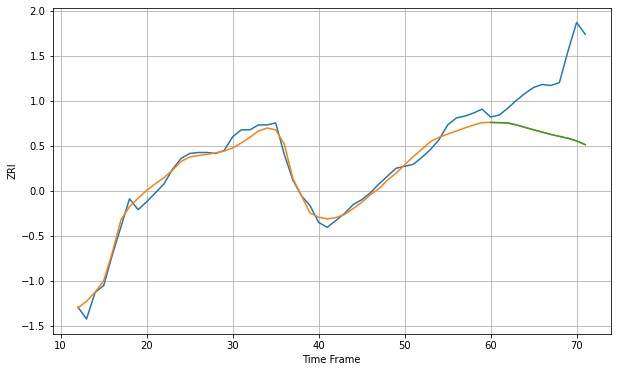

Wall time: 8.92 s
2920 7.46220304329337 62.357951891600514 62.30421809327316 [1223.51764496 1223.28347773 1222.93930576 1220.98792896 1218.47942416
 1216.01580301 1213.72121064 1211.33726578 1209.38775853 1207.46623848
 1204.7927907  1201.05036431]

Got an mse at 0.0050 in round 178 and stopped training

60 60 12


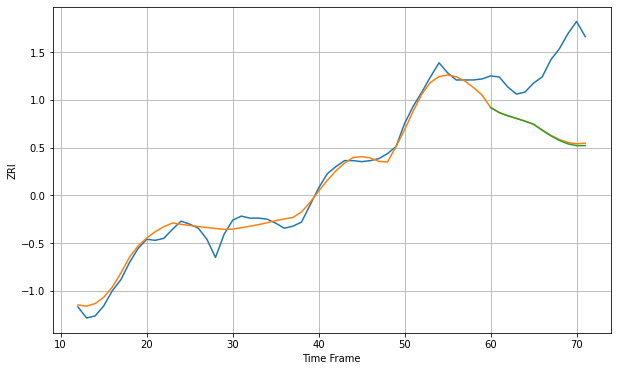

Wall time: 12.4 s
3038 8.054506671933732 70.80020004494548 71.71308909643936 [1334.69295587 1329.64640673 1326.48700563 1323.84510219 1321.13292176
 1318.03279366 1312.1235132  1306.61381135 1302.00846868 1298.61330047
 1296.83853632 1296.91451148]

Got an mse at 0.0050 in round 122 and stopped training

60 60 12


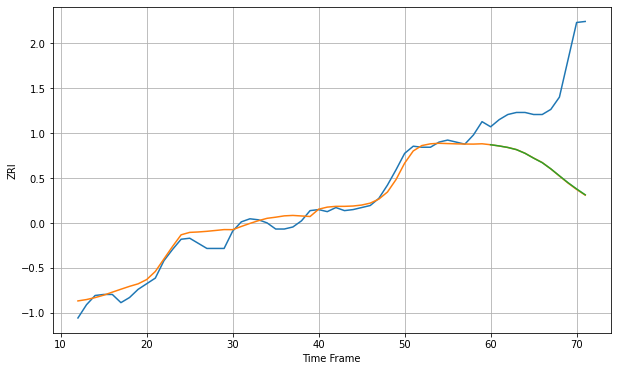

Wall time: 9.1 s
3060 8.224624181089142 85.79965529406597 85.60843764867641 [1418.43219226 1417.23451535 1415.76683086 1413.66316356 1410.0602562
 1405.31961464 1400.90941626 1394.87258249 1388.04387753 1381.3330595
 1375.21594917 1369.47206582]

Got an mse at 0.0049 in round 43 and stopped training

60 60 12


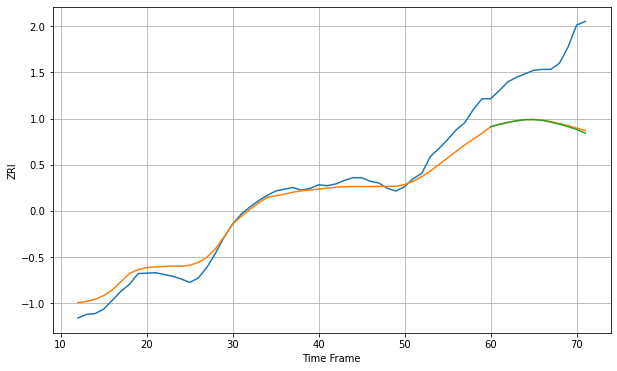

Wall time: 6.58 s
3102 13.037741424182675 70.93942175157227 71.79502626642355 [1272.40321644 1275.06537497 1277.27388661 1279.05790658 1280.36998094
 1280.44515726 1279.64987805 1277.73382335 1275.2565036  1272.5780853
 1269.38875898 1265.21111196]

Got an mse at 0.0050 in round 47 and stopped training

60 60 12


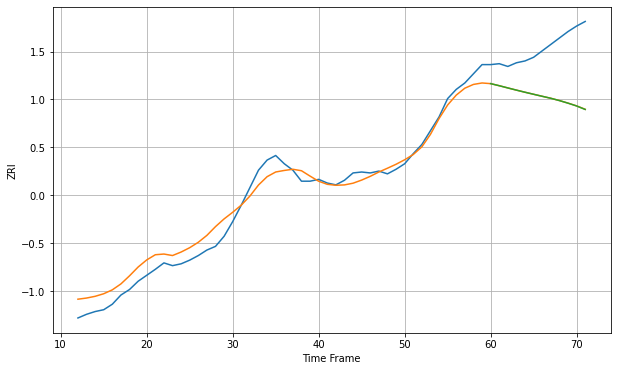

Wall time: 7.35 s
3103 11.969335522511212 56.68709489103841 56.73398196462241 [1259.2760725  1257.01462974 1254.58937924 1252.20572451 1249.89955751
 1247.67879465 1245.47623981 1243.32105419 1240.82004322 1238.0064973
 1234.94289058 1231.13808479]

Got an mse at 0.0049 in round 65 and stopped training

60 60 12


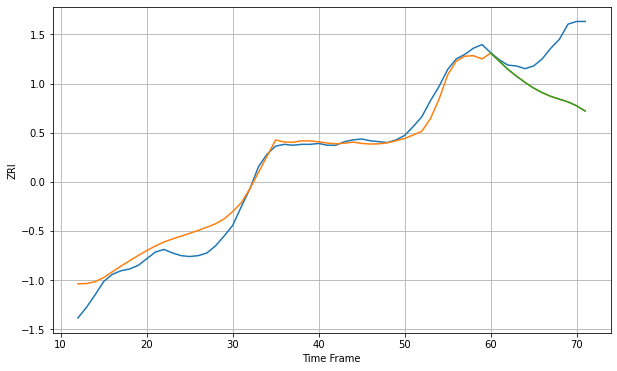

Wall time: 7.71 s
3104 13.479817486942803 55.23192646417455 55.241474833344405 [1288.54743241 1279.47977403 1270.32989738 1262.61090835 1255.56890488
 1249.21014731 1244.07105705 1239.86086181 1236.71717953 1233.68084103
 1229.26857342 1223.41448313]

Got an mse at 0.0050 in round 274 and stopped training

60 60 12


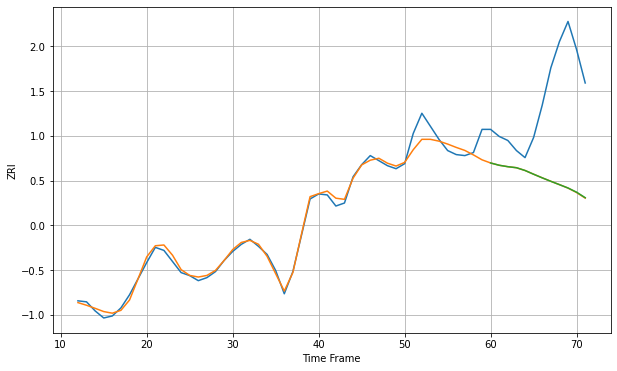

Wall time: 12.9 s
3301 7.268320826209823 92.51469531552077 92.42195082004125 [1277.68471043 1275.41581255 1274.0052114  1272.98487262 1270.24755346
 1266.52733992 1262.94024081 1259.51102402 1256.20785139 1252.86395474
 1248.71021312 1243.27837994]

Got an mse at 0.0050 in round 187 and stopped training

60 60 12


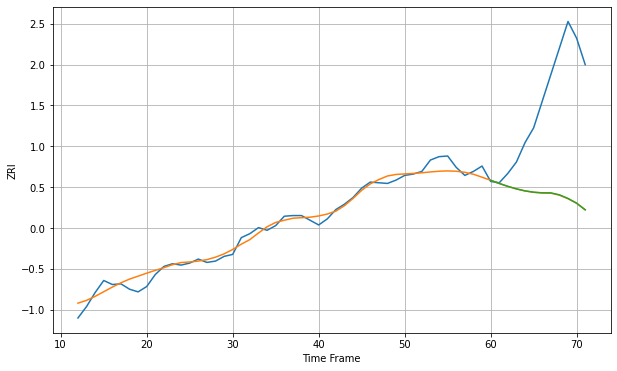

Wall time: 10.9 s
3820 9.972539560377719 156.19066422361445 156.03753006830286 [1362.73250141 1357.98554954 1353.62100828 1349.86791357 1346.8726682
 1344.94138826 1344.0001316  1343.9245477  1340.9612196  1335.57270412
 1328.47917181 1318.49433041]

Got an mse at 0.0050 in round 211 and stopped training

60 60 12


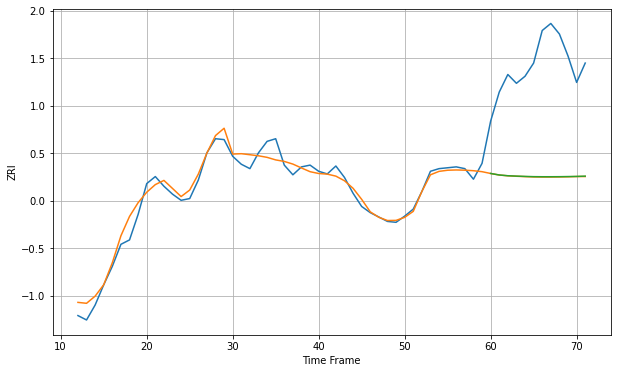

Wall time: 11.1 s
4101 9.49920760758545 128.50622994311536 128.24795130803906 [1666.50735324 1664.80191114 1663.93633117 1663.50923859 1663.17150617
 1662.88633404 1662.79587686 1662.79839355 1662.85063664 1662.99417075
 1663.1622245  1663.48835834]

Got an mse at 0.0050 in round 175 and stopped training

60 60 12


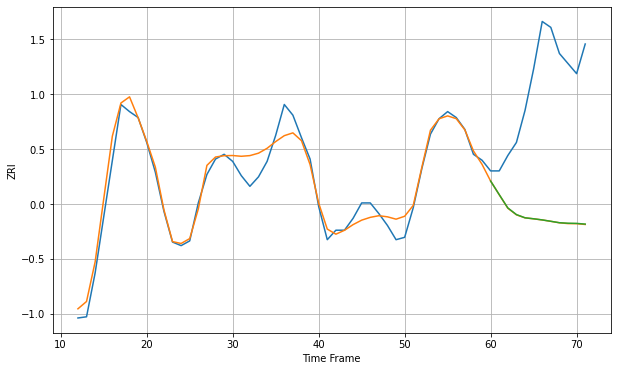

Wall time: 10.1 s
4102 10.098038398818625 116.49055202453991 116.36647926992605 [1633.4251483  1622.01282135 1610.7624479  1605.16898407 1602.46421941
 1601.63182426 1600.68219759 1599.52276564 1598.30789511 1597.89174119
 1597.74269169 1597.15640792]

Got an mse at 0.0050 in round 147 and stopped training

60 60 12


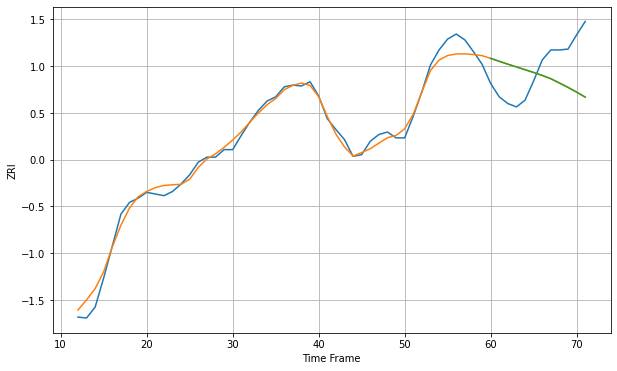

Wall time: 9.65 s
4103 9.033612422868684 47.09700125274889 47.0860373300177 [1600.92318523 1597.4661188  1594.00077666 1590.69003677 1587.41300708
 1584.10516396 1580.57212186 1576.62566528 1571.53637152 1566.28664193
 1560.66866281 1554.68115181]

Got an mse at 0.0050 in round 380 and stopped training

60 60 12


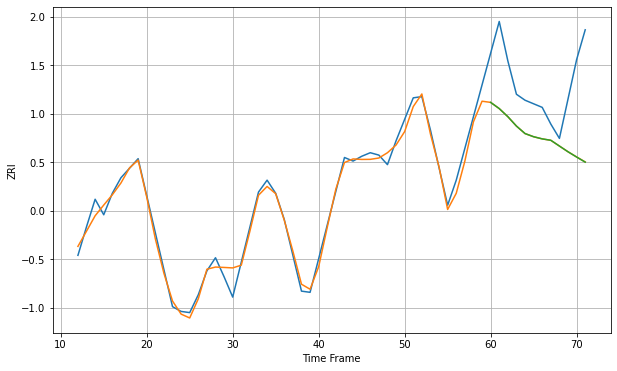

Wall time: 15.6 s
4210 6.664390756264865 52.65354854963014 52.67846497172643 [1045.17842134 1039.99653518 1033.22625584 1025.3438339  1019.06646171
 1016.40270097 1014.60416287 1013.42283197 1008.59092641 1003.78763872
  999.40145573  995.11228842]

Got an mse at 0.0049 in round 261 and stopped training

60 60 12


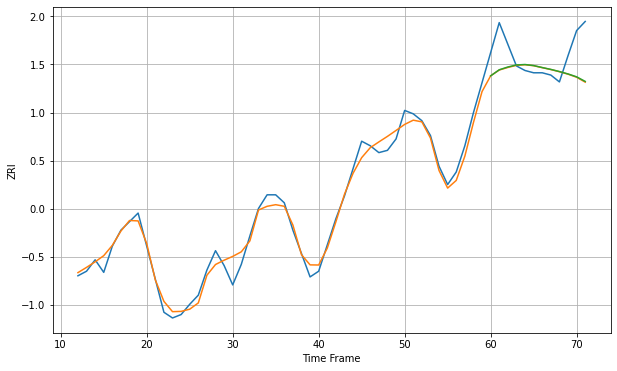

Wall time: 14.1 s
4240 7.6529445900282225 25.023112798823814 24.803338588971037 [1051.30572161 1056.62605557 1059.07271121 1060.86750984 1061.2473369
 1060.33186783 1058.59407152 1056.96253478 1055.08245482 1052.98576356
 1050.46323176 1046.43850444]

Got an mse at 0.0050 in round 152 and stopped training

60 60 12


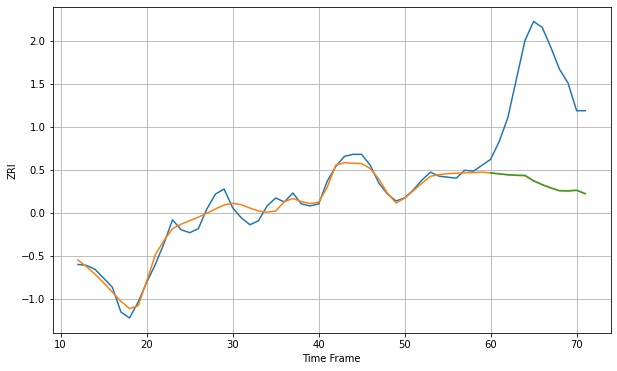

Wall time: 9.59 s
4401 7.291584187499297 109.58697545316538 109.52496626646386 [1114.28583048 1113.37290686 1112.4394185  1111.94444726 1111.8308163
 1106.40017806 1102.41711052 1099.13961176 1096.29874239 1096.07777388
 1096.66287397 1093.44129875]

Got an mse at 0.0050 in round 262 and stopped training

60 60 12


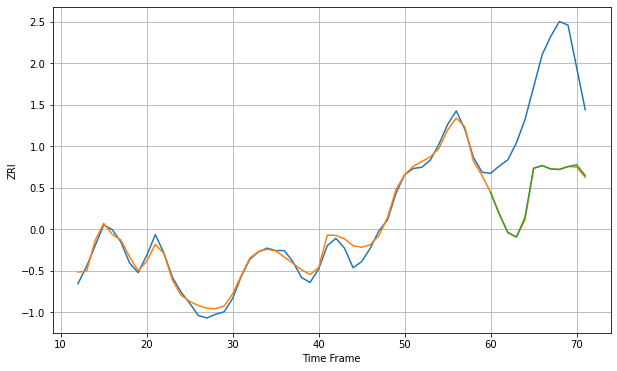

Wall time: 12.2 s
4901 5.248731864705788 81.53741800740166 81.1701869907313 [856.4123845  838.95350403 823.72467448 820.0961342  836.15846456
 876.21523336 878.36786912 875.59566782 875.21695525 877.54322941
 879.01690972 870.17226725]

Got an mse at 0.0049 in round 186 and stopped training

60 60 12


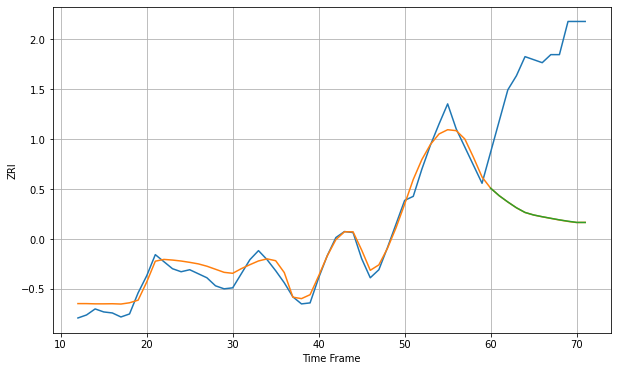

Wall time: 11.1 s
4937 9.241069473954395 153.0615045048243 153.0004127189884 [980.12588585 972.61216416 966.39820765 960.65330016 956.01165507
 953.48465737 951.73975815 950.15944771 948.61428919 947.26400923
 946.08547698 946.01125064]

Got an mse at 0.0050 in round 154 and stopped training

60 60 12


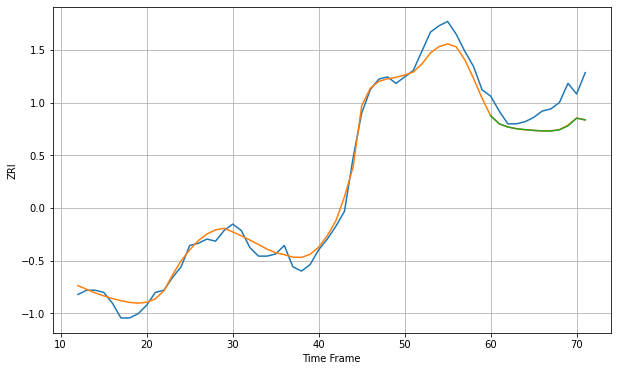

Wall time: 10.1 s
6010 4.427617587316438 11.302198349271237 11.37199776945851 [1053.81000322 1050.03427864 1048.53438347 1047.73212312 1047.26934217
 1046.94245806 1046.6722839  1046.65372482 1047.19222798 1049.09380649
 1052.6501278  1051.84706912]

Got an mse at 0.0050 in round 220 and stopped training

60 60 12


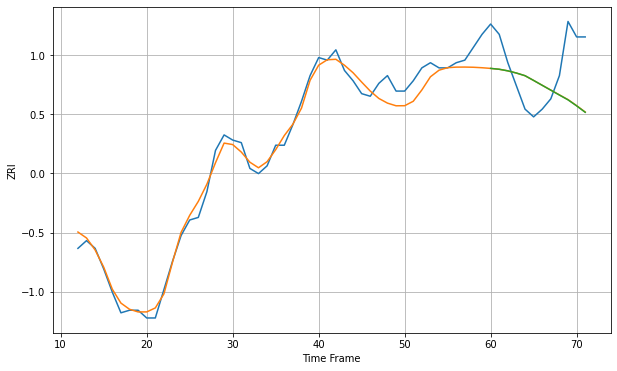

Wall time: 11.8 s
6040 4.333981977942981 17.107106597902803 17.146097144977848 [1182.79650586 1182.45882687 1181.84707657 1180.99850053 1179.96724
 1178.13017881 1176.23733276 1174.35439072 1172.46141556 1170.60279808
 1168.27439162 1165.77425022]

Got an mse at 0.0049 in round 307 and stopped training

60 60 12


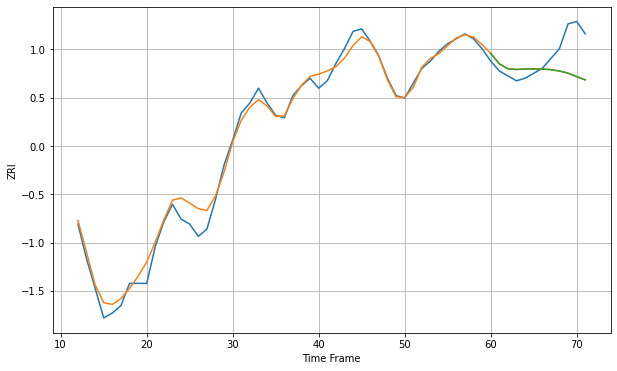

Wall time: 14.1 s
6051 3.697296275775246 10.825792116472789 10.837021297895049 [1104.11098122 1099.86642751 1097.8715413  1097.56830676 1097.75992679
 1097.77174633 1097.74504403 1097.48697302 1096.92159533 1096.07596391
 1094.70290358 1093.34446794]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


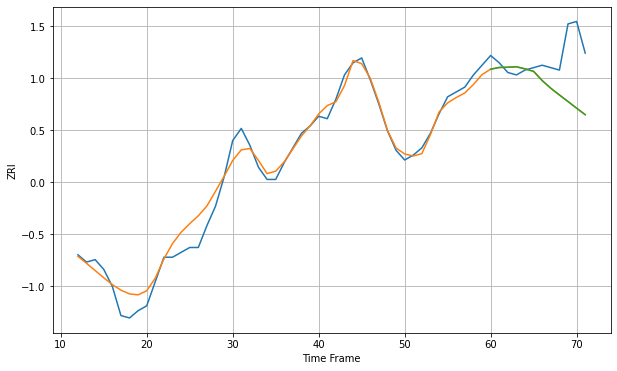

Wall time: 9.6 s
6053 4.754532847826694 16.35272478200565 16.348824014382497 [1160.36966055 1161.07516629 1161.17662399 1161.35493643 1160.50188869
 1159.46784162 1155.66725959 1152.51586409 1149.76196213 1147.0567796
 1144.31260358 1141.65145005]

Got an mse at 0.0050 in round 457 and stopped training

60 60 12


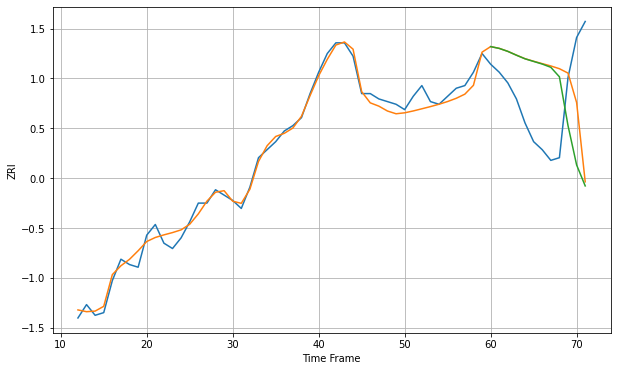

Wall time: 17 s
6082 2.9535335486358227 28.303256411327013 31.034203990120304 [1239.58894855 1238.91433661 1237.79454371 1236.36861267 1235.02026011
 1234.03654313 1233.05530876 1231.84049892 1228.27929136 1209.99626894
 1195.28893832 1187.4398327 ]

Got an mse at 0.0050 in round 333 and stopped training

60 60 12


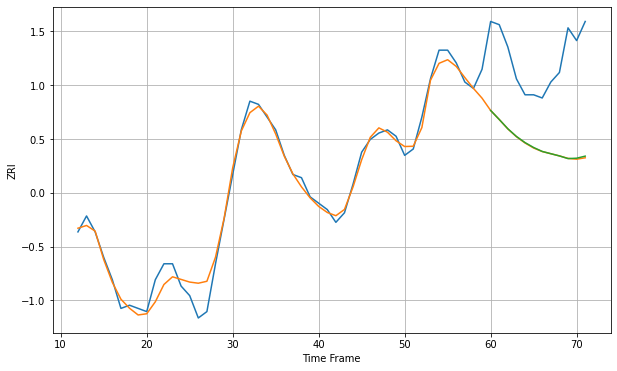

Wall time: 14.5 s
6106 3.3751265473912113 28.16986345558846 28.0525235892847 [1101.08276083 1098.26781274 1095.34552871 1092.9369559  1091.01134482
 1089.47136427 1088.23580757 1087.52482328 1086.8265719  1085.99341914
 1086.11122895 1086.76101855]

Got an mse at 0.0050 in round 230 and stopped training

60 60 12


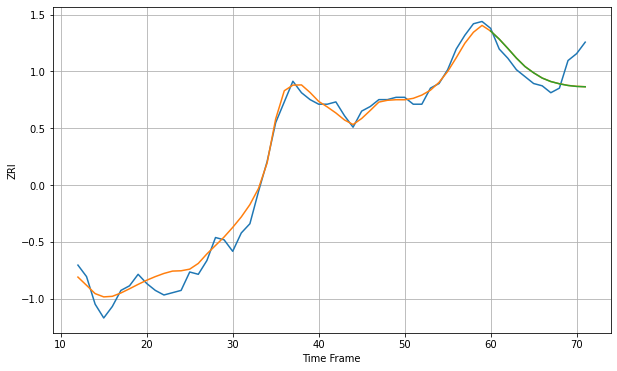

Wall time: 14 s
6108 4.3637842857624785 8.358284096120776 8.375882769869103 [1206.8277532  1203.32236957 1199.27509141 1195.06029718 1191.38211967
 1188.66447492 1186.3756781  1184.86136484 1183.88753847 1183.15007586
 1182.73707525 1182.57780025]

Got an mse at 0.0049 in round 286 and stopped training

60 60 12


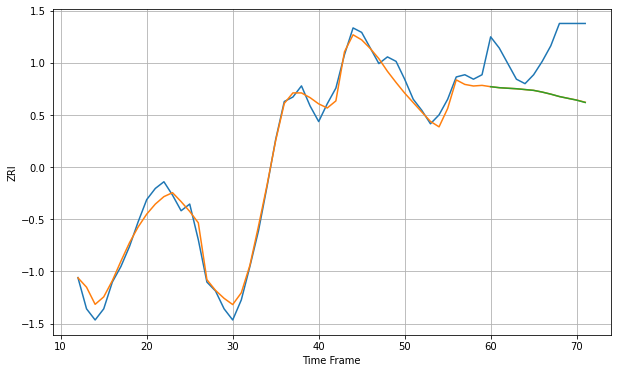

Wall time: 13.4 s
6112 4.384685950768894 22.924087358118054 22.941192350487746 [1130.64051972 1130.19526559 1129.94434886 1129.72251327 1129.35751766
 1128.99557419 1128.22570611 1127.29513242 1126.22141453 1125.41033912
 1124.61323764 1123.55888144]

Got an mse at 0.0050 in round 284 and stopped training

60 60 12


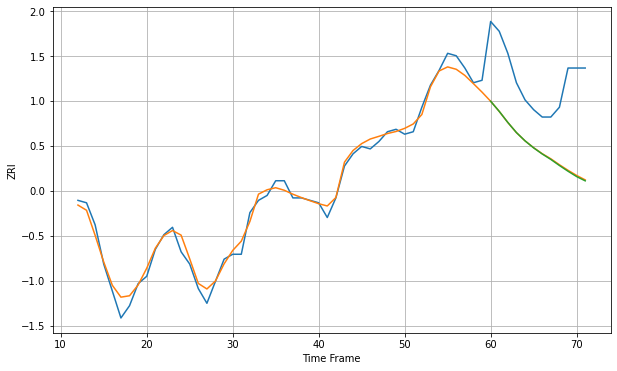

Wall time: 12.8 s
6114 3.171245753485532 29.821998595785434 30.009731939598534 [1106.43974311 1102.31218675 1097.79141032 1093.66445767 1090.27722659
 1087.42167453 1084.92073949 1082.70550479 1080.22154887 1077.88741869
 1075.70808437 1073.96079077]

Got an mse at 0.0049 in round 161 and stopped training

60 60 12


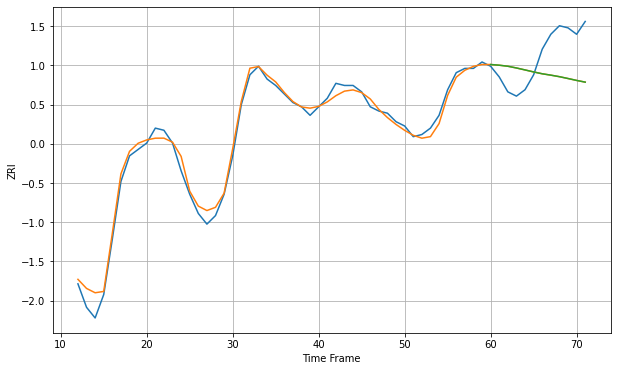

Wall time: 9.85 s
6119 3.4574876488840958 16.70489065346327 16.70494950588608 [1381.8241898  1381.49466013 1381.00602842 1380.19800015 1379.27813725
 1378.33916357 1377.47602271 1376.83283634 1376.11734743 1375.25561703
 1374.36288417 1373.55601034]

Got an mse at 0.0050 in round 239 and stopped training

60 60 12


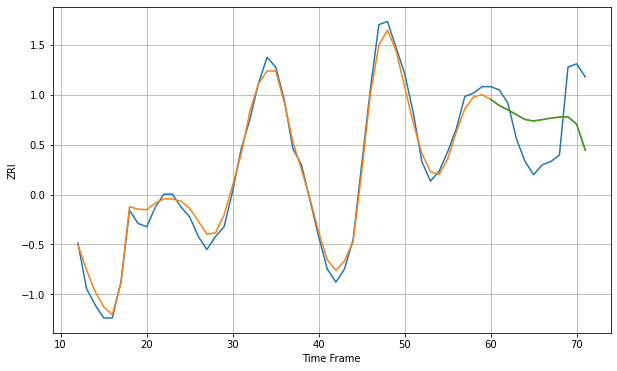

Wall time: 12 s
6320 2.80700946441388 13.31594300826161 13.284187689405028 [1060.07851707 1058.23289038 1056.86581654 1055.40784724 1053.9091412
 1053.46865798 1053.85944756 1054.33988773 1054.66767812 1054.74014416
 1052.52278444 1044.59918558]

Got an mse at 0.0050 in round 302 and stopped training

60 60 12


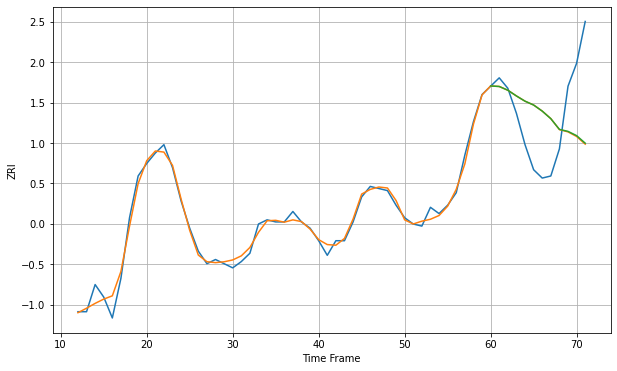

Wall time: 13.3 s
6360 3.007225672868825 26.633897615361473 26.484983351172847 [1110.10910234 1109.86381951 1108.06923774 1105.32576611 1102.82282763
 1100.98508358 1098.06637138 1094.44508158 1089.3077278  1088.36055821
 1086.32099677 1082.71222434]

Got an mse at 0.0050 in round 147 and stopped training

60 60 12


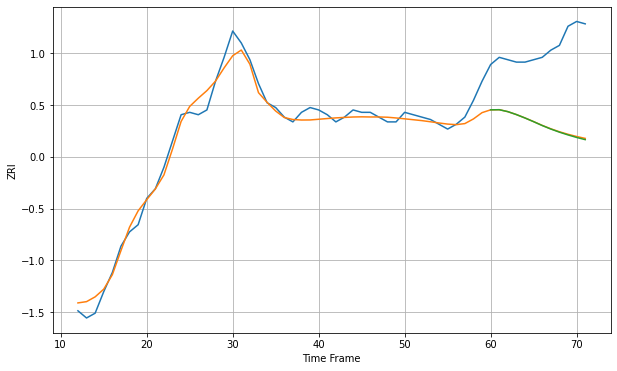

Wall time: 9.35 s
6401 4.06103357669378 32.72609947200642 32.9034657452605 [1216.04361988 1216.10176722 1215.28434007 1214.04947902 1212.62615014
 1211.0865151  1209.47640659 1208.01197772 1206.70520128 1205.54974735
 1204.50159486 1203.57892237]

Got an mse at 0.0050 in round 244 and stopped training

60 60 12


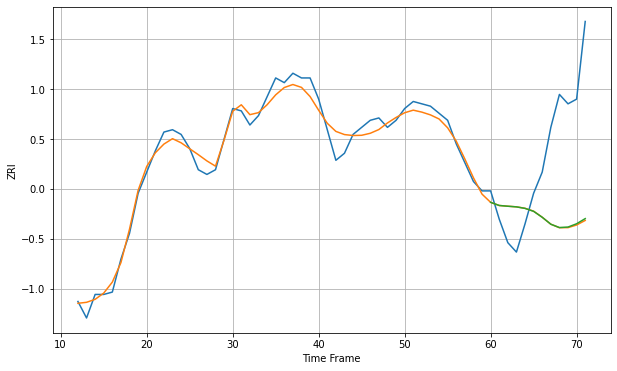

Wall time: 13.1 s
6405 4.057254614414731 39.599139429089114 39.368957097093144 [1293.13401962 1291.80489962 1291.4855421  1291.21257347 1290.56695187
 1289.31325754 1286.78887634 1283.84010125 1282.41920222 1282.63744166
 1284.03364711 1286.22289309]

Got an mse at 0.0048 in round 211 and stopped training

60 60 12


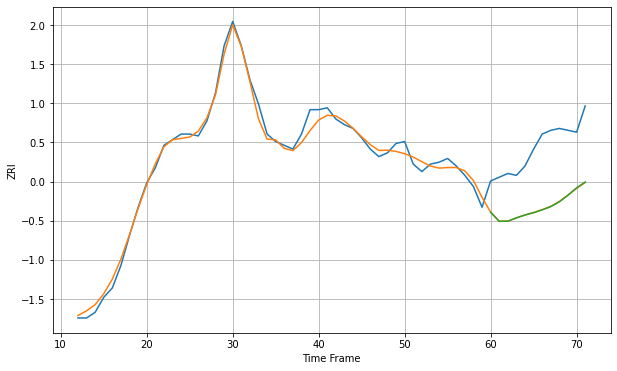

Wall time: 11.7 s
6418 3.4989339268368425 32.064884921553755 32.082369493105574 [1191.35894292 1186.49813098 1186.57864158 1188.33983668 1189.8692127
 1191.11561449 1192.60731558 1194.34161352 1196.93443065 1200.41795152
 1204.34298758 1207.43977379]

Got an mse at 0.0050 in round 153 and stopped training

60 60 12


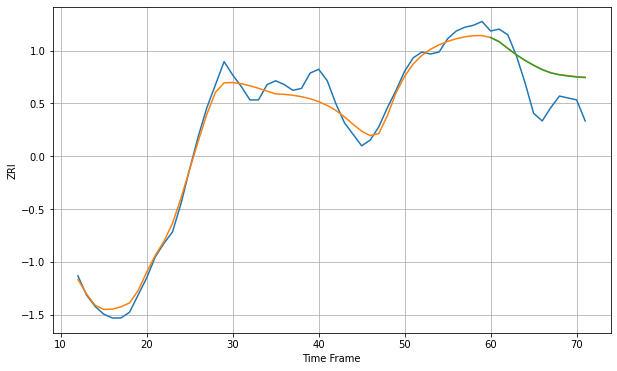

Wall time: 9.94 s
6450 5.503788642452705 15.406515363303534 15.368424811479624 [1157.60248625 1155.41453638 1151.88876277 1148.58628555 1145.65625332
 1143.08922826 1140.84317421 1139.1333737  1138.11665317 1137.48625418
 1136.94638238 1136.7044928 ]

Got an mse at 0.0050 in round 343 and stopped training

60 60 12


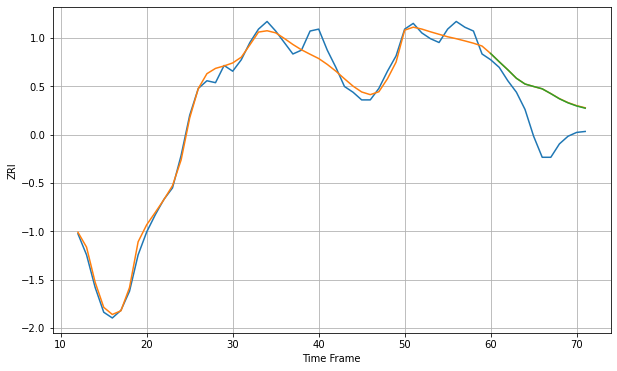

Wall time: 16.6 s
6451 4.6232246449883725 19.506724129214483 19.46254681770508 [1140.24689495 1135.92107652 1131.73339955 1127.29203496 1124.30205068
 1123.00931368 1121.78025724 1119.26461434 1116.58657926 1114.45573228
 1112.83566594 1111.65412671]

Got an mse at 0.0050 in round 367 and stopped training

60 60 12


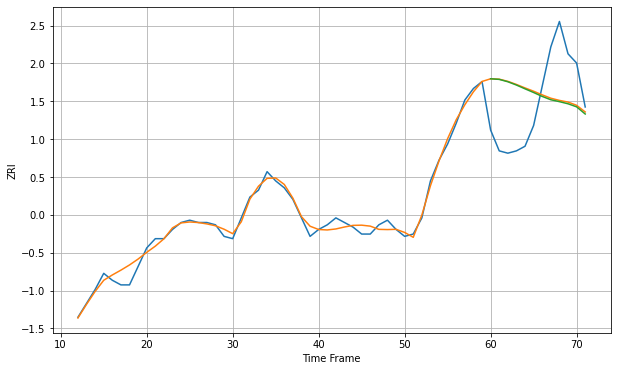

Wall time: 15.7 s
6457 2.553375706374969 23.369787590213132 23.4872207701561 [1254.19422299 1253.93180735 1252.911638   1251.4833046  1249.85077024
 1248.25507596 1246.56124412 1245.12251731 1244.29875995 1243.38123299
 1242.05510009 1238.95039208]

Got an mse at 0.0050 in round 215 and stopped training

60 60 12


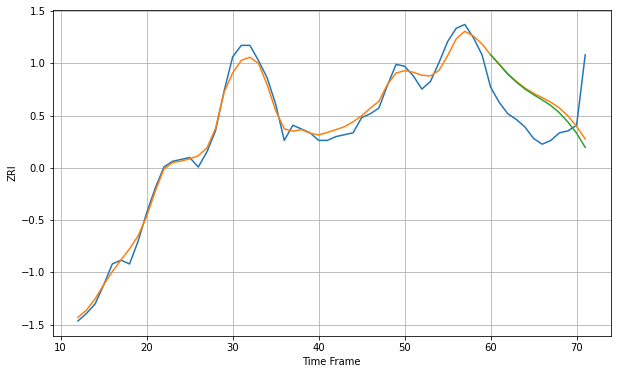

Wall time: 11.3 s
6460 3.9580565758845423 21.83488246504396 22.067425350523088 [1454.05374901 1449.01062523 1443.80981646 1439.65810948 1436.01879733
 1433.03863778 1430.33447801 1427.3531943  1423.53711601 1418.61085771
 1412.79550303 1405.31660824]

Got an mse at 0.0050 in round 492 and stopped training

60 60 12


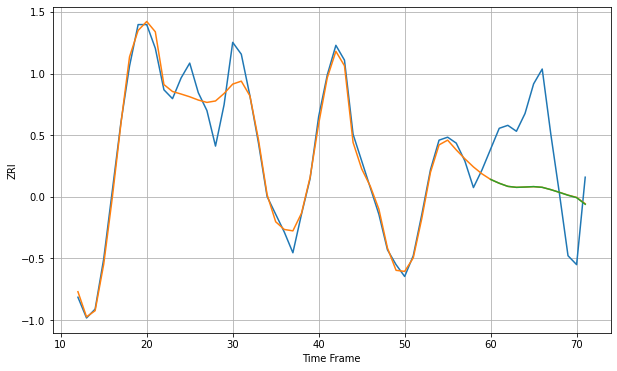

Wall time: 19.4 s
6484 4.408621743029421 22.372880216278308 22.366727950705695 [1422.74356531 1421.45982641 1420.40634867 1420.07984107 1420.18379122
 1420.32343135 1420.0849598  1419.29974407 1418.38183028 1417.41139656
 1416.59924108 1414.36065577]

Got an mse at 0.0050 in round 284 and stopped training

60 60 12


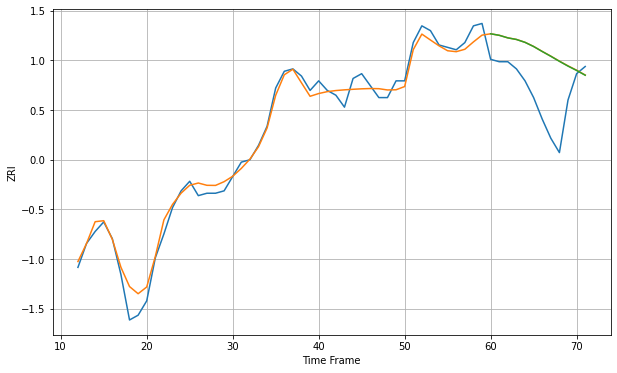

Wall time: 12.9 s
6489 4.044291909414166 20.139102304559785 20.101327162233858 [1258.68099914 1258.04887946 1256.97131967 1256.30275902 1255.09784761
 1253.35865794 1251.27413823 1249.27445657 1247.16308513 1245.16950788
 1243.34697963 1241.3523896 ]

Got an mse at 0.0050 in round 164 and stopped training

60 60 12


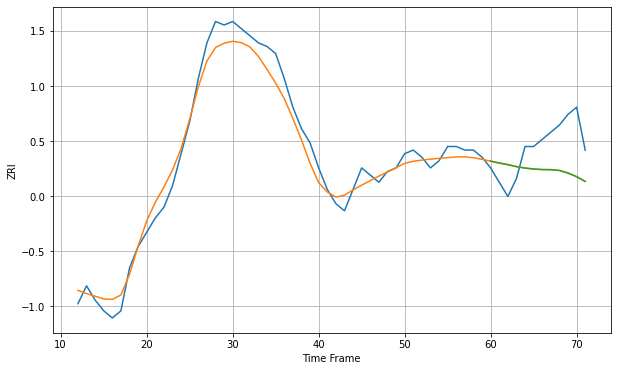

Wall time: 10.6 s
6492 3.7054277395441364 10.286358913268138 10.27263656674209 [1214.90048909 1214.37599891 1213.91194578 1213.36724057 1212.96852999
 1212.69013971 1212.54100509 1212.51888924 1212.30082207 1211.57400211
 1210.56750796 1209.23958242]

Got an mse at 0.0050 in round 136 and stopped training

60 60 12


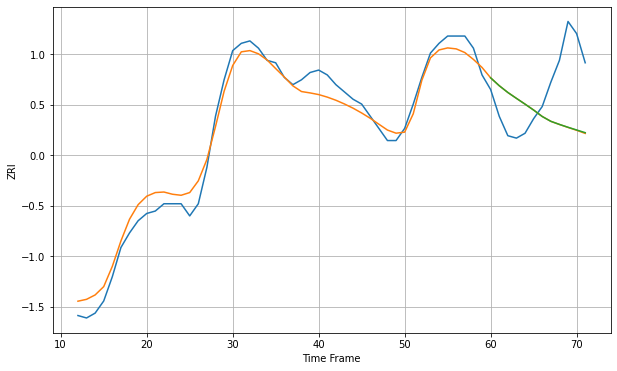

Wall time: 9.19 s
6511 5.235837313317714 22.769651303493603 22.702341104663457 [1261.80846653 1258.56982562 1255.78414588 1253.35989384 1250.98781807
 1248.54455912 1245.89600569 1243.91853707 1242.64497974 1241.46701086
 1240.35797748 1239.24612069]

Got an mse at 0.0050 in round 204 and stopped training

60 60 12


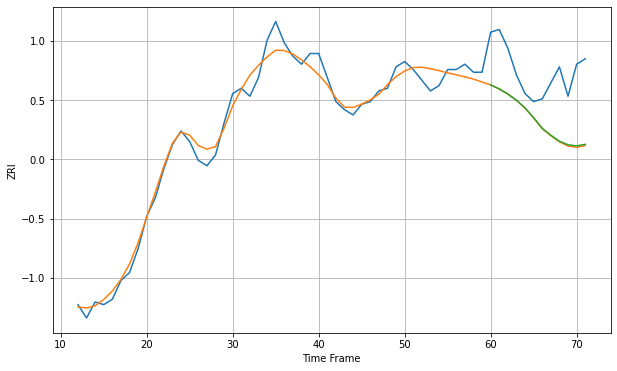

Wall time: 11 s
6512 3.8661183972489472 20.42591639932968 20.215366751502483 [1310.23730501 1308.76187821 1306.81692124 1304.52295748 1301.61856653
 1297.97942649 1293.99865044 1291.41101179 1289.1819782  1287.8360999
 1287.42216229 1287.98402142]

Got an mse at 0.0049 in round 192 and stopped training

60 60 12


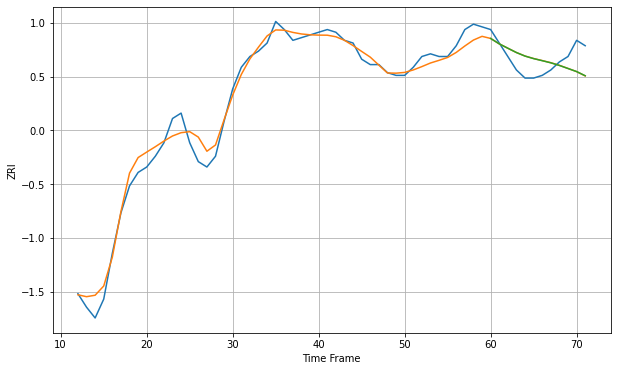

Wall time: 10.6 s
6513 3.664739733041839 6.45853160710546 6.439480054782923 [1247.70236073 1245.69458683 1244.07352327 1242.47319449 1241.15806408
 1240.21896121 1239.44805904 1238.65231896 1237.67803674 1236.54663591
 1235.41011216 1233.86459457]

Got an mse at 0.0049 in round 164 and stopped training

60 60 12


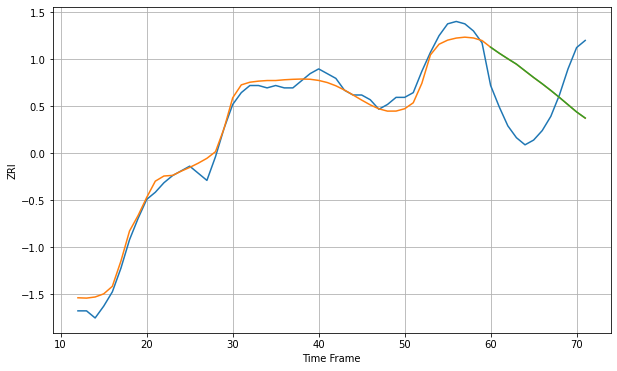

Wall time: 10.9 s
6515 3.8704611102950395 23.70707967272996 23.71301326732792 [1238.13564392 1235.62012681 1233.27903505 1231.01125086 1228.20055915
 1225.39711133 1222.73683302 1219.92519023 1216.97995651 1213.91436971
 1210.858692   1208.2921834 ]

Got an mse at 0.0050 in round 259 and stopped training

60 60 12


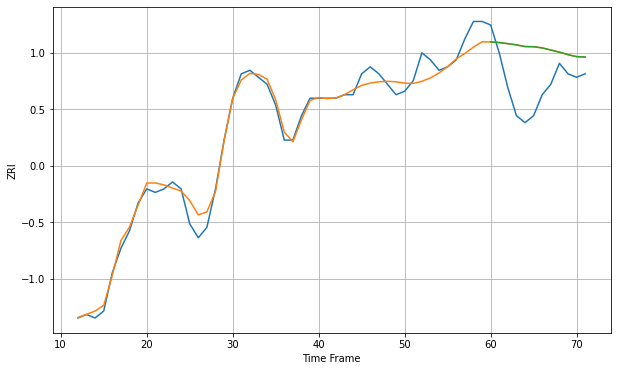

Wall time: 13.2 s
6516 2.9300561029571113 12.401346182733223 12.398920087980613 [1267.12222052 1266.95055628 1266.63674097 1266.29254084 1265.81200173
 1265.75964006 1265.41595902 1264.81243453 1264.20067672 1263.48044567
 1262.91029203 1262.80997822]

Got an mse at 0.0050 in round 147 and stopped training

60 60 12


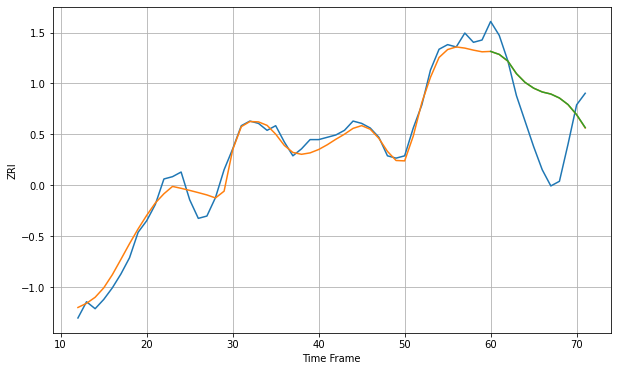

Wall time: 10.1 s
6519 4.184285340742252 21.923841768678308 21.918637045233705 [1281.07116248 1279.78622688 1276.92263795 1271.49315516 1267.7255723
 1265.22204192 1263.56276045 1262.67528215 1260.958984   1258.14188964
 1253.78913112 1248.19238326]

Got an mse at 0.0049 in round 69 and stopped training

60 60 12


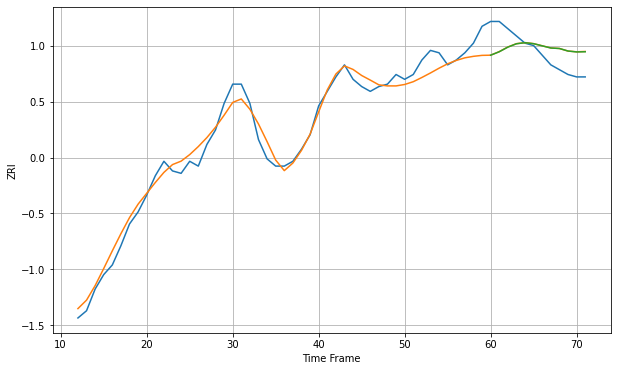

Wall time: 7.71 s
6604 4.4686223758471515 8.55140043288137 8.541921819746848 [1342.0091909  1343.43726438 1345.34826964 1346.7451573  1347.19416987
 1346.77721983 1345.88616116 1344.99121034 1344.78149513 1343.74019429
 1343.36096323 1343.43592127]

Got an mse at 0.0050 in round 168 and stopped training

60 60 12


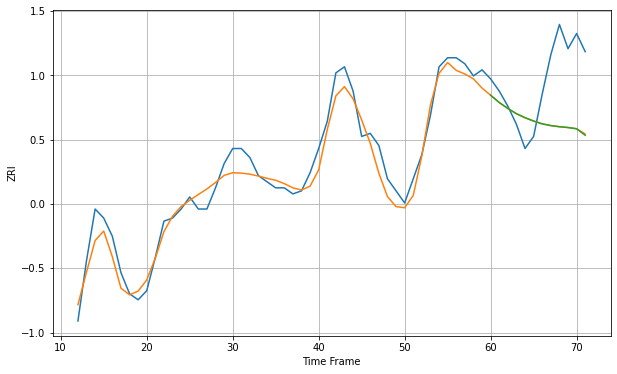

Wall time: 10.3 s
6605 4.619788395900114 19.1103677682593 19.16420841671768 [1403.61174262 1401.20354536 1399.23779228 1397.50468746 1396.17740233
 1395.07830973 1394.14207494 1393.57767771 1393.20625391 1392.94317391
 1392.5210747  1390.3623153 ]

Got an mse at 0.0050 in round 96 and stopped training

60 60 12


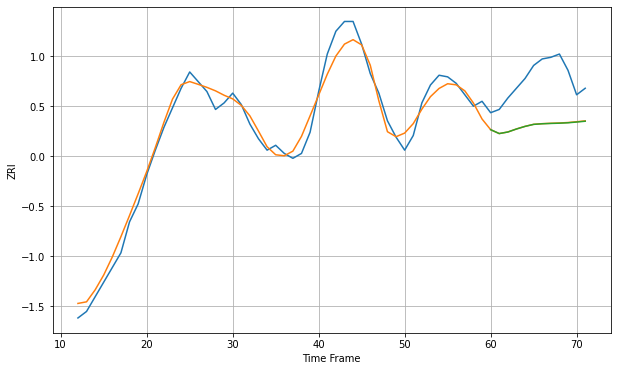

Wall time: 8.08 s
6606 6.715642825236864 29.247398413566128 29.325071295761788 [1400.58066827 1398.19698796 1399.14809614 1400.99331178 1402.5909505
 1403.82932727 1404.20527185 1404.40807937 1404.55711734 1404.80954189
 1405.26481422 1405.76475362]
60 60 12


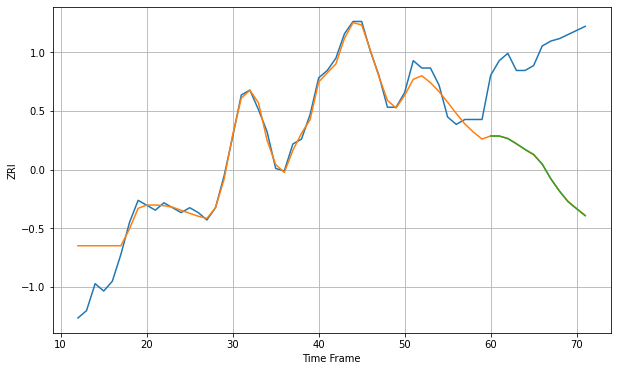

Wall time: 18.2 s
6607 7.546408042360695 51.022255227325424 51.05899143534473 [1302.26273579 1302.24799529 1301.23494196 1299.09133556 1296.78258861
 1294.70068041 1290.78923203 1284.81889624 1279.82209476 1275.46441735
 1272.55356061 1269.71636023]

Got an mse at 0.0050 in round 157 and stopped training

60 60 12


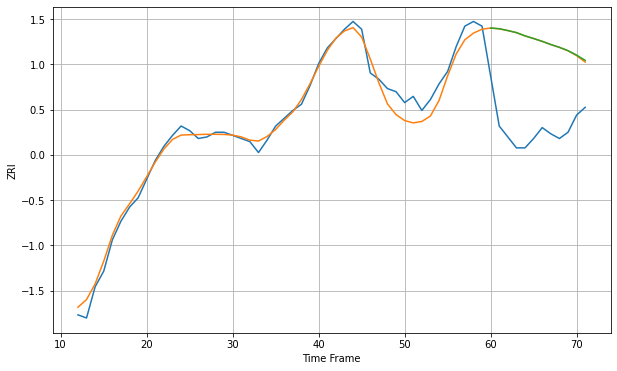

Wall time: 10 s
6608 5.958556428782226 56.94530665349915 57.04920485226483 [1371.79429055 1371.3314834  1370.18083703 1368.87269938 1366.78321858
 1365.07923602 1363.2611236  1361.21495361 1359.42518321 1357.2915707
 1354.44354394 1351.06490913]

Got an mse at 0.0050 in round 90 and stopped training

60 60 12


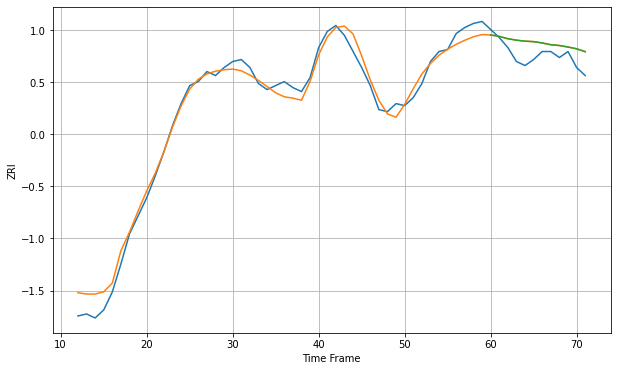

Wall time: 8.62 s
6610 4.950658854874124 7.464683785089203 7.466618884050657 [1325.27092373 1324.54413452 1323.39079232 1322.66343029 1322.16428146
 1321.92356808 1321.26623842 1320.38687274 1319.9903202  1319.23930775
 1318.3594271  1316.9375127 ]

Got an mse at 0.0050 in round 270 and stopped training

60 60 12


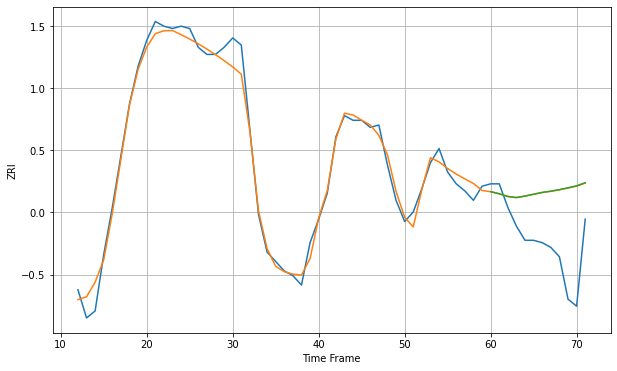

Wall time: 12.9 s
6614 4.556005327202798 25.54931253997244 25.612479005075 [1480.66624749 1479.78604218 1478.62128969 1478.16472962 1478.80324684
 1479.58417741 1480.35402195 1480.87639308 1481.54375854 1482.31198744
 1483.16228219 1484.48717971]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


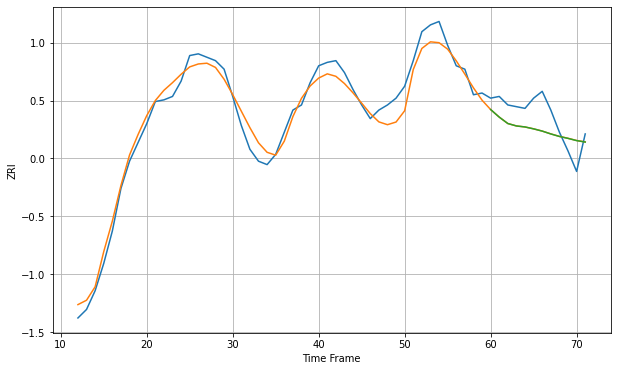

Wall time: 8.97 s
6615 6.790883619158003 13.018425276960603 13.018051682206787 [1463.30749988 1458.87239679 1455.10854684 1453.68572479 1453.08972499
 1451.97439758 1450.66417967 1448.99705483 1447.52207538 1446.38985789
 1445.08445072 1444.2319556 ]

Got an mse at 0.0050 in round 239 and stopped training

60 60 12


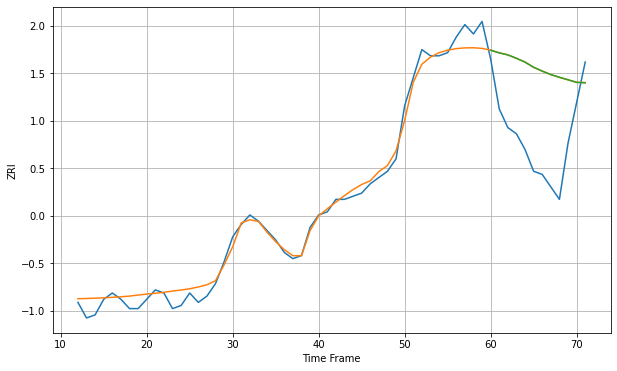

Wall time: 13 s
6704 3.113890077652465 25.431244905151395 25.452031252491413 [979.78109472 978.93967885 978.2860314  977.21105017 975.98310726
 974.32956688 973.10971025 972.00105179 971.11693013 970.32045354
 969.48992944 969.34622198]

Got an mse at 0.0050 in round 188 and stopped training

60 60 12


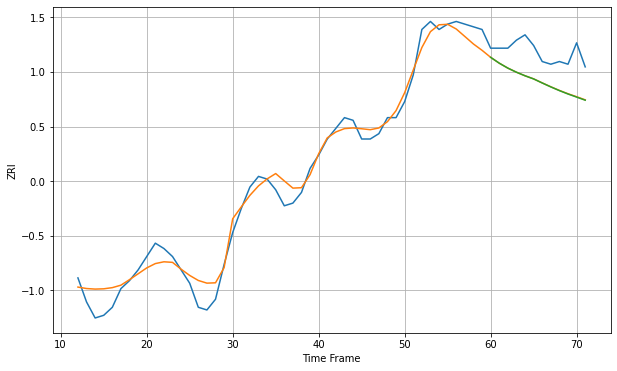

Wall time: 11.3 s
6705 4.906595703477046 11.430980457072447 11.482178588329393 [1002.57572239 1000.38980527  998.53768484  997.00352855  995.66652044
  994.48921458  992.96981539  991.50090973  990.11411778  988.84244532
  987.69170929  986.52964365]

Got an mse at 0.0050 in round 108 and stopped training

60 60 12


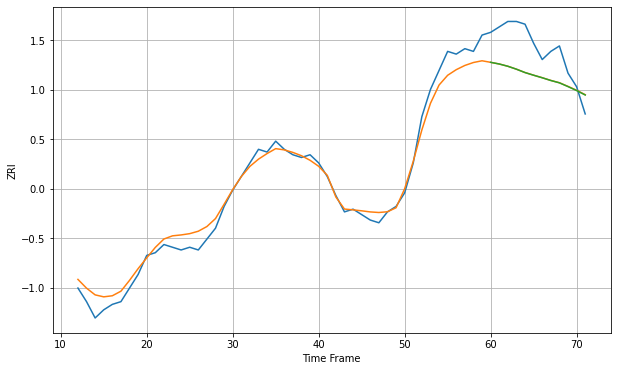

Wall time: 9.41 s
6708 3.880047838533933 12.10150843907064 12.108118854353776 [1002.98022915 1002.3647268  1001.53177839 1000.45406953  999.21618014
  998.23702625  997.30405171  996.29895413  995.43769369  994.05382197
  992.60374752  990.96636385]

Got an mse at 0.0050 in round 338 and stopped training

60 60 12


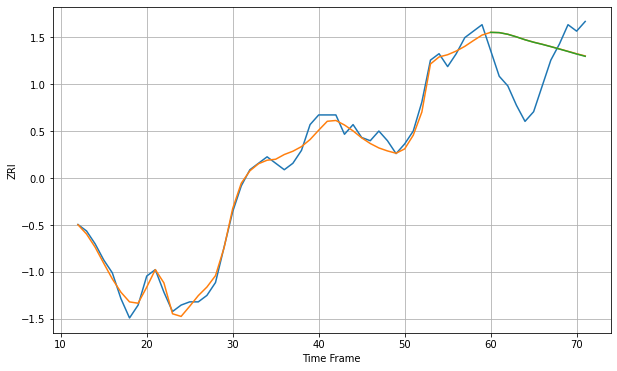

Wall time: 14.6 s
6710 2.439468812596429 14.286396174764173 14.289399154617987 [921.62032464 921.53770211 921.02079061 920.21710106 919.31936307
 918.55495548 917.90456675 917.18900029 916.4451934  915.68675947
 914.90542208 914.18647347]

Got an mse at 0.0049 in round 174 and stopped training

60 60 12


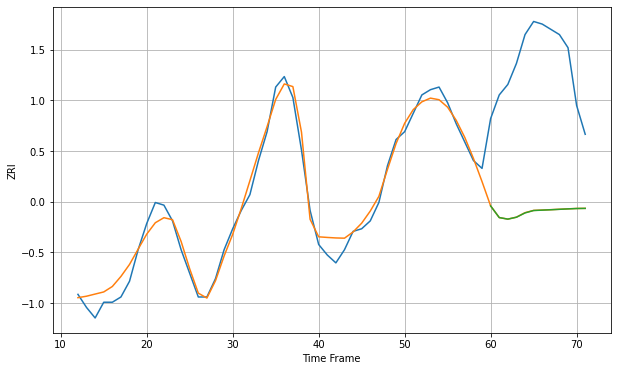

Wall time: 10.7 s
6770 4.098844383132678 57.32741450725518 57.3551613240459 [1097.70092586 1093.26838056 1092.66997976 1093.39966047 1095.03054163
 1095.95247805 1096.09451782 1096.24334996 1096.40950783 1096.57098338
 1096.71646826 1096.76597109]

Got an mse at 0.0050 in round 329 and stopped training

60 60 12


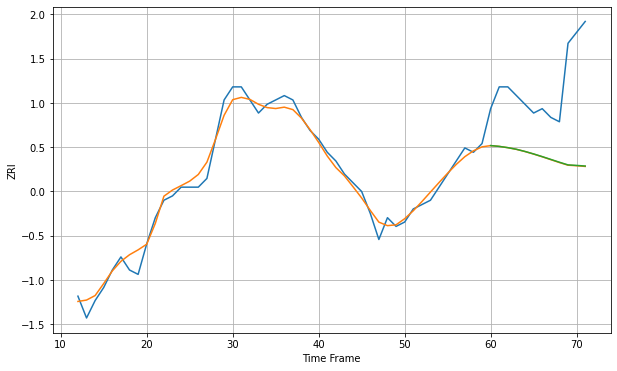

Wall time: 15.3 s
6790 1.9329125631482265 18.113167135129082 18.067750770618254 [863.5324212  863.34933717 863.06043055 862.68422098 862.18746727
 861.61902916 861.00671928 860.36276995 859.71559225 859.1047618
 858.98744314 858.8444522 ]

Got an mse at 0.0050 in round 378 and stopped training

60 60 12


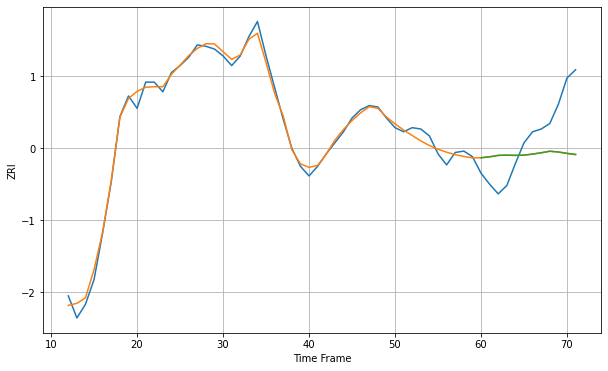

Wall time: 16 s
6810 4.451544754763779 30.071199030415958 30.01028866021494 [1647.18450992 1647.84815806 1648.90119936 1649.07559383 1648.89390613
 1649.09439359 1649.81209841 1650.77715606 1651.86337072 1651.37322658
 1650.40563713 1649.64208693]

Got an mse at 0.0050 in round 328 and stopped training

60 60 12


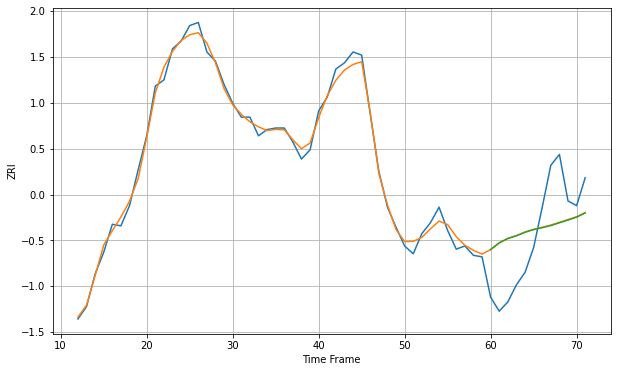

Wall time: 14.8 s
6824 4.296413915854416 29.77091853798851 29.850868103698634 [1842.72974537 1847.01950153 1849.85361582 1851.57977962 1853.86873132
 1855.56848514 1856.82171144 1858.17052701 1859.95537415 1861.73710124
 1863.60886047 1866.30187938]

Got an mse at 0.0050 in round 423 and stopped training

60 60 12


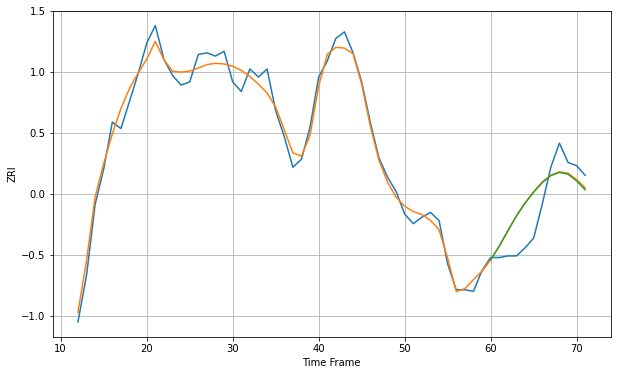

Wall time: 17.2 s
6825 6.495369762458332 16.404296410386127 16.465592103133048 [1642.55975128 1651.01823619 1660.57982622 1669.78921535 1677.7076055
 1684.52438947 1690.4530685  1694.82676948 1696.79658286 1695.74099774
 1691.51948609 1685.9564761 ]

Got an mse at 0.0050 in round 386 and stopped training

60 60 12


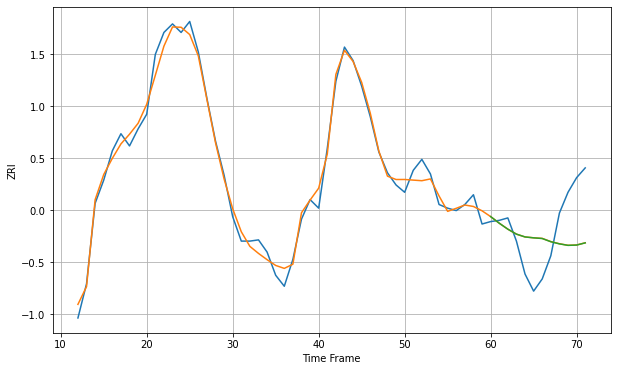

Wall time: 18.8 s
6830 7.601461299675466 33.598043250840874 33.615030062624356 [2317.08151396 2311.67113191 2306.77632083 2302.72150992 2300.41222367
 2299.66766438 2299.12089483 2296.49196574 2294.73560835 2293.50349745
 2293.7482955  2295.55136002]

Got an mse at 0.0050 in round 142 and stopped training

60 60 12


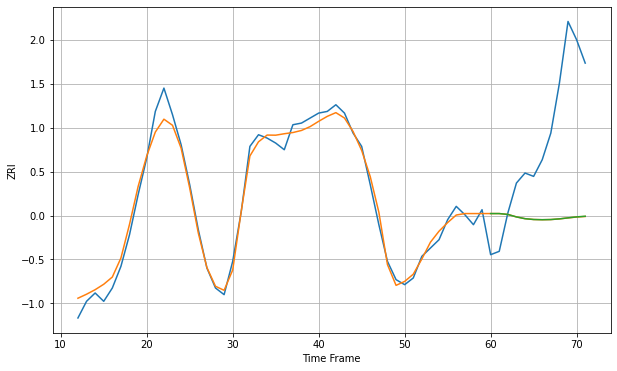

Wall time: 10.2 s
6851 5.633123261342001 62.78264917902421 62.74712666086117 [1815.68107242 1815.68107242 1815.14629246 1813.66498025 1812.60742382
 1812.11342516 1811.98803433 1812.09018739 1812.49438608 1813.10744476
 1813.68143795 1814.06970031]

Got an mse at 0.0049 in round 331 and stopped training

60 60 12


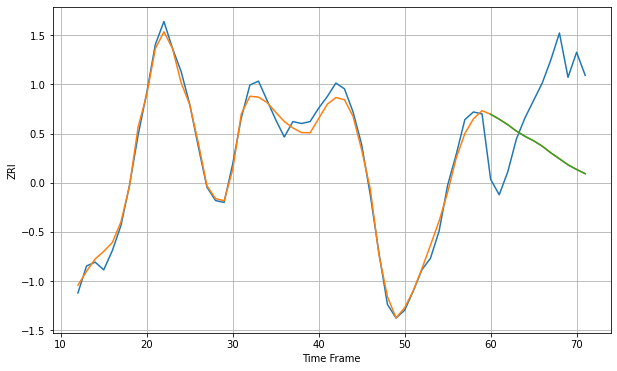

Wall time: 14.3 s
6854 4.158410625668291 40.68603083046914 40.691698986528536 [1831.80239354 1829.24874397 1826.3646621  1823.04820072 1820.33589414
 1818.04082729 1815.24455062 1811.78808285 1808.69213142 1805.5339782
 1803.12817498 1800.92127843]

Got an mse at 0.0050 in round 313 and stopped training

60 60 12


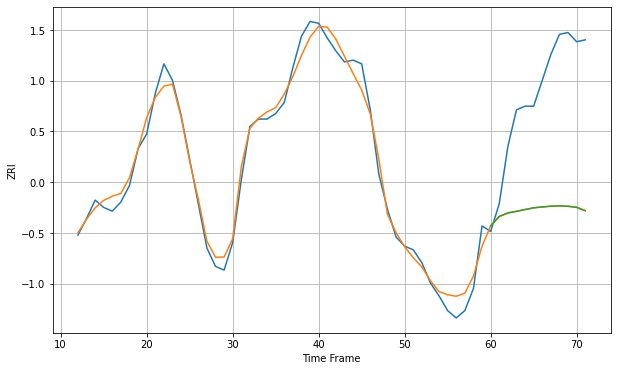

Wall time: 13.8 s
6855 5.959768633666761 68.5352928415399 68.51161299916724 [1800.97741331 1806.08573452 1808.00756138 1808.90220599 1809.86612203
 1810.82798839 1811.26796439 1811.70409927 1811.88752629 1811.66796272
 1811.09684985 1809.28816015]

Got an mse at 0.0050 in round 378 and stopped training

60 60 12


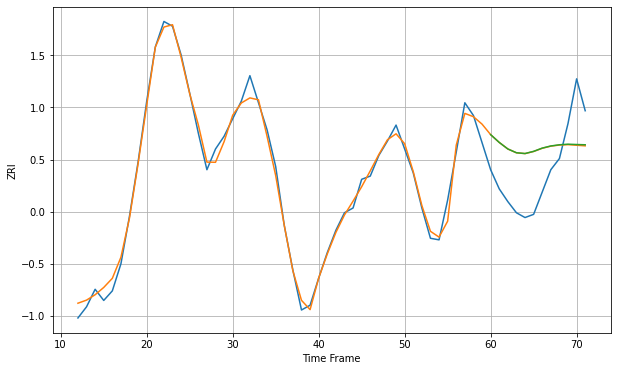

Wall time: 15.5 s
6902 5.02303573143277 29.498455365856174 29.427063874072463 [2124.00589091 2119.12520828 2115.02078525 2112.64543051 2112.15599227
 2113.51591148 2115.5564491  2116.9021891  2117.64764036 2118.01777698
 2117.80899864 2117.64877341]

Got an mse at 0.0048 in round 206 and stopped training

60 60 12


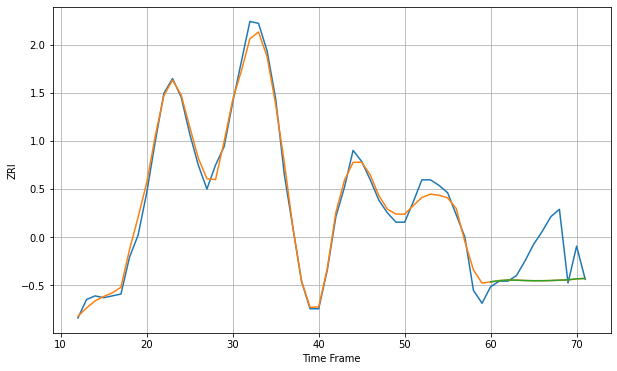

Wall time: 11.3 s
6906 4.797080372315813 18.79105378324878 18.7860758367441 [1918.60224171 1919.26450523 1919.60144546 1919.53736965 1919.33163058
 1919.22390457 1919.23132725 1919.32555833 1919.52971337 1919.70106527
 1920.25596424 1920.48749399]

Got an mse at 0.0049 in round 41 and stopped training

60 60 12


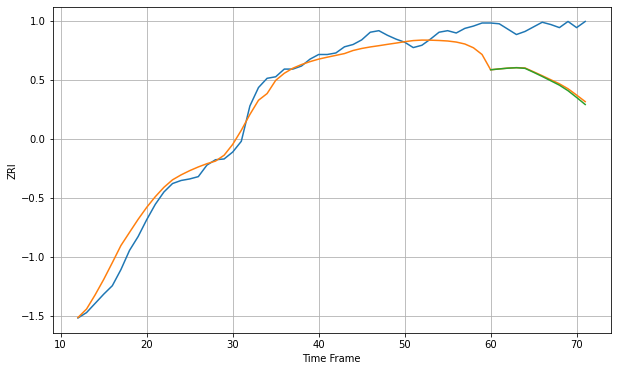

Wall time: 6.22 s
7002 14.495100916241958 70.0689154200858 71.56701070744055 [1773.08839096 1774.19836588 1775.18620185 1775.77237417 1774.96371044
 1769.79481985 1764.40321198 1758.77406432 1753.07649898 1745.87998269
 1737.08004398 1727.91092231]

Got an mse at 0.0049 in round 106 and stopped training

60 60 12


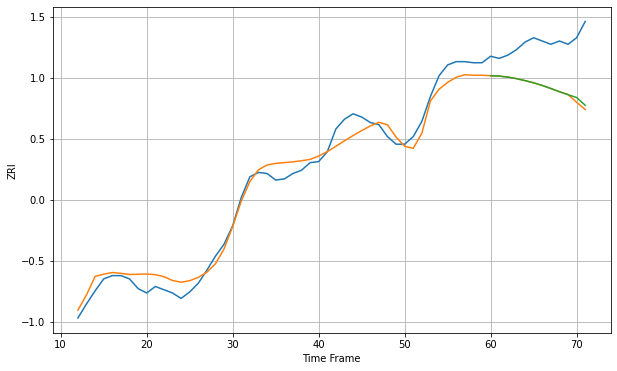

Wall time: 8.63 s
7003 10.315702229089974 43.24137635370119 42.159196118778155 [1629.05088265 1628.69084991 1627.79539364 1626.37678439 1624.53533364
 1622.5255308  1620.10325506 1617.28626343 1614.32534    1611.57979569
 1608.96175731 1601.84431822]

Got an mse at 0.0050 in round 163 and stopped training

60 60 12


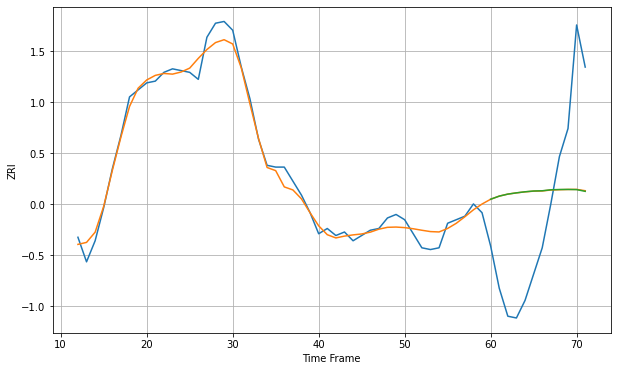

Wall time: 9.92 s
7030 5.356814378821762 54.68073048288533 54.75111386375423 [2527.66921416 2529.45130258 2530.59812079 2531.31825782 2531.92375777
 2532.36666682 2532.50031771 2533.06032461 2533.21407974 2533.26742477
 2533.16502279 2532.17643561]

Got an mse at 0.0050 in round 142 and stopped training

60 60 12


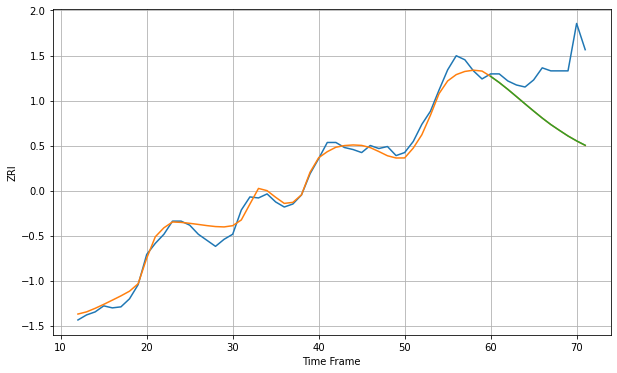

Wall time: 9.43 s
7055 7.574580772267465 55.5619222071014 55.531480412480455 [1733.5453274  1727.43563049 1720.66142881 1713.51238325 1706.2793997
 1699.16466841 1692.23105847 1685.76527574 1680.02346691 1674.44247636
 1669.56837238 1665.23416191]

Got an mse at 0.0049 in round 128 and stopped training

60 60 12


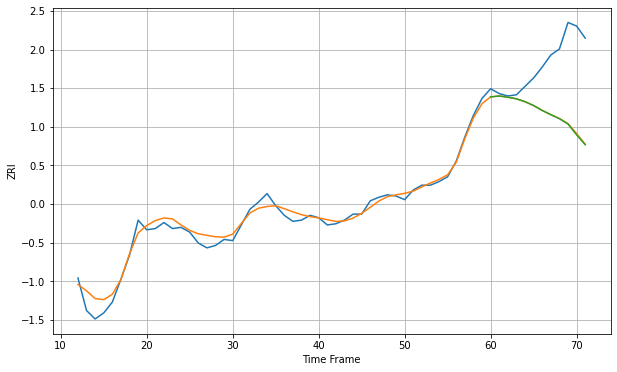

Wall time: 10.7 s
7093 5.884514442033769 50.45076207374665 50.74757457916564 [1981.2448743  1982.01164733 1981.00468867 1979.65562323 1977.25897526
 1974.06100552 1969.98635119 1966.5104471  1963.1730587  1958.71392248
 1949.74710588 1941.60530383]

Got an mse at 0.0049 in round 65 and stopped training

60 60 12


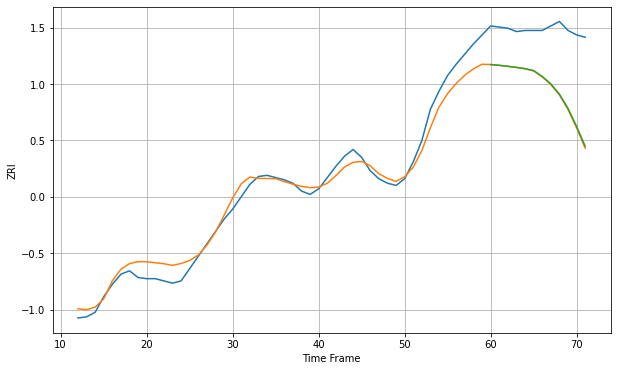

Wall time: 7.35 s
7109 10.229156943004961 55.72885700766529 55.044462525365425 [1584.63204125 1583.9584649  1583.08624424 1582.11423598 1581.01599668
 1579.25667119 1574.037121   1567.42067078 1558.28335945 1545.57897543
 1529.53028011 1511.86006687]

Got an mse at 0.0050 in round 86 and stopped training

60 60 12


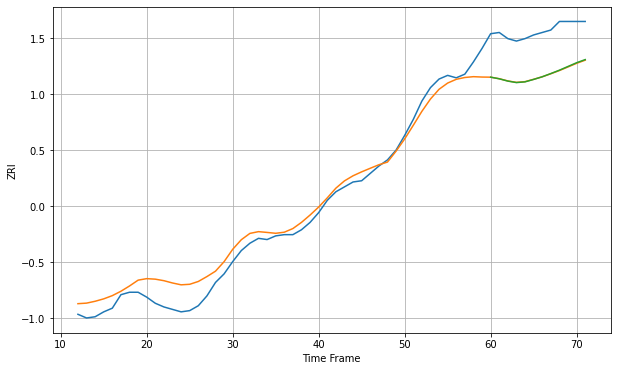

Wall time: 9.45 s
7111 10.81308001045663 35.68528862440502 35.59020695341391 [1407.53584935 1406.21157538 1404.33685208 1403.11947707 1403.70340106
 1405.69730441 1407.85074123 1410.47897531 1413.23154232 1416.28002149
 1419.32700228 1421.8735841 ]

Got an mse at 0.0049 in round 120 and stopped training

60 60 12


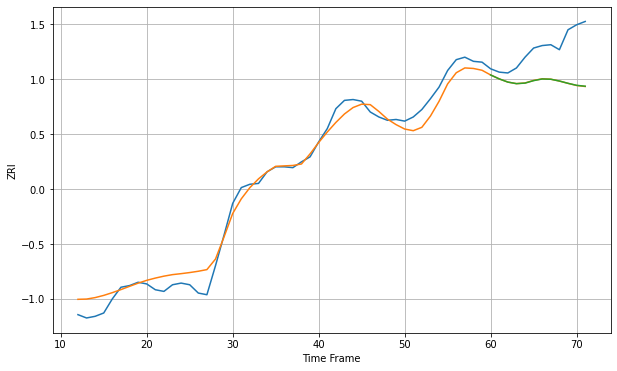

Wall time: 8.96 s
7201 13.0952239087074 44.2193463442217 44.18409925567163 [1732.58170133 1727.84744571 1724.01660532 1722.11756813 1722.79124496
 1725.75110208 1727.77652484 1727.42291416 1725.26985822 1722.54383474
 1720.11586842 1719.04592916]

Got an mse at 0.0050 in round 94 and stopped training

60 60 12


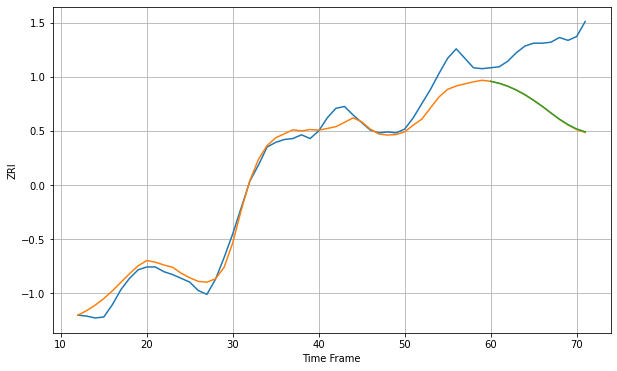

Wall time: 8.86 s
7202 12.746220073711783 69.68591284343732 69.40845752271873 [1679.62260261 1677.52112243 1674.41684788 1670.36222926 1665.3451121
 1659.52402589 1653.18753131 1646.26720228 1639.53451664 1633.78620171
 1629.19507448 1626.18939622]

Got an mse at 0.0050 in round 136 and stopped training

60 60 12


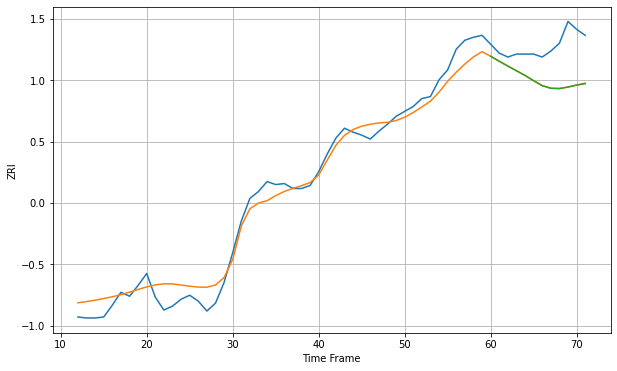

Wall time: 9.78 s
7206 12.880166704068856 36.55679880833969 36.64816031608556 [1708.77687192 1703.75712637 1698.8552968  1694.14359742 1689.37481628
 1684.07311413 1679.05614758 1676.4222999  1676.12671483 1677.62803088
 1679.56035142 1681.06768222]

Got an mse at 0.0050 in round 92 and stopped training

60 60 12


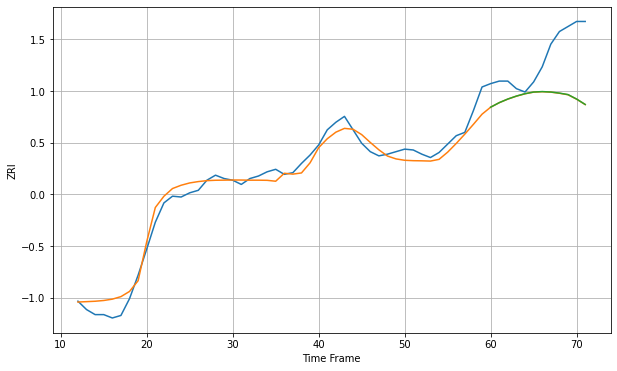

Wall time: 8.85 s
7302 11.320401198651343 55.25316901281901 55.13290049669379 [2482.93349367 2488.34061504 2492.65653229 2496.18426657 2499.03309711
 2500.98634127 2501.5212749  2501.00725832 2499.70946298 2497.96157582
 2492.64723158 2486.19150018]

Got an mse at 0.0049 in round 121 and stopped training

60 60 12


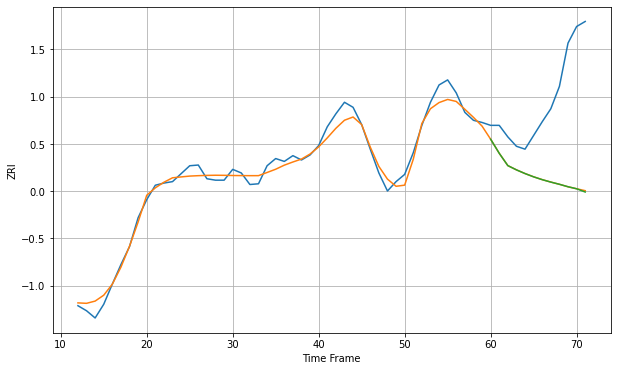

Wall time: 9.08 s
7960 11.237983840001162 125.62001514076616 125.91649779272257 [2201.79849308 2182.26706338 2165.19523795 2159.30568948 2154.16738987
 2149.62927889 2145.70989197 2142.34757184 2139.29492845 2135.90645667
 2133.1102749  2128.58502356]

Got an mse at 0.0050 in round 204 and stopped training

60 60 12


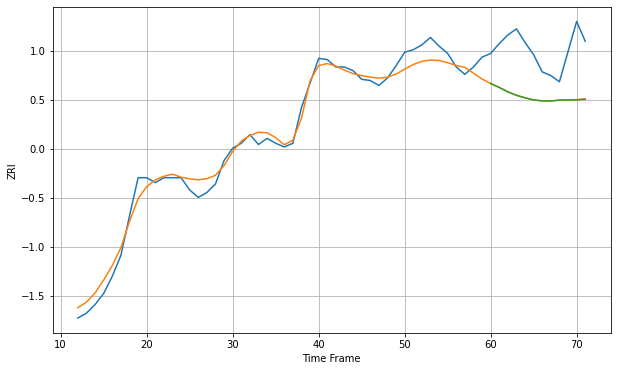

Wall time: 11.4 s
8901 8.081299012429316 40.07743403126535 40.15478971566717 [1721.55410926 1718.37500641 1714.80376055 1711.99943843 1709.92300476
 1708.22526678 1707.45778424 1707.33449731 1708.08001322 1708.15670801
 1708.26729774 1708.7346076 ]

Got an mse at 0.0050 in round 185 and stopped training

60 60 12


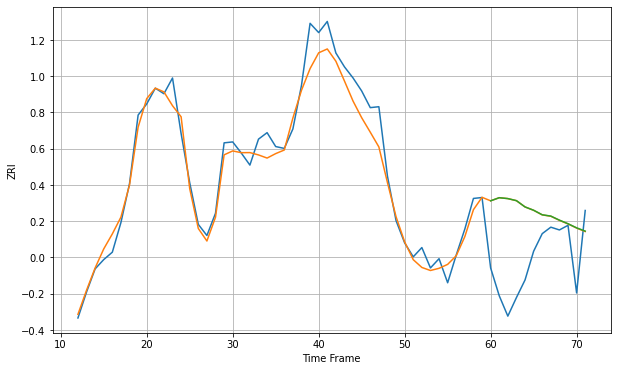

Wall time: 10.6 s
10001 16.58219816957141 69.3549378779678 69.37282168077986 [3727.43299797 3730.78986156 3729.83743469 3727.60600905 3720.85289446
 3717.26243906 3712.36896284 3710.95973977 3706.58791263 3702.71166193
 3698.27223886 3694.75632789]
60 60 12


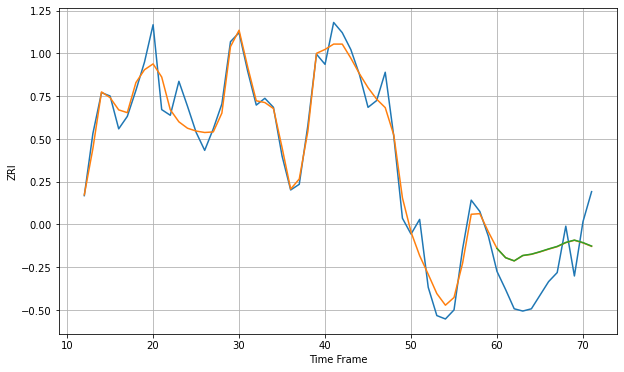

Wall time: 18.6 s
10002 13.85952080590939 34.66100399717668 34.7078861651329 [3461.31817311 3453.12898526 3450.35885584 3455.11555383 3456.26795808
 3458.44749257 3460.89603591 3463.11717486 3466.60957909 3468.70829673
 3466.47245363 3463.41871797]

Got an mse at 0.0050 in round 340 and stopped training

60 60 12


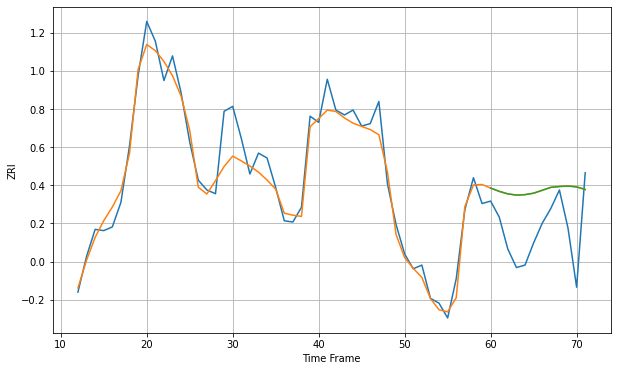

Wall time: 16 s
10003 13.576275694361655 40.79747022080321 40.78760102136906 [3673.57768166 3670.91120997 3668.86203824 3667.8699616  3668.24137372
 3669.42951355 3671.76583708 3674.17284201 3674.84282831 3675.24028822
 3674.54811608 3672.46897469]

Got an mse at 0.0050 in round 220 and stopped training

60 60 12


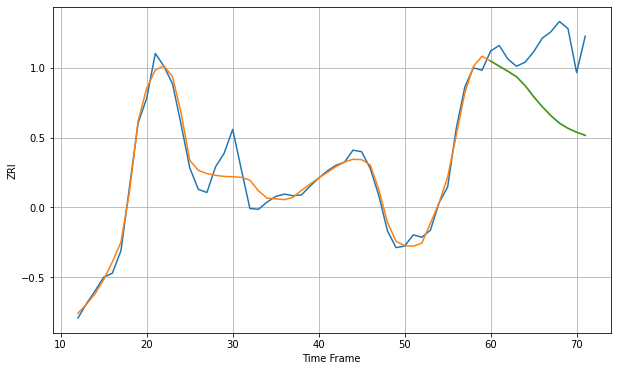

Wall time: 15.8 s
10005 14.709657654095048 79.70189805654202 79.66531840083468 [3688.48529148 3682.00926569 3675.75594698 3668.86806033 3657.95847595
 3644.00754834 3631.42221469 3620.24713756 3610.82619904 3604.29983182
 3599.43689006 3595.55024796]

Got an mse at 0.0050 in round 295 and stopped training

60 60 12


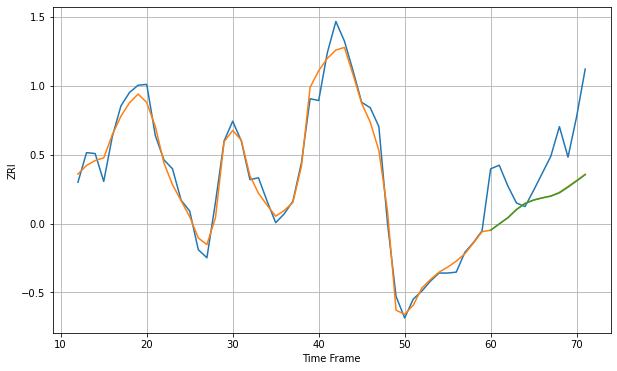

Wall time: 13.9 s
10009 12.51072826381663 56.443712033974975 56.70749085470594 [3671.65042098 3678.691591   3685.49843453 3694.57831058 3701.40372829
 3705.18855381 3707.57133287 3709.5974145  3713.24070259 3719.59215603
 3726.41061592 3733.51542082]

Got an mse at 0.0049 in round 170 and stopped training

60 60 12


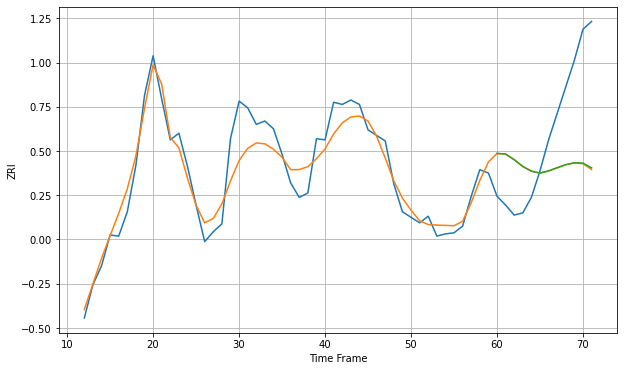

Wall time: 10.4 s
10010 16.709328549575726 69.49096315658613 69.1506448323354 [3697.72486507 3697.16302291 3692.05674562 3685.95989954 3681.74958741
 3679.95985524 3681.9399738  3684.80139423 3687.55312348 3689.320185
 3688.9683573  3684.68315553]

Got an mse at 0.0050 in round 311 and stopped training

60 60 12


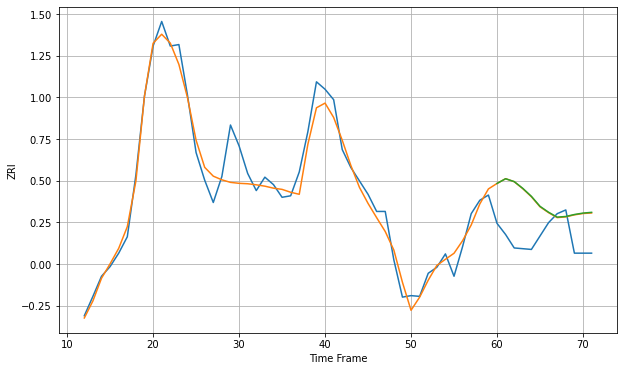

Wall time: 14.7 s
10011 19.997277737071375 56.33938873062924 56.65100389759773 [3840.56940475 3846.89486013 3843.04498291 3833.97212115 3823.26894473
 3809.87213415 3801.90182639 3795.34884531 3796.24397073 3798.88775962
 3800.78634383 3801.787757  ]

Got an mse at 0.0049 in round 417 and stopped training

60 60 12


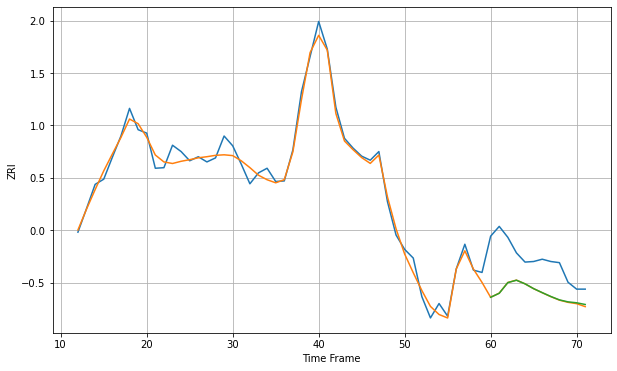

Wall time: 15.5 s
10012 13.503972676757295 65.12175610403011 64.90106839634007 [3465.82725351 3472.83124704 3491.31509297 3495.50621694 3489.20679357
 3480.86661577 3473.9243603  3467.23198365 3461.34877045 3457.88978423
 3456.29618701 3453.34656285]

Got an mse at 0.0050 in round 233 and stopped training

60 60 12


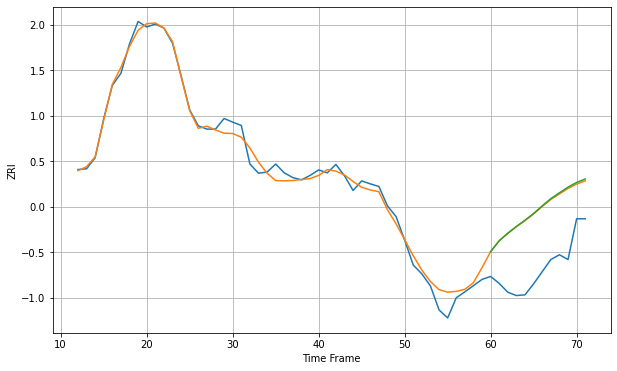

Wall time: 12.3 s
10013 21.92283317767663 157.77055356463862 159.54742345839085 [4509.49213546 4539.34873942 4559.73076729 4578.04727784 4595.0638225
 4613.41814418 4634.17617665 4653.72065451 4669.60745619 4685.03379631
 4697.74474861 4707.31256681]

Got an mse at 0.0049 in round 155 and stopped training

60 60 12


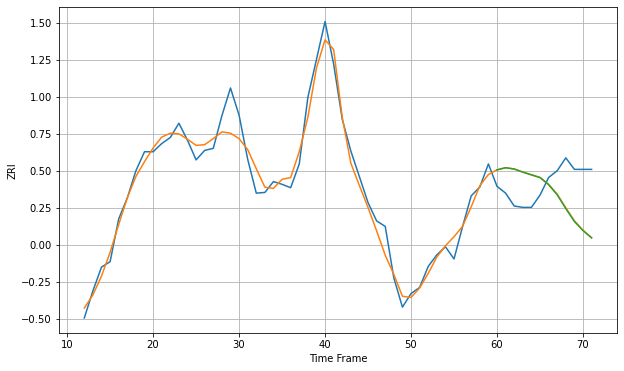

Wall time: 9.53 s
10014 19.025508987477586 58.700784022823115 59.02100764225001 [3854.27734808 3857.45433606 3855.54378222 3850.99676003 3847.03692405
 3842.99300916 3832.52138051 3817.545647   3797.22608998 3778.27420463
 3764.84351451 3754.13040307]

Got an mse at 0.0049 in round 165 and stopped training

60 60 12


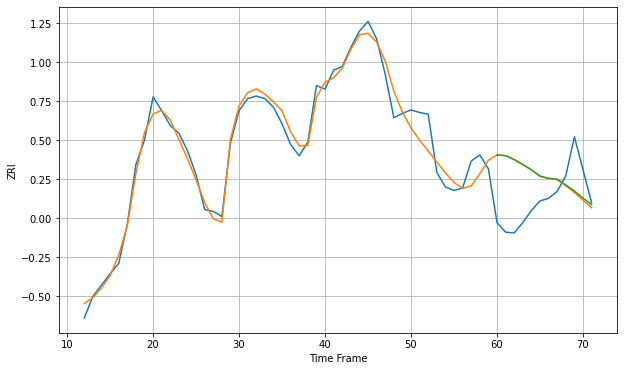

Wall time: 10 s
10016 13.722285978065695 53.79535225318762 53.51740883620779 [3593.03154779 3592.20916941 3587.70118359 3581.89895476 3575.96690494
 3568.64034609 3566.11273063 3565.07853257 3558.54538185 3551.46374775
 3543.35634192 3535.64147635]

Got an mse at 0.0050 in round 349 and stopped training

60 60 12


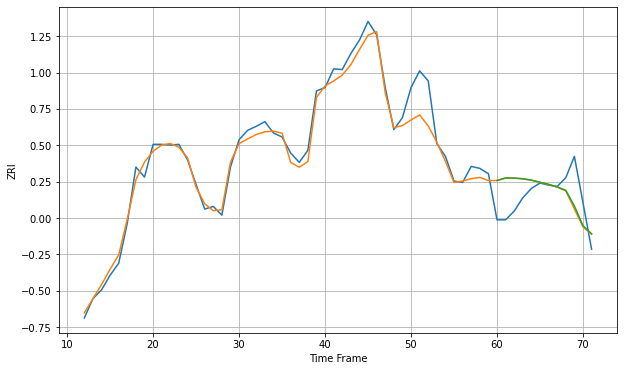

Wall time: 15.6 s
10017 18.46327326327163 40.007154952317045 39.13524962704809 [3502.88337403 3506.59992353 3506.46102514 3505.44250707 3503.35286895
 3500.17286388 3497.10032867 3493.27404846 3488.2086215  3464.68198623
 3435.23003166 3423.04389862]

Got an mse at 0.0049 in round 107 and stopped training

60 60 12


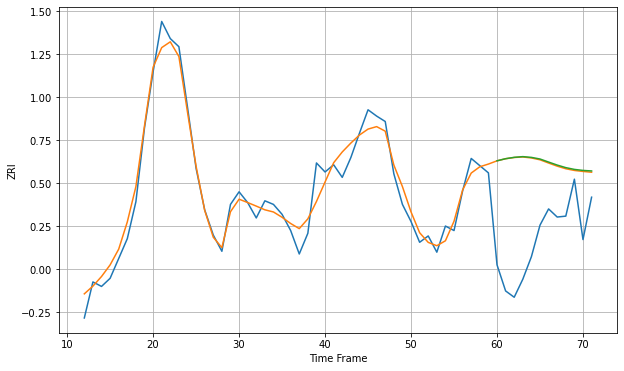

Wall time: 8.81 s
10018 14.253290011229295 95.58973808152419 96.06712356977546 [3704.37800411 3706.73007182 3708.23725491 3709.02004477 3708.18241818
 3706.38873397 3702.99559143 3699.66889075 3696.81288824 3694.85095738
 3693.72912078 3693.13089157]

Got an mse at 0.0050 in round 252 and stopped training

60 60 12


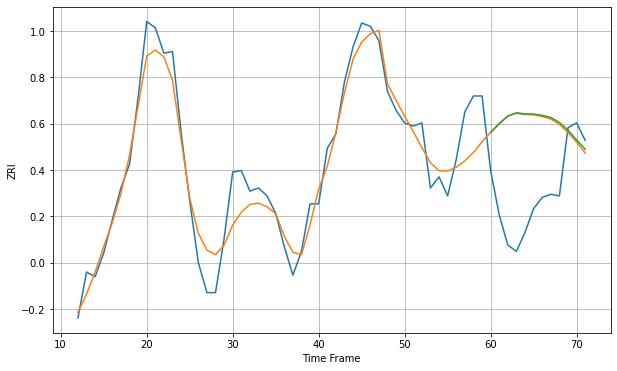

Wall time: 12.7 s
10019 14.366011542657205 53.413146689400016 53.68545573014741 [3624.06397845 3629.53811979 3634.26205798 3636.37921987 3635.71837721
 3635.61725076 3634.81034805 3633.4329653  3630.26733889 3625.37447689
 3619.2683998  3613.37999345]

Got an mse at 0.0050 in round 209 and stopped training

60 60 12


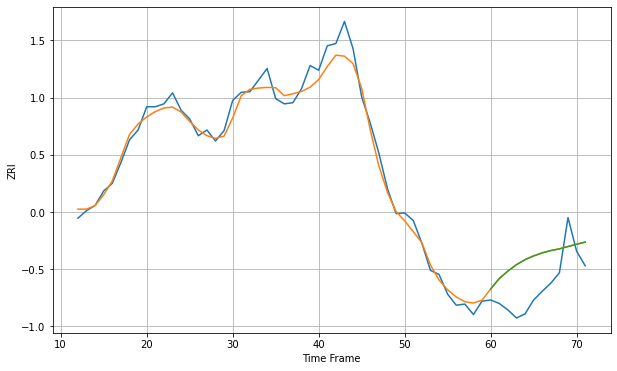

Wall time: 11.1 s
10021 17.573161835776457 59.991051651810245 59.90081835327188 [3135.8940824  3153.96566529 3166.71764132 3177.83741894 3186.42312588
 3192.89607084 3198.1091806  3202.06144512 3205.00583035 3209.07400898
 3213.01999408 3216.60714445]

Got an mse at 0.0050 in round 114 and stopped training

60 60 12


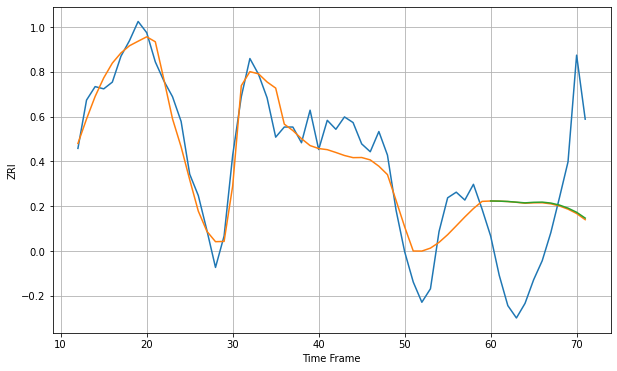

Wall time: 8.46 s
10022 20.13472223702011 76.48373854628386 76.26900386724029 [3983.15490479 3983.034399   3982.72532368 3982.1100407  3981.49587007
 3981.98089293 3982.15129497 3981.31707244 3979.52769502 3976.80486067
 3973.12078321 3967.92418279]

Got an mse at 0.0050 in round 210 and stopped training

60 60 12


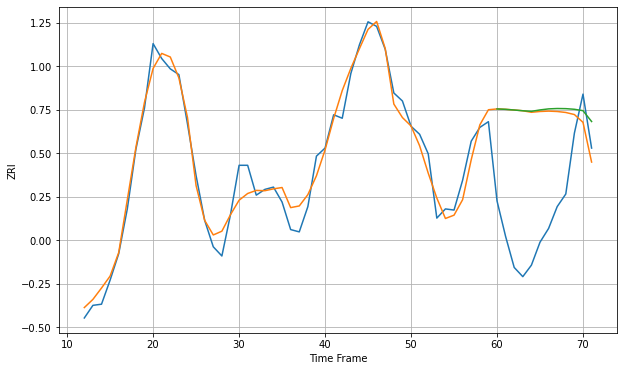

Wall time: 11.3 s
10023 12.170078894991182 96.80373353915233 97.6636039997593 [3595.09327715 3594.74083812 3594.15493126 3593.50768727 3592.99907117
 3594.23283038 3595.137903   3595.4591243  3595.34657399 3594.79753114
 3593.57961655 3584.14136058]

Got an mse at 0.0049 in round 322 and stopped training

60 60 12


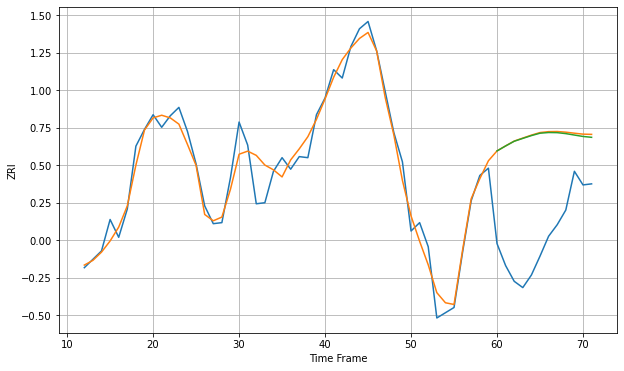

Wall time: 13.6 s
10024 14.014762647702307 100.08290299107557 99.43236379748708 [3466.42805087 3471.1715801  3475.66999724 3478.40643519 3481.07195807
 3483.3478811  3484.00865609 3483.87932359 3482.96427201 3481.60299528
 3480.2539625  3479.43947324]

Got an mse at 0.0050 in round 475 and stopped training

60 60 12


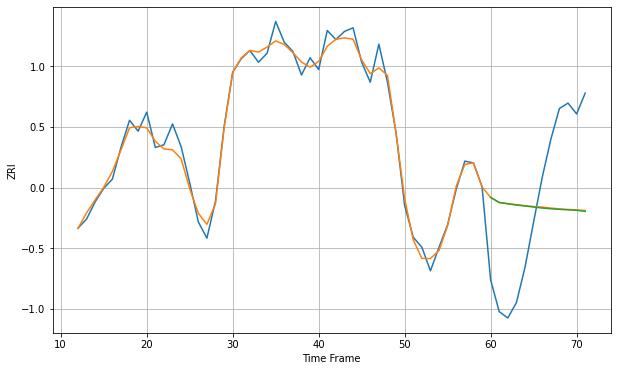

Wall time: 17.8 s
10025 9.987771596003567 98.31933862403382 98.5444967601553 [3599.95219517 3594.35392514 3592.90035034 3591.56519319 3590.45757536
 3589.36614481 3588.25020348 3587.42663104 3586.77825244 3586.25097094
 3585.69346204 3584.62906673]

Got an mse at 0.0050 in round 256 and stopped training

60 60 12


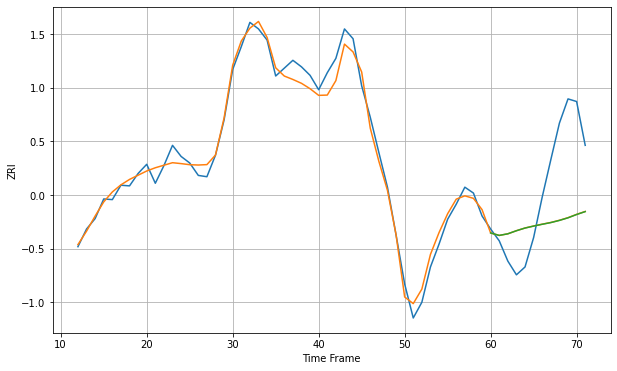

Wall time: 12.5 s
10027 15.584025829344943 98.4290496953227 98.55659383697959 [2953.99530148 2950.24012577 2952.70676686 2957.41928521 2961.50794349
 2964.51608524 2967.27608379 2969.85932547 2973.18650601 2977.15793157
 2982.20917757 2986.65173635]

Got an mse at 0.0050 in round 263 and stopped training

60 60 12


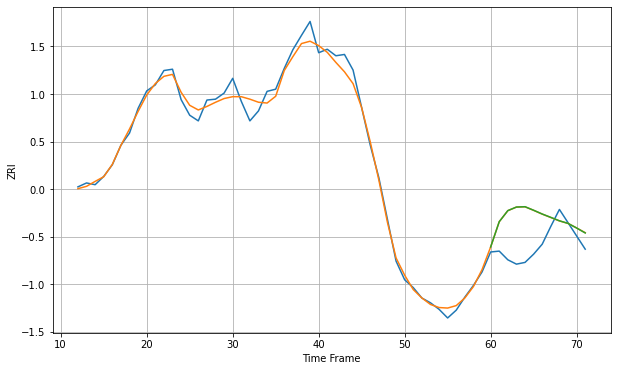

Wall time: 11.7 s
10028 17.794550211206566 75.86714254230752 75.94268941874464 [3060.43170323 3118.76723908 3144.29998772 3152.53455704 3153.27336435
 3145.13077529 3136.45536748 3128.70469553 3120.85522386 3114.87996412
 3104.2584076  3092.81527818]
60 60 12


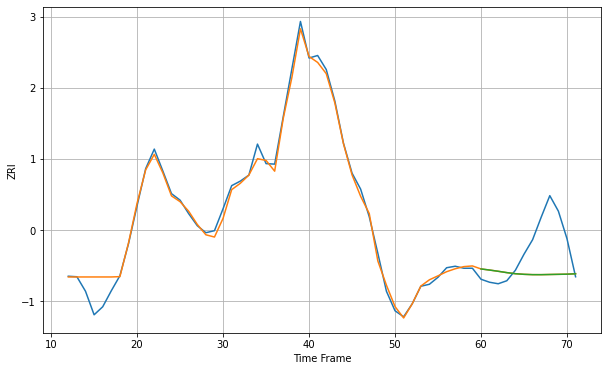

Wall time: 19.7 s
10029 17.382798316673146 74.94289761558689 74.94521277533647 [2787.58379329 2785.37085149 2782.9204618  2780.23897084 2778.05488517
 2776.83980953 2776.20030048 2776.16332728 2776.50247135 2776.83123486
 2777.1497188  2777.89307476]

Got an mse at 0.0049 in round 335 and stopped training

60 60 12


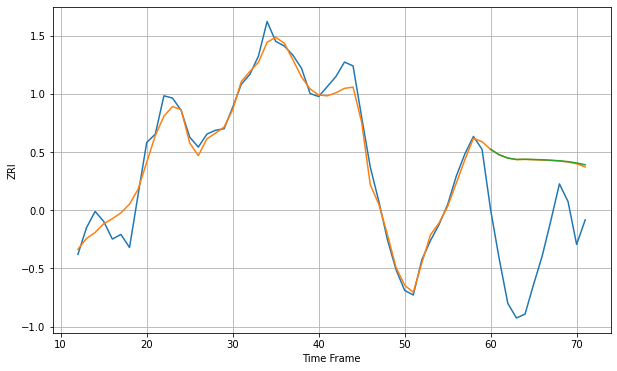

Wall time: 14.4 s
10031 15.918347729759974 132.91429702073142 133.21568659189325 [2784.04958905 2776.92207776 2772.72408139 2770.85327214 2771.15346331
 2770.83894186 2770.50771469 2769.84426748 2769.13802285 2768.01858999
 2766.33281875 2763.95711706]

Got an mse at 0.0049 in round 248 and stopped training

60 60 12


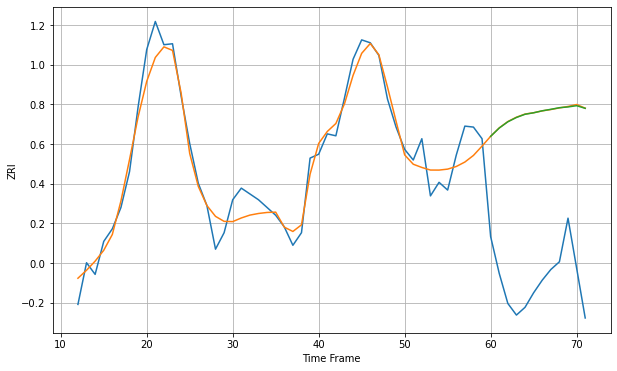

Wall time: 12.3 s
10036 16.907301041340165 172.27586864671233 172.08892139643913 [3589.46631394 3598.02781275 3604.45303233 3608.92179246 3612.22663655
 3613.75411459 3615.80724733 3617.32635033 3619.01129988 3619.78576268
 3621.07718101 3618.35643482]

Got an mse at 0.0050 in round 175 and stopped training

60 60 12


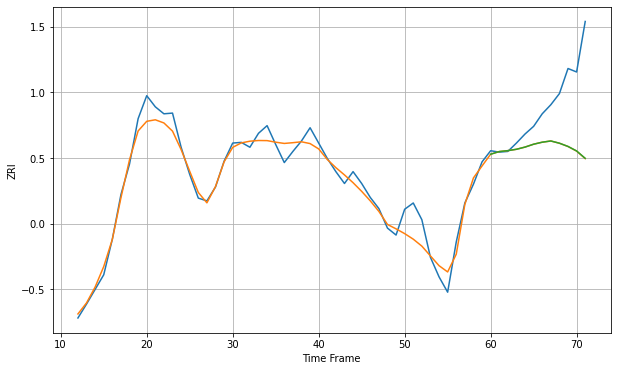

Wall time: 10.7 s
10038 16.450317036657598 78.89467864605196 78.78010515399949 [3885.0148784  3888.80053131 3890.11850818 3892.07470633 3895.23358492
 3899.36055988 3902.2437597  3904.00653627 3900.80237871 3896.15288801
 3889.67796402 3879.09596948]

Got an mse at 0.0050 in round 241 and stopped training

60 60 12


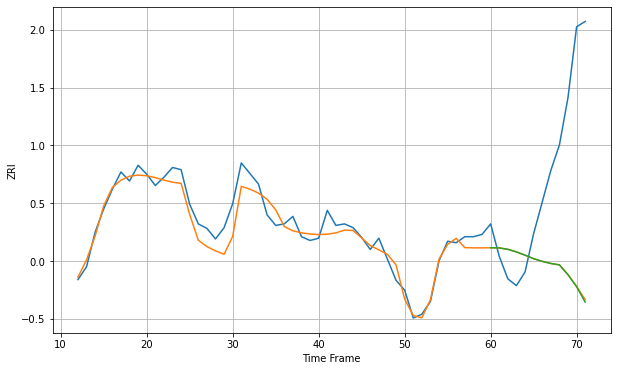

Wall time: 12.3 s
10065 15.646997310453523 174.26654454144852 174.9179526495905 [3940.30458627 3940.0940468  3938.23980627 3934.79291109 3930.46721789
 3925.81048609 3922.22087132 3919.41977959 3917.56788405 3904.38281143
 3888.48304736 3868.06425206]

Got an mse at 0.0050 in round 145 and stopped training

60 60 12


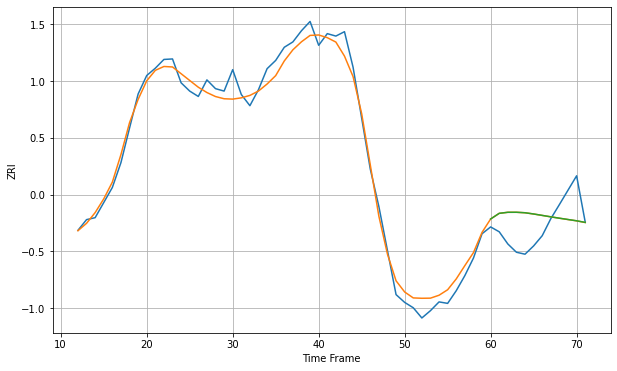

Wall time: 10.9 s
10075 21.700075966097373 56.98308105924519 56.9565748656873 [3085.30561384 3096.9250775  3099.05129814 3099.117289   3098.11499645
 3095.59398772 3092.67728087 3089.7457528  3086.92971671 3084.26027678
 3081.61965922 3078.32229261]

Got an mse at 0.0049 in round 169 and stopped training

60 60 12


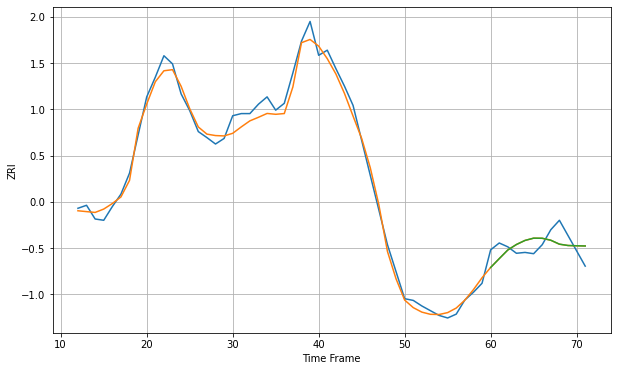

Wall time: 13.1 s
10128 19.07984945990076 32.21262395262897 32.16753905836244 [2877.85548514 2898.48834767 2918.71466271 2931.49157259 2940.98542855
 2946.27992565 2946.03730362 2941.45712264 2932.29816672 2929.14607034
 2928.49582129 2928.00948247]

Got an mse at 0.0049 in round 106 and stopped training

60 60 12


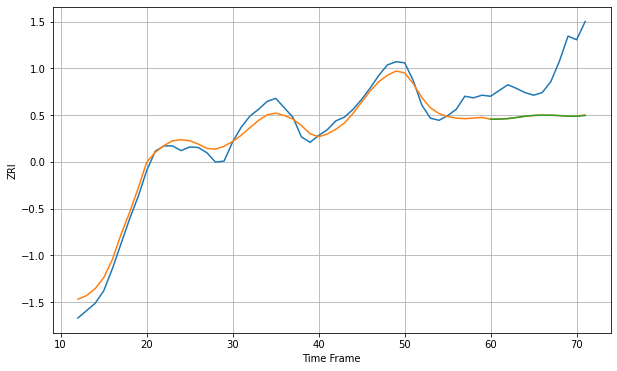

Wall time: 9.93 s
10302 19.723343701985687 95.45724989110023 95.6429982681008 [1823.09421556 1823.26700067 1824.29452432 1826.33766016 1828.76821986
 1830.33907282 1830.92433353 1830.71246544 1830.05959657 1828.77944261
 1828.79695341 1830.06105269]

Got an mse at 0.0050 in round 111 and stopped training

60 60 12


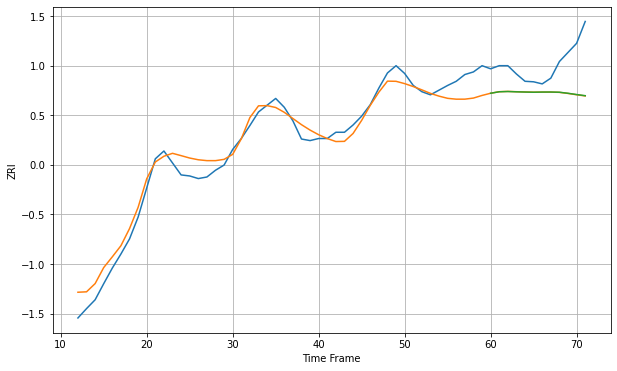

Wall time: 9.58 s
10303 23.99303906581251 64.6277332606639 64.45630843875443 [2018.00811442 2020.85884177 2021.35562532 2020.75225517 2020.31358029
 2019.97938002 2020.27250341 2020.34194923 2019.93826545 2017.96027218
 2015.52435869 2013.33060918]

Got an mse at 0.0049 in round 129 and stopped training

60 60 12


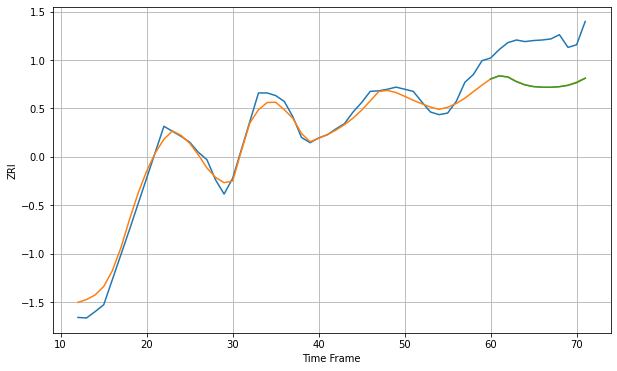

Wall time: 9.06 s
10304 17.363620996085483 79.61173267128919 79.79626727328518 [1893.38138758 1899.29841173 1897.0964354  1888.3682483  1882.13314787
 1878.92298311 1877.78145976 1877.76399383 1878.86729342 1881.3784463
 1886.352261   1894.7041231 ]

Got an mse at 0.0049 in round 131 and stopped training

60 60 12


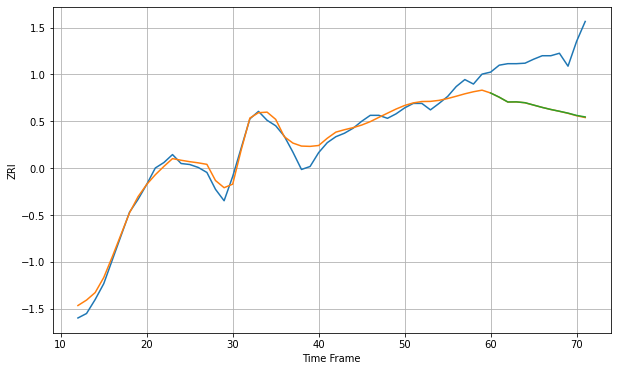

Wall time: 10.5 s
10305 15.913160991365613 107.1530131902673 106.83452581052444 [1904.96026589 1896.56779269 1886.84634656 1887.10895916 1885.43290952
 1880.68696264 1875.96782476 1871.78884091 1868.18905539 1864.46237637
 1859.79302036 1856.77675778]

Got an mse at 0.0049 in round 138 and stopped training

60 60 12


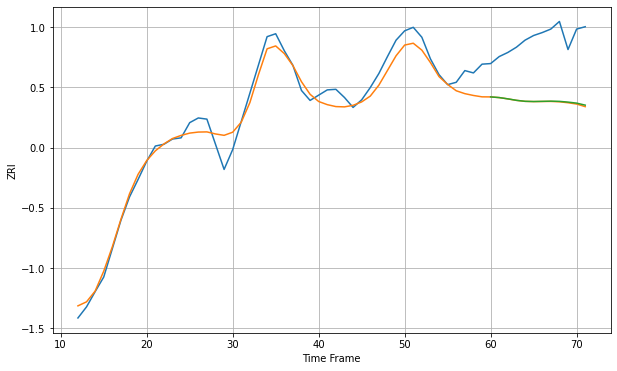

Wall time: 12.6 s
10306 20.704298249970822 107.20061411729615 106.51470182857373 [1856.99508116 1855.85417733 1853.67738734 1851.17018529 1849.4841167
 1849.12548455 1849.40521802 1849.73195459 1849.38998324 1848.11880431
 1846.40114334 1842.92358618]

Got an mse at 0.0050 in round 112 and stopped training

60 60 12


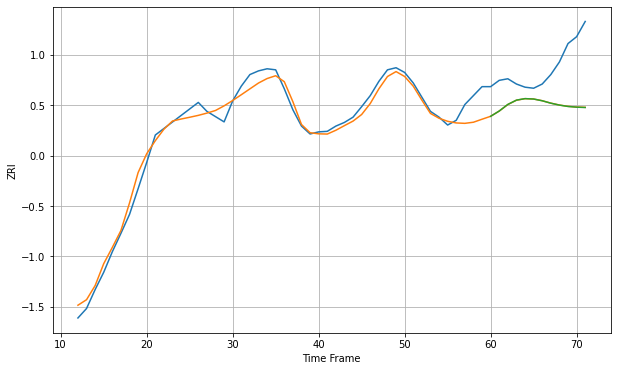

Wall time: 9.08 s
10310 18.53285977954789 81.83181377425096 81.94242985125268 [1880.60649752 1890.67390907 1903.1999731  1911.37540852 1914.23365783
 1913.47236851 1910.15861534 1905.54134511 1901.90697059 1899.32312448
 1898.00082812 1897.35129321]

Got an mse at 0.0050 in round 235 and stopped training

60 60 12


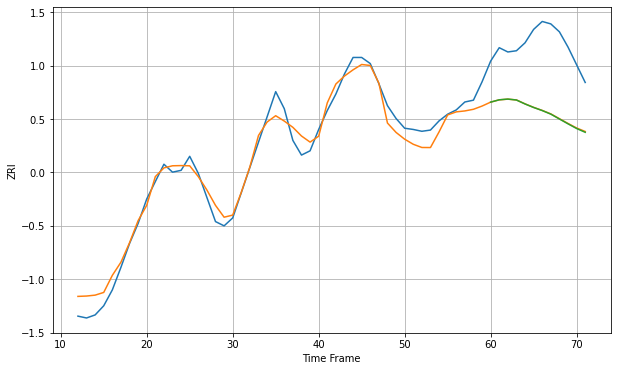

Wall time: 15.1 s
10312 18.985651995553003 110.58706403890652 110.95639553753793 [1739.77829614 1743.60941518 1744.79291847 1743.25538649 1736.78006092
 1731.0193206  1725.96706799 1720.08258486 1712.14730858 1704.19708012
 1696.52415805 1690.34102643]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


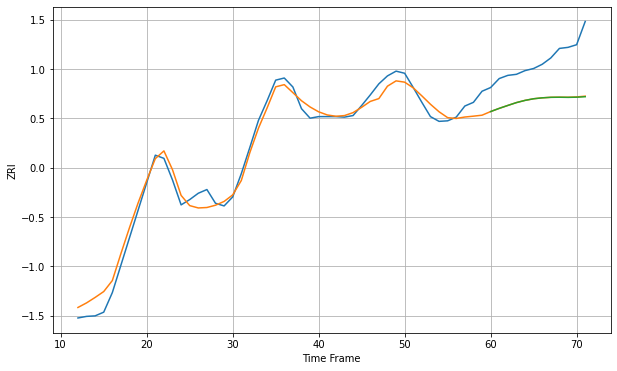

Wall time: 9.97 s
10314 18.562745915076516 78.8030165306529 79.05039865829276 [1814.54994286 1820.5706092  1826.10837579 1831.49966702 1835.67896571
 1838.75714599 1840.50175304 1841.47051935 1841.65259498 1841.39323518
 1841.72067809 1842.63315362]

Got an mse at 0.0050 in round 86 and stopped training

60 60 12


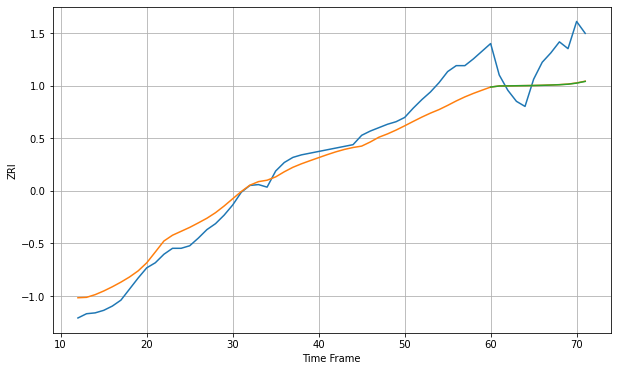

Wall time: 8.67 s
10453 19.21870396911728 39.42016953747128 39.51308001939986 [1635.78421869 1637.05547656 1637.13589144 1637.3249838  1637.47473918
 1637.61899884 1637.83784088 1638.15898004 1638.54519535 1639.15417259
 1640.44530029 1642.44524947]

Got an mse at 0.0050 in round 76 and stopped training

60 60 12


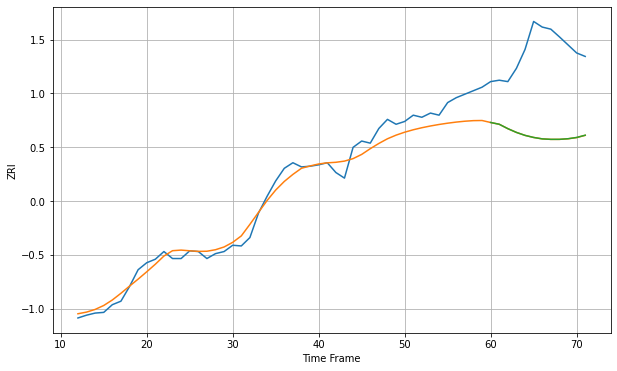

Wall time: 7.91 s
10455 17.51812156835687 122.56254223576649 122.50791434408032 [1832.53409293 1830.01680042 1823.71407714 1818.3508144  1814.10707974
 1811.13719567 1809.10110535 1808.41803721 1808.45098019 1809.32439243
 1811.12486019 1814.38217259]

Got an mse at 0.0050 in round 63 and stopped training

60 60 12


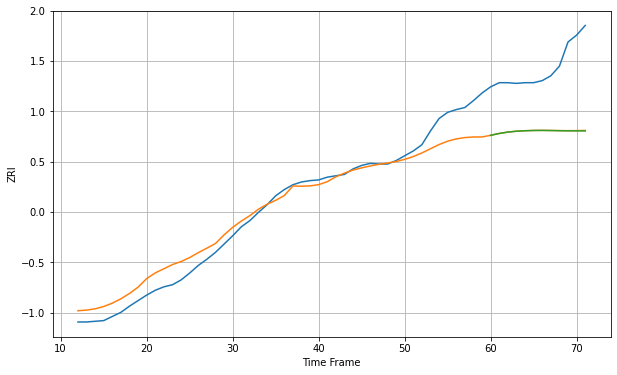

Wall time: 7.79 s
10456 21.86643225063571 95.3318202313248 95.52923033740684 [1717.69636257 1720.36149251 1722.37335335 1723.62613992 1724.30761061
 1724.70757794 1724.78075267 1724.60724596 1724.36965757 1724.18801668
 1724.14124068 1724.08353617]

Got an mse at 0.0049 in round 88 and stopped training

60 60 12


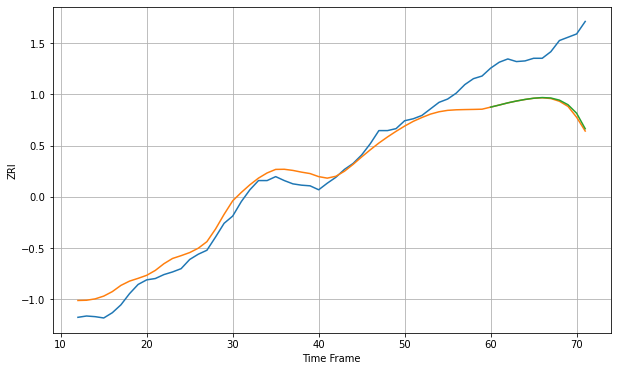

Wall time: 8.07 s
10457 19.595923785154834 89.01687480665117 87.26581203969157 [1804.70900704 1807.88557147 1811.20874029 1814.0049805  1816.39272171
 1818.27054924 1819.25801281 1818.60719024 1815.34313054 1808.32187145
 1795.42315862 1771.84147179]

Got an mse at 0.0050 in round 60 and stopped training

60 60 12


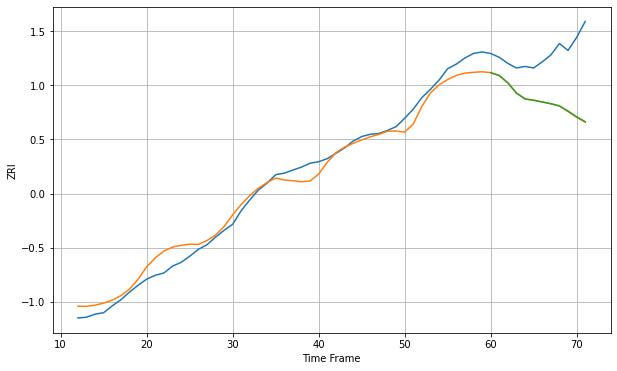

Wall time: 7.45 s
10458 13.560003211410898 67.66140295764883 67.4060906847101 [1731.85445888 1728.05745368 1718.46527601 1705.07438033 1697.42028511
 1695.62257147 1693.37087798 1691.07902098 1688.16821908 1681.46126511
 1674.00630156 1667.5497213 ]

Got an mse at 0.0049 in round 56 and stopped training

60 60 12


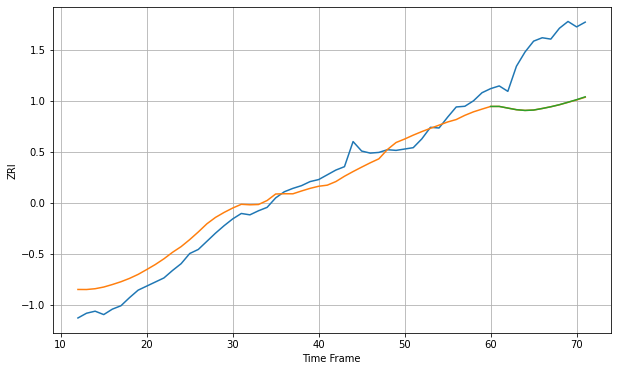

Wall time: 7.27 s
10459 21.750501661853416 89.24683698385772 89.13323071814678 [1803.7493631  1803.78539242 1801.34038038 1798.96872604 1797.86774587
 1798.43552314 1800.73623686 1803.30318992 1806.32648932 1809.98975467
 1813.73639411 1817.91848279]

Got an mse at 0.0049 in round 60 and stopped training

60 60 12


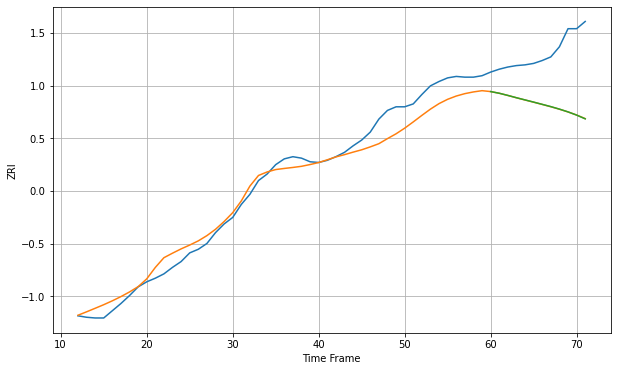

Wall time: 9.34 s
10460 18.018313641531865 77.47477767578634 77.47027231803631 [1782.05616091 1779.74465172 1776.75127776 1773.55984151 1770.53045795
 1767.51192961 1764.40085202 1761.26314996 1757.80820728 1753.97100191
 1749.54687624 1744.33221322]

Got an mse at 0.0050 in round 48 and stopped training

60 60 12


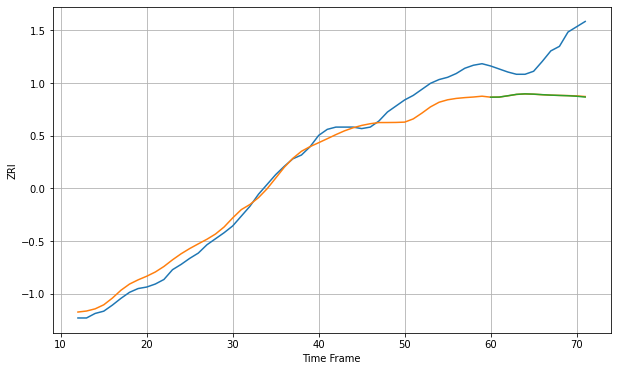

Wall time: 8.48 s
10461 17.979572829609854 58.75345802112374 58.910089053074216 [1793.6446603  1793.78885579 1795.50616335 1797.3797391  1798.04758382
 1797.67217843 1796.98587207 1796.38045934 1795.95233732 1795.56259986
 1794.8885674  1793.81436209]

Got an mse at 0.0050 in round 43 and stopped training

60 60 12


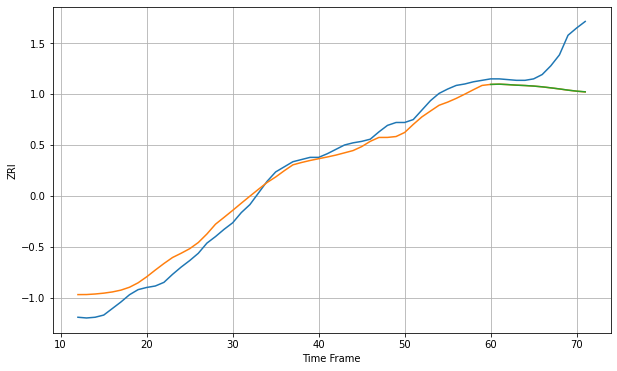

Wall time: 8.94 s
10462 15.831943310695246 46.93231739940634 46.865728013418696 [1802.38668    1802.71578163 1802.14423242 1801.3665811  1800.85236952
 1800.109969   1799.05090366 1797.67126662 1796.18539529 1794.53700415
 1793.14711797 1792.20624024]

Got an mse at 0.0050 in round 103 and stopped training

60 60 12


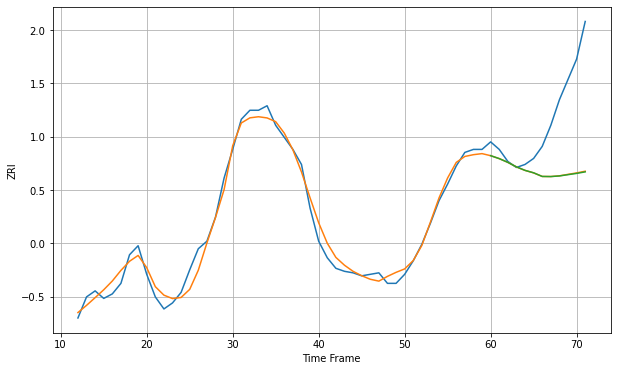

Wall time: 8.61 s
10463 5.791787488495937 44.663800203265254 44.82336518796488 [1790.83126371 1788.88129196 1786.39780355 1783.3900264  1781.07108013
 1779.45053541 1777.02990063 1776.95485065 1777.35994265 1778.21431931
 1779.04785822 1780.07571192]

Got an mse at 0.0050 in round 99 and stopped training

60 60 12


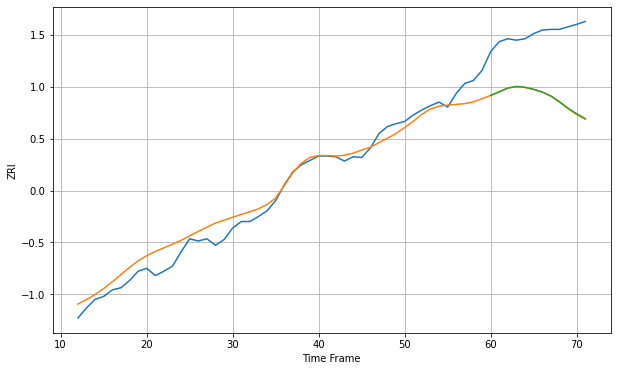

Wall time: 8.75 s
10465 16.269305705917095 91.82115733354183 91.47339537392659 [1869.22429709 1874.17147161 1879.50766536 1881.66522243 1880.55041663
 1877.74394118 1873.99457406 1868.4896373  1860.41764902 1851.44054747
 1843.81944799 1837.03479066]

Got an mse at 0.0049 in round 65 and stopped training

60 60 12


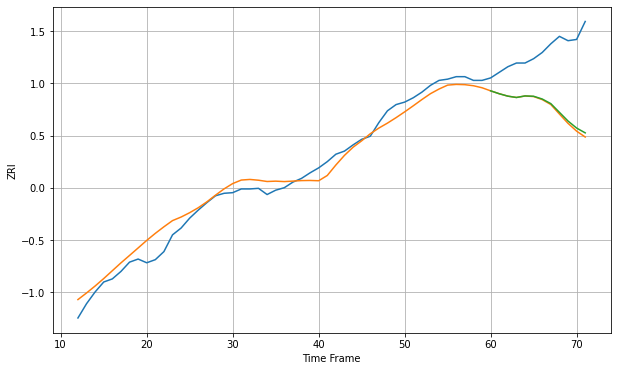

Wall time: 7.9 s
10466 16.658797248910318 99.51763375570388 96.9471654624118 [1872.16683092 1867.50829717 1863.62527793 1861.45915071 1863.9846068
 1863.42103637 1858.98683789 1851.55880065 1837.53536633 1823.49240531
 1812.17004403 1804.40694922]

Got an mse at 0.0050 in round 60 and stopped training

60 60 12


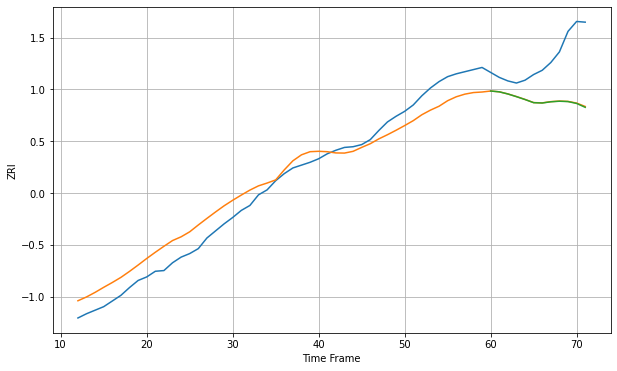

Wall time: 7.09 s
10467 23.37299348091405 65.45264049410818 65.80361598297063 [1762.71177551 1761.57205453 1758.55829599 1754.77313626 1750.70026264
 1746.25084355 1745.76284295 1747.49748686 1748.28756184 1747.78466122
 1745.15492992 1739.68380168]

Got an mse at 0.0050 in round 85 and stopped training

60 60 12


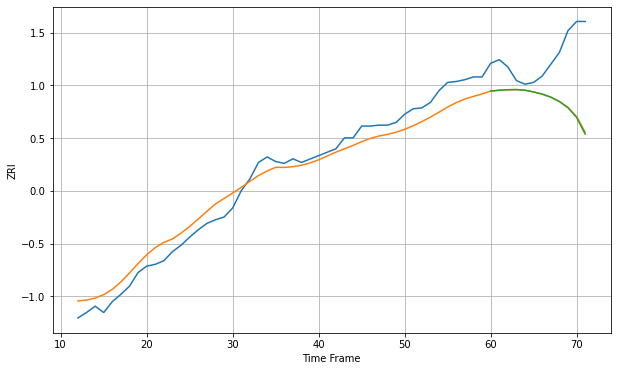

Wall time: 8.44 s
10468 14.684913449409649 58.10661184048149 58.64379793225661 [1530.4325518  1531.38656319 1531.95797351 1532.14442089 1531.396399
 1529.51026711 1527.11030501 1523.77684852 1518.97481141 1512.182521
 1501.44407917 1483.04623444]

Got an mse at 0.0050 in round 51 and stopped training

60 60 12


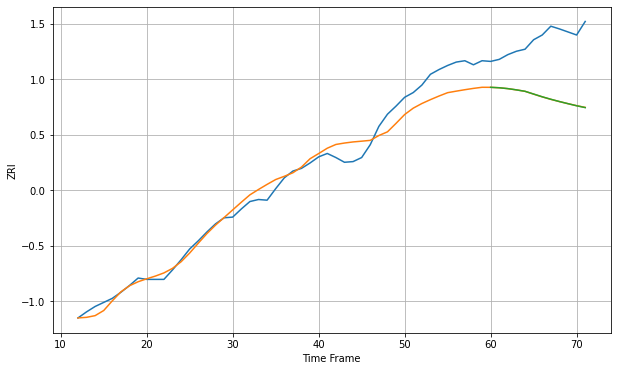

Wall time: 6.83 s
10469 19.935275673931486 86.17956030675845 86.17551898004116 [1861.71966767 1861.08265685 1859.79273427 1857.95783919 1855.84940065
 1851.78256578 1847.74292473 1844.0845365  1840.72835686 1837.55952495
 1834.47880953 1831.75530667]

Got an mse at 0.0050 in round 82 and stopped training

60 60 12


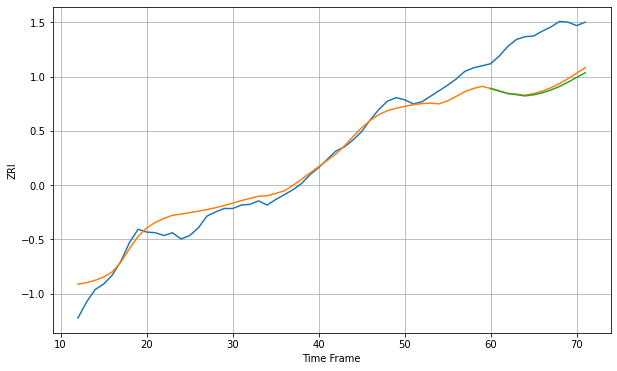

Wall time: 8.34 s
10470 16.920316144374816 75.05425768007214 77.8639409655426 [1838.29402889 1834.58714611 1830.85873487 1829.41198835 1827.48576127
 1829.12825629 1831.98677095 1836.00339624 1841.15756865 1847.34942188
 1854.24538038 1860.94487493]

Got an mse at 0.0049 in round 60 and stopped training

60 60 12


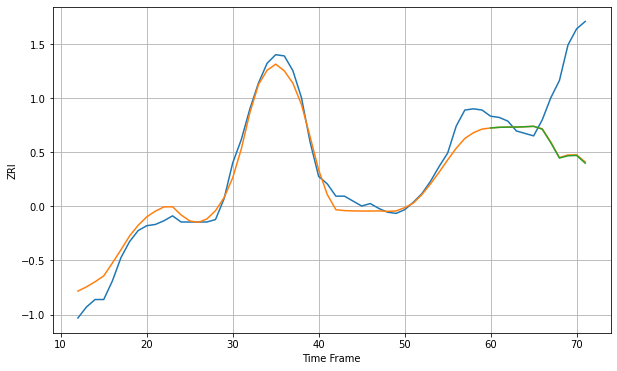

Wall time: 9.66 s
10471 9.878041832127135 55.604327056147326 56.00045607603013 [1840.44190291 1840.96353207 1841.13402033 1841.16602396 1841.44411075
 1841.76099787 1839.48858699 1828.39552072 1816.00364659 1817.82126957
 1818.08557954 1811.82766432]

Got an mse at 0.0049 in round 52 and stopped training

60 60 12


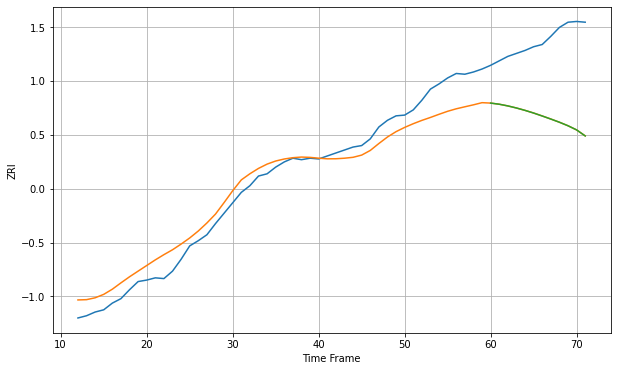

Wall time: 7.97 s
10472 23.010148731928172 104.99591487785348 105.02821377573751 [1776.1670781  1774.62584351 1772.35475811 1769.55911095 1766.34349028
 1762.76285508 1758.78997281 1754.67690509 1750.38215478 1745.64989467
 1740.077779   1731.9365312 ]

Got an mse at 0.0050 in round 134 and stopped training

60 60 12


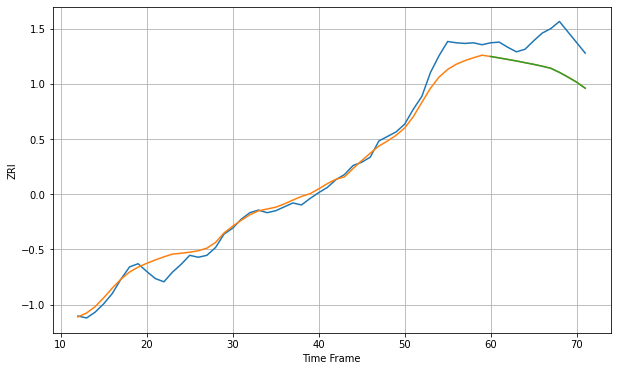

Wall time: 9.76 s
10473 15.361079053803621 47.893343070638736 47.92791122047887 [2016.79009434 2014.56244692 2012.2089139  2009.83479783 2007.17624153
 2004.64703539 2001.71089    1998.50367126 1992.14906718 1984.87128094
 1977.04412339 1967.67290564]

Got an mse at 0.0050 in round 187 and stopped training

60 60 12


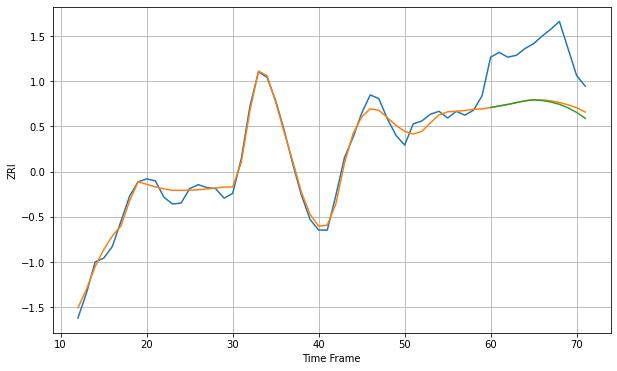

Wall time: 10.6 s
10528 7.405678013084108 57.02872640801274 58.27830478149305 [2474.94323657 2476.47235915 2478.08649245 2479.99330841 2481.80039347
 2482.80149467 2482.13114866 2480.61772229 2478.21934522 2474.58475351
 2469.84369141 2463.76950835]

Got an mse at 0.0050 in round 152 and stopped training

60 60 12


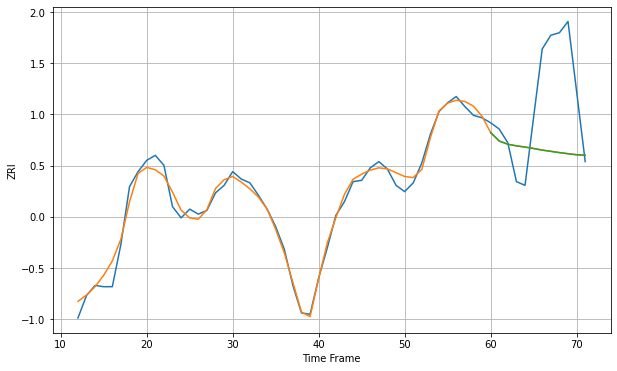

Wall time: 10 s
10543 6.324834143499134 58.15640884797854 58.189268938019666 [2421.17180936 2414.44067296 2411.86802518 2410.58422561 2409.59846721
 2408.47222611 2407.18064221 2406.18872094 2405.16031732 2404.25035504
 2403.4187638  2403.08332533]

Got an mse at 0.0050 in round 127 and stopped training

60 60 12


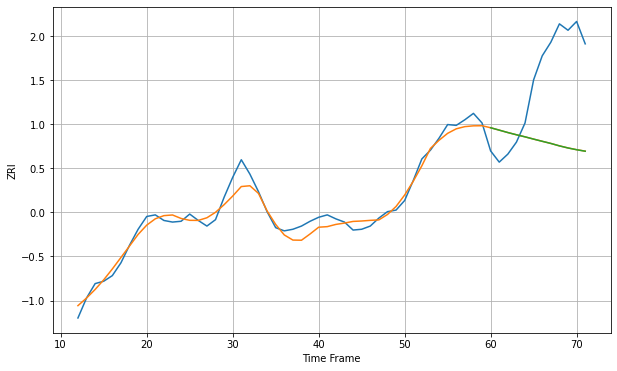

Wall time: 9.36 s
10562 10.285920969064982 102.179260293566 102.19762394135549 [2105.01942951 2102.03083193 2099.01417498 2096.23476781 2093.64075363
 2090.80375098 2088.06672145 2085.38083855 2082.34273378 2079.70847397
 2077.52473102 2075.65827433]

Got an mse at 0.0050 in round 135 and stopped training

60 60 12


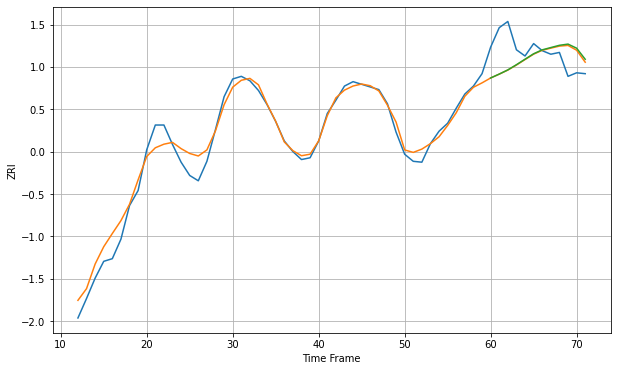

Wall time: 10.6 s
10573 11.585225374524779 28.260087483311242 28.686686776827393 [2257.15037388 2261.56768721 2266.29099898 2272.13260405 2278.35931145
 2284.50808709 2288.932137   2291.51797785 2294.07333757 2295.42598919
 2290.82145478 2278.28225767]

Got an mse at 0.0050 in round 113 and stopped training

60 60 12


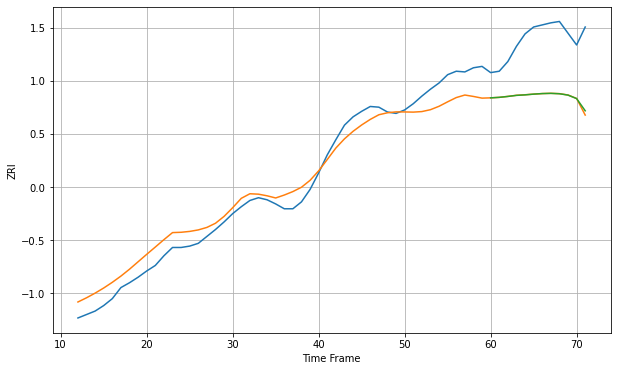

Wall time: 12 s
10701 21.735854109672417 86.0697548669597 85.39407284521607 [2000.48322222 2001.20948206 2002.50847988 2004.04773121 2004.78782316
 2005.87425799 2006.66787114 2006.97683745 2006.42722492 2004.44811003
 1999.42469119 1981.76788576]

Got an mse at 0.0050 in round 85 and stopped training

60 60 12


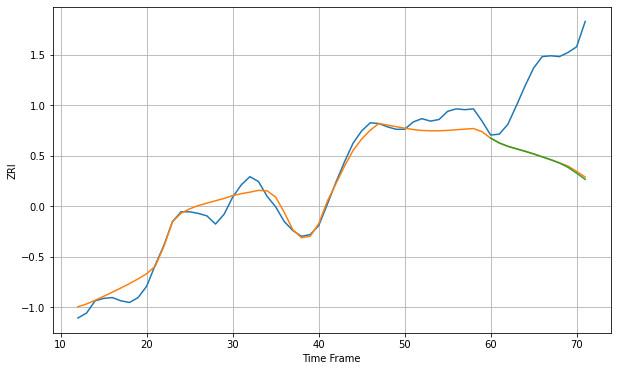

Wall time: 9.92 s
10703 12.774397652175033 111.10016378323273 111.95261378013562 [2100.18340306 2094.2952895  2090.14414244 2087.0767813  2084.0978947
 2080.83030726 2077.25808076 2073.68134618 2069.72651448 2064.44052843
 2057.30091198 2049.68986467]

Got an mse at 0.0049 in round 169 and stopped training

60 60 12


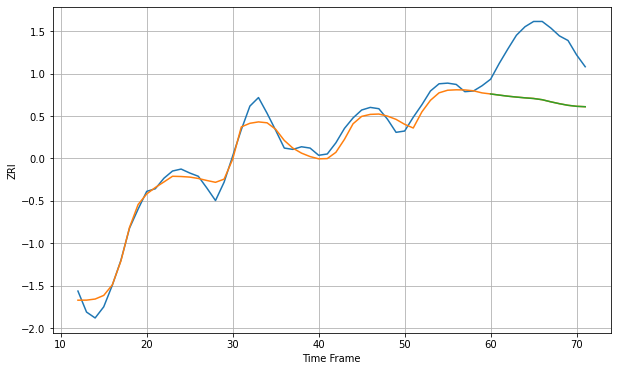

Wall time: 11.3 s
10704 13.053499441073162 91.0975559818843 91.12047839318753 [2173.48483235 2171.75652502 2170.08212661 2168.73840449 2167.54012362
 2166.5045747  2164.71923957 2161.51761679 2158.6614159  2156.20700623
 2154.65033773 2154.03271213]

Got an mse at 0.0050 in round 95 and stopped training

60 60 12


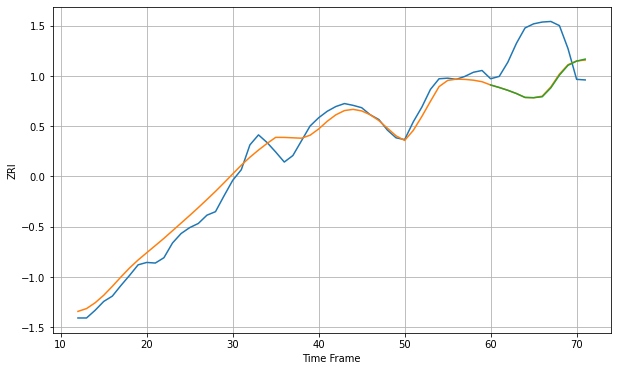

Wall time: 8.74 s
10705 17.87479902757041 80.12532722185952 80.67276190419581 [1980.48003847 1976.20023902 1971.46038214 1965.99252661 1959.40027257
 1958.94570008 1960.53000819 1975.54167236 1997.08035729 2013.76551121
 2020.8708699  2024.27373326]

Got an mse at 0.0050 in round 74 and stopped training

60 60 12


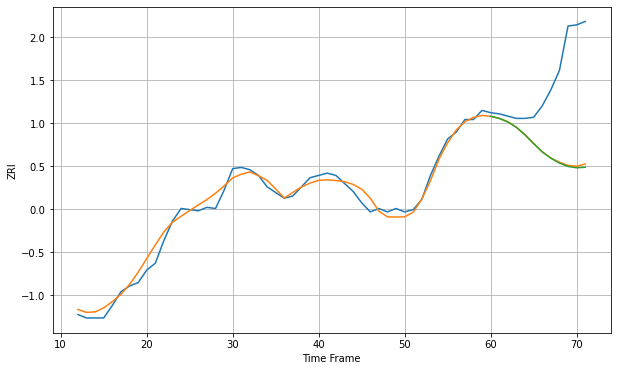

Wall time: 7.66 s
10940 6.015898045757952 69.76941983681968 70.63413046418925 [1429.88933117 1428.0156349  1424.93663906 1420.15725693 1413.54180082
 1405.87892016 1398.6346516  1393.08778376 1388.85050965 1385.86524276
 1384.68352722 1385.15876436]

Got an mse at 0.0049 in round 132 and stopped training

60 60 12


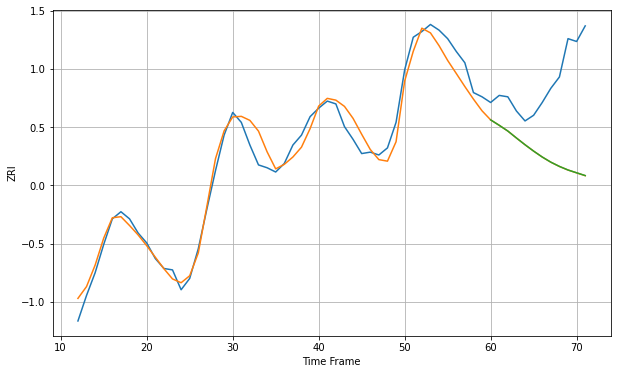

Wall time: 9.3 s
10960 9.006557175111404 56.96248012281224 56.92335611940282 [1841.74463628 1837.91327548 1833.87400663 1828.97963152 1824.22750709
 1819.73969401 1815.57939704 1811.94904885 1808.94577534 1806.43120568
 1804.45660843 1802.49834256]

Got an mse at 0.0049 in round 149 and stopped training

60 60 12


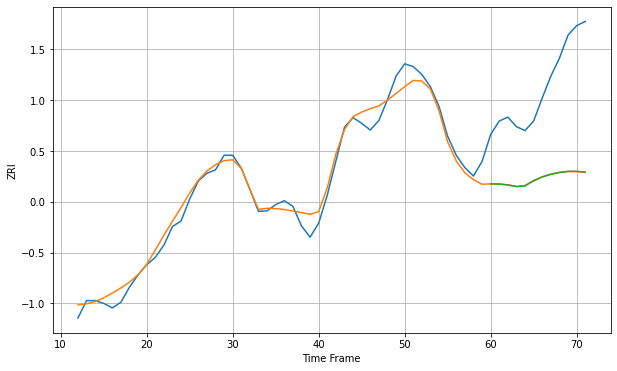

Wall time: 9.4 s
10977 17.6598759225015 172.62806036193382 172.66517821544022 [2019.01177801 2018.67493566 2017.14044688 2014.22707622 2015.4279338
 2024.41437955 2031.27491473 2036.0239633  2039.41203939 2041.24097457
 2041.34682119 2039.99312125]

Got an mse at 0.0050 in round 81 and stopped training

60 60 12


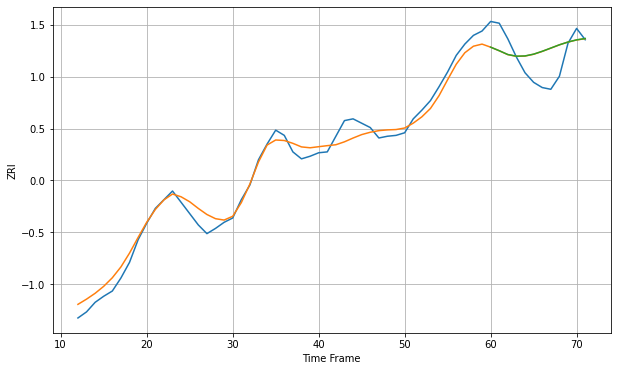

Wall time: 8.22 s
11001 10.813464563655035 27.49321779302678 27.533561939217435 [2171.44308835 2167.36290871 2162.96363518 2161.04691415 2161.36059818
 2163.41627779 2166.68288798 2170.40943682 2174.17463444 2177.36258588
 2179.84636268 2181.41303564]

Got an mse at 0.0050 in round 154 and stopped training

60 60 12


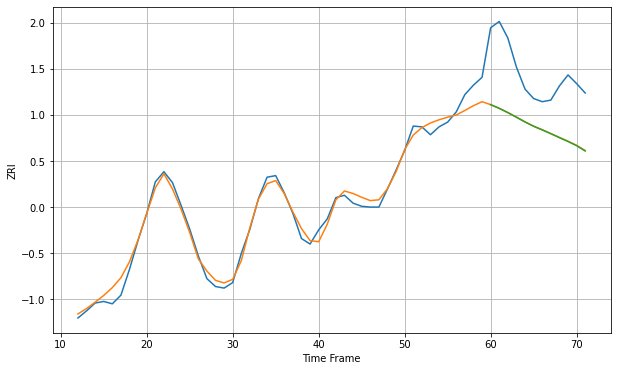

Wall time: 9.81 s
11003 10.379168444118152 72.91722535683536 73.04524339933225 [2187.2390259  2182.56503604 2177.16701812 2171.31763182 2165.27325919
 2159.75331988 2155.18776528 2150.3122562  2145.29197669 2140.38650443
 2135.06292549 2128.316864  ]

Got an mse at 0.0049 in round 207 and stopped training

60 60 12


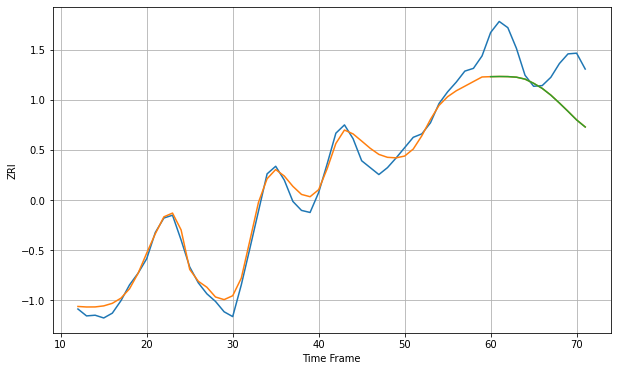

Wall time: 12.4 s
11010 14.520687118172464 60.964601514955824 61.00496043531257 [2368.94398328 2369.19652584 2369.04249417 2368.20187136 2365.37366096
 2359.31265057 2351.93096801 2342.17189408 2330.69100096 2318.63175941
 2306.20745774 2295.92765292]

Got an mse at 0.0049 in round 68 and stopped training

60 60 12


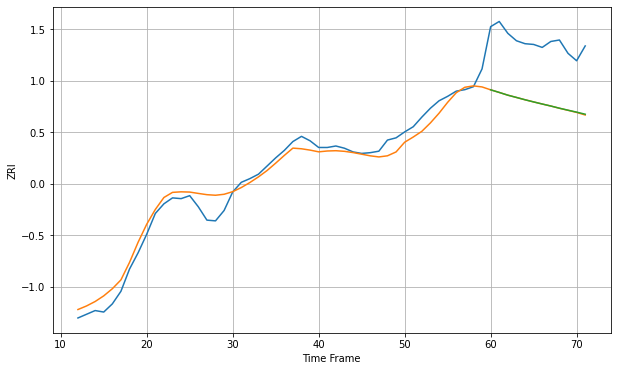

Wall time: 9.16 s
11050 13.910563214699827 82.8291707266758 82.67206975606703 [2574.79546649 2571.26152478 2567.57216506 2564.5100088  2561.37857517
 2558.46356529 2555.64598864 2552.93265628 2549.98532972 2547.30661917
 2544.70664589 2541.86876902]

Got an mse at 0.0049 in round 461 and stopped training

60 60 12


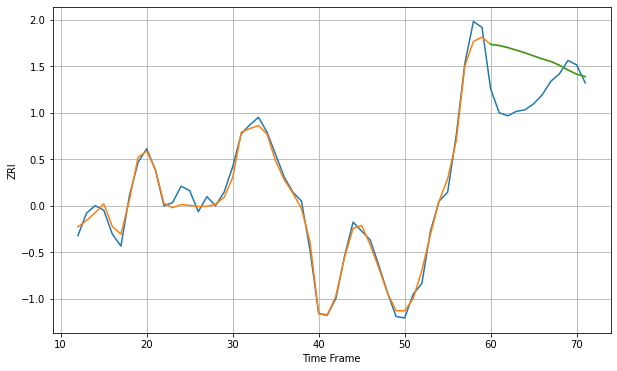

Wall time: 18.7 s
11101 4.993583635338851 28.867048509194756 28.86776649105357 [2517.73312548 2516.94132751 2515.55949884 2513.807085   2512.05940883
 2509.98282448 2508.02036433 2506.28692357 2503.78536444 2500.59728611
 2497.8039328  2496.20846502]

Got an mse at 0.0049 in round 175 and stopped training

60 60 12


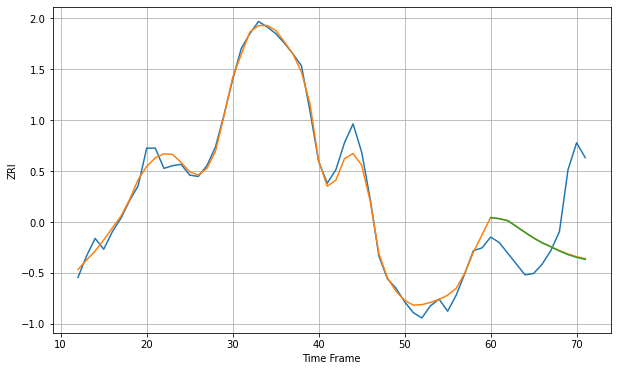

Wall time: 10.2 s
11102 6.350377639020312 41.53264615016508 41.7752498496204 [2202.45937242 2201.68152637 2200.18501869 2195.86797692 2191.55123375
 2187.35010036 2183.71322363 2180.82473919 2177.69906022 2174.99852844
 2172.97662574 2171.42593202]

Got an mse at 0.0050 in round 162 and stopped training

60 60 12


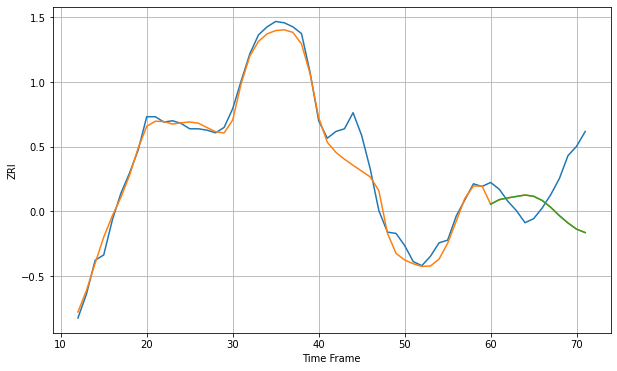

Wall time: 10 s
11103 9.657623013220919 34.22996948906987 34.22710843885507 [2137.79812677 2141.1898755  2142.49823762 2143.5876683  2144.64986374
 2143.70962022 2140.56815874 2135.42836391 2129.24063964 2123.80629266
 2119.19349433 2116.64870674]

Got an mse at 0.0050 in round 206 and stopped training

60 60 12


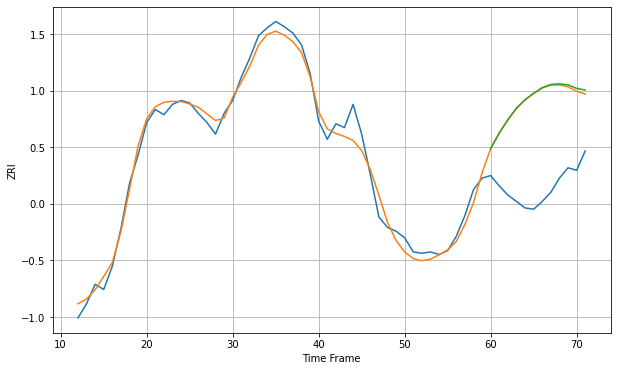

Wall time: 11.1 s
11104 7.751328554048204 67.64430874504555 68.27713014572126 [2124.82979124 2136.82370463 2147.03559537 2155.96632314 2162.51422961
 2167.51433609 2171.88036765 2174.36643856 2174.81341601 2174.05224638
 2171.33689745 2170.08555562]

Got an mse at 0.0050 in round 199 and stopped training

60 60 12


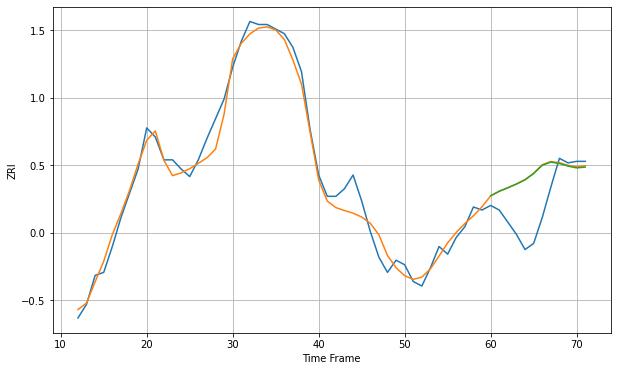

Wall time: 11 s
11105 7.885340622419599 25.110557116999797 25.043475513520765 [2193.32950678 2196.3386316  2198.64028467 2201.08486209 2203.88647655
 2207.99599659 2213.4130977  2215.50159382 2214.60739849 2212.85701764
 2211.70340104 2212.22035596]

Got an mse at 0.0050 in round 179 and stopped training

60 60 12


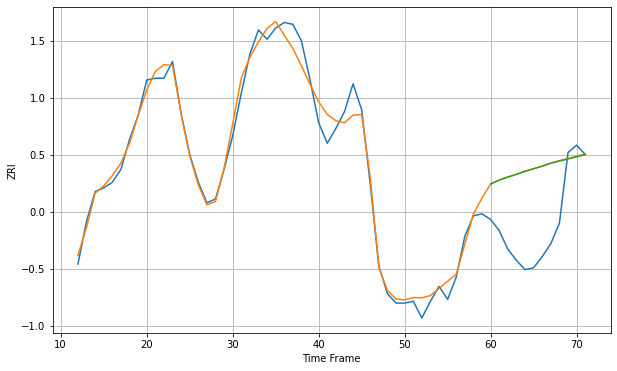

Wall time: 12.4 s
11106 6.169230565354585 36.32738823831772 36.294785647878555 [2153.12993956 2155.20319661 2156.82649748 2158.29964455 2159.91847967
 2161.28606315 2162.68119807 2164.23866148 2165.4692386  2166.56008699
 2167.72570328 2168.87976964]
60 60 12


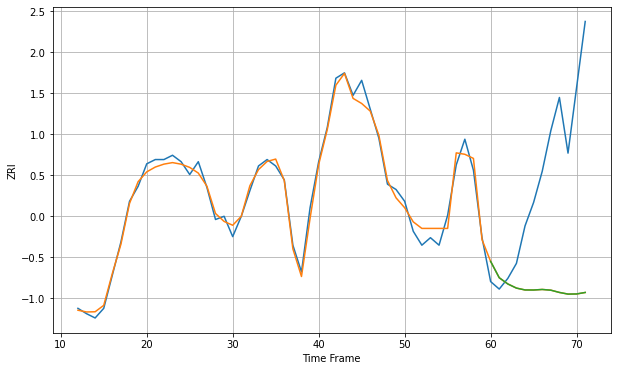

Wall time: 19.8 s
11201 7.469230309186565 128.32428133118364 128.31771637435028 [2857.84675347 2842.61562085 2836.77208286 2832.91741526 2831.17676714
 2831.12074314 2831.63420479 2830.96758492 2828.8444729  2827.31203637
 2827.4383242  2828.84443559]

Got an mse at 0.0049 in round 425 and stopped training

60 60 12


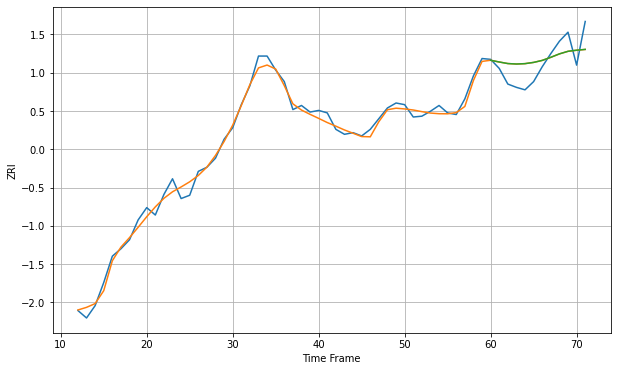

Wall time: 16.6 s
11203 7.400694479868752 21.167054350711116 21.154543538775993 [2155.88222765 2153.78984408 2151.90410974 2151.33042999 2151.79490904
 2153.30043091 2155.72750808 2159.49482591 2163.66180255 2166.78134827
 2168.10345994 2169.0960346 ]

Got an mse at 0.0048 in round 140 and stopped training

60 60 12


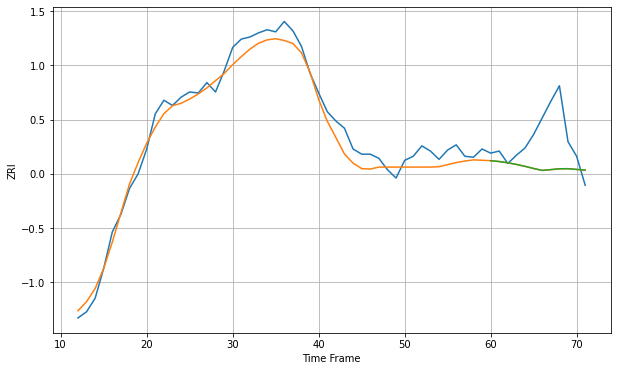

Wall time: 9.35 s
11204 10.986926301282688 36.52191159828509 36.52548713471487 [1990.69043289 1989.89420395 1988.68313133 1987.10357784 1985.25826772
 1983.17852137 1981.33167683 1982.09178275 1982.88888407 1982.98764568
 1982.28052887 1981.65454288]

Got an mse at 0.0050 in round 317 and stopped training

60 60 12


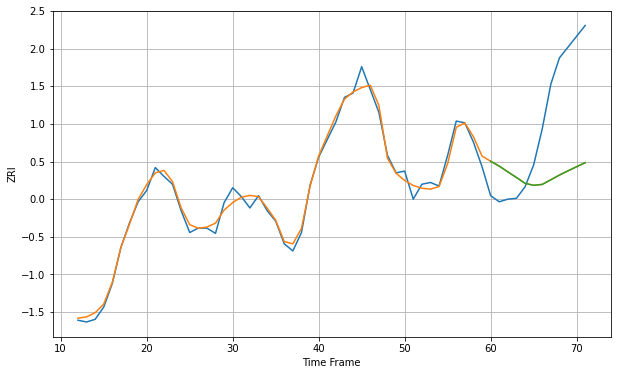

Wall time: 14 s
11205 7.426244080516549 93.72182658825619 93.73678476533372 [2824.23855163 2818.66512601 2812.11707037 2805.73086558 2799.02502826
 2796.79954973 2797.79753075 2803.09423292 2808.44266377 2813.27591542
 2817.98762218 2822.58842781]

Got an mse at 0.0050 in round 218 and stopped training

60 60 12


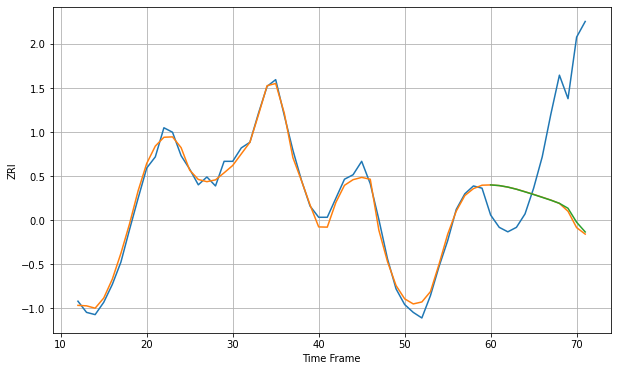

Wall time: 12.4 s
11206 5.917986973538344 91.66999908752666 90.35258944487578 [2568.9133073  2568.33476243 2566.99165746 2565.06061284 2562.73682029
 2560.34319731 2557.82695676 2555.28979831 2552.46249765 2548.03279004
 2535.56548589 2526.88849397]

Got an mse at 0.0050 in round 109 and stopped training

60 60 12


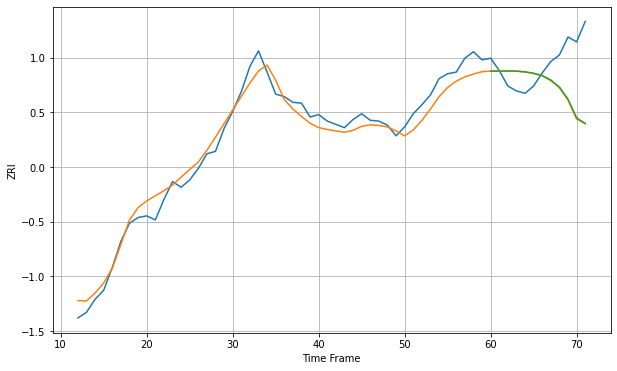

Wall time: 12.6 s
11207 13.98008822891056 53.85915131486522 53.4148757546359 [2246.24173014 2246.17542071 2246.37772985 2246.19389053 2245.29168023
 2243.64113897 2240.88902271 2235.31271754 2226.70716136 2211.79441565
 2188.94493773 2182.12026739]

Got an mse at 0.0050 in round 89 and stopped training

60 60 12


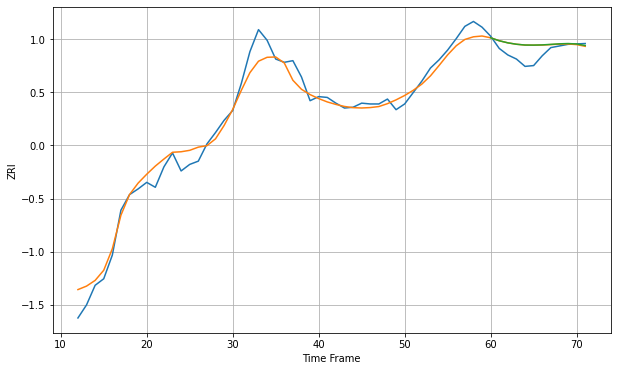

Wall time: 8.64 s
11208 13.738911955595016 13.38389416254962 13.413569500513097 [2250.00989951 2246.39515416 2243.82734015 2242.10934965 2241.15547492
 2241.06678683 2241.31780892 2241.95354572 2242.61915993 2242.97502046
 2242.44180993 2240.59232466]

Got an mse at 0.0049 in round 127 and stopped training

60 60 12


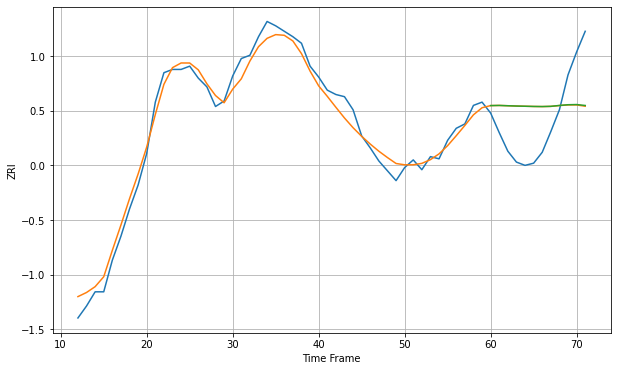

Wall time: 8.99 s
11209 9.470552221108152 41.687171461096945 41.55196765955533 [2088.82954158 2088.96466954 2088.6917052  2088.41836119 2088.22450984
 2088.03379465 2087.94524709 2088.14481209 2088.95807546 2089.61711301
 2089.7879062  2088.92596309]

Got an mse at 0.0049 in round 95 and stopped training

60 60 12


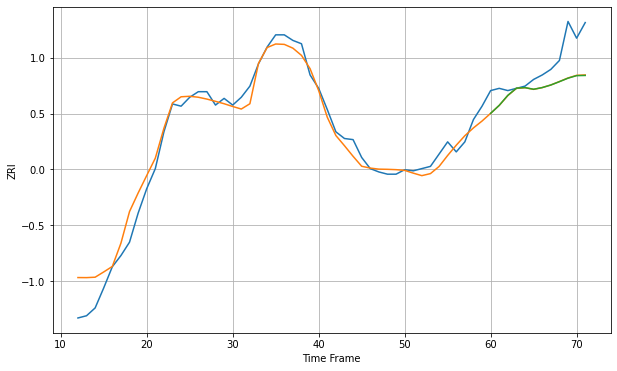

Wall time: 8.26 s
11210 11.946800811924057 24.700221920021136 24.83108655017146 [1939.58117737 1946.76836406 1955.74561891 1962.15896915 1962.66791232
 1961.18560982 1962.68625249 1964.99585303 1968.000765   1971.12762137
 1973.39188652 1973.56711948]
60 60 12


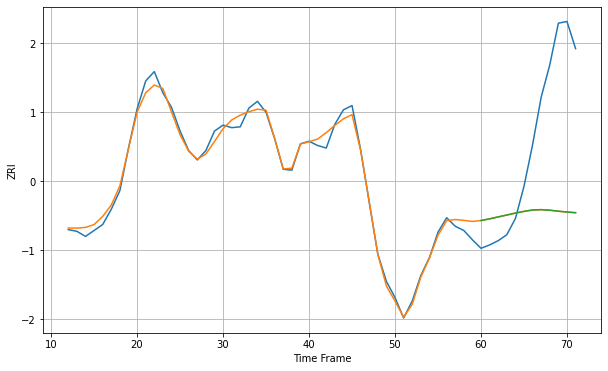

Wall time: 18.7 s
11211 7.655669419200785 127.0412318318686 126.99904371641594 [2738.69808479 2740.67479528 2742.96860085 2745.17343462 2747.47137065
 2749.45780926 2751.10412114 2751.51138251 2750.8603199  2749.6673304
 2748.7381232  2747.95967521]

Got an mse at 0.0050 in round 206 and stopped training

60 60 12


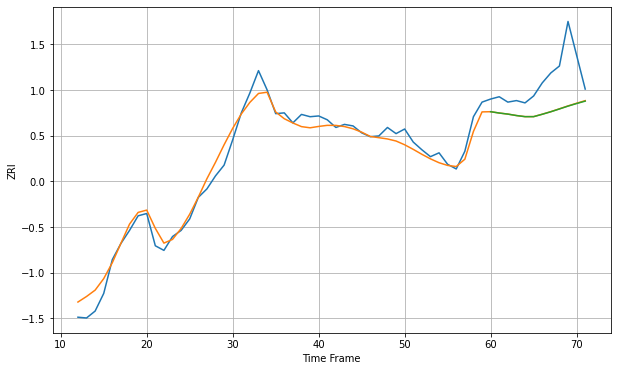

Wall time: 10.8 s
11212 12.919108756210928 46.45680579143804 46.61433687541284 [2142.52875267 2140.79361117 2139.40317387 2137.5163179  2136.08330812
 2136.07495499 2139.16865926 2142.45655125 2146.09940393 2149.80921155
 2153.15597983 2156.28990159]

Got an mse at 0.0049 in round 134 and stopped training

60 60 12


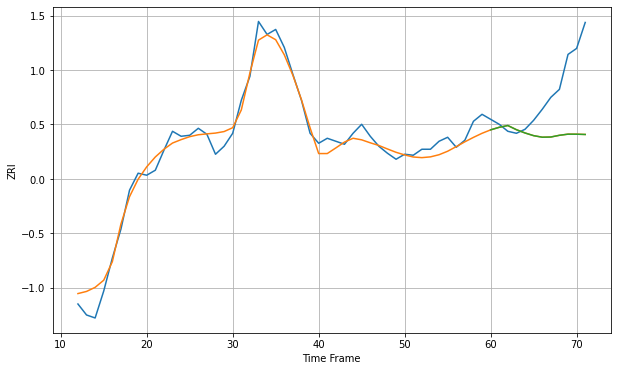

Wall time: 12.1 s
11213 10.732855245813607 51.01315019131228 51.033035106085485 [2293.41725109 2295.98607585 2297.75826897 2293.58290539 2290.3102233
 2287.61579886 2286.07133985 2286.25437228 2287.9750996  2289.11198121
 2289.06304315 2288.79565852]

Got an mse at 0.0050 in round 130 and stopped training

60 60 12


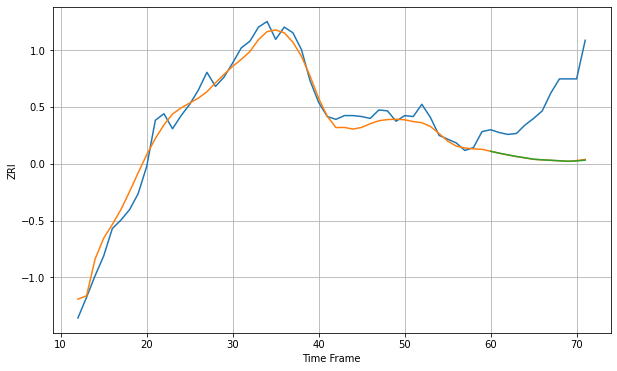

Wall time: 12.7 s
11214 11.378837947594162 65.7161331862799 65.83664445804094 [2057.09387176 2055.06782038 2053.29336305 2051.57896962 2050.19857498
 2048.63575185 2048.01753353 2047.53823111 2047.04501074 2046.50700992
 2046.77485311 2047.66064684]
60 60 12


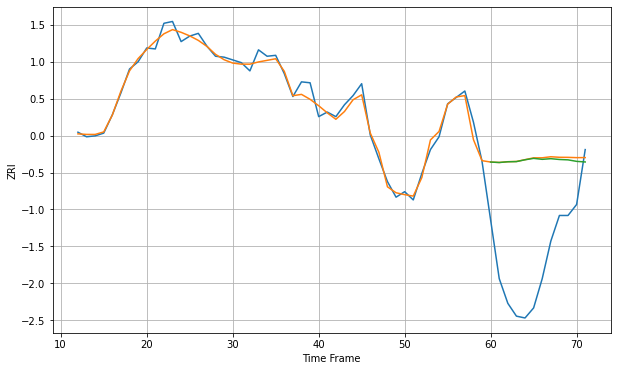

Wall time: 19 s
11215 7.0104292172296505 117.66841747194606 116.93873427714547 [2549.38526579 2548.88515611 2549.68275998 2549.88557682 2551.86237919
 2553.40410207 2552.35273983 2553.06768398 2552.18710571 2551.7794233
 2550.13769499 2549.46884489]

Got an mse at 0.0050 in round 183 and stopped training

60 60 12


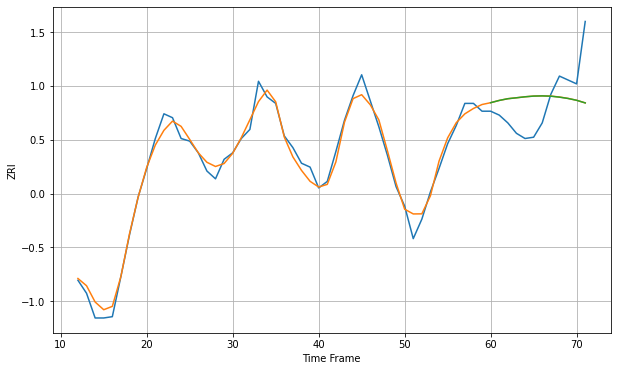

Wall time: 11 s
11216 6.7262872143795995 26.241648905127704 26.25261785180466 [2512.53534097 2514.27978241 2515.60223646 2516.31718852 2517.07838905
 2517.62042081 2517.76648039 2517.5393396  2516.8055459  2515.79232786
 2514.38102428 2512.36955984]
60 60 12


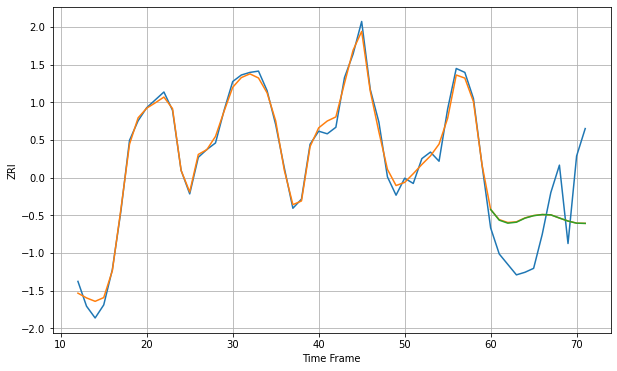

Wall time: 18.7 s
11217 5.060660644131811 37.97028519591335 37.86278243952135 [2805.07779576 2796.88609842 2794.57439334 2795.32076158 2798.43325448
 2800.3077835  2801.15295872 2800.93583816 2798.50477374 2796.20156217
 2794.57551261 2794.4077262 ]

Got an mse at 0.0050 in round 215 and stopped training

60 60 12


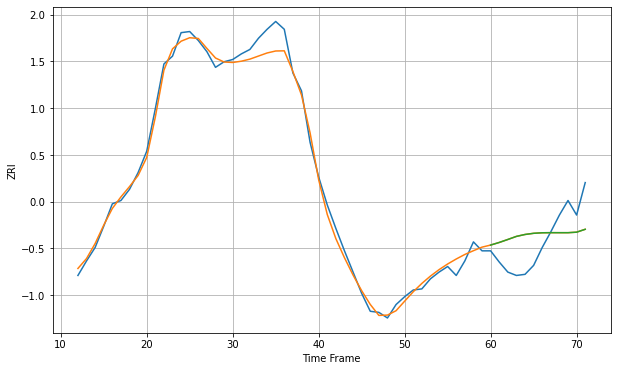

Wall time: 12.6 s
11218 8.010659939553143 25.361170603879966 25.368619497931203 [2040.17001199 2042.48858543 2045.15475443 2047.91714632 2049.62717858
 2050.67654263 2051.15003366 2051.24125806 2051.22288059 2051.21954232
 2051.67731914 2054.24045031]

Got an mse at 0.0050 in round 127 and stopped training

60 60 12


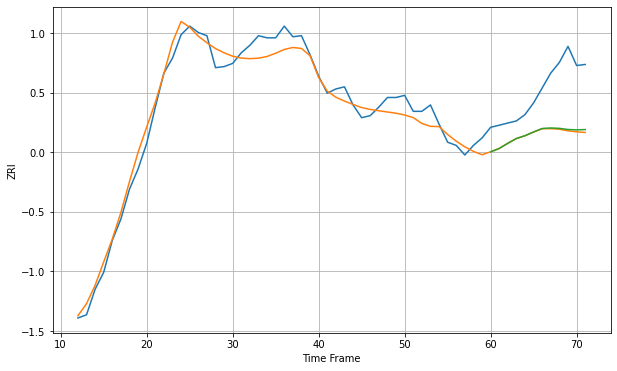

Wall time: 10.2 s
11219 10.941438042396571 45.805014107152104 44.927411715778284 [2087.97752532 2091.13621193 2095.99772743 2100.47906857 2103.13489508
 2106.66187439 2109.92019049 2110.36460285 2110.01709934 2108.93350025
 2108.58639341 2108.88341535]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


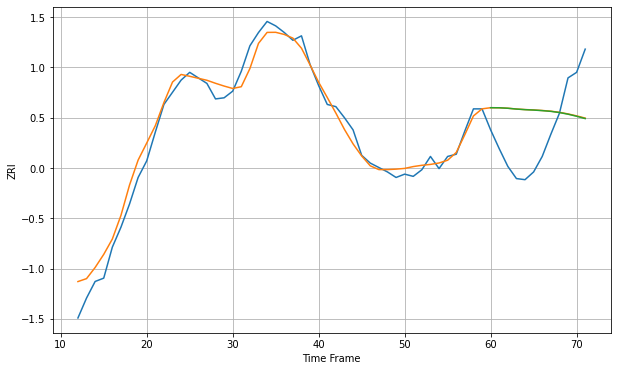

Wall time: 9.34 s
11220 10.344156785339859 45.00018309405555 45.04395187710381 [2085.04901295 2084.98898945 2084.54899454 2083.81879826 2083.28725273
 2082.92425269 2082.40795957 2081.75372468 2080.6762624  2079.19139061
 2077.32299671 2075.22673073]

Got an mse at 0.0049 in round 272 and stopped training

60 60 12


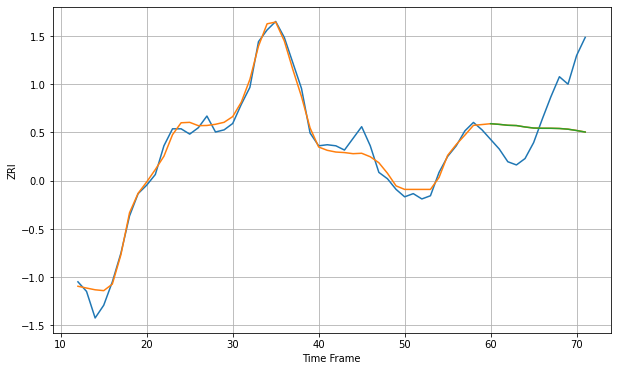

Wall time: 12.9 s
11221 8.039216292622376 43.190740450448345 43.216698385756516 [2449.80619844 2449.17111097 2448.33398471 2448.04778555 2446.72150374
 2445.72158043 2445.49404977 2445.47914356 2445.280148   2444.6255104
 2443.37681993 2441.93611957]

Got an mse at 0.0050 in round 267 and stopped training

60 60 12


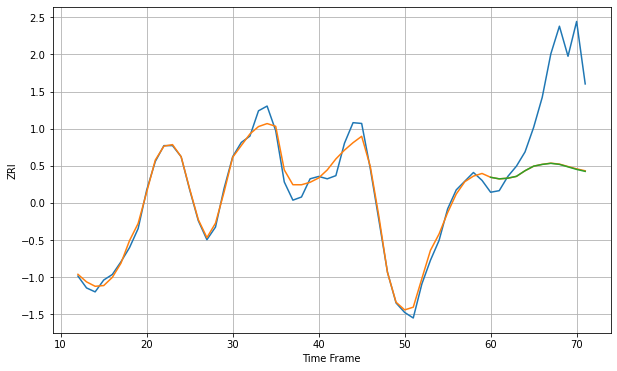

Wall time: 12.8 s
11222 9.557131935436164 102.74618850893987 103.0421495287082 [2733.91899704 2731.95208891 2732.78544637 2735.12552922 2742.24464626
 2747.97832477 2750.20717223 2751.56897941 2750.24849054 2747.11450768
 2743.91765119 2741.39346101]

Got an mse at 0.0050 in round 114 and stopped training

60 60 12


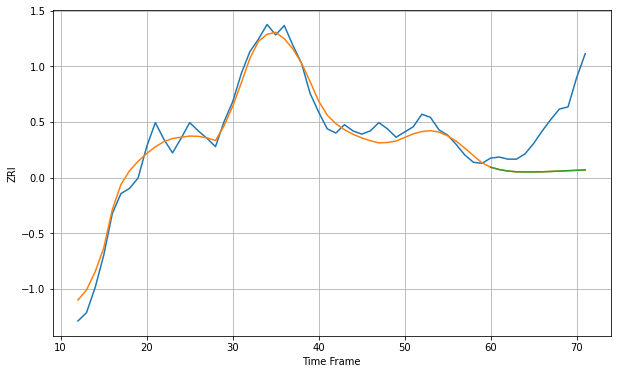

Wall time: 9.21 s
11223 10.215153640442946 52.52770538042793 52.47718092462151 [1998.28713202 1996.0218042  1994.6120945  1993.90764776 1993.71045384
 1993.74530147 1993.90774487 1994.21655941 1994.58062347 1994.96765042
 1995.35259857 1995.69573482]

Got an mse at 0.0050 in round 68 and stopped training

60 60 12


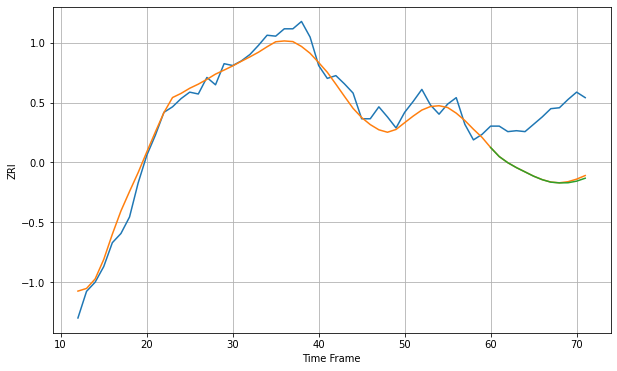

Wall time: 7.35 s
11224 12.648127643782784 65.4856671437399 66.23062734608398 [2086.67728644 2076.8210666  2070.12822571 2064.77383287 2060.12573594
 2055.46307428 2051.6565399  2048.96375729 2048.14316773 2048.29301083
 2050.03687983 2053.2528033 ]

Got an mse at 0.0050 in round 210 and stopped training

60 60 12


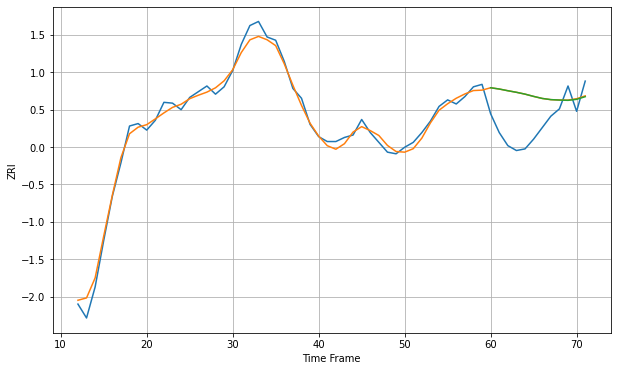

Wall time: 11.3 s
11225 7.956850287549505 44.10479157695472 44.13760280121243 [2308.85112693 2307.29753879 2305.2062611  2303.28557929 2301.03956258
 2298.2703283  2295.78085837 2294.32112881 2293.79110674 2293.42638622
 2294.66499843 2297.91995385]

Got an mse at 0.0050 in round 156 and stopped training

60 60 12


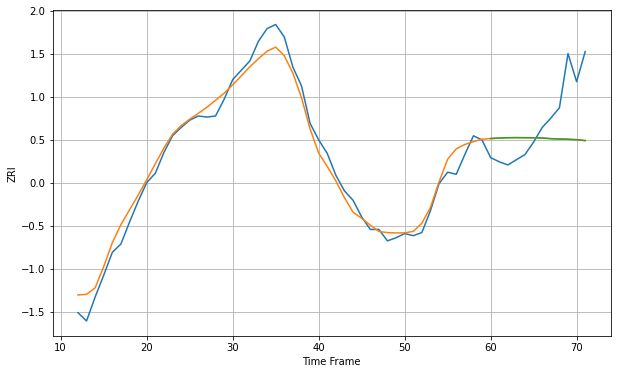

Wall time: 9.27 s
11226 10.823473930212336 41.739755310727936 41.70965356916657 [2043.36025102 2043.82618909 2044.1464947  2044.22845989 2044.16091829
 2044.11079247 2043.87025214 2043.23564386 2042.91664154 2042.69083271
 2042.24459535 2041.41884608]

Got an mse at 0.0050 in round 186 and stopped training

60 60 12


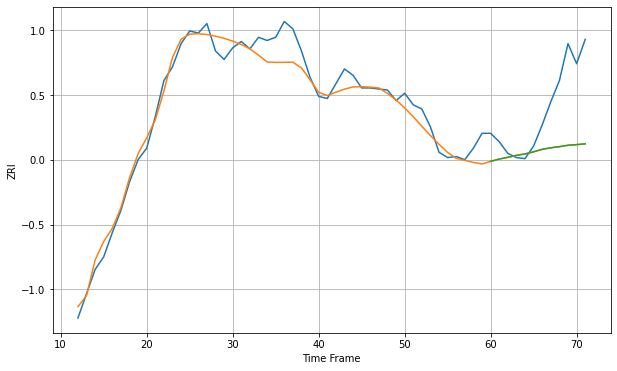

Wall time: 10.5 s
11228 12.851107956835456 51.954662269789296 51.93266710250197 [2084.42191629 2086.60969546 2088.23008357 2090.09074876 2091.44990887
 2093.46255663 2095.85480588 2097.28189546 2098.35117648 2099.67008067
 2100.31332628 2101.06673556]

Got an mse at 0.0049 in round 144 and stopped training

60 60 12


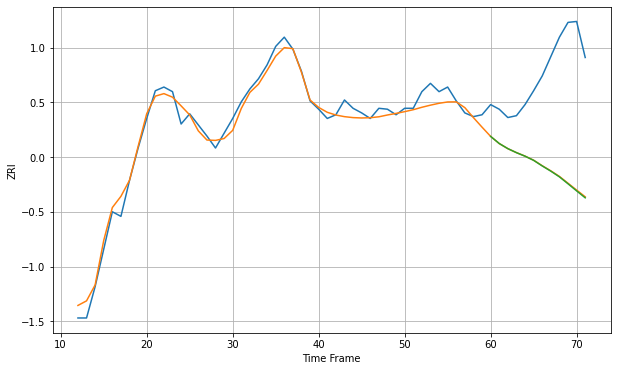

Wall time: 9.06 s
11229 9.657629677158713 111.02800648130464 111.46149955057895 [2042.56590722 2034.86964472 2029.31897431 2024.97871461 2021.15774408
 2016.65227947 2010.59648015 2004.95227589 1998.78181011 1991.25797851
 1983.60490095 1976.08848521]

Got an mse at 0.0049 in round 97 and stopped training

60 60 12


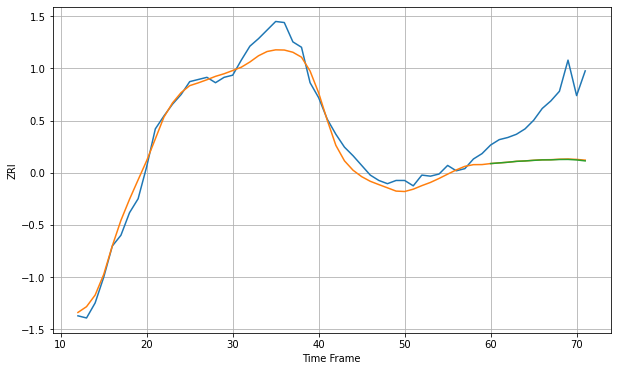

Wall time: 8.86 s
11230 10.02549506355262 51.94029179581769 52.19201278011166 [1952.72300595 1953.34689771 1953.95747043 1954.78444398 1955.15491383
 1955.71406236 1956.13879485 1956.18097895 1956.52062865 1956.58724667
 1956.11380839 1955.2083135 ]
60 60 12


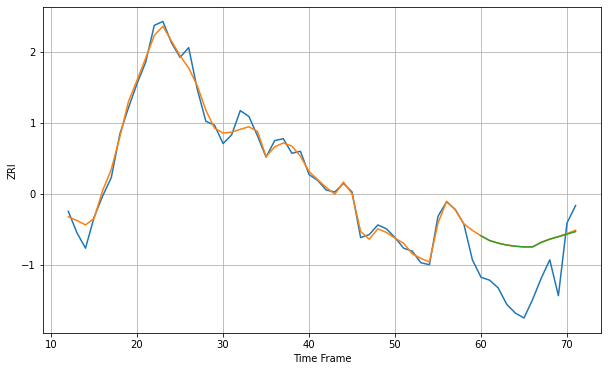

Wall time: 21.5 s
11231 8.675141503610222 49.01292407506886 49.03969382495015 [2748.78441508 2743.88282026 2741.2138846  2739.24694275 2738.06535683
 2737.30282327 2737.3584427  2741.99821272 2745.26758427 2747.7813065
 2750.44002454 2753.12006865]

Got an mse at 0.0050 in round 200 and stopped training

60 60 12


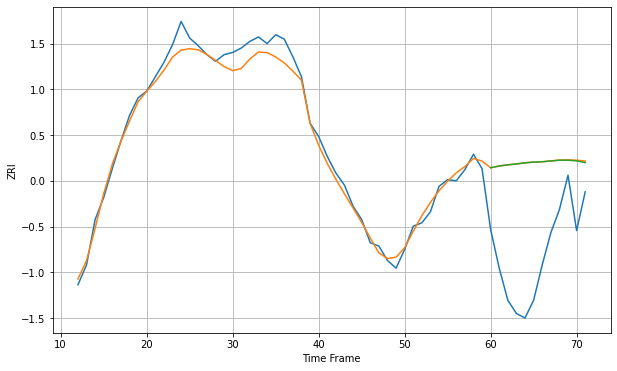

Wall time: 15 s
11232 9.184855539609323 91.3358669215631 91.24052894956603 [2142.76751422 2144.3645499  2145.42682445 2146.19671147 2147.25124481
 2147.87125659 2148.17629546 2148.9123185  2149.56302724 2149.57899888
 2148.9542615  2147.42234747]

Got an mse at 0.0049 in round 95 and stopped training

60 60 12


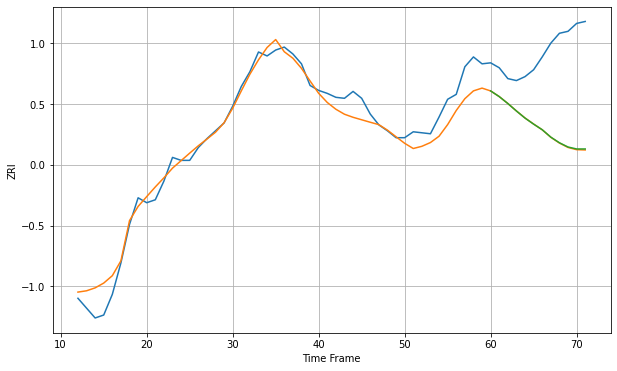

Wall time: 8.55 s
11233 14.456524259540656 82.87679991013312 82.5571612513133 [2284.48465656 2278.73271128 2271.71082572 2264.10784825 2256.92161817
 2250.77516314 2245.0997027  2237.57123504 2231.86335715 2227.55623561
 2225.56889924 2225.56546231]

Got an mse at 0.0049 in round 216 and stopped training

60 60 12


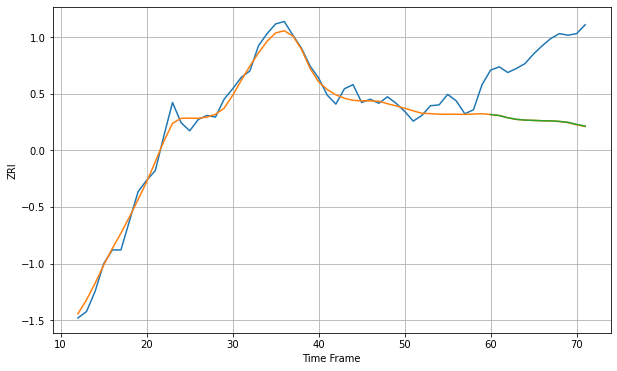

Wall time: 11.5 s
11234 11.260991200076017 89.48903671181542 89.30640107004919 [2043.13074464 2041.87939929 2039.11483743 2037.17440265 2036.28919714
 2035.8929644  2035.46333373 2035.31509802 2034.67975711 2033.51121091
 2030.90188038 2028.87945042]

Got an mse at 0.0049 in round 117 and stopped training

60 60 12


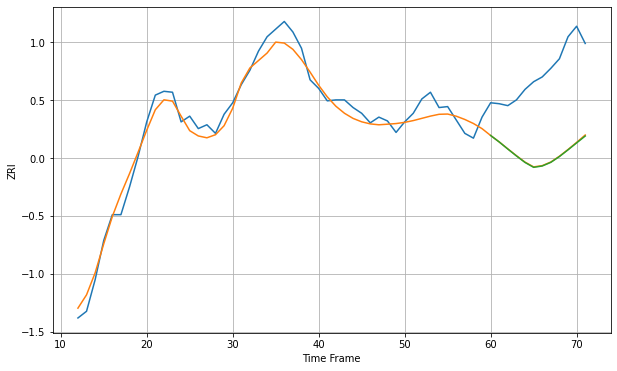

Wall time: 9.01 s
11235 11.538057069075789 85.78527377925478 86.17674288238285 [2077.79407406 2070.97694582 2063.61471932 2056.41928987 2049.59579522
 2044.49809124 2045.89014698 2049.70425587 2055.77176137 2062.77773142
 2070.02438439 2077.20693186]

Got an mse at 0.0050 in round 234 and stopped training

60 60 12


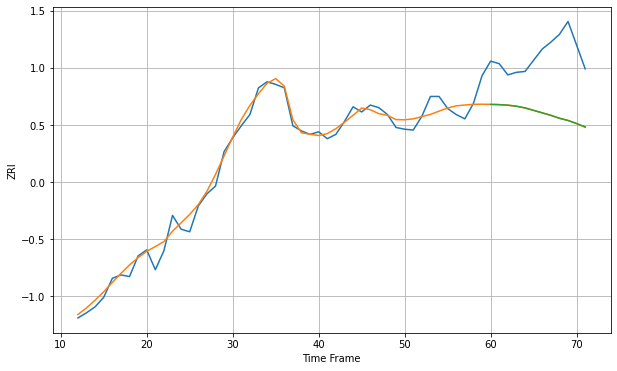

Wall time: 12.1 s
11236 10.588797878443286 71.30712322695936 71.20042242067389 [2089.79280145 2089.51267585 2088.8634049  2087.67969294 2085.70542858
 2082.88637954 2080.03812846 2077.16797928 2073.75920114 2071.14550139
 2067.57773379 2063.69112177]
60 60 12


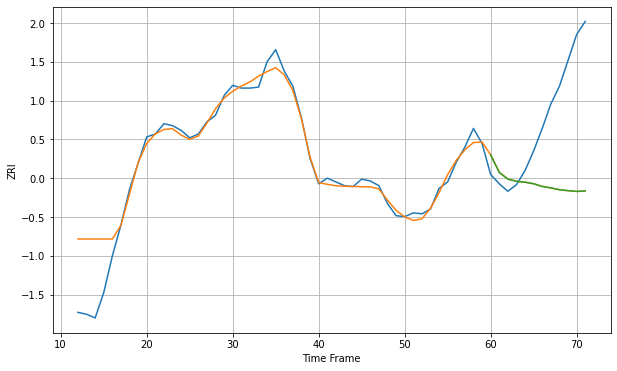

Wall time: 18.6 s
11237 22.742395336938834 93.9847768209151 93.94376361041311 [2437.89807423 2419.07859169 2411.97336331 2409.66370335 2408.68556581
 2407.02127635 2404.16118157 2402.61086056 2400.70690902 2399.69935159
 2398.91452121 2399.43572158]
60 60 12


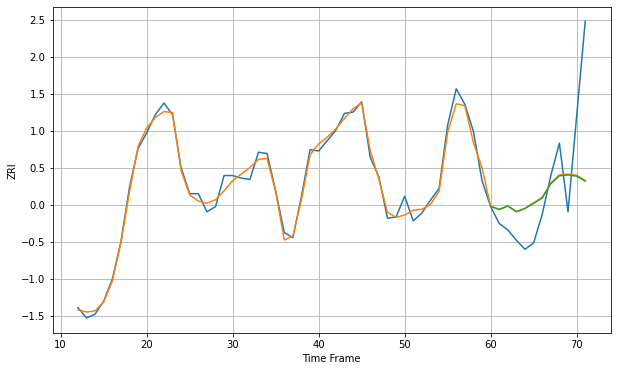

Wall time: 19.7 s
11238 5.252840000725689 42.514554263021346 42.658546043285604 [2703.22877972 2700.85243132 2703.44456307 2699.03235112 2701.52335573
 2705.5533884  2709.66136115 2720.66785143 2726.79631294 2727.43662018
 2726.53227345 2722.67511267]

Got an mse at 0.0050 in round 112 and stopped training

60 60 12


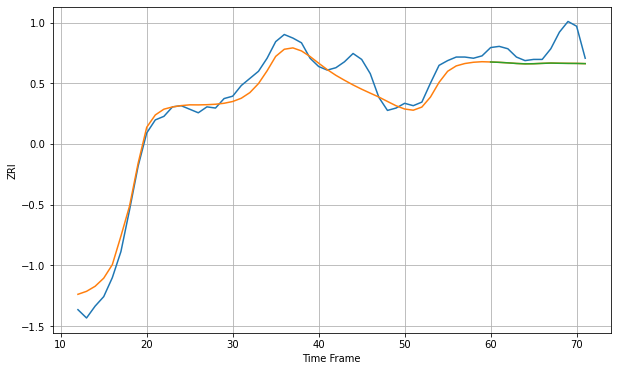

Wall time: 9.03 s
11354 10.358833698762162 17.34784702957635 17.37982642404184 [2111.83243874 2111.53233951 2111.11036722 2110.58187496 2110.26290001
 2110.36694255 2110.65616747 2110.90337436 2110.74310617 2110.64125996
 2110.5996978  2110.44926529]

Got an mse at 0.0050 in round 75 and stopped training

60 60 12


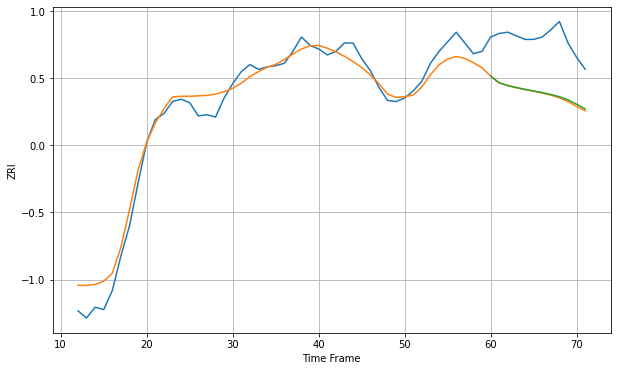

Wall time: 7.84 s
11355 11.035451595802648 45.509843954356135 44.90762902994372 [2154.24473364 2148.62985001 2146.36958713 2144.69681488 2143.21171922
 2141.84907788 2140.47781856 2138.9586592  2137.0631775  2134.46917819
 2130.80999742 2126.83700798]

Got an mse at 0.0050 in round 76 and stopped training

60 60 12


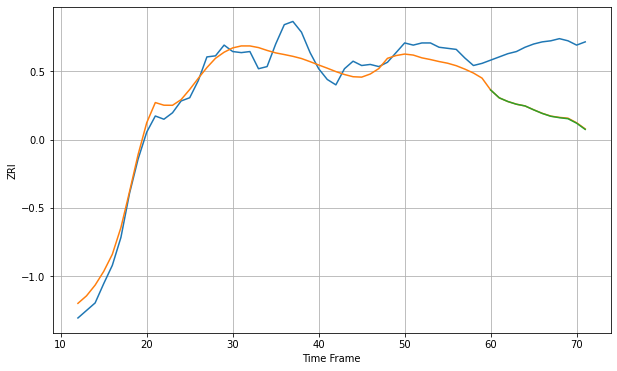

Wall time: 10.7 s
11356 12.253932829060226 61.24998983975964 61.44878540014371 [2174.23382496 2166.91061627 2163.48488523 2160.95681389 2159.3563976
 2155.75770752 2152.40355247 2149.74099682 2148.4416956  2147.4644235
 2143.30639467 2137.52425351]

Got an mse at 0.0050 in round 170 and stopped training

60 60 12


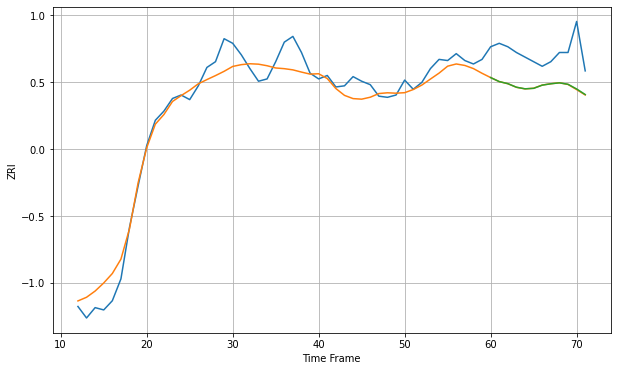

Wall time: 10.2 s
11357 12.225029376412465 30.45885963469462 30.339001137776116 [2206.18361263 2202.69403408 2200.88992247 2197.77892293 2196.40668788
 2196.80172724 2199.58598183 2200.76509994 2201.59883336 2200.3333426
 2196.27747711 2191.43471436]

Got an mse at 0.0048 in round 96 and stopped training

60 60 12


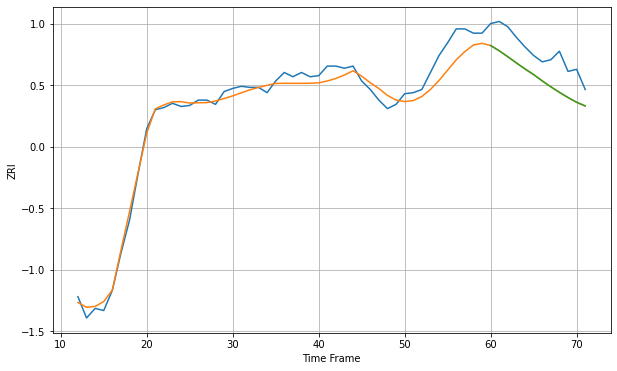

Wall time: 7.75 s
11358 9.951124201147922 25.178548381005033 25.12761929776529 [2198.33208128 2193.41071831 2187.80422614 2181.96533687 2176.3212165
 2171.01227864 2165.11414535 2159.52159654 2154.33861051 2149.45429558
 2144.98819338 2141.61756989]

Got an mse at 0.0049 in round 93 and stopped training

60 60 12


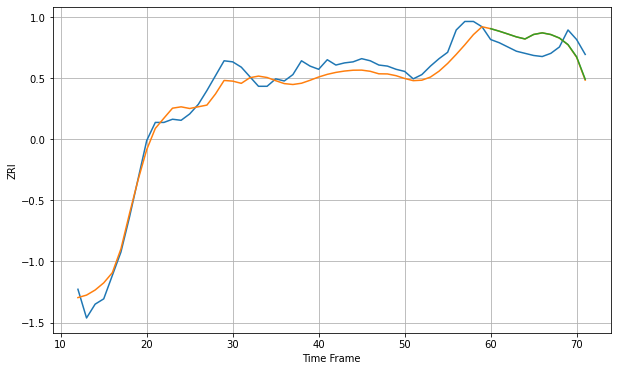

Wall time: 7.9 s
11360 11.197360351393153 15.975343440005682 15.833794609299568 [2284.22068357 2281.86279966 2279.21941408 2276.50299024 2274.53558352
 2278.77492116 2280.29146027 2278.70442656 2275.41737285 2269.22449353
 2257.7268105  2236.66864522]

Got an mse at 0.0050 in round 83 and stopped training

60 60 12


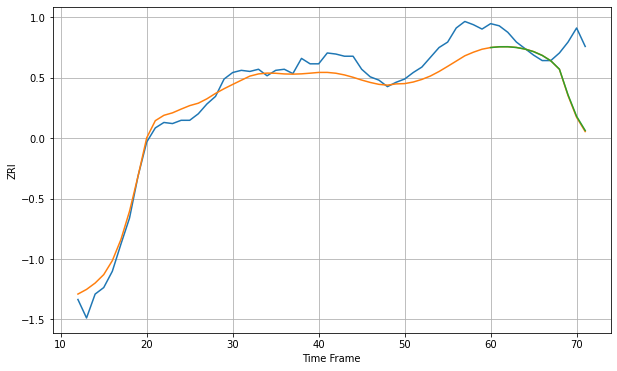

Wall time: 7.46 s
11361 13.141185360494303 37.24904823657201 36.83404379387714 [2186.99169984 2187.6736376  2187.6923753  2187.00911263 2185.55829202
 2183.19550667 2179.72708869 2174.76603331 2167.07653298 2143.47001989
 2123.65078832 2110.58736253]

Got an mse at 0.0049 in round 96 and stopped training

60 60 12


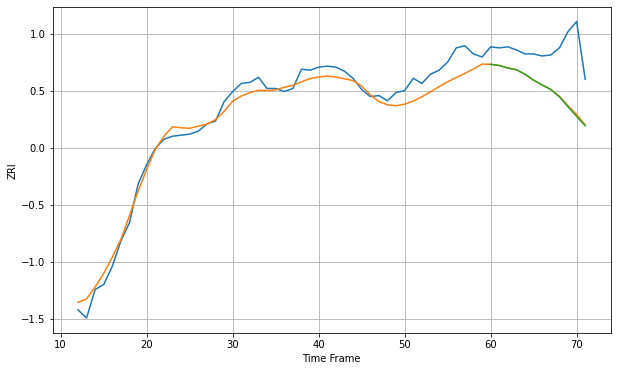

Wall time: 8.08 s
11364 11.202697399347736 43.262742003352464 43.87211950315946 [2234.80987898 2233.6551389  2231.16005895 2229.43666433 2224.98568015
 2219.13667918 2214.38898565 2210.04429783 2202.70501438 2192.96461882
 2183.48953309 2174.33964757]

Got an mse at 0.0050 in round 112 and stopped training

60 60 12


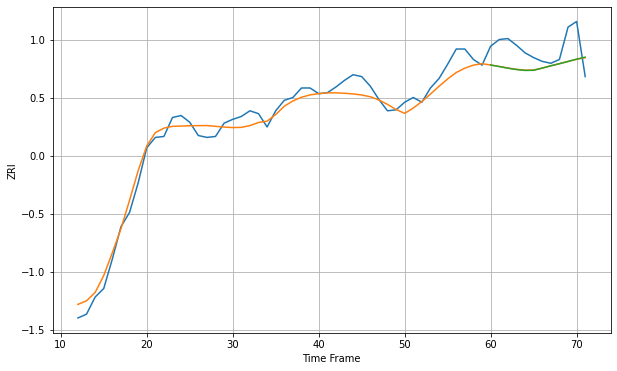

Wall time: 8.81 s
11365 10.54539514373331 23.549006030091796 23.662371814432362 [2220.18209467 2218.5561142  2216.84261167 2215.41347723 2214.4746181
 2214.6181404  2216.91717126 2219.31297579 2221.53721856 2223.91755194
 2226.34035948 2228.42645359]

Got an mse at 0.0050 in round 105 and stopped training

60 60 12


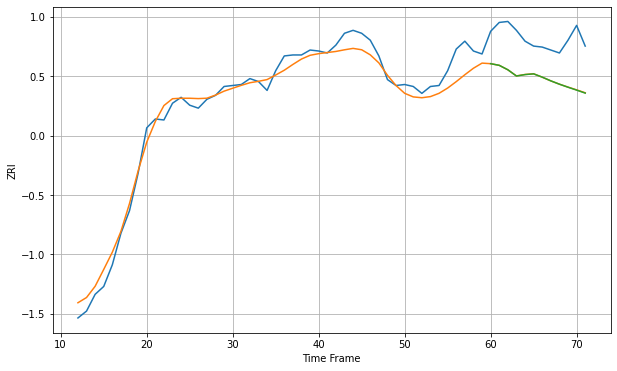

Wall time: 8.07 s
11366 11.84014319827802 42.005203926537476 42.09111010698807 [2194.14543009 2192.46791013 2187.98347923 2181.61181008 2183.05750316
 2183.81309798 2180.47929104 2176.7105351  2173.32530131 2170.26087597
 2167.32724673 2164.26500585]

Got an mse at 0.0050 in round 95 and stopped training

60 60 12


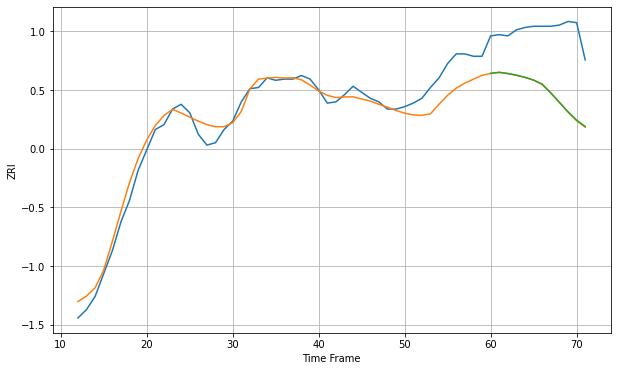

Wall time: 8 s
11367 11.160658054076036 52.574609352931134 52.4638992027517 [2047.74192382 2048.61514838 2047.63071176 2046.2303686  2044.41888095
 2042.14892639 2038.68884253 2031.44012742 2023.6187911  2015.72856734
 2008.72530941 2003.51040196]

Got an mse at 0.0050 in round 54 and stopped training

60 60 12


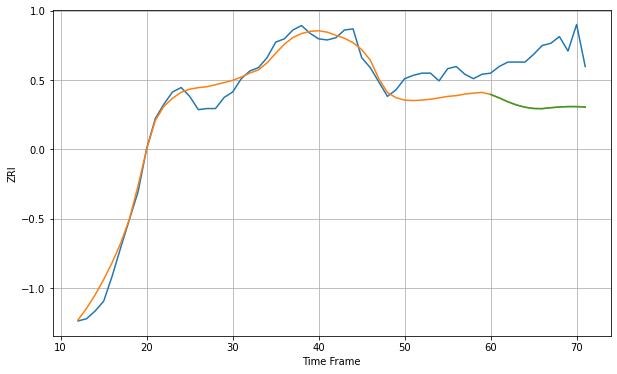

Wall time: 8.34 s
11368 12.611216234371105 48.34630146042626 48.411662557133255 [2193.73873285 2190.60839254 2187.12666704 2184.23404244 2182.17434897
 2181.02971285 2180.87436875 2181.74563505 2182.39564423 2182.74025914
 2182.716199   2182.3104472 ]

Got an mse at 0.0050 in round 93 and stopped training

60 60 12


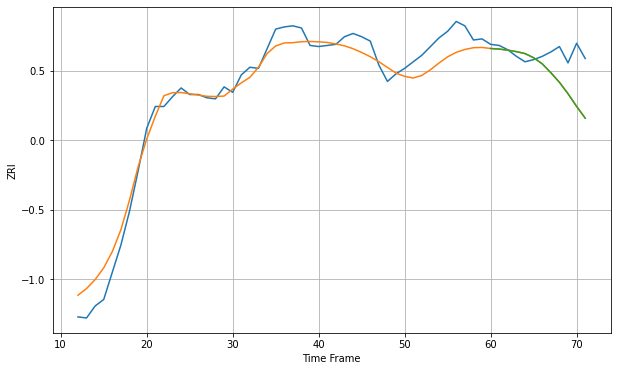

Wall time: 8.01 s
11369 13.730645539210196 26.96254819529037 26.986786862799693 [2241.21048367 2240.66954174 2239.66710506 2238.3304761  2236.53853072
 2232.71630879 2227.13622605 2219.04321911 2210.20135328 2199.70111631
 2188.05502481 2177.27633543]

Got an mse at 0.0049 in round 97 and stopped training

60 60 12


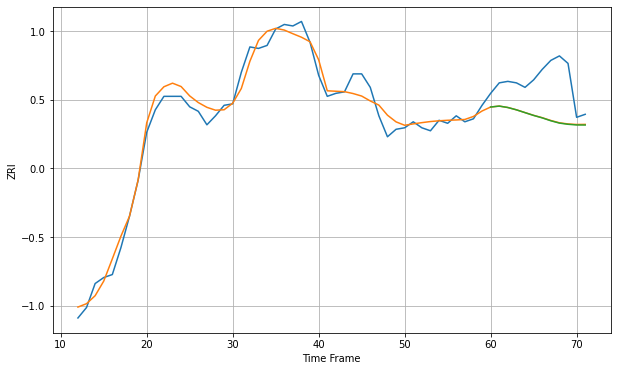

Wall time: 9.24 s
11370 6.887775181966025 26.052476778591394 26.172047949255614 [2152.87192866 2153.48815637 2152.54043698 2150.98965613 2149.11605675
 2147.24848556 2145.62509889 2143.68512446 2142.12789964 2141.33937412
 2140.89019652 2140.85591498]

Got an mse at 0.0050 in round 153 and stopped training

60 60 12


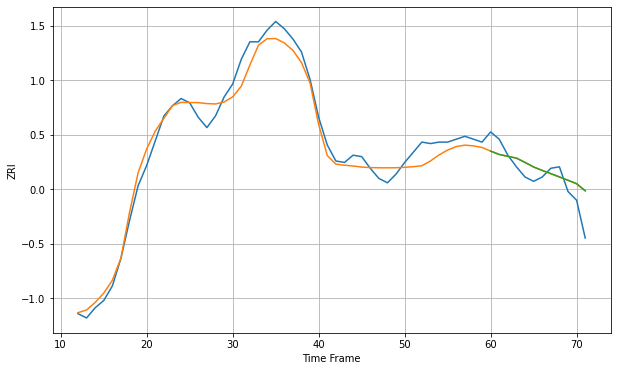

Wall time: 9.51 s
11372 7.904363547634768 12.393641547540312 12.412822391965339 [1976.8026034  1974.50741669 1973.20198538 1971.99121825 1969.04383757
 1965.87032027 1963.50979047 1961.3032076  1959.03754605 1956.76100019
 1954.42975856 1949.50363307]

Got an mse at 0.0049 in round 113 and stopped training

60 60 12


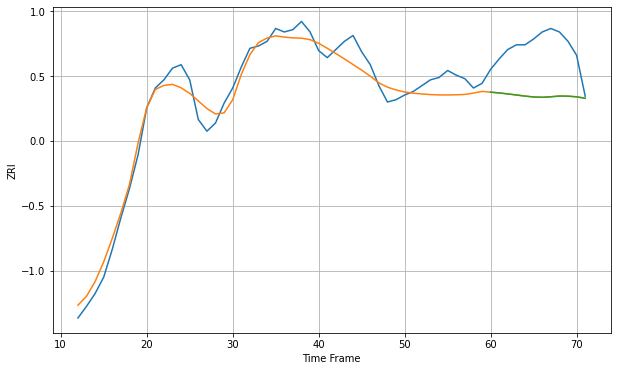

Wall time: 8.33 s
11373 10.892865913288682 42.80820056491145 42.78343971681354 [2142.44451039 2141.76621421 2140.9418485  2140.0149822  2139.08132241
 2138.31153381 2138.05996525 2138.50923419 2139.13301297 2139.01031059
 2138.47413675 2137.2248134 ]

Got an mse at 0.0049 in round 150 and stopped training

60 60 12


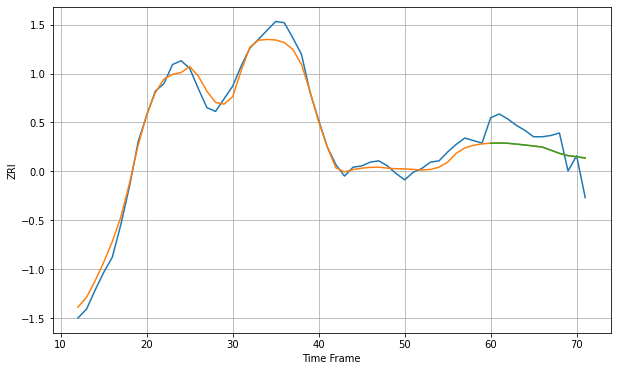

Wall time: 10.3 s
11374 6.659429546158075 16.506665596257733 16.55326448990622 [1996.94004996 1997.05484325 1996.86759067 1996.19915623 1995.50800596
 1994.6773304  1993.89420855 1991.45286258 1988.92790137 1987.12045104
 1986.27420585 1985.36333508]

Got an mse at 0.0050 in round 114 and stopped training

60 60 12


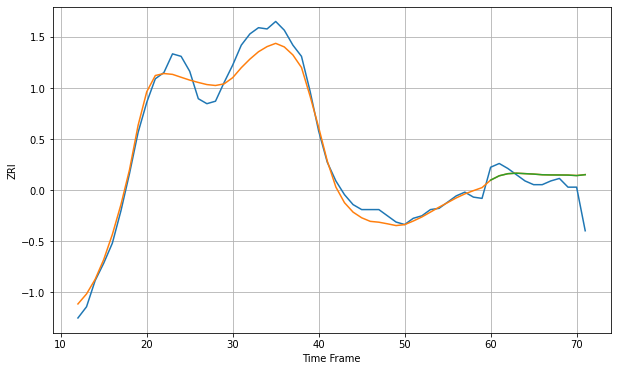

Wall time: 8.36 s
11375 9.329634606797615 14.840510645939807 14.803493034551158 [1997.63791353 2001.13479029 2002.80237053 2003.21050756 2002.84967033
 2002.48608223 2001.96097983 2001.80741289 2001.77133289 2001.70018799
 2001.28204961 2002.00321345]

Got an mse at 0.0050 in round 178 and stopped training

60 60 12


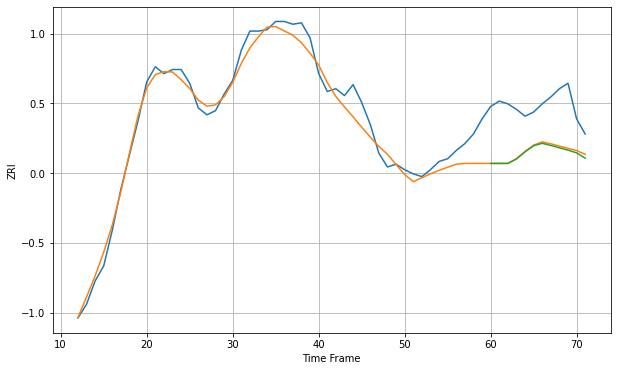

Wall time: 10.2 s
11377 9.488575869416442 35.21077880185113 35.902179361340664 [2100.58790696 2100.58790696 2100.58790696 2103.83001468 2109.01236815
 2113.48753398 2115.25444572 2113.68960531 2111.94787205 2110.26413916
 2108.28420143 2104.43267024]

Got an mse at 0.0049 in round 63 and stopped training

60 60 12


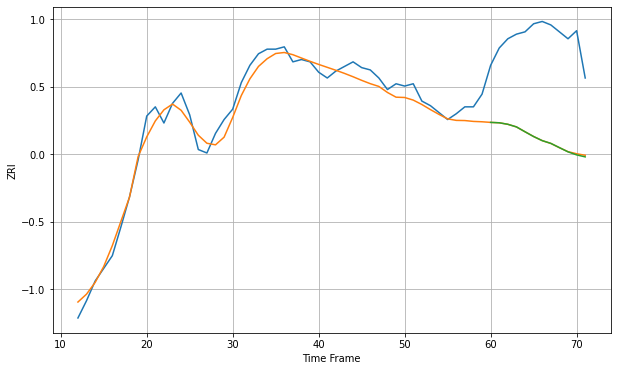

Wall time: 6.87 s
11378 9.537278514332137 87.74777547014936 87.94324693479855 [2111.52069889 2111.18796956 2109.87837911 2107.61475574 2103.38513276
 2099.25285091 2095.70328382 2093.33689711 2089.65217922 2085.99042349
 2083.35500648 2081.63332709]

Got an mse at 0.0049 in round 116 and stopped training

60 60 12


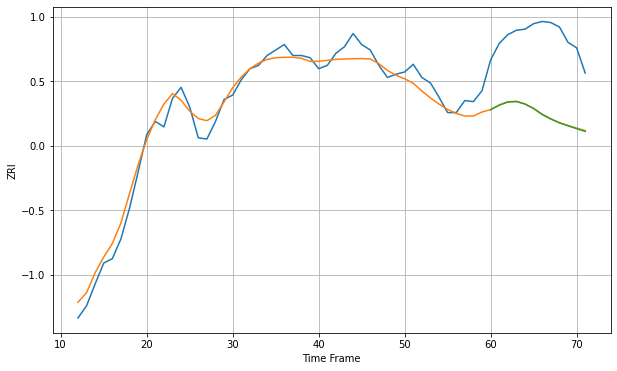

Wall time: 8.34 s
11379 10.318013635042961 70.76335034384581 70.87763009501069 [2102.71123002 2106.77999194 2109.63840027 2110.05863693 2107.79901037
 2103.78541642 2098.44504793 2094.29940201 2090.72601208 2088.00167292
 2085.38667714 2082.8638059 ]

Got an mse at 0.0050 in round 118 and stopped training

60 60 12


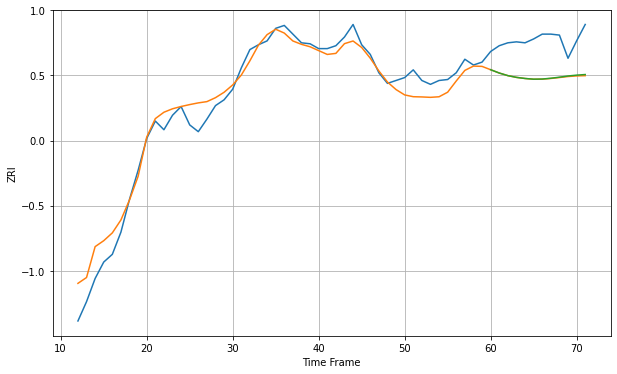

Wall time: 8.74 s
11385 14.26533803383147 38.144584922855394 37.8475557372304 [2153.14636336 2149.73088358 2147.02926191 2145.22972661 2144.07363993
 2143.34542968 2143.49701634 2144.3184884  2145.41534167 2146.66063307
 2147.53953951 2148.16182172]

Got an mse at 0.0049 in round 75 and stopped training

60 60 12


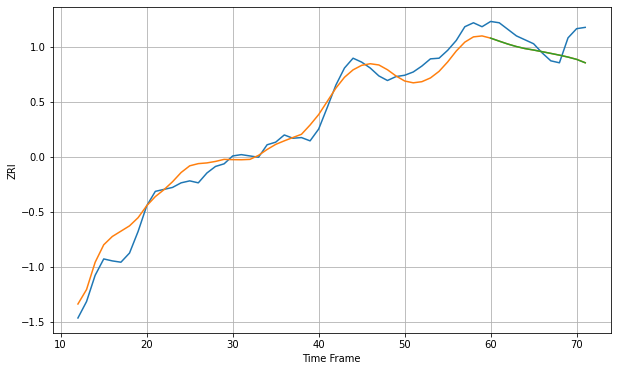

Wall time: 7.47 s
11412 18.315302617221207 26.886041521923357 26.91492449510124 [2189.58396167 2185.00059982 2180.58435945 2176.73442682 2173.67952679
 2171.44882599 2168.90679347 2166.31412472 2163.65879824 2160.71339371
 2157.20434852 2152.03505206]

Got an mse at 0.0050 in round 83 and stopped training

60 60 12


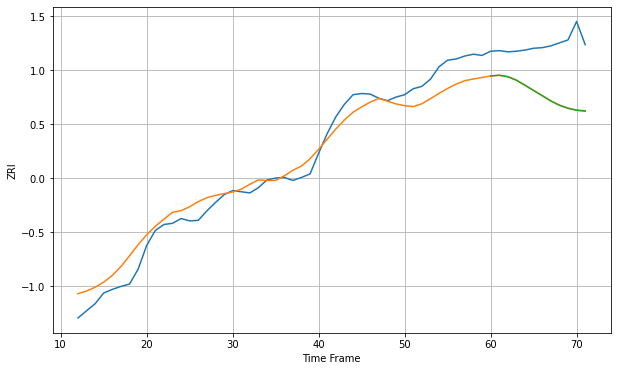

Wall time: 7.81 s
11413 25.535336140880155 86.38744260877048 86.62983771249985 [2199.50563051 2200.66363416 2198.21133458 2192.35262176 2183.82652666
 2175.03350398 2166.3384797  2157.5512558  2150.21333792 2145.12303373
 2141.75422951 2140.32479697]

Got an mse at 0.0050 in round 109 and stopped training

60 60 12


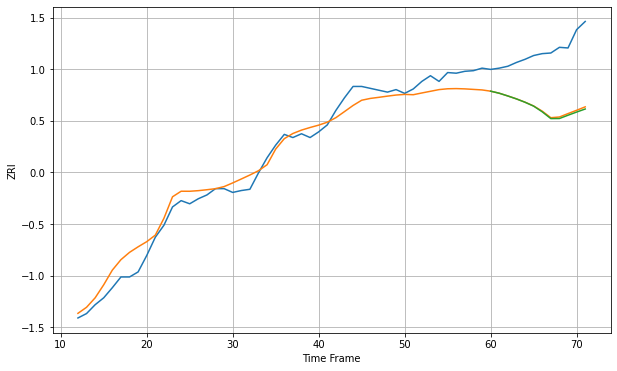

Wall time: 8.13 s
11414 18.60789649498692 89.35376681328972 90.88203221693172 [2157.50534045 2154.25436333 2149.89601423 2145.24231366 2139.93541814
 2133.81612389 2124.78118009 2114.04077414 2114.15688024 2119.3696525
 2124.38853558 2129.24422759]

Got an mse at 0.0049 in round 60 and stopped training

60 60 12


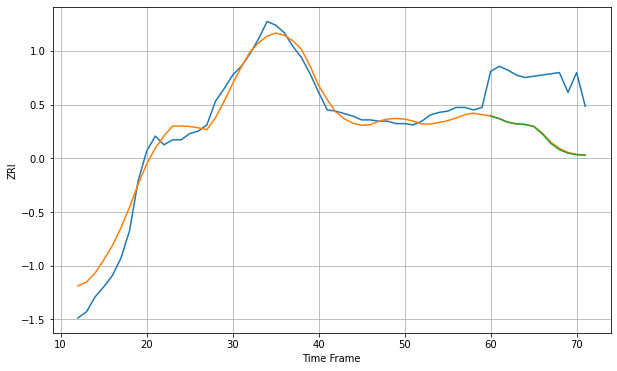

Wall time: 6.73 s
11415 10.534692114367665 46.93355907035696 47.28087289940807 [1914.21323946 1912.00567555 1909.12504682 1907.79422989 1907.34065812
 1905.76057565 1899.8420832  1892.12967643 1887.07591827 1884.26330535
 1883.05377699 1882.63770121]

Got an mse at 0.0049 in round 42 and stopped training

60 60 12


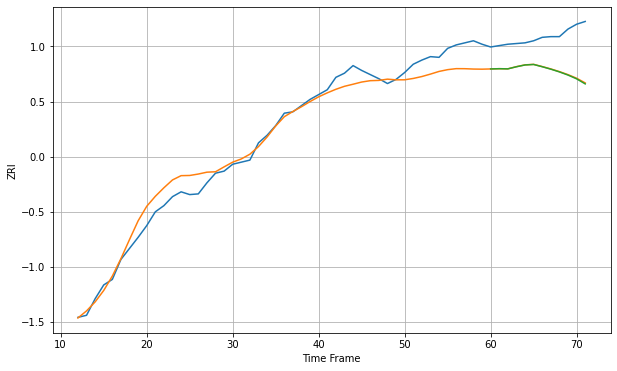

Wall time: 6.24 s
11416 18.579393504594563 51.408983605423686 51.90491372427635 [2142.16451767 2142.51759735 2142.26063124 2145.3395326  2147.92383737
 2148.64176567 2145.37216815 2141.84294325 2137.85104215 2133.27649376
 2127.80751015 2120.47618595]

Got an mse at 0.0050 in round 47 and stopped training

60 60 12


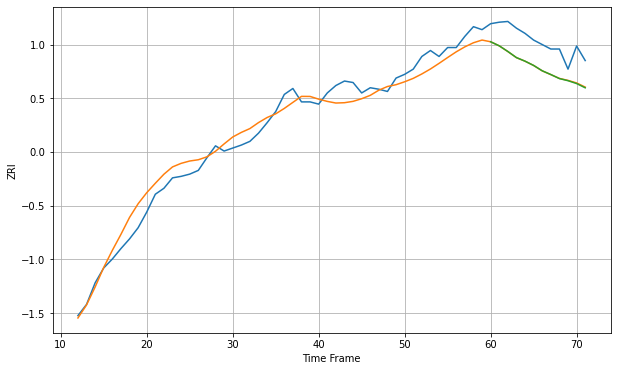

Wall time: 6.46 s
11417 15.67796871159281 35.69835350678167 35.87101134871832 [2099.74142944 2094.28665834 2086.68865294 2078.49478469 2073.69042459
 2067.95566076 2060.76251301 2055.74798447 2050.29925086 2047.44678857
 2043.61357561 2037.9195913 ]

Got an mse at 0.0050 in round 88 and stopped training

60 60 12


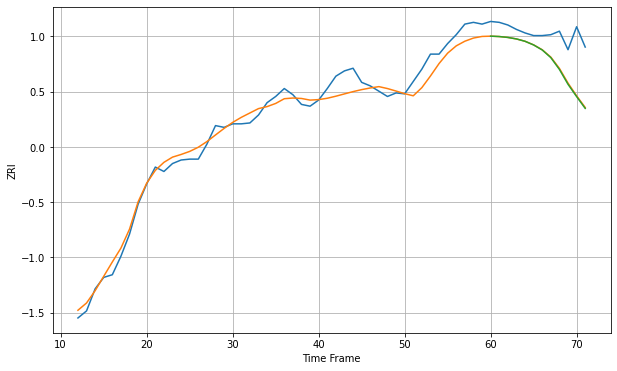

Wall time: 7.53 s
11418 11.595963939999656 36.491974559128806 37.085387054473976 [2064.3447745  2063.91797152 2062.90899132 2061.20367161 2058.53174511
 2054.38411266 2048.70716866 2040.02843795 2026.64508305 2009.81005722
 1995.87370996 1982.47322624]

Got an mse at 0.0050 in round 96 and stopped training

60 60 12


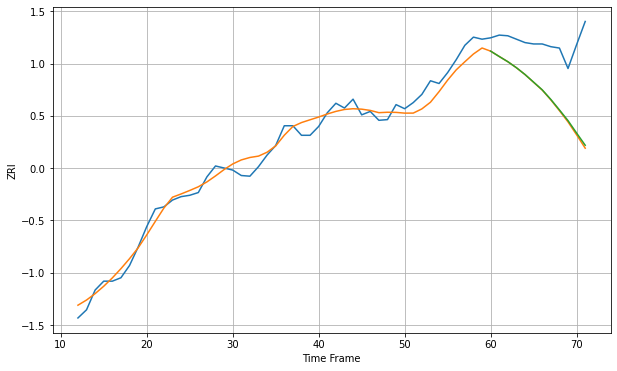

Wall time: 8.1 s
11419 13.758677834805837 85.27280161003385 83.8193336692897 [2164.44800632 2156.60629788 2148.96608755 2140.15355557 2130.18479261
 2118.93887223 2107.70251196 2093.63413607 2078.26804451 2062.54033158
 2044.2630147  2026.38605924]

Got an mse at 0.0050 in round 72 and stopped training

60 60 12


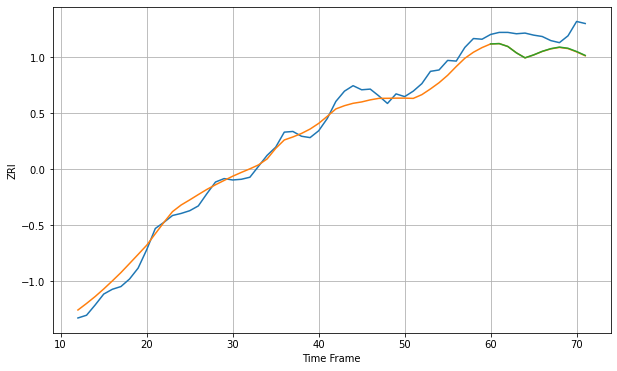

Wall time: 7.22 s
11420 13.27087600686537 27.476357823494997 27.26231251398154 [2167.11995024 2167.60696642 2163.39089704 2154.06690592 2146.75796261
 2151.06447418 2156.26996886 2160.18517565 2162.46895983 2160.76270707
 2156.00255563 2150.32172565]

Got an mse at 0.0050 in round 140 and stopped training

60 60 12


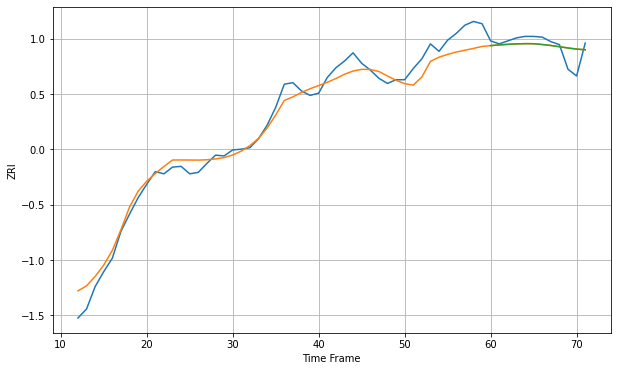

Wall time: 11.5 s
11421 16.098962970505898 14.836834375589438 14.815639704956235 [2126.62151555 2127.63176872 2128.34909531 2128.99087366 2129.28573643
 2129.20032132 2128.13576366 2126.82874328 2125.15271764 2123.45205097
 2121.97834793 2121.10108974]

Got an mse at 0.0050 in round 84 and stopped training

60 60 12


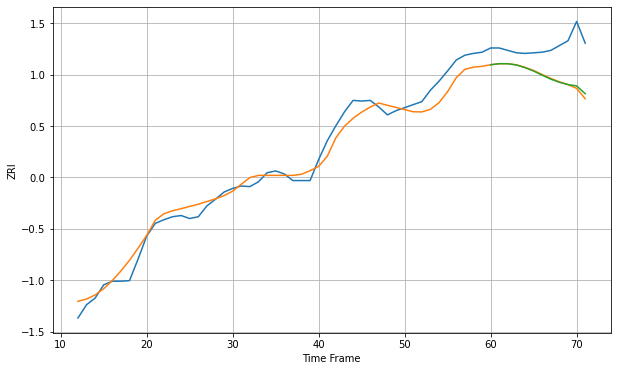

Wall time: 8.16 s
11422 17.467503261180372 55.524082209791814 54.04570656913044 [2201.14957867 2202.91867182 2202.86542095 2200.76004565 2196.32785681
 2190.71394161 2183.77773017 2177.28587199 2172.06853004 2168.20673719
 2166.08927765 2153.100164  ]

Got an mse at 0.0049 in round 68 and stopped training

60 60 12


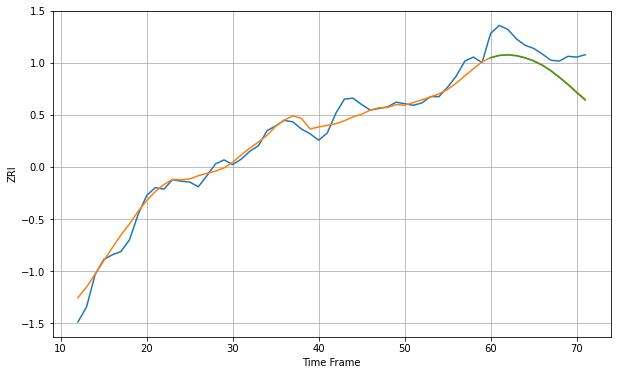

Wall time: 7.29 s
11423 11.313953742592782 30.821496759047992 31.39124685294317 [2075.2526904  2078.04155287 2078.75546013 2077.66276264 2074.93580017
 2071.02427245 2065.63378012 2058.54066271 2050.19998794 2041.07706508
 2031.11756747 2021.50790649]

Got an mse at 0.0050 in round 155 and stopped training

60 60 12


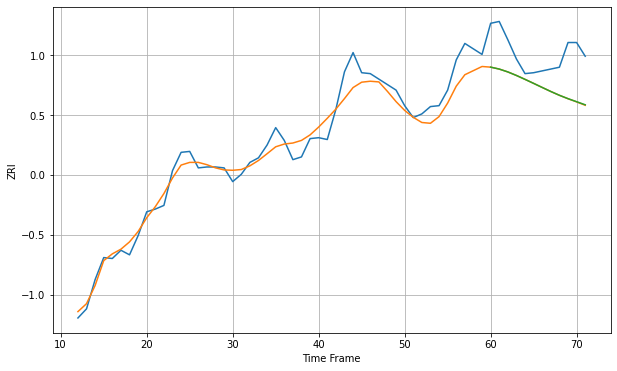

Wall time: 10.3 s
11426 13.97886348988321 40.27223833081021 40.172322839348325 [2116.09139639 2113.98408421 2110.86201115 2106.99220065 2102.73133955
 2098.34270535 2093.88479729 2089.47206253 2085.33174047 2081.64381963
 2078.32425218 2074.96328538]

Got an mse at 0.0050 in round 128 and stopped training

60 60 12


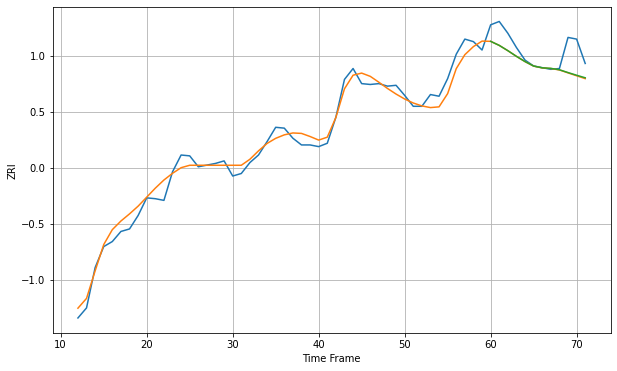

Wall time: 8.88 s
11427 10.513850178770745 21.915270603203066 21.670538122571152 [2159.33970467 2154.52136174 2148.24140689 2141.49993511 2135.27363373
 2129.9444218  2127.79079137 2127.16075499 2125.51053345 2122.16945565
 2118.9872236  2115.96680782]

Got an mse at 0.0050 in round 96 and stopped training

60 60 12


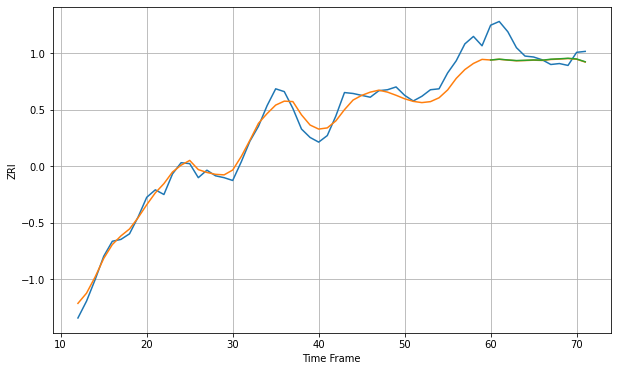

Wall time: 7.93 s
11428 10.608877908067461 19.272557158611075 19.21562342931522 [2043.79116472 2044.66560799 2043.85983938 2043.18348929 2043.46939473
 2043.85270434 2043.5827491  2044.6278615  2045.07408518 2045.64666512
 2044.89854028 2041.89734184]

Got an mse at 0.0050 in round 150 and stopped training

60 60 12


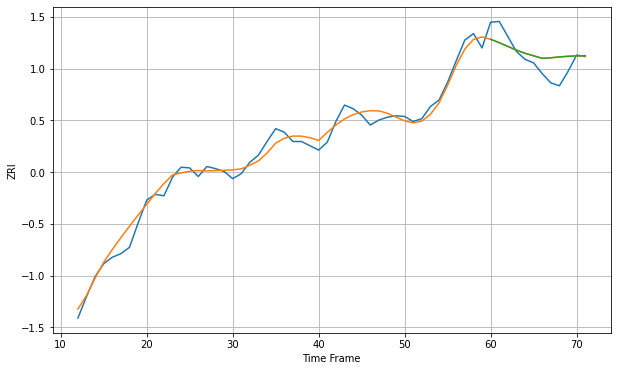

Wall time: 9.7 s
11429 10.955300200030663 21.597921221222368 21.619033369325138 [2135.04338176 2130.28190285 2125.07077124 2119.87390841 2115.48354286
 2111.98004582 2108.41138776 2109.18009843 2110.38336071 2111.28631347
 2111.82401452 2112.00343054]

Got an mse at 0.0050 in round 79 and stopped training

60 60 12


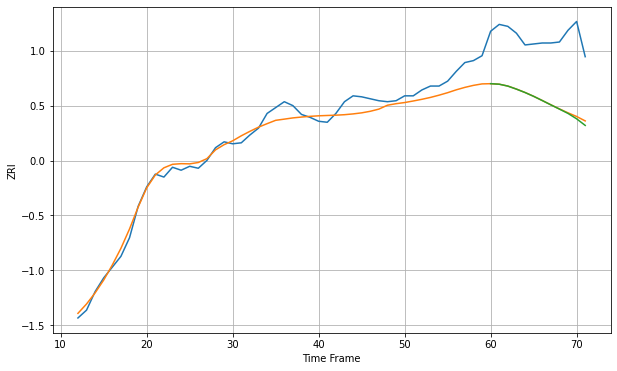

Wall time: 8.07 s
11432 10.58987412041582 65.6783780485818 66.47186263040936 [1962.41881195 1961.88190672 1959.96289992 1956.85853405 1953.39570272
 1949.49304147 1945.20540297 1940.79654004 1936.45188638 1932.01311727
 1926.52185121 1919.78111377]

Got an mse at 0.0049 in round 142 and stopped training

60 60 12


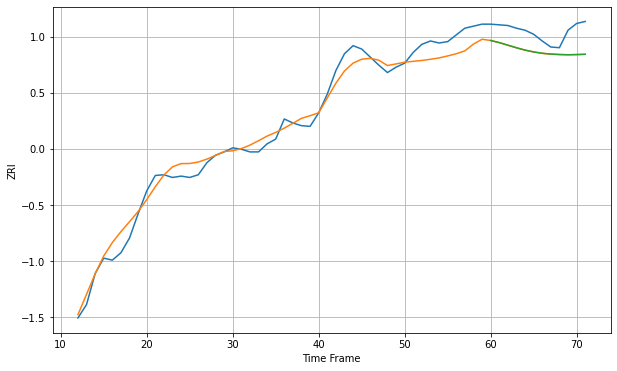

Wall time: 9.43 s
11433 16.647499333495315 30.245957398855236 30.230227197025247 [2183.69132202 2180.57719588 2176.74262967 2172.87652521 2169.42203231
 2166.68416368 2164.68134618 2163.46700444 2162.85553865 2162.48363394
 2162.76206695 2163.16400196]

Got an mse at 0.0049 in round 109 and stopped training

60 60 12


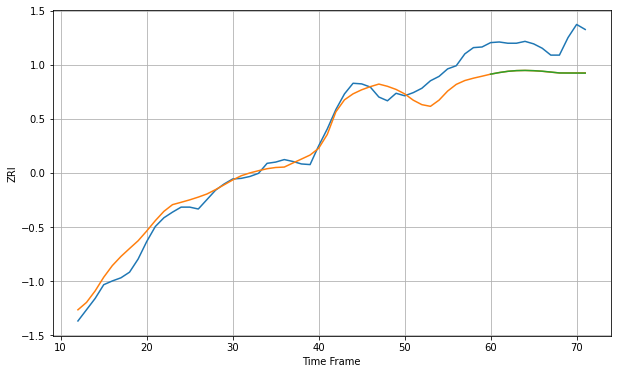

Wall time: 8.87 s
11434 20.80277789055772 49.831151561812305 49.88532978977435 [2144.57390916 2147.10772509 2149.11097269 2150.2265398  2150.54442353
 2150.13723457 2149.29346755 2147.95497731 2146.46580922 2146.35865143
 2146.31981036 2146.23343588]

Got an mse at 0.0050 in round 59 and stopped training

60 60 12


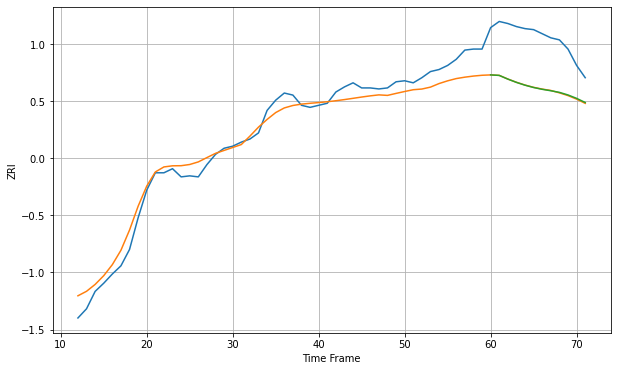

Wall time: 7.2 s
11435 12.073927137729887 49.26201205472186 49.19022138688973 [1965.732946   1965.24324389 1961.62786884 1958.42168356 1955.67161251
 1953.39768671 1951.63727232 1950.23348723 1948.64780005 1946.11162895
 1942.78506844 1938.76879617]

Got an mse at 0.0050 in round 93 and stopped training

60 60 12


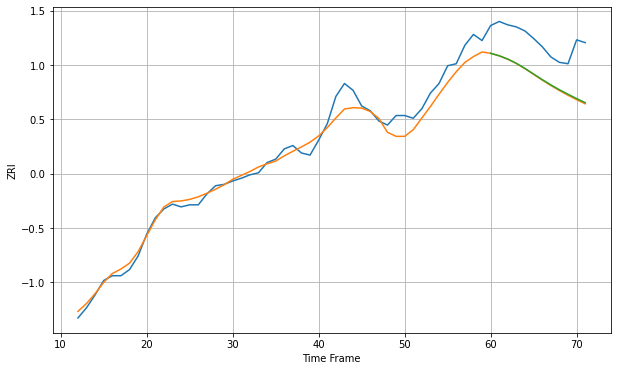

Wall time: 8.56 s
11436 14.71658004502806 57.16662597114752 56.364292905096704 [2099.26195423 2095.66257997 2090.74849243 2084.52527953 2077.01920106
 2068.86613898 2060.70906647 2053.03427982 2045.83545663 2039.21332184
 2032.90832287 2026.89124878]

Got an mse at 0.0049 in round 48 and stopped training

60 60 12


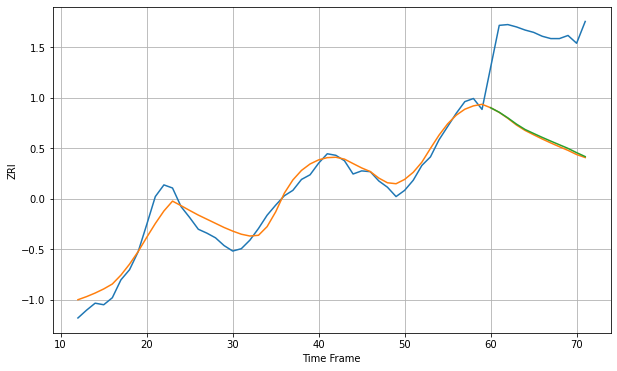

Wall time: 7.1 s
11542 14.092048881179167 131.37469776828678 129.78585474634758 [2348.14284863 2342.33100378 2335.12842748 2327.15490462 2320.25688257
 2315.08734827 2310.05388821 2305.24155399 2300.56105278 2295.90259239
 2290.42187456 2285.37724245]
60 60 12


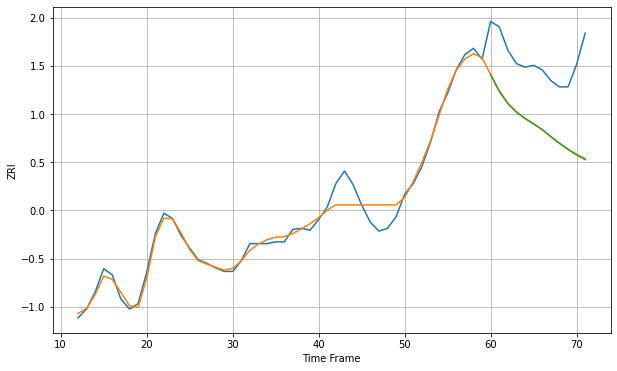

Wall time: 24.1 s
11550 10.495076596085418 76.03567488224037 76.43414364833502 [2228.61121114 2210.17046707 2196.34202967 2186.82139566 2179.73712975
 2173.59519982 2167.27687861 2159.43906018 2151.97024528 2145.1270981
 2138.99163726 2133.77357511]

Got an mse at 0.0050 in round 82 and stopped training

60 60 12


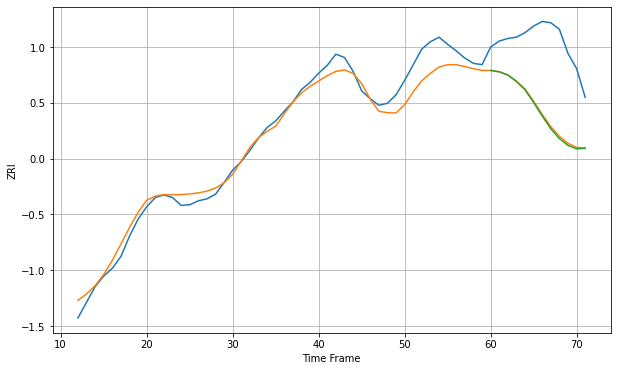

Wall time: 9.96 s
11561 18.913256360734014 109.20969570391445 111.12901671856098 [2463.15467635 2461.09707733 2456.15330367 2446.40640477 2433.69099887
 2414.2778288  2393.43311614 2374.05227701 2359.05405449 2348.69963789
 2343.3848485  2344.15277931]

Got an mse at 0.0049 in round 116 and stopped training

60 60 12


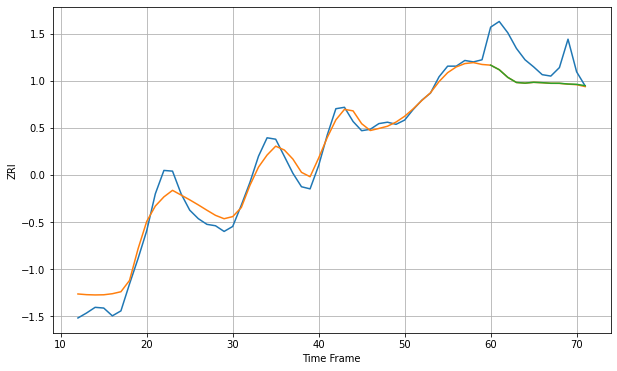

Wall time: 8.33 s
11563 15.708176007140668 41.216766691867996 41.16009937801845 [2283.40539548 2276.97336809 2266.15054262 2259.01393473 2258.07125566
 2259.26411207 2258.69984173 2257.88454639 2257.87114417 2256.83768044
 2256.36582371 2254.47778842]

Got an mse at 0.0049 in round 157 and stopped training

60 60 12


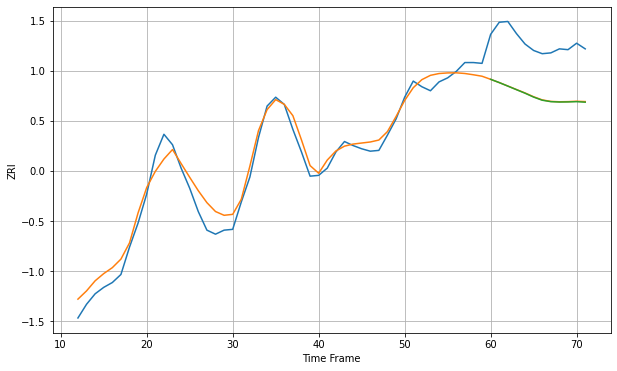

Wall time: 10.2 s
11580 14.495081801471798 65.7045864444491 65.9991157539964 [2188.19227765 2184.1479768  2179.7860298  2175.36317101 2170.96383104
 2166.13848279 2162.25324108 2160.4696559  2160.02079123 2160.15176788
 2160.47717227 2159.82135098]

Got an mse at 0.0050 in round 91 and stopped training

60 60 12


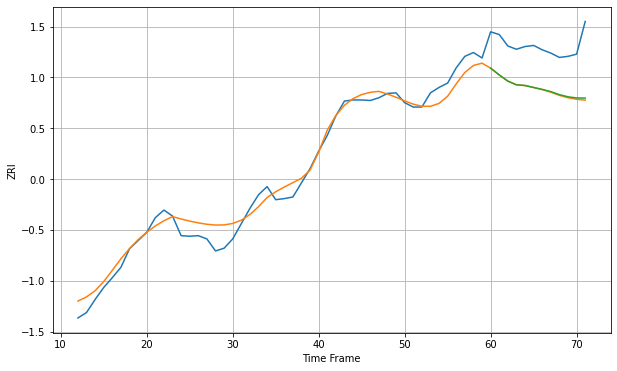

Wall time: 8.3 s
11590 19.75023068444989 80.70227348397682 79.61021582987475 [2543.36319204 2530.87020236 2519.62293726 2512.76638919 2511.47331895
 2507.90149041 2504.32988504 2500.2555972  2494.71088259 2490.78369012
 2488.67800065 2488.46934104]

Got an mse at 0.0050 in round 91 and stopped training

60 60 12


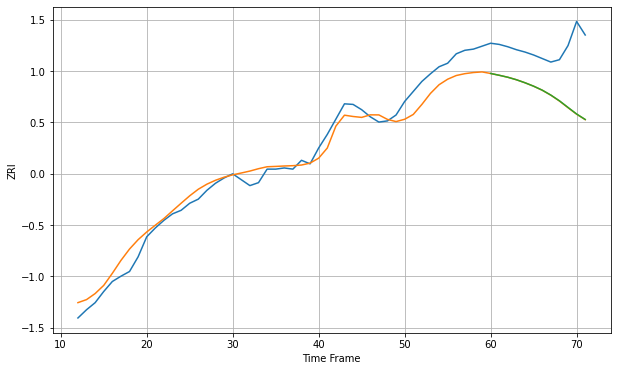

Wall time: 8.6 s
11691 21.533814711615257 83.62575792401984 83.43726897726754 [2161.5977367  2158.528193   2155.17971318 2150.93521651 2145.8063975
 2139.99322974 2133.23498106 2124.89941878 2115.16026746 2103.88211707
 2092.73812364 2083.39498898]

Got an mse at 0.0050 in round 98 and stopped training

60 60 12


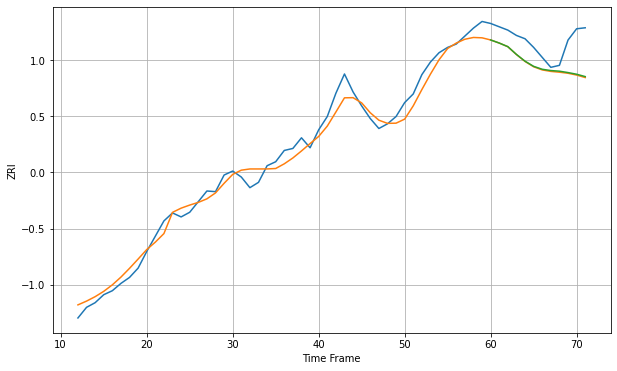

Wall time: 8.28 s
11692 14.573582395123747 38.86606177536096 38.15568922259009 [2183.1876924  2178.5497056  2173.12266588 2161.45325424 2151.25548142
 2143.50946747 2139.097135   2137.17411503 2136.22782199 2134.12679589
 2131.62166435 2128.09924525]

Got an mse at 0.0050 in round 92 and stopped training

60 60 12


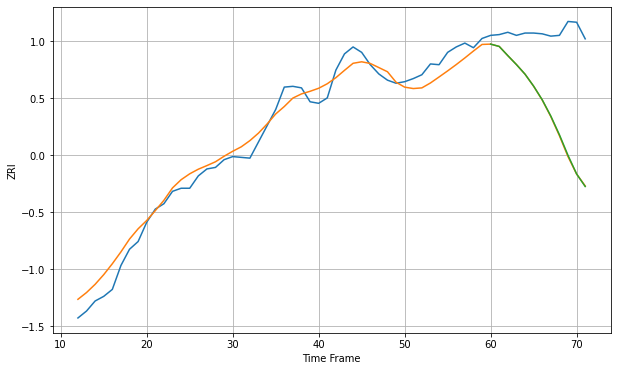

Wall time: 8.29 s
11694 15.785100877729615 112.18880595408261 111.83766529552571 [2147.66934255 2144.64073085 2132.72291625 2121.18346753 2108.74901656
 2093.24650089 2075.56510376 2054.49468765 2030.33088061 2003.60734504
 1979.53237751 1963.22686063]

Got an mse at 0.0050 in round 289 and stopped training

60 60 12


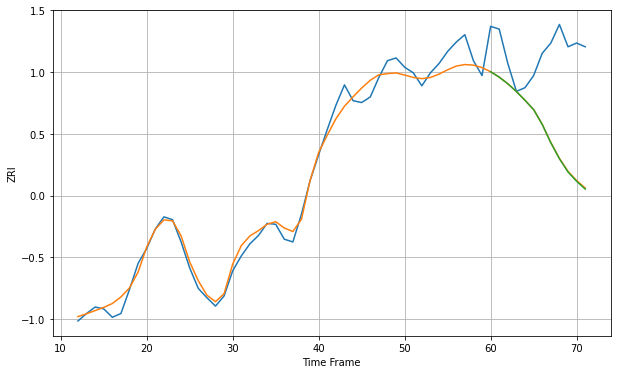

Wall time: 12.8 s
11758 10.964514086494663 94.86243445594585 95.30454945470714 [2413.16919795 2407.32185896 2400.16930182 2391.83332702 2382.35450426
 2372.41013876 2356.45313256 2336.70723332 2319.53729044 2305.33256579
 2295.27611309 2286.8855458 ]

Got an mse at 0.0050 in round 330 and stopped training

60 60 12


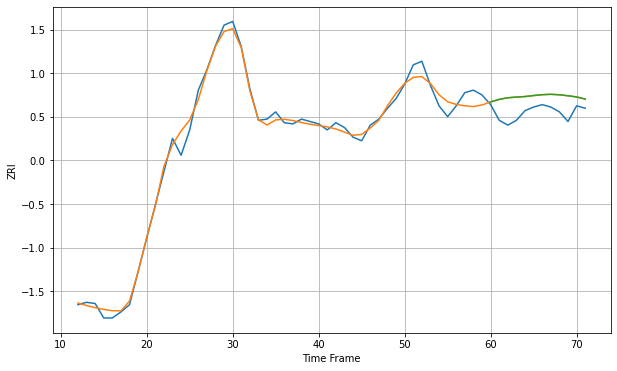

Wall time: 14.5 s
12047 6.227235761192193 14.05069490246194 14.056146860768637 [1133.26617026 1135.35755717 1136.69194309 1137.28323007 1137.70696887
 1138.54946355 1139.26124505 1139.58338088 1139.17502152 1138.35596049
 1137.37411481 1135.60448985]

Got an mse at 0.0049 in round 147 and stopped training

60 60 12


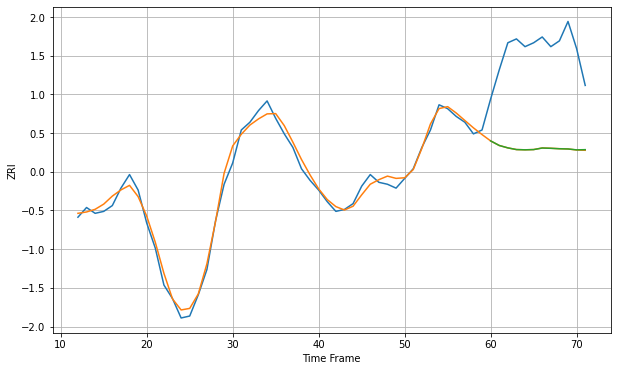

Wall time: 9.78 s
12180 3.445125887189434 51.127728383601216 51.11398139427708 [996.36984978 994.01623325 992.77460796 991.90390982 991.7731302
 991.88801216 992.69600238 992.53992207 992.32023568 992.21139554
 991.74530404 991.85567428]

Got an mse at 0.0048 in round 168 and stopped training

60 60 12


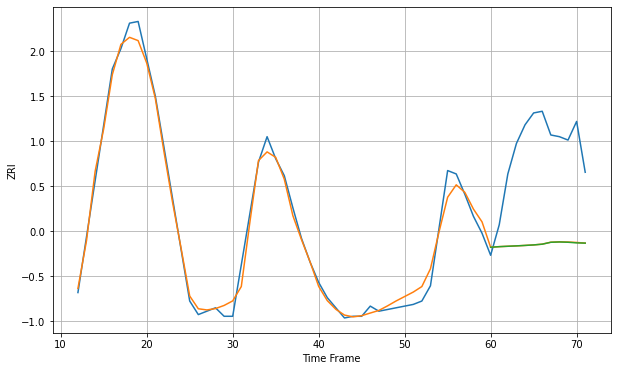

Wall time: 12.7 s
12182 5.386030169839389 58.646423040715895 58.69918004164164 [983.73364085 984.09473858 984.32282906 984.55199185 984.81601107
 985.11796104 985.54634183 986.67767008 986.85839038 986.69194358
 986.32018321 986.18175703]

Got an mse at 0.0049 in round 225 and stopped training

60 60 12


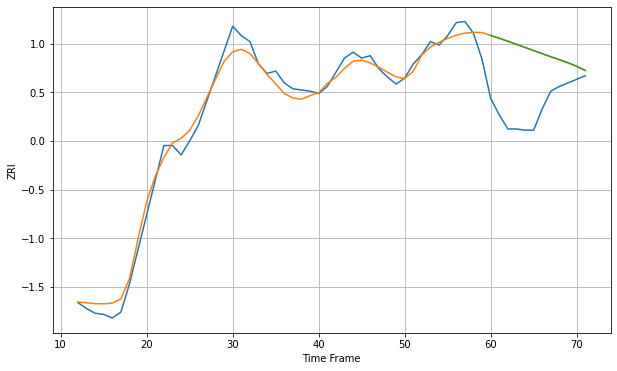

Wall time: 13.1 s
12189 8.308443039558611 50.8600751164942 50.93180270701699 [1149.17482035 1146.80622694 1144.31483285 1141.70057705 1139.0484937
 1136.41288049 1133.7885921  1131.14730305 1128.64342789 1126.07316657
 1123.07889165 1119.53005413]

Got an mse at 0.0049 in round 349 and stopped training

60 60 12


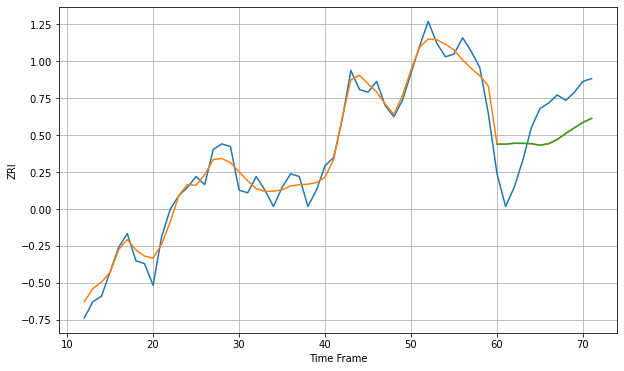

Wall time: 14.9 s
12202 4.4320612605496335 14.188386151300335 14.185438647665233 [1091.91479833 1091.90224462 1092.22830524 1092.21902129 1092.09950192
 1091.5433114  1092.07096236 1093.62322071 1095.86390999 1097.89317861
 1099.89721754 1101.34055282]

Got an mse at 0.0050 in round 171 and stopped training

60 60 12


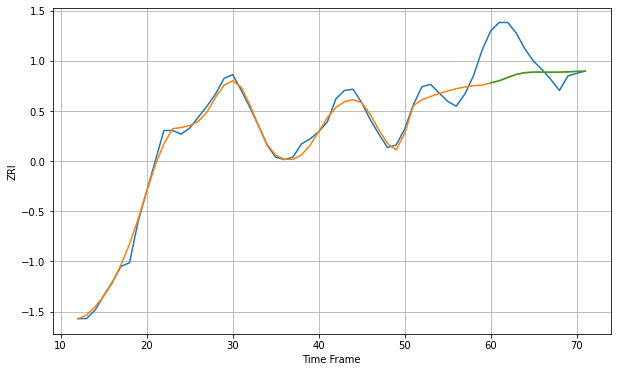

Wall time: 10.2 s
12203 7.0151533726324 25.92130944724947 25.918072648383166 [1271.20667875 1272.97425079 1275.71288552 1278.26280893 1279.67487854
 1280.11577308 1280.11100567 1280.0512332  1280.07647016 1280.3716498
 1280.67912024 1280.81779675]

Got an mse at 0.0049 in round 130 and stopped training

60 60 12


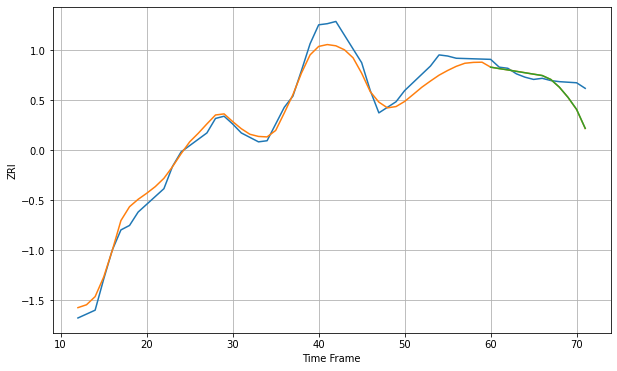

Wall time: 9.23 s
12206 9.308851809785407 13.505774122986404 13.4435254544338 [1230.00504759 1228.72563359 1227.54573898 1226.2609823  1224.99889799
 1223.73038016 1222.49843782 1218.96940532 1212.01196523 1202.93108996
 1192.10487353 1175.14699824]

Got an mse at 0.0050 in round 184 and stopped training

60 60 12


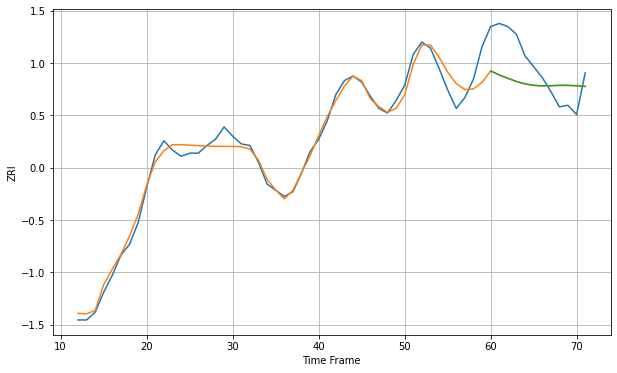

Wall time: 10.6 s
12208 6.084370899605174 21.01554788672851 21.01263226947816 [1268.27028594 1265.67734209 1263.47439324 1261.42757428 1259.86985606
 1258.93907707 1258.61325126 1258.67572955 1258.93424807 1258.89901862
 1258.68946106 1258.2026641 ]

Got an mse at 0.0049 in round 199 and stopped training

60 60 12


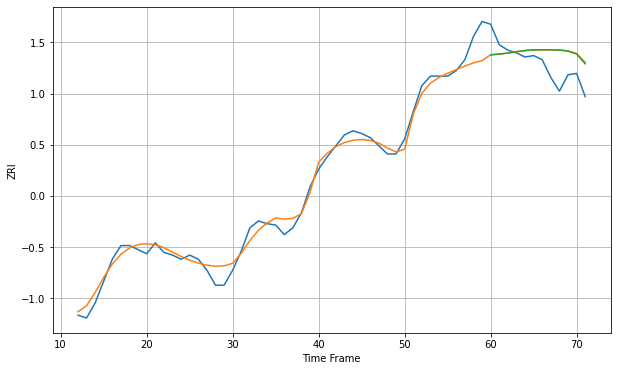

Wall time: 11.6 s
12209 7.371291214885078 16.0910925134818 15.911809294496276 [1172.61328088 1173.08850186 1173.87331625 1174.85510136 1175.72567837
 1176.16331441 1176.29001002 1176.26495174 1176.07375362 1175.31767214
 1173.1685875  1165.98918681]

Got an mse at 0.0049 in round 242 and stopped training

60 60 12


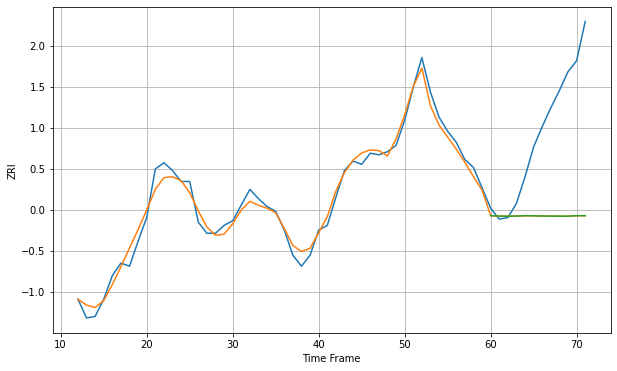

Wall time: 12.2 s
12210 5.375914709602213 64.96937877073721 64.96637513284978 [1036.200992   1035.94944075 1035.86936465 1035.9662517  1036.2071417
 1036.11196858 1035.97675346 1035.92242172 1035.91703919 1035.88281335
 1036.18284532 1036.19557063]

Got an mse at 0.0050 in round 215 and stopped training

60 60 12


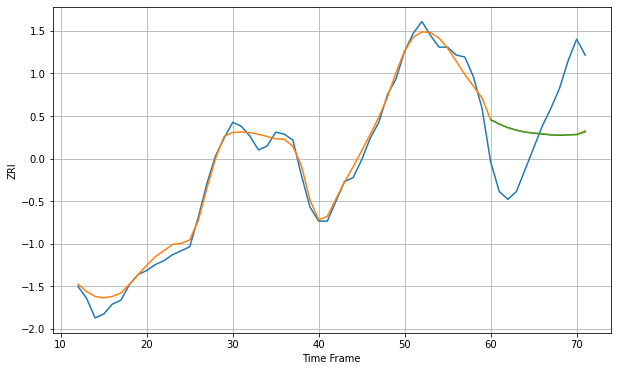

Wall time: 11.6 s
12303 4.0928787607540835 29.214235054124856 29.29977948044113 [1014.30803417 1012.10231923 1010.28774079 1008.98847065 1008.04600971
 1007.49838229 1007.08390411 1006.60624951 1006.39195341 1006.62382669
 1006.77322266 1008.09249224]

Got an mse at 0.0050 in round 175 and stopped training

60 60 12


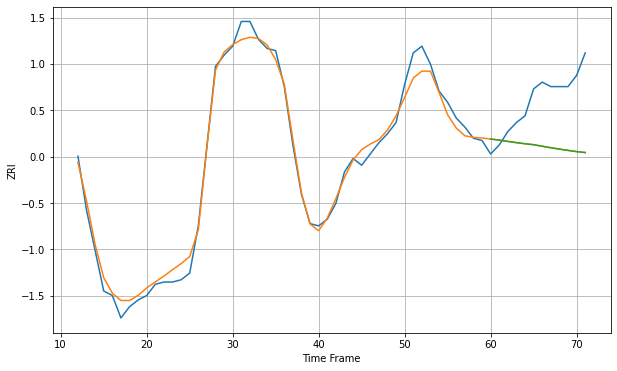

Wall time: 10.7 s
12304 4.332627707951332 24.44333283736331 24.461879369008642 [1022.66659191 1022.17824318 1021.6127165  1021.05574386 1020.55828734
 1020.14297084 1019.44797064 1018.77958699 1018.17439661 1017.58787885
 1017.04597314 1016.62725847]

Got an mse at 0.0050 in round 120 and stopped training

60 60 12


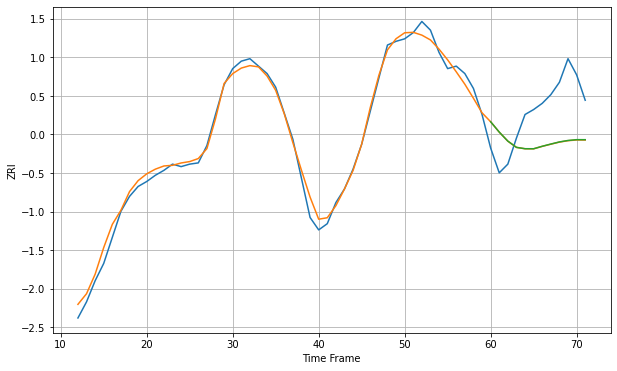

Wall time: 9.04 s
12306 5.759680160018323 37.60709272347573 37.49494972747256 [1058.16640809 1049.83545924 1042.57032226 1037.53108149 1036.43106808
 1036.40097538 1038.40154736 1040.18805436 1041.90209068 1043.07784032
 1043.72209105 1043.7050138 ]

Got an mse at 0.0050 in round 415 and stopped training

60 60 12


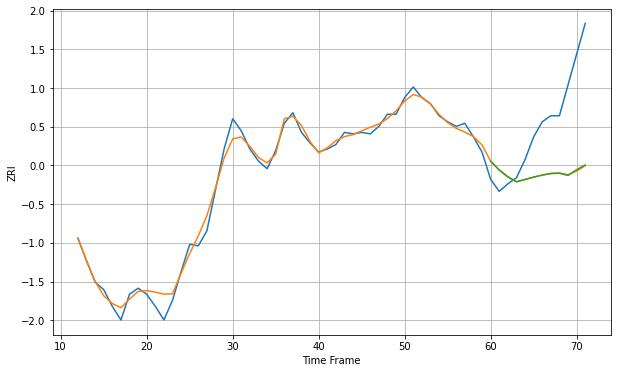

Wall time: 19.4 s
12307 4.830780345208651 44.458953067368164 44.29623519524497 [947.95211224 942.10271432 937.47481738 934.40602785 935.88968726
 937.46905717 938.788932   939.79864375 940.00010933 938.53617271
 942.35378879 945.40991712]

Got an mse at 0.0050 in round 376 and stopped training

60 60 12


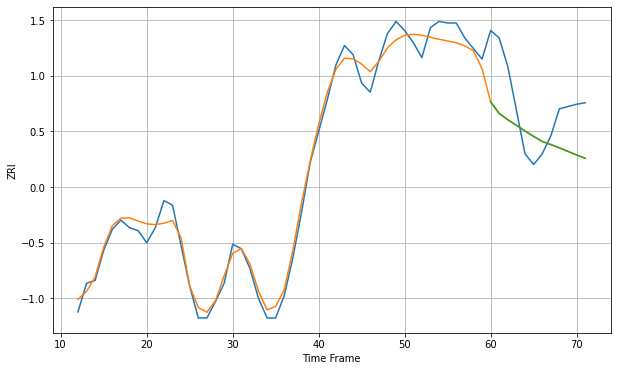

Wall time: 15.3 s
12401 7.342461899572157 30.081426855256446 30.060197950005076 [1394.59290791 1386.87588821 1382.70526529 1378.99041148 1375.24935357
 1371.62323662 1368.26262512 1366.22491265 1364.05638085 1361.66876119
 1359.32080055 1357.13044762]

Got an mse at 0.0050 in round 80 and stopped training

60 60 12


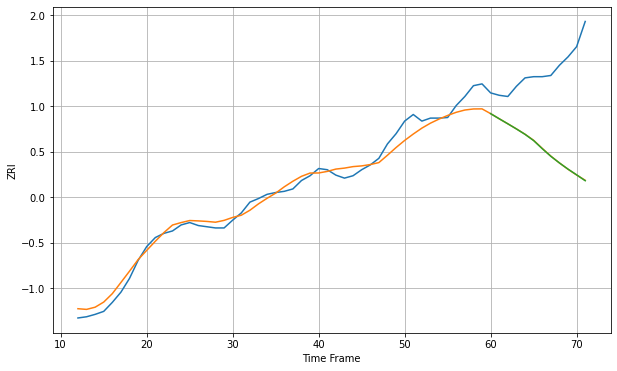

Wall time: 7.74 s
12508 14.761138769730636 141.2530490494379 141.40263791738877 [1548.42298504 1539.87454924 1531.49012067 1522.92941099 1513.96283637
 1503.57352228 1490.12089629 1477.39422656 1466.28651213 1455.98494641
 1446.47185714 1436.70007677]

Got an mse at 0.0050 in round 139 and stopped training

60 60 12


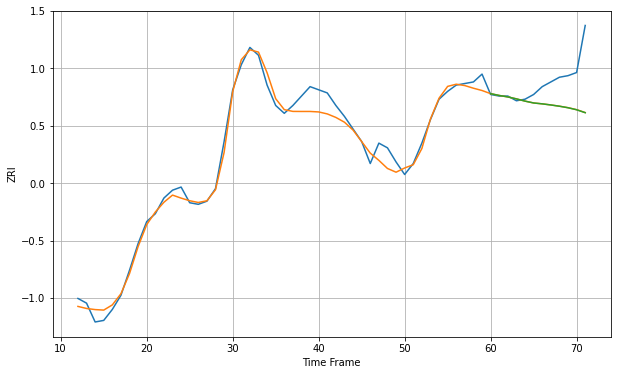

Wall time: 9.44 s
12550 6.032629557365216 19.932400660798184 19.962774089815866 [1402.52560086 1401.38163983 1400.44644523 1399.20652962 1397.77675802
 1396.599023   1396.03264102 1395.32823251 1394.52227443 1393.55314159
 1392.26992223 1390.40200903]

Got an mse at 0.0049 in round 97 and stopped training

60 60 12


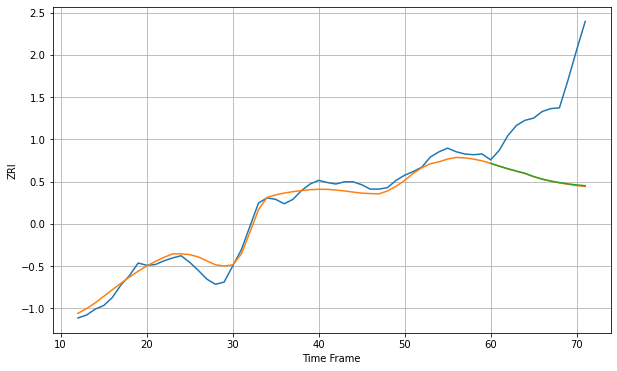

Wall time: 8.34 s
12590 10.473651893165973 112.66692554608069 112.24030228714044 [1485.16418321 1481.33645281 1477.79711084 1474.57004216 1471.51167313
 1467.17373469 1463.741521   1461.0377402  1458.95332683 1457.18128804
 1455.6960847  1454.68954433]

Got an mse at 0.0049 in round 193 and stopped training

60 60 12


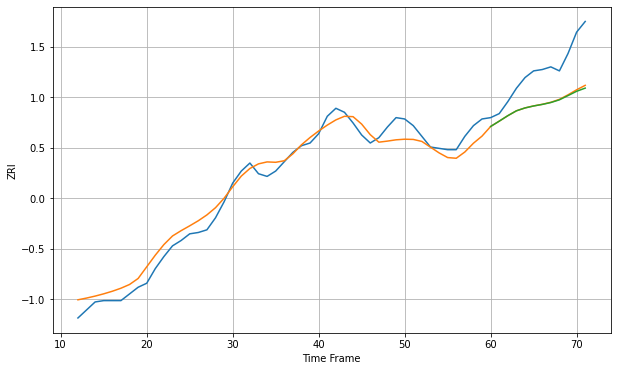

Wall time: 11.1 s
12601 8.072062980588226 26.79792602326876 27.36652866332932 [1240.36578135 1244.36545772 1248.45875643 1252.11358981 1254.25460458
 1255.72793106 1256.8807852  1258.3018439  1260.3314714  1263.50179591
 1266.7157975  1269.10249525]

Got an mse at 0.0050 in round 106 and stopped training

60 60 12


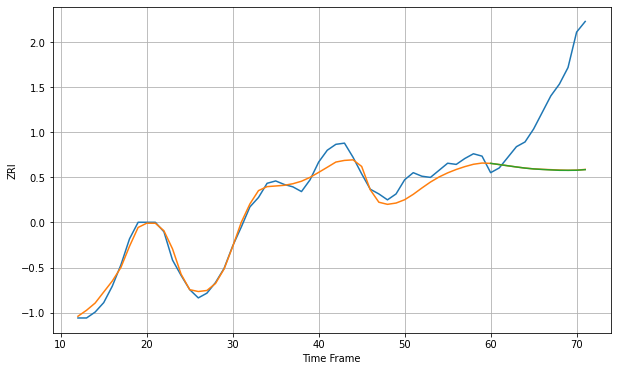

Wall time: 8.54 s
12603 7.173680680184157 64.8549935201645 64.94603575227754 [1397.88146704 1396.87527841 1395.84911712 1394.82734194 1393.87635226
 1393.17399037 1392.72041184 1392.34241957 1392.01599611 1391.98052413
 1392.06021754 1392.56109775]

Got an mse at 0.0050 in round 238 and stopped training

60 60 12


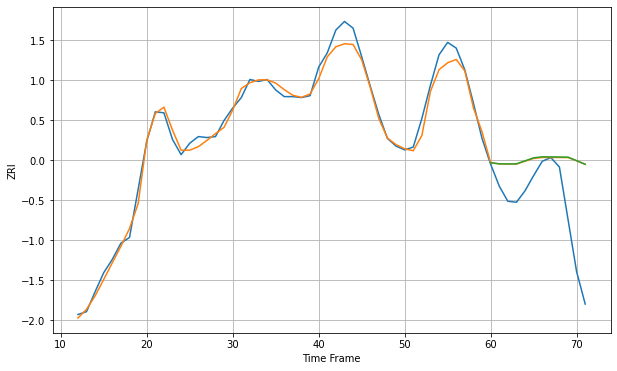

Wall time: 12 s
12866 8.774473184798158 60.90686749305334 60.98871466474806 [1685.54383414 1684.35235318 1684.2222191  1684.36136094 1687.50302484
 1690.69545896 1691.74656862 1691.68797348 1691.53215281 1691.37946176
 1687.66226886 1683.8328738 ]
60 60 12


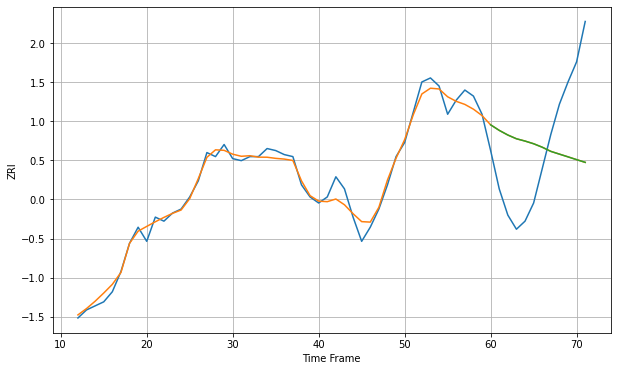

Wall time: 18.9 s
13203 3.8971886247197247 37.014878271821395 37.010895721254535 [898.75985314 896.00413317 893.70220674 891.8505315  890.70897753
 889.37312474 887.65787569 885.59039294 884.2284802  882.87522536
 881.49514526 880.16236932]

Got an mse at 0.0050 in round 140 and stopped training

60 60 12


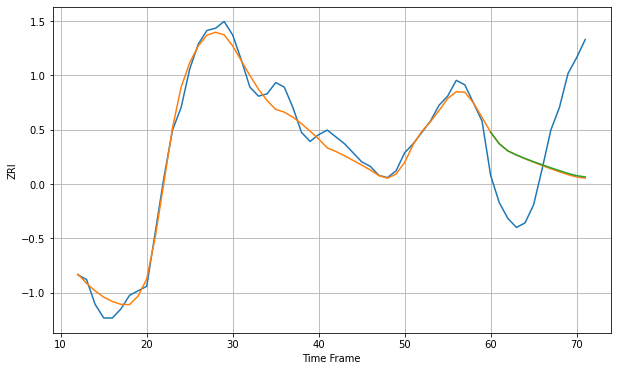

Wall time: 10.7 s
13204 4.461004747502431 33.828705971189606 33.57773834364086 [898.05557573 892.97335733 889.81682643 888.03241539 886.47391376
 885.04055305 883.678296   882.35329982 881.11216924 879.87298359
 878.86925864 878.32916261]

Got an mse at 0.0049 in round 348 and stopped training

60 60 12


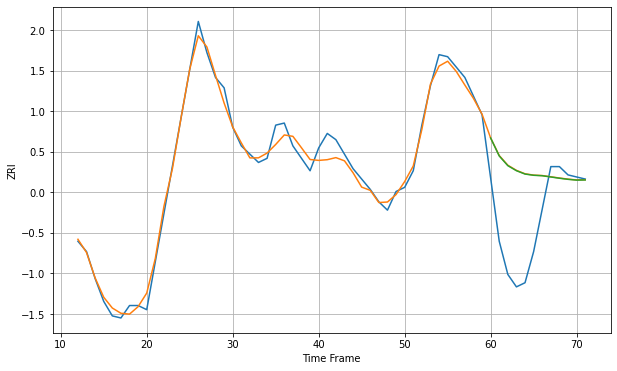

Wall time: 15.6 s
13205 4.1713478111947495 32.22063254264249 32.11944264878794 [922.81090413 914.13407398 909.45443713 907.02560217 905.4051747
 904.81843791 904.60085837 903.99837376 903.39353748 902.86394865
 902.48035541 902.56878009]

Got an mse at 0.0050 in round 266 and stopped training

60 60 12


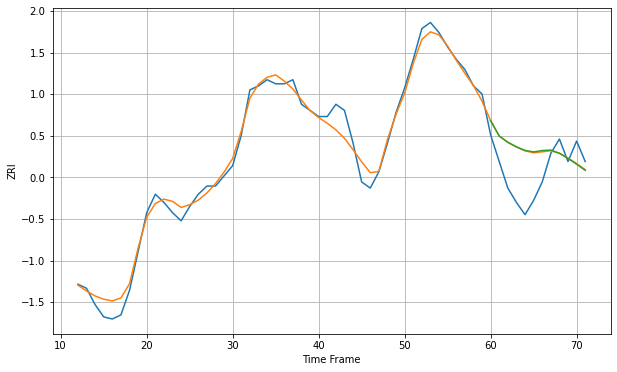

Wall time: 12.9 s
13206 4.69814019434715 16.747105868726226 16.899974195413787 [889.99204054 882.46820554 879.39109219 877.16000637 875.4081738
 874.69887366 875.36403205 875.60102716 874.03028887 871.4982815
 868.70074413 865.67378558]

Got an mse at 0.0047 in round 309 and stopped training

60 60 12


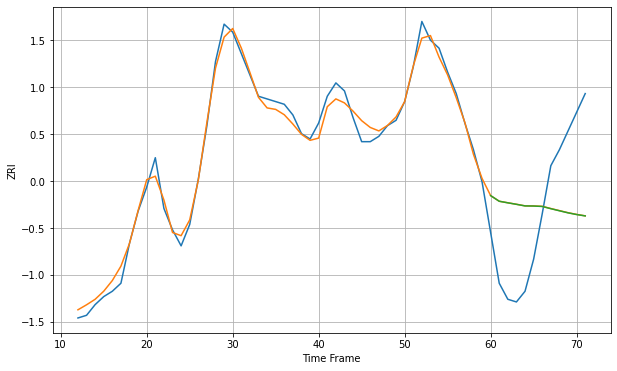

Wall time: 14.4 s
13208 3.309498561103717 29.541086693963635 29.551471627952637 [871.8117475  869.68996016 869.10541202 868.54501296 867.94475873
 867.90572973 867.7432227  866.91047712 866.13012146 865.35624927
 864.72062516 864.20467397]

Got an mse at 0.0049 in round 396 and stopped training

60 60 12


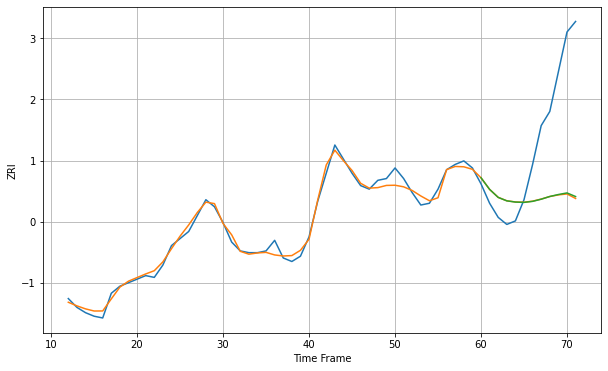

Wall time: 16.8 s
13440 3.0864199081433488 48.5846294251662 48.28459909576358 [745.4372851  738.85708723 734.31183803 732.36069463 731.66916717
 731.48742137 732.07316287 733.29343189 734.83823692 735.94802005
 736.85179567 734.81180675]

Got an mse at 0.0049 in round 332 and stopped training

60 60 12


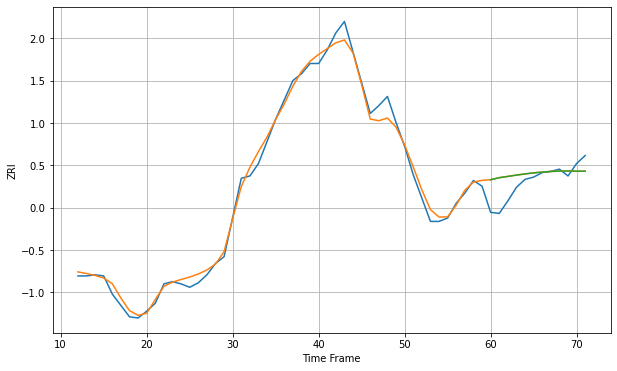

Wall time: 14.1 s
13501 6.345008096039275 14.981685562313789 14.977006385845742 [838.66937131 840.50072137 841.60167384 842.76810981 843.7878336
 844.7243858  845.40434633 845.97241067 846.2642223  846.38415056
 846.21834961 846.22565049]
60 60 12


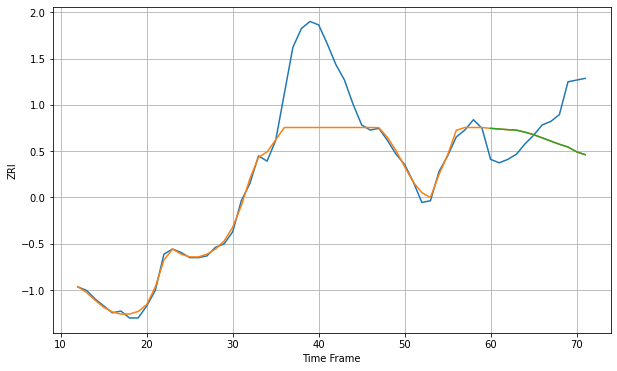

Wall time: 19.2 s
13502 19.360070832959153 23.916633699312523 23.88891808128027 [823.00647181 822.61412451 822.2318716  821.94828564 820.78026547
 819.32911861 817.47061056 815.60612047 813.76381659 812.17991705
 809.39083618 807.76917154]

Got an mse at 0.0050 in round 454 and stopped training

60 60 12


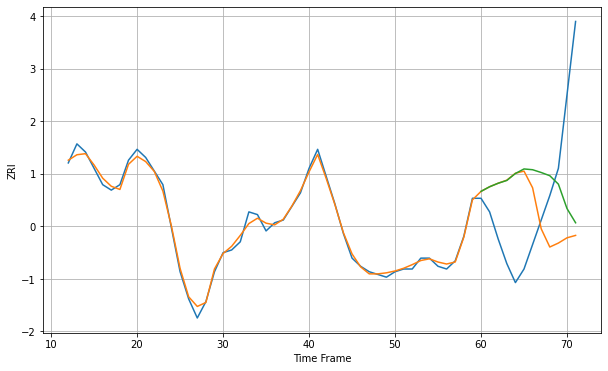

Wall time: 18.4 s
13601 1.6247004384652788 35.19935087582391 32.63186413196516 [852.53742917 854.24122188 855.52920585 856.5538791  859.10957425
 860.78160729 860.49734105 859.47589094 858.29978262 855.19183844
 846.23114523 840.99728231]
60 60 12


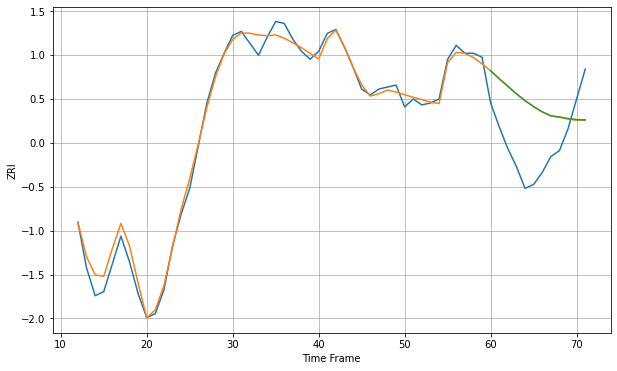

Wall time: 21.1 s
13760 4.139334815382225 27.50231941320057 27.51683999675826 [888.17988744 884.19635585 880.42576406 876.59026235 873.19218222
 870.1801498  867.53485839 865.55157917 864.96574619 864.14432776
 863.64135614 863.54299278]

Got an mse at 0.0050 in round 268 and stopped training

60 60 12


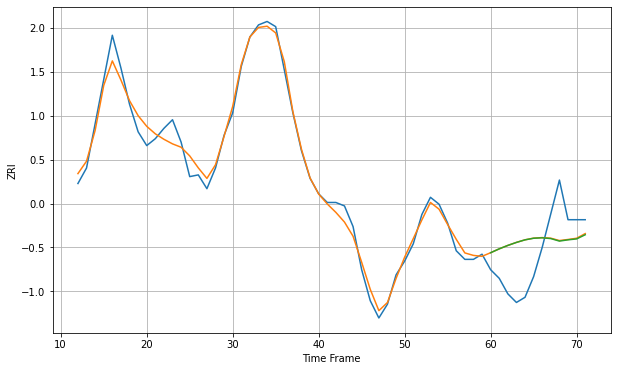

Wall time: 12.9 s
13903 5.44437020851016 21.945348527948617 22.032847275520616 [835.8554092  838.09977468 840.08416996 841.83178641 843.31463225
 844.25122135 844.50811373 844.06324136 842.59169823 843.33130409
 843.86145945 846.27436518]

Got an mse at 0.0050 in round 392 and stopped training

60 60 12


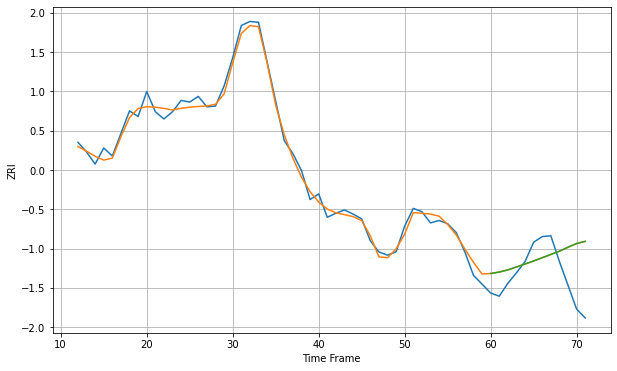

Wall time: 15.8 s
14020 7.952237677664268 42.483769145485624 42.49857083201679 [1223.21661243 1224.97440803 1227.66101057 1231.26215141 1234.9794515
 1238.71364553 1242.80114725 1246.84491981 1250.93298314 1255.8411743
 1260.43813727 1263.09873828]

Got an mse at 0.0049 in round 241 and stopped training

60 60 12


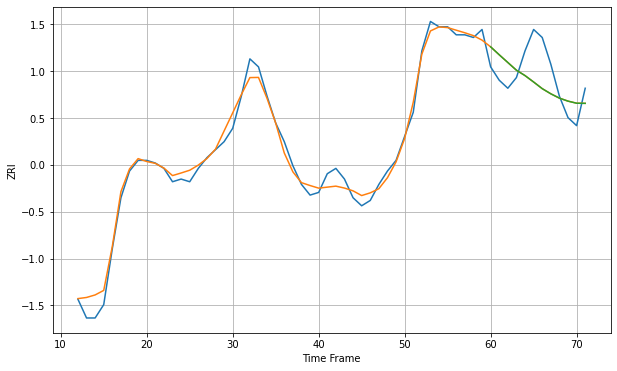

Wall time: 12.2 s
14043 3.299462634457873 10.607606614583373 10.609044057430502 [964.50160839 961.52502632 958.63548003 955.74952913 953.73500973
 951.33159027 948.84993788 946.91793035 945.29330997 944.17192833
 943.39413588 943.3482756 ]
60 60 12


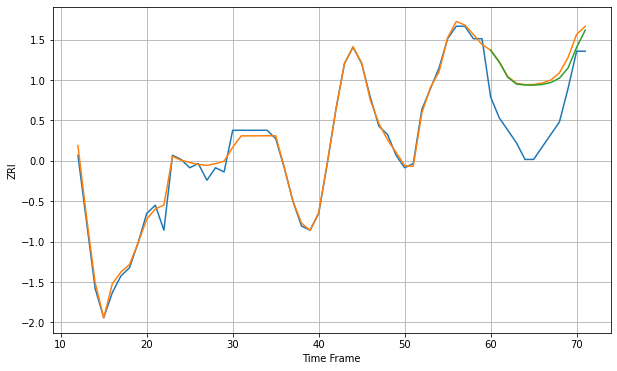

Wall time: 18.9 s
14150 1.519417784158833 12.837370727273619 12.408582897083265 [895.26245256 892.38448925 888.73874618 887.10445058 886.88406116
 886.84478609 887.00512274 887.46819977 888.52688188 890.93888182
 895.91994257 900.05338947]

Got an mse at 0.0050 in round 178 and stopped training

60 60 12


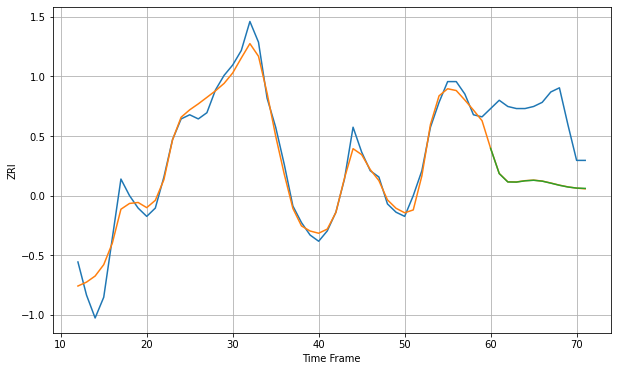

Wall time: 10.7 s
14201 5.993908052119906 33.52748953213855 33.5705664282629 [920.78679983 908.63551493 904.59007074 904.53425723 905.14374155
 905.41640565 904.98212005 904.02675632 902.9981768  902.1650599
 901.63672463 901.49181796]
60 60 12


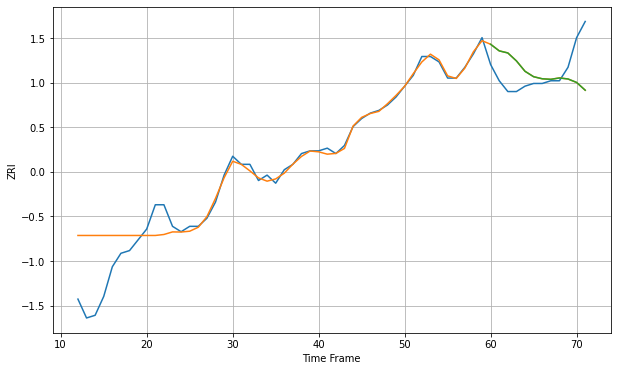

Wall time: 18.7 s
14206 8.415289412053715 11.187547165021586 11.180419314144144 [815.53475284 813.08564089 812.31698949 809.3616429  805.50931362
 803.50114795 802.73431784 802.52893984 803.02951833 802.66774017
 801.37742021 798.49980774]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


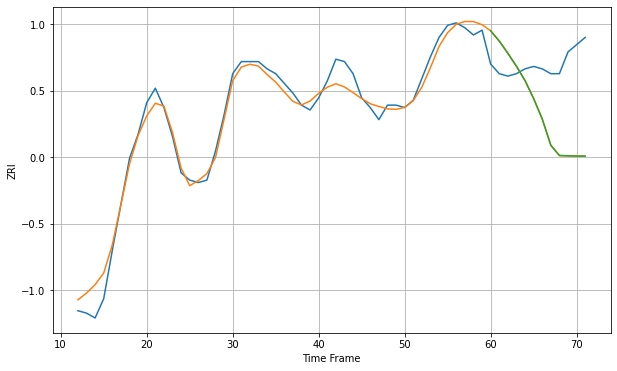

Wall time: 9.73 s
14207 4.555772260685725 28.11779804977075 28.138624660164034 [826.73769627 822.50412205 817.46101344 812.07869938 806.1232472
 798.69900174 790.23049707 779.37676602 775.16331198 775.04142401
 774.93696683 774.91293094]

Got an mse at 0.0049 in round 107 and stopped training

60 60 12


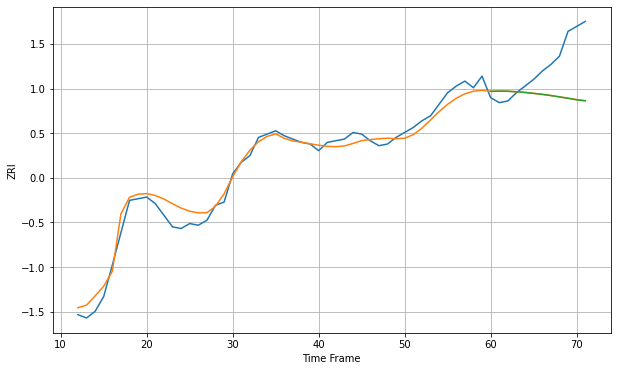

Wall time: 9.71 s
14208 5.537379777566995 24.47968661302094 24.52641326864291 [807.82185953 807.95287123 807.85210222 807.5670642  807.15269825
 806.58502143 806.00285713 805.28163408 804.46186141 803.62591527
 802.72699159 802.07480183]
60 60 12


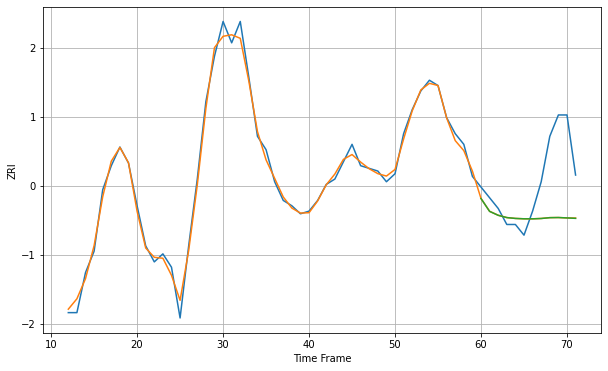

Wall time: 23.1 s
14209 2.4579394275542983 19.24255164994332 19.251506325084016 [1036.71610731 1031.90024778 1030.43370414 1029.58352937 1029.26387574
 1029.12805639 1029.11762528 1029.23945229 1029.55150618 1029.60480457
 1029.45848324 1029.29083734]

Got an mse at 0.0050 in round 152 and stopped training

60 60 12


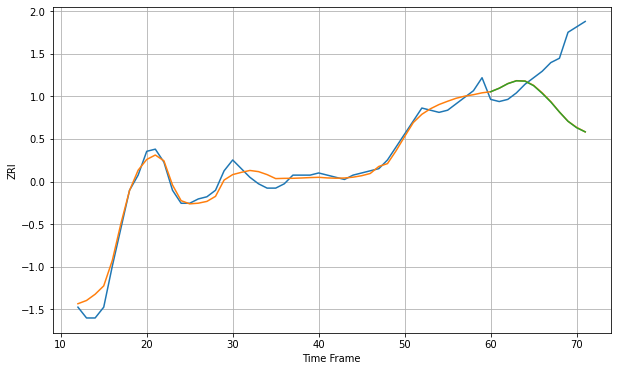

Wall time: 9.48 s
14210 3.6575056256831577 25.228584791583145 25.276514453409384 [791.53324819 793.15360156 795.27464757 796.58600551 796.41773498
 794.32778658 790.78514916 786.7951575  782.16062189 777.87533553
 774.91037634 772.98753851]

Got an mse at 0.0050 in round 82 and stopped training

60 60 12


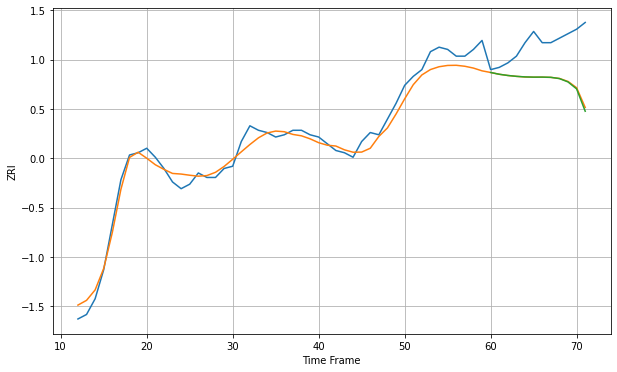

Wall time: 8.37 s
14211 4.636401585097874 18.55315222931279 18.914971392633447 [782.73333177 781.94396893 781.40390375 781.0190191  780.76339575
 780.66865594 780.68322975 780.57129594 780.01748739 778.52181695
 775.42606437 765.48579438]

Got an mse at 0.0049 in round 94 and stopped training

60 60 12


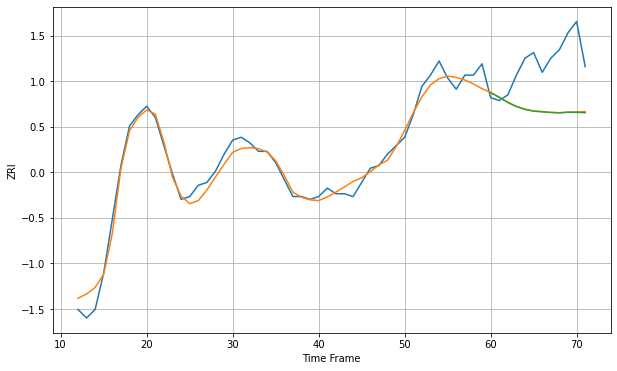

Wall time: 7.89 s
14212 3.3085155049463424 18.311407274840416 18.37269091529232 [775.82693591 774.1453108  772.36162526 770.87636147 769.89438371
 769.25956819 769.02702184 768.77560516 768.65846672 768.848336
 768.83154962 768.68884901]
60 60 12


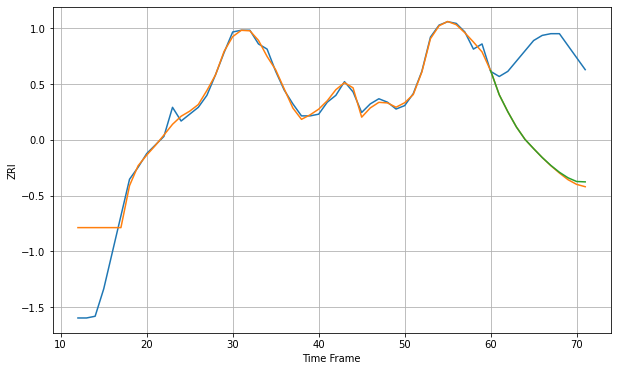

Wall time: 19.5 s
14213 14.468070979159965 59.676760365353 59.042485687379255 [865.40989645 851.3616039  841.41199441 832.49832397 825.26231817
 819.87600484 814.71041037 810.09173257 806.08415881 802.85424016
 800.69238907 800.46894665]

Got an mse at 0.0047 in round 107 and stopped training

60 60 12


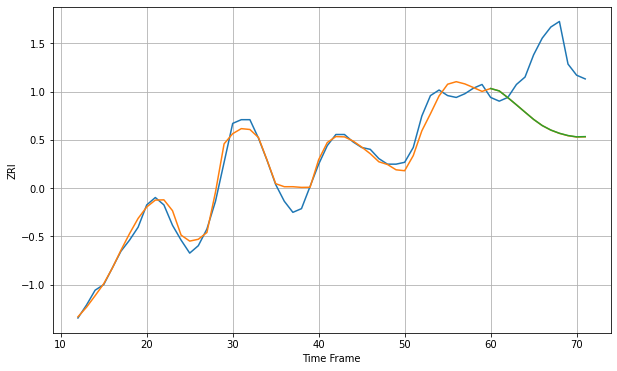

Wall time: 8.93 s
14214 4.930569261638452 34.5145926320288 34.47866541146582 [924.820439   923.51780455 919.89647008 916.02033192 912.06145833
 908.15380146 904.8415561  902.40677671 900.66578981 899.43248663
 898.74003948 898.85922942]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


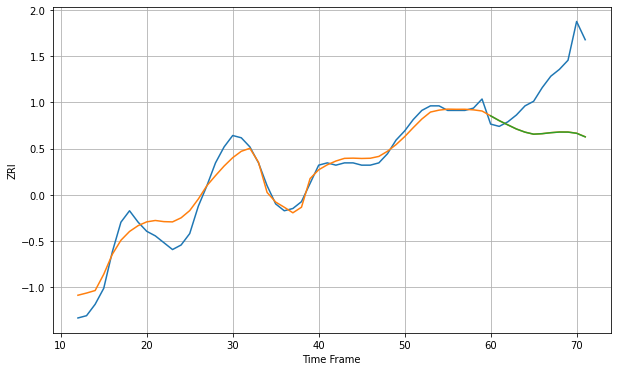

Wall time: 9.36 s
14215 5.297325893694374 24.788719531178934 24.81148263664852 [777.62625188 775.51461142 773.66059874 771.85339393 770.47139601
 769.57812574 769.80434378 770.22831665 770.51622524 770.49723203
 769.97298901 768.4037766 ]

Got an mse at 0.0049 in round 107 and stopped training

60 60 12


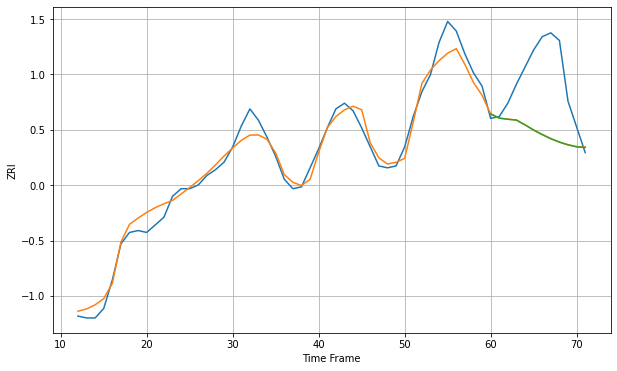

Wall time: 8.39 s
14216 5.739479739821615 32.10169554315125 32.13832635838368 [1028.37643029 1026.16024664 1025.55623591 1025.13155347 1022.59129548
 1019.85702056 1017.48195297 1015.31844989 1013.49640897 1012.07435534
 1011.01738272 1010.72530737]

Got an mse at 0.0050 in round 235 and stopped training

60 60 12


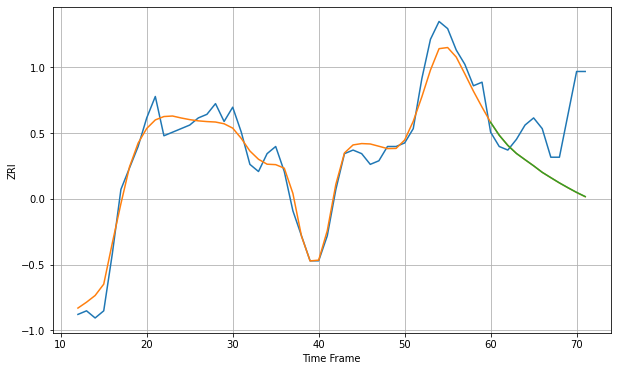

Wall time: 12.8 s
14217 3.8561694028484252 16.685911649435468 16.673499448071105 [886.74714035 883.1522621  880.30770191 878.054587   876.30942259
 874.59638438 872.77215011 871.28105237 869.81106176 868.45546564
 867.15151329 865.98518247]

Got an mse at 0.0049 in round 120 and stopped training

60 60 12


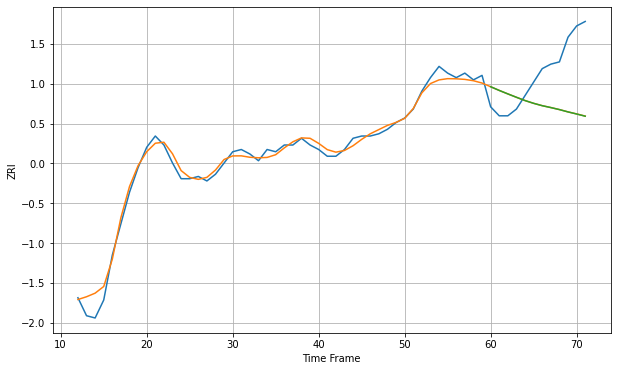

Wall time: 8.6 s
14218 3.0830727528544197 22.236111658086887 22.25396011566476 [823.94847731 822.29950603 820.75140225 819.24835124 817.78728979
 816.55583952 815.50639049 814.66846533 813.7679951  812.73168094
 811.80686165 810.82229321]

Got an mse at 0.0049 in round 285 and stopped training

60 60 12


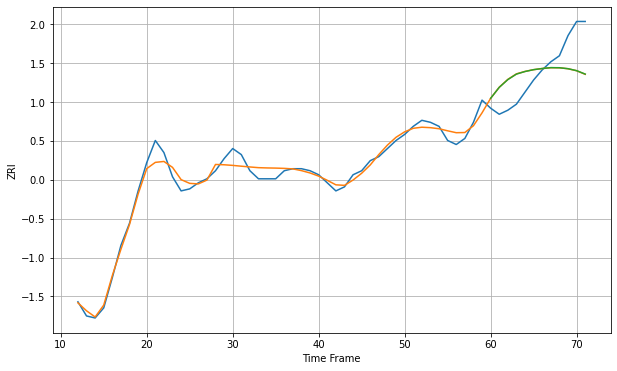

Wall time: 17.9 s
14220 3.5426784110149923 14.119291626290305 14.063270106643364 [812.89923531 818.33116776 822.1760184  824.89998322 826.19442167
 827.10509591 827.68425451 828.1087953  828.06188782 827.58327428
 826.60865105 824.9090102 ]

Got an mse at 0.0047 in round 245 and stopped training

60 60 12


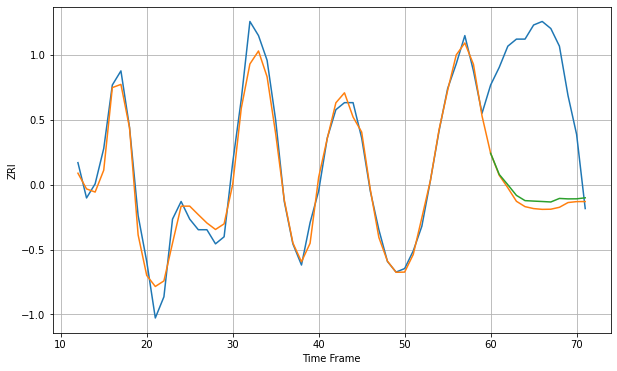

Wall time: 13.1 s
14221 3.7840772143660213 39.59081215703801 38.13643911511241 [1126.64933487 1120.66595114 1117.74776921 1114.72995518 1113.24547802
 1113.1116475  1112.99541262 1112.86067315 1113.86551329 1113.73740996
 1113.75552205 1114.04452627]

Got an mse at 0.0049 in round 153 and stopped training

60 60 12


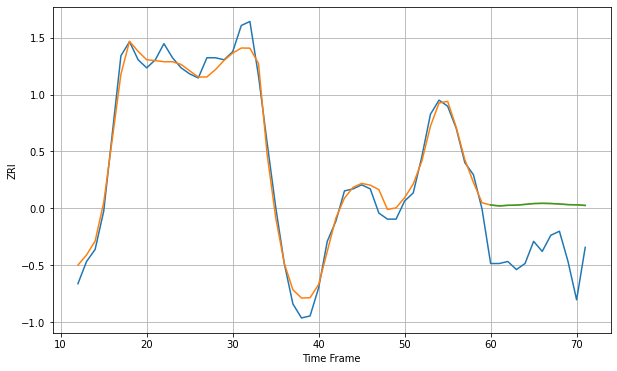

Wall time: 10.2 s
14222 5.45567501002138 27.544560113692285 27.551369779546572 [1087.00443879 1086.56555135 1086.84502212 1086.94927101 1087.30773201
 1087.71927009 1087.83451392 1087.75062317 1087.52052788 1087.19968279
 1087.10775031 1086.80622545]

Got an mse at 0.0050 in round 368 and stopped training

60 60 12


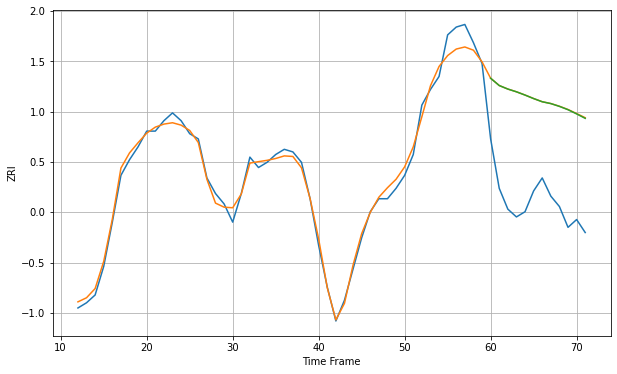

Wall time: 16 s
14224 3.0733030670957655 39.89726580201582 39.847510651874146 [972.32288429 969.52048967 968.16487996 967.10848629 965.8579915
 964.51007425 963.2853535  962.58510694 961.50846777 960.2272242
 958.61540286 956.90090253]

Got an mse at 0.0048 in round 331 and stopped training

60 60 12


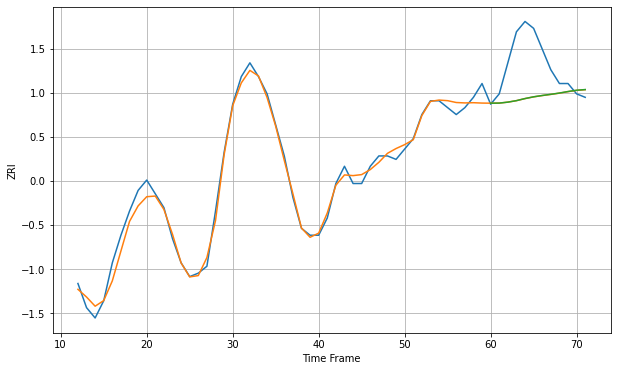

Wall time: 14.8 s
14225 2.259882738462787 11.846532078578429 11.836009749073622 [859.29869831 859.32510772 859.60158127 860.0351209  860.64225181
 861.14793922 861.53170914 861.8725443  862.24086963 862.68252537
 863.05383636 863.25080877]

Got an mse at 0.0050 in round 439 and stopped training

60 60 12


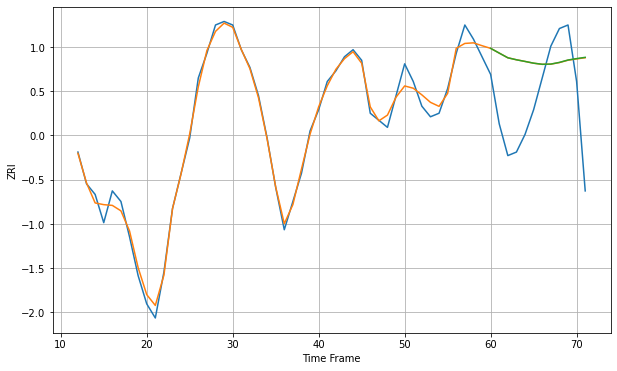

Wall time: 19.2 s
14228 2.2257411143660466 18.721574404295115 18.739616385015125 [1100.38558456 1099.0396678  1097.71174631 1097.14740297 1096.67686413
 1096.1836045  1095.86875366 1095.92718371 1096.40264363 1097.08195144
 1097.47865628 1097.83946583]

Got an mse at 0.0050 in round 272 and stopped training

60 60 12


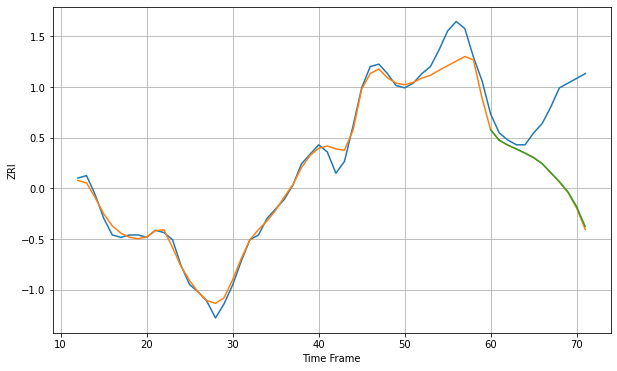

Wall time: 13.7 s
14301 4.677365530137442 31.939657154977525 31.600992353225887 [633.36397515 628.90624382 626.88462948 625.23376864 623.4872978
 621.61537193 619.02909209 615.24373227 611.40962958 607.13334114
 600.97978965 592.54585   ]

Got an mse at 0.0049 in round 271 and stopped training

60 60 12


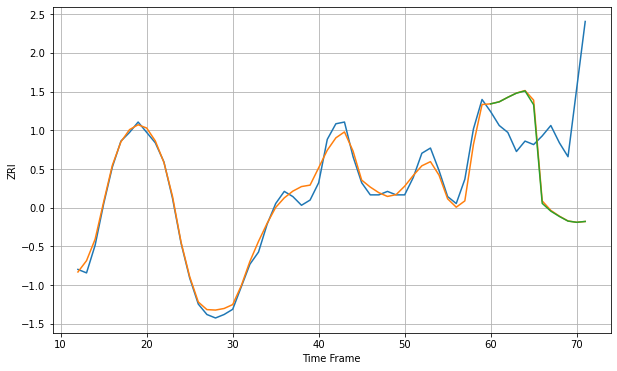

Wall time: 13.2 s
14607 4.664405998214178 49.52543999849671 49.543579441966905 [1083.47858878 1084.66001223 1087.26356312 1089.64857551 1090.95852487
 1082.96006712 1026.09595648 1021.60180489 1018.53524263 1015.87317442
 1015.17872801 1015.66279396]
60 60 12


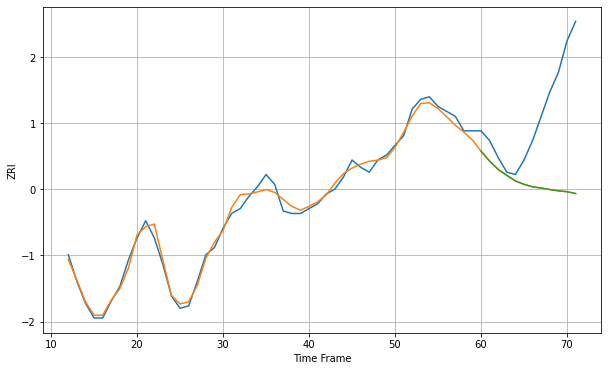

Wall time: 21.1 s
14609 2.4987243663658885 34.58600567096004 34.5828472592484 [823.62264405 819.5408468  816.11019226 813.68878046 811.39652478
 809.97511472 808.98066705 808.46392904 807.87088905 807.31615916
 806.96335668 806.19099582]

Got an mse at 0.0049 in round 453 and stopped training

60 60 12


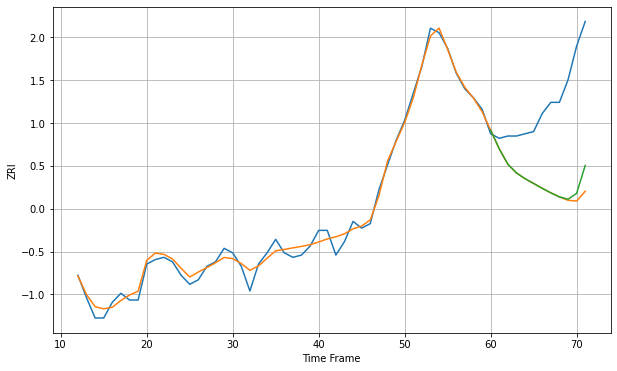

Wall time: 18.3 s
14611 3.1370507118458715 40.03513933316389 37.76813027623356 [869.62978966 861.32070302 854.45212548 850.56353686 848.01783591
 845.87606273 843.72579217 841.70552583 839.93838749 838.84560404
 841.47834454 853.87087899]

Got an mse at 0.0050 in round 229 and stopped training

60 60 12


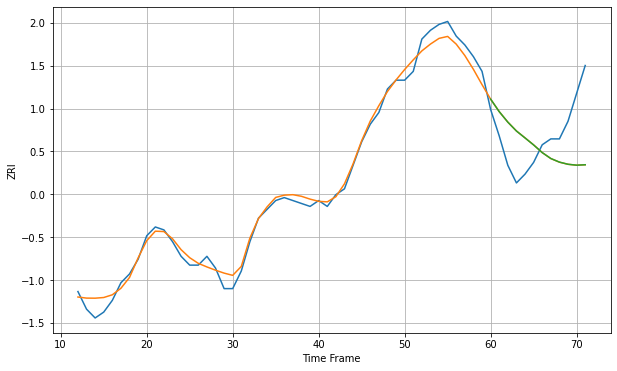

Wall time: 12.4 s
14613 2.842492165510123 15.465383967279173 15.457240583252222 [763.53843912 759.27963145 755.70757272 752.68450481 750.32307515
 747.93810991 745.3347398  743.31730536 742.08921679 741.35668226
 741.04782675 741.18889515]

Got an mse at 0.0050 in round 225 and stopped training

60 60 12


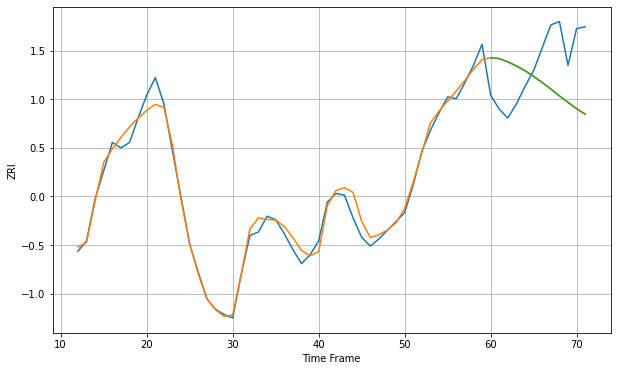

Wall time: 10.9 s
14620 5.02734069095772 30.85019464813734 30.844944342585464 [1096.33147396 1095.85185891 1093.97692228 1091.66760406 1088.93573033
 1085.73163723 1082.16323053 1078.48460314 1074.57353574 1070.86442816
 1067.28975781 1064.16113646]

Got an mse at 0.0050 in round 284 and stopped training

60 60 12


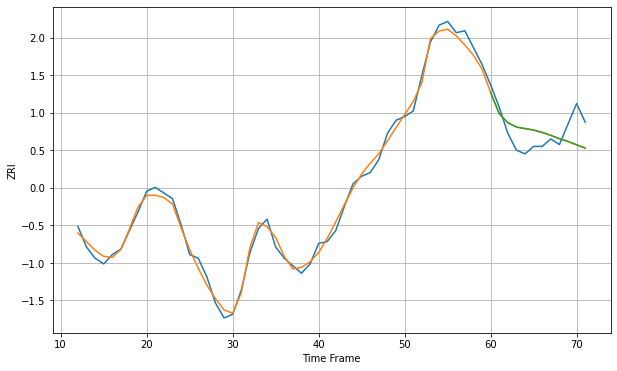

Wall time: 12.2 s
14621 3.358694552444427 10.470828707839347 10.472610360602987 [814.88395045 803.55972138 798.70863593 796.38345272 795.56697661
 794.76367986 793.48531914 791.93476228 790.11062242 788.65997062
 786.83781883 785.11913672]

Got an mse at 0.0050 in round 311 and stopped training

60 60 12


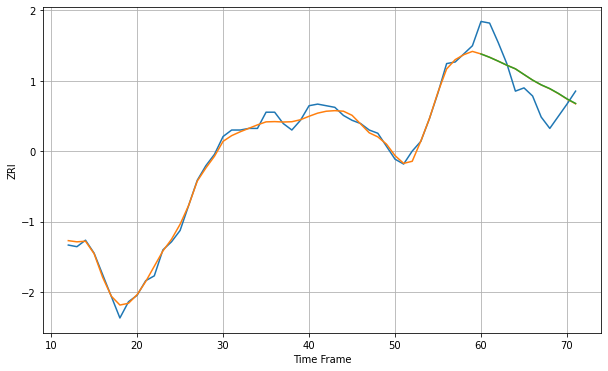

Wall time: 14.1 s
14701 3.062189762395618 14.697549865657043 14.718738928506424 [666.94605207 664.8895402  662.50953535 660.01702074 657.7669654
 654.27238918 650.8228592  647.89158532 645.54390097 642.57944849
 639.23104843 636.40481506]

Got an mse at 0.0048 in round 364 and stopped training

60 60 12


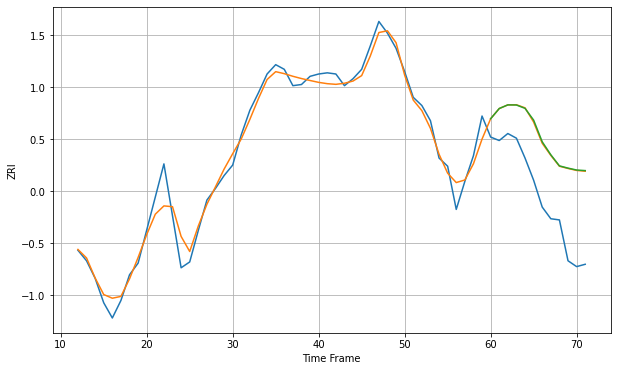

Wall time: 15.1 s
14850 9.944246636349625 53.37823926727213 53.79860401000952 [1560.65659629 1569.42136764 1572.53723346 1572.44119234 1569.56364362
 1559.50027731 1540.92875351 1529.7991421  1520.29628889 1518.36535855
 1516.74648818 1516.24548766]

Got an mse at 0.0050 in round 85 and stopped training

60 60 12


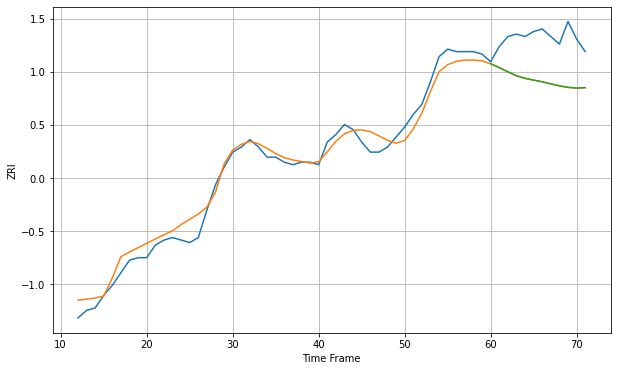

Wall time: 7.84 s
15202 4.21447593903465 17.183383072096046 17.17181382139683 [832.16772847 830.66177337 828.97743373 827.37376482 826.36809296
 825.66259818 824.99717187 824.17104862 823.37195206 822.78124169
 822.49312292 822.69844906]

Got an mse at 0.0050 in round 136 and stopped training

60 60 12


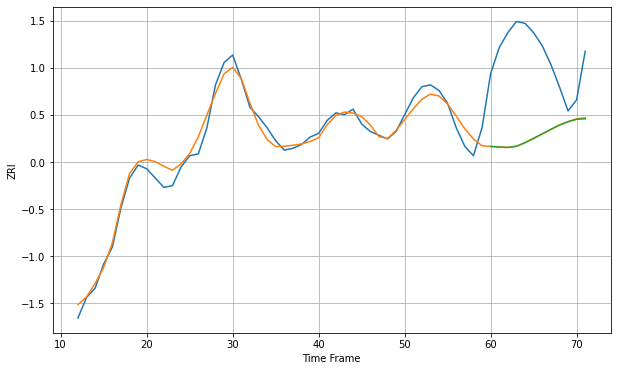

Wall time: 16.2 s
15206 4.941087443346865 45.84927593354612 45.888109589123864 [1054.99097755 1054.68668688 1054.45734836 1055.06438003 1057.00417044
 1059.30713831 1061.72318809 1064.10814325 1066.42639696 1068.20348727
 1069.54030447 1069.82858133]

Got an mse at 0.0049 in round 301 and stopped training

60 60 12


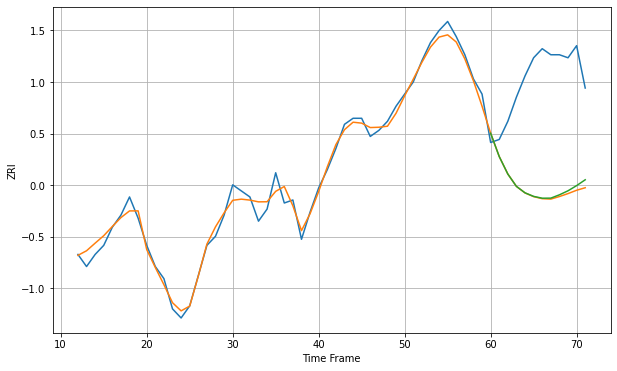

Wall time: 15.8 s
15210 2.6797874918697957 37.78473148414632 37.226796851467796 [865.05809877 857.35388571 851.57132405 847.4897128  845.36328603
 844.18800716 843.58515519 843.60924241 844.70719196 846.03565377
 847.7466091  849.67414728]

Got an mse at 0.0049 in round 133 and stopped training

60 60 12


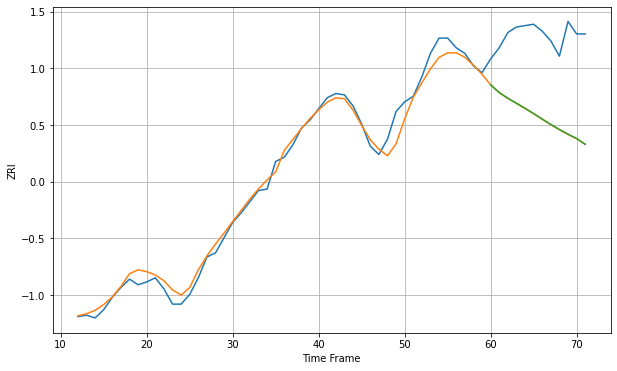

Wall time: 9.23 s
15212 6.561081877391845 60.323642762497016 60.21178507151581 [944.23539935 938.70546514 934.58696187 930.9886141  927.36011392
 923.54189387 919.57865017 915.70171328 912.06671998 908.6920679
 905.54762323 901.24835309]

Got an mse at 0.0050 in round 133 and stopped training

60 60 12


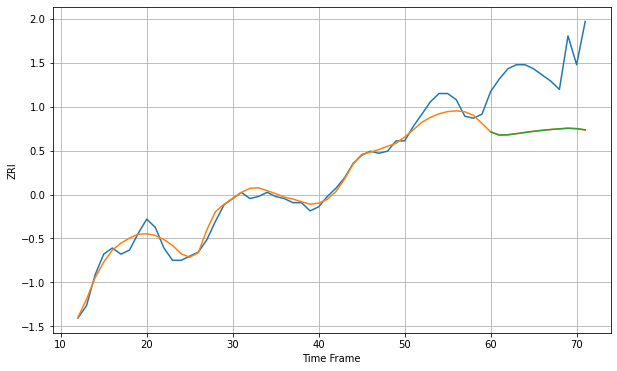

Wall time: 11.1 s
15216 3.729060603399504 32.494020911890665 32.479490288869435 [892.38116657 890.81547655 890.95877331 891.50282158 892.10262797
 892.65259054 893.12418087 893.52571383 893.85244595 894.13998742
 893.96756476 893.39017526]

Got an mse at 0.0049 in round 425 and stopped training

60 60 12


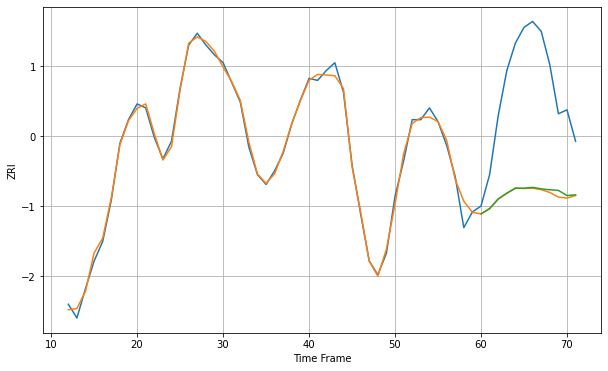

Wall time: 17.1 s
15217 2.957799852504455 58.2702312311418 57.736340140422385 [1179.96865756 1182.69958473 1187.59612735 1190.52471191 1193.10776048
 1193.08098294 1193.49588072 1192.76396331 1192.26745634 1191.97383065
 1189.36560933 1189.67568291]

Got an mse at 0.0049 in round 182 and stopped training

60 60 12


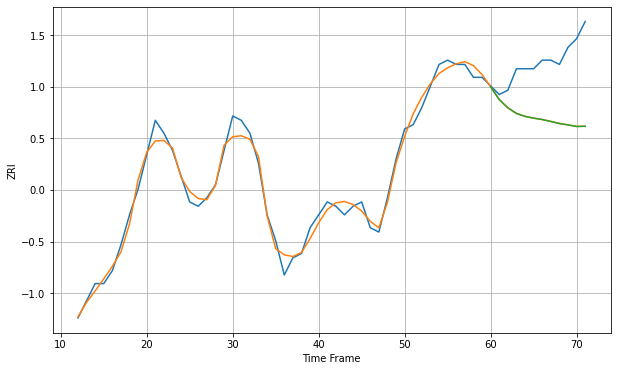

Wall time: 10.8 s
15221 1.9647736727456548 13.850964033745912 13.855394406354048 [897.79581693 894.82538199 892.906908   891.60276194 890.91304531
 890.49947101 890.18011461 889.73240701 889.25254649 888.93277468
 888.56761008 888.61249848]
60 60 12


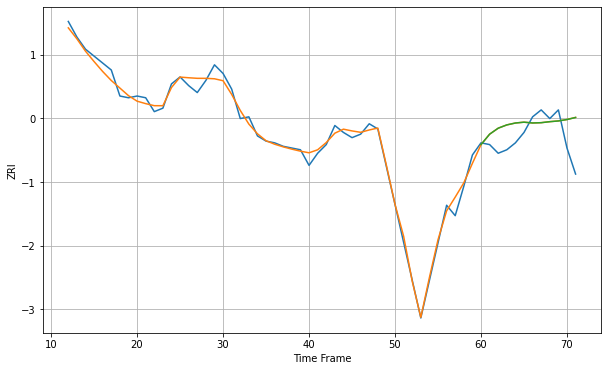

Wall time: 19.1 s
16365 3.689127017879391 13.122415813432966 13.112527759777018 [854.98071241 860.9894506  864.45597417 866.3406183  867.43951124
 867.91687543 867.45475825 867.62482647 868.20715912 868.6257877
 869.44139837 870.63006935]
60 60 12


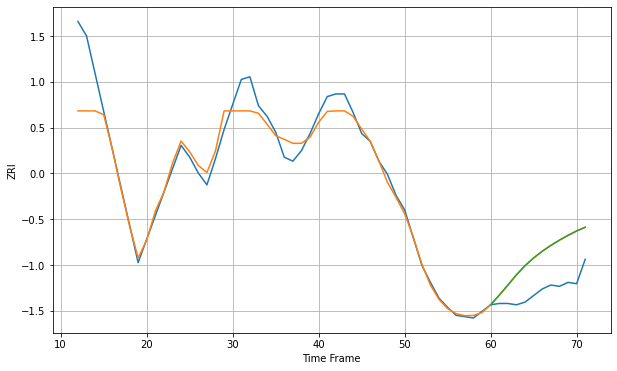

Wall time: 18 s
16502 15.404591793875946 27.02928804710336 26.988348866336352 [647.03611787 654.25921996 661.87783886 669.71228062 676.69050531
 682.52199633 687.59453942 692.01608595 696.02540069 699.67577738
 703.02053108 705.84679242]

Got an mse at 0.0049 in round 179 and stopped training

60 60 12


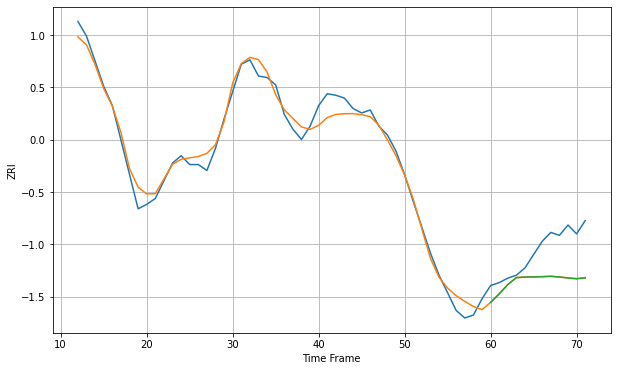

Wall time: 10 s
16503 6.692747404578212 23.158910662396547 23.203904939430984 [594.58032638 600.36097252 606.67445677 611.39197412 611.68930503
 611.85002836 611.99703289 612.24845881 611.77189507 611.10543106
 610.60167224 611.12780901]

Got an mse at 0.0050 in round 163 and stopped training

60 60 12


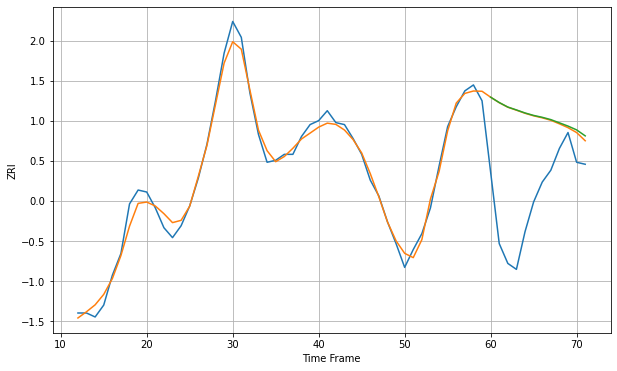

Wall time: 10.5 s
17013 4.2049853284844705 47.24289568734451 47.452396954350036 [1026.81395349 1024.11859632 1021.84575872 1020.38913536 1018.86781569
 1017.62280186 1016.67528235 1015.51562266 1013.8842794  1012.24894083
 1010.33068933 1007.31314732]

Got an mse at 0.0050 in round 87 and stopped training

60 60 12


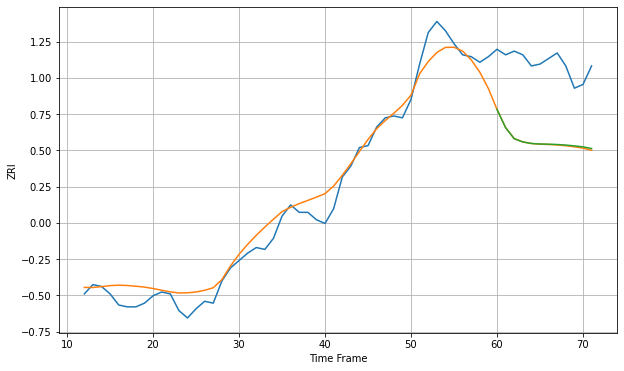

Wall time: 7.71 s
17022 7.855620542418621 42.20262381231132 41.97133223512784 [856.53393263 846.69717487 840.74749375 838.99027092 838.16917631
 837.87193147 837.77368587 837.60635765 837.29844802 836.87167738
 836.3391856  835.43831666]

Got an mse at 0.0049 in round 421 and stopped training

60 60 12


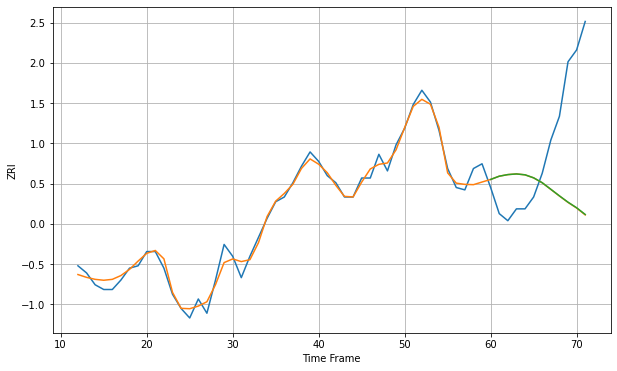

Wall time: 16.1 s
17401 3.0561375638043518 37.977740724750205 37.906965727516464 [813.39685851 814.76930877 815.44444107 815.72131421 815.35538976
 814.08434964 812.01790882 809.25888064 806.48470203 803.81211132
 801.4698444  798.64881374]

Got an mse at 0.0050 in round 219 and stopped training

60 60 12


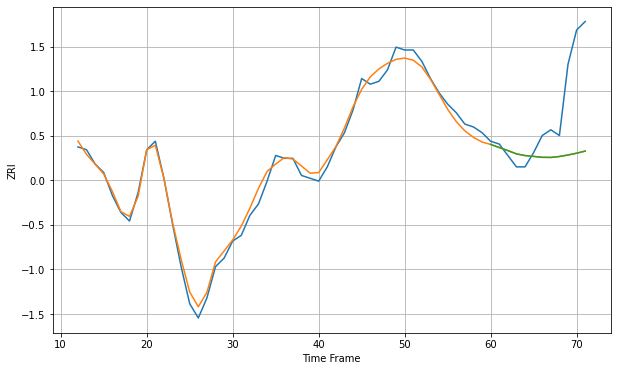

Wall time: 11 s
17404 2.5027205120181724 20.81211461156083 20.81204074623063 [855.87006559 854.78610628 853.71866489 852.56130184 851.96448146
 851.67167134 851.35182348 851.30973842 851.63137485 852.1704526
 852.79006411 853.53803481]

Got an mse at 0.0050 in round 175 and stopped training

60 60 12


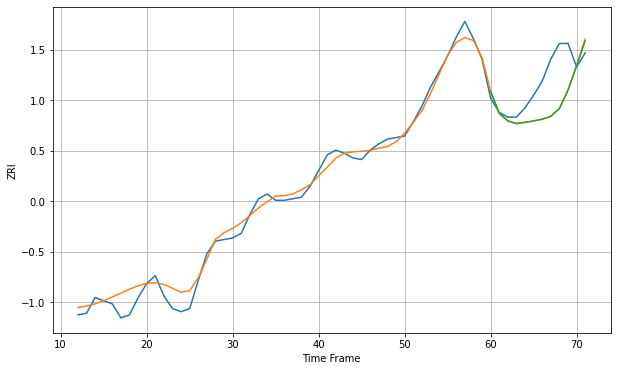

Wall time: 10.1 s
17512 6.01431965472738 20.44313741137101 20.349053676981832 [1016.46887958 1002.46227524  997.58868152  995.90471455  996.72439085
  997.61013506  998.69088011 1000.6073412  1005.56750523 1017.3328442
 1032.58009506 1048.68180874]

Got an mse at 0.0050 in round 193 and stopped training

60 60 12


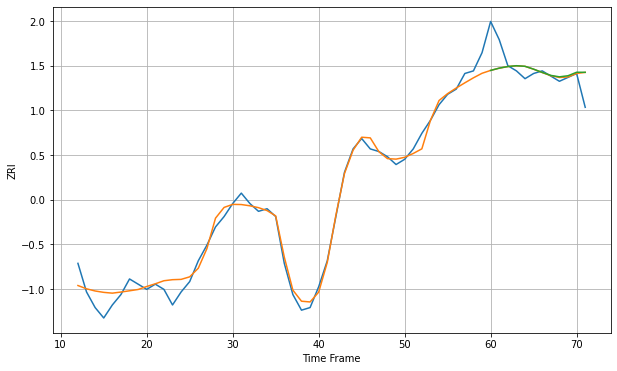

Wall time: 10.8 s
17522 3.612866639758032 7.562346819834677 7.573003977591672 [851.18268968 852.05608102 852.6714479  852.9866578  852.75937174
 851.66142748 850.40261119 849.26812261 848.71057235 849.13439399
 850.47588572 850.44967214]

Got an mse at 0.0050 in round 108 and stopped training

60 60 12


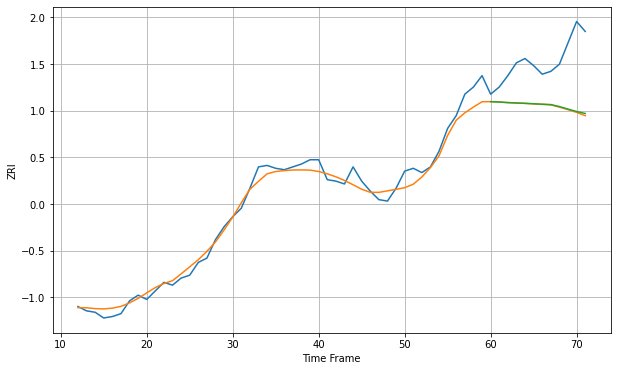

Wall time: 9.01 s
17543 6.217711546064448 34.955176129999266 34.543691528918075 [1099.7527886  1099.48523355 1099.08716897 1098.81785249 1098.571853
 1098.26520546 1097.96705175 1097.70468082 1096.30389959 1094.52430037
 1092.84241575 1091.45946315]

Got an mse at 0.0050 in round 193 and stopped training

60 60 12


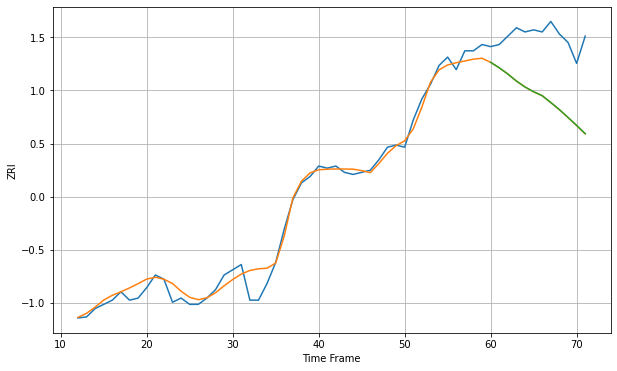

Wall time: 10.3 s
17552 4.486999865824026 29.997612548942527 29.939836737785626 [972.49527444 969.89529162 966.92296649 963.56171508 960.7397514
 958.47505281 956.58258058 953.31992292 949.93133961 946.21991224
 942.423463   938.47495793]

Got an mse at 0.0050 in round 139 and stopped training

60 60 12


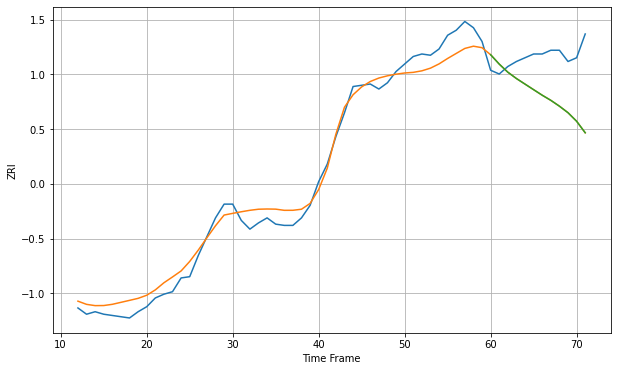

Wall time: 9.03 s
17602 9.797422672147855 37.47815957227139 37.480979576703895 [1081.42178344 1073.90581253 1067.44511796 1062.3797078  1057.91970261
 1053.47471382 1049.04217867 1044.95218193 1040.28101881 1035.0510606
 1028.22720591 1019.05553896]

Got an mse at 0.0050 in round 115 and stopped training

60 60 12


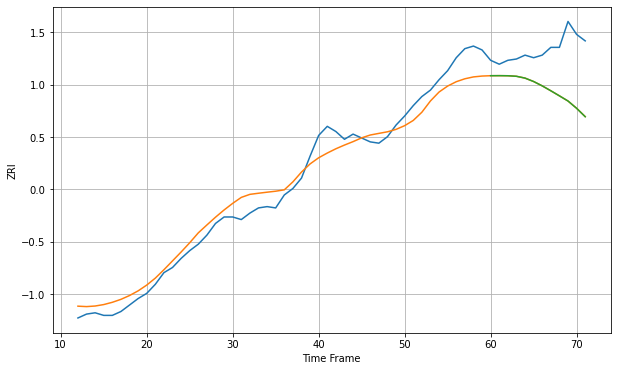

Wall time: 8.58 s
17603 10.736233040152387 35.036404995512946 35.0572968306649 [1124.10491576 1124.15063081 1124.07634986 1123.66233511 1122.2549049
 1119.61576035 1116.25113351 1112.46750509 1108.54919977 1104.55453229
 1098.92305101 1092.42435623]

Got an mse at 0.0049 in round 158 and stopped training

60 60 12


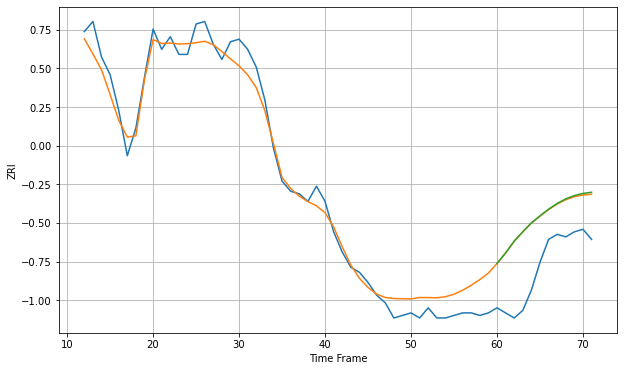

Wall time: 10.6 s
17701 6.5236875916487636 20.336742314991234 20.529204254873196 [784.51064701 788.65931464 793.33453113 797.02721912 800.54031141
 803.30391476 805.94120056 808.20464064 810.00844844 811.31430803
 812.15076784 812.62140104]

Got an mse at 0.0050 in round 54 and stopped training

60 60 12


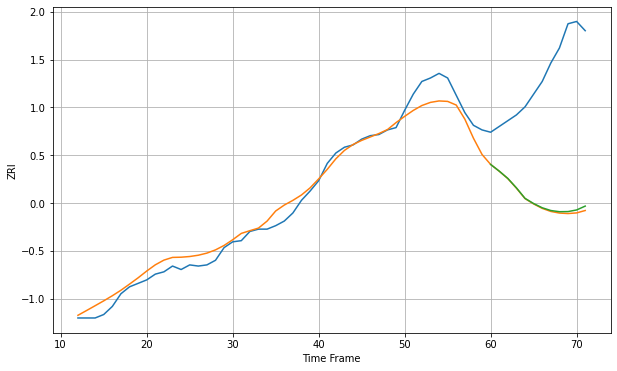

Wall time: 6.85 s
18018 9.793427439025976 112.63203106244593 111.3700933681986 [1059.0736812  1053.28241789 1046.9498884  1038.77311287 1029.66962121
 1025.17189231 1021.51324829 1019.13868602 1018.10597368 1018.22164985
 1019.6234241  1022.96765464]

Got an mse at 0.0049 in round 164 and stopped training

60 60 12


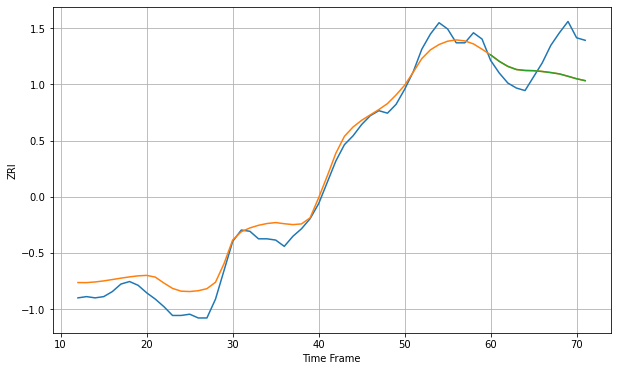

Wall time: 10.6 s
18042 11.169050198997523 23.0345349604882 23.026577441535935 [1134.40764486 1129.29430063 1125.26040262 1122.7674915  1121.98224908
 1121.80502227 1121.18771233 1120.32208457 1119.26366883 1117.37831285
 1115.40141339 1113.8923037 ]

Got an mse at 0.0050 in round 137 and stopped training

60 60 12


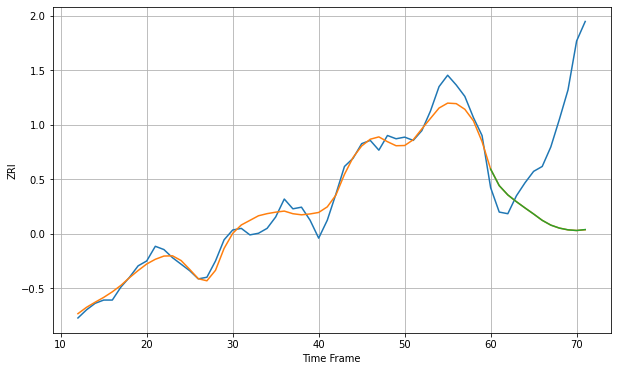

Wall time: 8.93 s
18102 6.061000944345991 62.30304644565402 62.28376415544651 [1068.36655831 1058.22116376 1052.52772894 1048.37049542 1044.53191986
 1040.81519324 1036.9334693  1034.00040763 1032.16257828 1031.09545435
 1030.69714045 1031.26053188]

Got an mse at 0.0048 in round 441 and stopped training

60 60 12


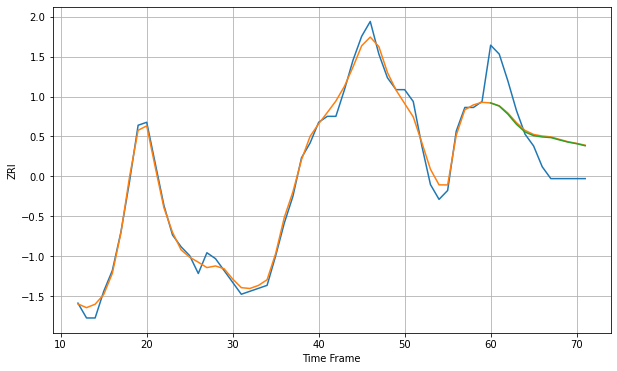

Wall time: 17 s
18232 2.5284815679317902 12.0385403936878 11.986772221459502 [783.51948748 782.46607666 779.75581943 776.331598   773.72908725
 772.48604426 772.04750604 771.83994212 771.05888241 770.31345839
 769.78189954 769.08552285]

Got an mse at 0.0050 in round 227 and stopped training

60 60 12


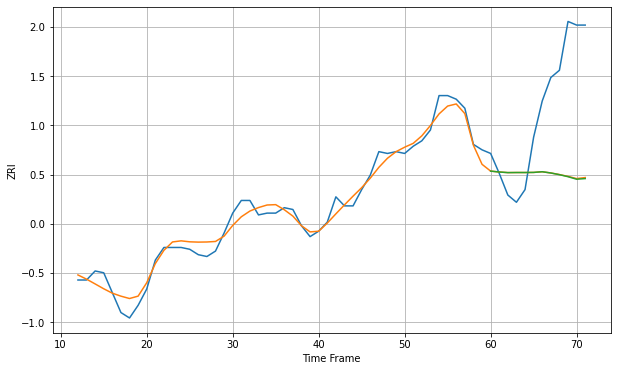

Wall time: 11.1 s
18951 5.114837970175501 50.24798594460922 50.40560829764059 [1345.22986798 1344.73362028 1344.40159802 1344.45196323 1344.45683386
 1344.51297056 1344.88467827 1344.19088891 1343.25886059 1342.14673238
 1340.75080079 1341.10000924]

Got an mse at 0.0050 in round 67 and stopped training

60 60 12


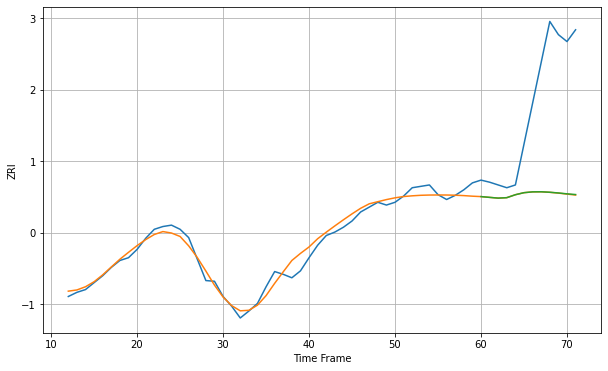

Wall time: 6.93 s
19007 9.731128986559321 151.82552790048598 151.63102903507877 [1226.19868165 1225.07960601 1224.00104556 1224.66108944 1228.90849596
 1231.86915245 1233.04347975 1233.16513566 1232.47858296 1231.45049152
 1230.18974863 1229.15807943]

Got an mse at 0.0049 in round 401 and stopped training

60 60 12


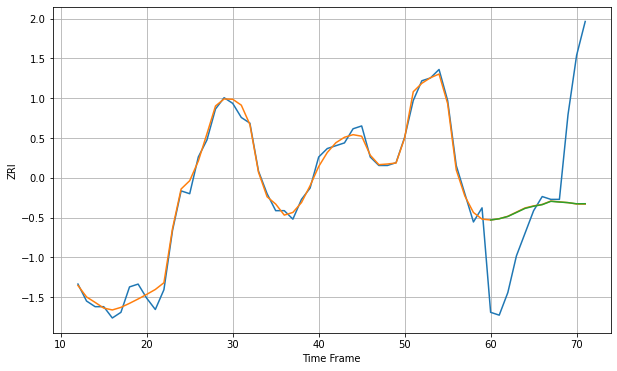

Wall time: 15.7 s
19103 2.441224240742446 30.57897410961893 30.529719232040343 [1678.69040544 1679.13606299 1679.94588412 1681.35912398 1682.80035007
 1683.57398316 1684.12851297 1685.30917959 1685.05806388 1684.84203155
 1684.43567902 1684.45940832]

Got an mse at 0.0050 in round 207 and stopped training

60 60 12


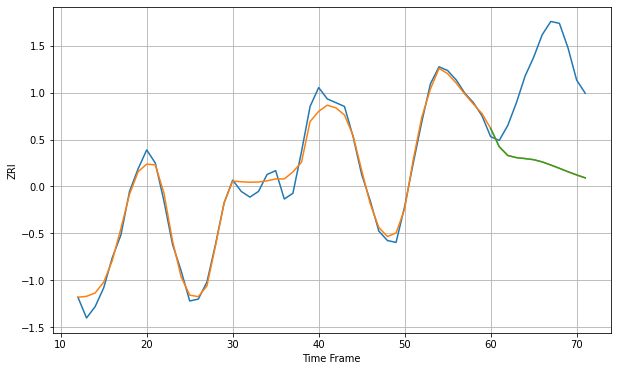

Wall time: 10.9 s
19104 4.704938313732357 50.84130109108364 50.8263713029148 [1274.39404646 1264.67531573 1260.02840139 1258.89940755 1258.40554323
 1257.81949345 1256.64758896 1255.0025206  1253.24927232 1251.43881821
 1249.76391412 1248.20080979]
60 60 12


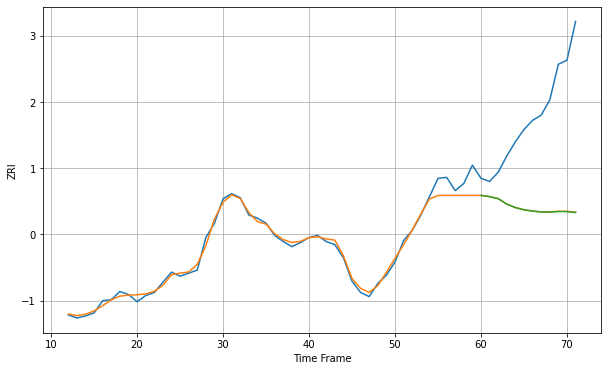

Wall time: 18.8 s
19106 6.548565254465053 100.29474554649305 100.42283153429936 [1749.30381089 1748.09375626 1746.09855211 1740.68758535 1737.35141354
 1735.15538686 1733.89217483 1733.01207381 1732.93322337 1733.49202846
 1733.39854176 1732.46822462]

Got an mse at 0.0049 in round 318 and stopped training

60 60 12


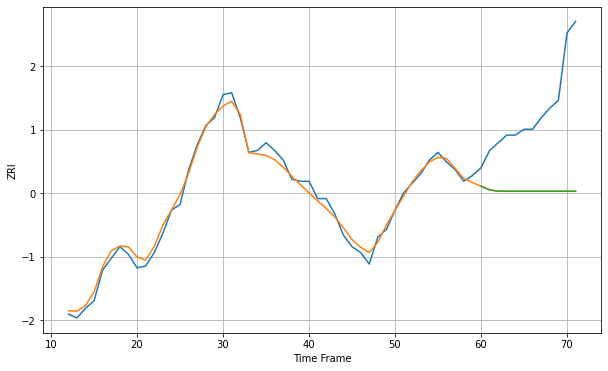

Wall time: 13.2 s
19107 3.2455107769253195 45.64642724706023 45.64695048079696 [1561.42678479 1559.53586982 1558.84568306 1558.80017814 1558.80388938
 1558.80666408 1558.80854039 1558.80958496 1558.810218   1558.81071184
 1558.81141439 1558.81178474]

Got an mse at 0.0049 in round 353 and stopped training

60 60 12


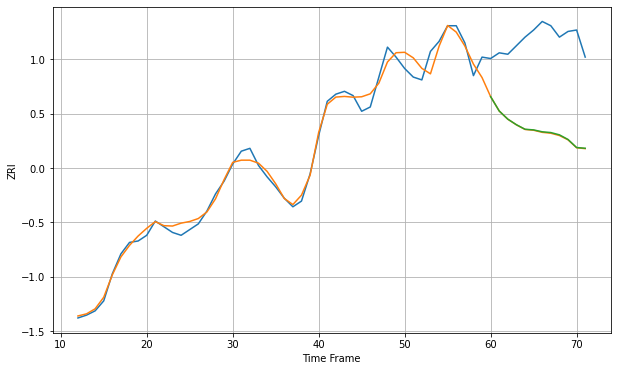

Wall time: 15.7 s
19120 5.859833010254264 64.49204515787522 64.25189946733143 [961.24649274 951.18236656 945.46993298 941.55346003 938.395062
 937.93703612 936.60146733 936.06576969 934.47582014 931.22791453
 925.5609258  925.0540689 ]
60 60 12


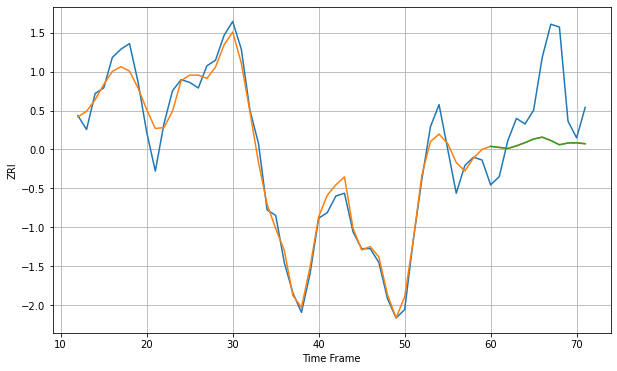

Wall time: 18.4 s
19121 4.998211300885029 20.805656457089594 20.815484773693278 [1349.93031395 1349.53676177 1349.16650197 1350.10955672 1351.27176678
 1352.56873249 1353.2428286  1352.02661883 1350.483059   1351.14161164
 1351.1874895  1350.84946882]

Got an mse at 0.0046 in round 87 and stopped training

60 60 12


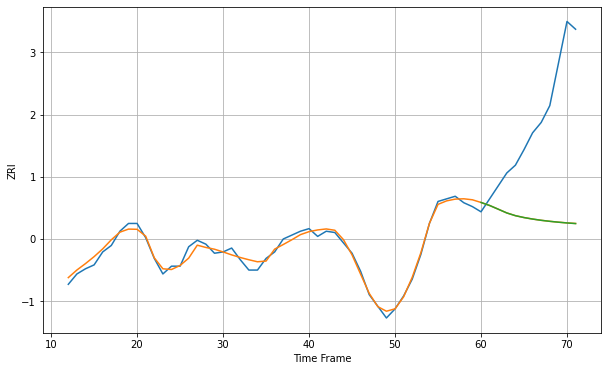

Wall time: 7.6 s
19123 3.543518322169389 84.39377577138588 84.41509655498955 [1547.21295643 1544.88751533 1542.02328398 1539.12096836 1537.01124992
 1535.55557188 1534.3987085  1533.4314227  1532.64512314 1531.97362085
 1531.38978514 1530.90792157]

Got an mse at 0.0049 in round 268 and stopped training

60 60 12


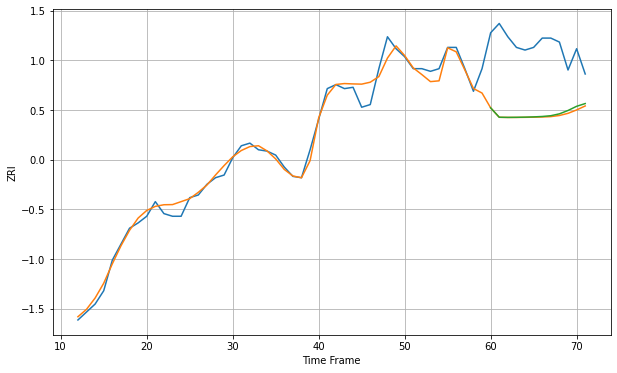

Wall time: 12.2 s
19124 6.411382242190446 53.03399861518977 52.42339436631453 [937.54396412 930.45510023 930.35815794 930.41285672 930.53607978
 930.73287411 931.043312   931.62142221 933.02853835 935.55376911
 938.69935518 940.76054813]
60 60 12


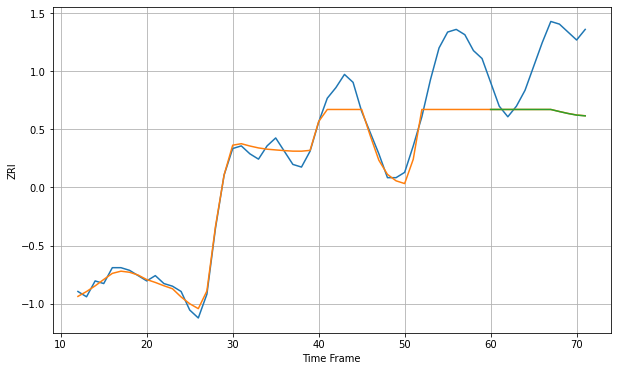

Wall time: 18.5 s
19128 9.88752162668989 22.499790371229636 22.514411784713495 [1237.75656494 1237.75656494 1237.75656494 1237.75656494 1237.75656494
 1237.75656494 1237.75656494 1237.75656494 1236.97170768 1236.24005044
 1235.63259273 1235.33901296]

Got an mse at 0.0050 in round 136 and stopped training

60 60 12


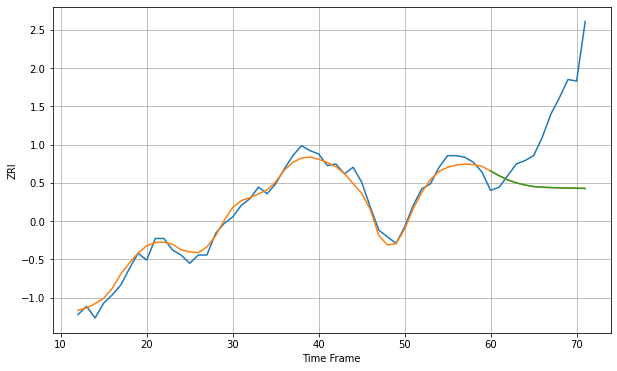

Wall time: 9.41 s
19130 4.168113596432652 45.945453542471824 45.97455453220232 [1527.7200777  1524.82151536 1522.37848587 1520.54953707 1519.26893272
 1518.33593584 1517.91914253 1517.71568126 1517.53289739 1517.43466022
 1517.34745279 1517.17690826]

Got an mse at 0.0050 in round 109 and stopped training

60 60 12


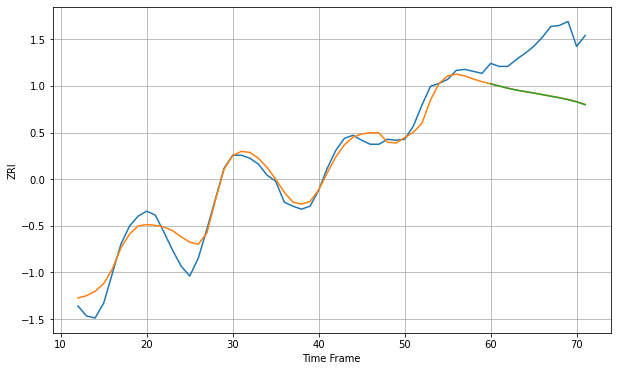

Wall time: 8.69 s
19131 11.345250363908887 52.56977230400013 52.692967694651735 [1148.52430567 1146.30042691 1144.1363499  1142.27384587 1140.73084717
 1139.33478249 1137.72421731 1136.11774983 1134.5609963  1132.6622233
 1130.39820159 1127.66637256]

Got an mse at 0.0050 in round 169 and stopped training

60 60 12


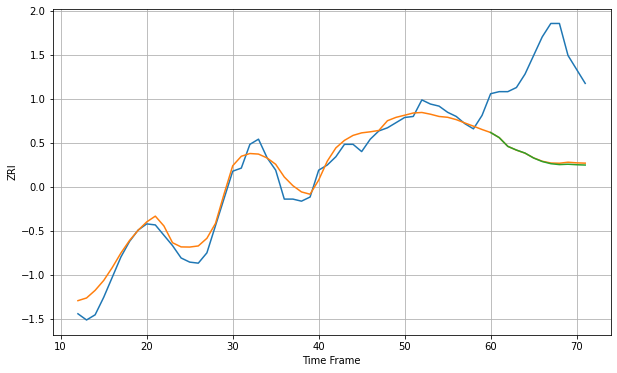

Wall time: 10.6 s
19139 10.242022872953914 91.91880405851617 92.65245859025404 [1106.44196527 1101.50089515 1093.02222445 1089.4826854  1086.53805744
 1081.78752898 1078.37133872 1076.27232907 1075.39211937 1075.7564316
 1075.26342687 1074.97060161]

Got an mse at 0.0049 in round 186 and stopped training

60 60 12


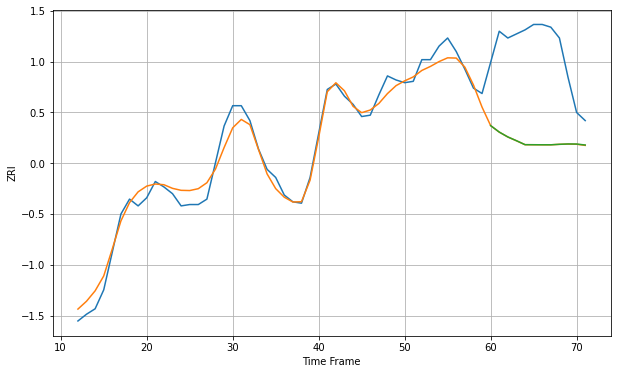

Wall time: 10.1 s
19140 7.65738301854635 70.3080327964909 70.27598502938037 [972.29560918 967.52676754 963.92510477 961.14599347 958.22389875
 958.17581207 958.13600292 958.12588626 958.4908037  958.74310355
 958.68958988 957.96793306]

Got an mse at 0.0050 in round 366 and stopped training

60 60 12


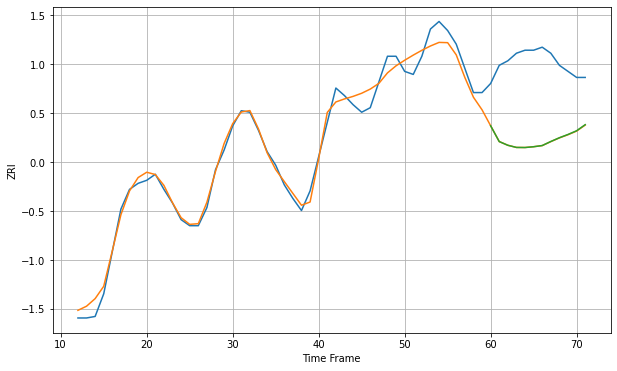

Wall time: 14.9 s
19141 6.327022772720429 52.01441672741194 51.962074260503975 [947.05156592 936.60690003 934.15763479 932.73006498 932.66943745
 933.19051486 933.98679812 936.65727322 939.15432193 941.30711601
 943.76193071 947.78617274]

Got an mse at 0.0049 in round 176 and stopped training

60 60 12


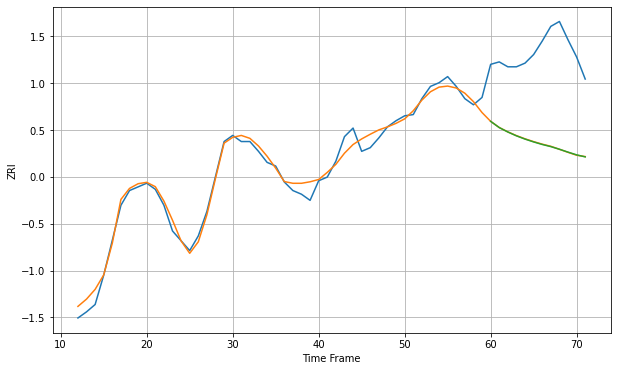

Wall time: 10.4 s
19143 6.278610514161084 74.31576061499447 74.39738123377303 [1101.4908996  1096.400076   1092.7865637  1089.64958921 1086.99877406
 1084.68341651 1082.60743762 1080.85558337 1078.69984662 1076.34960025
 1074.13570634 1072.47602208]

Got an mse at 0.0050 in round 414 and stopped training

60 60 12


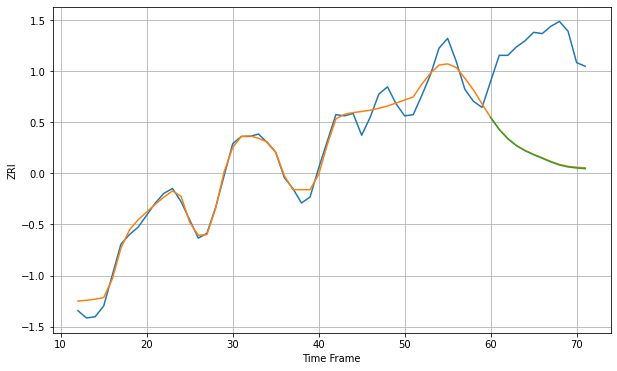

Wall time: 16.4 s
19144 7.950055175178205 90.52926731683097 90.84930487075398 [1051.70375155 1041.76873552 1034.12424728 1028.37506253 1024.24840579
 1020.94430591 1018.00525498 1014.953226   1012.4256541  1010.80784613
 1009.93173768 1009.375943  ]

Got an mse at 0.0048 in round 335 and stopped training

60 60 12


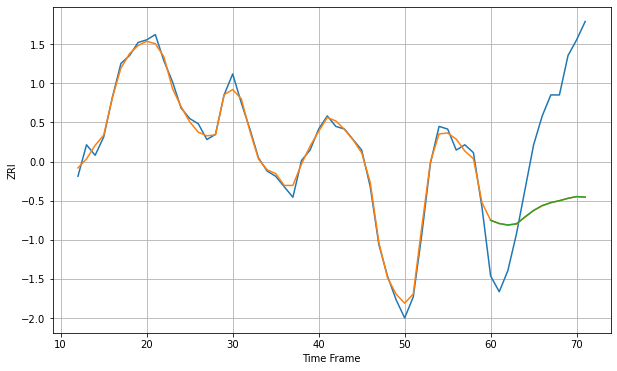

Wall time: 14.4 s
19146 2.3190853715400537 38.39007904261853 38.371236928080485 [1474.22227374 1472.97396794 1472.42643545 1472.93110278 1475.5523778
 1478.0066724  1479.82300149 1480.96016048 1481.69774023 1482.59864252
 1483.2588014  1483.02903459]

Got an mse at 0.0050 in round 481 and stopped training

60 60 12


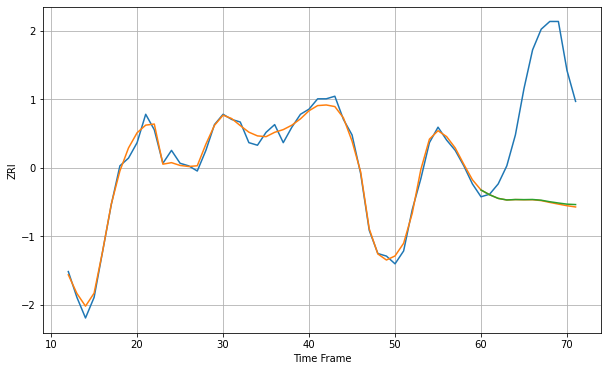

Wall time: 17.9 s
19147 2.3775530051068894 45.528773125812094 45.27989355504961 [1423.63591588 1421.78681714 1420.37511592 1419.76966709 1419.93762173
 1419.89840232 1419.95076833 1419.67908068 1419.08130346 1418.59416149
 1418.14703141 1417.98542943]

Got an mse at 0.0049 in round 265 and stopped training

60 60 12


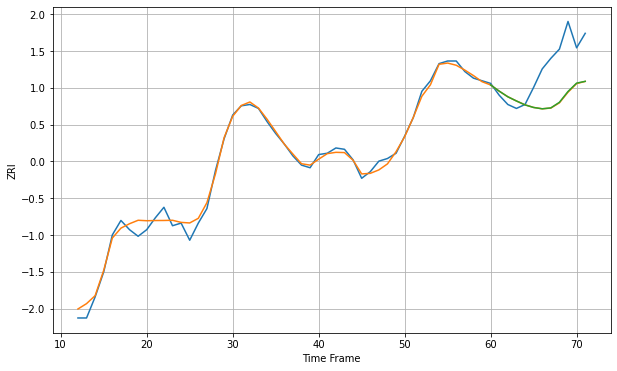

Wall time: 12.2 s
19148 4.371682628643929 27.777612032739604 27.58854026730991 [1255.81472605 1251.10334918 1246.85412406 1243.6597748  1240.70191595
 1238.72571052 1237.72377765 1238.40433178 1242.66933585 1250.87799779
 1257.20582746 1258.58191074]

Got an mse at 0.0050 in round 192 and stopped training

60 60 12


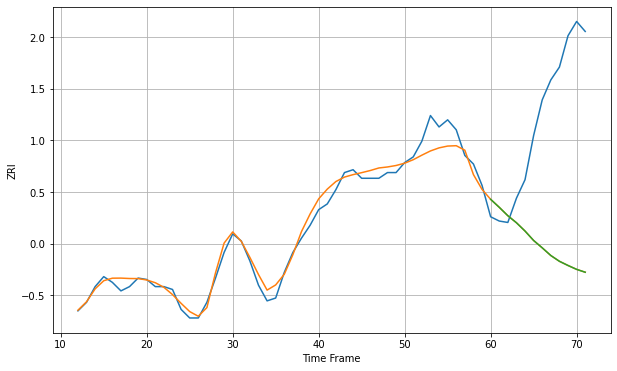

Wall time: 11 s
19401 7.048063365553911 106.67257378900446 106.66752234552237 [1203.23867244 1197.64966593 1191.73373607 1186.81129582 1180.98163903
 1174.35600788 1169.21926673 1163.81860454 1159.76257633 1156.81990752
 1154.10060667 1152.09396279]

Got an mse at 0.0049 in round 302 and stopped training

60 60 12


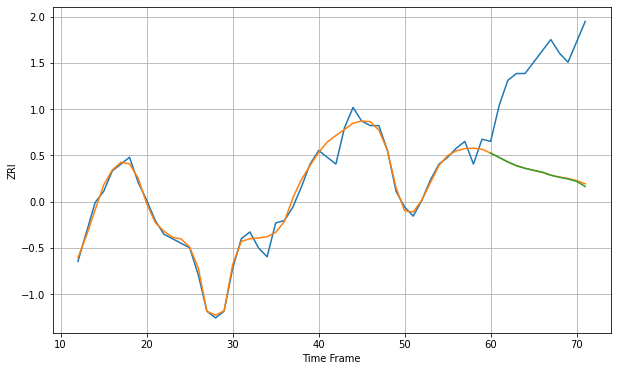

Wall time: 13.9 s
19464 3.423734138317913 48.78106725651039 48.99424736738597 [1095.8176541  1093.90747503 1091.93649871 1090.28041621 1089.1133033
 1088.22254108 1087.38222651 1086.08299681 1085.15565777 1084.42338257
 1083.32428038 1081.11367977]

Got an mse at 0.0049 in round 189 and stopped training

60 60 12


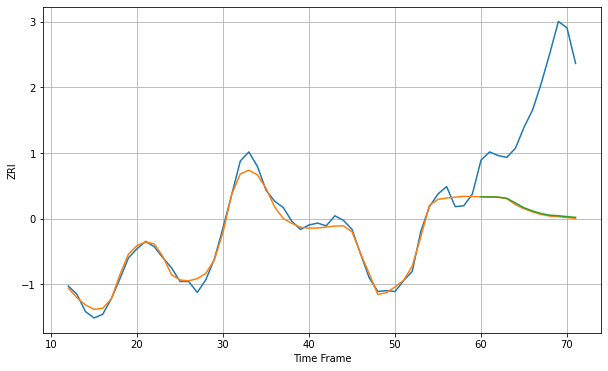

Wall time: 10.6 s
20001 6.883853442696049 129.9727376133874 129.14528104332862 [2307.82806953 2307.5945233  2307.40988631 2306.24105681 2301.04792903
 2295.83992008 2292.24618717 2289.46458691 2287.66481318 2287.04949438
 2286.11732491 2285.2984657 ]

Got an mse at 0.0050 in round 138 and stopped training

60 60 12


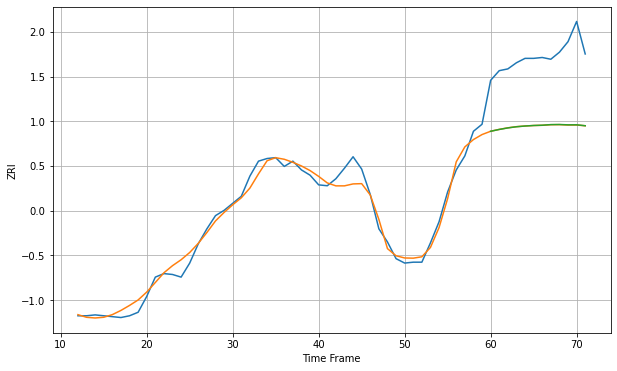

Wall time: 9.71 s
20002 9.500525980958619 80.24838562265592 80.1828945667705 [2143.00949418 2145.07051934 2146.82672204 2148.1597494  2148.98020419
 2149.59116565 2149.89700957 2150.59415827 2150.7241506  2150.3324138
 2150.37220498 2149.31690086]

Got an mse at 0.0047 in round 271 and stopped training

60 60 12


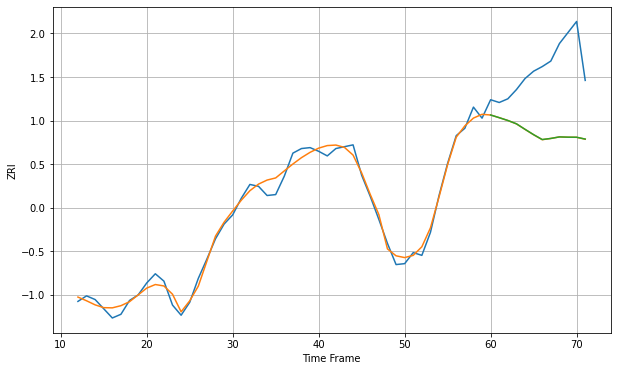

Wall time: 13 s
20003 7.198488460118686 74.59039429104276 74.53399774731182 [2304.42299261 2301.52457541 2298.48258054 2294.86053326 2288.88987401
 2283.07901803 2277.76354924 2278.96809    2280.63757908 2280.34948556
 2280.28001812 2278.26729548]

Got an mse at 0.0050 in round 249 and stopped training

60 60 12


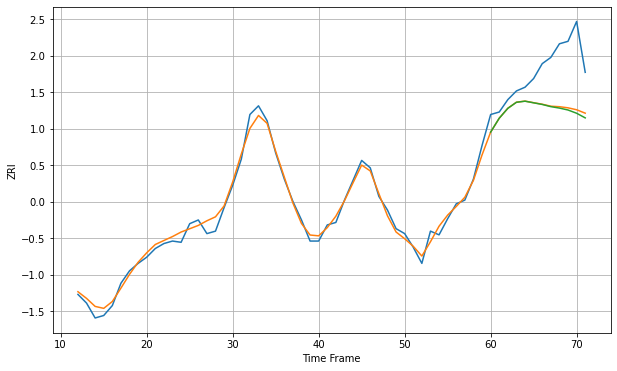

Wall time: 12.4 s
20005 4.943241526298525 35.43588747121446 36.624137911336405 [2280.80428645 2292.02119561 2299.97380053 2304.86148287 2305.73054851
 2304.42283743 2303.10571749 2301.33948138 2300.18708584 2298.63554729
 2296.01660305 2292.2829349 ]

Got an mse at 0.0050 in round 390 and stopped training

60 60 12


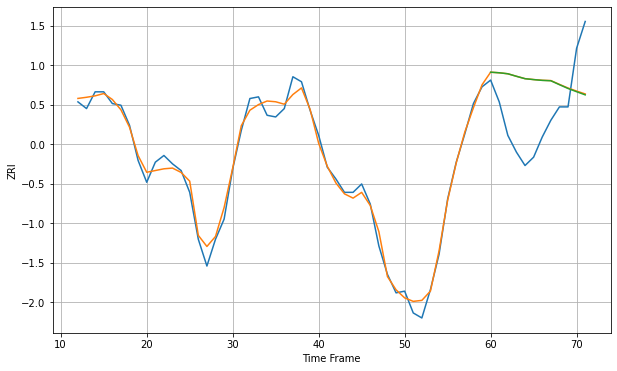

Wall time: 16 s
20007 4.889576134850147 33.049426718300815 33.099117040993484 [2173.71473512 2173.37035588 2172.77430375 2171.26408349 2169.8397481
 2169.29043102 2168.83005614 2168.60456574 2166.2707658  2164.0042497
 2162.06540169 2160.18388321]

Got an mse at 0.0049 in round 270 and stopped training

60 60 12


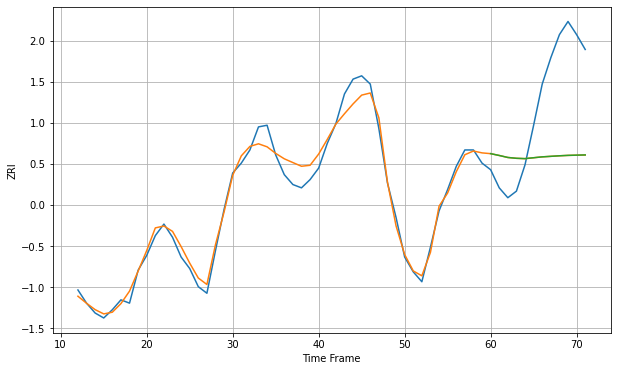

Wall time: 13.2 s
20008 6.216683888671149 49.075420793099596 49.05880062816748 [2054.75595093 2053.6500696  2052.4403288  2051.93837422 2051.73842339
 2052.27762606 2052.81168444 2053.13007158 2053.45664102 2053.71057211
 2053.85254078 2053.98509668]

Got an mse at 0.0050 in round 198 and stopped training

60 60 12


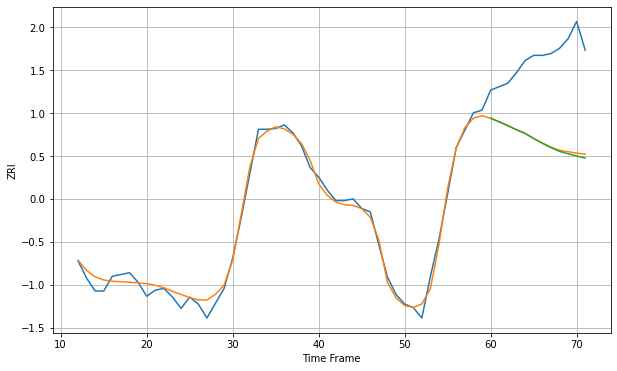

Wall time: 10.9 s
20009 7.963757984113124 97.88146684308101 99.22388768320864 [2314.66916887 2310.63213517 2306.1757409  2301.54656379 2297.26268519
 2291.4124192  2286.04922559 2280.98094191 2276.55878966 2273.99732541
 2271.30318661 2268.8649076 ]
60 60 12


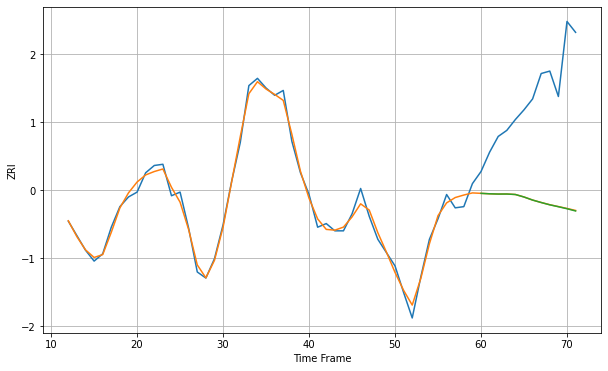

Wall time: 18.7 s
20010 5.084368456226859 91.23785479232512 91.35625423921873 [2119.97696158 2119.60869973 2119.3910423  2119.42377868 2119.01999515
 2116.95219496 2114.41916197 2112.38793199 2110.49432423 2108.92522083
 2107.27219993 2105.41270285]

Got an mse at 0.0050 in round 149 and stopped training

60 60 12


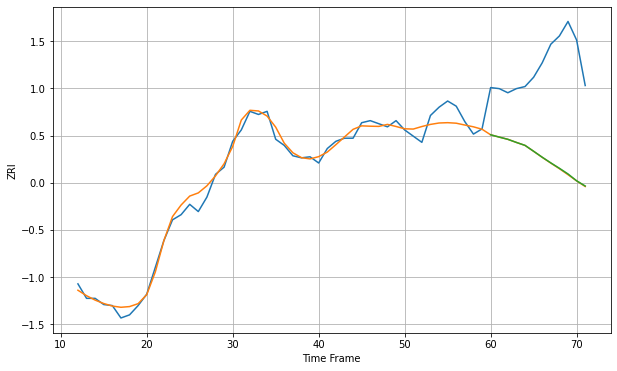

Wall time: 9.45 s
20011 7.564770468997355 93.84967313954505 93.62040524639642 [1891.31018556 1889.07201831 1886.92853722 1883.9094682  1881.06331604
 1875.37606163 1869.59500767 1864.1127119  1858.8819111  1853.39928236
 1846.77475249 1841.74035912]

Got an mse at 0.0048 in round 165 and stopped training

60 60 12


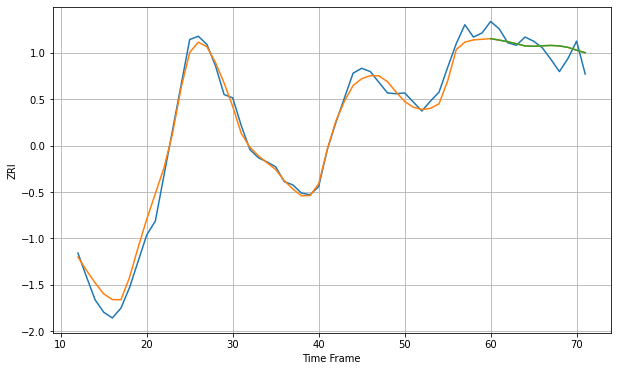

Wall time: 10.1 s
20019 11.545405982846473 15.894162715210037 15.879664454634776 [1690.04496361 1688.30245758 1686.30781852 1683.8008573  1681.19634734
 1680.80604918 1681.36992252 1681.80327073 1681.23042871 1679.45820713
 1675.99568241 1672.95509244]

Got an mse at 0.0050 in round 210 and stopped training

60 60 12


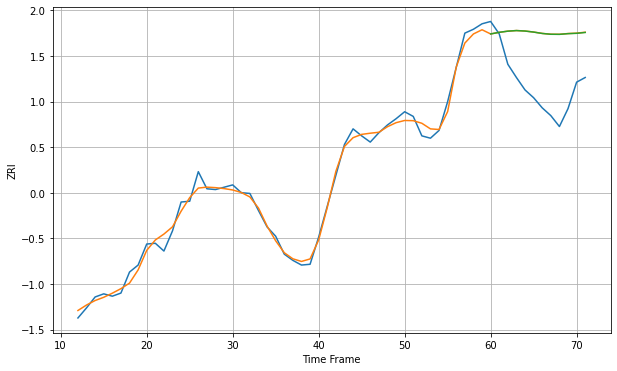

Wall time: 11.4 s
20020 8.101594330756868 76.03881170790494 75.95112103404786 [1661.95969127 1664.04858148 1665.55747545 1666.3134601  1665.69930595
 1664.35692917 1662.59015999 1661.5558097  1661.43580602 1662.34094625
 1662.77010098 1663.86153266]

Got an mse at 0.0049 in round 157 and stopped training

60 60 12


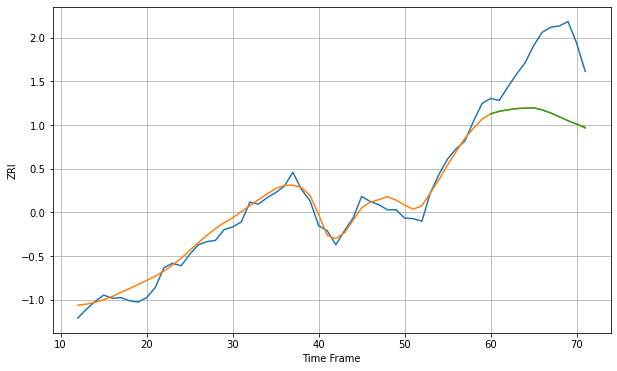

Wall time: 10.1 s
20024 13.174789902979114 100.61870340739611 100.57829805819001 [2323.71454971 2327.87012773 2330.05886988 2332.07131936 2332.79138791
 2333.35916029 2329.93035178 2325.07220799 2319.20832712 2313.05466895
 2307.77044581 2302.73913307]

Got an mse at 0.0050 in round 216 and stopped training

60 60 12


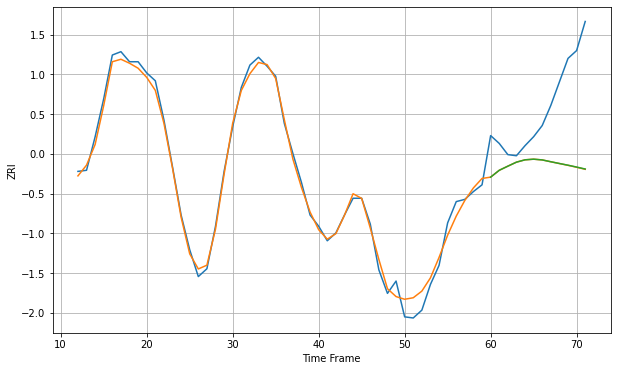

Wall time: 12.7 s
20037 6.785346820293856 63.86232447492829 63.77342592323549 [2382.87569196 2388.97966667 2392.67323466 2396.25789612 2398.34467685
 2398.91812628 2398.26384845 2396.62821063 2395.06550567 2393.53424399
 2391.88225485 2390.1263073 ]

Got an mse at 0.0050 in round 124 and stopped training

60 60 12


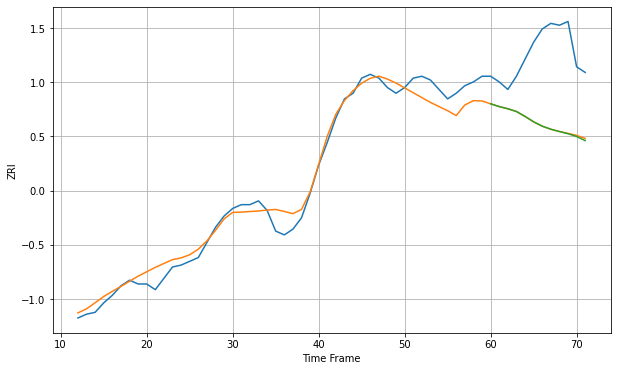

Wall time: 8.69 s
20109 6.226489843449518 39.30340337999594 39.45841285861381 [1445.39538135 1443.92417362 1442.78467004 1441.32250736 1438.73333465
 1435.86753541 1433.58235428 1431.94962619 1430.71372201 1429.54569411
 1428.07004926 1425.90696489]

Got an mse at 0.0050 in round 234 and stopped training

60 60 12


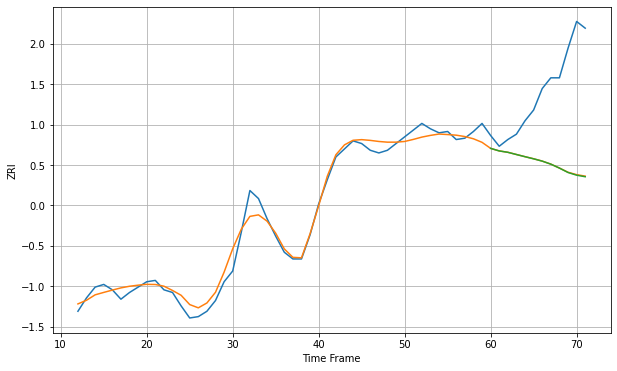

Wall time: 12 s
20110 6.448863094895729 63.09741649314094 63.25635929986578 [1394.4082121  1392.50069613 1391.47830505 1389.83072456 1388.19866975
 1386.62075204 1384.90122161 1382.66036341 1379.71131772 1376.4301381
 1374.42983774 1373.27470493]

Got an mse at 0.0049 in round 151 and stopped training

60 60 12


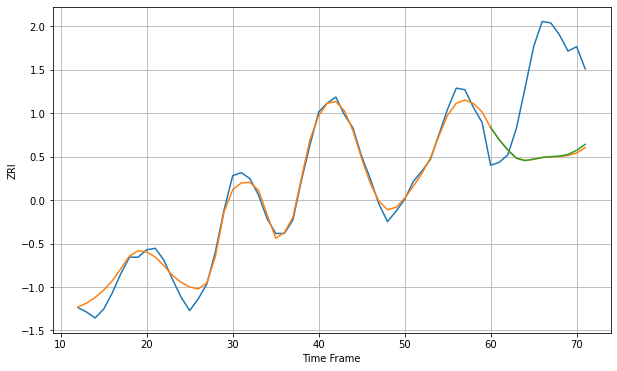

Wall time: 10.2 s
20147 5.594723642221674 61.695397979292494 61.24622398644878 [1618.48580153 1610.20737485 1603.26954112 1597.79206799 1596.18091294
 1597.07171356 1598.26872916 1598.83604609 1599.21769863 1600.30923571
 1603.10159064 1607.10942097]

Got an mse at 0.0050 in round 79 and stopped training

60 60 12


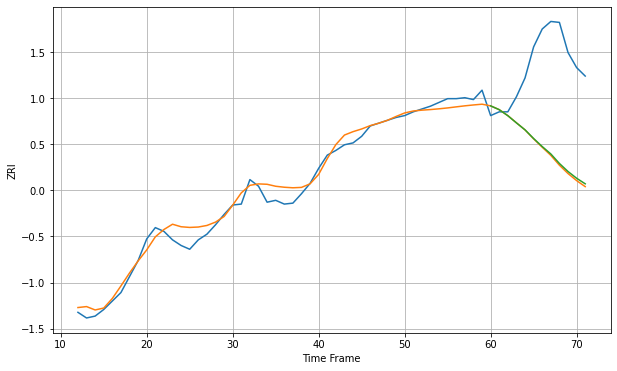

Wall time: 8.18 s
20175 9.571653605280224 98.85117846806106 97.5472384623291 [1631.33389178 1627.26713932 1620.89296435 1613.2716639  1605.86344214
 1596.63024215 1588.11969473 1580.24715171 1570.13361406 1561.5936618
 1554.44394377 1548.53332299]

Got an mse at 0.0049 in round 124 and stopped training

60 60 12


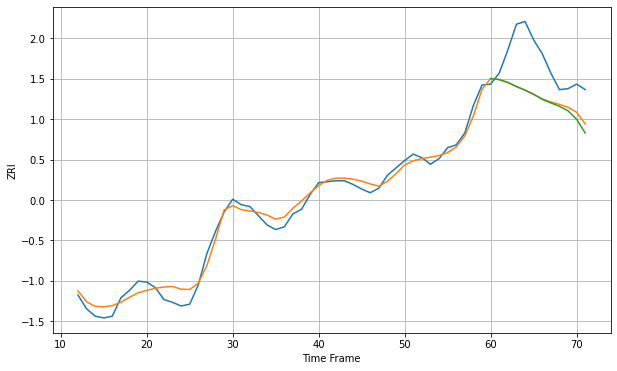

Wall time: 9.06 s
20176 8.366767150019285 42.16592055506366 43.84379048316038 [1630.03061399 1628.88215184 1625.76850252 1621.37333611 1617.3778328
 1612.87173959 1607.43061838 1603.5452997  1599.89704239 1594.95132078
 1585.76216737 1570.85722385]

Got an mse at 0.0049 in round 364 and stopped training

60 60 12


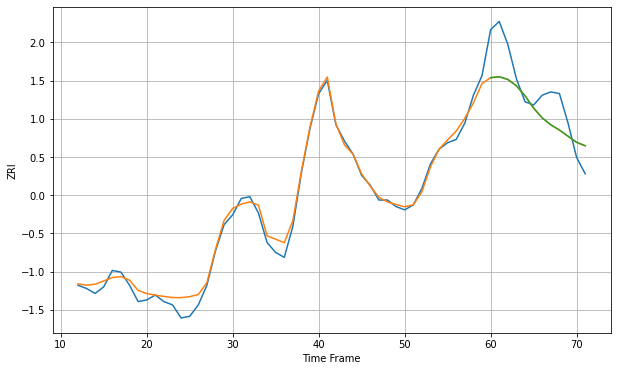

Wall time: 15 s
20740 4.271833339753498 18.31313959677534 18.31535014827292 [1641.68812693 1642.27493837 1640.61151553 1636.74859593 1630.62468256
 1623.08275797 1617.14100827 1612.89757009 1609.72803879 1605.96833893
 1602.2659106  1600.14406043]

Got an mse at 0.0050 in round 256 and stopped training

60 60 12


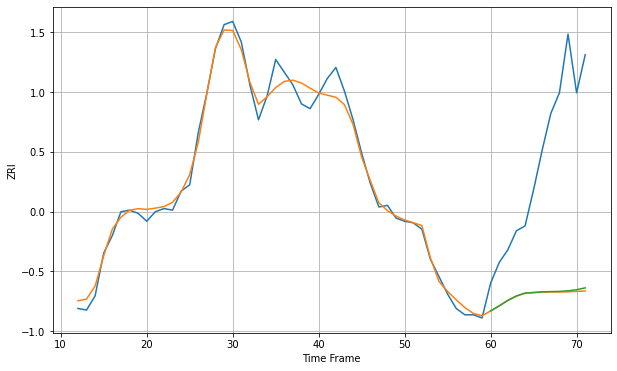

Wall time: 12.1 s
20814 6.160366911411935 95.9970670086839 95.45284059173316 [1953.45011169 1956.64645347 1960.08747422 1962.87264874 1964.68334051
 1965.07627856 1965.48754801 1965.63640393 1965.75608519 1966.10924238
 1966.84734751 1967.97459017]

Got an mse at 0.0050 in round 121 and stopped training

60 60 12


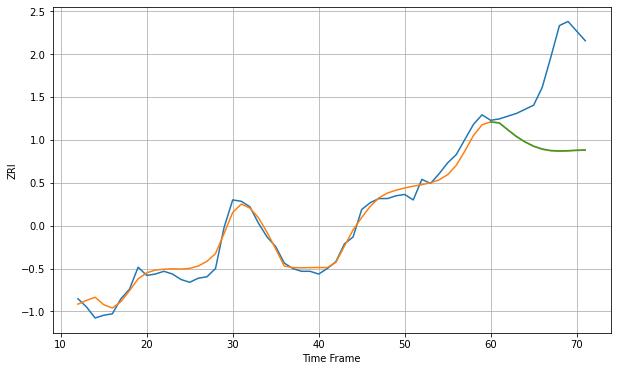

Wall time: 9.03 s
20850 5.949214959674899 57.570933139769735 57.395994628162626 [1850.80980085 1850.11304199 1845.09021265 1840.1998006  1836.27156068
 1833.19849373 1831.10241665 1830.00645105 1829.70912225 1829.88047215
 1830.22883096 1830.44140053]

Got an mse at 0.0049 in round 142 and stopped training

60 60 12


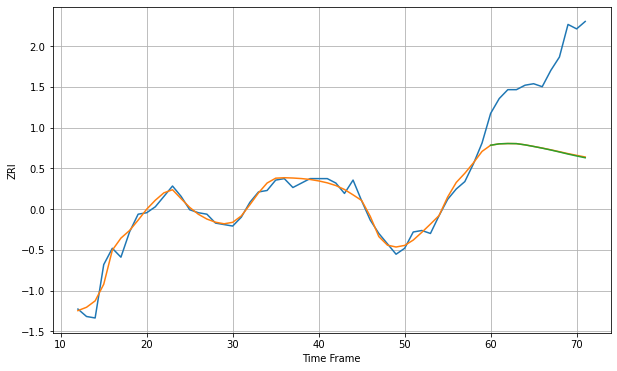

Wall time: 9.44 s
20852 4.543118868076223 57.2474255998387 57.4431852318051 [1769.50755438 1770.45909897 1770.66700308 1770.59361699 1769.77029537
 1768.68612936 1767.5449045  1766.30064372 1764.95800962 1763.56723289
 1762.2818935  1761.06549373]

Got an mse at 0.0049 in round 96 and stopped training

60 60 12


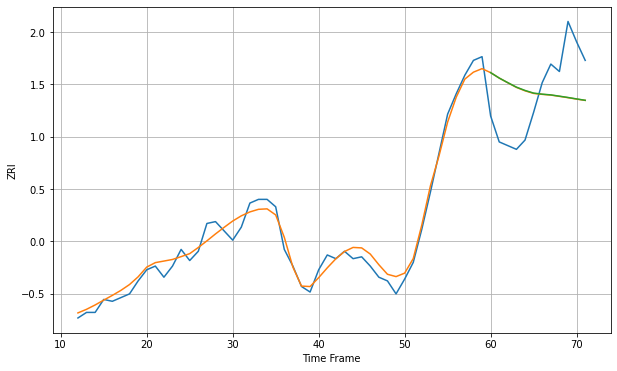

Wall time: 9.21 s
20878 4.771510254718929 26.491670319288197 26.499319333023625 [1694.38496768 1691.46175437 1688.97536677 1686.55881151 1684.77662388
 1683.34778009 1682.76793072 1682.38123595 1681.68878516 1680.97638893
 1680.20187808 1679.46298694]
60 60 12


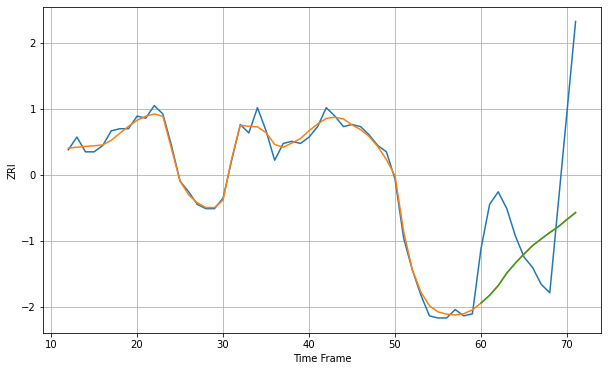

Wall time: 18.5 s
20902 2.8169149644911604 38.74606733811389 38.78645642746462 [1724.10812369 1727.77654289 1732.39938908 1738.35519509 1743.10769393
 1747.40914248 1751.45114114 1754.57502695 1757.67249943 1760.44051705
 1763.85162075 1767.05551466]

Got an mse at 0.0050 in round 271 and stopped training

60 60 12


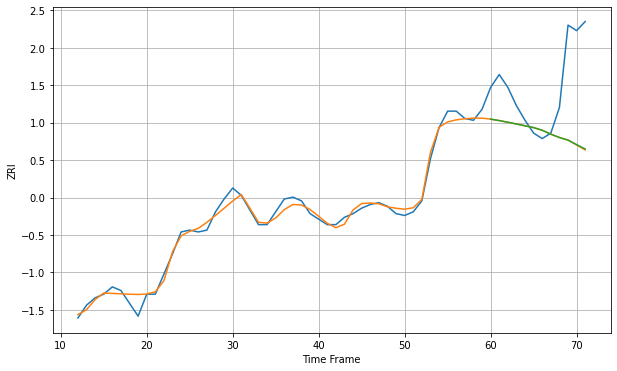

Wall time: 12.7 s
20906 3.3562706552938617 34.733952700845514 34.625106068429 [1569.64457326 1568.844801   1567.93036077 1566.97064303 1565.98716051
 1565.00544949 1563.5528471  1561.42799778 1559.59275356 1558.18140742
 1555.71441916 1553.32569192]

Got an mse at 0.0049 in round 140 and stopped training

60 60 12


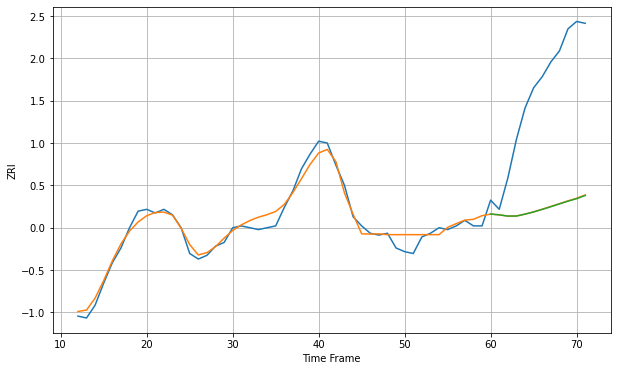

Wall time: 9.13 s
20910 4.018051208403255 67.65737542972494 67.77017361478116 [1716.42286412 1715.99580161 1715.33004883 1715.35848619 1716.37507687
 1717.56514598 1718.97330117 1720.41672788 1721.93567352 1723.42816222
 1724.77362661 1726.51362113]

Got an mse at 0.0049 in round 426 and stopped training

60 60 12


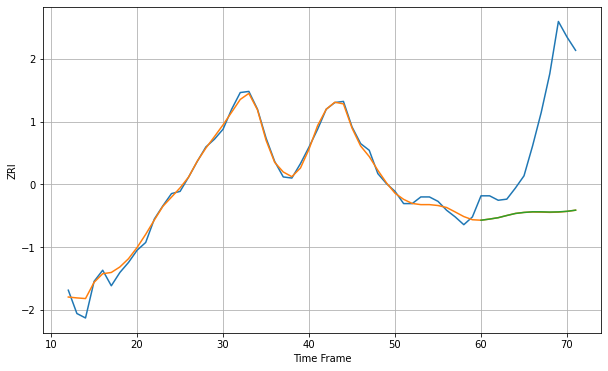

Wall time: 17.4 s
21043 5.009825794249085 93.5612349228608 93.4486126296018 [1544.02217583 1545.06056947 1546.29761803 1548.27198618 1550.11013081
 1551.04274394 1551.61382809 1551.58497423 1551.38339846 1551.53124528
 1552.06470518 1553.07173432]

Got an mse at 0.0050 in round 221 and stopped training

60 60 12


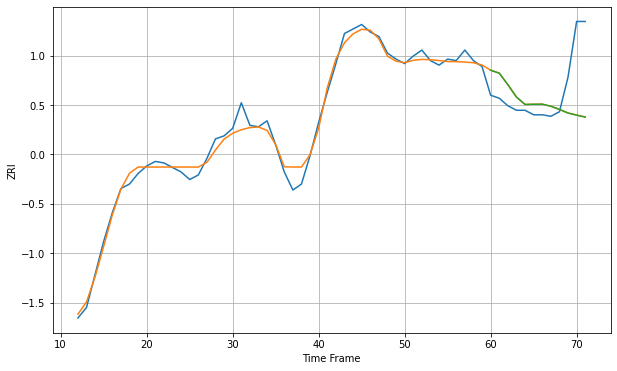

Wall time: 11.5 s
21044 5.154812393028339 28.061833950017387 28.086433173988755 [1647.59898926 1645.67653716 1638.06079917 1629.82858246 1624.87529523
 1624.95784566 1625.01902742 1623.68095076 1621.57058523 1619.16752839
 1617.77332784 1616.46303504]

Got an mse at 0.0050 in round 416 and stopped training

60 60 12


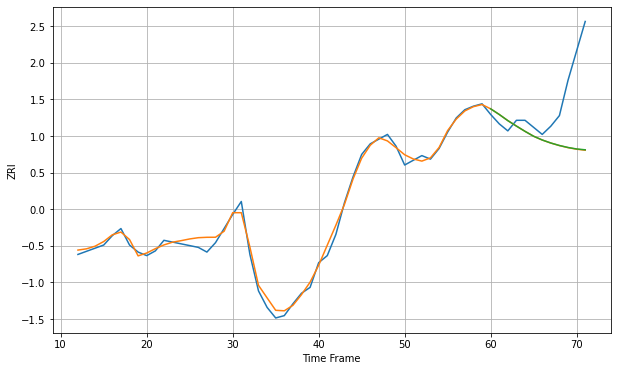

Wall time: 16.6 s
21046 4.541792061048145 44.19905868514246 44.07281538143428 [1649.75537275 1644.96050335 1639.72358026 1635.08201905 1630.61051082
 1626.44444909 1623.27095564 1620.70402841 1618.58956038 1616.89961714
 1615.64180151 1614.9313741 ]
60 60 12


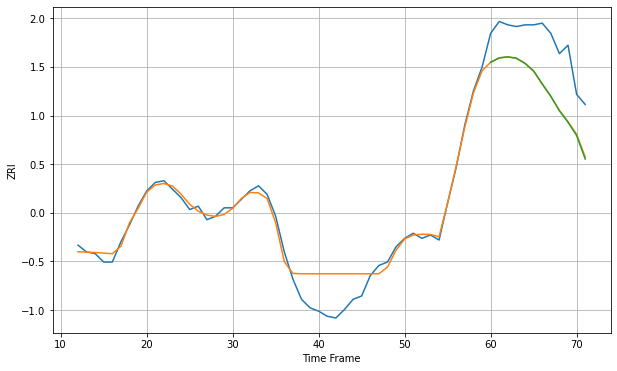

Wall time: 18.4 s
21061 8.59418873284328 29.014756934640925 29.156970360697127 [1445.92745729 1448.50103109 1449.13555285 1448.30504492 1445.3259797
 1440.81219119 1433.20438531 1425.87218432 1417.32618587 1410.53054312
 1402.67898837 1388.80523007]

Got an mse at 0.0049 in round 141 and stopped training

60 60 12


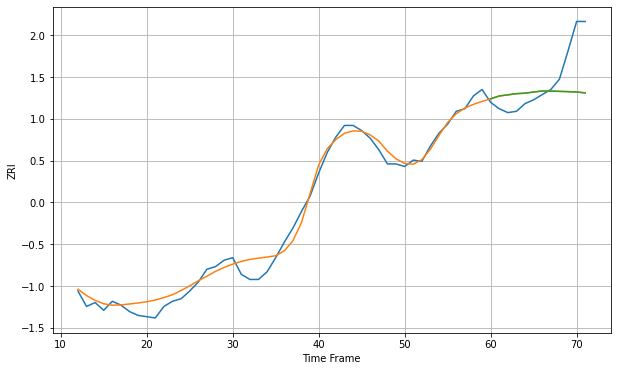

Wall time: 9.4 s
21117 6.7946234214274694 25.484956518560647 25.51942904362021 [1348.76701663 1350.94802138 1351.82903591 1352.75293078 1353.15415688
 1354.05097535 1354.84888462 1354.73066836 1354.53724285 1354.30801044
 1354.02757139 1353.32986035]

Got an mse at 0.0050 in round 273 and stopped training

60 60 12


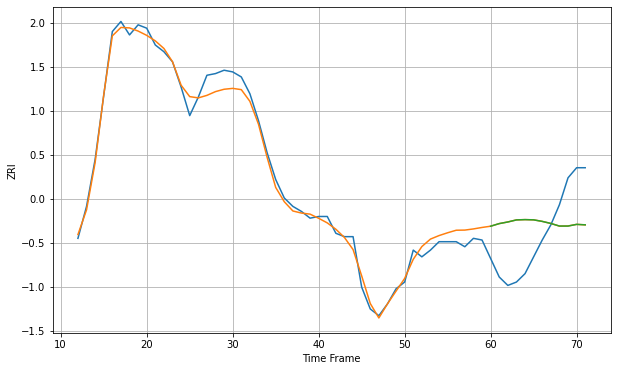

Wall time: 12.8 s
21202 5.325191412105365 27.513032693938555 27.51041798084217 [1251.21667308 1252.76812415 1253.73760533 1254.95703666 1255.13454676
 1255.00195773 1254.08582501 1252.86078672 1251.3137653  1251.29808622
 1252.31228718 1252.03708776]

Got an mse at 0.0049 in round 289 and stopped training

60 60 12


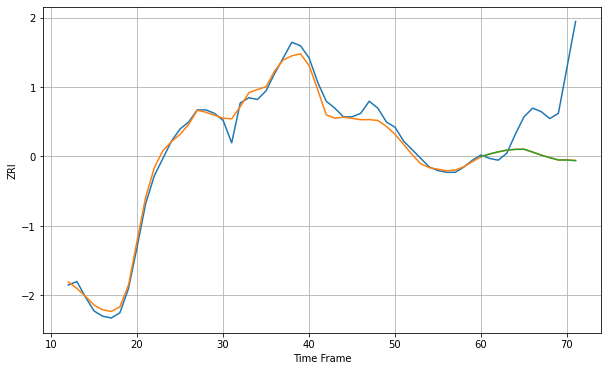

Wall time: 13.5 s
21204 4.195064362969484 31.906931006111783 31.97094539205468 [1300.00472143 1301.55963274 1302.81306887 1303.79878802 1304.24373889
 1304.30777201 1302.67725522 1300.92715006 1299.43975688 1298.1058184
 1298.0923685  1297.68091608]

Got an mse at 0.0050 in round 485 and stopped training

60 60 12


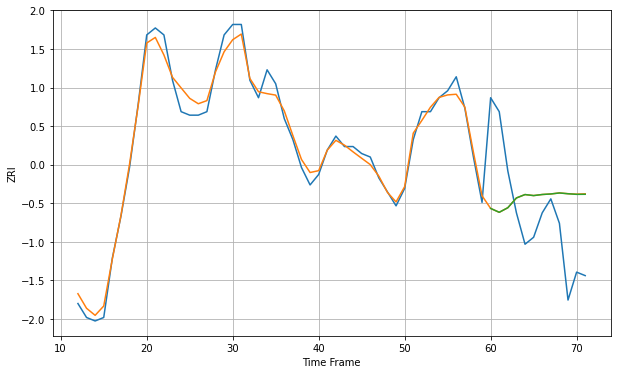

Wall time: 18.3 s
21217 2.7318835828061934 19.14708805017419 19.123441881758087 [1037.26189874 1036.15678656 1037.46728997 1040.27007475 1041.24111765
 1040.94630371 1041.25401964 1041.40913757 1041.69638764 1041.46890273
 1041.29820106 1041.31861581]

Got an mse at 0.0050 in round 285 and stopped training

60 60 12


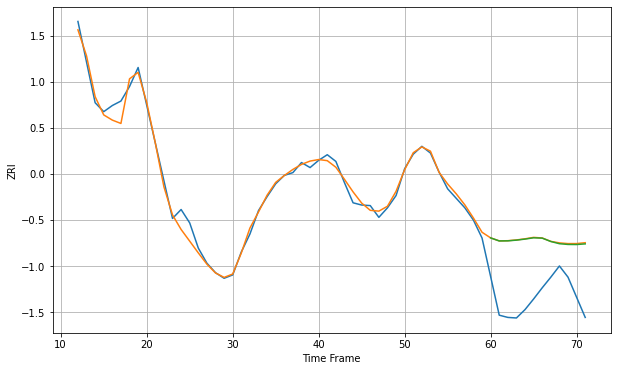

Wall time: 13.3 s
21231 12.240679515453602 105.41169276941326 104.7221846814913 [1772.22805377 1766.77543958 1766.9630232  1768.21253468 1770.08999385
 1772.405515   1771.8133108  1765.80186206 1761.8282132  1760.51648315
 1760.36193006 1761.5242069 ]

Got an mse at 0.0049 in round 271 and stopped training

60 60 12


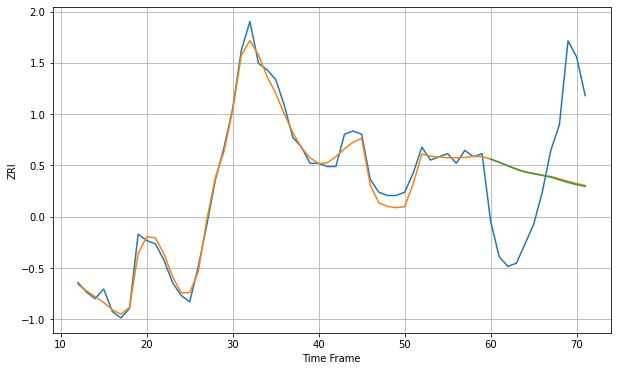

Wall time: 12.8 s
22030 2.4773792513956496 26.469374568716894 26.599396823424485 [1729.3047935  1728.30921194 1727.22922307 1726.15884235 1725.28720815
 1724.77051132 1724.252069   1723.71364494 1722.86369559 1722.03776256
 1721.3608585  1720.82451158]
60 60 12


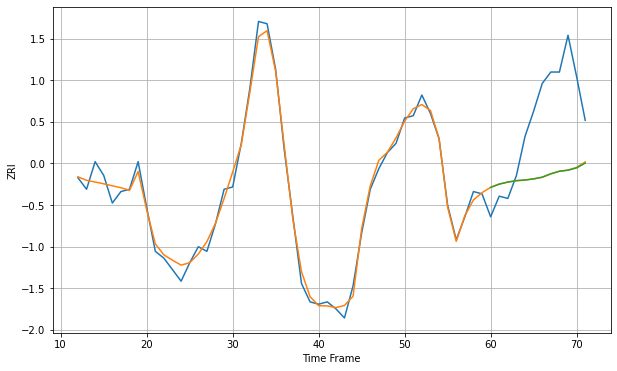

Wall time: 19.2 s
22031 3.4357812087323896 31.99921140330807 32.05829236956543 [1801.81798119 1803.24366121 1804.126759   1804.73599526 1805.01807593
 1805.52050115 1806.24316027 1807.72041357 1808.83614762 1809.28632592
 1810.2903392  1812.38094015]

Got an mse at 0.0050 in round 155 and stopped training

60 60 12


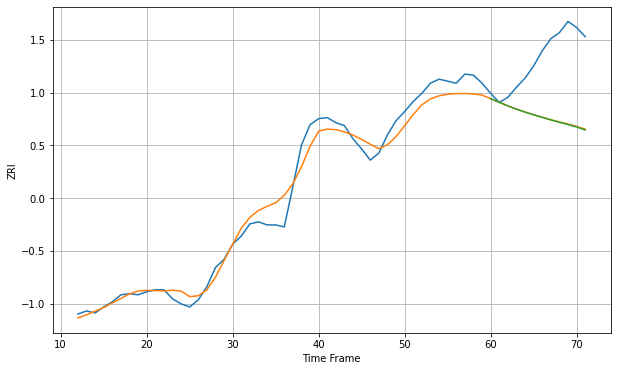

Wall time: 9.94 s
22033 11.789267815117427 64.98297175213109 65.28721005294591 [1801.74804561 1798.10232952 1794.61881769 1791.42646353 1788.47489727
 1785.78797933 1783.22315553 1780.74393976 1778.38350206 1776.22218323
 1773.70641473 1770.82307314]

Got an mse at 0.0050 in round 322 and stopped training

60 60 12


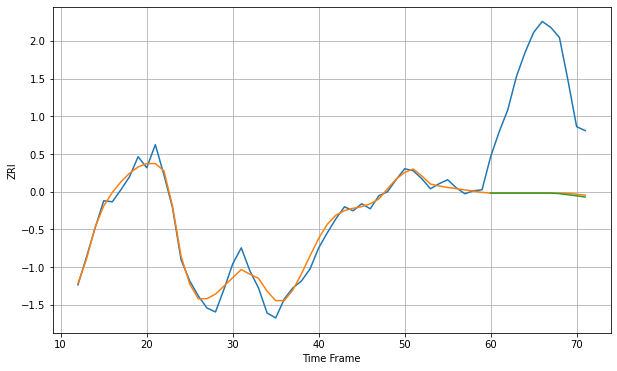

Wall time: 14.3 s
22102 8.26371239138761 120.13108513563401 120.45757792514982 [2037.66013532 2037.66013532 2037.66013532 2037.66013532 2037.66013532
 2037.66013532 2037.66013532 2037.66013532 2037.13387046 2035.9984875
 2034.91951063 2033.7037261 ]

Got an mse at 0.0049 in round 449 and stopped training

60 60 12


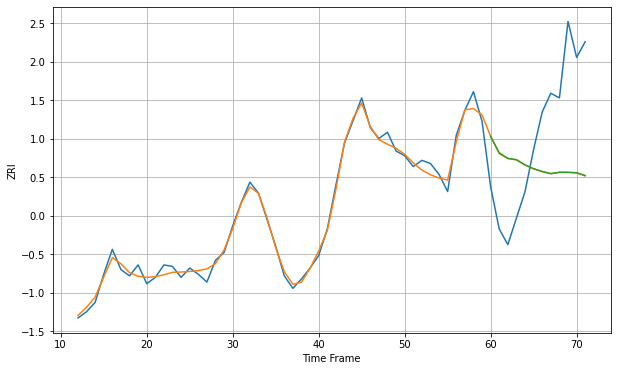

Wall time: 18.3 s
22180 3.8912419475005944 55.44106685009604 55.42493968717463 [1861.38560467 1850.78538812 1847.3192061  1846.42428451 1843.08436213
 1840.64516181 1838.86479702 1837.5118815  1838.37742614 1838.36449843
 1838.06146108 1836.26564632]
60 60 12


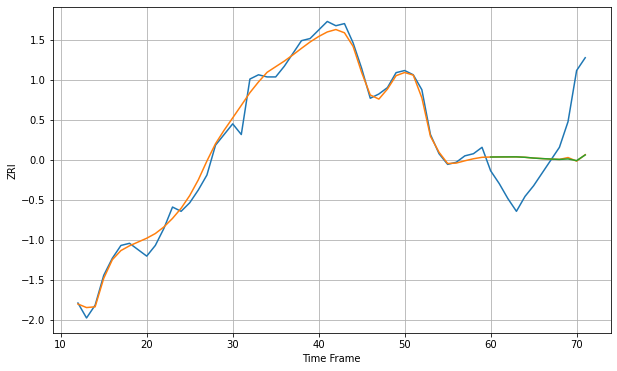

Wall time: 18.6 s
22191 3.7594219179637647 22.29244270596532 22.316212153728014 [1473.45089073 1473.49041334 1473.5132203  1473.52926105 1473.33101066
 1472.96212007 1472.71259709 1472.50111535 1472.32691079 1472.56339062
 1471.76866531 1474.42622417]

Got an mse at 0.0049 in round 71 and stopped training

60 60 12


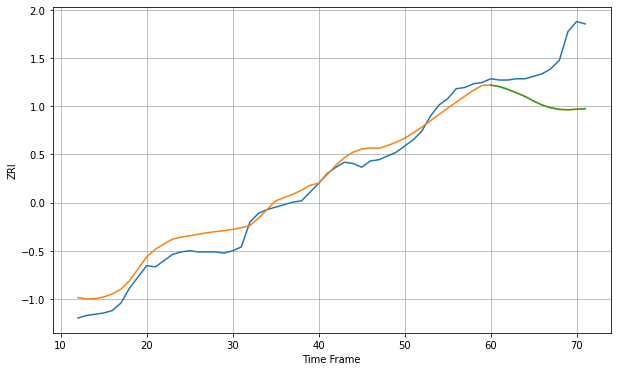

Wall time: 7.46 s
22192 10.05218767561425 38.21453379076254 38.24902632532197 [1451.96055456 1450.73970536 1448.50235752 1445.7095683  1442.79976771
 1439.09607068 1435.89307845 1433.67138519 1432.40769285 1432.10684153
 1432.547397   1433.0089791 ]

Got an mse at 0.0048 in round 394 and stopped training

60 60 12


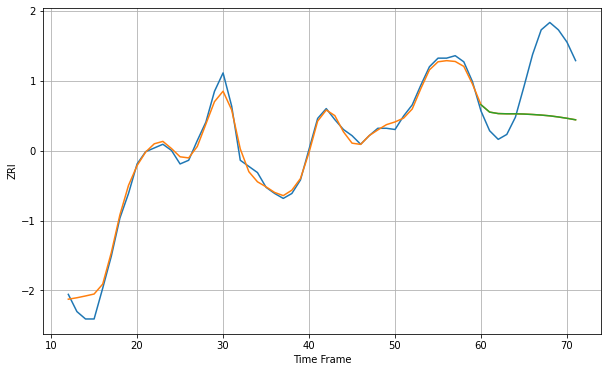

Wall time: 15.9 s
22201 5.995955829460061 46.170512107312426 46.177059393656116 [2119.11426074 2113.14341889 2111.95098893 2111.76378419 2111.75964511
 2111.56248384 2111.20355157 2110.73151873 2110.10298554 2109.1849995
 2108.10711416 2106.87226883]

Got an mse at 0.0049 in round 76 and stopped training

60 60 12


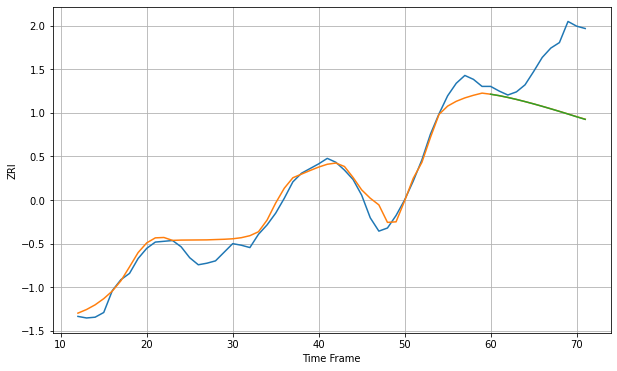

Wall time: 7.42 s
22202 13.908406521185862 71.21018762894711 71.27702976978308 [2149.01125229 2147.15048275 2144.8933127  2142.35084155 2139.58104357
 2136.65929047 2133.55456346 2130.3467624  2127.05157443 2123.68261354
 2120.18640512 2116.87839175]

Got an mse at 0.0049 in round 251 and stopped training

60 60 12


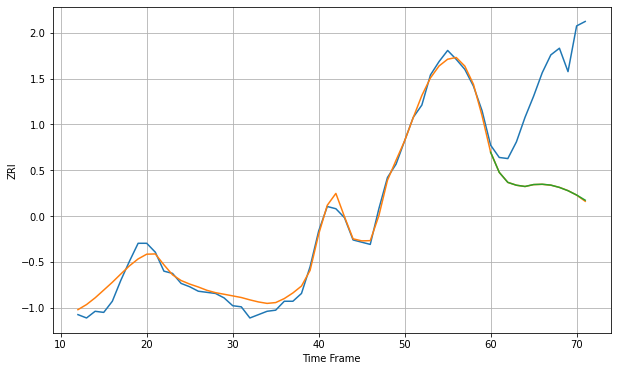

Wall time: 12.1 s
22203 7.410526391249043 96.63682937591143 96.47786122138467 [2062.67967538 2044.6460647  2035.63021133 2033.09874886 2031.98065862
 2033.70178157 2033.97671253 2033.19831439 2031.13091976 2028.16570456
 2024.30691823 2019.65992304]

Got an mse at 0.0049 in round 219 and stopped training

60 60 12


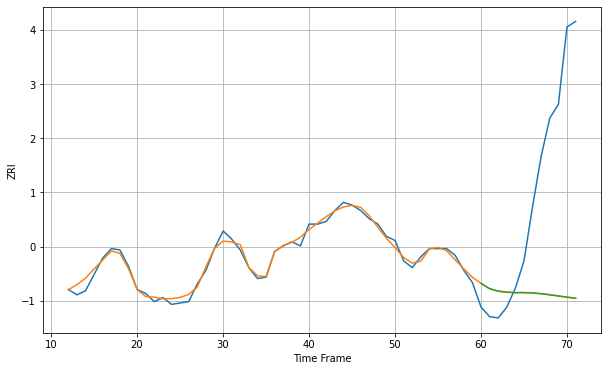

Wall time: 12.2 s
22204 3.3121272976713025 105.55332282235972 105.54641863160549 [1774.4594782  1770.51584638 1768.72350382 1767.96446481 1767.61168202
 1767.64537269 1767.40902884 1766.82383245 1766.04867647 1765.1784521
 1764.28998148 1763.51900752]

Got an mse at 0.0050 in round 488 and stopped training

60 60 12


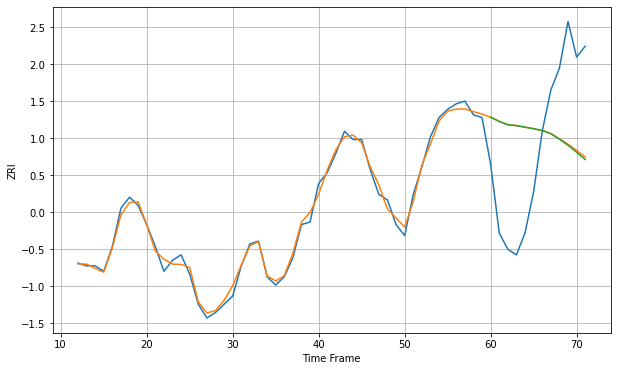

Wall time: 18.3 s
22206 1.98748286599455 34.049736868446 34.258050964813904 [1893.12694294 1891.60524576 1890.37066455 1890.06324921 1889.48426969
 1888.94696822 1888.26568434 1887.10145185 1885.10797786 1882.91853682
 1880.37611218 1877.69844606]

Got an mse at 0.0050 in round 243 and stopped training

60 60 12


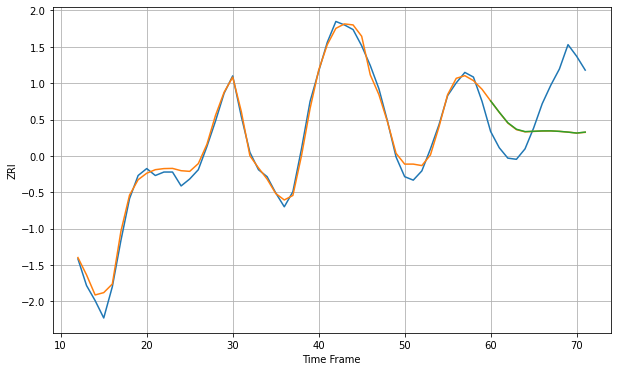

Wall time: 11.9 s
22209 6.284067118148819 42.273529654893125 42.28658897373051 [2255.40565666 2245.67153469 2236.56060519 2230.95628414 2228.90715666
 2229.20261609 2229.50495712 2229.5398807  2229.13472311 2228.47627575
 2227.63028674 2228.49504962]
60 60 12


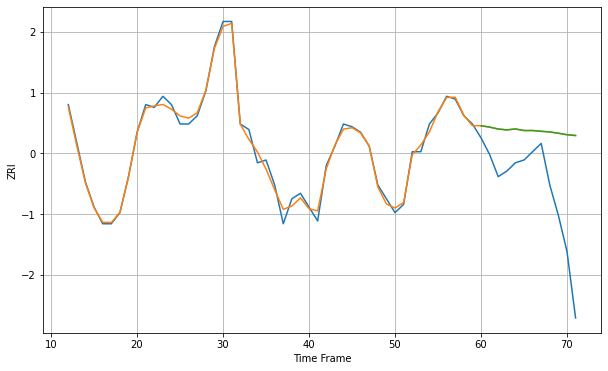

Wall time: 19.9 s
22303 1.7954922951940584 26.360843550679196 26.33787421922559 [1727.3779435  1726.87682736 1726.18672487 1725.87368776 1726.20873008
 1725.64162446 1725.64760463 1725.36390835 1725.12669255 1724.67192942
 1724.12646129 1723.80392006]

Got an mse at 0.0050 in round 233 and stopped training

60 60 12


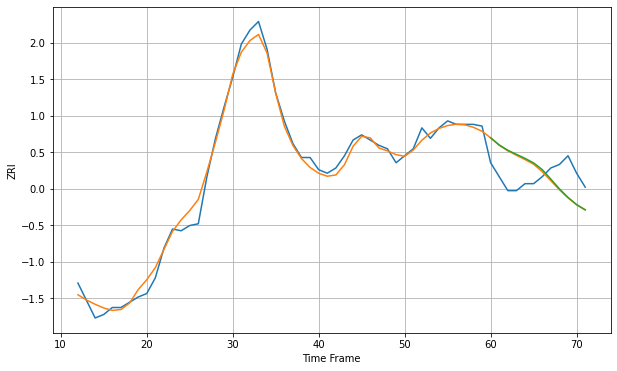

Wall time: 11.8 s
22304 4.323207707072961 16.133881109977906 16.265943568299015 [1592.29260991 1588.21664561 1585.14111645 1582.81178889 1580.50006461
 1577.88670813 1574.06810367 1568.61034269 1563.03043418 1558.11555791
 1553.96871007 1550.9409538 ]
60 60 12


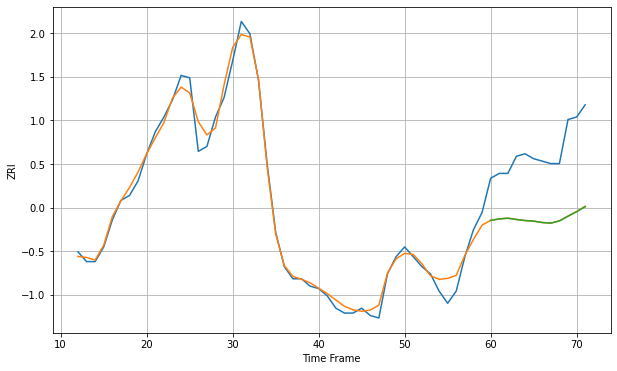

Wall time: 18.1 s
22305 3.7112361156651352 28.206507745075065 28.25025416347047 [1750.83950931 1751.42530176 1751.71506601 1751.19694712 1750.75737076
 1750.52114242 1749.94441818 1749.6923043  1750.60501315 1752.53098984
 1754.35729596 1756.41973918]
60 60 12


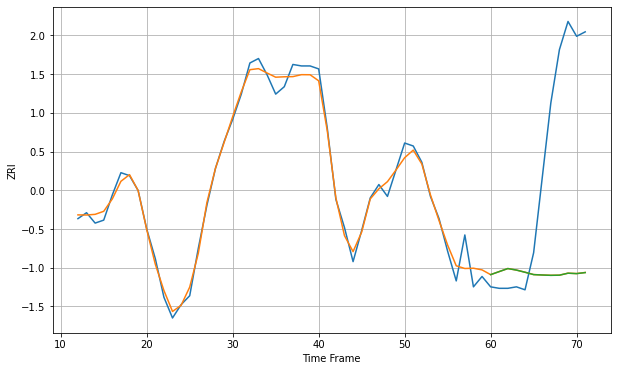

Wall time: 18.5 s
22312 6.096158603545003 101.06353937714634 101.0930188653339 [1699.23453749 1701.29033205 1703.33537661 1702.30070448 1700.83915827
 1699.24826485 1698.9817461  1698.75607252 1698.85671165 1700.20088183
 1699.92064377 1700.61474353]

Got an mse at 0.0050 in round 170 and stopped training

60 60 12


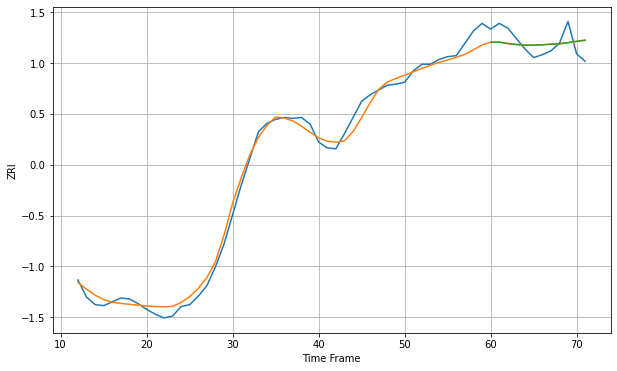

Wall time: 10.5 s
22901 8.326238134882509 14.111059864607066 14.148181602370226 [1265.11490161 1265.24573775 1263.81968574 1262.73529292 1262.20904454
 1262.01426507 1262.49686558 1263.07962605 1263.56702619 1264.75262744
 1266.14338044 1267.4210305 ]

Got an mse at 0.0050 in round 113 and stopped training

60 60 12


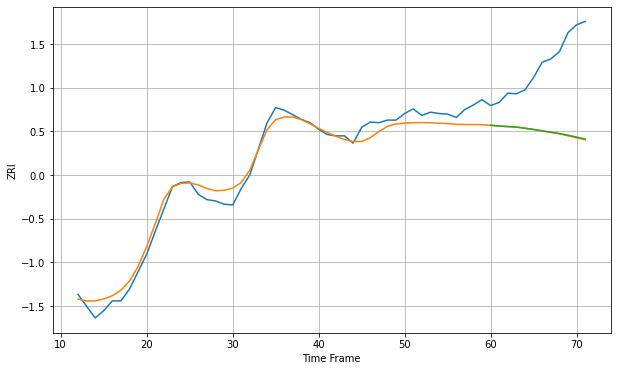

Wall time: 8.62 s
22903 14.7680180199957 109.04117593702486 108.52268022557567 [1398.07754813 1396.94086768 1396.10840461 1395.34738536 1393.6545782
 1391.78526855 1389.70361693 1387.59555202 1385.5570953  1383.04173619
 1380.05574926 1377.18163528]
60 60 12


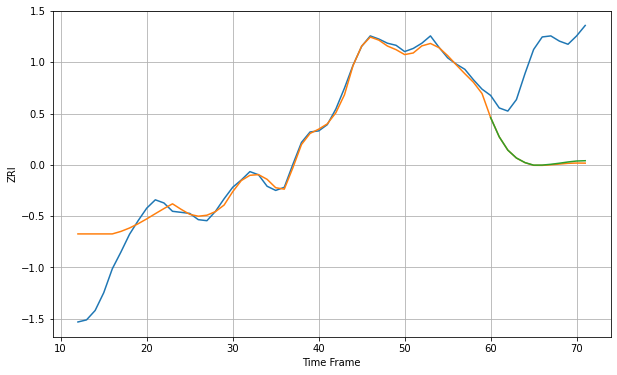

Wall time: 19.2 s
23220 22.710196566735746 97.8146506778697 97.04987957389594 [1133.74800439 1115.32073701 1102.60151621 1095.04473162 1090.64917671
 1088.19995319 1088.26224711 1089.03470537 1090.06223131 1091.2449214
 1092.16841116 1092.45259677]

Got an mse at 0.0049 in round 133 and stopped training

60 60 12


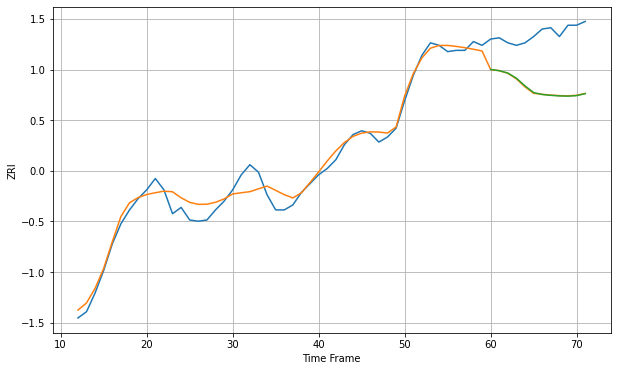

Wall time: 9.6 s
23223 7.750634146802659 43.9489072212016 43.93772947074288 [1118.78666934 1117.84146429 1115.93790163 1111.84022028 1105.69798564
 1100.42259276 1098.86169503 1098.20440668 1097.75140313 1097.56652251
 1097.98296301 1099.54394744]

Got an mse at 0.0049 in round 98 and stopped training

60 60 12


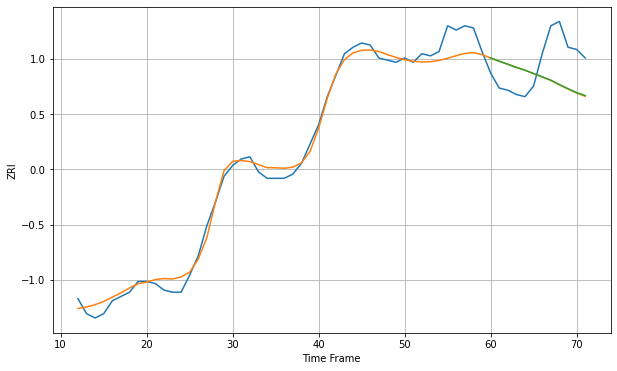

Wall time: 8.84 s
23294 4.904845077889863 16.912986570945517 16.828777450098737 [1080.00756298 1078.49471469 1077.07645184 1075.63280479 1074.28676795
 1072.76376805 1071.24952067 1069.6502005  1067.60877458 1065.7020202
 1063.90707507 1062.5217819 ]

Got an mse at 0.0049 in round 201 and stopped training

60 60 12


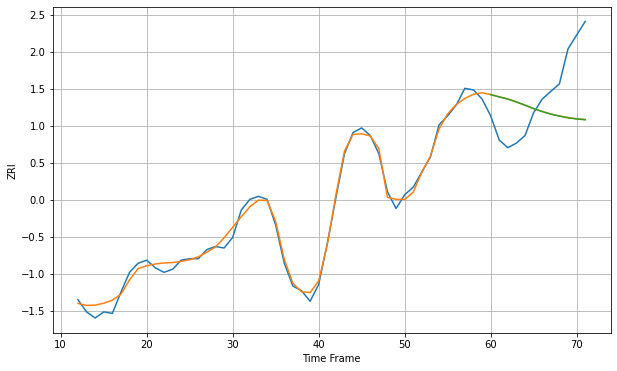

Wall time: 11.9 s
23451 3.8243681828877776 33.06446424715107 33.132691551910014 [1200.89610132 1199.40284786 1197.99114539 1196.06699999 1193.91921445
 1191.68244491 1189.76400088 1188.08244752 1186.76925985 1185.66113781
 1184.87510516 1184.36272537]

Got an mse at 0.0049 in round 220 and stopped training

60 60 12


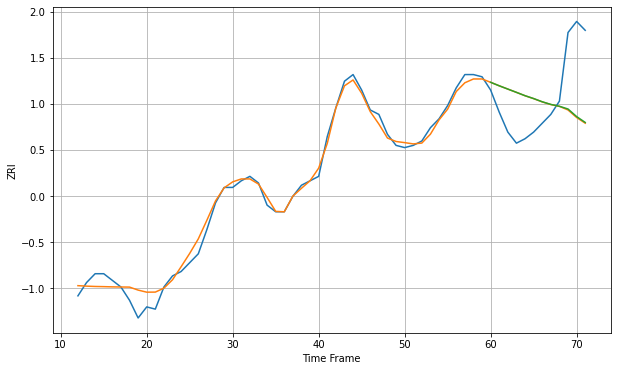

Wall time: 11.3 s
23452 3.5655517413901228 23.5473847568333 23.385923213489907 [1200.49744675 1198.92650263 1197.44353368 1195.96564736 1194.45608578
 1193.16369812 1191.71355322 1190.51346546 1189.66857745 1188.44091815
 1185.02142793 1182.37372863]

Got an mse at 0.0050 in round 95 and stopped training

60 60 12


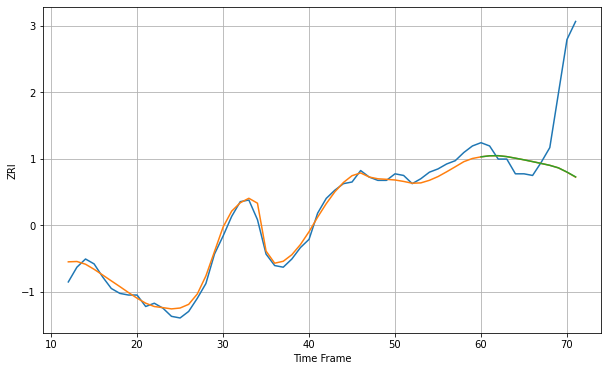

Wall time: 8.45 s
23454 4.0364583941340095 38.855208909800226 38.815347509338494 [1153.36026828 1154.00711022 1154.07127204 1153.4931904  1152.53832272
 1151.53483457 1150.44716398 1149.32473205 1148.17514671 1146.62959527
 1144.062941   1141.12954733]

Got an mse at 0.0050 in round 150 and stopped training

60 60 12


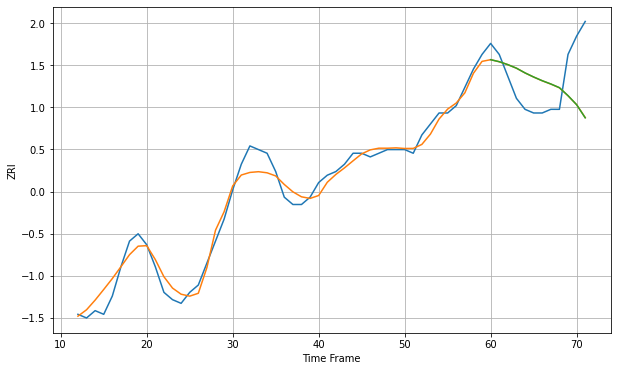

Wall time: 8.78 s
23503 2.8130177195344257 11.632701680414604 11.651019185894828 [828.55932828 828.00529906 827.20444025 826.24180495 824.95229334
 823.83328761 822.81642917 821.92607305 820.91444438 818.73390361
 816.2662375  812.67967028]

Got an mse at 0.0050 in round 277 and stopped training

60 60 12


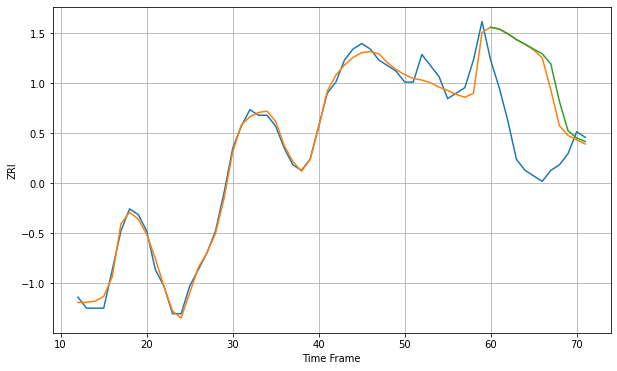

Wall time: 11.6 s
23518 1.5599742053339374 14.976222502385797 15.761536787312563 [829.95407792 829.62537619 828.7689333  827.721508   826.88435525
 825.99731328 825.15075494 823.29102526 816.50299862 811.17645304
 809.87678775 809.23509086]

Got an mse at 0.0049 in round 154 and stopped training

60 60 12


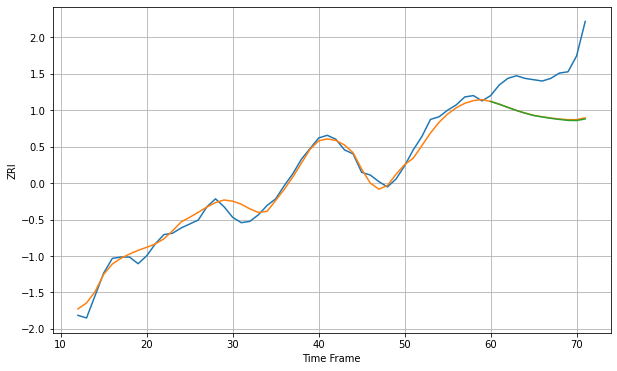

Wall time: 8.78 s
23602 5.234095410261083 34.84984977008982 35.17255035446233 [998.56417543 996.47339275 994.1008885  991.77374671 989.75850272
 987.98573727 986.86678197 985.82517768 984.99408981 984.25847692
 984.15829236 985.37100019]

Got an mse at 0.0050 in round 87 and stopped training

60 60 12


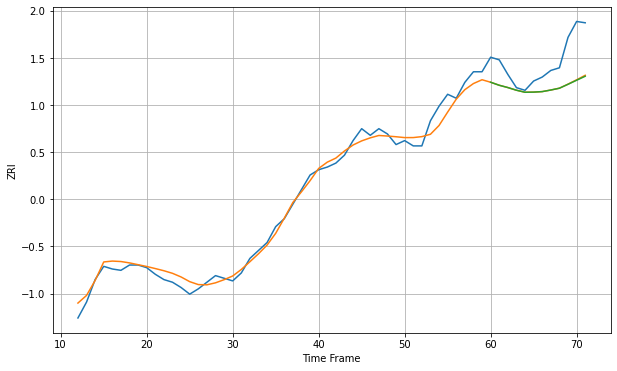

Wall time: 7.47 s
23666 5.7366786317770835 22.8029088791276 22.98524384535786 [1053.08676612 1050.79846537 1049.07073895 1047.04818172 1045.5190713
 1045.62474467 1046.01334379 1047.20904811 1048.57392962 1051.53547047
 1054.5887011  1057.61224007]

Got an mse at 0.0050 in round 323 and stopped training

60 60 12


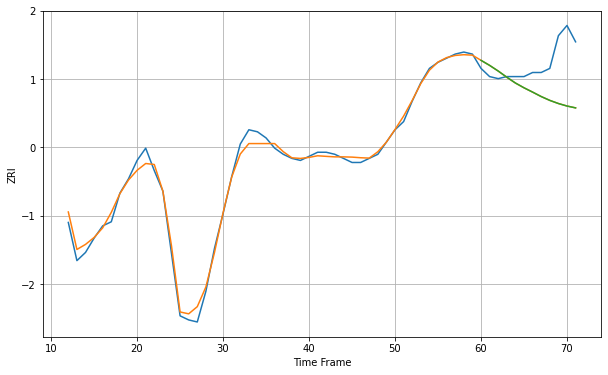

Wall time: 13.1 s
23803 2.9785621266464353 18.860762610524898 18.864601375462364 [925.94563507 923.47827794 920.7123353  917.69914328 914.86430719
 912.52171696 910.41464338 908.24075566 906.36213987 904.8300884
 903.60040494 902.69040595]

Got an mse at 0.0049 in round 148 and stopped training

60 60 12


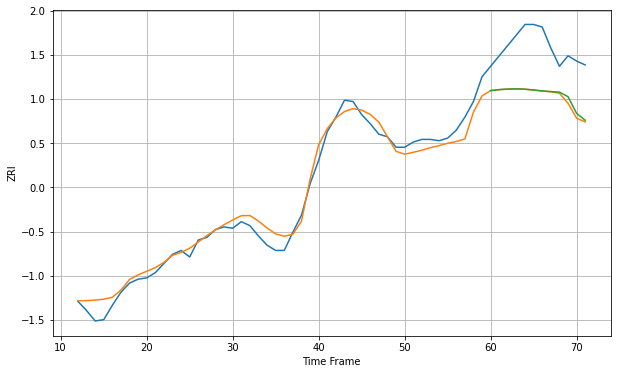

Wall time: 8.85 s
23831 7.534143872176065 38.64059086482317 37.738652982444 [1085.38345003 1086.13656756 1086.51011554 1086.70874958 1086.45241304
 1085.84754291 1085.10550798 1084.61050757 1084.19606578 1080.7343575
 1067.8899387  1062.64290798]

Got an mse at 0.0050 in round 215 and stopped training

60 60 12


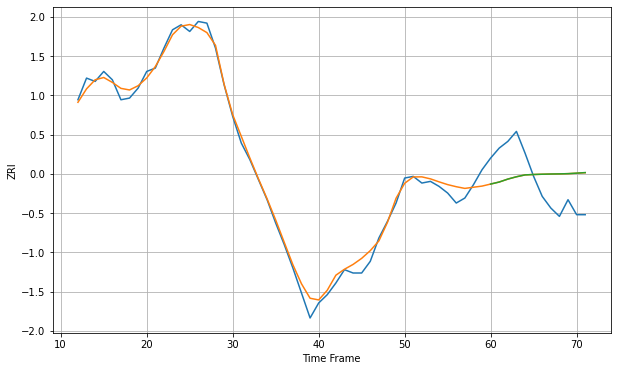

Wall time: 10.4 s
26003 4.339740981195403 20.061894273365304 20.073548811671248 [816.39353516 817.62133268 819.37736603 820.77718038 821.88980648
 822.13256834 822.29685997 822.42326928 822.50063317 822.63984584
 822.94701045 823.28506164]

Got an mse at 0.0050 in round 442 and stopped training

60 60 12


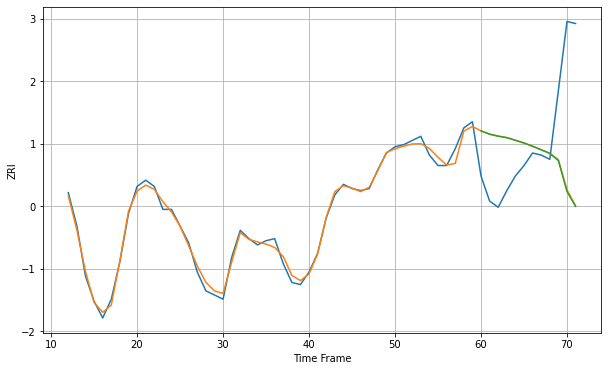

Wall time: 15.5 s
26505 2.3012629654174623 39.7490625924863 39.962999325209104 [959.60485393 958.0202186  957.06154599 956.35400559 955.09321519
 953.78636734 952.22574382 950.52346919 948.82143063 945.36243106
 930.51869644 923.44732579]

Got an mse at 0.0050 in round 89 and stopped training

60 60 12


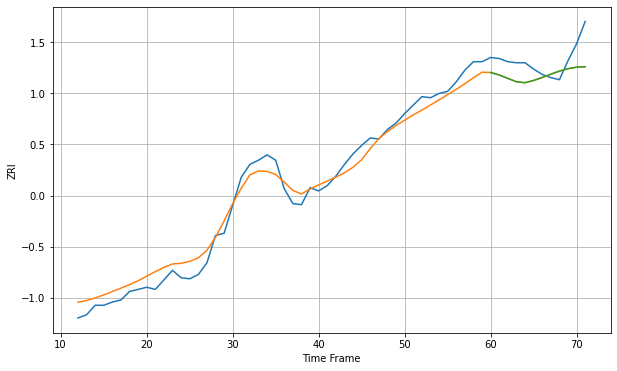

Wall time: 7.27 s
27513 10.15712129306693 18.142208146901943 18.110353227471958 [1186.796542   1184.44949026 1181.24872577 1178.06644156 1177.15726411
 1179.32483957 1182.13670342 1185.29735166 1188.16608908 1190.44113138
 1191.90229511 1192.31114678]

Got an mse at 0.0050 in round 223 and stopped training

60 60 12


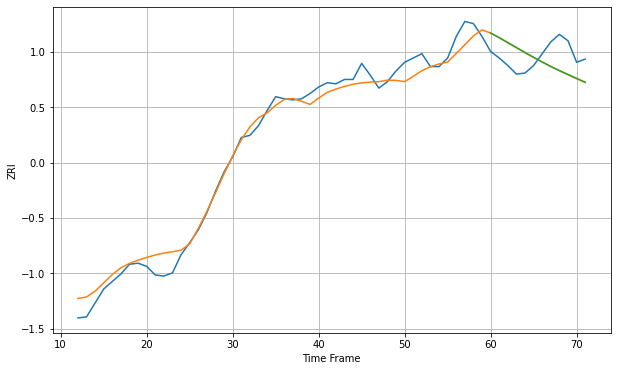

Wall time: 10.4 s
27560 10.237340926182874 21.546751210359037 21.471506483191614 [1325.18262784 1320.89410549 1316.29850789 1311.66733052 1307.04244695
 1302.61313507 1298.25628515 1294.12498695 1290.26102122 1286.59528566
 1283.01332108 1279.43632075]

Got an mse at 0.0050 in round 97 and stopped training

60 60 12


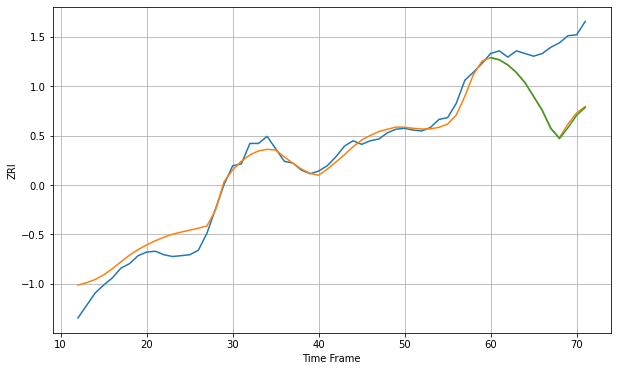

Wall time: 7.48 s
27606 12.557199347171487 67.35836846306528 68.27338811455242 [1192.3209056  1190.01514346 1184.23459168 1175.64510616 1164.23762718
 1148.91115548 1133.35773424 1113.26513594 1101.34861446 1113.77645745
 1127.64047255 1136.32949516]

Got an mse at 0.0048 in round 59 and stopped training

60 60 12


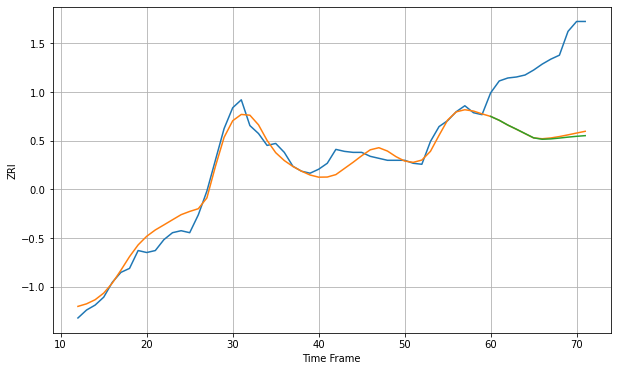

Wall time: 6.37 s
27609 10.167203273921723 76.3091449859441 77.75747896388542 [1110.25984644 1106.34737561 1101.52747034 1097.34820506 1092.99161342
 1088.64580728 1087.21641257 1087.58715796 1088.41063842 1089.3661989
 1090.18894578 1090.85176294]

Got an mse at 0.0049 in round 78 and stopped training

60 60 12


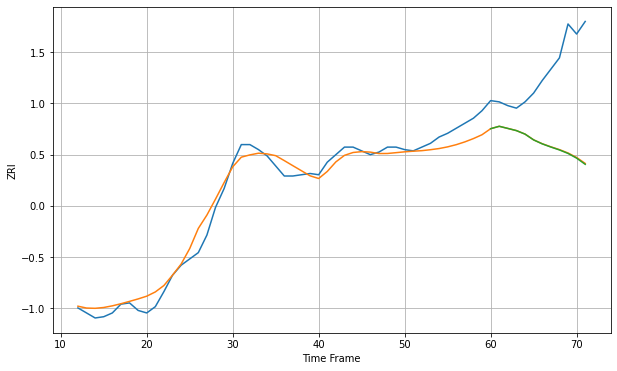

Wall time: 7.12 s
27612 8.288763947215704 63.37839515835413 63.6546013249331 [1077.64369118 1079.56091368 1077.85471445 1076.11964157 1073.33219025
 1068.72311455 1065.58083058 1063.07129656 1060.74868217 1057.95637868
 1054.2166459  1049.2955414 ]

Got an mse at 0.0050 in round 50 and stopped training

60 60 12


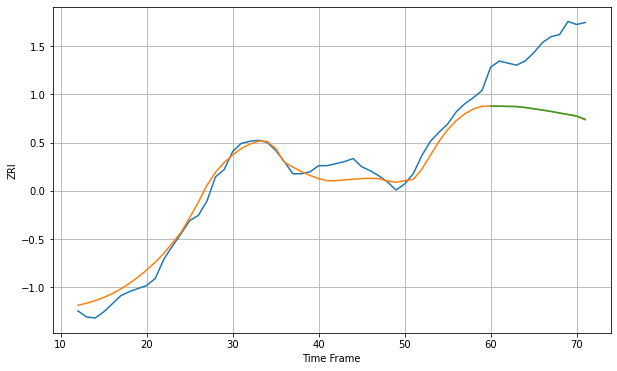

Wall time: 6.08 s
27613 10.100126223489855 66.84440315262971 66.67219161323837 [1109.68590413 1109.54455841 1109.3543656  1109.23513507 1108.25454895
 1107.00921405 1105.78693634 1104.45632955 1102.92404772 1101.45707872
 1099.9454074  1096.72471233]

Got an mse at 0.0049 in round 113 and stopped training

60 60 12


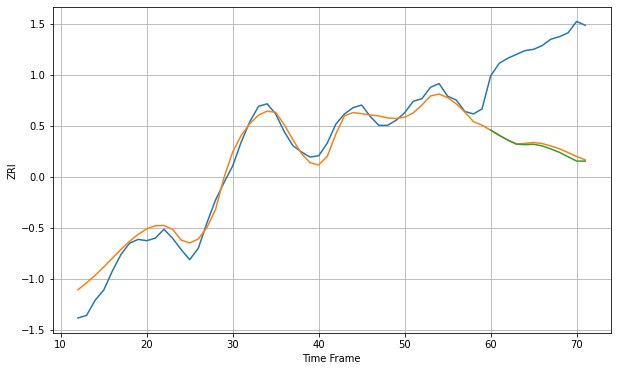

Wall time: 7.57 s
27615 8.857062860728153 80.35118590358289 81.98835066810396 [1087.23270509 1083.14305404 1079.37830235 1076.23962028 1075.76771154
 1076.09655412 1074.7717894  1072.39936916 1069.72241028 1066.23879173
 1062.82460289 1062.78470748]

Got an mse at 0.0049 in round 144 and stopped training

60 60 12


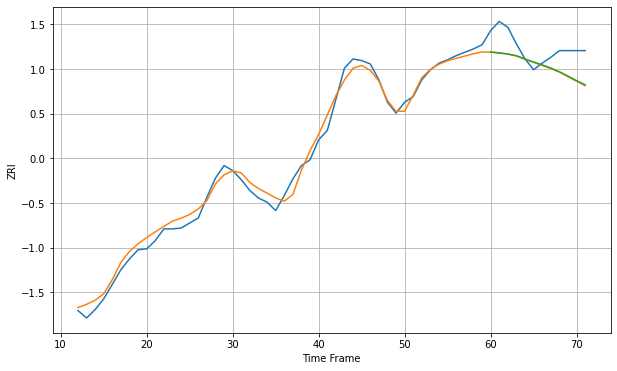

Wall time: 8.74 s
27703 9.035307780087933 26.437357131648863 26.055245354657476 [1094.1982373  1093.27077183 1091.94141197 1089.83656872 1085.92991794
 1082.35540419 1078.84583699 1075.11474726 1070.67138841 1065.35324666
 1059.95136586 1054.88475317]

Got an mse at 0.0050 in round 111 and stopped training

60 60 12


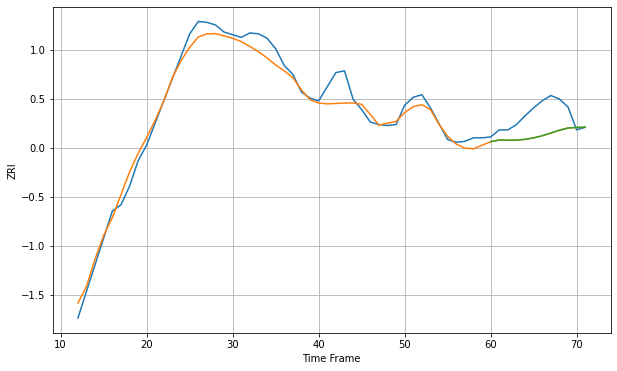

Wall time: 7.97 s
27705 12.172537688761107 25.325520699834232 25.32216642873716 [1207.60797424 1209.51433313 1209.30499833 1209.37551058 1210.26412416
 1211.94083185 1214.35471252 1217.40731468 1220.65124812 1223.16495538
 1223.78794853 1224.13875239]

Got an mse at 0.0049 in round 86 and stopped training

60 60 12


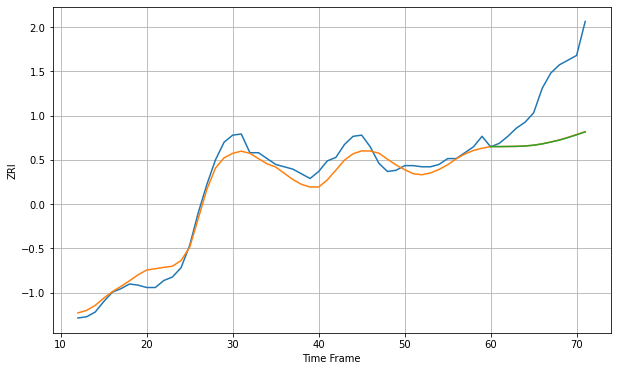

Wall time: 7.35 s
27707 8.630964962773499 49.19924591005156 49.30458851854581 [1040.28680759 1040.22880923 1040.31910202 1040.41966324 1040.7338588
 1041.41484219 1042.53194803 1044.09381045 1045.75359094 1047.90732387
 1050.28044617 1052.82543165]

Got an mse at 0.0050 in round 96 and stopped training

60 60 12


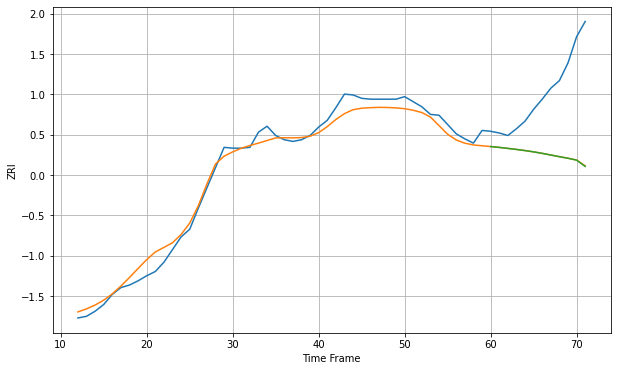

Wall time: 7.17 s
27713 10.44891961570231 85.12925890828845 85.28064278312856 [1041.91969878 1040.92232447 1039.75112327 1038.52130725 1037.15942484
 1035.63334223 1033.86391724 1031.89683297 1029.90591558 1028.04638565
 1025.77859488 1018.40279411]

Got an mse at 0.0049 in round 133 and stopped training

60 60 12


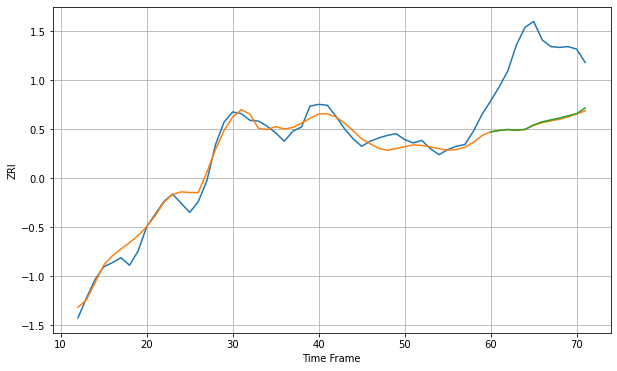

Wall time: 8.47 s
28202 10.717606411969179 87.0676198030198 86.36288169762716 [1497.13295012 1498.91137305 1499.99080691 1499.16575649 1500.15408894
 1505.43896025 1509.2187077  1511.49171925 1513.66939023 1516.32564127
 1518.99833672 1525.68546292]

Got an mse at 0.0050 in round 98 and stopped training

60 60 12


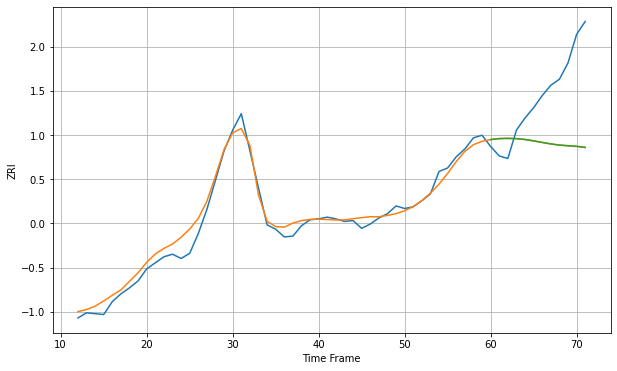

Wall time: 7.13 s
28210 9.58868073934882 73.16689126343002 73.05301378813058 [1276.98146614 1278.12728641 1278.35996096 1278.0225949  1277.09077345
 1275.50166819 1273.66462287 1271.94653736 1270.64185832 1269.87324678
 1269.18215368 1267.99631436]

Got an mse at 0.0050 in round 139 and stopped training

60 60 12


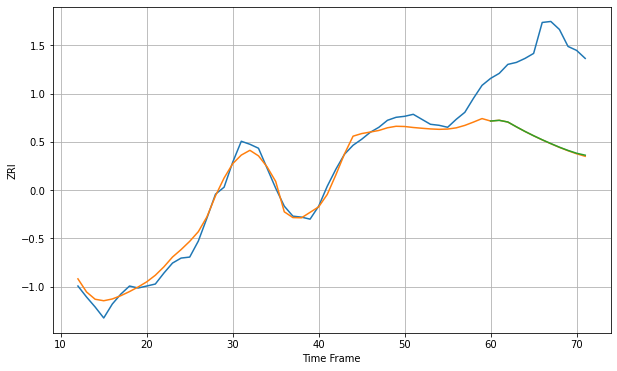

Wall time: 8.51 s
28216 9.422080685101811 90.24420138889273 90.00798437793567 [1235.26185307 1235.96616284 1234.29936653 1229.45155062 1224.84168138
 1220.54228729 1216.49892102 1212.69416625 1209.06846556 1205.82571418
 1203.00722465 1201.05478019]

Got an mse at 0.0050 in round 69 and stopped training

60 60 12


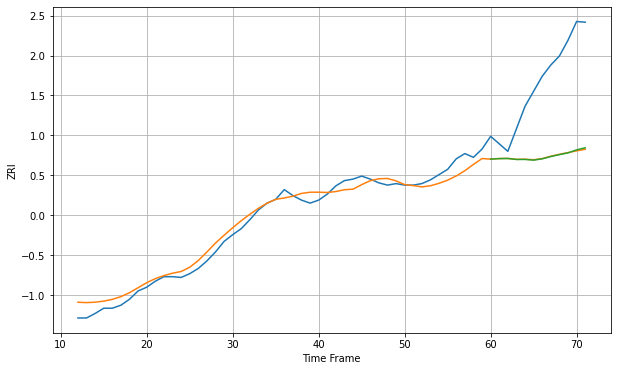

Wall time: 6.46 s
28262 10.550907758652354 108.41204158009454 108.20023362673255 [1052.67724306 1053.32502094 1053.50431574 1052.15992701 1052.21043781
 1051.27991093 1053.0150924  1056.07794113 1058.60837457 1060.91897248
 1064.95546161 1067.68855583]

Got an mse at 0.0050 in round 166 and stopped training

60 60 12


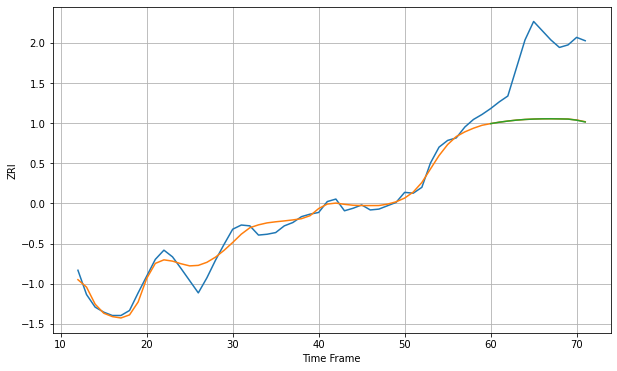

Wall time: 9.35 s
28269 9.211882581403804 82.84038270570433 82.91929111149344 [1138.05779551 1139.73850983 1141.10627479 1142.22797311 1143.00582976
 1143.48833708 1143.76555124 1143.82946505 1143.68781444 1143.4864261
 1142.17330439 1140.02295661]

Got an mse at 0.0050 in round 107 and stopped training

60 60 12


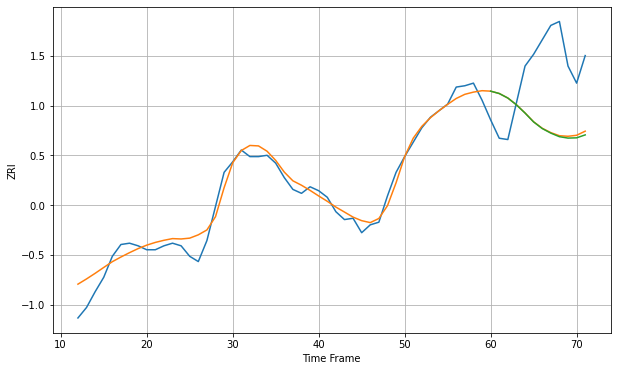

Wall time: 7.44 s
28273 8.291276350986688 52.549459093036134 53.24411750858285 [1215.88269279 1214.08438348 1210.63309353 1205.4718566  1199.2020444
 1192.4117325  1187.39367628 1183.89106258 1181.16995067 1180.10672938
 1180.30254245 1182.54964804]

Got an mse at 0.0049 in round 116 and stopped training

60 60 12


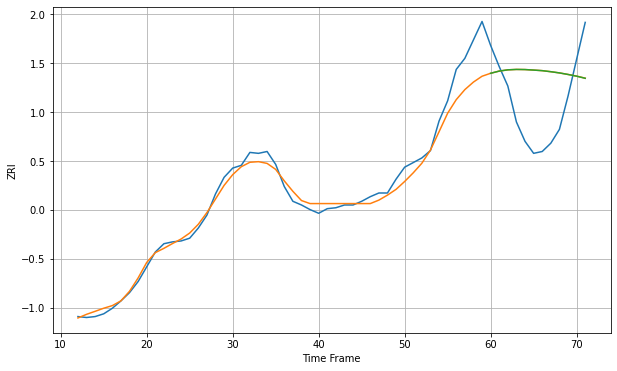

Wall time: 8.13 s
28277 14.405822747059757 58.229434029958725 58.24377420201143 [1379.81590409 1382.19198136 1383.54838305 1383.98978285 1383.84900057
 1383.28867677 1382.65535694 1381.52059834 1380.21008334 1378.53553795
 1376.68247682 1374.36564753]

Got an mse at 0.0049 in round 365 and stopped training

60 60 12


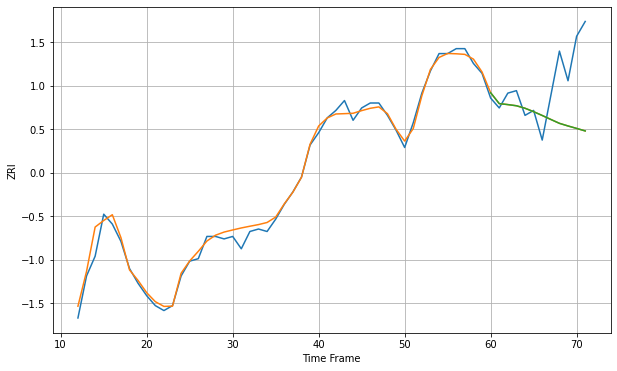

Wall time: 13.7 s
29205 2.893589243954154 20.01810848483522 20.01968762776709 [822.16032135 817.75705103 817.35635872 816.88547393 815.87665
 814.48857852 812.94987154 811.34309564 809.77185704 808.70586602
 807.71870477 806.69308635]

Got an mse at 0.0049 in round 79 and stopped training

60 60 12


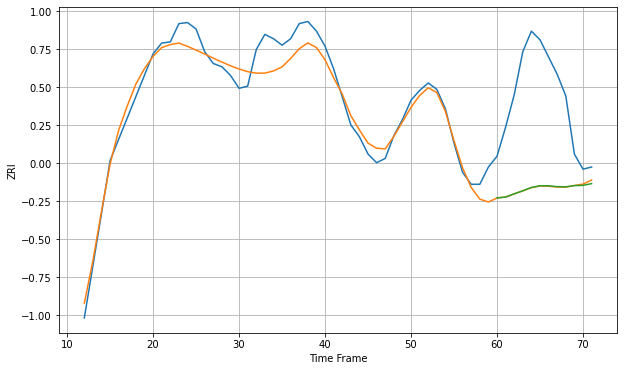

Wall time: 7.04 s
29403 13.77255129233422 93.06023679811884 92.9489435427844 [1784.30940129 1785.1638203  1788.13001972 1790.97765142 1794.04403708
 1795.62970817 1795.58927746 1794.81165816 1794.62296468 1795.79380433
 1795.96827392 1797.61806701]

Got an mse at 0.0049 in round 169 and stopped training

60 60 12


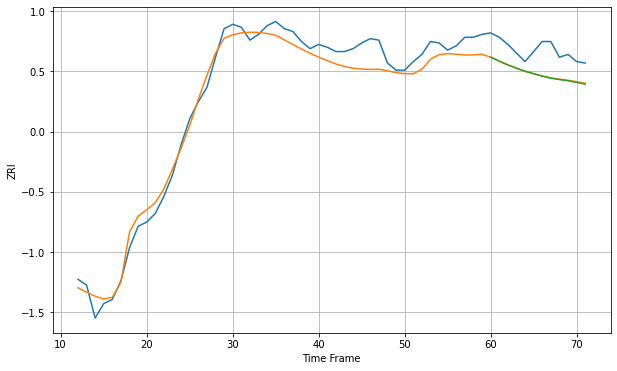

Wall time: 9.04 s
29414 9.041690018434643 16.694560574622543 16.88900497497471 [1315.1145489  1312.25229766 1309.6733428  1307.34245916 1305.22212744
 1303.46981164 1301.81866239 1300.38758829 1299.4309009  1298.60550223
 1297.44952431 1296.23206766]

Got an mse at 0.0048 in round 138 and stopped training

60 60 12


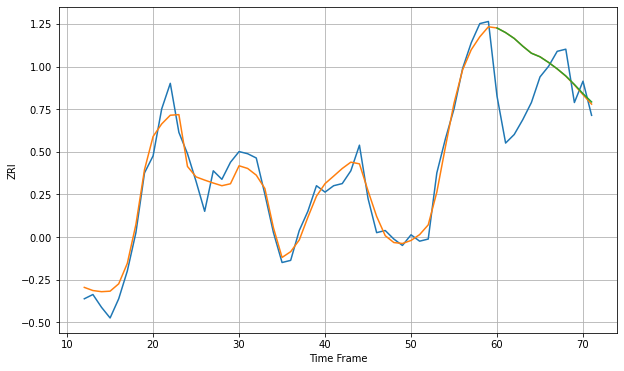

Wall time: 8.28 s
29464 6.2354765302655535 25.67215042181847 25.673146487320768 [1570.94073674 1568.7847399  1566.04322937 1562.39101683 1559.1133654
 1557.436374   1554.78706169 1551.79698158 1548.46930973 1544.4760415
 1540.18602305 1536.27703632]

Got an mse at 0.0049 in round 85 and stopped training

60 60 12


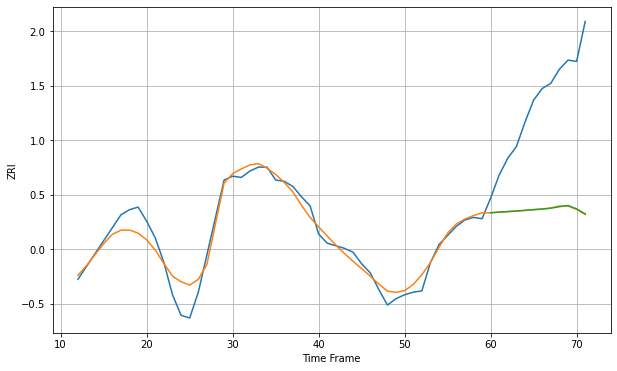

Wall time: 7.27 s
29607 8.71838124985581 88.91618459300726 88.83018946637145 [1002.61455009 1003.08714134 1003.53325481 1003.95395181 1004.47663897
 1005.02571821 1005.48600231 1006.16845905 1007.31837941 1008.2280516
 1005.62136057 1001.72943147]

Got an mse at 0.0049 in round 125 and stopped training

60 60 12


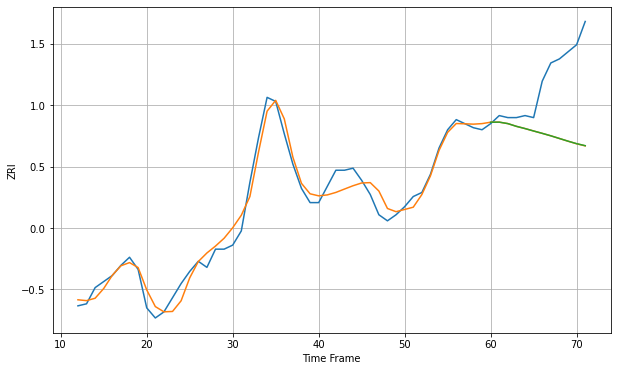

Wall time: 8.49 s
29615 5.253399324864541 31.297283415520145 31.26610119199445 [1004.72427674 1004.75814778 1004.03710559 1002.67990121 1001.58773402
 1000.38410651  999.22299912  998.00834438  996.68424525  995.36253313
  994.12872076  993.13742111]

Got an mse at 0.0050 in round 169 and stopped training

60 60 12


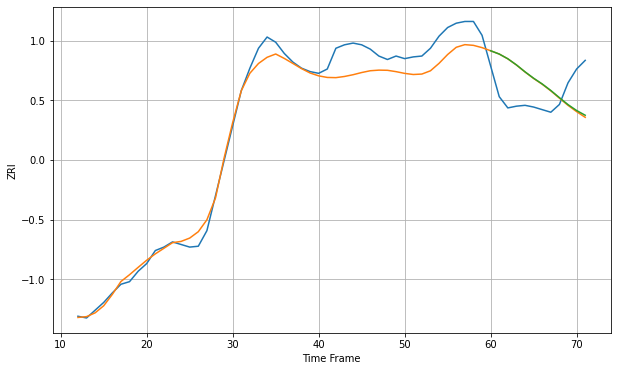

Wall time: 9.17 s
30024 17.35503853373197 40.60206901229211 40.22384775809907 [1462.10901888 1458.31658329 1452.8426379  1445.7630341  1437.75428492
 1430.33147033 1423.70285948 1416.15755359 1407.87061044 1399.81221364
 1392.99166121 1387.50445892]

Got an mse at 0.0050 in round 58 and stopped training

60 60 12


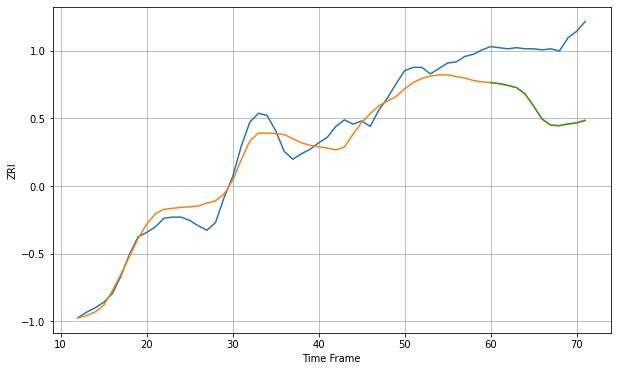

Wall time: 6.57 s
30043 12.939384882267237 60.571191762027496 60.6025518790827 [1268.11916179 1267.14071071 1265.50260705 1263.54552032 1257.7836531
 1246.72164344 1234.7285938  1229.19627332 1228.68855713 1230.09640105
 1231.10761532 1233.32290027]

Got an mse at 0.0050 in round 102 and stopped training

60 60 12


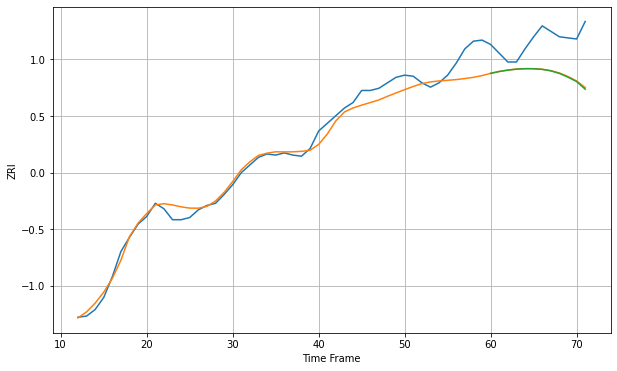

Wall time: 7.66 s
30044 10.339791000448256 32.34050837616261 32.75066306575554 [1117.63603928 1119.3241564  1120.59637752 1121.46776161 1121.88324242
 1121.84035179 1121.25241712 1119.90422174 1117.5669459  1114.13542674
 1110.13716823 1103.15332451]

Got an mse at 0.0049 in round 121 and stopped training

60 60 12


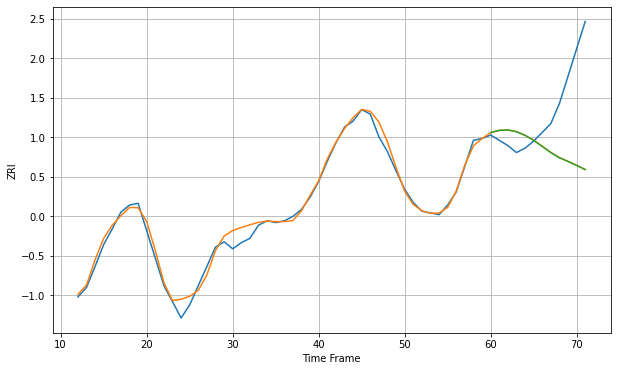

Wall time: 7.95 s
30046 7.457397163797546 72.00005920958868 72.04735053691006 [1057.802149   1060.32919697 1060.80013975 1058.83444516 1054.64296395
 1048.94431703 1042.01938226 1034.92318341 1029.04091053 1024.81384628
 1020.2920339  1015.55525712]

Got an mse at 0.0050 in round 81 and stopped training

60 60 12


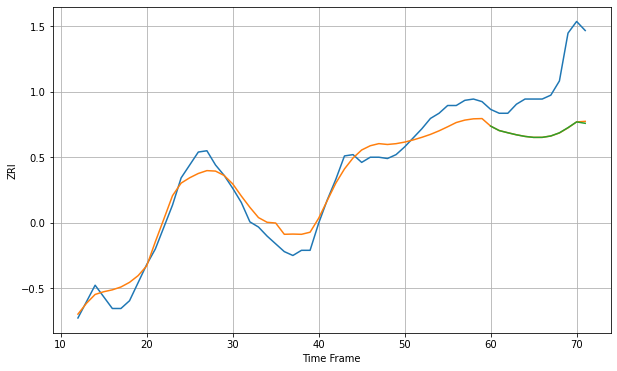

Wall time: 7.51 s
30080 10.246744242639174 43.479164772574585 43.65301637567542 [1238.06295411 1234.61021268 1232.92317872 1231.34547971 1230.08464519
 1229.33606743 1229.35780706 1230.43461575 1232.86860645 1236.87901551
 1241.31976714 1240.22936388]

Got an mse at 0.0050 in round 74 and stopped training

60 60 12


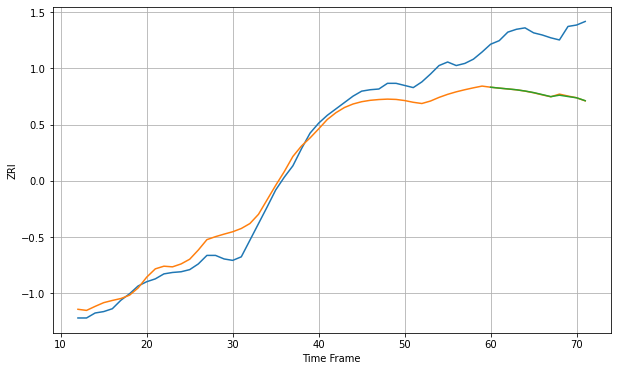

Wall time: 7 s
30093 22.595779387967124 86.14133914458967 86.207884649765 [1104.53129634 1103.25847274 1102.12654467 1100.9407447  1099.19921857
 1096.99278571 1094.17012073 1091.26678137 1093.32985343 1091.426839
 1089.64909312 1085.57379881]

Got an mse at 0.0050 in round 104 and stopped training

60 60 12


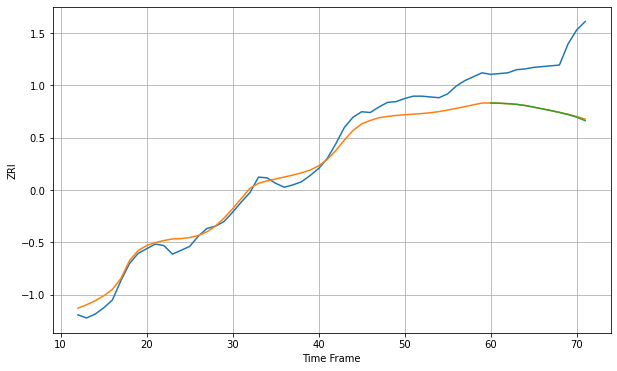

Wall time: 7.6 s
30096 15.70609027383903 69.12301756414351 69.60250168444745 [1240.26840476 1239.95028451 1239.36791319 1238.5304302  1237.01053806
 1234.92591892 1232.73569485 1230.47049635 1228.07991691 1225.38272196
 1222.04799024 1217.4773235 ]

Got an mse at 0.0050 in round 50 and stopped training

60 60 12


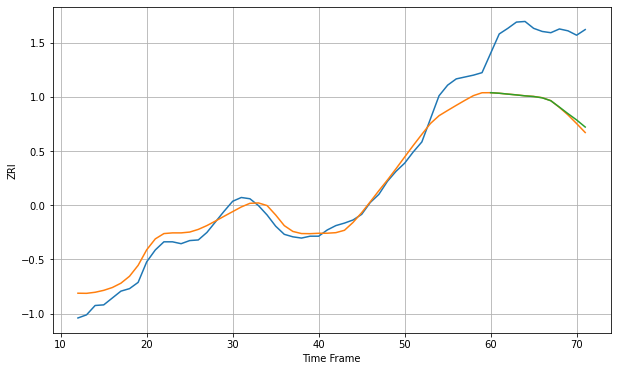

Wall time: 6.38 s
30097 19.14752106194806 118.3517853775998 116.60230483513264 [1444.89535175 1444.00740464 1442.6262843  1441.32648255 1439.79675932
 1438.74259804 1436.6781564  1432.0228471  1421.77496631 1411.28390569
 1401.22998703 1389.87269119]

Got an mse at 0.0049 in round 166 and stopped training

60 60 12


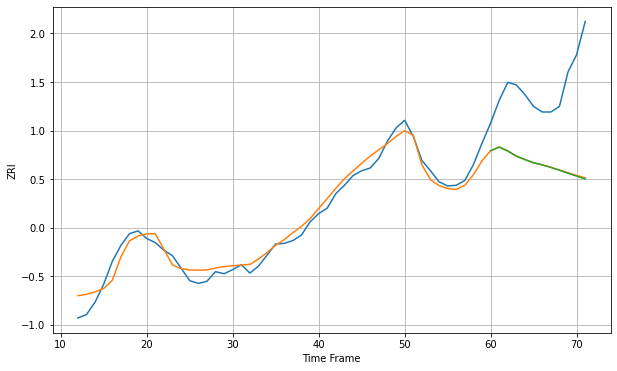

Wall time: 9.28 s
30305 12.903551391199972 117.57418605472904 118.0491850105812 [1689.91235977 1695.3478455  1689.57414633 1682.12897239 1677.15141488
 1672.50524764 1669.4702194  1665.81013777 1661.68648386 1657.33994818
 1653.24708681 1649.14187769]

Got an mse at 0.0049 in round 103 and stopped training

60 60 12


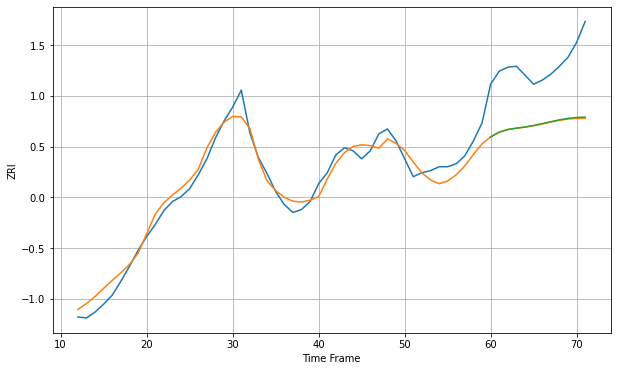

Wall time: 7.46 s
30306 10.545377645514202 61.38337382699801 60.95899364425796 [1438.98754069 1443.72290544 1446.39004665 1447.80766569 1448.91958101
 1450.43019377 1452.25823841 1454.27283424 1456.12572532 1457.6058896
 1458.51373753 1458.88861653]

Got an mse at 0.0050 in round 86 and stopped training

60 60 12


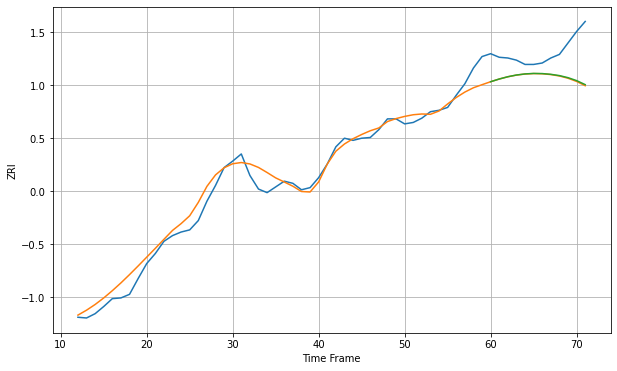

Wall time: 7.22 s
30308 14.0207734627092 41.76416149526875 41.17498635890732 [1611.88003888 1615.64504017 1618.83401879 1621.22451871 1622.75941581
 1623.44380655 1623.2369204  1622.21395897 1620.42599509 1617.52878677
 1613.41938492 1607.80149894]

Got an mse at 0.0050 in round 128 and stopped training

60 60 12


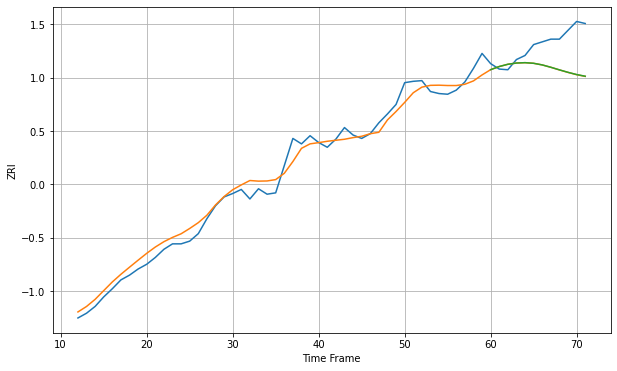

Wall time: 7.98 s
30309 13.966494144437052 42.78866980446862 42.68833766799304 [1647.10784748 1651.74322596 1655.04014136 1656.87671328 1657.41094792
 1656.48687407 1654.11428069 1650.65685192 1646.83566431 1643.21510412
 1639.95488411 1637.48401882]

Got an mse at 0.0050 in round 241 and stopped training

60 60 12


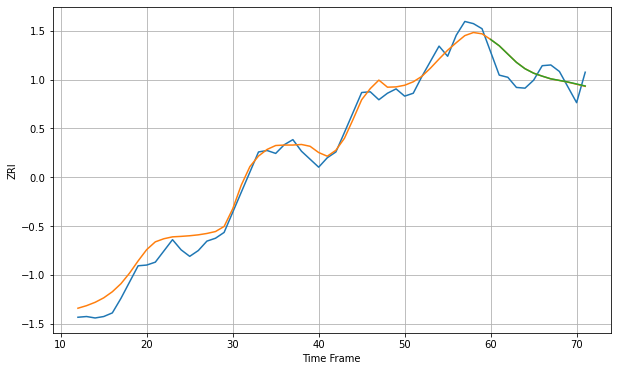

Wall time: 10.8 s
30310 14.665077282338277 23.77274304182803 23.738064975048154 [1179.19481308 1170.46728366 1158.98597217 1147.59088435 1138.76836068
 1132.65452063 1128.5616963  1124.87881565 1122.69869936 1120.47284081
 1117.76851098 1114.9932503 ]

Got an mse at 0.0049 in round 98 and stopped training

60 60 12


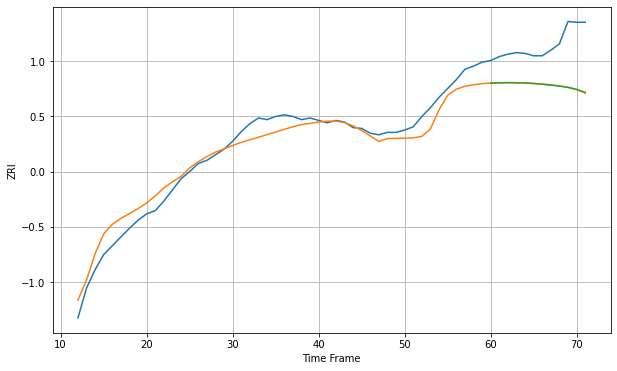

Wall time: 7.62 s
30318 15.136919924447763 53.90700515364412 53.81517743039277 [1416.75957118 1417.1780685  1417.34799977 1417.2398873  1416.93591437
 1416.28347715 1415.38120825 1414.25946687 1412.98016803 1411.36935362
 1408.96669744 1405.13789546]

Got an mse at 0.0050 in round 40 and stopped training

60 60 12


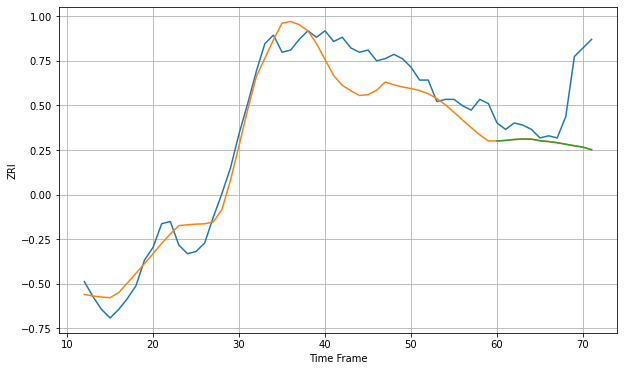

Wall time: 6.54 s
30319 10.511481095217958 24.006666174657873 24.03753974149001 [1559.55101374 1559.87001483 1560.27488982 1560.5036269  1560.4435188
 1559.68452928 1559.31159201 1558.77335018 1558.06575286 1557.33713072
 1556.68322734 1555.5116795 ]

Got an mse at 0.0050 in round 85 and stopped training

60 60 12


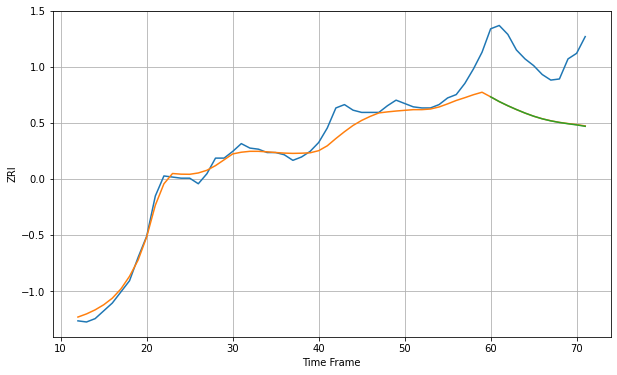

Wall time: 7.2 s
30324 9.961953835678097 56.322429879014976 56.40323368519118 [1468.97480347 1464.72148427 1461.00246775 1457.58876521 1454.42453828
 1451.60967355 1449.26745021 1447.42527444 1445.96726338 1444.83156663
 1443.78577812 1442.53515026]

Got an mse at 0.0049 in round 74 and stopped training

60 60 12


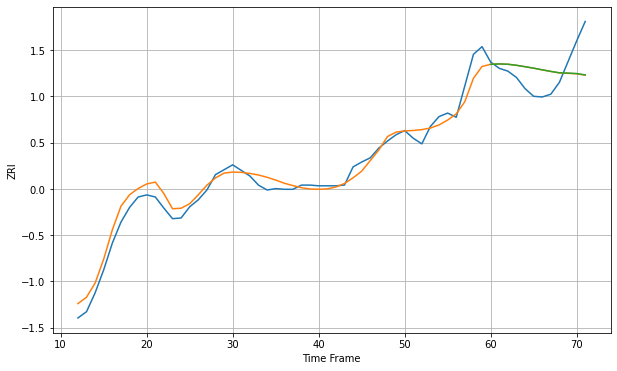

Wall time: 7.01 s
30326 13.797757473506445 34.33187483093895 34.24250982306502 [1653.7235912  1654.26378477 1653.82913725 1652.32526028 1650.3250885
 1648.22367815 1645.86063891 1643.60074355 1641.59137121 1641.1335573
 1640.52524494 1638.58537152]

Got an mse at 0.0050 in round 60 and stopped training

60 60 12


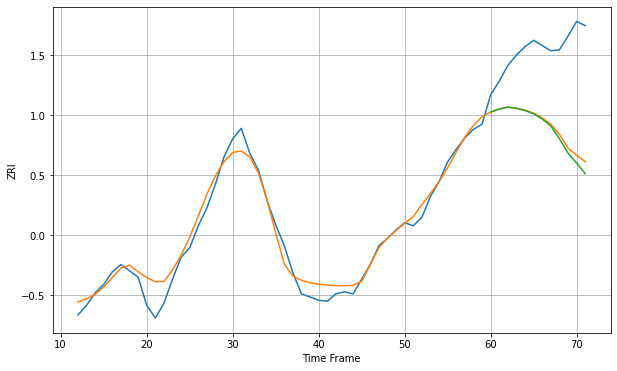

Wall time: 6.74 s
30328 10.728618289472621 78.73363505015779 82.53151976696824 [1521.51501682 1524.44854959 1526.19994814 1525.05748609 1523.00439384
 1519.86018788 1514.88521002 1508.19423033 1496.28605753 1482.31635584
 1472.89222851 1462.70068955]

Got an mse at 0.0050 in round 58 and stopped training

60 60 12


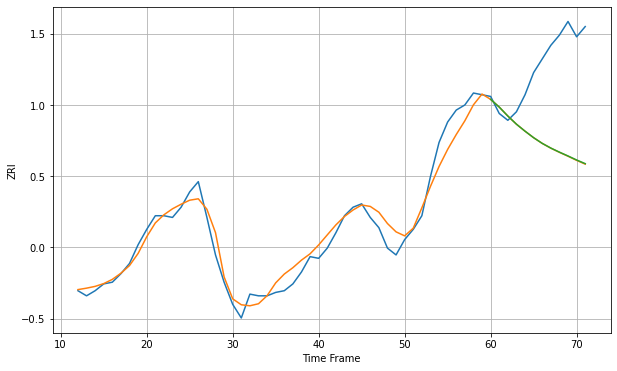

Wall time: 6.52 s
30329 7.040427220382121 50.70666405752486 50.602053086576994 [1481.28234042 1476.75531094 1471.51252483 1466.71994074 1462.61502997
 1458.79260503 1455.46366694 1452.70264274 1450.30473778 1448.06419873
 1445.71888097 1443.56837027]

Got an mse at 0.0049 in round 144 and stopped training

60 60 12


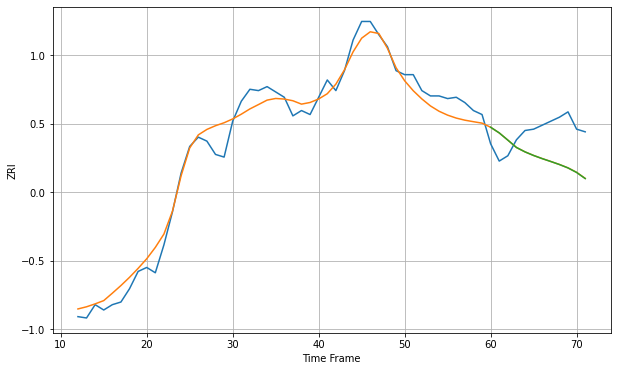

Wall time: 8.26 s
30338 9.643038436920987 26.289471004595697 26.330104062289504 [1439.43516699 1435.18493435 1429.77002141 1424.23214885 1420.91530221
 1418.20631871 1415.84664941 1413.67143123 1411.41258217 1408.83540674
 1405.43285778 1400.84178915]

Got an mse at 0.0050 in round 109 and stopped training

60 60 12


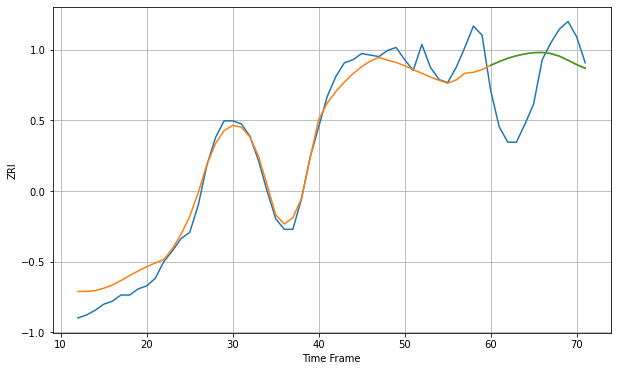

Wall time: 7.77 s
30339 9.915556660298865 32.78073782563544 32.80934065995417 [1393.30309447 1395.75472213 1397.92758117 1399.56340109 1400.82124759
 1401.63159916 1401.76805636 1401.04573542 1399.31493058 1396.61468734
 1393.7132035  1391.27585056]

Got an mse at 0.0049 in round 121 and stopped training

60 60 12


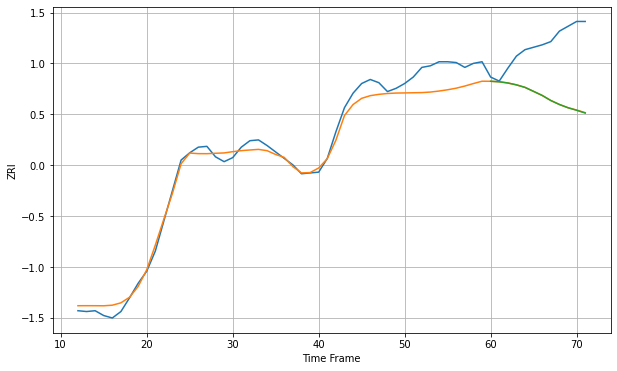

Wall time: 8.24 s
30341 14.936378206516105 70.43342495881735 70.53098983368353 [1353.76389325 1353.15019927 1351.66255187 1349.30953223 1346.17513569
 1341.200445   1336.16527717 1329.90012214 1324.96285081 1320.94554077
 1317.78235928 1314.32419965]

Got an mse at 0.0050 in round 134 and stopped training

60 60 12


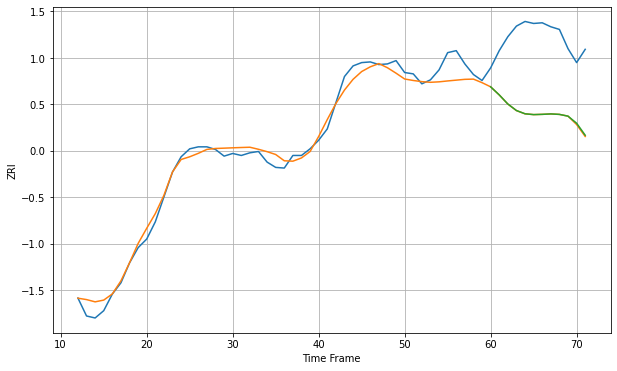

Wall time: 8.44 s
30345 14.522344526962295 115.15495192193676 114.8113354920052 [1461.47598183 1449.29003795 1435.61565976 1425.74761178 1420.81540405
 1419.59071107 1419.97248427 1420.61909393 1419.91902797 1417.2437464
 1406.62857944 1388.50131029]

Got an mse at 0.0050 in round 81 and stopped training

60 60 12


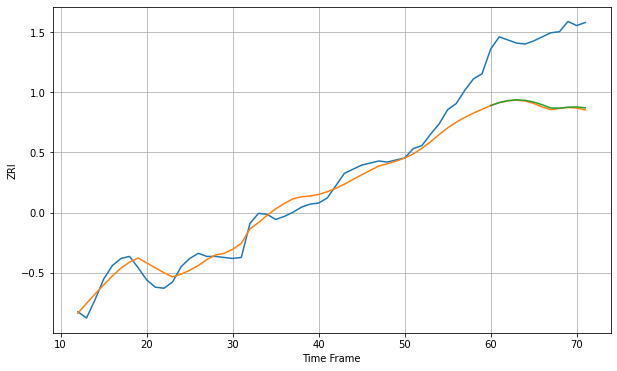

Wall time: 7.32 s
30350 12.200236666432524 69.00217574654157 68.15953800224395 [1297.04719348 1299.8964452  1301.77789942 1302.63481557 1302.14550261
 1300.49995882 1297.81156157 1294.69750289 1294.46727762 1295.4288615
 1295.72835734 1294.81140435]

Got an mse at 0.0050 in round 135 and stopped training

60 60 12


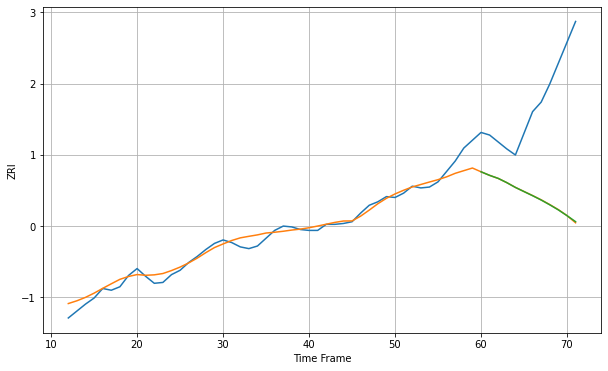

Wall time: 8.09 s
30605 8.763014405533045 121.56797902884662 121.4646892761024 [856.62431371 852.49778086 848.98528593 844.09485726 838.58219263
 833.79385058 829.04067191 824.03102664 818.50020628 812.62245922
 806.0145155  799.08703714]

Got an mse at 0.0050 in round 135 and stopped training

60 60 12


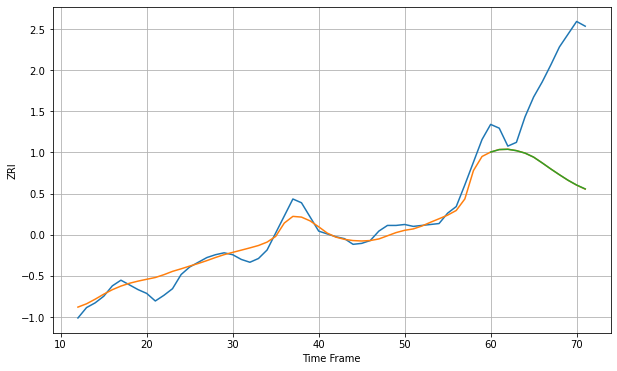

Wall time: 8.04 s
30606 9.45587294143494 103.4899408107397 103.44958863995159 [941.67653192 944.32756826 944.63232557 943.17597597 940.59585085
 936.32282657 930.19464632 923.79271148 917.69973502 911.87164033
 906.78361683 902.66072375]

Got an mse at 0.0050 in round 270 and stopped training

60 60 12


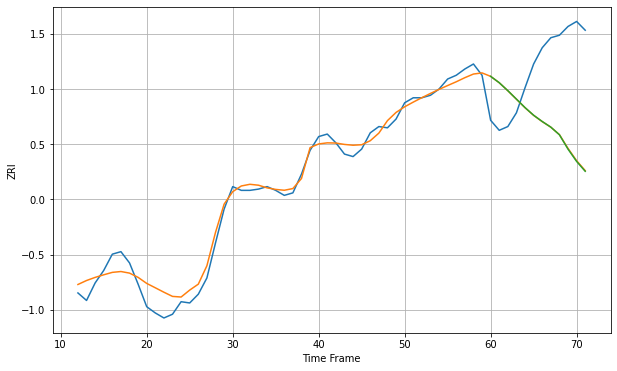

Wall time: 12 s
31401 8.300143926965992 67.6698272201644 67.88659476781379 [1385.13176237 1380.04243322 1373.67716283 1366.9284323  1360.15648427
 1354.04987673 1349.04175986 1344.53637021 1338.43817732 1326.96000151
 1317.14101437 1309.24190677]
60 60 12


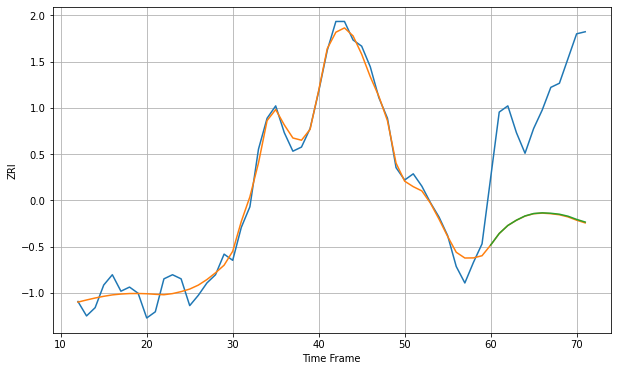

Wall time: 17.3 s
32204 5.1355483467022225 61.54159879041916 61.34523897885881 [ 992.39261841  998.03131791 1001.91880713 1004.49562951 1006.54253236
 1007.71890236 1008.06000371 1007.84998732 1007.39062783 1006.42150583
 1004.87649511 1003.58523332]

Got an mse at 0.0049 in round 125 and stopped training

60 60 12


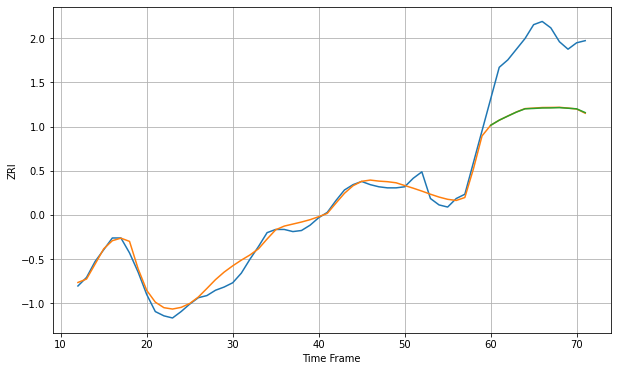

Wall time: 7.92 s
32205 6.559787345024008 62.664945830399844 62.78030248648253 [960.62986202 965.43632505 969.29968324 973.0425223  976.11406806
 976.44541047 976.89715963 976.97137952 977.21589621 976.64973145
 976.08747546 972.56449483]
60 60 12


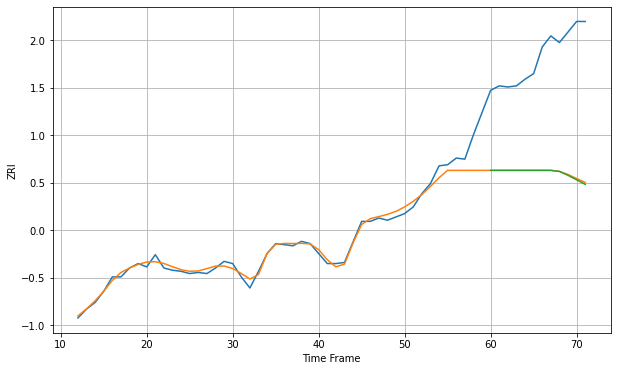

Wall time: 16.8 s
32207 9.742647335966478 105.93125857649092 106.33258279975674 [949.9199371  949.9199371  949.9199371  949.9199371  949.9199371
 949.9199371  949.9199371  949.9199371  948.9915293  945.43756201
 941.42401626 937.34295337]

Got an mse at 0.0050 in round 198 and stopped training

60 60 12


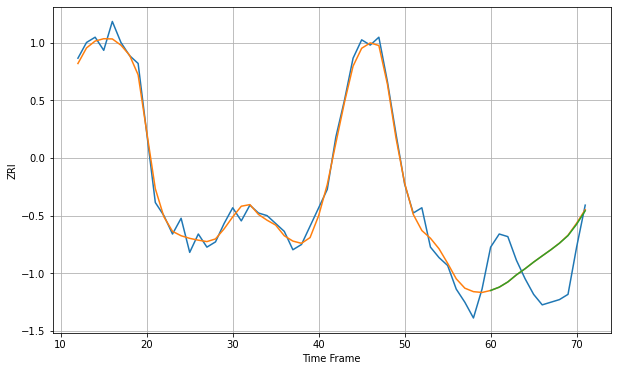

Wall time: 9.87 s
32209 3.503581021272595 15.765831545427975 15.727078432585632 [802.48438061 803.74794    805.73282409 808.43224203 810.75492418
 813.29547846 815.6611088  817.98433415 820.47704173 823.39150995
 827.70720205 832.83717889]

Got an mse at 0.0050 in round 102 and stopped training

60 60 12


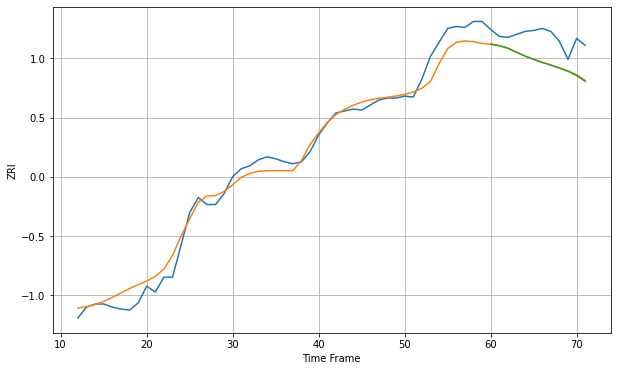

Wall time: 7.87 s
32224 11.470784206239417 25.687221280073086 25.964580871376018 [1312.11713389 1310.71351981 1308.14339694 1304.09090351 1300.25209242
 1296.94153493 1293.801284   1291.08855711 1288.13218981 1284.9428524
 1280.66083284 1274.86532636]

Got an mse at 0.0049 in round 118 and stopped training

60 60 12


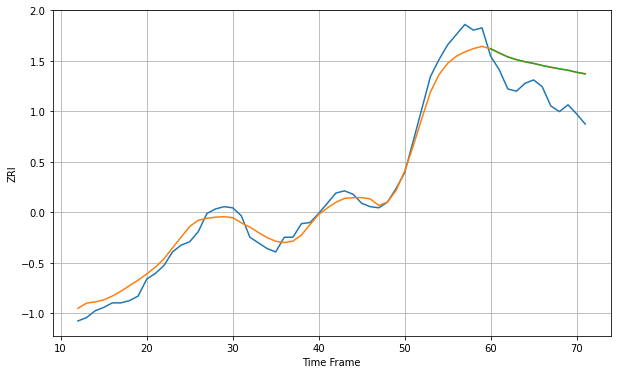

Wall time: 8.02 s
32225 9.699867245054385 28.27166982071353 28.348163149647334 [1158.55436054 1154.82404652 1151.3189056  1148.91895481 1147.0490315
 1145.57280133 1143.76978789 1142.23491703 1140.80889824 1139.58916526
 1137.82309064 1136.4810449 ]

Got an mse at 0.0049 in round 103 and stopped training

60 60 12


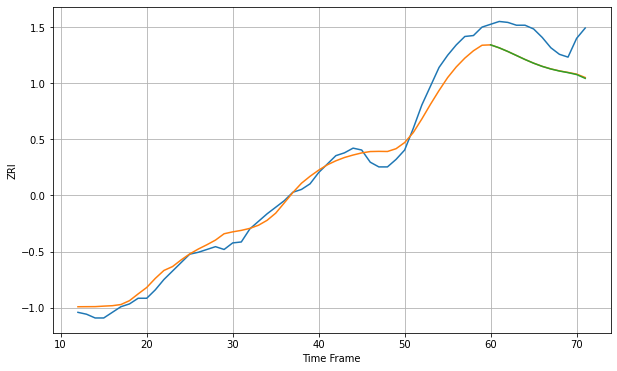

Wall time: 7.92 s
32246 11.431946579849258 31.890210761506072 32.09865217304636 [1312.0671522  1308.87565459 1304.99210873 1300.7263761  1296.45955489
 1292.52738231 1289.11828449 1286.35685092 1284.17715031 1282.46677689
 1280.41547201 1276.36082442]

Got an mse at 0.0049 in round 73 and stopped training

60 60 12


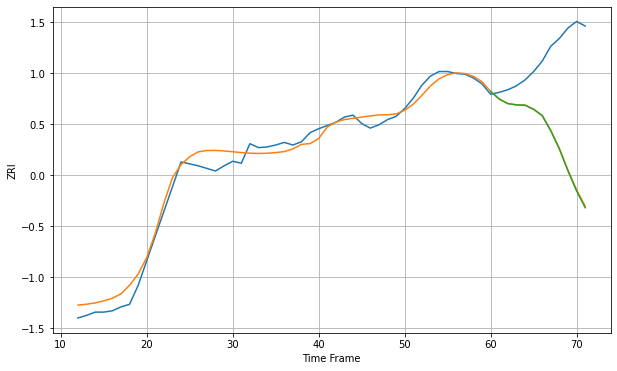

Wall time: 7.32 s
32250 14.216914701646818 144.56933735933228 145.3873096934465 [1374.427713   1362.7045092  1355.71918982 1353.73777691 1353.31338395
 1346.92948474 1337.29875558 1313.92973217 1285.68421872 1252.03851031
 1221.31137205 1195.58491353]

Got an mse at 0.0050 in round 100 and stopped training

60 60 12


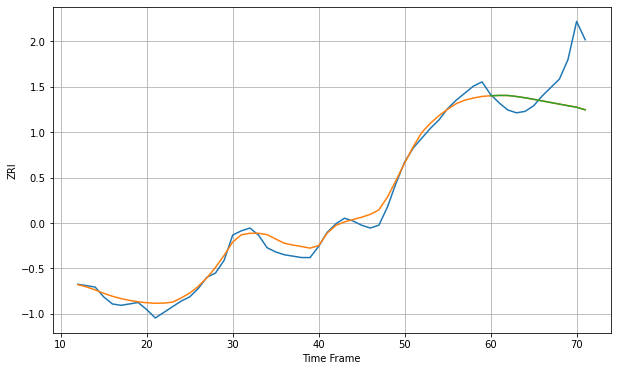

Wall time: 7.43 s
32256 5.2397412662104115 26.004374661415657 26.038703826951554 [1221.1396406  1221.36654914 1221.33015997 1220.6213603  1219.69013932
 1218.60469865 1217.44616068 1216.29791268 1215.16674961 1214.02703354
 1212.91653312 1211.13856083]

Got an mse at 0.0050 in round 55 and stopped training

60 60 12


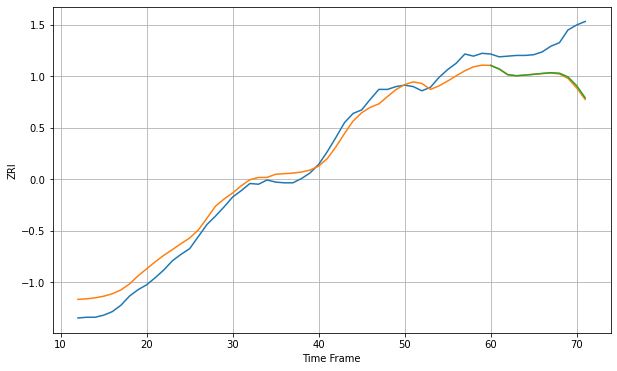

Wall time: 6.41 s
32701 15.351860939641373 52.16192752384766 50.95760501745536 [1161.94275335 1156.76790756 1148.75420854 1147.28865297 1148.24381125
 1149.36154222 1150.59301572 1151.59375262 1150.92451851 1145.62606061
 1133.3360443  1116.13548187]

Got an mse at 0.0050 in round 110 and stopped training

60 60 12


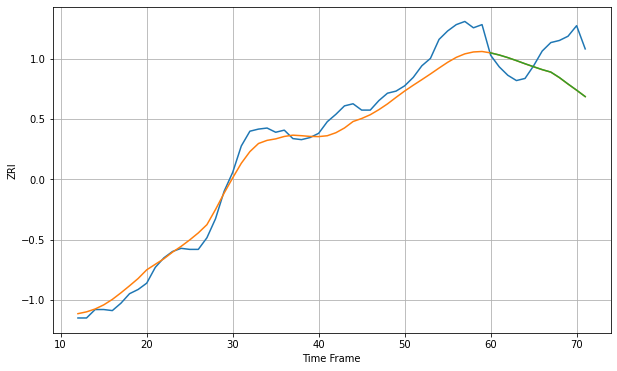

Wall time: 7.75 s
32703 13.64774578219756 30.468756150979846 30.43772121916017 [1295.21361274 1293.22374105 1290.74593476 1287.91266622 1284.93125707
 1282.10860382 1279.3660317  1277.03262343 1271.85197229 1265.75707005
 1259.89997224 1253.77892856]

Got an mse at 0.0049 in round 58 and stopped training

60 60 12


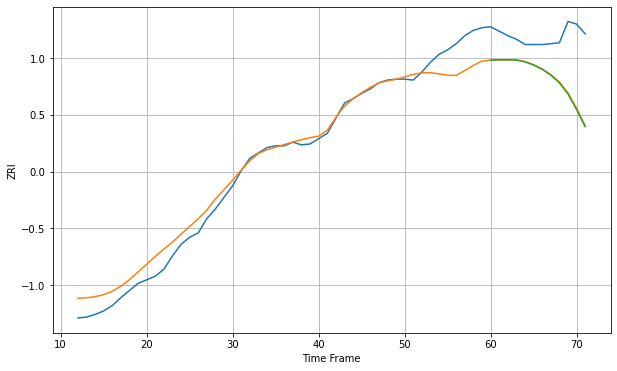

Wall time: 6.53 s
32714 15.993661723286719 53.792565259110894 54.469204795196944 [1209.37384189 1209.75072282 1209.78579689 1209.49244153 1207.54103502
 1203.9493773  1199.0265265  1192.63788508 1183.93515561 1171.22547077
 1153.68216966 1134.52151295]

Got an mse at 0.0049 in round 104 and stopped training

60 60 12


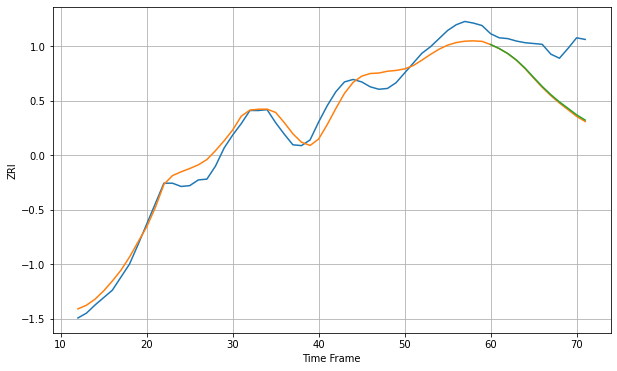

Wall time: 7.45 s
32771 13.80832894670032 55.80427227470463 54.697088569261325 [1197.72614418 1192.83886597 1186.70198211 1178.79624463 1168.92218843
 1157.54225274 1146.4238224  1136.45525266 1127.52805514 1119.65128183
 1111.72034512 1105.25122977]

Got an mse at 0.0049 in round 102 and stopped training

60 60 12


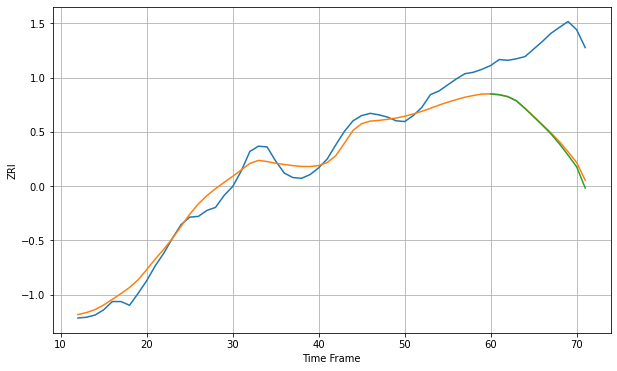

Wall time: 7.43 s
32792 15.265335708812255 118.7149984892751 121.79997761469133 [1256.96474901 1255.94458587 1253.31641835 1247.69866503 1237.48029716
 1226.55442322 1215.37396477 1203.69835601 1190.09039963 1175.12236664
 1159.46379342 1131.06185668]

Got an mse at 0.0050 in round 169 and stopped training

60 60 12


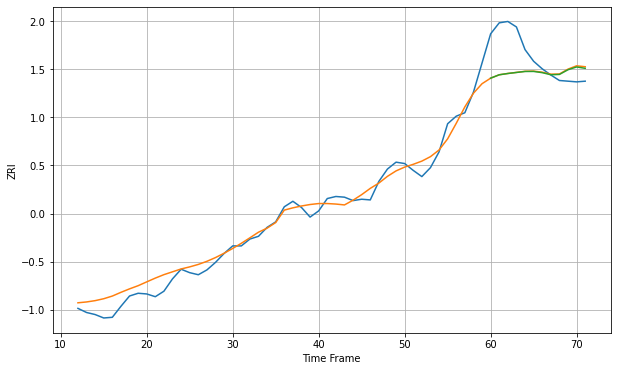

Wall time: 9.4 s
32801 13.950173740539645 43.43697001019093 43.295429344689715 [1595.38261232 1600.3187047  1602.177007   1603.68679305 1605.13982403
 1605.20621484 1603.41679253 1600.37866137 1600.81115946 1607.66512783
 1611.73954868 1609.73723612]

Got an mse at 0.0050 in round 241 and stopped training

60 60 12


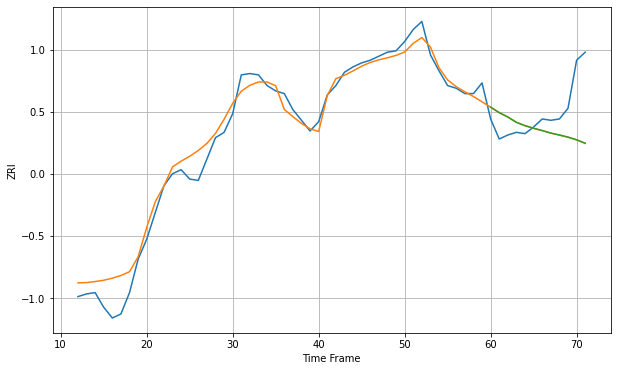

Wall time: 11 s
32803 10.31097745964727 28.505029572335868 28.451680831834818 [1479.82180696 1475.74219209 1472.46099734 1468.47593821 1465.97420309
 1464.02593698 1462.32698142 1460.42798598 1458.97763341 1457.40714593
 1455.39992079 1452.86140238]

Got an mse at 0.0049 in round 56 and stopped training

60 60 12


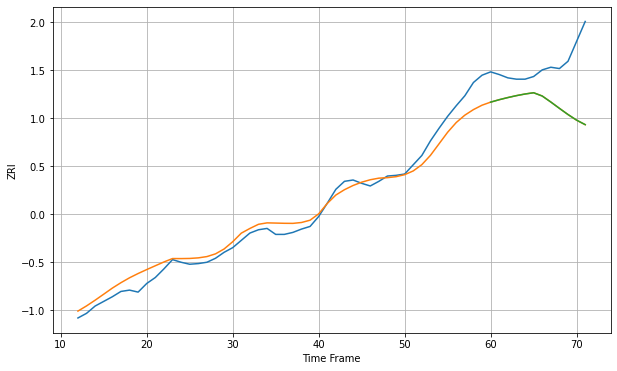

Wall time: 7.01 s
32810 15.781562697990976 69.99688839665932 69.98172951169545 [1370.38101819 1374.05400342 1377.27852198 1380.1781176  1382.63119134
 1384.52771587 1379.59450212 1370.5404006  1361.00606923 1351.69761749
 1343.24429441 1336.4554526 ]

Got an mse at 0.0049 in round 55 and stopped training

60 60 12


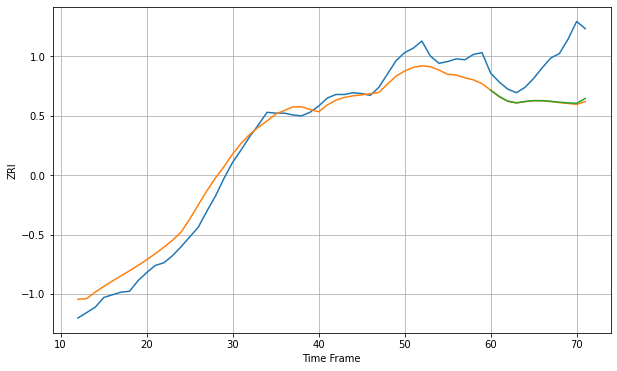

Wall time: 6.26 s
32811 15.705420691055334 49.34715948129623 48.50248505664537 [1305.86046209 1298.73360835 1293.52716145 1291.64285472 1293.13880518
 1294.13989533 1294.10134961 1293.31978887 1292.32426296 1291.58891697
 1291.09404073 1296.56586755]

Got an mse at 0.0050 in round 107 and stopped training

60 60 12


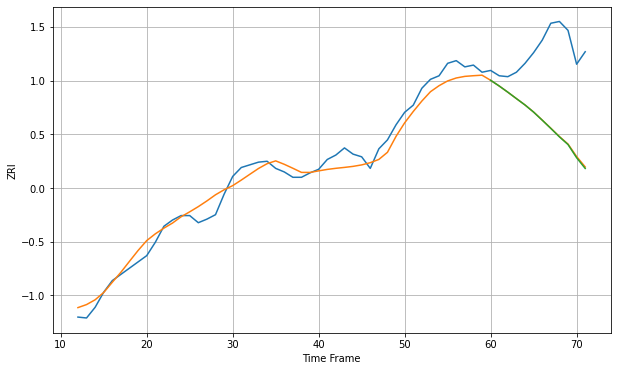

Wall time: 7.85 s
32812 11.617160032196674 86.86048638266155 87.3507023682165 [1388.92188266 1382.4969338  1375.57104036 1368.33859969 1361.19626943
 1353.19738997 1344.15143768 1334.88999914 1325.42912353 1316.77255826
 1301.9727012  1289.90616629]

Got an mse at 0.0050 in round 124 and stopped training

60 60 12


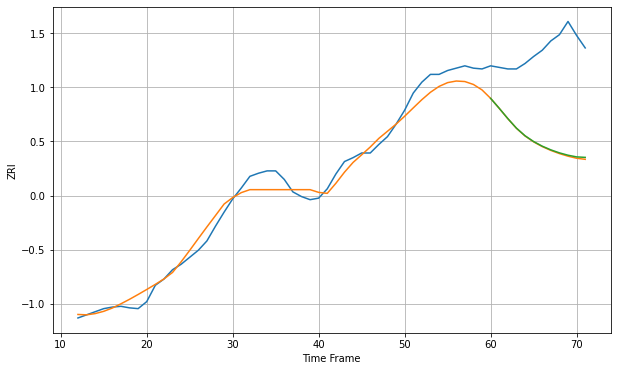

Wall time: 7.95 s
32822 13.286715725049447 118.65600634211943 117.76362823181718 [1282.18197138 1269.41579348 1256.20146292 1243.92624775 1234.15772623
 1226.69806725 1220.77427312 1216.02331231 1212.17294092 1209.15559616
 1206.98360811 1206.35780328]

Got an mse at 0.0049 in round 66 and stopped training

60 60 12


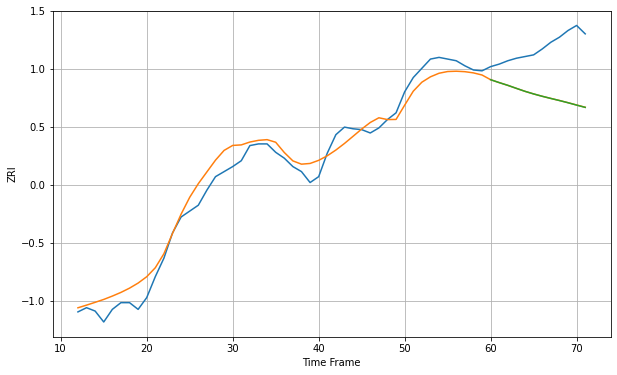

Wall time: 6.85 s
32825 15.286427583491525 60.59490530567352 60.63491158520553 [1274.41801032 1270.96448579 1267.69848913 1264.09914126 1260.57775073
 1257.48869978 1254.68775666 1252.12378438 1249.64395027 1247.00813151
 1244.20377092 1241.47151277]

Got an mse at 0.0050 in round 121 and stopped training

60 60 12


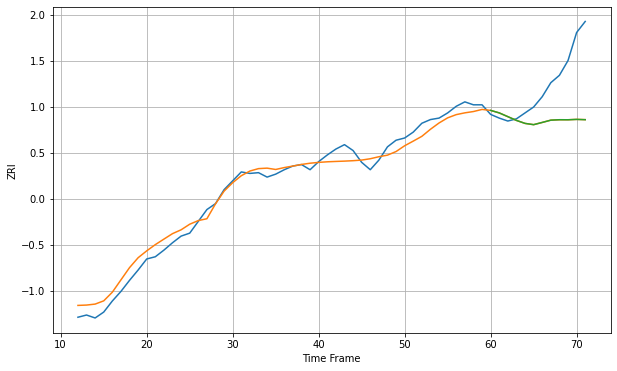

Wall time: 8.22 s
32835 11.60248641222028 62.144523498227834 62.16063048238923 [1287.4371865  1284.04518722 1278.94784457 1273.86949435 1269.81075464
 1268.08577341 1271.09531657 1274.20156529 1274.78627667 1274.72633229
 1275.22171655 1274.82758114]

Got an mse at 0.0049 in round 47 and stopped training

60 60 12


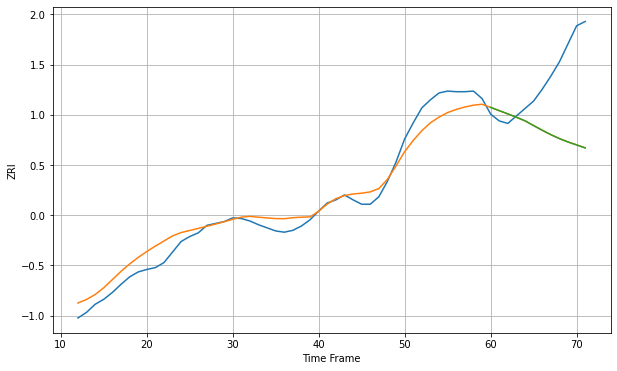

Wall time: 6.26 s
32837 20.082101839995783 105.6168139291832 105.72612328353972 [1561.77828193 1556.53099053 1551.32773889 1545.9677845  1540.16337714
 1532.50892742 1525.01906409 1517.87970419 1511.50300159 1506.05976109
 1501.30998605 1496.52812551]

Got an mse at 0.0050 in round 65 and stopped training

60 60 12


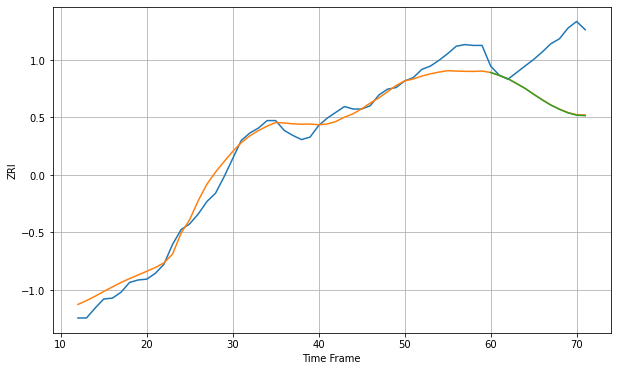

Wall time: 6.89 s
32839 14.0953898045119 66.23488602695527 66.5360937396415 [1319.23672176 1315.67767342 1311.73541192 1305.94460437 1300.02421355
 1292.90143768 1286.06267368 1279.80641041 1274.65976059 1270.35409698
 1267.52929437 1266.89850509]

Got an mse at 0.0049 in round 67 and stopped training

60 60 12


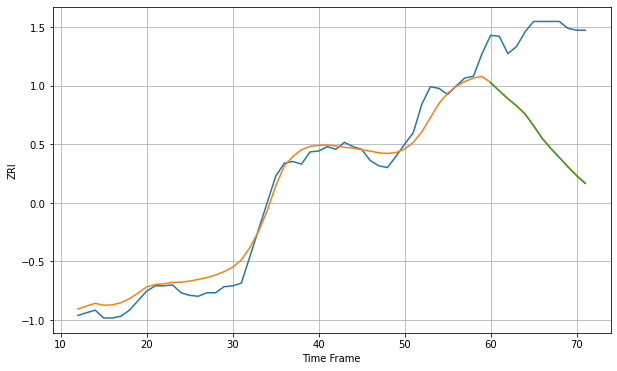

Wall time: 6.74 s
32935 13.662656936483765 124.2339714531706 124.50047252677035 [1165.6510552  1156.28389087 1147.25795907 1139.14769866 1129.65672072
 1116.02505299 1101.40586018 1089.9195305  1079.30622157 1068.70324411
 1058.50790084 1049.6356273 ]

Got an mse at 0.0049 in round 109 and stopped training

60 60 12


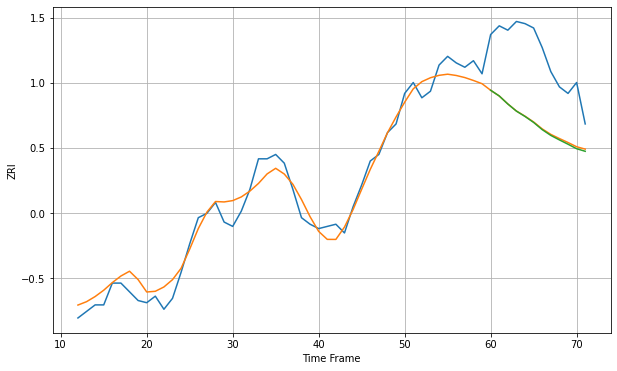

Wall time: 7.88 s
33009 5.8359141386429725 32.23443971200307 32.53202366403655 [1628.44598319 1625.82662013 1622.14293793 1618.8703925  1616.43292412
 1613.68530256 1610.38511095 1607.73323563 1605.66845188 1603.70228506
 1601.63209854 1600.45600463]
60 60 12


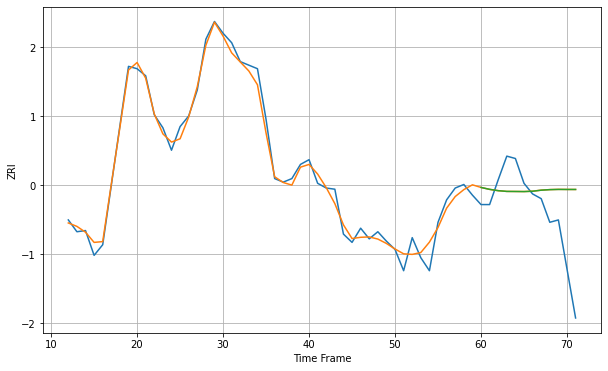

Wall time: 16.8 s
33010 7.223233732340309 40.86047612043289 40.85548715517408 [1779.49959158 1777.87877086 1776.76923589 1776.14087174 1776.08029108
 1776.00361272 1776.28646547 1777.18023642 1777.63684003 1777.83021886
 1777.77752791 1777.787271  ]

Got an mse at 0.0049 in round 224 and stopped training

60 60 12


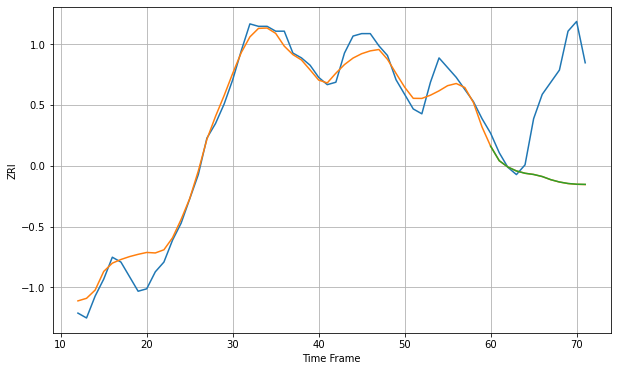

Wall time: 10.6 s
33020 5.465561715691578 36.95175137487258 36.92781185345617 [1337.67330577 1331.71339759 1329.1147105  1327.49092342 1326.5414537
 1326.04791956 1325.20071964 1323.90271066 1322.95505482 1322.33933791
 1322.03730073 1321.96895092]

Got an mse at 0.0049 in round 80 and stopped training

60 60 12


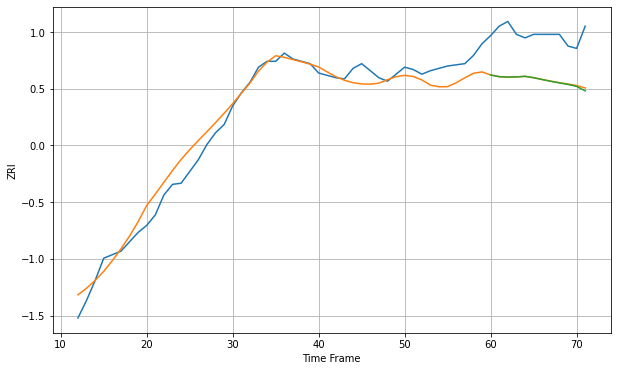

Wall time: 7.23 s
33024 10.83860579931308 39.39724021930655 39.77468561340824 [1502.31967252 1500.90816558 1500.53106013 1500.72641171 1501.180587
 1500.01188617 1498.44904039 1496.9457874  1495.56918429 1494.27768958
 1492.58824508 1488.76931596]

Got an mse at 0.0050 in round 76 and stopped training

60 60 12


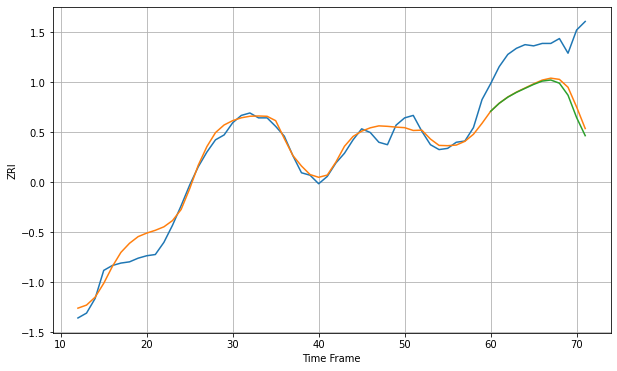

Wall time: 7.49 s
33025 8.09056698004233 42.27051162256056 45.19731046312716 [1562.36550974 1568.934807   1573.97768172 1577.89203106 1581.17431911
 1584.40537583 1587.13237728 1588.01997235 1585.40484954 1575.57768142
 1557.22606775 1542.4154499 ]
60 60 12


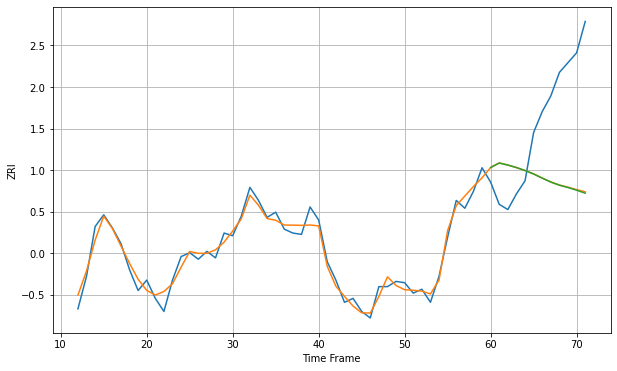

Wall time: 17.2 s
33062 6.031765110438463 67.81782461144716 68.1088110781307 [1619.18770528 1622.6672038  1621.07884424 1619.15509162 1616.88359125
 1614.22612728 1611.05249899 1608.03381176 1605.63745958 1603.85795258
 1601.79751382 1599.55502558]

Got an mse at 0.0049 in round 55 and stopped training

60 60 12


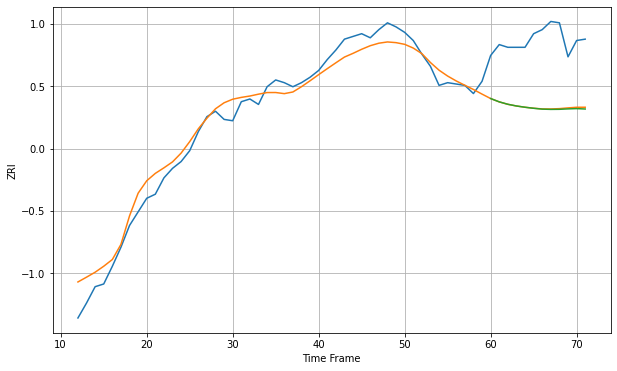

Wall time: 6.49 s
33065 9.450389291738988 49.31409070806468 49.654961798634666 [1502.32958216 1499.89196562 1498.11697549 1496.87259445 1495.93432463
 1495.16469485 1494.54658122 1494.35445602 1494.41553613 1494.72430188
 1494.93109287 1494.64176344]

Got an mse at 0.0050 in round 115 and stopped training

60 60 12


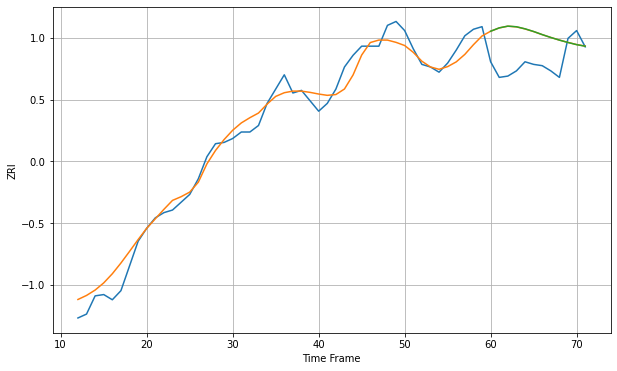

Wall time: 7.93 s
33066 9.189076830812187 25.924485551727255 25.966362824371096 [1467.492469   1470.06750909 1471.42023581 1470.93173009 1469.34698905
 1467.29632609 1464.90603027 1462.68976756 1460.65820816 1458.83928622
 1457.17535501 1455.97270628]

Got an mse at 0.0050 in round 269 and stopped training

60 60 12


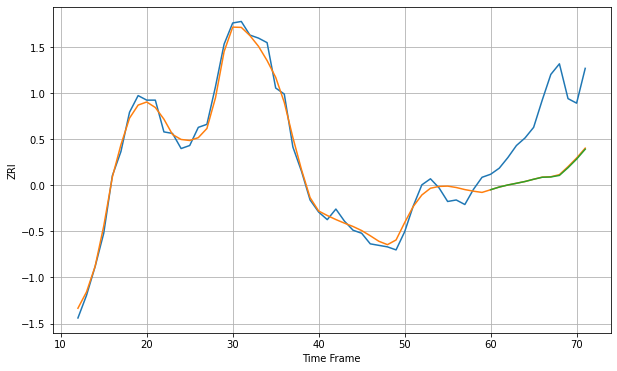

Wall time: 11.7 s
33125 5.354337119107247 42.688177214525446 42.98022567332129 [1682.76963339 1684.5478641  1685.90421825 1687.03484593 1688.20438737
 1689.68089628 1691.01542191 1691.20578397 1692.23325929 1697.31732715
 1703.00564928 1709.54278789]

Got an mse at 0.0050 in round 44 and stopped training

60 60 12


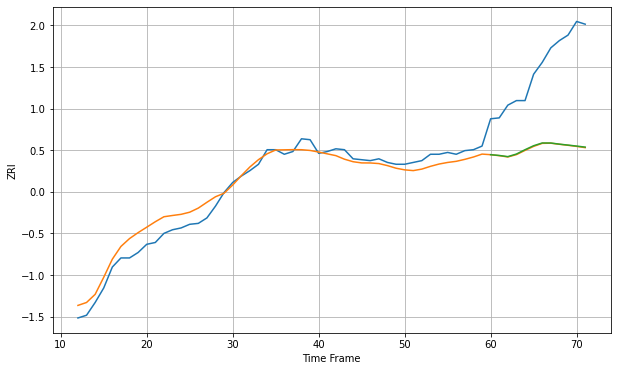

Wall time: 6.24 s
33126 11.056654081321735 92.75593653346556 92.39549666826508 [1637.52260126 1636.68356996 1635.39439832 1638.23945159 1642.99689056
 1647.3876833  1650.40655821 1650.35689448 1649.12190096 1648.07526658
 1646.9939213  1645.85660489]
60 60 12


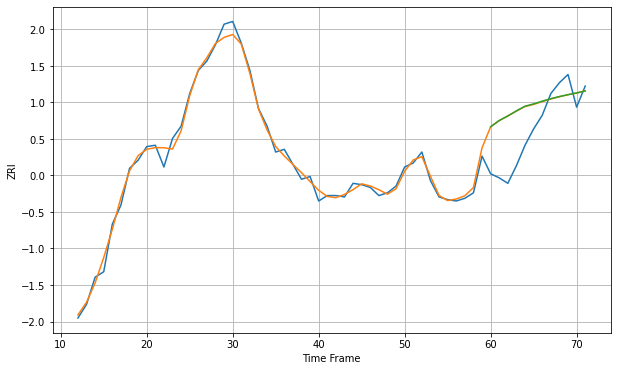

Wall time: 17.6 s
33127 4.497874381742777 26.97394397729587 27.043011302989054 [1770.57370167 1775.14779539 1778.53903725 1782.2666682  1785.70075723
 1787.39076878 1789.39093637 1791.24067964 1792.80521075 1794.18766217
 1795.41165631 1796.9228943 ]

Got an mse at 0.0049 in round 204 and stopped training

60 60 12


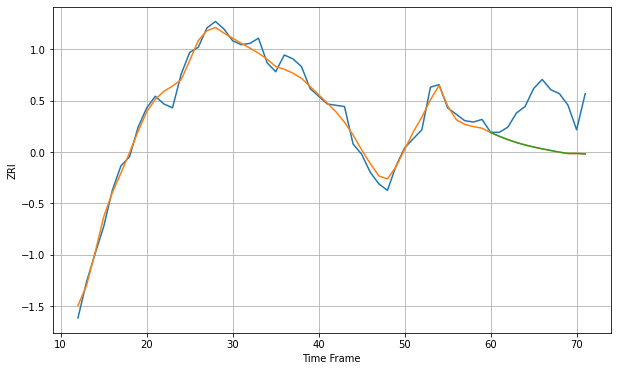

Wall time: 10.9 s
33130 6.363705567573347 34.96918118194301 34.95947664117662 [1749.8498798  1746.91200898 1744.34719668 1742.10958372 1740.20800959
 1738.61869829 1737.206409   1735.9072978  1734.60444363 1733.59546947
 1733.59950741 1733.28445388]

Got an mse at 0.0049 in round 280 and stopped training

60 60 12


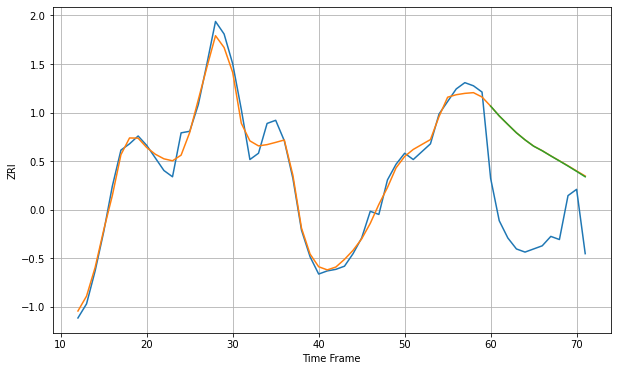

Wall time: 11.8 s
33131 5.882641429313967 56.635362954641465 56.57179914023981 [2281.03441706 2274.79155397 2269.37400178 2264.03585509 2259.52841948
 2255.51227506 2252.58925257 2249.28140074 2246.0954268  2242.84480853
 2239.45476086 2235.98913737]

Got an mse at 0.0050 in round 477 and stopped training

60 60 12


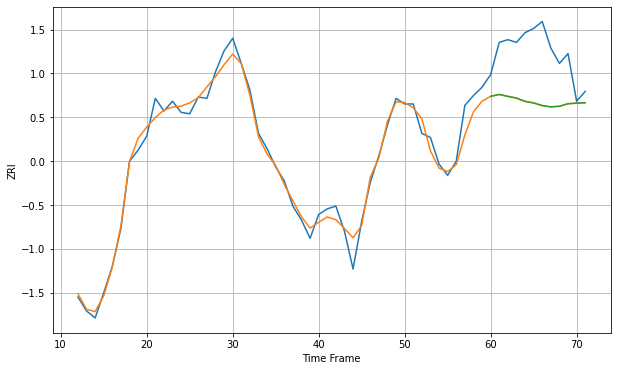

Wall time: 16.7 s
33132 7.180322376158768 38.48411009660525 38.48838129974166 [2031.47010028 2032.81347894 2031.45536989 2030.2064528  2027.87766717
 2026.74394302 2024.86218333 2023.9283239  2024.36060781 2026.18411229
 2026.5943539  2026.90449146]

Got an mse at 0.0050 in round 368 and stopped training

60 60 12


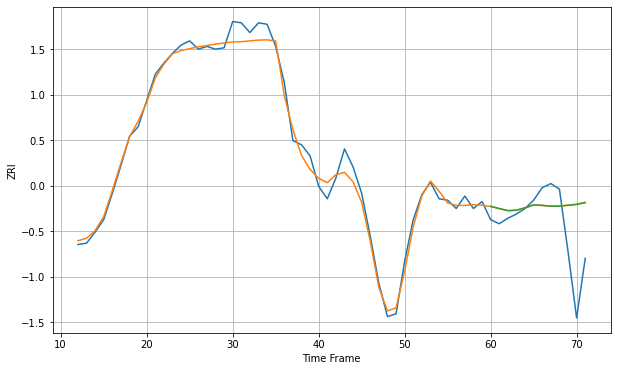

Wall time: 14.8 s
33133 6.5062754339936 29.32757536717921 29.27457353675751 [1985.5127181  1983.98024262 1982.4678479  1982.74909197 1984.51567426
 1986.59699853 1986.24514823 1985.69950229 1985.72791632 1986.30979199
 1986.96288454 1988.21437477]
60 60 12


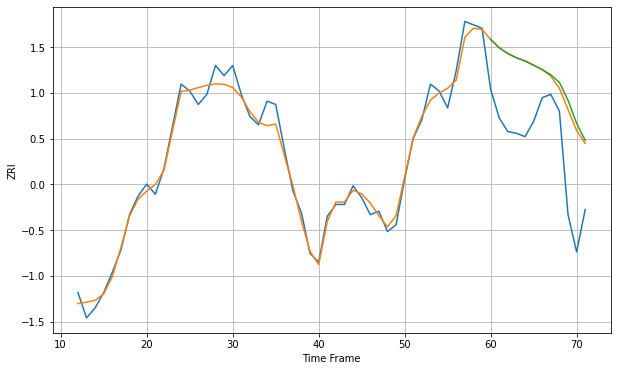

Wall time: 18.1 s
33134 5.6986696968747115 41.696606019594576 43.27774753105369 [2099.45263018 2094.4556158  2091.09104244 2088.60601913 2086.68896802
 2084.18672627 2081.64879005 2078.51618608 2074.03641968 2063.49439192
 2049.86539857 2039.81538782]

Got an mse at 0.0049 in round 387 and stopped training

60 60 12


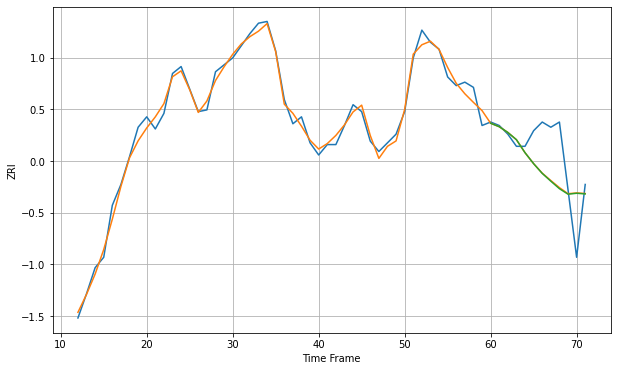

Wall time: 14.9 s
33135 4.286974026749909 20.508305563657032 20.640192131970963 [1726.29825659 1724.30585215 1720.99385269 1716.80890013 1709.31865275
 1702.9923418  1697.38345708 1692.89727906 1688.56792218 1685.39295243
 1685.91795106 1685.55739387]

Got an mse at 0.0047 in round 301 and stopped training

60 60 12


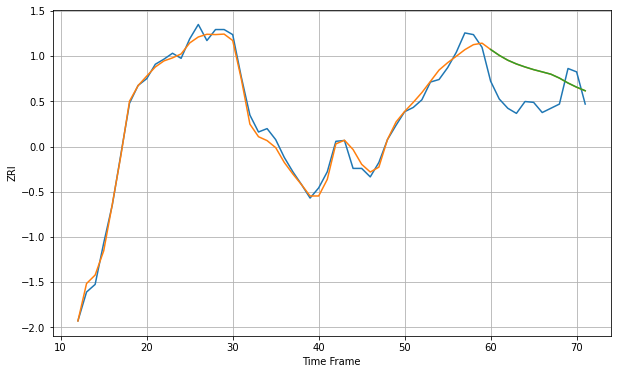

Wall time: 12.7 s
33137 7.802193700787908 40.37876551709589 40.40523938964365 [2261.45442499 2254.55241909 2248.77668005 2244.37621562 2240.8216194
 2237.67010965 2235.02091378 2232.30905737 2227.67345752 2221.88700291
 2216.98076248 2212.75188193]
60 60 12


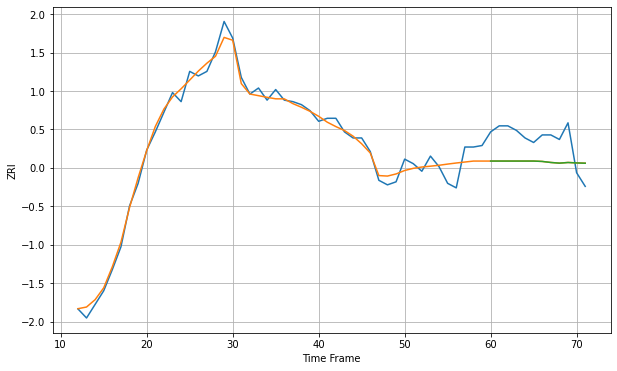

Wall time: 17.7 s
33138 5.500368508958608 18.47846652794109 18.48161754645099 [1684.72200479 1684.72200479 1684.72200479 1684.72200479 1684.72200479
 1684.72200479 1684.47118763 1683.78626727 1683.34849405 1683.76884823
 1683.48048995 1683.2993005 ]

Got an mse at 0.0050 in round 387 and stopped training

60 60 12


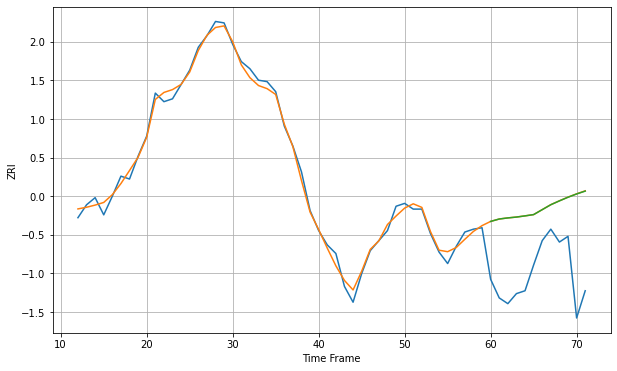

Wall time: 15.3 s
33139 4.1691694972086575 49.8267609886766 49.78521100067261 [2006.41137589 2008.09134904 2008.85836672 2009.4498889  2010.27644001
 2011.16779224 2014.62422741 2018.07759831 2020.75501939 2023.29549714
 2025.56444715 2027.57446301]
60 60 12


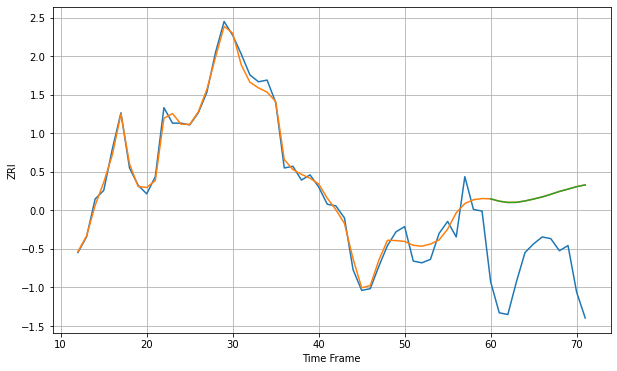

Wall time: 17.7 s
33140 5.272076778830945 47.94355788528793 47.945800659752834 [2313.11129611 2311.74800002 2311.01848115 2311.08303165 2311.88831926
 2313.0039394  2314.20573594 2315.75916773 2317.40336378 2318.75853894
 2320.17597215 2321.18016791]

Got an mse at 0.0049 in round 280 and stopped training

60 60 12


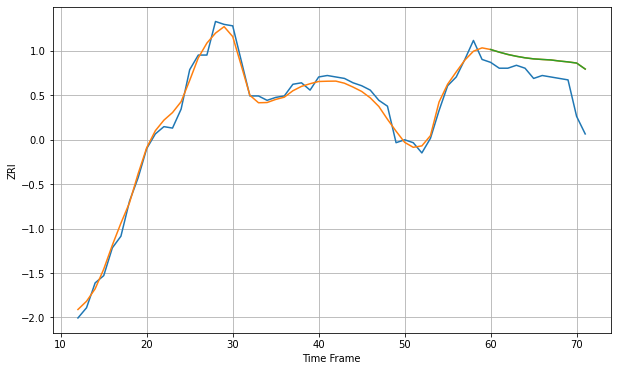

Wall time: 12.2 s
33141 4.855319523327949 19.177330136418806 19.174122224763853 [1862.79387992 1861.00195624 1859.40884295 1858.15417538 1857.12682463
 1856.38998801 1855.98809671 1855.65498998 1854.92016393 1854.31969268
 1853.52398429 1849.41239645]

Got an mse at 0.0050 in round 477 and stopped training

60 60 12


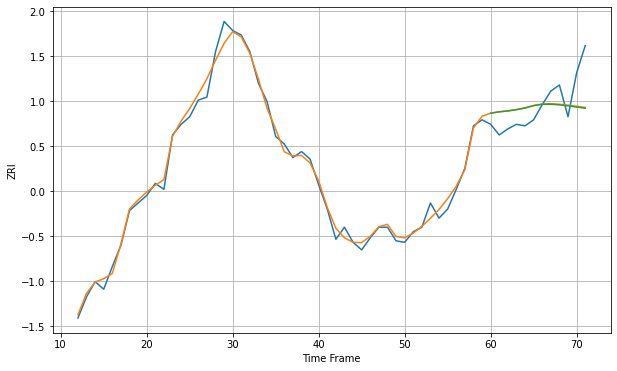

Wall time: 17.2 s
33142 4.60555498280747 16.323174181315807 16.506750244186506 [1682.35801658 1683.28364764 1683.84498018 1684.69961703 1685.79814397
 1687.36305647 1688.27248551 1688.27060556 1687.88410844 1687.23328082
 1686.4110776  1685.65013612]

Got an mse at 0.0049 in round 459 and stopped training

60 60 12


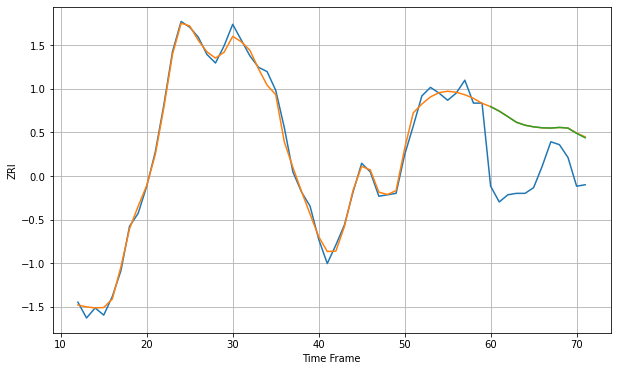

Wall time: 16.7 s
33145 4.462909515804612 41.31320856134717 41.24740124766651 [2073.54303185 2070.41491516 2066.55903319 2062.63319802 2060.56726775
 2059.43252122 2058.74595989 2058.59037987 2059.00550555 2058.54155329
 2054.84407455 2051.79475624]

Got an mse at 0.0050 in round 384 and stopped training

60 60 12


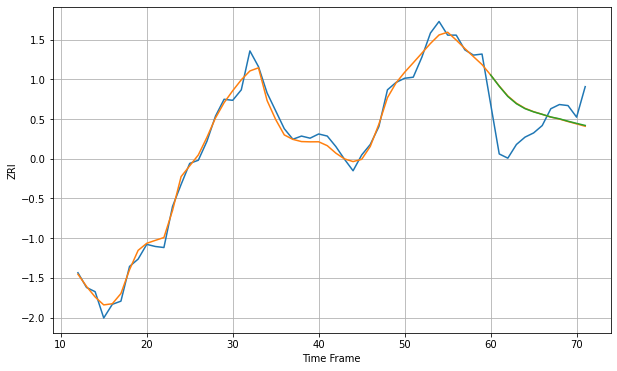

Wall time: 14.9 s
33147 6.874774327491821 33.15767723925057 32.87092715549648 [1960.12539299 1949.38576376 1939.68578741 1932.7714164  1928.07304094
 1925.02388203 1922.65836659 1920.15013537 1918.43360172 1916.13813926
 1914.06119112 1912.11202268]
60 60 12


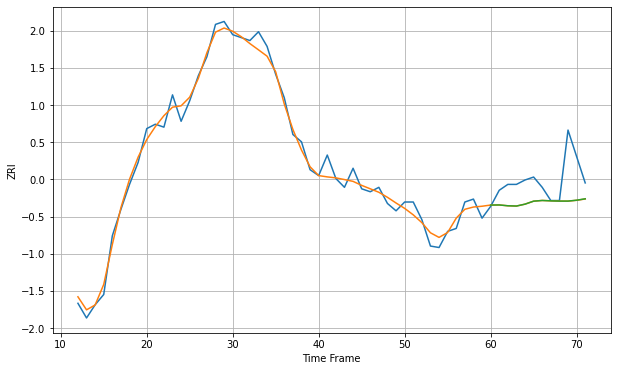

Wall time: 17.8 s
33150 5.764848699849041 19.374524763297906 19.351223767135192 [1608.9260874  1608.99709824 1608.43630297 1608.24773585 1609.54608151
 1611.57658583 1612.04852938 1611.8001463  1611.62816797 1611.62985303
 1612.2376841  1613.19451408]
60 60 12


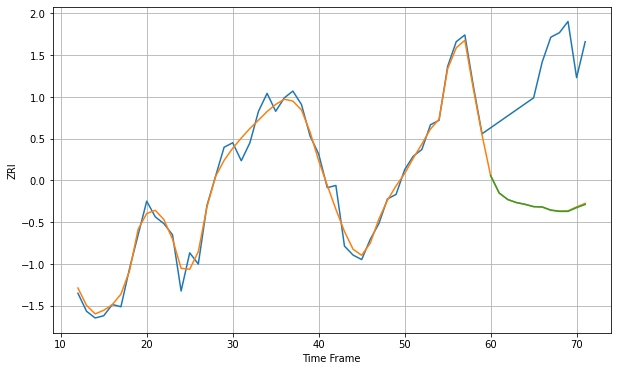

Wall time: 17.4 s
33157 4.1344287175779995 58.377326676084486 58.52081623532787 [1754.35551106 1746.63290918 1743.71601669 1742.3728562  1741.58280099
 1740.55217642 1740.38501279 1738.96433792 1738.44383027 1738.44306713
 1740.11180003 1741.52669137]

Got an mse at 0.0050 in round 486 and stopped training

60 60 12


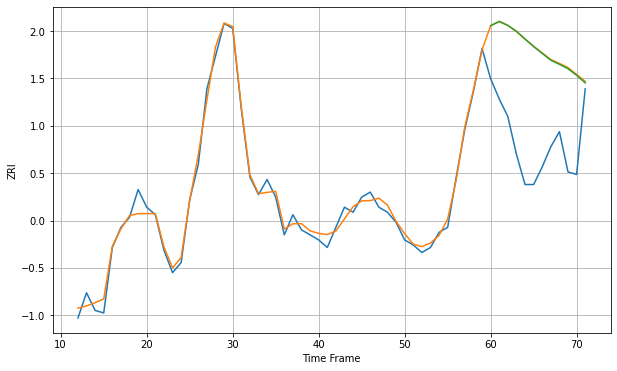

Wall time: 16.7 s
33160 2.9822843420055087 39.50556614596697 39.36509813541447 [2079.09996735 2080.76545999 2079.21341617 2076.83357169 2073.76801385
 2070.81279926 2068.09576917 2065.36741324 2063.74796134 2061.99867637
 2059.35947079 2056.37345949]

Got an mse at 0.0049 in round 263 and stopped training

60 60 12


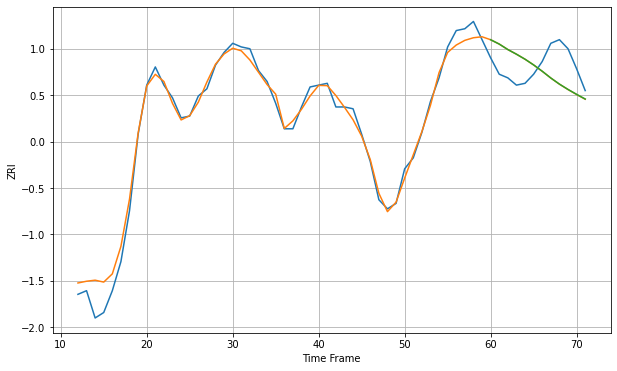

Wall time: 11.5 s
33161 5.570118942717017 15.342328282399148 15.320444902622466 [1531.95580209 1529.56805099 1526.56354508 1524.01051922 1521.25082453
 1518.10835928 1514.63665645 1510.91656851 1507.56646656 1504.63222713
 1501.93213342 1499.3577818 ]

Got an mse at 0.0050 in round 85 and stopped training

60 60 12


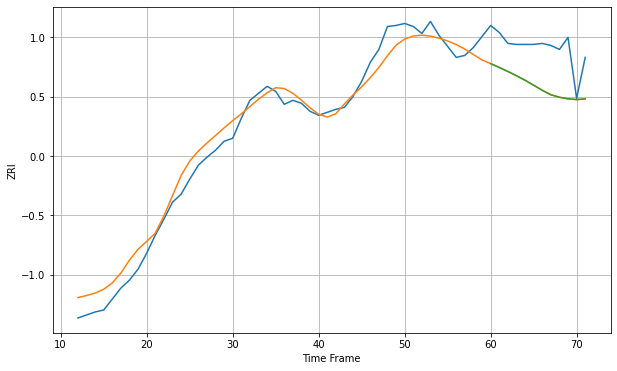

Wall time: 7.41 s
33178 13.406678145291401 40.68617633068174 40.66806027815153 [2023.77812868 2019.96844373 2015.93962283 2011.65437496 2007.13682214
 2002.19525017 1997.07941115 1992.57827174 1990.12339242 1988.5223418
 1987.81481155 1988.52327805]
60 60 12


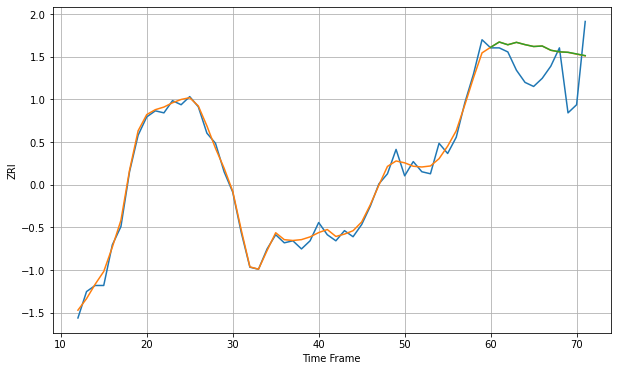

Wall time: 16.7 s
33180 3.0610266062671583 15.951486899645563 15.965224466527399 [2031.28304507 2033.88226045 2032.5360058  2033.72391053 2032.5974532
 2031.67385373 2031.92116889 2029.83712452 2029.05707878 2028.82765219
 2028.01086646 2027.18967682]

Got an mse at 0.0049 in round 64 and stopped training

60 60 12


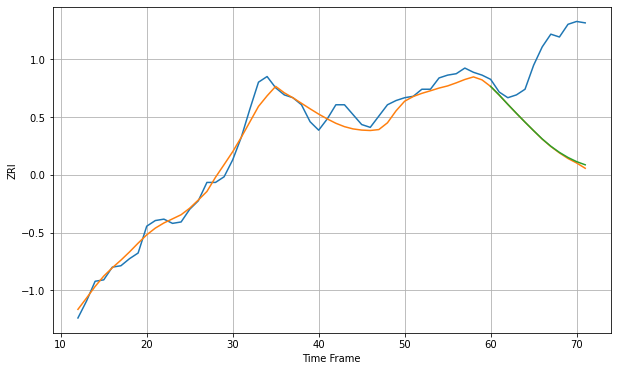

Wall time: 6.5 s
33186 6.924510254869163 64.5140768510222 63.90130112796094 [1578.97704183 1572.86608254 1566.31318098 1559.93005319 1553.71545847
 1547.66679565 1541.78225054 1536.63815049 1532.27567021 1528.66525532
 1525.72011975 1523.4866005 ]

Got an mse at 0.0049 in round 152 and stopped training

60 60 12


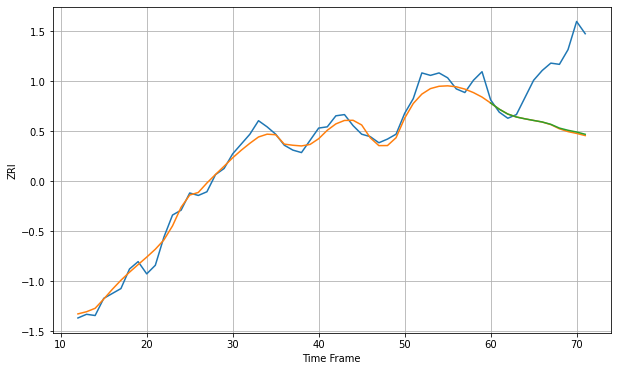

Wall time: 9.05 s
33196 7.084791370015642 48.47608569569374 47.94459620913351 [1586.44960309 1581.41083078 1577.41519107 1575.03099056 1573.5298376
 1572.21752618 1570.96927651 1569.04902703 1565.9892322  1564.19405808
 1562.77333189 1560.9123497 ]

Got an mse at 0.0049 in round 207 and stopped training

60 60 12


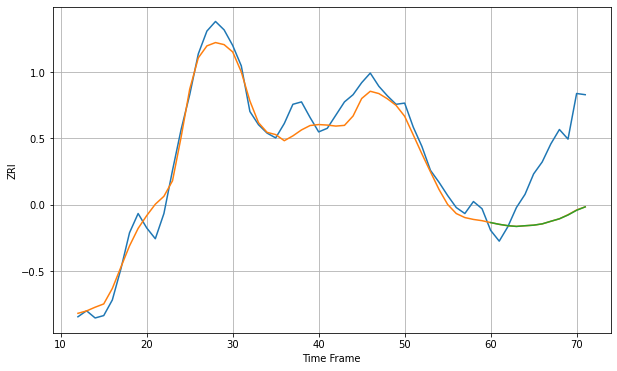

Wall time: 10.6 s
33301 11.185196763222015 55.87407206490685 55.93170559785092 [1738.47014622 1737.01028467 1735.87046335 1735.27063397 1735.83885926
 1736.31002814 1737.39261284 1739.54464911 1741.61437816 1744.76232015
 1748.71287938 1751.55330726]

Got an mse at 0.0050 in round 145 and stopped training

60 60 12


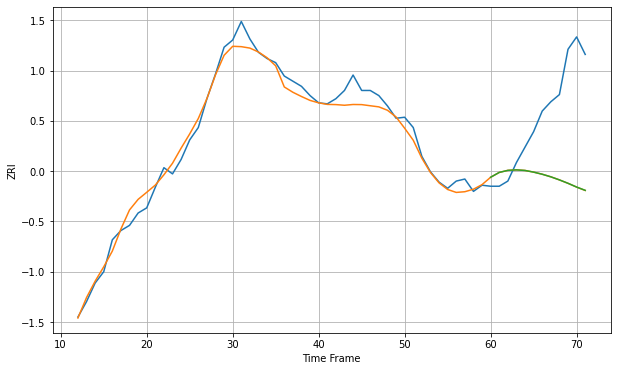

Wall time: 8.89 s
33304 9.653626894210479 78.56490100154659 78.53941706063245 [1564.71924526 1569.4003466  1571.4076075  1571.88560702 1571.31129932
 1569.69850429 1567.64693397 1565.14175875 1562.15403581 1558.85026338
 1555.22178542 1552.01079335]

Got an mse at 0.0050 in round 144 and stopped training

60 60 12


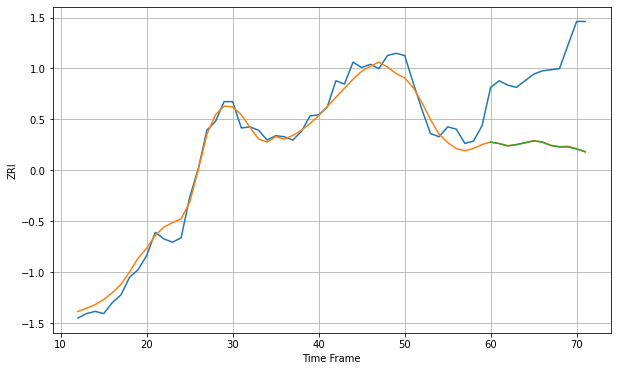

Wall time: 8.7 s
33305 9.430078974170344 75.4951809901869 75.60128661000175 [1497.17909299 1495.7812689  1493.74500778 1494.85325116 1496.53183857
 1498.2892212  1497.10906331 1494.07135122 1492.66253115 1492.70811571
 1490.89370993 1488.50245635]

Got an mse at 0.0050 in round 135 and stopped training

60 60 12


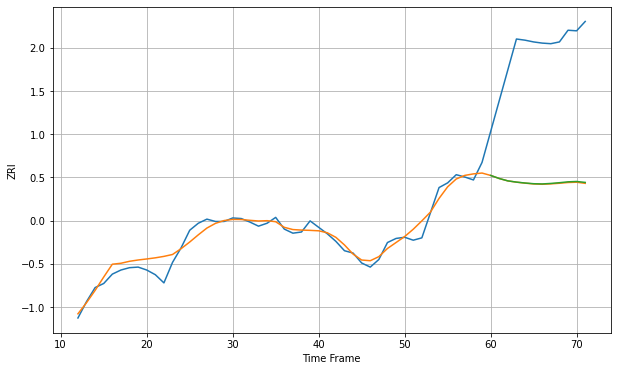

Wall time: 8.78 s
33308 13.261837164560575 227.95869151544392 227.29490574867015 [1593.73915439 1588.48077563 1584.430584   1582.33190891 1580.77960567
 1579.57031306 1579.17523497 1580.05363232 1581.29302654 1582.78293333
 1583.40444022 1581.78268892]

Got an mse at 0.0050 in round 95 and stopped training

60 60 12


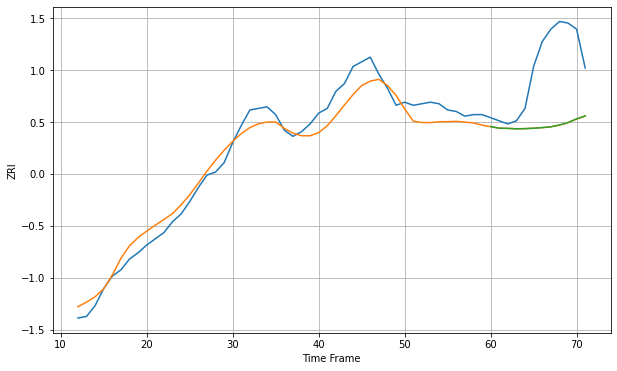

Wall time: 7.52 s
33311 8.681846361052918 42.56202969228207 42.52239426594568 [1381.25290138 1380.24618512 1380.1266364  1379.86633139 1379.96327004
 1380.24083494 1380.62167326 1381.14522331 1382.30698307 1383.88811671
 1386.28434035 1388.17808433]

Got an mse at 0.0050 in round 120 and stopped training

60 60 12


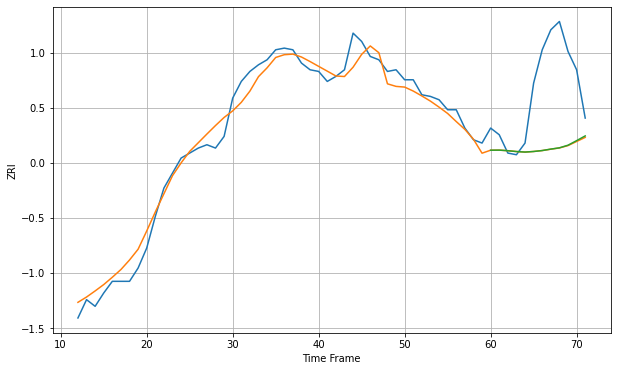

Wall time: 8.7 s
33312 7.218297384768389 42.55174369068522 42.44046885323292 [1416.71333489 1416.75891957 1416.41531868 1415.91054346 1415.59906793
 1415.94898704 1416.514048   1417.37939709 1418.14938991 1419.72297823
 1422.46214698 1425.30278712]

Got an mse at 0.0050 in round 76 and stopped training

60 60 12


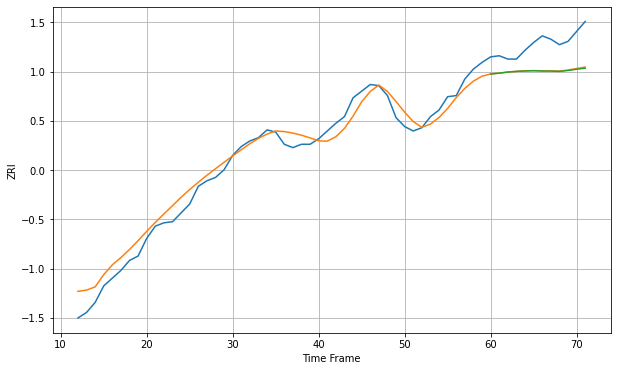

Wall time: 7.07 s
33313 10.122015217345005 25.209800799899792 25.515545340406046 [1429.5306378  1430.27721089 1431.27200813 1431.89078738 1432.28603715
 1432.51545378 1432.22443719 1432.16977614 1431.8539577  1432.67638244
 1433.85049727 1434.78207078]

Got an mse at 0.0049 in round 103 and stopped training

60 60 12


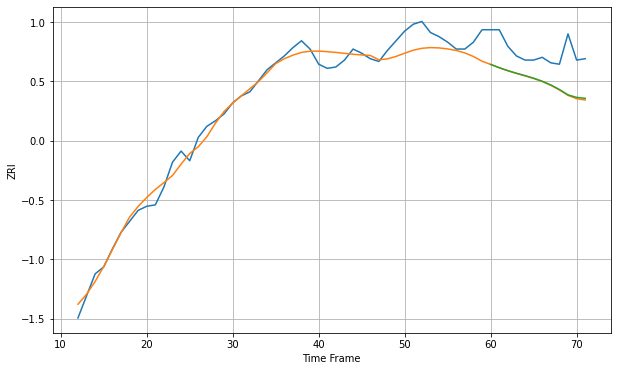

Wall time: 7.93 s
33324 8.115952711612849 23.736157817638027 23.398128681697113 [1547.84572545 1545.48590384 1543.33165219 1541.44231482 1539.70993798
 1537.8245896  1535.65598948 1532.95384076 1529.64122809 1525.77268117
 1523.95685405 1523.25530873]

Got an mse at 0.0050 in round 106 and stopped training

60 60 12


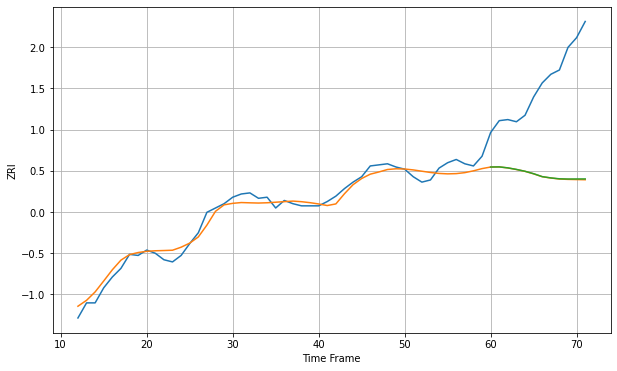

Wall time: 7.84 s
33334 6.506450880320713 89.23637267548793 88.97285660914308 [1316.99894626 1317.12897164 1316.2176931  1314.77001028 1313.05826534
 1310.80070392 1308.07982886 1306.90776402 1306.06899001 1305.8704167
 1305.91536922 1305.95791978]

Got an mse at 0.0050 in round 158 and stopped training

60 60 12


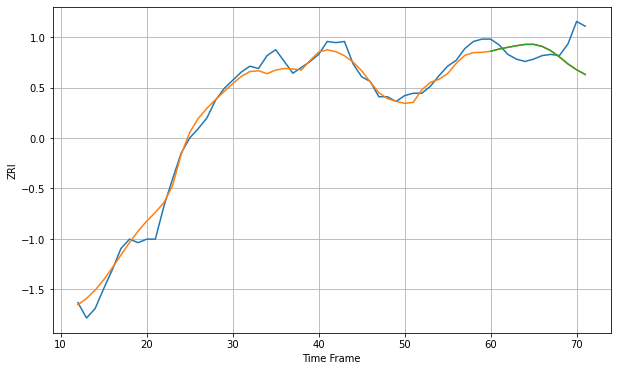

Wall time: 9.44 s
33401 7.973650246607115 19.127988530924345 19.116970989313288 [1507.66241791 1509.57553999 1511.00345745 1512.36502785 1513.49229924
 1513.57437697 1511.80245728 1508.1536531  1502.86368372 1496.89898597
 1491.97928454 1487.93536175]

Got an mse at 0.0049 in round 261 and stopped training

60 60 12


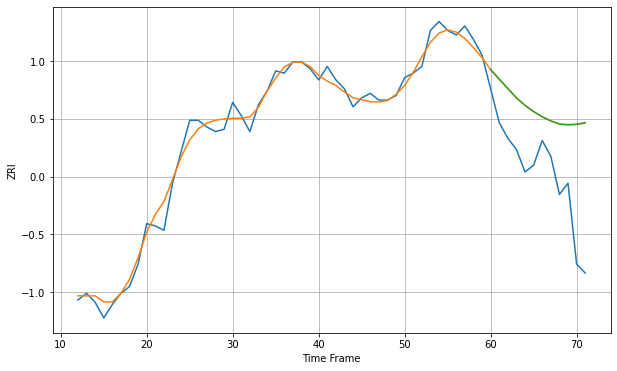

Wall time: 11.7 s
33404 4.0084987803255 33.287845676243755 33.247651069819135 [1486.58626172 1482.31385714 1478.13599461 1473.98771469 1470.65370015
 1467.87866563 1465.56483132 1463.73890776 1462.2930658  1462.01999253
 1462.15330237 1462.86926731]

Got an mse at 0.0049 in round 172 and stopped training

60 60 12


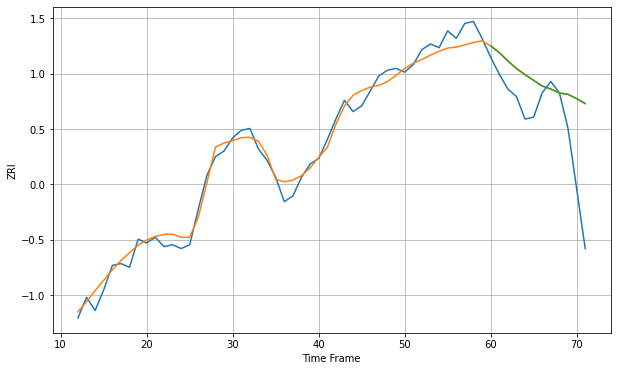

Wall time: 9.65 s
33407 5.3716567083466185 29.119412493717494 29.127844169217635 [1506.03623315 1502.40659456 1497.98122547 1493.92886634 1490.66037851
 1487.57333255 1484.55070299 1482.97416291 1480.83469372 1480.192066
 1477.8977465  1475.26839308]

Got an mse at 0.0050 in round 173 and stopped training

60 60 12


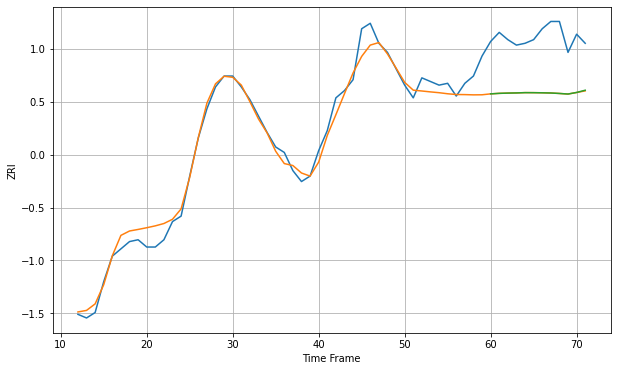

Wall time: 9.43 s
33413 6.263199485706947 31.193534614419644 31.173417912207675 [1439.20122944 1439.47667176 1439.62016797 1439.70875526 1439.87275323
 1439.8519248  1439.78288954 1439.67077232 1439.41691201 1439.10827461
 1439.98428511 1441.20449186]

Got an mse at 0.0049 in round 418 and stopped training

60 60 12


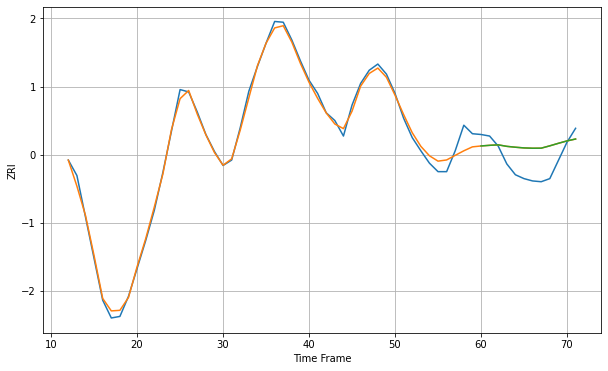

Wall time: 15.7 s
33414 7.97581479370718 28.66384872021122 28.662615370472025 [1721.19626606 1722.00789956 1722.62521953 1720.690803   1719.55414896
 1718.66167013 1718.25911012 1718.34102604 1721.35205866 1724.61243428
 1727.70604129 1730.17677186]

Got an mse at 0.0050 in round 243 and stopped training

60 60 12


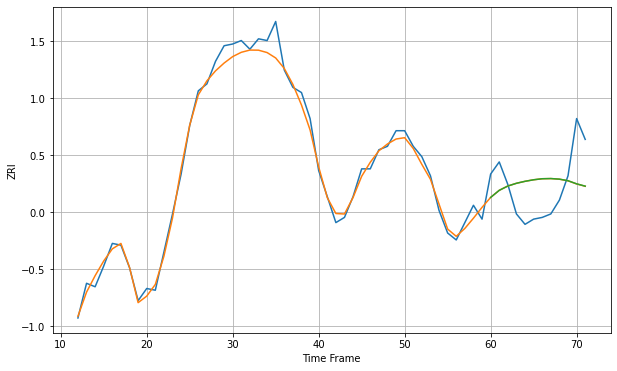

Wall time: 11.9 s
33418 5.167363536800874 20.642272996845115 20.6284729242307 [1690.5170744  1694.60463752 1697.09374093 1698.67301143 1699.81514284
 1700.70529935 1701.30117788 1701.41157573 1701.06702532 1700.15619661
 1698.36767156 1697.02846766]

Got an mse at 0.0050 in round 246 and stopped training

60 60 12


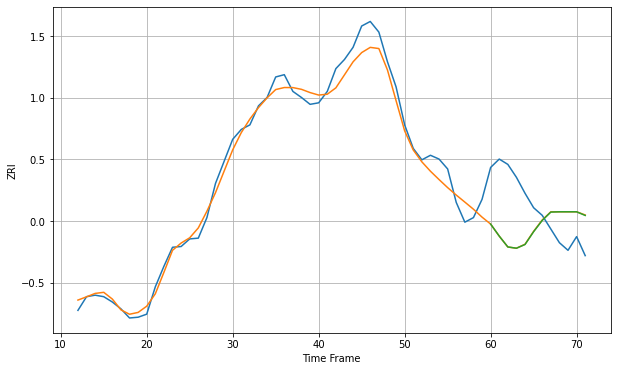

Wall time: 11.7 s
33432 14.79502282990582 64.85784968962135 64.83336246653245 [1912.50042963 1896.72344638 1882.43101391 1880.73825088 1885.65809176
 1902.4741196  1917.28289276 1928.27767776 1928.6564329  1928.6564329
 1928.6564329  1923.84489795]

Got an mse at 0.0050 in round 175 and stopped training

60 60 12


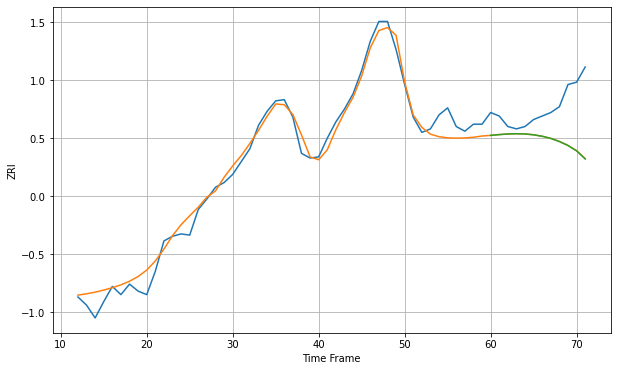

Wall time: 9.37 s
33433 9.303720110115771 35.227416735135776 35.36249854936362 [1748.42780864 1749.08257997 1749.61217903 1749.83772075 1749.63147248
 1748.90595009 1747.6283913  1745.79402902 1743.1397752  1739.67815969
 1735.11865659 1728.20659253]

Got an mse at 0.0050 in round 442 and stopped training

60 60 12


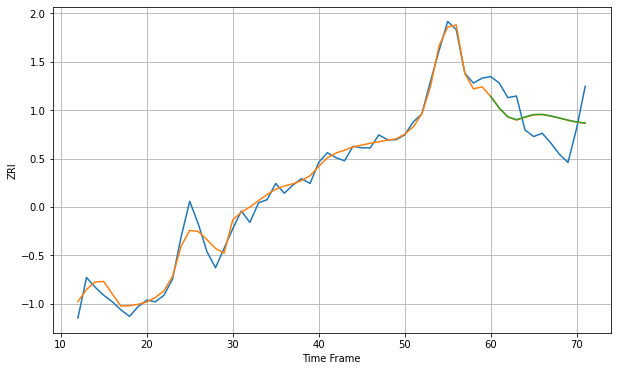

Wall time: 16.2 s
33435 5.191497544923322 16.108944809032806 16.128312345133157 [1713.79054842 1706.56800822 1701.14284438 1699.35840241 1701.06752277
 1702.56754785 1702.65542883 1701.70174834 1700.44907682 1699.07116602
 1698.01044395 1697.29377165]

Got an mse at 0.0049 in round 89 and stopped training

60 60 12


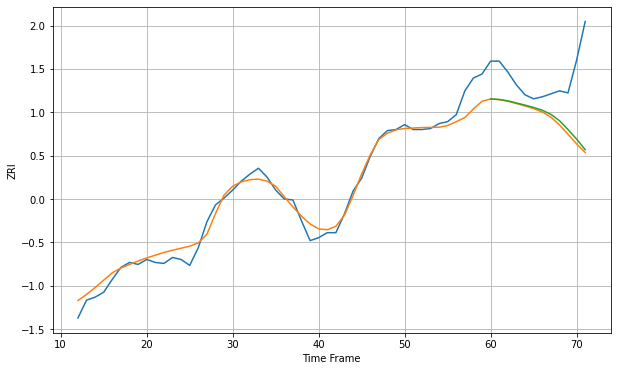

Wall time: 7.19 s
33436 10.133944423186627 52.211416204251925 50.198854997177996 [1528.82635356 1528.35634757 1526.97315106 1524.81020784 1522.63737787
 1520.30062435 1517.50963738 1513.37634103 1506.97273472 1498.01337075
 1488.40550195 1477.69495342]

Got an mse at 0.0049 in round 152 and stopped training

60 60 12


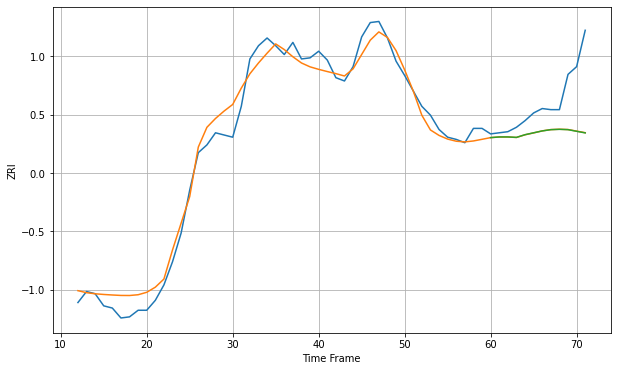

Wall time: 8.96 s
33444 11.754105057728237 36.784946013107344 36.854673020828706 [1671.6210982  1672.22477617 1672.24776642 1671.83017733 1674.27265554
 1676.00242491 1677.68978455 1678.84714278 1679.14813561 1678.85459672
 1677.36129392 1675.90227204]
60 60 12


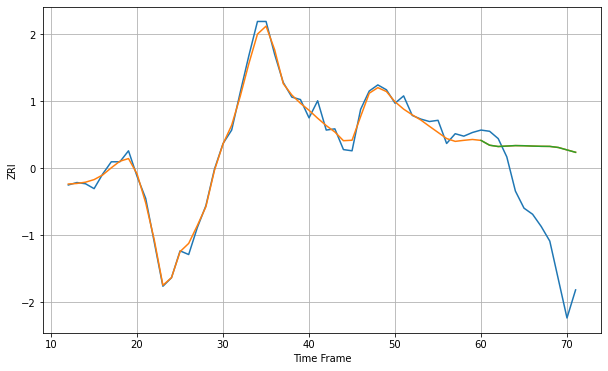

Wall time: 17.9 s
33460 5.042032406446088 71.40925276732413 71.4045692661751 [1496.52703318 1492.57811895 1491.52559432 1491.88929721 1492.27871339
 1492.15197606 1491.8754625  1491.68239276 1491.60974159 1490.71735165
 1488.72539941 1486.76142111]

Got an mse at 0.0050 in round 326 and stopped training

60 60 12


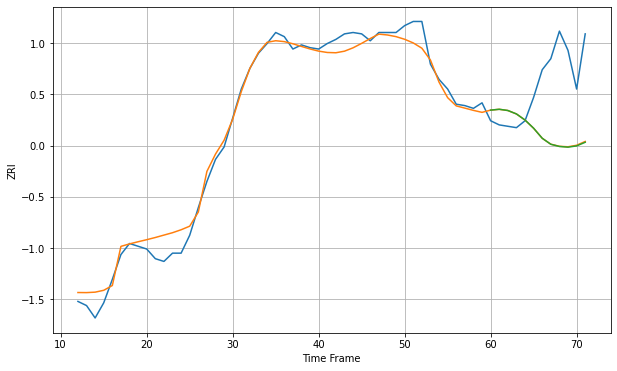

Wall time: 13 s
33461 8.295653536991015 47.29236897058314 47.463944179012415 [1431.71891942 1432.32341114 1431.44830285 1428.95416659 1424.53071731
 1418.57869359 1411.30427975 1406.95445405 1405.35902471 1404.86071789
 1405.76867339 1408.39785898]

Got an mse at 0.0050 in round 164 and stopped training

60 60 12


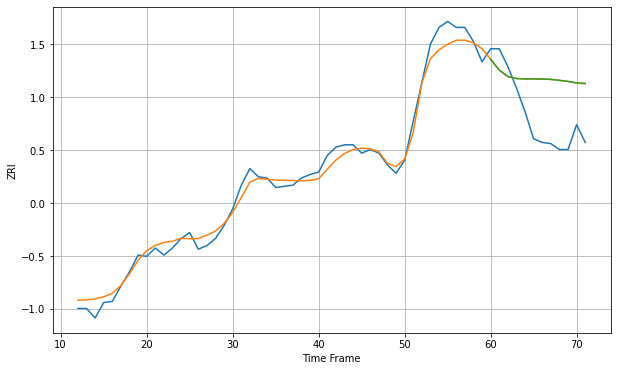

Wall time: 9.45 s
33510 7.8363724454700705 40.83770208676576 40.90429947530837 [1268.06127944 1259.07756273 1253.56032009 1251.89284289 1251.51627649
 1251.56418515 1251.47888879 1251.14797071 1250.37701421 1249.45210007
 1248.24584698 1247.86516867]

Got an mse at 0.0049 in round 120 and stopped training

60 60 12


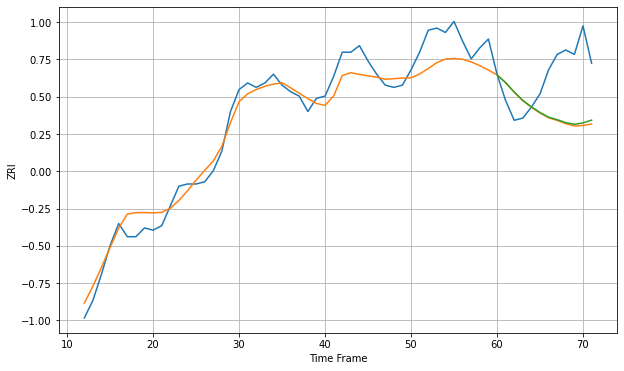

Wall time: 8.07 s
33511 7.515924015869806 23.73390236193009 23.18084697426755 [1269.7080029  1266.13757851 1261.87355785 1258.07767679 1255.17351515
 1252.56523668 1250.42254846 1249.28048613 1247.93994288 1247.17936213
 1247.8004325  1249.08082178]

Got an mse at 0.0050 in round 80 and stopped training

60 60 12


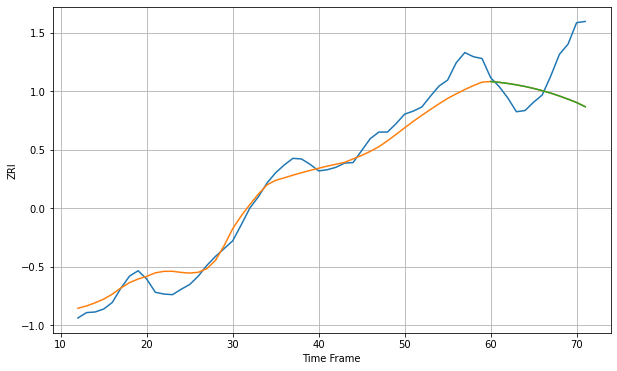

Wall time: 7.16 s
33602 22.837566182499547 69.01236504701423 69.07607285658936 [1835.55216027 1834.14971892 1832.29516319 1830.00337326 1827.26044352
 1823.99030226 1820.25428934 1816.13383296 1811.30928591 1806.05097735
 1800.37427716 1793.35637206]

Got an mse at 0.0050 in round 68 and stopped training

60 60 12


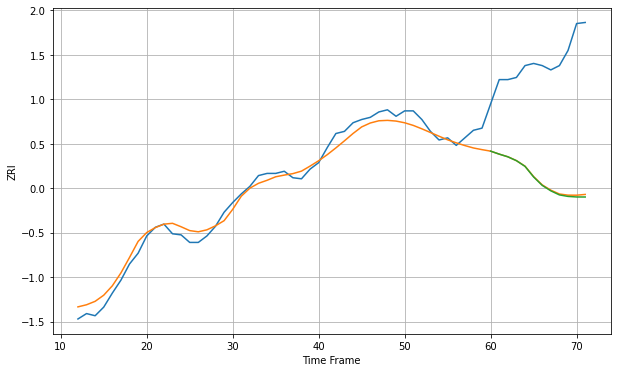

Wall time: 7.07 s
33604 8.196712754189148 109.96984394703047 110.79537499508507 [990.65496325 987.88368772 985.40815386 981.80616678 976.53297795
 966.69985265 958.8927362  953.83041067 950.06865514 948.66313254
 948.15705957 948.12796256]

Got an mse at 0.0049 in round 57 and stopped training

60 60 12


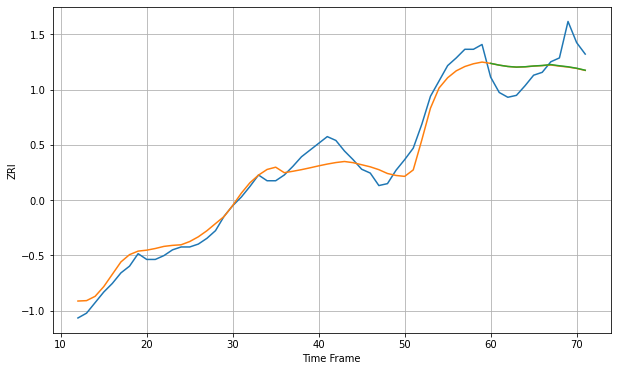

Wall time: 6.45 s
33606 12.444694424838534 23.785962519693392 23.723922325828685 [1539.32635234 1537.48336259 1536.11481669 1535.4552823  1535.79739585
 1536.60008205 1537.11302838 1538.08081312 1536.81779846 1535.77270246
 1534.26526763 1532.17605244]

Got an mse at 0.0050 in round 75 and stopped training

60 60 12


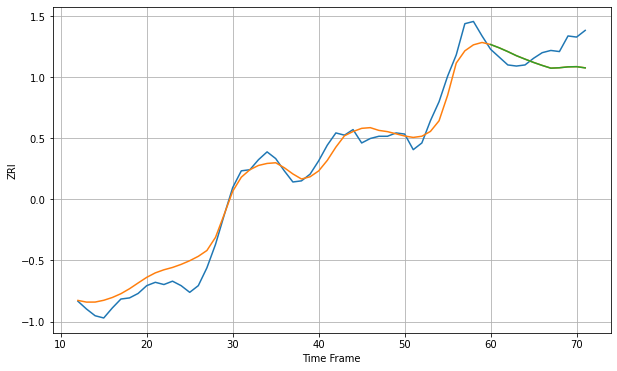

Wall time: 7.35 s
33607 11.430567279009471 17.198308096369445 17.22809051455534 [1457.30879984 1454.35244846 1450.95511639 1447.28393844 1444.21249364
 1441.23281622 1438.55501731 1436.10347383 1436.46596821 1437.25999262
 1437.43687034 1436.34223897]

Got an mse at 0.0050 in round 98 and stopped training

60 60 12


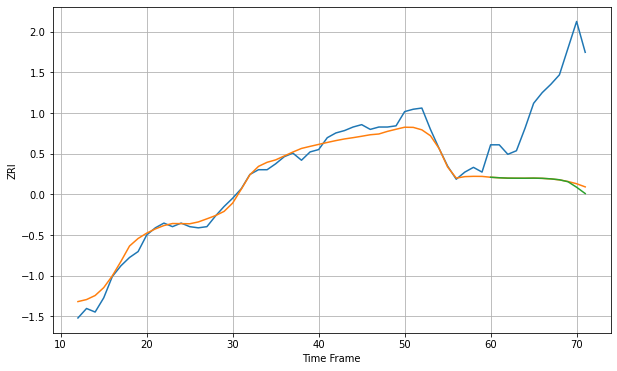

Wall time: 7.58 s
33612 6.90247927117531 77.39745631690532 78.5421658885886 [974.65099529 974.22358943 973.90082265 973.8353113  973.81080831
 973.9013633  973.73880951 973.30471683 972.53620443 970.86512391
 966.23086066 960.90285191]

Got an mse at 0.0050 in round 80 and stopped training

60 60 12


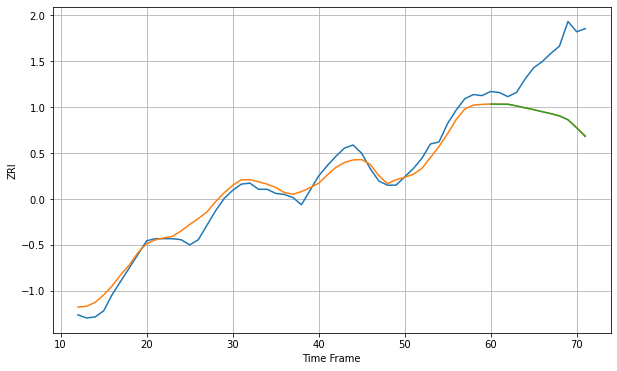

Wall time: 7.86 s
33613 8.914173379045911 59.08492547157834 59.24063816525363 [1186.76747575 1186.63961559 1186.60014109 1184.99701941 1183.0881418
 1181.36027118 1179.36706957 1177.47388798 1175.28955487 1171.49445432
 1163.6518292  1155.26276499]

Got an mse at 0.0049 in round 64 and stopped training

60 60 12


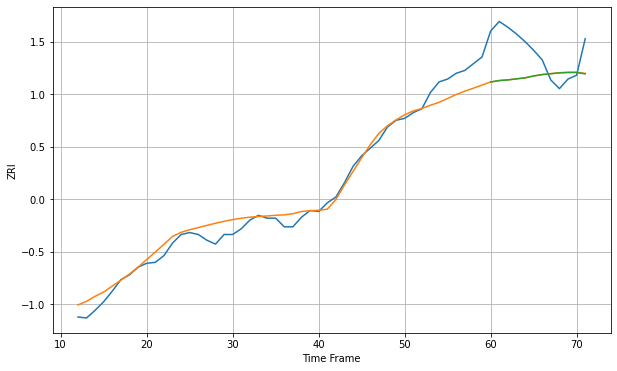

Wall time: 7.02 s
33615 11.660885080249088 36.35470624637478 36.41532181041026 [1265.91832128 1267.41879452 1268.08344991 1269.16105465 1270.20740218
 1272.16030955 1273.59865475 1274.50988928 1275.39209008 1275.81414961
 1275.77874084 1274.36395205]

Got an mse at 0.0050 in round 107 and stopped training

60 60 12


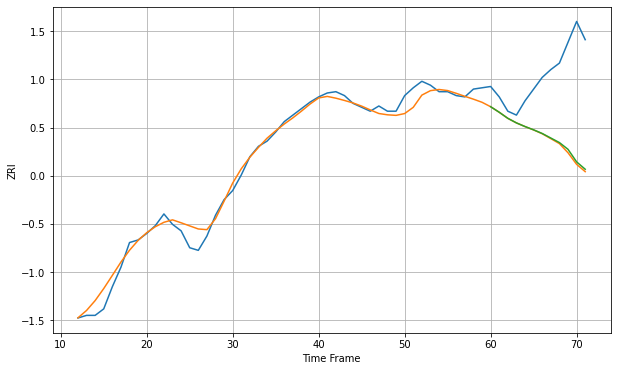

Wall time: 7.8 s
33617 6.625654505984012 57.70102473429596 56.678648087784985 [1061.44445132 1057.17785808 1052.51821025 1049.00931198 1046.20126173
 1043.6642426  1040.86503721 1037.37070748 1033.87383184 1028.68275368
 1019.03231748 1013.36060934]

Got an mse at 0.0049 in round 129 and stopped training

60 60 12


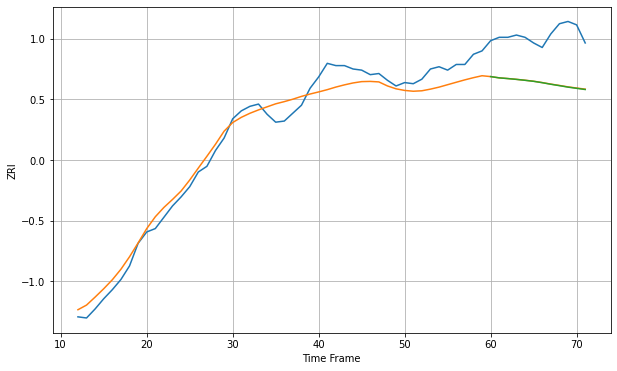

Wall time: 8.6 s
33626 11.239526481928076 42.573916066625806 42.70950640766014 [1424.28701505 1423.15959283 1422.53072862 1421.82111744 1421.00737066
 1420.10823322 1418.89967367 1417.51880612 1416.28650545 1414.98290792
 1413.9202614  1412.87096808]

Got an mse at 0.0050 in round 127 and stopped training

60 60 12


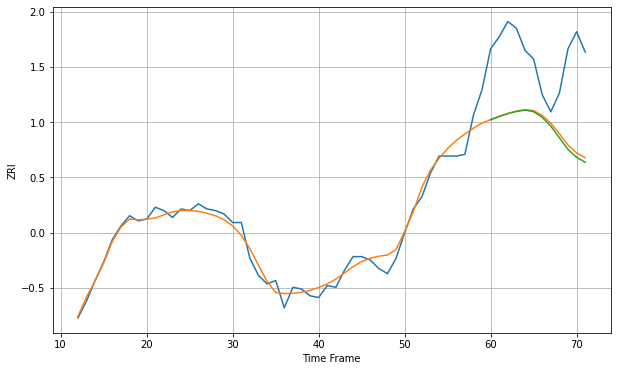

Wall time: 8.35 s
33634 5.449678635902444 44.89885853364398 46.046221768538075 [1210.36773158 1212.2343731  1213.91974071 1215.22643854 1215.98805231
 1215.05853314 1211.75356398 1206.56364579 1199.74853841 1192.87203326
 1188.32685174 1185.37484513]

Got an mse at 0.0050 in round 91 and stopped training

60 60 12


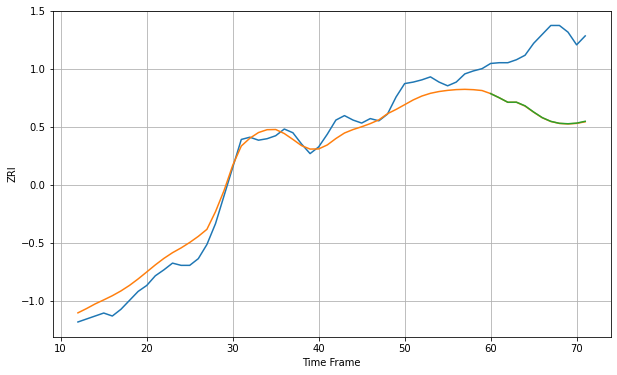

Wall time: 7.81 s
33701 17.111362129956508 95.36234893732802 95.12450735066454 [1323.54014408 1317.97403487 1311.91676098 1312.02731779 1307.14296289
 1298.85035206 1291.33650792 1286.28045495 1283.65907805 1283.06609509
 1283.93916479 1286.38171624]

Got an mse at 0.0050 in round 130 and stopped training

60 60 12


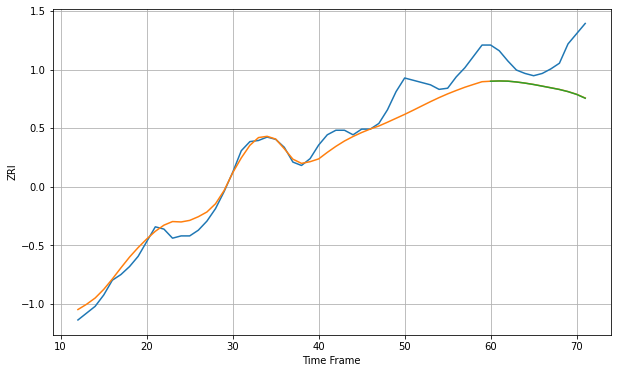

Wall time: 8.38 s
33702 12.22044473363089 31.781797165059782 31.840983758517226 [1150.1572876  1150.37964734 1150.21175912 1149.48429476 1148.48564319
 1147.25976742 1145.82719351 1144.37232626 1142.8879433  1141.00108916
 1138.57080731 1135.19646695]

Got an mse at 0.0050 in round 101 and stopped training

60 60 12


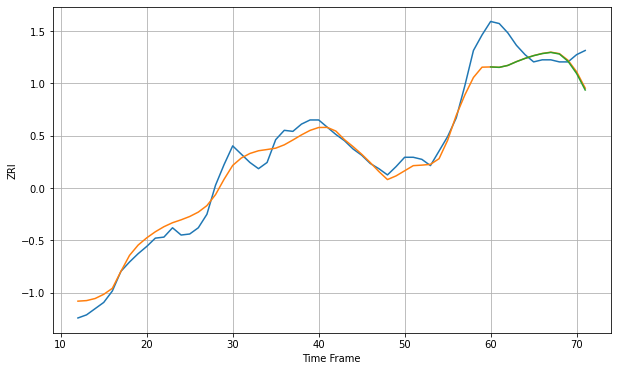

Wall time: 7.89 s
33705 10.918829674650294 23.699207189564753 24.02031907645627 [1305.14008976 1304.73939145 1306.58760767 1310.22017609 1313.35064213
 1316.00795687 1318.01728291 1319.16208303 1317.60018389 1310.58999802
 1298.80464711 1282.89201525]

Got an mse at 0.0050 in round 112 and stopped training

60 60 12


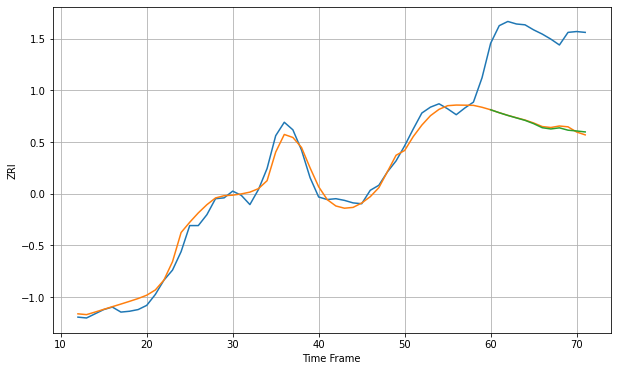

Wall time: 7.89 s
33706 10.437511470296629 108.5589040962585 109.02258800394337 [1466.87520062 1463.36061293 1460.12369127 1457.18299332 1454.27341606
 1450.35486786 1445.5191086  1444.02095967 1445.35787471 1442.56823185
 1441.6373781  1440.4981981 ]

Got an mse at 0.0049 in round 85 and stopped training

60 60 12


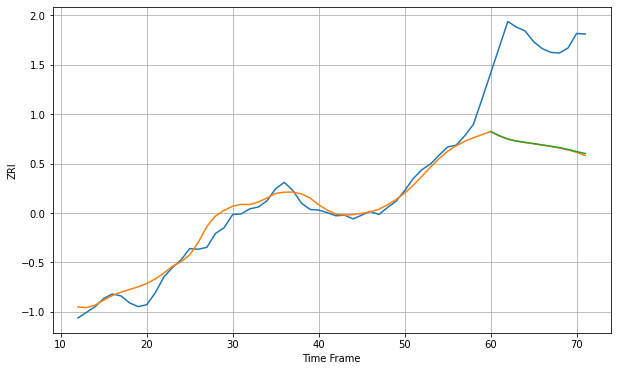

Wall time: 7.57 s
33708 15.814746036754492 163.2900810771243 162.66363803845968 [1528.5063431  1521.94115184 1516.54355306 1513.49824314 1511.31644543
 1509.38095644 1507.3251049  1505.24053857 1503.04106443 1500.19809026
 1496.7275457  1493.78488962]

Got an mse at 0.0049 in round 93 and stopped training

60 60 12


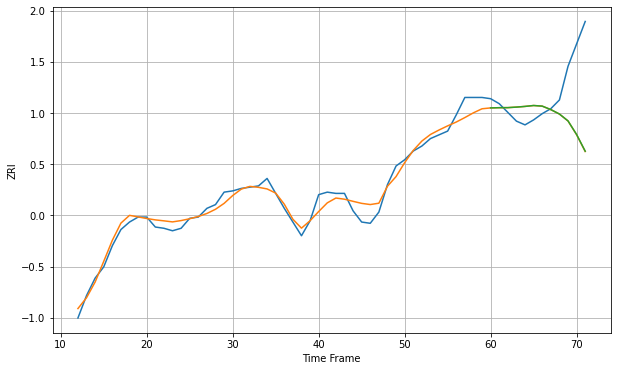

Wall time: 7.44 s
33712 6.607819775534453 39.647486297411895 39.556514414548296 [1139.61657399 1139.79075606 1139.83542299 1140.25635833 1140.81444313
 1141.5458857  1141.05040297 1138.26334364 1134.70930474 1129.18348586
 1118.26098568 1104.87446261]

Got an mse at 0.0049 in round 118 and stopped training

60 60 12


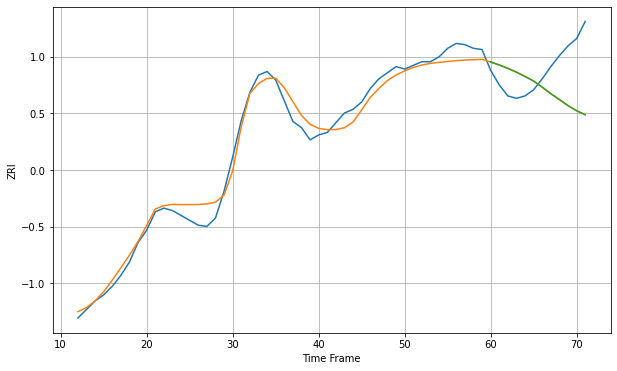

Wall time: 8.55 s
33716 8.339544816501336 35.52858492146586 35.56068326699484 [1184.78874934 1182.35679438 1179.59990611 1176.44664398 1172.94496333
 1169.19889305 1164.14972607 1158.81022251 1153.95980962 1149.03026436
 1144.81362144 1141.54698132]

Got an mse at 0.0049 in round 92 and stopped training

60 60 12


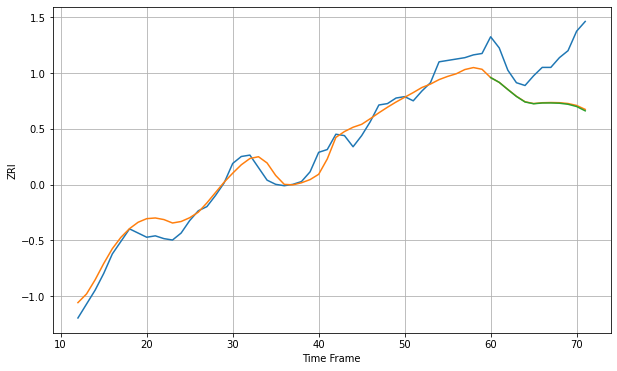

Wall time: 7.46 s
33755 7.724888376114941 32.77886736129436 33.18140611420347 [1071.69227384 1068.23444611 1063.09724109 1058.13565538 1054.16215304
 1052.89100794 1053.4363868  1053.47069457 1053.26702391 1052.52082553
 1050.9074709  1047.80222095]

Got an mse at 0.0049 in round 111 and stopped training

60 60 12


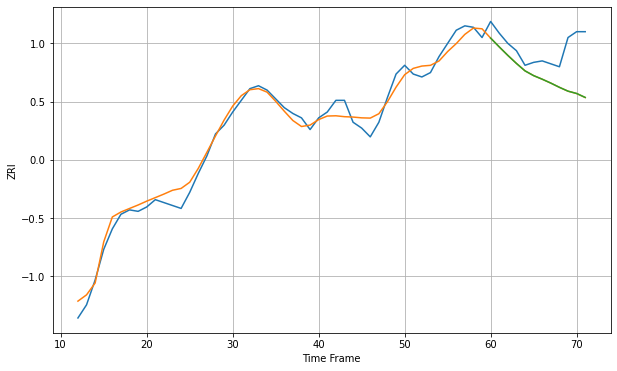

Wall time: 8.14 s
33756 6.0604602179338825 22.66084967222879 22.639352489060766 [1131.61092609 1125.59716746 1119.77886527 1114.27110344 1109.17525576
 1105.92234623 1103.46863576 1100.80324523 1097.91129658 1095.29338869
 1093.70638683 1090.99177928]

Got an mse at 0.0049 in round 69 and stopped training

60 60 12


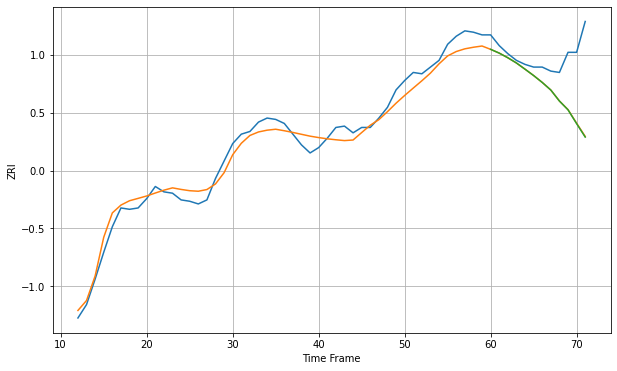

Wall time: 6.91 s
33771 7.433256657590544 32.850417516262915 33.0241919681225 [1162.2210796  1159.40954566 1155.9537678  1152.05543156 1147.42944635
 1142.68853384 1137.56200699 1131.88525545 1123.69015021 1117.14311589
 1106.8394858  1096.81897982]

Got an mse at 0.0050 in round 149 and stopped training

60 60 12


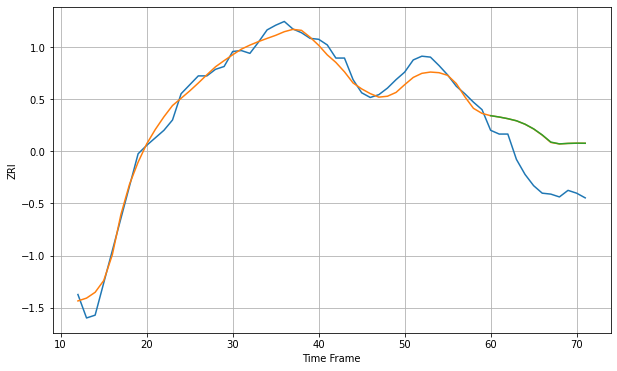

Wall time: 9.22 s
33907 9.450014319968865 48.144302900417344 48.24112953660349 [1235.58495061 1234.16911587 1232.3970451  1230.1726148  1226.5211039
 1221.54017865 1215.09321604 1207.45366185 1205.53083178 1206.04766495
 1206.28736494 1206.21579972]

Got an mse at 0.0050 in round 101 and stopped training

60 60 12


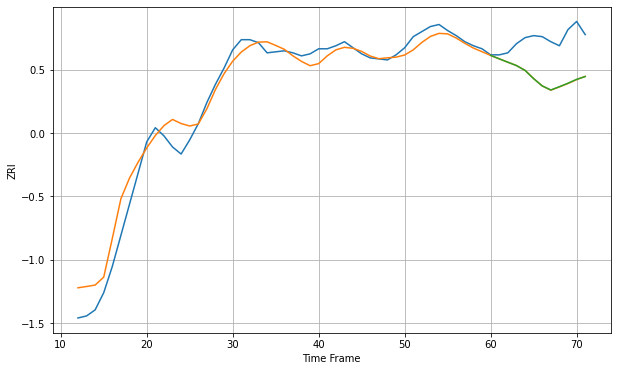

Wall time: 8.28 s
33916 13.747264844006551 38.26074706541918 38.19055382672505 [1143.44833212 1140.07930437 1136.73754041 1133.44082878 1128.68775039
 1120.46849269 1113.3231223  1109.2867726  1112.54721432 1115.98431138
 1119.79741339 1122.55454787]

Got an mse at 0.0050 in round 122 and stopped training

60 60 12


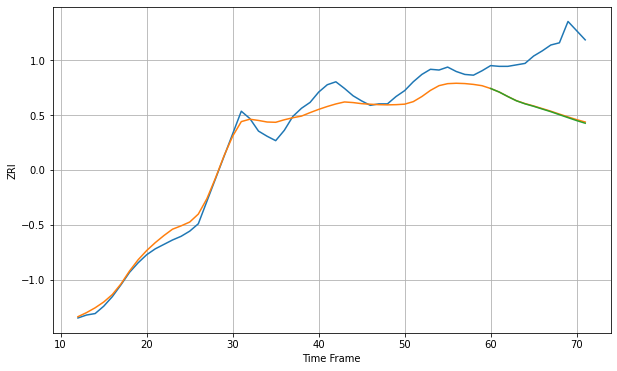

Wall time: 8.29 s
33973 14.932740299596045 82.34257265122987 83.06556663896161 [1078.88938934 1074.06417408 1067.935456   1062.1757504  1058.03330752
 1054.69836676 1051.01148071 1047.36437947 1043.29870721 1039.28816208
 1035.30405668 1031.70063478]

Got an mse at 0.0050 in round 382 and stopped training

60 60 12


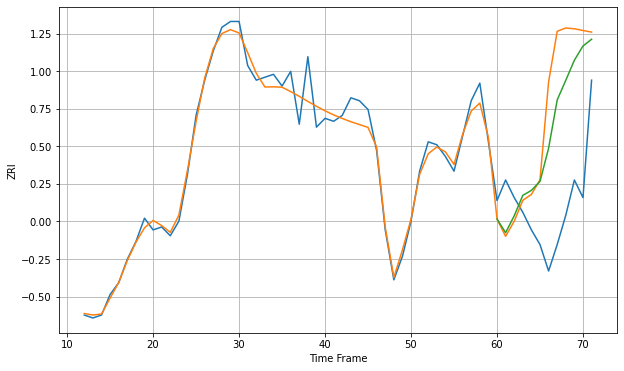

Wall time: 14.4 s
34203 4.124527351537084 41.61476758272247 31.48354510736623 [1469.69930294 1465.05347605 1470.80087952 1477.76322569 1479.46565257
 1482.52626189 1493.82069133 1510.27194955 1516.96815815 1523.80878098
 1528.64221273 1530.94265721]

Got an mse at 0.0050 in round 175 and stopped training

60 60 12


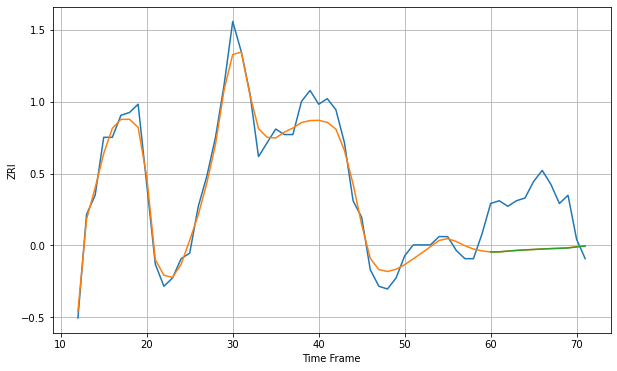

Wall time: 9.7 s
34207 4.796792804349464 18.7319801797476 18.75698119368897 [1174.42357733 1174.47153129 1174.73382997 1174.98828319 1175.17304939
 1175.32864722 1175.49890896 1175.63222125 1175.73297366 1175.87087033
 1176.24944847 1176.58768268]

Got an mse at 0.0050 in round 277 and stopped training

60 60 12


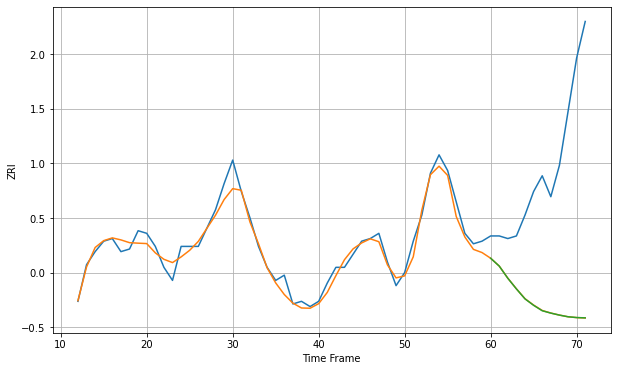

Wall time: 12.1 s
34208 3.402207979117808 58.09791695775299 58.110565060587724 [1191.48006908 1188.47325571 1183.81420857 1179.73624679 1175.92651546
 1173.47193926 1171.40181131 1170.49742085 1169.73204411 1169.09874336
 1168.79950375 1168.67743883]

Got an mse at 0.0049 in round 314 and stopped training

60 60 12


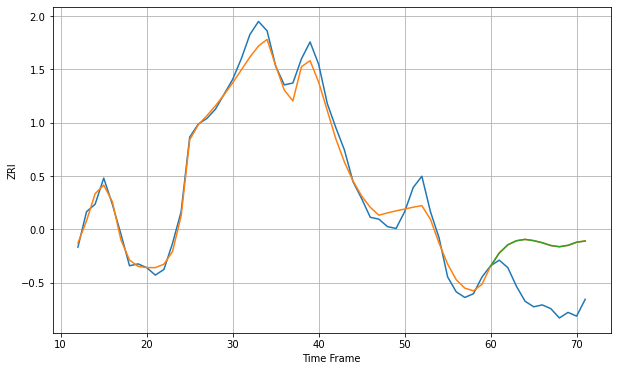

Wall time: 12.7 s
34210 5.836444384628854 29.81071649009501 29.83865752024576 [1285.80012629 1292.81680839 1297.23992683 1299.41808012 1300.15125603
 1299.4865067  1298.3607591  1296.87799709 1296.22767155 1296.99404933
 1298.65827125 1299.22206853]

Got an mse at 0.0050 in round 123 and stopped training

60 60 12


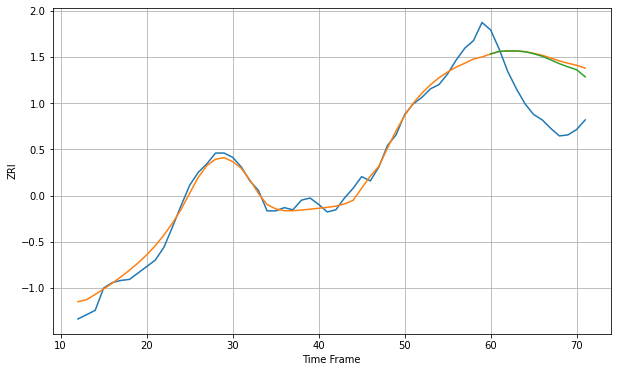

Wall time: 9.04 s
34232 8.799086087237056 50.882151203335326 48.8957522854626 [1491.59158711 1493.96298017 1494.41749196 1494.39839768 1493.65017557
 1491.8138059  1489.43265062 1486.04018724 1482.49242415 1479.51930806
 1476.80949026 1470.25543996]

Got an mse at 0.0050 in round 80 and stopped training

60 60 12


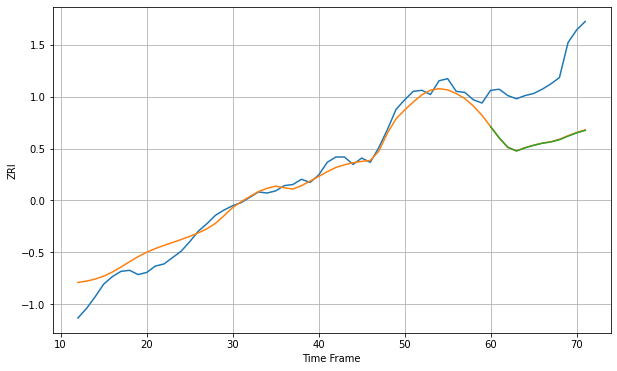

Wall time: 7.3 s
34683 10.185589315227901 64.20370313646762 64.44276294211005 [1096.63108489 1086.05232041 1077.23416582 1073.69135252 1076.65212049
 1078.99869096 1080.94690147 1082.2285926  1084.25748038 1087.70103779
 1090.72677623 1093.13874576]

Got an mse at 0.0049 in round 86 and stopped training

60 60 12


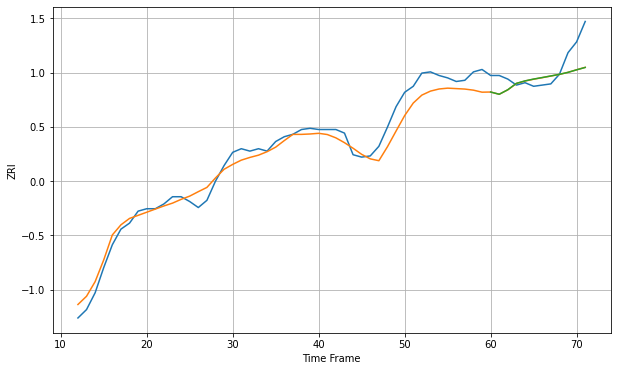

Wall time: 7.55 s
34698 9.376367444268487 15.556936501605488 15.5826637733099 [1234.22901261 1232.36064655 1236.14394805 1241.4638777  1243.51692088
 1245.01768961 1246.29008943 1247.60997251 1248.95500177 1250.61135875
 1252.7226448  1254.70071269]
60 60 12


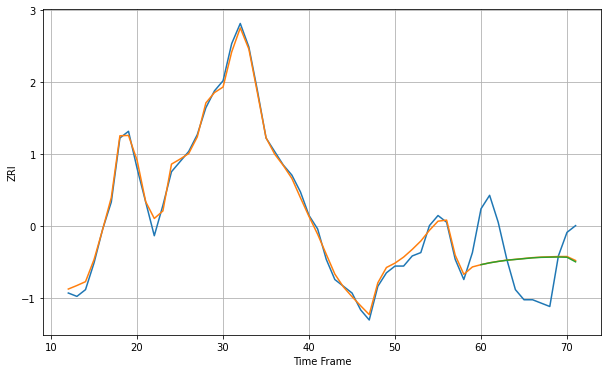

Wall time: 17.3 s
37040 1.7628350567831848 12.113092587516222 12.128543762807446 [736.41504147 736.95333728 737.3730585  737.72787506 737.96181868
 738.20368696 738.44038985 738.58618102 738.6432188  738.68642034
 738.61413565 737.25921024]
60 60 12


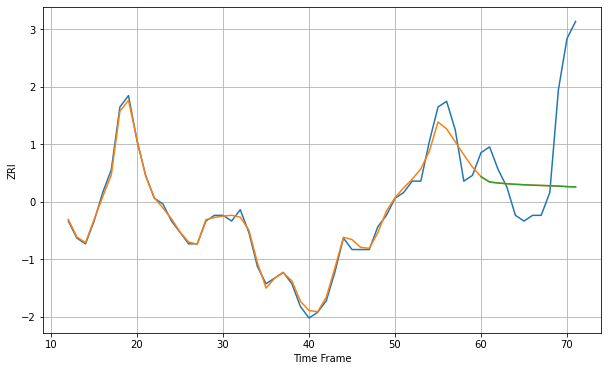

Wall time: 17.3 s
37042 1.3156839166778063 12.875410777769774 12.875047907349321 [717.78181234 716.84363649 716.67097738 716.53937013 716.44083222
 716.36413824 716.29276665 716.23775101 716.18986244 716.12772633
 716.03917369 715.97954345]

Got an mse at 0.0050 in round 177 and stopped training

60 60 12


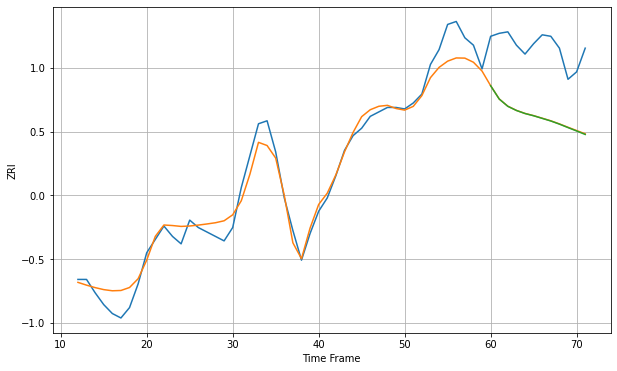

Wall time: 9.3 s
37075 9.357110429847463 46.95759547544188 47.097718927723044 [1109.66389555 1100.65831964 1095.76550916 1092.96076819 1090.89978031
 1089.39644215 1087.63416394 1085.86832922 1083.75158218 1081.41966258
 1079.13239419 1076.7837685 ]

Got an mse at 0.0050 in round 117 and stopped training

60 60 12


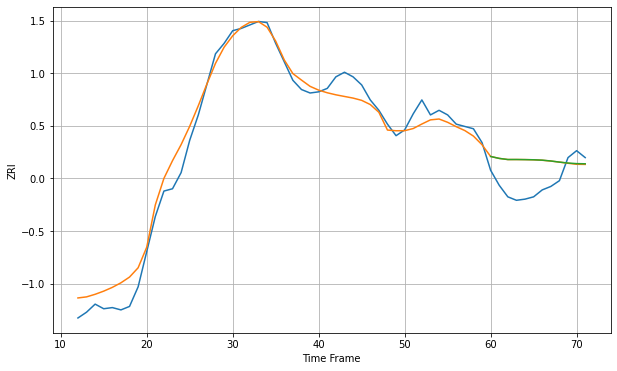

Wall time: 8.27 s
37076 11.648308853518165 23.78052266626578 23.762066432594853 [1101.98252089 1100.30120853 1099.33360223 1099.35684804 1099.24866026
 1099.12611578 1098.79412226 1098.08012042 1097.0964882  1096.29606223
 1095.78953749 1095.64192076]

Got an mse at 0.0049 in round 85 and stopped training

60 60 12


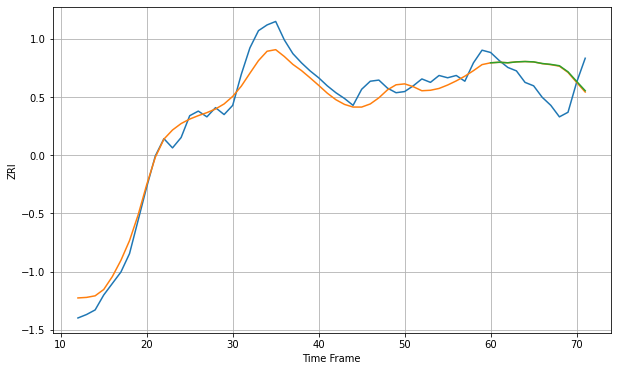

Wall time: 7.24 s
37115 11.204664920709876 24.229787341066082 24.282010257498136 [1151.03352455 1151.48148835 1151.04726699 1151.83179458 1152.14563304
 1151.84094099 1150.42086231 1149.6547568  1148.48046909 1143.18114665
 1134.90183959 1126.76039725]

Got an mse at 0.0050 in round 107 and stopped training

60 60 12


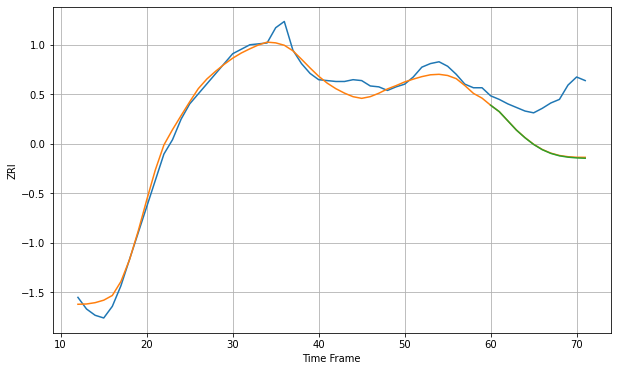

Wall time: 7.73 s
37211 9.658022839459553 53.48142109399661 53.88410893464288 [1184.49777034 1177.34295035 1167.04004493 1156.7092777  1148.14677191
 1140.71979465 1134.88868049 1130.72392742 1128.02855817 1126.510053
 1125.68131509 1125.30861151]

Got an mse at 0.0050 in round 132 and stopped training

60 60 12


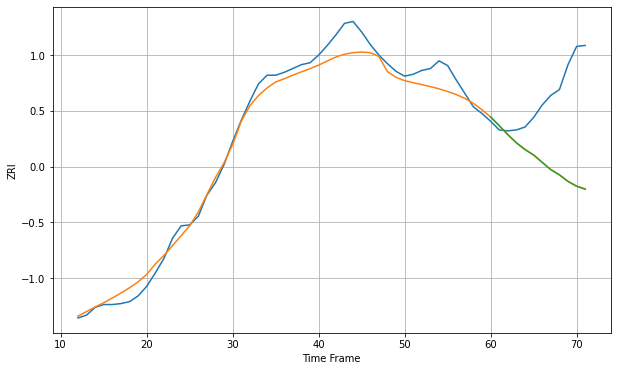

Wall time: 8.66 s
37214 12.765084377032801 80.63741975145754 80.79115839374859 [1149.46591876 1140.37201871 1131.045917   1122.54413616 1115.51042743
 1109.82407666 1102.14833725 1094.61468512 1089.10248695 1082.25004363
 1077.24728628 1074.12042656]

Got an mse at 0.0050 in round 90 and stopped training

60 60 12


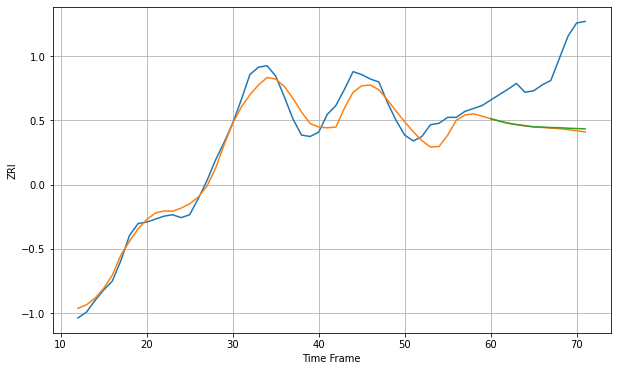

Wall time: 7.2 s
37221 7.835136841990024 42.832317956448485 42.07807937078973 [1335.10321229 1333.49107749 1332.07557699 1331.10729448 1330.34293036
 1329.60875219 1329.40287646 1329.10064032 1328.97614567 1328.63370499
 1328.44537519 1328.18134762]

Got an mse at 0.0050 in round 255 and stopped training

60 60 12


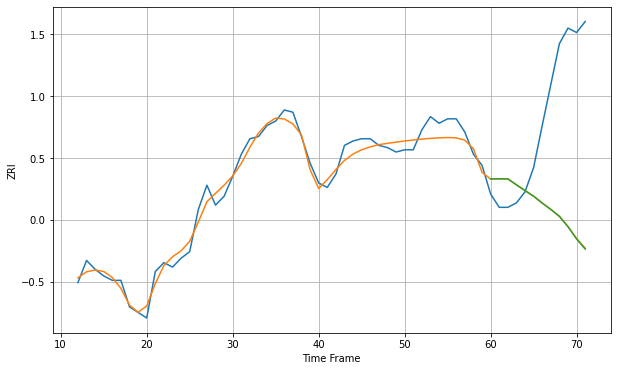

Wall time: 11.9 s
38104 4.408009631251438 56.514425675863734 56.62254960231087 [791.81075246 791.91174599 791.86343334 789.18262784 786.563512
 784.01478875 780.92687997 778.04633034 774.91812252 770.23624662
 764.69539753 760.132605  ]
60 60 12


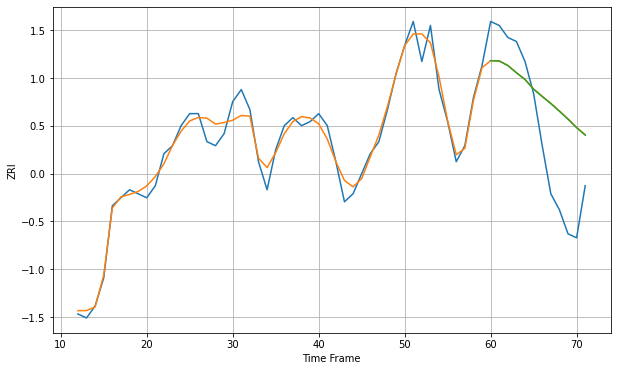

Wall time: 17 s
40391 2.7299632761976738 16.6266049007119 16.588178760695968 [823.20877663 823.13990892 822.00853654 820.20049877 818.50838236
 816.09226488 814.26660461 812.50566067 810.6007479  808.61518153
 806.49532241 804.6320963 ]

Got an mse at 0.0049 in round 216 and stopped training

60 60 12


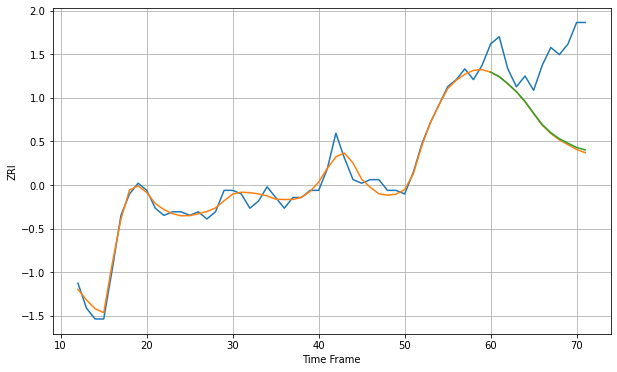

Wall time: 10.5 s
40502 2.0054310226102627 20.656517921988698 20.345886790863183 [812.08521766 810.82777608 808.85937655 806.64201833 803.88630302
 800.58947543 797.42959052 795.15039459 793.43936409 792.19852033
 791.00897312 790.31343935]

Got an mse at 0.0048 in round 370 and stopped training

60 60 12


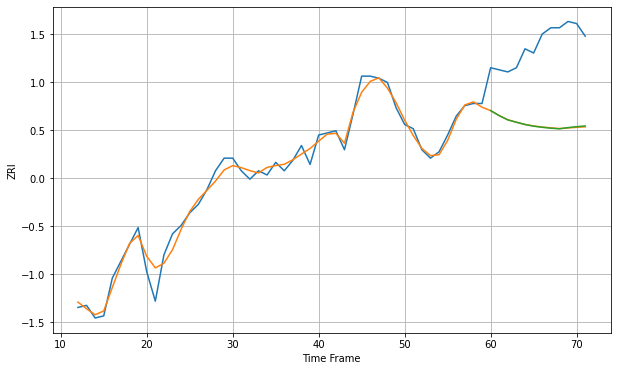

Wall time: 14.4 s
40515 3.9696791546852963 38.67139216670424 38.64026131531932 [884.62087892 882.213186   880.19684638 879.06668582 877.98735457
 877.20317467 876.66749837 876.23228465 875.96430184 876.53572772
 876.96297242 877.32932   ]

Got an mse at 0.0049 in round 273 and stopped training

60 60 12


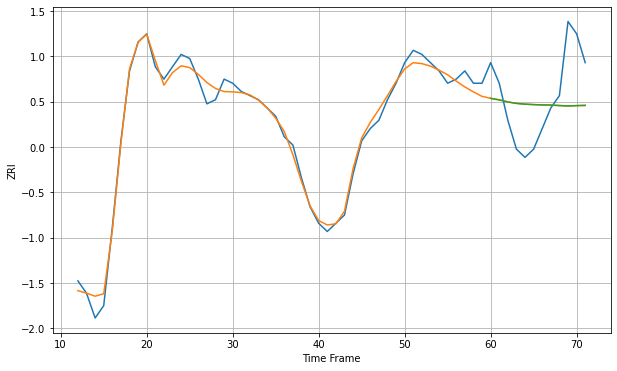

Wall time: 11.6 s
40517 1.9725781887801808 10.767904692678304 10.762271175034648 [872.33889444 871.95893263 871.45596569 871.10758024 870.92373946
 870.81205966 870.73587942 870.70194088 870.5828074  870.48554601
 870.56778588 870.6339793 ]

Got an mse at 0.0050 in round 217 and stopped training

60 60 12


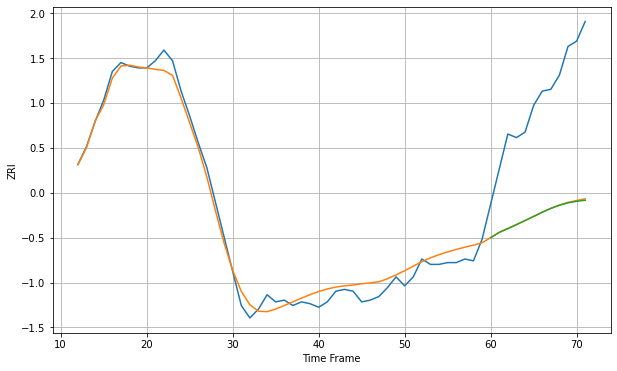

Wall time: 10.4 s
43055 5.43833737020457 66.37297662348612 66.56760671517128 [641.96419884 644.91214728 647.05811509 649.26371424 651.54801004
 653.84600811 656.17572041 658.33614614 660.0991656  661.4589453
 662.31007456 662.91317399]

Got an mse at 0.0050 in round 182 and stopped training

60 60 12


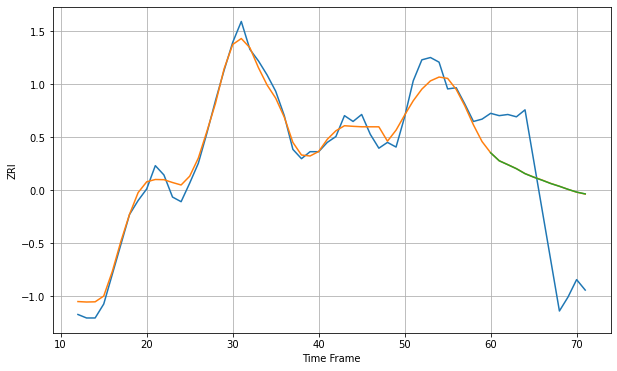

Wall time: 9.17 s
43201 9.634269992081324 62.83150863159736 62.85573341851966 [1077.06661418 1070.17593803 1066.81552746 1063.37019664 1059.11723427
 1056.09123288 1053.43865836 1050.60396297 1048.24581285 1045.63786311
 1043.27587264 1041.71676566]

Got an mse at 0.0050 in round 173 and stopped training

60 60 12


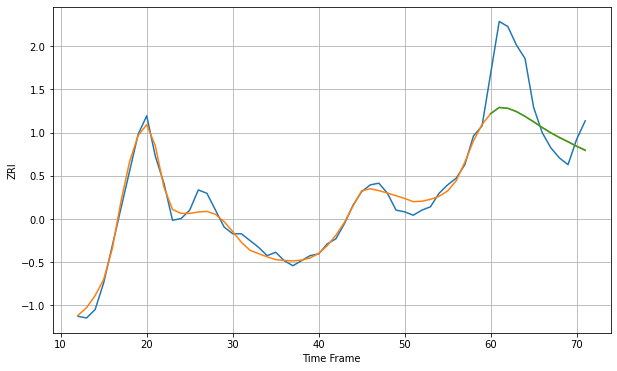

Wall time: 9.13 s
43202 4.571494672621981 27.496992211132135 27.508895771338707 [947.27128034 950.94315854 950.45393291 948.51070995 945.64272201
 942.4318298  939.02553406 935.84485838 933.06207969 930.53689218
 927.87332643 925.4528582 ]

Got an mse at 0.0050 in round 107 and stopped training

60 60 12


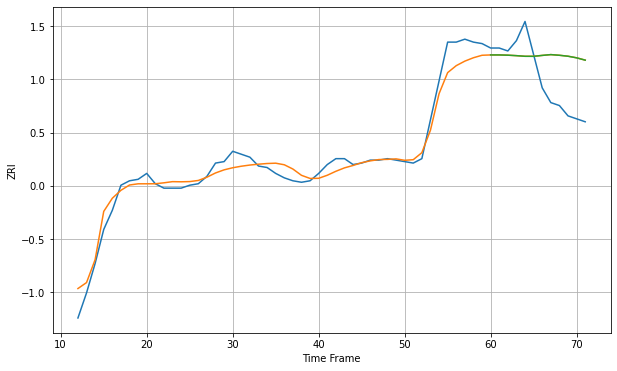

Wall time: 7.64 s
43204 7.547084129177175 26.634778814577047 26.625273230087316 [964.31306007 964.30698915 964.14548181 963.81724274 963.38733048
 963.36835091 963.99410596 964.53062293 964.080199   963.43361054
 962.34000911 960.77175389]

Got an mse at 0.0050 in round 134 and stopped training

60 60 12


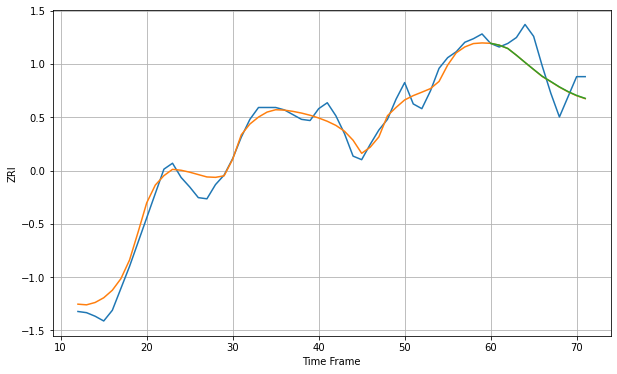

Wall time: 8.33 s
43205 8.919262522167173 17.016677408068876 16.997579495395975 [894.10878351 892.54343642 889.72965166 884.05868225 878.00958127
 872.10212762 866.29513529 861.87752243 857.34494564 853.43662988
 850.16191633 847.69080879]

Got an mse at 0.0049 in round 189 and stopped training

60 60 12


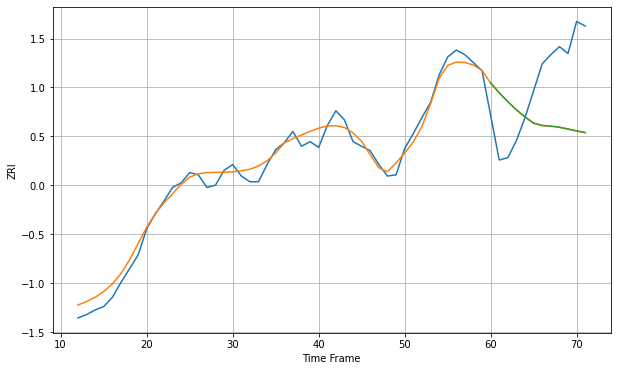

Wall time: 9.76 s
43206 7.8191574292795725 59.22503278465939 59.190126386203026 [978.27688118 969.70805903 961.95176236 954.79892176 948.5633201
 943.18052753 941.11810892 940.60288006 939.59363973 938.07299401
 936.42510595 935.02676397]

Got an mse at 0.0050 in round 222 and stopped training

60 60 12


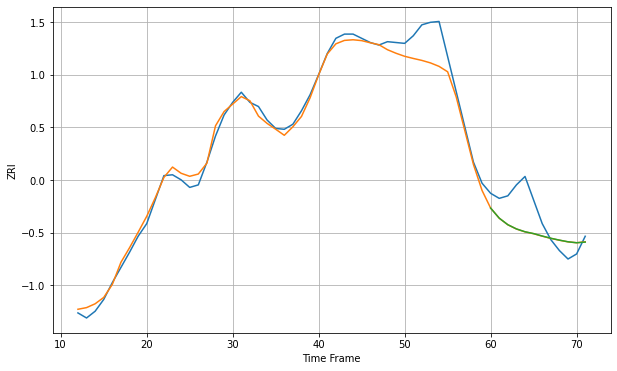

Wall time: 10.4 s
43212 14.545086790894095 31.26117162819721 31.2013599390634 [1062.46017714 1050.48689153 1042.7301207  1037.71543048 1034.33973363
 1032.17273857 1029.28515947 1026.64840275 1024.42177226 1022.44990192
 1021.29084292 1022.08513662]
60 60 12


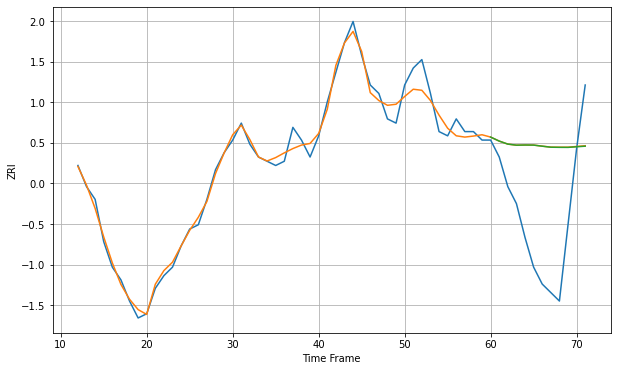

Wall time: 17 s
44035 2.2466216332386684 21.820530306504136 21.811447678819484 [672.70234962 671.75585466 671.0448226  670.79390954 670.83388411
 670.81321922 670.55249467 670.31313923 670.28304537 670.27173335
 670.41724625 670.55581045]
60 60 12


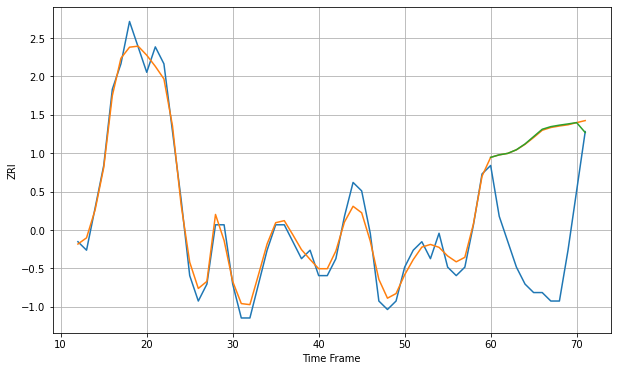

Wall time: 16.9 s
44052 1.3475149632190027 14.31933965816434 14.377770929279883 [619.95820511 620.25523858 620.43313331 620.85969443 621.54409072
 622.41080988 623.27549611 623.58581123 623.76003209 623.90456154
 624.06369098 622.88915423]

Got an mse at 0.0050 in round 112 and stopped training

60 60 12


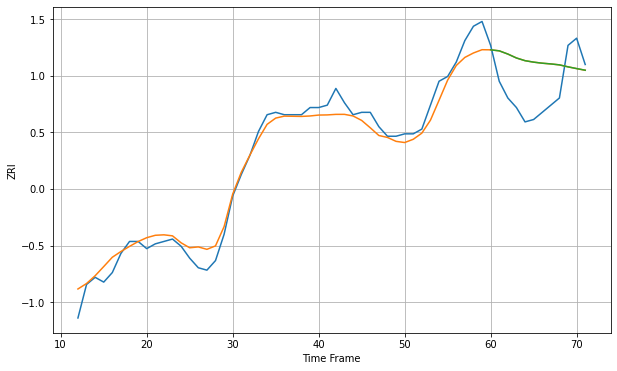

Wall time: 8.24 s
44102 5.059117942603859 16.64146295721035 16.63901163876012 [852.13755898 851.71786599 850.37127962 848.72748984 847.59989445
 846.98872746 846.55253101 846.24755167 845.84725392 845.02634275
 844.30027306 843.61657658]
60 60 12


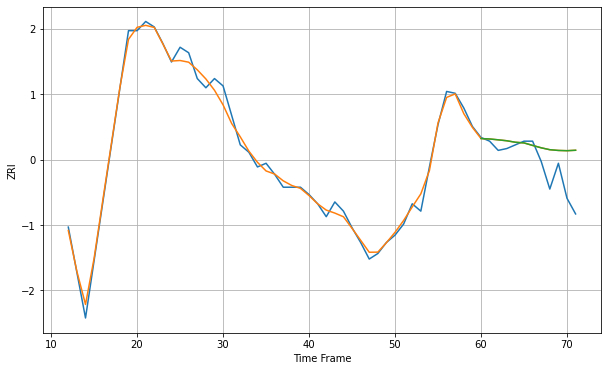

Wall time: 16.8 s
44103 3.631992478918188 14.383780700006582 14.383072782485685 [862.42081491 862.19585625 861.733792   861.22049076 860.41449613
 860.05709488 858.69809747 857.40194003 856.37118771 855.96939988
 855.83053736 856.0618974 ]

Got an mse at 0.0050 in round 84 and stopped training

60 60 12


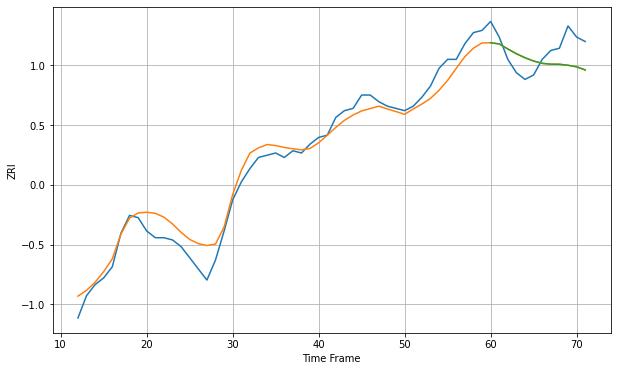

Wall time: 7.15 s
44107 5.8740613820302885 9.46183550725276 9.455140772561274 [868.45548407 867.91911551 865.65560029 863.52066301 861.72014525
 860.25986961 859.20206626 858.85047485 858.8038001  858.35285962
 857.65918778 856.2709091 ]

Got an mse at 0.0049 in round 487 and stopped training

60 60 12


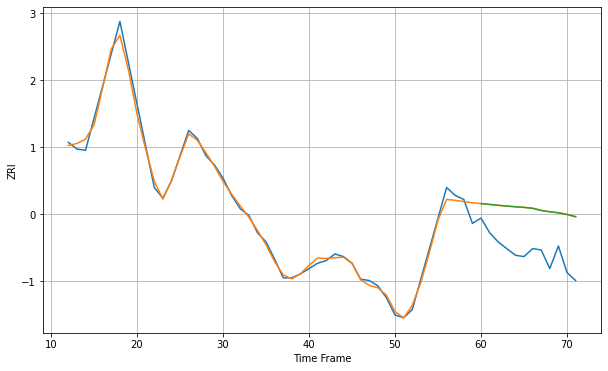

Wall time: 17 s
44108 4.146548965842576 33.59602865776998 33.60116860111024 [802.90383189 802.27083822 801.60723426 801.0416362  800.49802162
 800.061498   799.35190908 797.76181243 796.72025369 795.97756614
 794.7463256  793.0935595 ]

Got an mse at 0.0050 in round 319 and stopped training

60 60 12


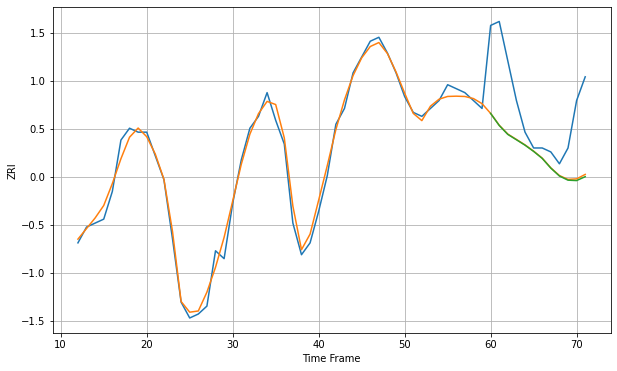

Wall time: 12.7 s
44109 2.0874381369438066 15.085002891220777 15.247875352582941 [715.74059776 712.69072941 710.43168553 709.07625965 707.70883464
 706.13528193 704.36376155 701.90383711 699.90791824 698.85656563
 698.75363102 699.74230729]
60 60 12


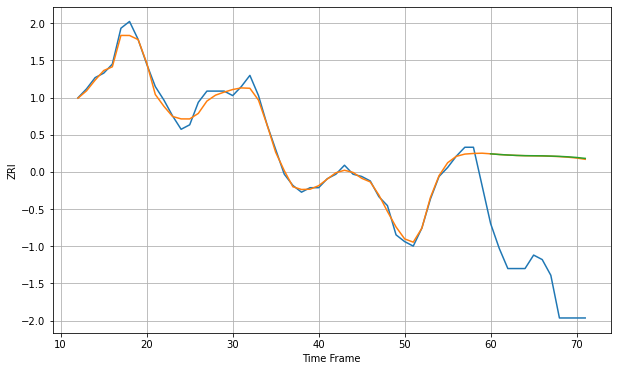

Wall time: 17.3 s
44110 3.099493454141249 55.94825108212276 56.05740138124393 [741.07619305 740.7784871  740.55274564 740.36670155 740.25859036
 740.21926003 740.17976055 740.07386038 739.94040351 739.74235818
 739.45327009 739.042236  ]

Got an mse at 0.0050 in round 179 and stopped training

60 60 12


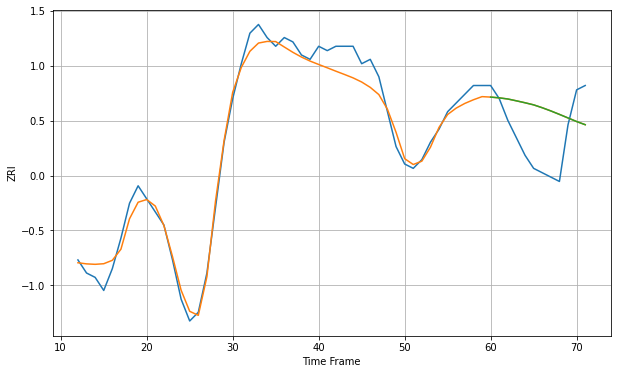

Wall time: 9.31 s
44111 2.9868114426639294 10.348482571869583 10.348718791410883 [758.34447255 758.16715008 757.90760862 757.48635391 757.04382896
 756.56401568 755.90446159 755.17270856 754.37804952 753.55907474
 752.73858428 752.01070253]

Got an mse at 0.0050 in round 396 and stopped training

60 60 12


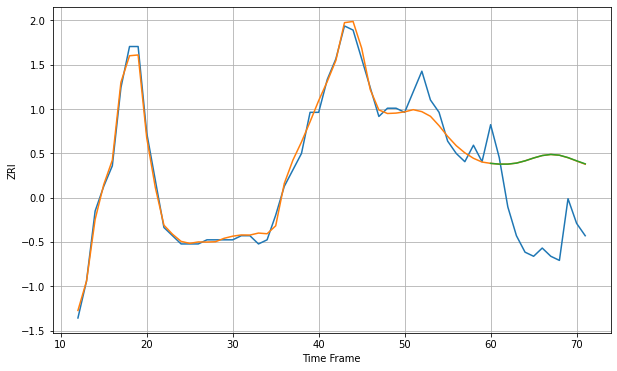

Wall time: 14.4 s
44112 2.283658257122826 18.208731683185132 18.22237039459107 [682.59168897 682.40568153 682.40859699 682.65423075 683.20126939
 683.89747784 684.49322312 684.76103126 684.57483158 683.9906291
 683.21101921 682.47252475]

Got an mse at 0.0049 in round 270 and stopped training

60 60 12


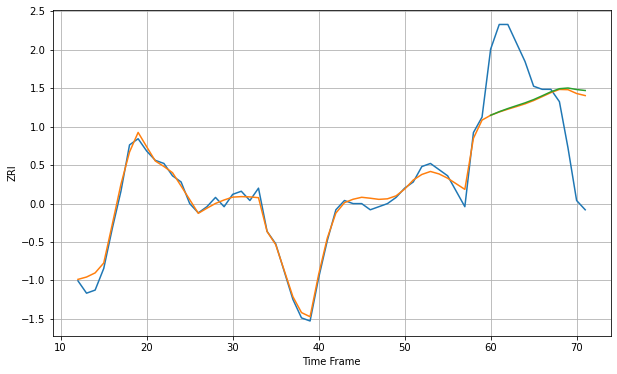

Wall time: 11.2 s
44118 2.0646874614271424 21.58926523236783 21.964105270106554 [961.59994369 962.75611261 963.77659058 964.70074476 965.61844195
 966.6724928  967.90767449 969.18233065 970.20132883 970.42486979
 969.93380853 969.61547003]

Got an mse at 0.0049 in round 128 and stopped training

60 60 12


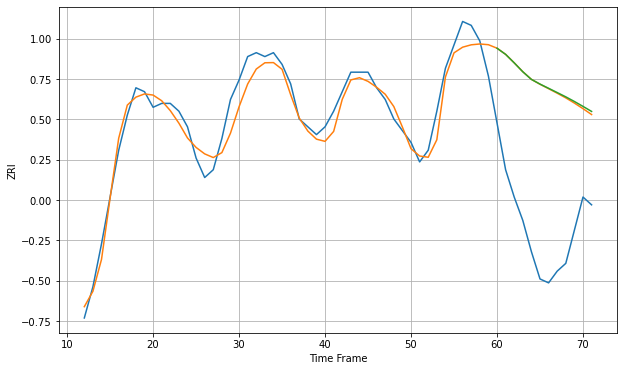

Wall time: 8.07 s
44120 3.619132427521867 37.39838571974415 37.555824314872446 [860.14562594 858.56709888 856.38812205 854.10368549 852.15199163
 850.95104489 849.86875359 848.78077379 847.67874528 846.49159855
 845.23283219 843.93981443]
60 60 12


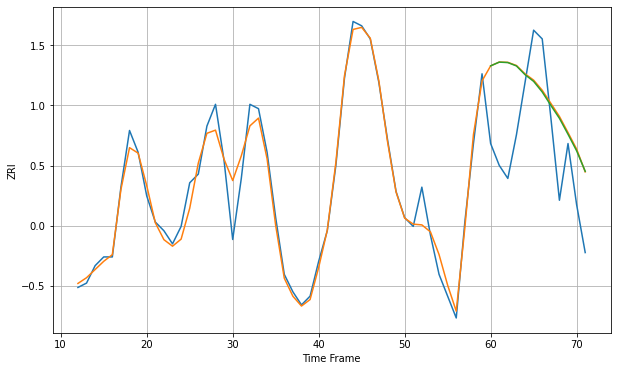

Wall time: 17 s
44133 3.175773475419095 15.826181755406475 15.778902946995737 [1029.8177306  1030.67374374 1030.57316939 1029.79708285 1027.80236455
 1026.2615756  1023.83100981 1020.76065717 1017.79068728 1014.13327944
 1010.34446239 1005.63639657]

Got an mse at 0.0050 in round 407 and stopped training

60 60 12


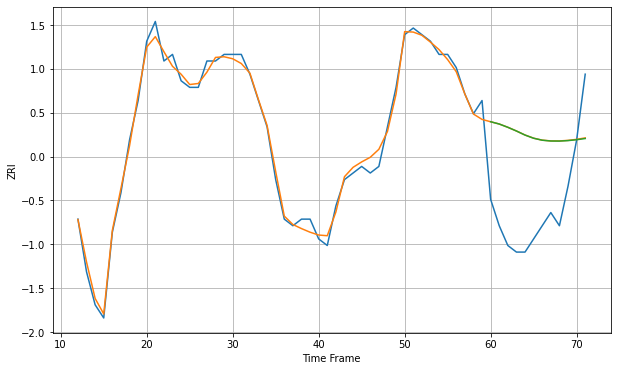

Wall time: 14.8 s
44646 1.1269533169484267 13.47963503559548 13.477911945741205 [645.78145269 645.43600664 644.93750358 644.37476421 643.75982523
 643.27734705 642.97752361 642.85715997 642.84652121 642.91876653
 643.05144835 643.23360092]

Got an mse at 0.0050 in round 305 and stopped training

60 60 12


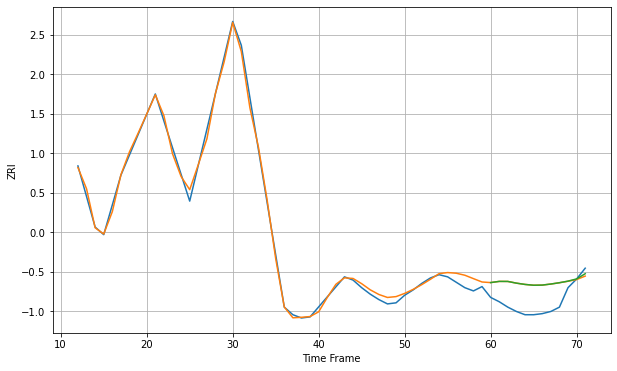

Wall time: 12.2 s
44720 4.671454649698463 20.92596854818955 20.8780993053592 [690.70469477 691.80435246 691.75935522 690.1844076  688.99525269
 688.26067105 688.38852883 689.36178241 690.58414266 692.05275249
 694.09627223 698.89642528]

Got an mse at 0.0050 in round 158 and stopped training

60 60 12


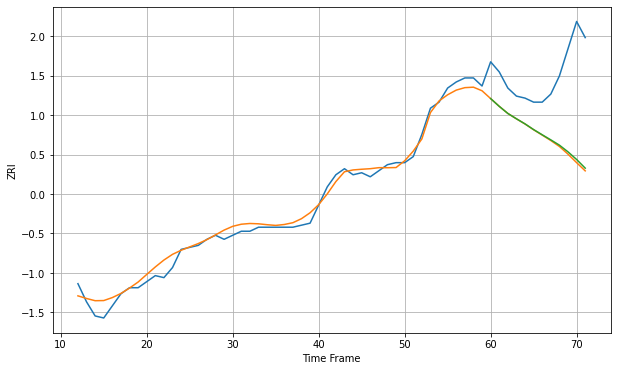

Wall time: 8.74 s
45205 3.593541742698707 35.68664653090521 35.001661977389574 [671.76410779 667.91640294 664.39682976 661.7525154  659.22140514
 656.39507238 653.82294187 651.29349828 648.67617628 645.34929312
 641.56901377 637.28010589]

Got an mse at 0.0049 in round 73 and stopped training

60 60 12


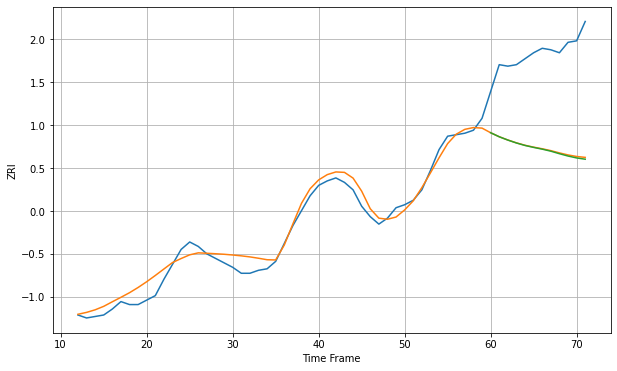

Wall time: 6.62 s
45211 6.117466879343421 64.1631249741264 64.61904581613284 [760.32277655 757.61234581 755.40010936 753.44230432 751.77963809
 750.47473171 749.30295049 747.94140195 746.24270052 744.68473779
 743.41030333 742.55404905]

Got an mse at 0.0050 in round 89 and stopped training

60 60 12


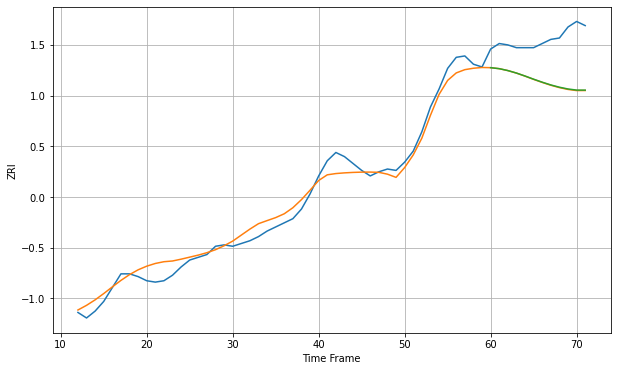

Wall time: 7.05 s
45212 6.968894490112206 31.795632501749317 31.594510726834976 [847.48772192 846.76862859 845.39959931 843.60048635 841.44117767
 839.13484874 836.97103076 834.9806018  833.32569862 832.0416742
 831.24563171 831.22086328]

Got an mse at 0.0050 in round 207 and stopped training

60 60 12


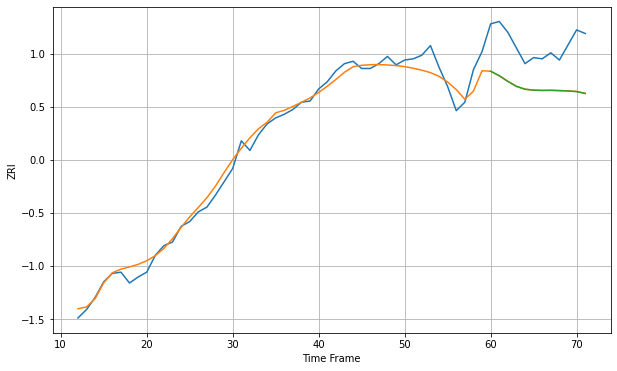

Wall time: 10 s
45219 7.710354209017428 36.76194910561525 36.83350416246688 [993.70667715 990.00008425 985.29241702 981.14377116 978.78372849
 977.98618722 977.73339891 977.83833442 977.58436371 977.31319743
 976.81271604 975.25650203]

Got an mse at 0.0050 in round 398 and stopped training

60 60 12


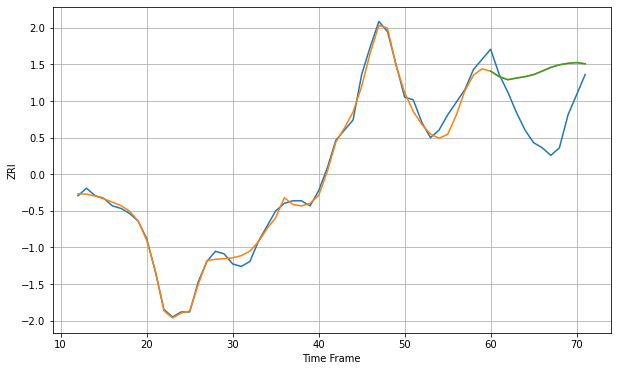

Wall time: 14.7 s
45405 2.413889686059047 20.949072751206213 20.95825502767858 [615.31421382 613.15267873 611.9338177  612.59375246 613.15046974
 613.94816097 615.36620324 616.82549504 617.85848584 618.43232221
 618.72761723 618.25072586]

Got an mse at 0.0049 in round 184 and stopped training

60 60 12


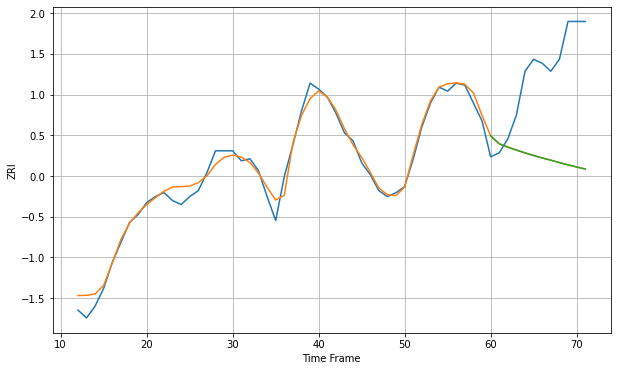

Wall time: 9.31 s
45840 4.1625083666533635 47.843579642360794 47.86133476515508 [800.52677859 796.54662632 794.85682389 793.37692273 791.95116844
 790.62963727 789.39495241 788.2947718  787.07491977 785.921108
 784.86295803 783.84367416]

Got an mse at 0.0050 in round 303 and stopped training

60 60 12


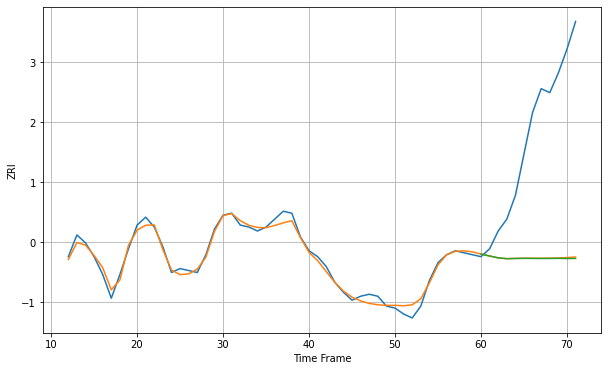

Wall time: 12 s
46143 2.5666737693665054 69.69800931233296 69.93203479067172 [878.31498227 877.34958285 876.40210905 875.98106087 876.09534342
 876.17097488 876.13027982 876.09303097 876.1099021  876.16720853
 876.06817199 876.10042021]

Got an mse at 0.0049 in round 357 and stopped training

60 60 12


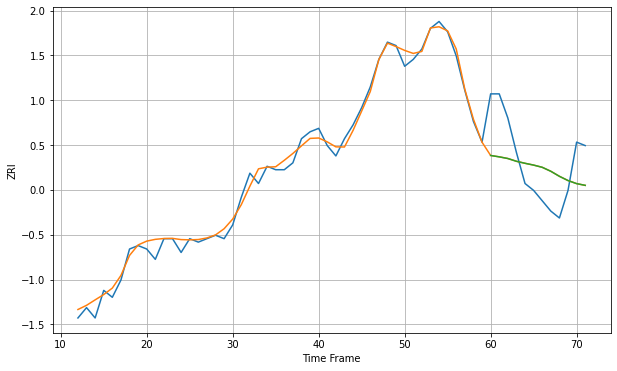

Wall time: 13.5 s
46201 2.1987571511192137 11.347019750830128 11.34876213754209 [660.13096721 659.73076228 659.24618082 658.4398854  657.86382129
 657.34175655 656.70081571 655.54644816 654.08498586 652.85780139
 651.96502226 651.46777073]

Got an mse at 0.0050 in round 278 and stopped training

60 60 12


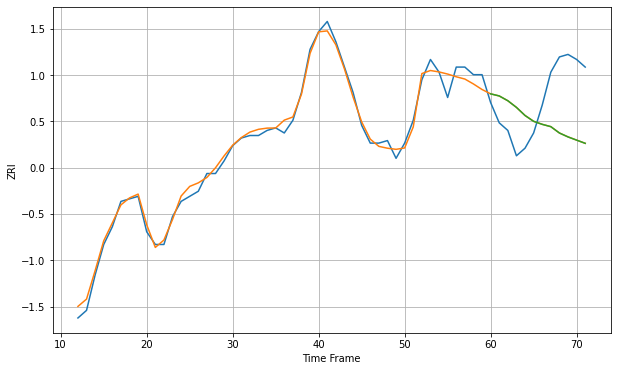

Wall time: 11.6 s
46203 2.8772192249074653 20.838382779690274 20.842459799276835 [769.43686685 768.61022904 766.71903419 764.09982917 760.89867367
 758.59745608 757.40492096 756.49070642 753.98558025 752.44452388
 751.17873552 749.91338   ]

Got an mse at 0.0050 in round 240 and stopped training

60 60 12


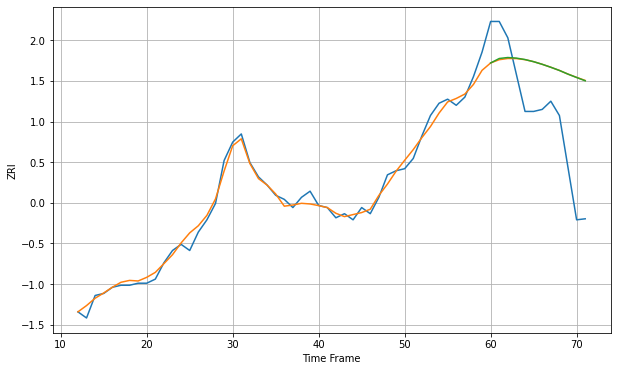

Wall time: 10.5 s
46208 3.243132962593293 35.271829086351154 35.20800528452227 [853.70439764 855.89244383 856.36884781 856.07459799 855.37536886
 854.33767715 853.04930348 851.60346271 850.04493103 848.24091398
 846.60331998 845.00243968]

Got an mse at 0.0050 in round 151 and stopped training

60 60 12


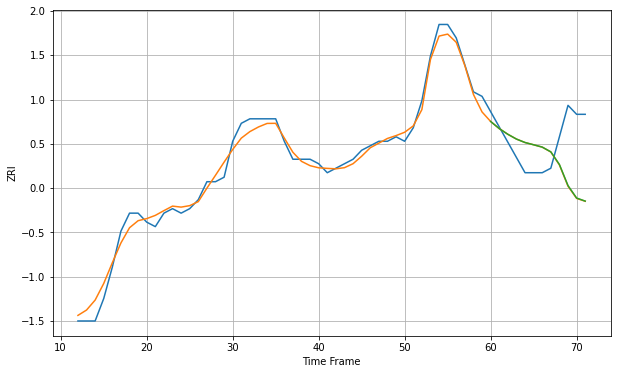

Wall time: 8.94 s
46219 1.8214042308274339 10.175323230045734 10.132144415910133 [657.40818669 655.8249931  654.55566417 653.49145001 652.72415897
 652.22157024 651.70288734 650.64621358 647.83276943 643.13837236
 640.36624127 639.68348575]

Got an mse at 0.0050 in round 363 and stopped training

60 60 12


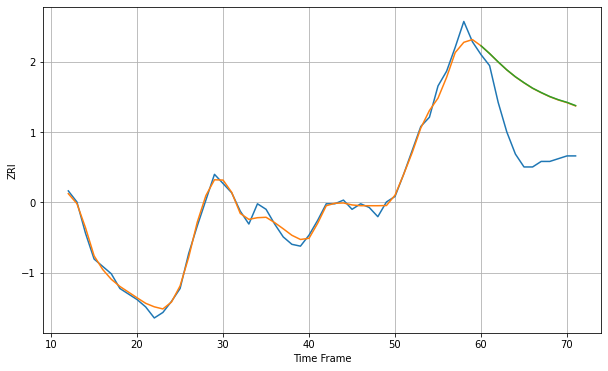

Wall time: 13.6 s
46312 3.255028885435049 32.358116184194024 32.44563894748859 [910.79001333 906.57653052 902.01815842 897.72717403 893.96965719
 890.75445859 887.78604448 885.41010465 883.24130385 881.5030102
 880.08796555 878.3272987 ]

Got an mse at 0.0049 in round 288 and stopped training

60 60 12


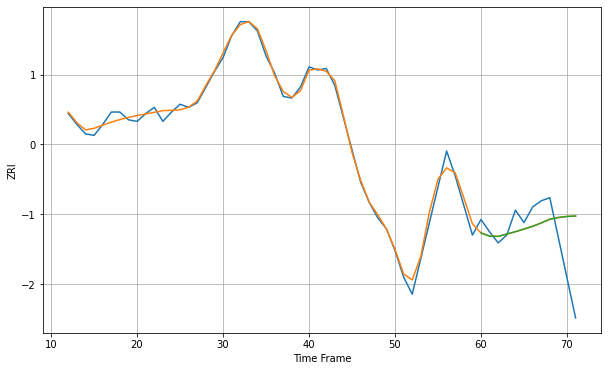

Wall time: 11.9 s
47374 3.58124202936317 23.913788102523117 23.923708556219264 [662.34865999 660.29177641 660.15568396 661.63589084 663.16188198
 664.84577857 666.59797661 668.77940122 671.17885988 672.2854987
 672.96209557 673.21204962]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


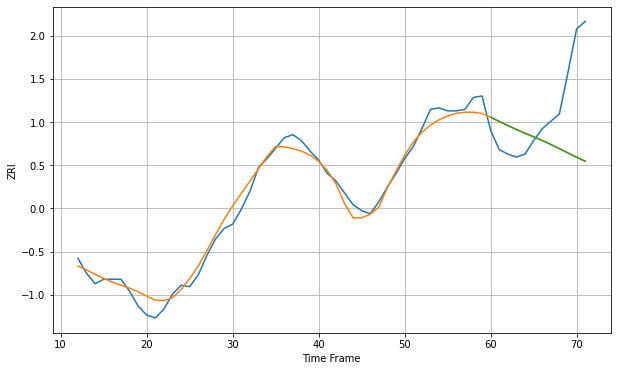

Wall time: 8.39 s
47401 6.0855343066320104 42.164465294515416 42.19644699109537 [1322.70566791 1319.91736504 1317.1332628  1314.44962171 1311.9719999
 1309.58694353 1307.094058   1304.43211964 1301.60997711 1298.70058842
 1295.87697552 1293.15497065]

Got an mse at 0.0050 in round 161 and stopped training

60 60 12


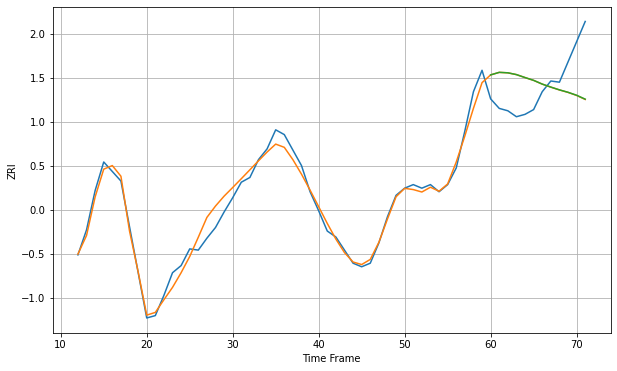

Wall time: 8.84 s
47408 6.900013637733128 31.924172064868028 31.862818215721642 [1414.12241832 1416.26507607 1415.88592539 1414.38381275 1411.9035713
 1409.55005035 1406.41446119 1403.89665625 1401.56295192 1399.52964989
 1397.03467065 1393.7598518 ]

Got an mse at 0.0050 in round 249 and stopped training

60 60 12


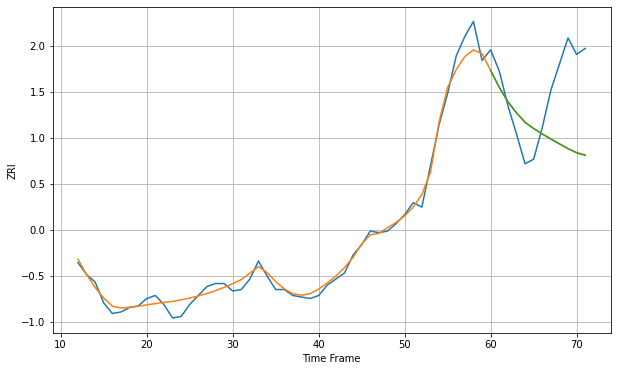

Wall time: 10.7 s
48186 5.356466089217557 41.246862997244634 41.32078432195356 [983.25133491 972.07676038 962.52213331 955.04667025 948.69744344
 944.48423791 940.85263478 937.48783214 934.27157131 931.08453802
 928.31332439 926.5550633 ]

Got an mse at 0.0050 in round 418 and stopped training

60 60 12


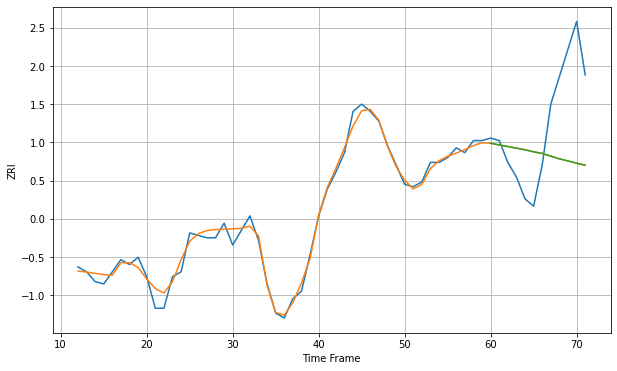

Wall time: 14.9 s
48195 2.8299328750620862 28.33078881837332 28.32547727128642 [857.88836344 857.18631805 856.53893174 855.86968689 855.20785193
 854.36242822 853.69247411 852.57512627 851.46270921 850.61033217
 849.68405271 848.87909528]

Got an mse at 0.0050 in round 157 and stopped training

60 60 12


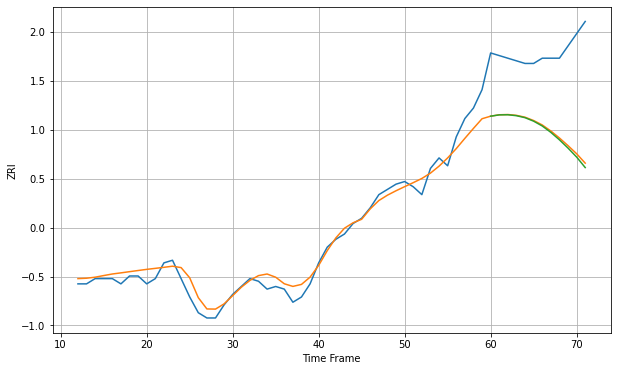

Wall time: 8.73 s
48235 3.7937256989724033 31.179787922232848 31.83223876545519 [733.90191054 734.39683074 734.44586588 734.09010704 733.33172718
 731.99932679 730.17580271 727.74355191 724.90414753 721.75156817
 718.33924387 714.32444812]

Got an mse at 0.0049 in round 211 and stopped training

60 60 12


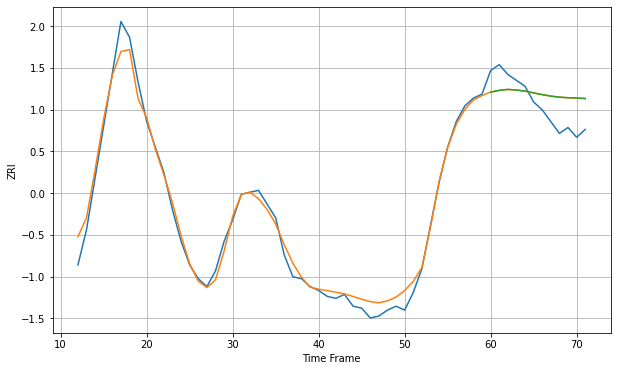

Wall time: 10.3 s
52001 4.931268090401072 12.39713352751178 12.422113983860863 [761.0366815  761.91049682 762.39246035 762.08442681 761.54927702
 760.63583713 759.74540048 759.0049442  758.47108095 758.17627465
 758.02836704 757.77617075]

Got an mse at 0.0050 in round 222 and stopped training

60 60 12


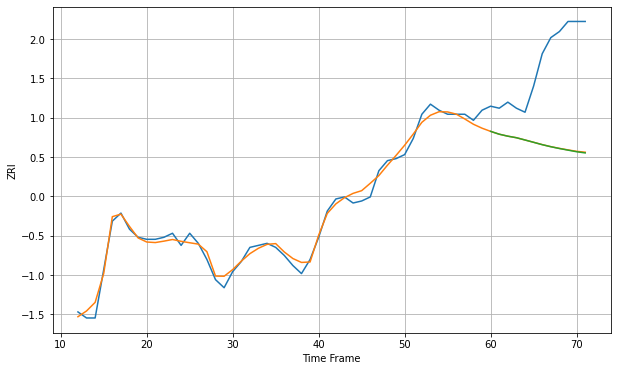

Wall time: 10.1 s
53140 3.3109698425127965 43.298172021212324 43.39728828227597 [841.51216569 840.10728107 839.12580219 838.36001847 837.23318218
 836.08714586 834.92093792 833.89834556 833.01309403 832.20807119
 831.41233086 830.82763051]

Got an mse at 0.0049 in round 323 and stopped training

60 60 12


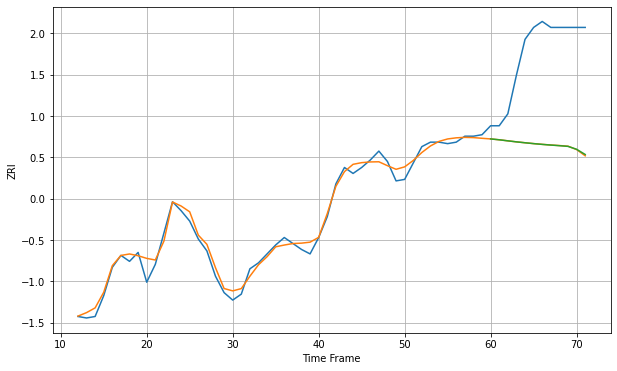

Wall time: 12.7 s
53143 4.53316278234389 66.58913056162649 66.50542240670087 [863.1687673  862.58967287 861.88092773 861.19887394 860.589722
 860.01590848 859.50077785 859.04449942 858.6312426  858.16618978
 856.21199962 852.72306262]
60 60 12


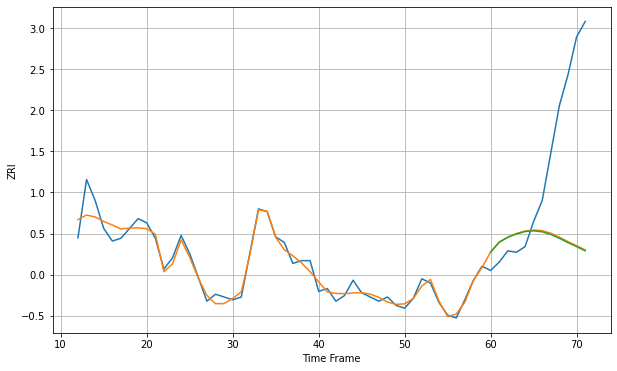

Wall time: 17 s
53202 6.018593543772574 79.94743642822715 80.39157070311843 [1134.14408587 1141.10488687 1144.67054761 1147.09307275 1148.81130889
 1149.29083049 1148.60237858 1146.72648843 1143.93767341 1140.87810219
 1138.02134581 1134.99412548]
60 60 12


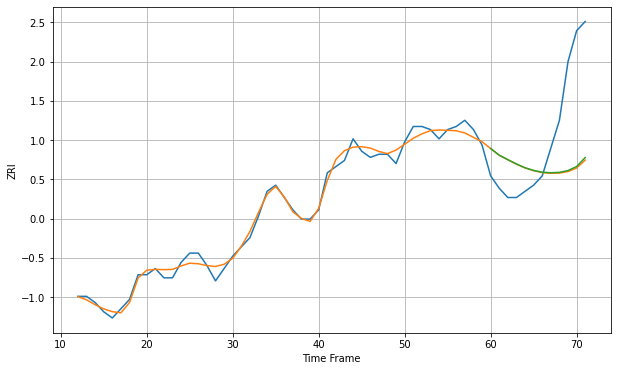

Wall time: 17.4 s
53204 2.03250025237759 22.64805215098971 22.379176628888374 [706.84570196 704.70777139 703.24809127 701.8624464  700.64190165
 699.77447229 699.18724188 699.02295205 699.13843069 699.73188191
 701.02466546 703.94549443]

Got an mse at 0.0050 in round 280 and stopped training

60 60 12


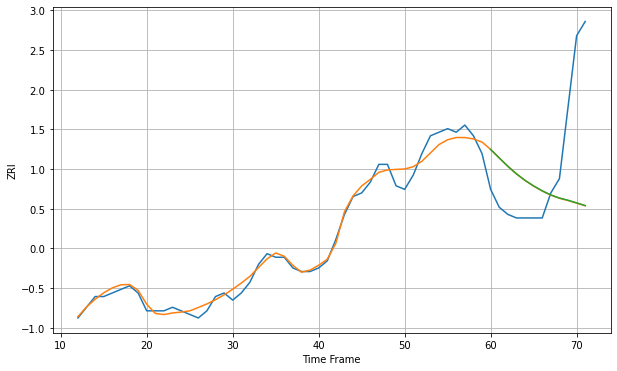

Wall time: 11.7 s
53206 2.0487869259408873 23.20727233674724 23.185829321080053 [713.18180562 710.80170279 708.46651487 706.35283963 704.52327234
 702.95893542 701.59255598 700.44299562 699.56858976 698.95079847
 698.22151603 697.46082942]

Got an mse at 0.0049 in round 55 and stopped training

60 60 12


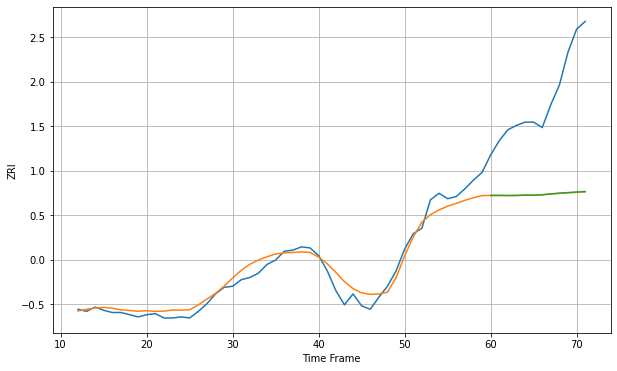

Wall time: 6.07 s
53207 8.514369216935536 93.00552225465663 92.86895492241071 [941.98413779 942.02164527 941.92157821 941.97826653 942.33472235
 942.18788453 942.61708541 943.41123894 944.06920649 944.61313651
 945.109307   945.60414707]

Got an mse at 0.0050 in round 69 and stopped training

60 60 12


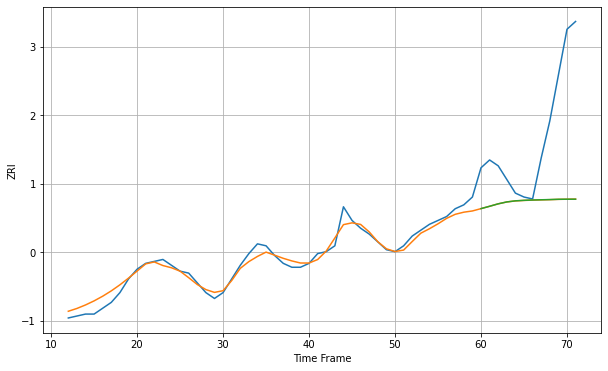

Wall time: 6.77 s
53208 3.299012586072247 44.30651189039197 44.30962203967285 [740.05621167 741.25979186 742.51423122 743.49083901 744.0502391
 744.30639145 744.47693102 744.59165228 744.69748067 744.84270597
 744.880173   744.8833316 ]

Got an mse at 0.0050 in round 232 and stopped training

60 60 12


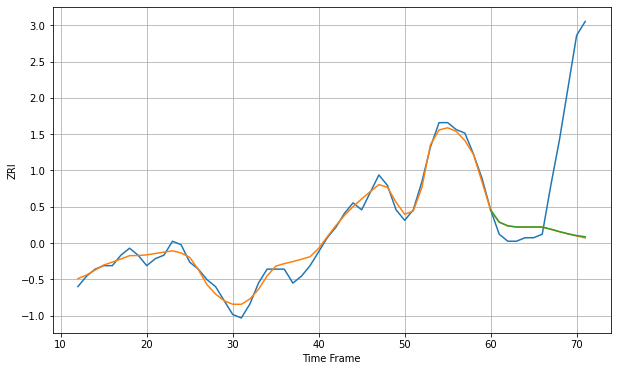

Wall time: 10.4 s
53209 2.014061223513576 28.62034436653973 28.5376667792358 [698.92390764 695.47419576 694.40554693 694.08377493 694.05304771
 694.08820468 694.05520844 693.44494674 692.74615758 692.12588788
 691.61997201 691.28505252]

Got an mse at 0.0049 in round 258 and stopped training

60 60 12


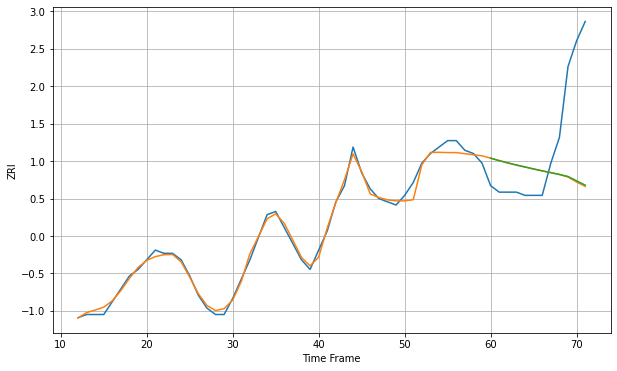

Wall time: 11 s
53210 1.5639270163389856 23.071197501810662 22.92454726504804 [754.54923953 753.78311141 753.08328876 752.41465497 751.81119989
 751.19504055 750.61074895 750.06908255 749.51403565 748.86067899
 747.52134738 746.15529989]

Got an mse at 0.0050 in round 334 and stopped training

60 60 12


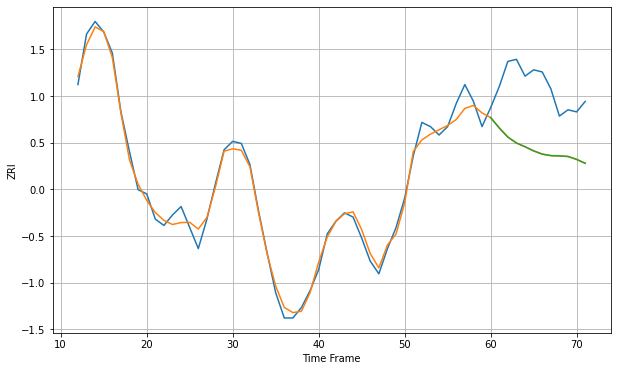

Wall time: 12.6 s
53211 3.943639730384201 29.80539679071631 29.80772116066658 [1177.30808253 1172.3789936  1168.02702656 1165.20578522 1163.42412718
 1161.46417159 1159.92635581 1159.21618998 1159.07730024 1158.80272231
 1157.40793308 1155.55731308]

Got an mse at 0.0050 in round 135 and stopped training

60 60 12


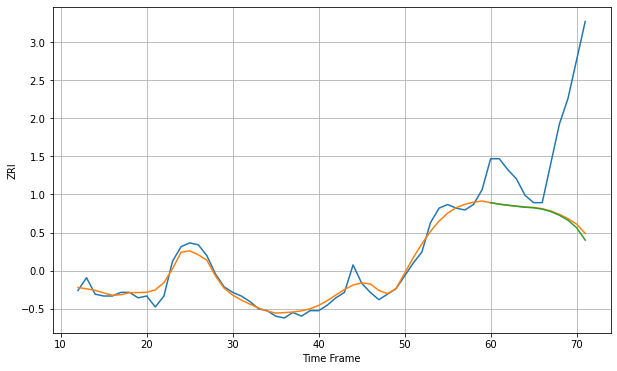

Wall time: 8.08 s
53212 3.757590093797295 50.616899499969705 51.76338520284793 [841.9825473  841.17484746 840.56042053 840.02703425 839.49807853
 839.21415483 838.46021984 837.12789259 835.11531712 832.39835347
 828.33258363 821.53061795]

Got an mse at 0.0050 in round 101 and stopped training

60 60 12


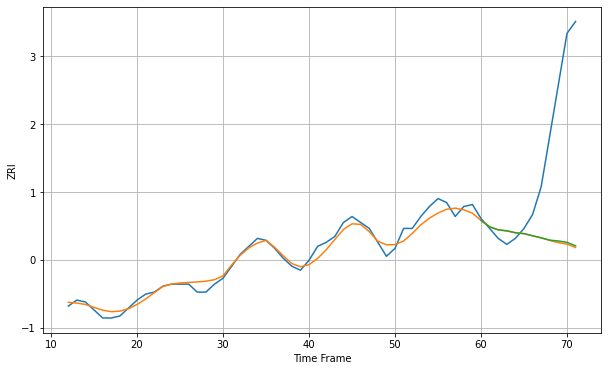

Wall time: 7.58 s
53215 3.0741701219120916 53.27975140413158 52.86617594093261 [752.01530664 748.83339822 747.27879343 746.77755919 745.82263094
 745.36083457 744.30180863 743.26107412 742.11820202 741.6793032
 741.00719993 739.26614774]

Got an mse at 0.0050 in round 162 and stopped training

60 60 12


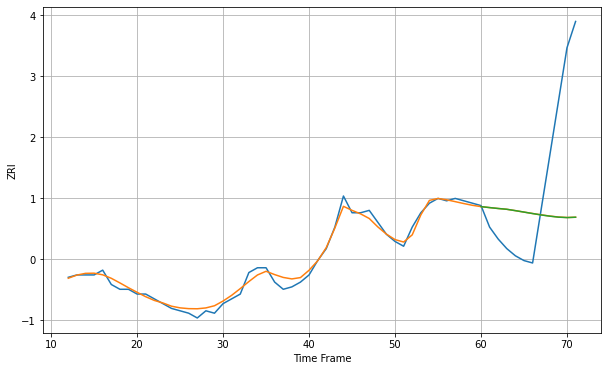

Wall time: 9.01 s
53216 2.0222001435848176 36.98894009468427 37.00183918898266 [723.57064037 723.16397603 722.78515357 722.45227189 721.88272077
 721.27791278 720.66854271 720.08427436 719.57285311 719.1648426
 718.98115414 719.13803082]

Got an mse at 0.0049 in round 183 and stopped training

60 60 12


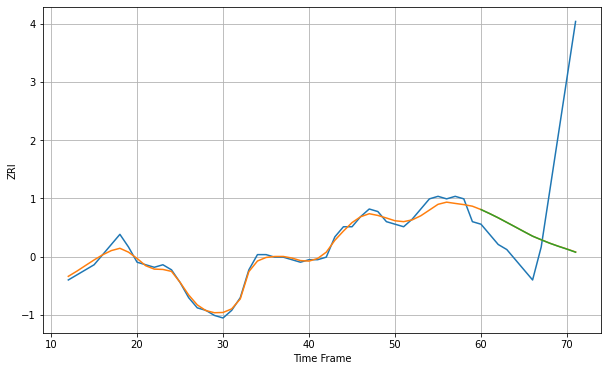

Wall time: 9.24 s
53218 1.9886464352544848 36.79725484194604 36.8198398206884 [730.77286337 729.1968129  727.51973377 725.7150577  723.90216287
 722.07365021 720.27739393 718.864825   717.49721985 716.28616907
 715.16791893 713.95527699]

Got an mse at 0.0050 in round 451 and stopped training

60 60 12


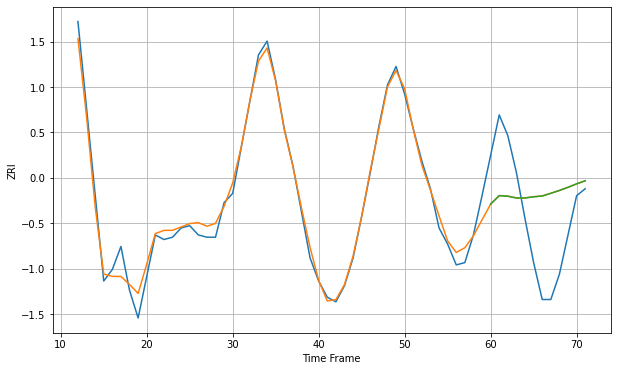

Wall time: 15.4 s
53403 4.16886546206231 27.813688995129933 27.81649555829811 [831.35479616 835.00977244 834.75039959 833.98423924 833.99678648
 834.51774489 834.85735885 836.0335646  837.25145363 838.62418113
 840.12486316 841.46414661]

Got an mse at 0.0050 in round 143 and stopped training

60 60 12


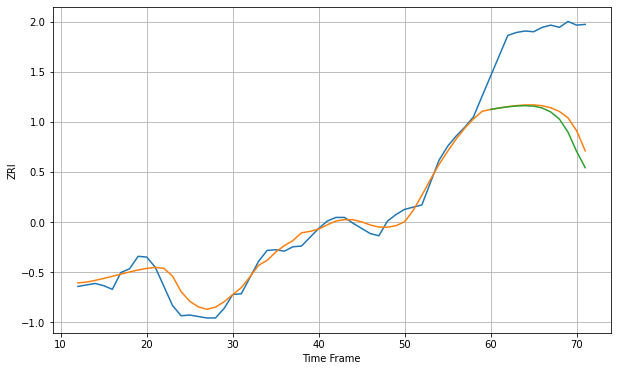

Wall time: 8.3 s
53590 12.828610309782047 112.32434969787897 122.28340067303428 [1099.14471293 1101.09225167 1102.68111785 1103.84656432 1104.29906549
 1103.63264674 1101.12027709 1095.63118768 1085.98672887 1068.20588457
 1041.9078031  1019.79885141]
60 60 12


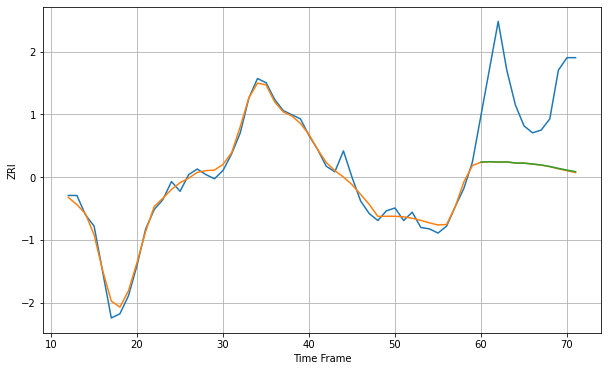

Wall time: 16.6 s
53703 4.851403960697617 60.12321798305019 59.95602174719646 [1295.93550776 1296.25732637 1295.99604866 1296.11606258 1295.32522896
 1295.25119141 1294.59185441 1293.90043052 1292.83639734 1291.47269649
 1290.23969831 1289.08941435]

Got an mse at 0.0050 in round 139 and stopped training

60 60 12


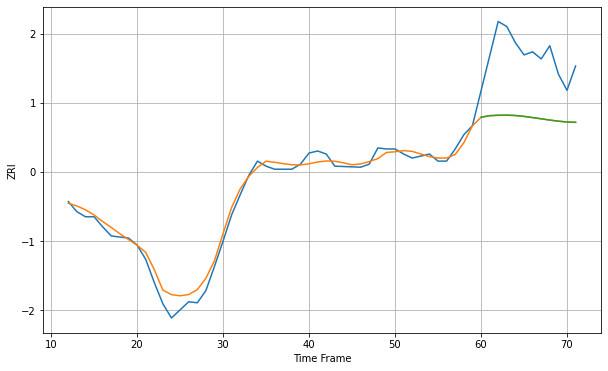

Wall time: 8.27 s
53704 7.451055008705104 63.72169423547471 63.615235221186346 [1106.33714419 1107.95022166 1108.34614819 1108.46689756 1108.11494827
 1107.24307128 1106.07423062 1104.83715257 1103.58910147 1102.49130493
 1101.71307369 1101.43903178]

Got an mse at 0.0049 in round 216 and stopped training

60 60 12


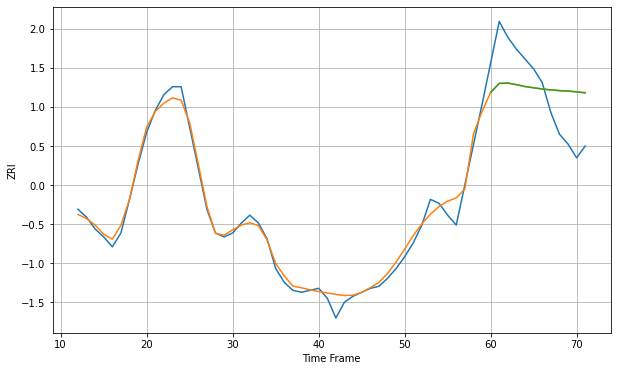

Wall time: 10.1 s
54220 4.0012298459000135 21.48537834629552 21.456155178823074 [674.10353421 678.65623799 678.81482988 678.04532151 677.06723056
 676.44345322 675.84365432 675.37190521 675.0123546  674.76887188
 674.36528286 673.8523683 ]
60 60 12


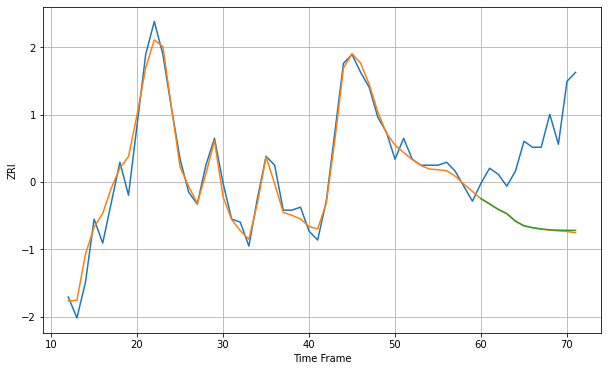

Wall time: 16.4 s
54601 3.88486865100011 29.76793109048154 29.57964728853342 [827.82913455 826.06981392 824.24482253 822.80203873 820.28632059
 818.75834386 818.13203737 817.70363851 817.44133078 817.31915453
 817.28403197 817.24911192]

Got an mse at 0.0049 in round 194 and stopped training

60 60 12


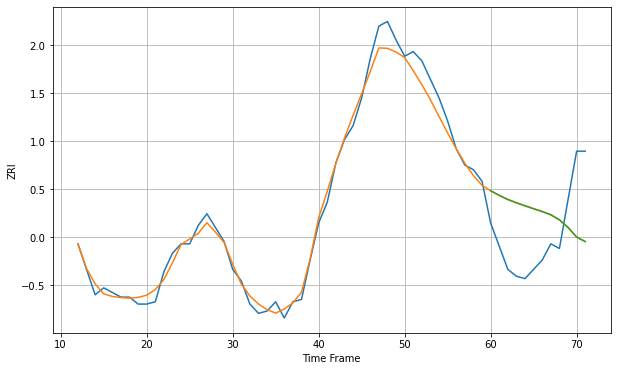

Wall time: 9.56 s
54901 4.376819292086301 25.92097368386958 25.881380740921653 [724.92418083 722.91139623 721.13832168 719.70639295 718.39825577
 717.13030652 715.90978332 714.51710774 712.3686016  709.11160562
 704.9946948  702.95777548]

Got an mse at 0.0048 in round 129 and stopped training

60 60 12


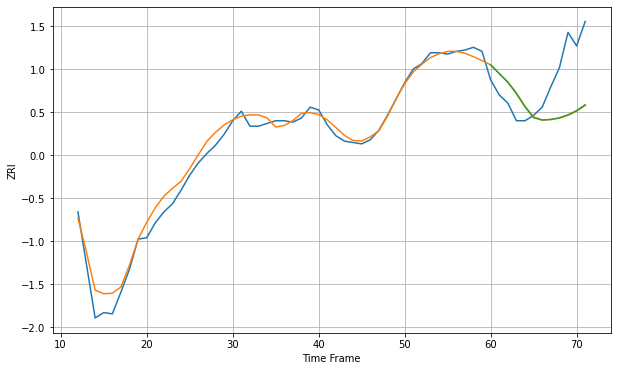

Wall time: 8.33 s
55101 6.845169728166556 32.91718600784843 32.699358105238275 [1327.15907305 1320.67281615 1314.31150351 1305.97589212 1296.19593073
 1288.25818607 1286.51781345 1286.94307429 1288.11151604 1290.35490363
 1293.46521329 1297.73374994]

Got an mse at 0.0050 in round 200 and stopped training

60 60 12


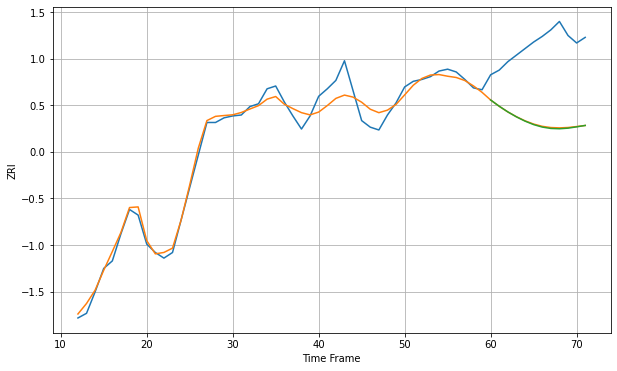

Wall time: 9.6 s
55104 10.063060494637833 83.01785020775905 83.48403800321717 [1291.03274968 1284.34810745 1278.31014557 1273.02557157 1268.45462865
 1264.73840749 1262.09006308 1260.62898817 1260.29672518 1260.91830849
 1262.33316509 1263.83819944]

Got an mse at 0.0050 in round 78 and stopped training

60 60 12


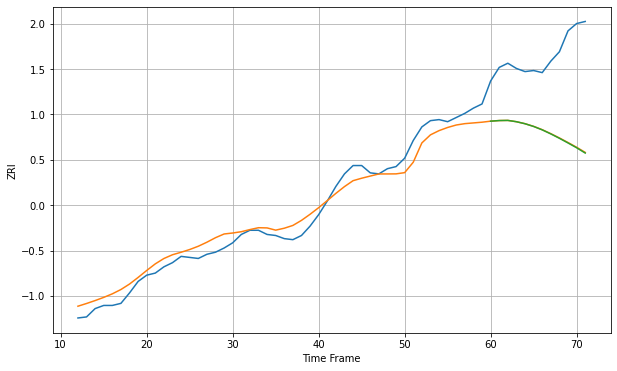

Wall time: 7.26 s
55106 10.251996651097038 76.84454096972385 77.10819326316891 [1074.50159058 1075.08858462 1075.23552686 1073.9776791  1072.0366894
 1069.43271931 1066.17360152 1062.28945263 1058.09281444 1053.6237315
 1049.03544598 1043.96648378]

Got an mse at 0.0050 in round 128 and stopped training

60 60 12


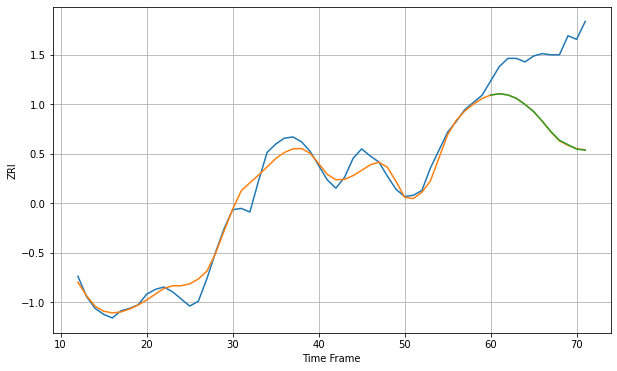

Wall time: 7.93 s
55306 8.367651344131936 62.81180514583902 62.740245142134235 [1300.20143391 1301.24863607 1300.31509726 1297.38536816 1292.27525494
 1286.30656833 1278.28459804 1269.62934681 1262.26848326 1258.54016853
 1254.76746745 1253.95454769]

Got an mse at 0.0048 in round 169 and stopped training

60 60 12


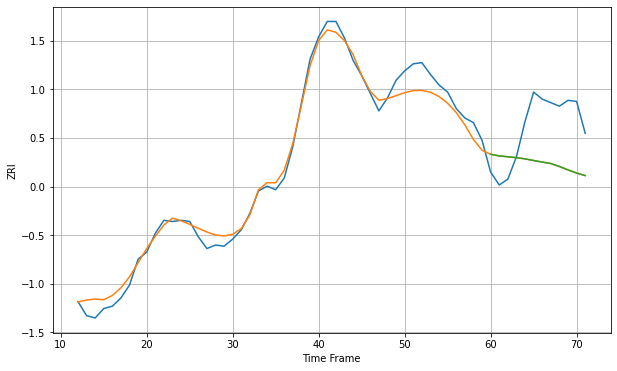

Wall time: 9.51 s
55401 8.994143878876885 43.05989807064876 43.06916395402098 [1644.12189344 1642.7411303  1641.99991533 1641.25653853 1640.21727646
 1638.8269981  1637.49674389 1636.27370892 1633.73466465 1630.84416746
 1628.16444723 1625.99818039]

Got an mse at 0.0050 in round 278 and stopped training

60 60 12


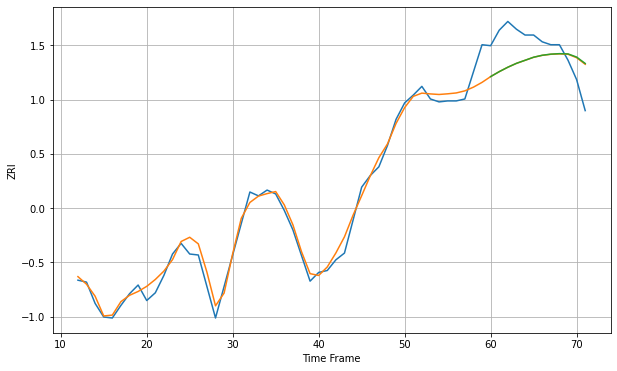

Wall time: 11.7 s
55403 9.614749159413007 29.932750357772818 30.064634205340056 [1308.09030691 1313.2122608  1317.78424579 1321.782447   1324.93411441
 1328.10046672 1330.13124101 1331.27815546 1331.78280541 1331.52014938
 1328.28019431 1321.66057861]

Got an mse at 0.0050 in round 223 and stopped training

60 60 12


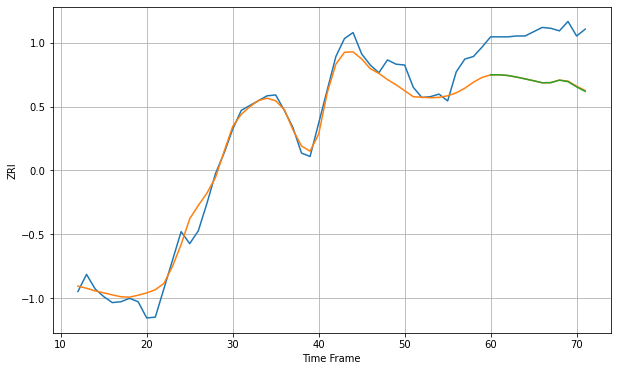

Wall time: 10.6 s
55404 15.809330461347677 57.1115410098129 57.37390999956125 [1316.53920003 1316.5919425  1315.759558   1313.95562446 1311.79974938
 1309.61554116 1307.24879261 1307.40216139 1310.30423058 1308.55575179
 1302.42816765 1297.15120915]

Got an mse at 0.0049 in round 124 and stopped training

60 60 12


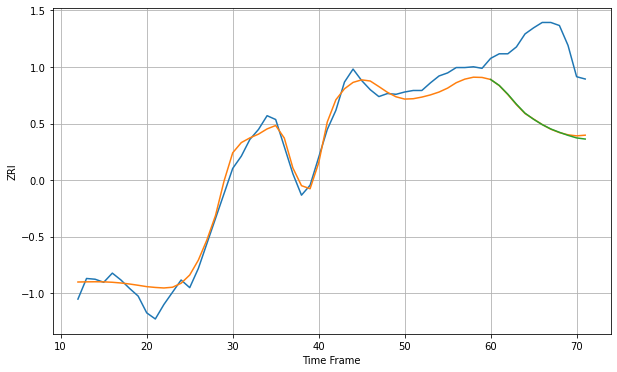

Wall time: 7.83 s
55407 14.343537981891489 99.26833550832154 99.6782144043729 [1355.39257858 1347.59762883 1336.14893807 1323.05283157 1311.30388738
 1303.27964159 1296.33174279 1290.63608898 1286.25057413 1282.30073789
 1278.91818912 1277.44522406]

Got an mse at 0.0048 in round 259 and stopped training

60 60 12


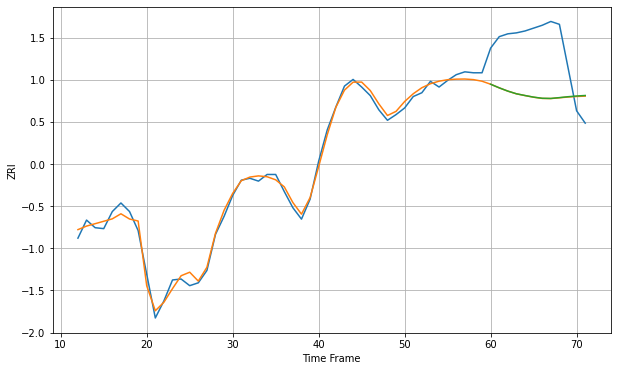

Wall time: 11.1 s
55408 6.153247533685506 59.50591562338703 59.45252953978405 [1507.95472651 1504.1541868  1500.72606174 1497.90317236 1496.08855695
 1494.39001473 1493.17943502 1492.99568563 1493.87545527 1494.80932267
 1495.5576037  1496.1144213 ]

Got an mse at 0.0050 in round 266 and stopped training

60 60 12


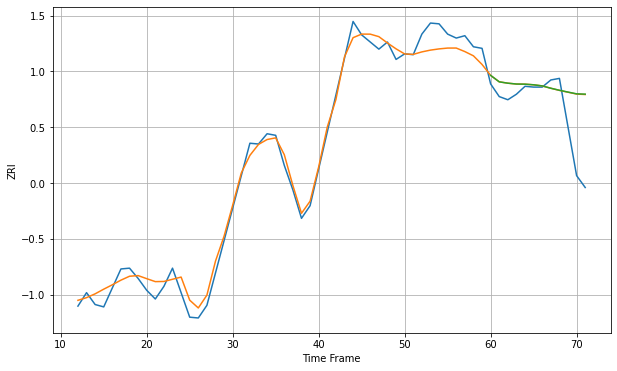

Wall time: 11.3 s
55411 13.864939403787115 48.165799903140524 48.324161484423776 [1552.80707484 1544.65366885 1542.93518564 1541.86370924 1541.6815157
 1540.89667175 1539.51828295 1536.56538943 1533.97061569 1531.69194949
 1529.45823365 1529.08895519]

Got an mse at 0.0050 in round 136 and stopped training

60 60 12


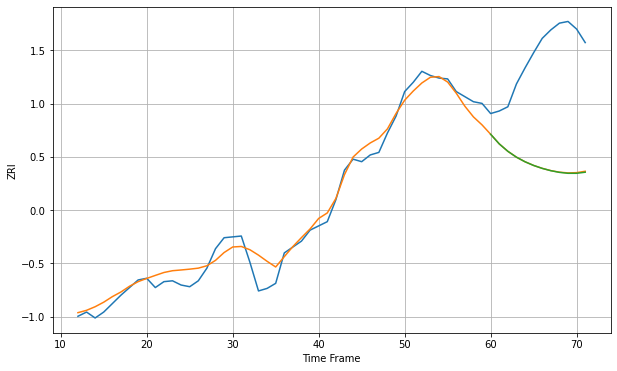

Wall time: 8.33 s
55413 13.397679861927948 132.0633813517803 132.35628722065607 [1484.48973961 1473.09183559 1464.30502822 1457.35639    1451.91306502
 1447.55242468 1444.08549697 1441.35041323 1439.36621695 1438.2622349
 1438.24967651 1439.5444172 ]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


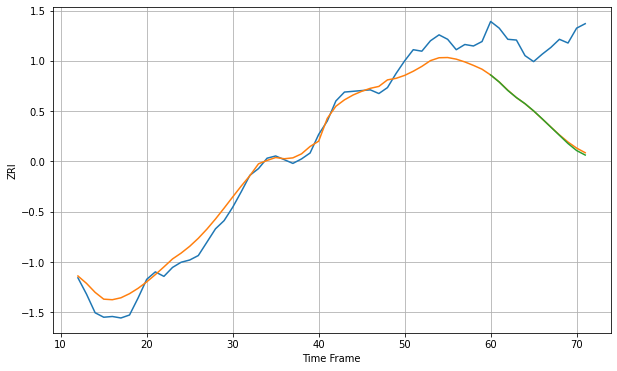

Wall time: 7.86 s
55414 16.841858356270528 107.72050409026079 108.83938733907459 [1527.00808866 1517.46889822 1506.13015977 1496.56821867 1488.35559895
 1478.69740728 1467.96034332 1456.86311648 1445.82101964 1434.75928492
 1425.3166909  1419.24362289]

Got an mse at 0.0050 in round 85 and stopped training

60 60 12


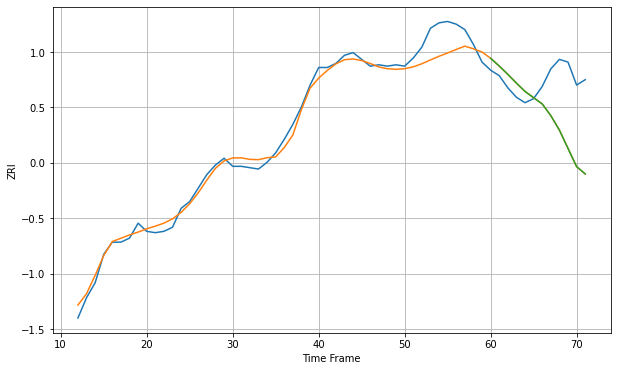

Wall time: 7.31 s
55416 8.176105434470003 37.684698461242064 37.671570836449824 [1533.80465182 1528.0990059  1521.95828168 1515.46384266 1509.31790146
 1504.67673382 1500.10570415 1491.43829469 1480.73867494 1467.25566147
 1453.81582918 1448.38643211]

Got an mse at 0.0049 in round 78 and stopped training

60 60 12


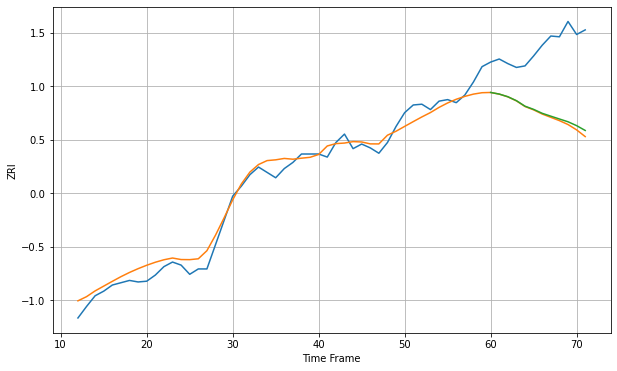

Wall time: 7.19 s
55418 12.76120556193998 91.07298876006878 88.47149321810086 [1303.33570817 1301.2477732  1297.78057526 1292.60871452 1285.4003629
 1281.25713527 1276.12352112 1272.39252262 1268.71072609 1265.07785709
 1260.02709988 1253.73489373]

Got an mse at 0.0050 in round 426 and stopped training

60 60 12


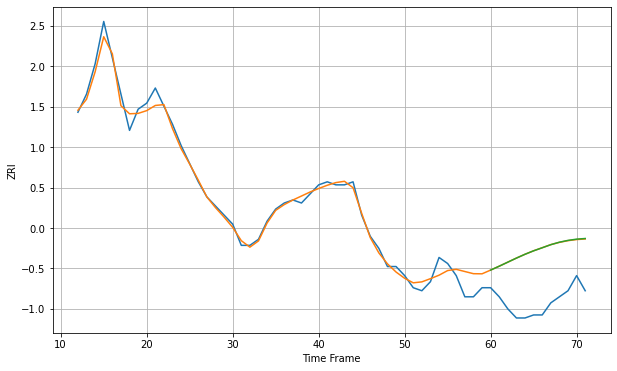

Wall time: 15.6 s
58103 2.7393224312899247 17.21712964817005 17.245011364872948 [720.82857426 722.11793383 723.45457088 724.79390549 726.05573394
 727.20046011 728.20384863 729.22820484 730.04746011 730.64574117
 731.05198142 731.26608576]

Got an mse at 0.0050 in round 348 and stopped training

60 60 12


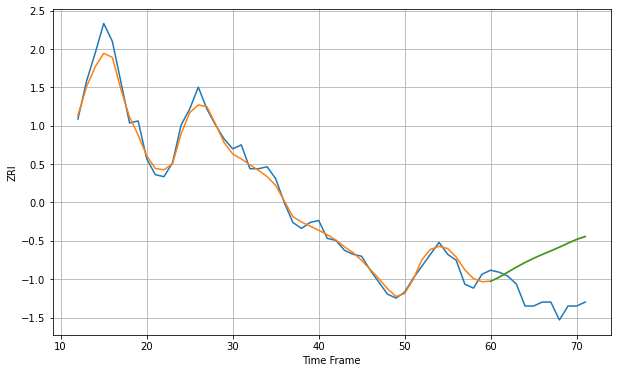

Wall time: 13.5 s
58104 4.1789415281095 24.00862594187623 24.08028932378228 [774.46729818 776.48690316 779.03896817 781.5498475  783.87631244
 786.00206217 787.91538336 789.72854879 791.60698072 793.62603912
 795.54715528 797.01326165]

Got an mse at 0.0050 in round 265 and stopped training

60 60 12


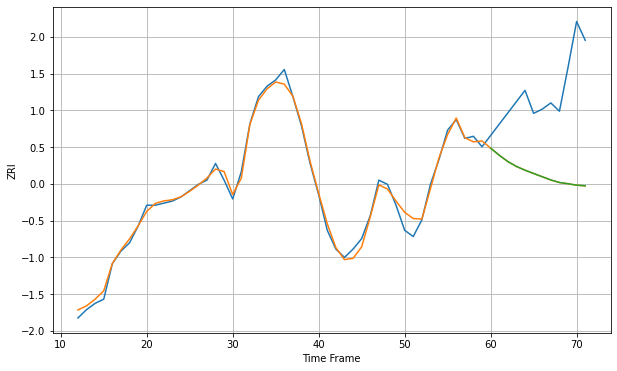

Wall time: 11.3 s
59601 2.828508830841246 42.5679845782772 42.553909400896046 [839.33809693 835.95249589 832.9141047  830.56775227 828.77498287
 827.19050604 825.64255639 824.10484634 822.87752395 822.29372887
 821.60246117 821.32581116]

Got an mse at 0.0050 in round 91 and stopped training

60 60 12


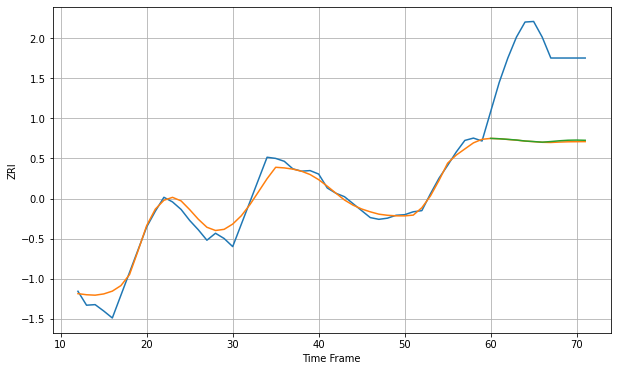

Wall time: 7.34 s
59718 14.727233030487497 154.15910298201692 153.160615835801 [1468.47553852 1467.88909003 1466.81017843 1465.68832233 1463.99643362
 1463.04568589 1461.9821893  1463.04398622 1464.37354263 1465.32499769
 1465.59279302 1465.22817255]

Got an mse at 0.0049 in round 250 and stopped training

60 60 12


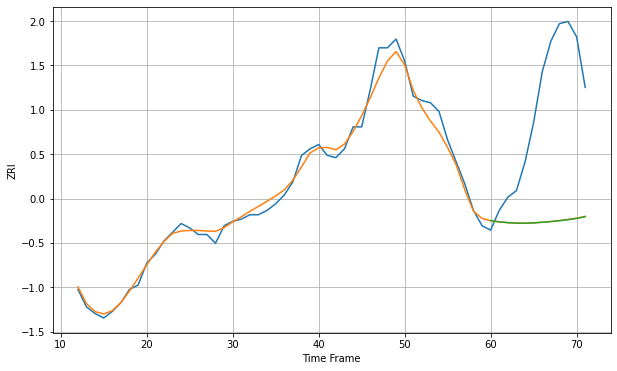

Wall time: 11.4 s
59801 3.8130530555938673 58.53377068204244 58.58600384761607 [827.31636183 826.7604421  826.40465026 826.17715812 826.13331527
 826.2869081  826.57912038 826.88535639 827.28713271 827.7601603
 828.30829455 829.11392601]

Got an mse at 0.0050 in round 111 and stopped training

60 60 12


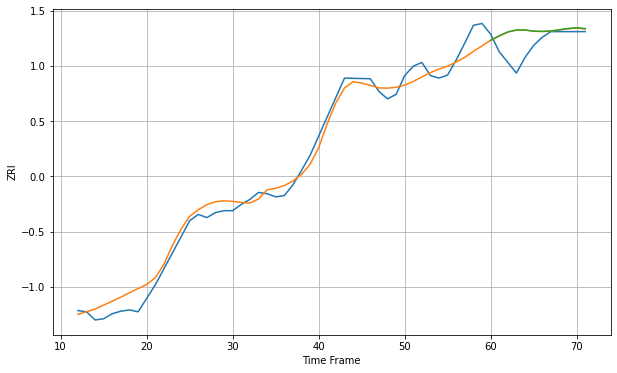

Wall time: 7.95 s
59901 16.90375700196038 29.355136423416045 29.412683383249327 [1174.24753829 1181.16914214 1187.46171671 1190.5443878  1190.63235495
 1188.76135706 1188.37408758 1188.97916447 1190.96526426 1192.87165302
 1194.25986227 1192.83717777]
60 60 12


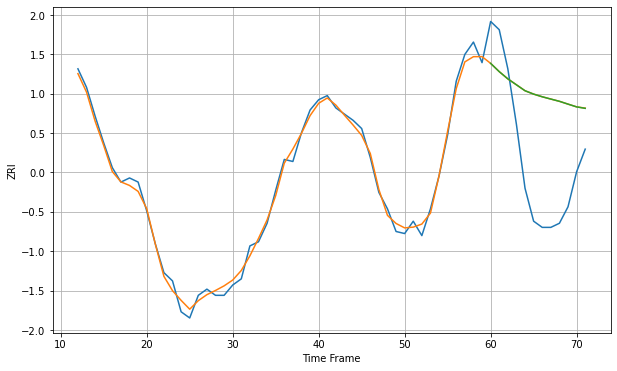

Wall time: 17.5 s
60085 3.1311384476226607 43.364181042936195 43.35814646432729 [1186.64835673 1182.639073   1179.12282674 1176.23848546 1173.35526729
 1171.72120549 1170.42639138 1169.31507292 1168.21998048 1166.85735971
 1165.5199189  1164.80181376]

Got an mse at 0.0050 in round 177 and stopped training

60 60 12


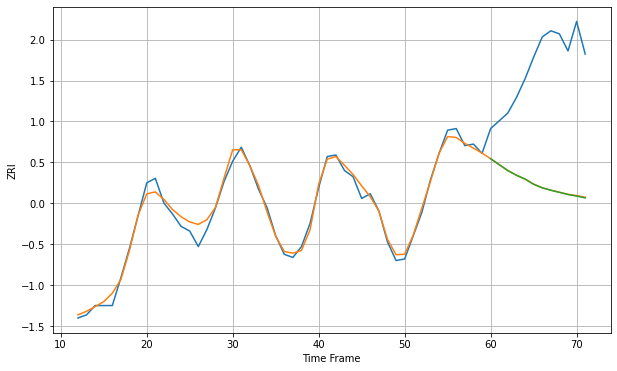

Wall time: 9.17 s
60201 4.165632135190668 79.52876435381658 79.64297910412901 [1533.58385602 1529.7374782  1525.977679   1522.95317993 1520.49680803
 1517.16646433 1514.84754025 1513.26932461 1511.91469272 1510.50277072
 1509.53142335 1508.32289035]

Got an mse at 0.0050 in round 322 and stopped training

60 60 12


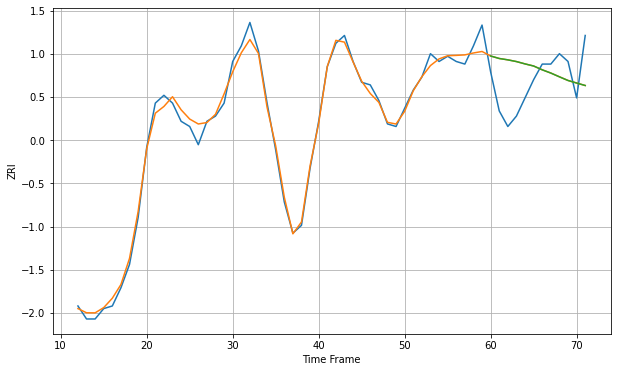

Wall time: 12.6 s
60202 2.98756907470851 13.814482117689492 13.815023510500641 [1588.11171788 1587.14991263 1586.62719936 1585.96681564 1585.06711806
 1584.2574297  1582.79587497 1581.55019556 1580.09881851 1578.69343728
 1577.71273711 1576.76139297]
60 60 12


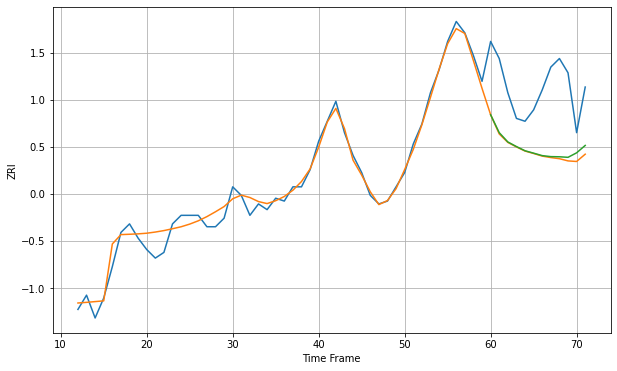

Wall time: 17 s
60402 3.2299563761963137 23.277399398334584 22.592983793778398 [1281.27280354 1275.00031296 1271.73865403 1270.12544275 1268.64935348
 1267.80627084 1266.94699182 1266.59496675 1266.53807237 1266.35001209
 1267.92356695 1270.51935159]

Got an mse at 0.0050 in round 118 and stopped training

60 60 12


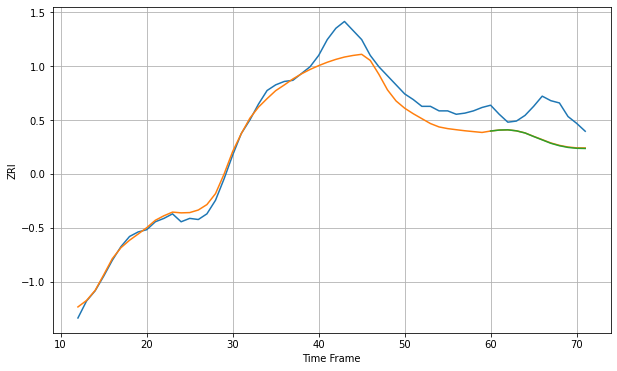

Wall time: 8.55 s
60540 11.354031109981339 24.94043752687505 25.146385892531818 [1621.1937124  1622.04157964 1622.24400086 1621.35542675 1619.47151269
 1616.34824842 1613.367888   1610.36376253 1608.20069446 1606.70860801
 1605.93705083 1605.7686269 ]

Got an mse at 0.0050 in round 180 and stopped training

60 60 12


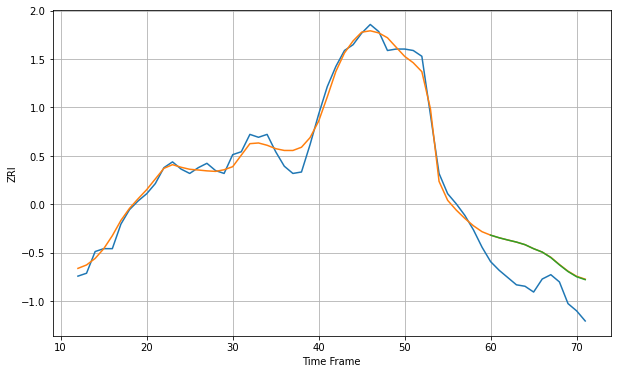

Wall time: 9.66 s
60563 6.023097734035318 23.56078837965792 23.46419261118597 [1381.32794717 1379.50108798 1377.97786487 1376.55331603 1374.75012531
 1371.96945066 1369.62561692 1365.84331652 1360.81043765 1356.18064174
 1352.58767164 1350.57618712]

Got an mse at 0.0050 in round 269 and stopped training

60 60 12


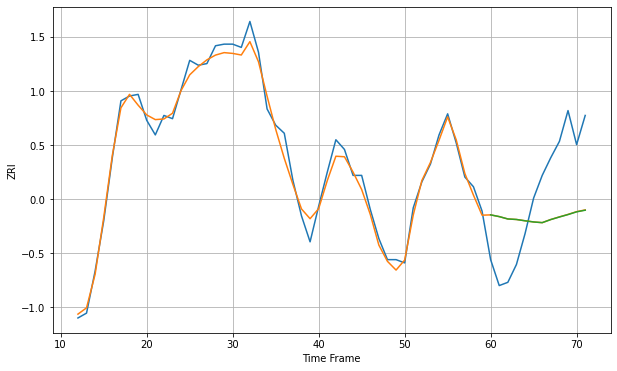

Wall time: 11.9 s
60601 5.619998689206262 39.64487713628107 39.6976587213156 [2085.62830111 2084.56784384 2083.10884934 2082.790593   2081.98559596
 2081.25653595 2080.83386907 2082.74943926 2084.33214894 2085.82444905
 2087.50142456 2088.51704268]

Got an mse at 0.0050 in round 311 and stopped training

60 60 12


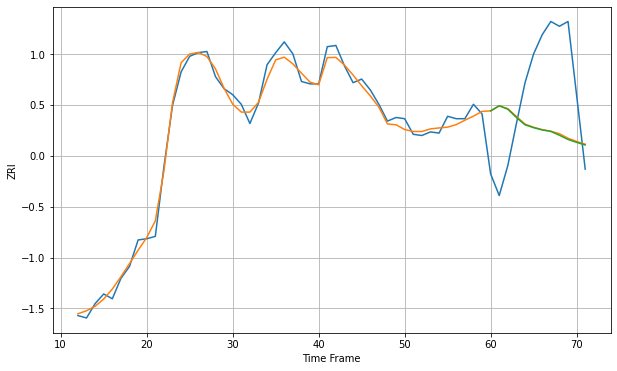

Wall time: 12.8 s
60605 6.179066004863885 64.24778053446131 64.62264079939278 [2040.5290752  2044.76092241 2041.90377831 2035.000368   2028.92864514
 2026.53600325 2024.64326517 2023.39951933 2020.21399931 2016.72183931
 2014.29190611 2012.14024381]
60 60 12


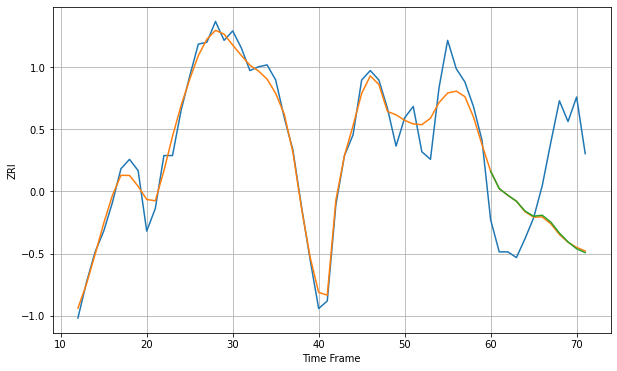

Wall time: 17.2 s
60606 8.242563826557289 44.71499201941044 44.70725166686548 [2190.71103316 2181.48348189 2177.98679243 2174.86653332 2169.61000857
 2166.8759634  2167.39481948 2163.7538249  2157.95627036 2153.29133205
 2149.63294155 2147.60554656]

Got an mse at 0.0049 in round 131 and stopped training

60 60 12


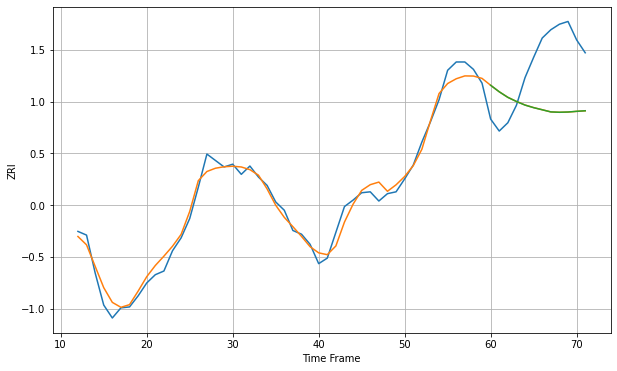

Wall time: 8.16 s
60607 9.408455176236155 64.96921700291081 64.95736130074616 [2010.70826602 2003.63215836 1997.58578989 1993.10854587 1989.19118729
 1986.39206124 1984.09365909 1981.77860672 1981.39445515 1981.67228834
 1982.42981147 1983.03722311]
60 60 12


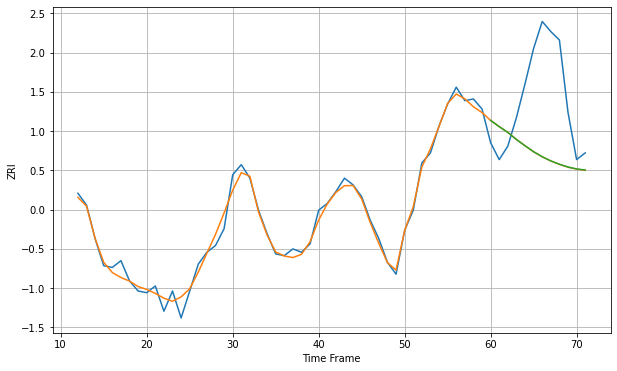

Wall time: 17.1 s
60608 4.162098886699615 45.55350042176671 45.53340161677978 [1521.2575111  1517.55900282 1514.13903945 1509.94528497 1506.21182597
 1502.66801556 1499.69001159 1497.21657681 1495.24779748 1493.59033928
 1492.47380121 1491.81081562]

Got an mse at 0.0049 in round 216 and stopped training

60 60 12


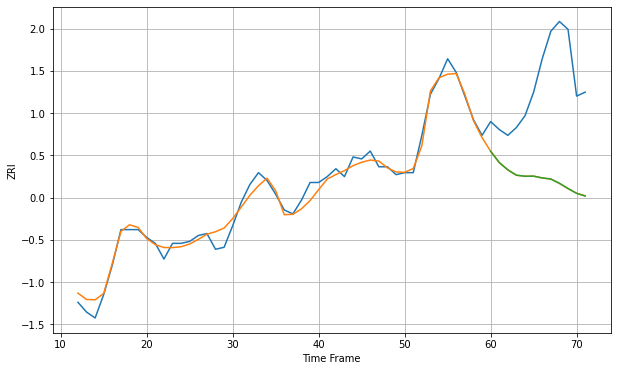

Wall time: 11 s
60609 4.025162735656635 51.76597989159494 51.75764305214158 [1277.90218048 1272.17354152 1268.45513244 1265.71548046 1265.19250795
 1265.2304455  1264.32520716 1263.77744813 1261.58649325 1258.92664735
 1256.48013178 1255.06307399]
60 60 12


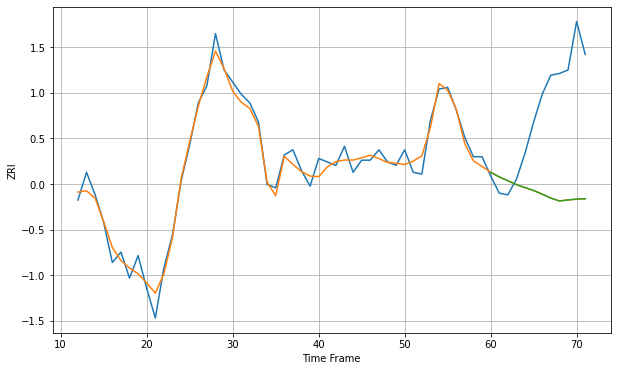

Wall time: 17.2 s
60610 5.62675951923501 56.94943153613031 56.936268520871685 [1921.03139874 1918.3411819  1916.14144148 1913.90727468 1912.16740221
 1910.51801662 1908.37847873 1906.13070385 1904.47090238 1905.07750044
 1905.57419396 1905.76646637]

Got an mse at 0.0050 in round 414 and stopped training

60 60 12


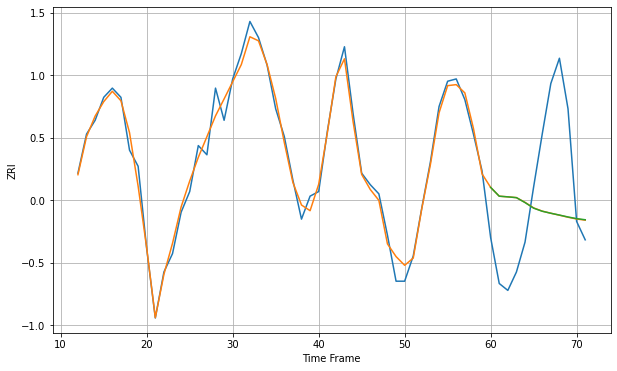

Wall time: 15.1 s
60611 4.4889168087747935 36.826063661258544 36.81250665170185 [2160.81421039 2156.97927115 2156.69505084 2156.34822337 2154.20532132
 2151.78430304 2150.43259146 2149.55865346 2148.76986859 2147.93964565
 2147.22182148 2146.73378063]

Got an mse at 0.0049 in round 314 and stopped training

60 60 12


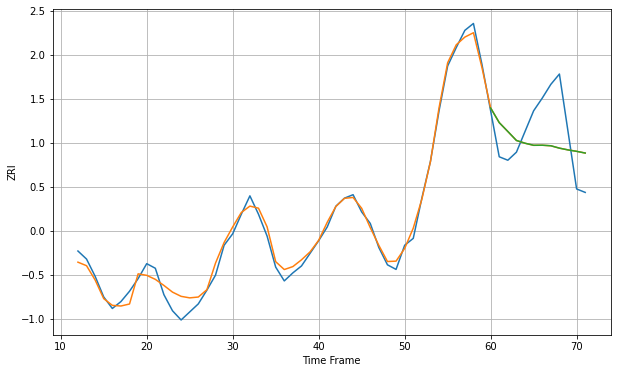

Wall time: 12.9 s
60612 6.86942678407761 33.931994703761234 33.92314278408698 [1657.46776227 1644.72960348 1637.00685889 1629.20060208 1626.80552176
 1625.00885613 1625.07771784 1624.59957989 1622.51026    1620.97331461
 1619.72729923 1618.25681657]
60 60 12


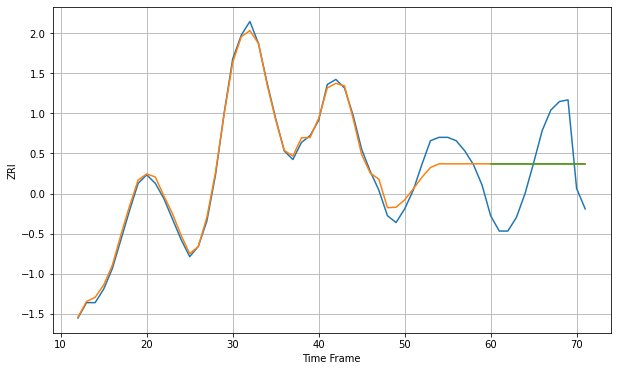

Wall time: 17.1 s
60613 5.60964945857383 29.392343808598515 29.392343808598515 [1718.45877092 1718.45877092 1718.45877092 1718.45877092 1718.45877092
 1718.45877092 1718.45877092 1718.45877092 1718.45877092 1718.45877092
 1718.45877092 1718.45877092]

Got an mse at 0.0050 in round 362 and stopped training

60 60 12


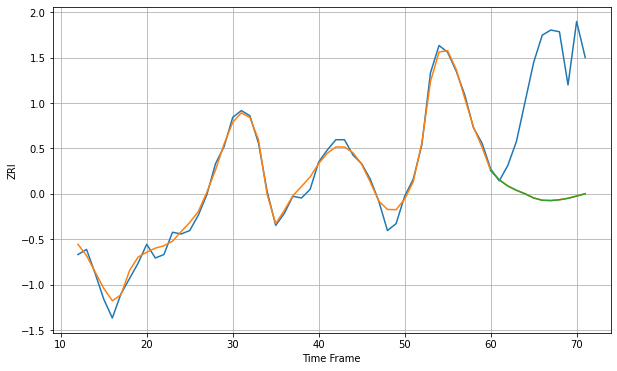

Wall time: 13.8 s
60614 4.137864812149764 70.6242173997121 70.68648875447519 [1871.04992228 1865.60227809 1861.98217518 1859.51070138 1857.45989712
 1855.02054144 1853.67762443 1853.4978493  1853.93771935 1854.78043526
 1856.07975524 1857.44078169]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


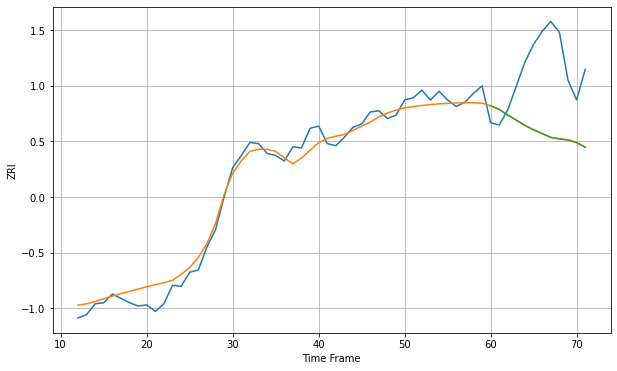

Wall time: 8.45 s
60615 9.64080220145759 64.77043798308948 64.76164707219513 [1519.71594079 1516.27320262 1511.17307355 1506.41476008 1501.59337347
 1497.57787602 1494.02603598 1490.55569812 1489.33149605 1488.38779145
 1485.92811046 1481.68304506]
60 60 12


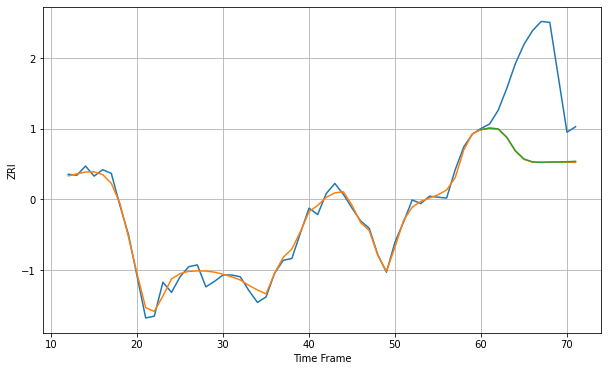

Wall time: 16.8 s
60616 6.789918824693418 94.47282309782966 94.29936525025941 [1661.79799025 1663.47003559 1662.554088   1653.42268413 1638.66788506
 1629.73404838 1626.45741578 1626.11984288 1626.33459581 1626.49945272
 1626.71332263 1627.19708338]

Got an mse at 0.0050 in round 224 and stopped training

60 60 12


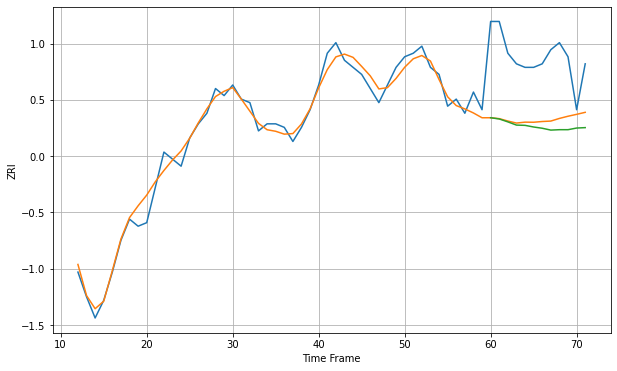

Wall time: 11.1 s
60617 2.73910730663457 18.81104201482872 20.375433503488978 [1137.72540591 1137.37992889 1136.55456096 1135.64646961 1135.56873604
 1135.10326168 1134.74955841 1134.22364463 1134.34009163 1134.34153481
 1134.80646454 1134.92586658]

Got an mse at 0.0047 in round 245 and stopped training

60 60 12


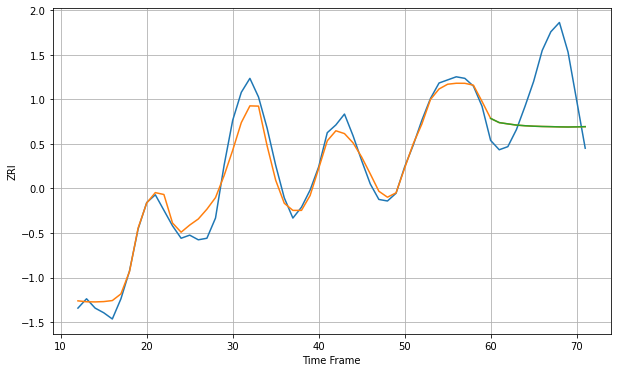

Wall time: 10.9 s
60618 7.7832085325288 35.5950039559342 35.59612573235658 [1629.18862199 1626.50058504 1625.67515627 1624.89959916 1624.47967135
 1624.18179391 1623.99071511 1623.88781717 1623.74257898 1623.66588786
 1623.74861477 1623.87230152]
60 60 12


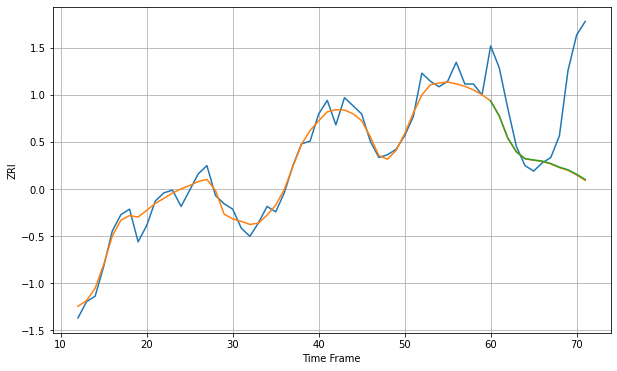

Wall time: 17.2 s
60619 3.427742799953315 26.489124612238346 26.34741076896028 [1120.80915134 1115.30533321 1107.12817382 1102.07868011 1099.58862631
 1099.08637068 1098.658015   1097.76792997 1096.42914189 1095.48076484
 1093.82224729 1091.93058657]

Got an mse at 0.0050 in round 166 and stopped training

60 60 12


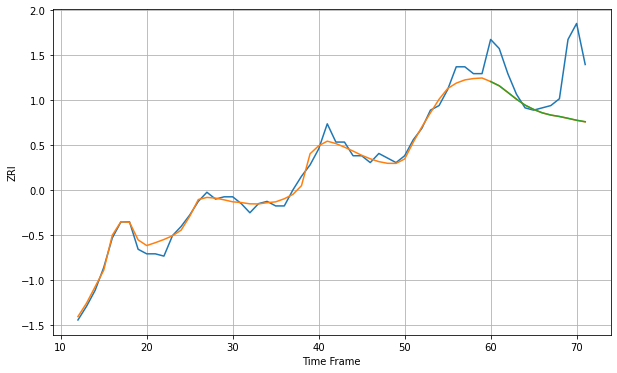

Wall time: 8.95 s
60620 2.8919971596349425 19.152376732408097 19.117273365520443 [1157.52874428 1155.67314892 1152.77765214 1149.827576   1147.21422184
 1145.3301906  1143.83235659 1142.85116983 1142.22767741 1141.42842106
 1140.58944274 1139.94389015]

Got an mse at 0.0049 in round 273 and stopped training

60 60 12


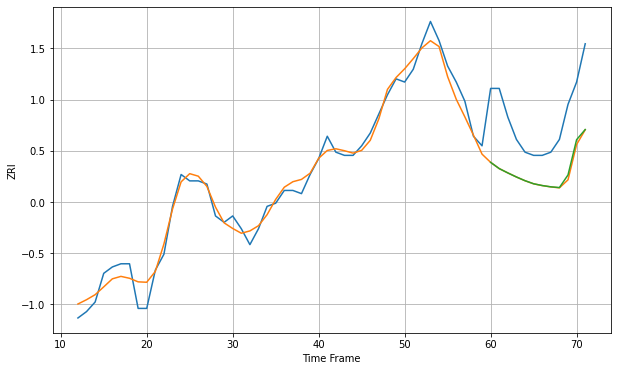

Wall time: 11.8 s
60621 3.3122814120032094 17.99673755791308 17.67846604216356 [1159.80615202 1157.85097761 1156.49635518 1155.22082105 1154.05619713
 1153.09383082 1152.53852356 1152.13399911 1151.90699183 1155.87071301
 1166.92543037 1170.09854813]

Got an mse at 0.0050 in round 415 and stopped training

60 60 12


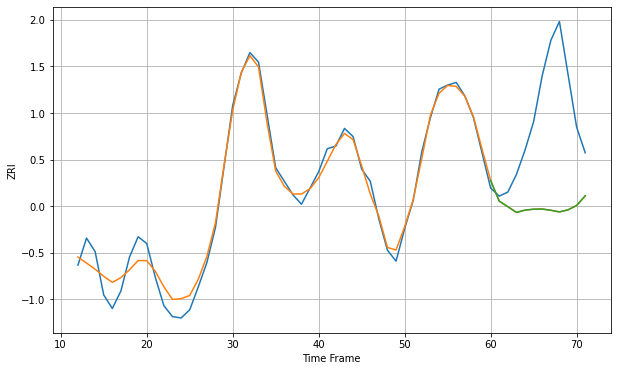

Wall time: 14.9 s
60622 7.928587503707983 74.57977744130827 74.55735432681671 [1780.53044124 1765.27970411 1761.21127218 1756.95354163 1758.66172826
 1759.34959868 1759.46194987 1758.56151823 1757.34001854 1758.88785875
 1762.07512445 1769.29695642]

Got an mse at 0.0049 in round 187 and stopped training

60 60 12


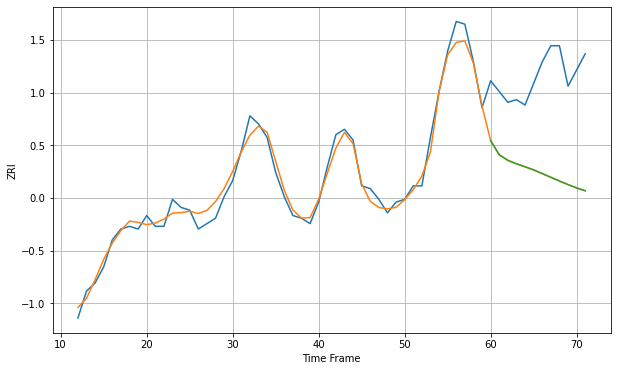

Wall time: 9.44 s
60623 3.2762199090666857 36.6002860775601 36.59739959645573 [1281.80263963 1276.55565825 1274.50540183 1273.1948005  1272.08856754
 1270.93879515 1269.56449707 1268.18314784 1266.81126892 1265.47930914
 1264.25440124 1263.18481433]

Got an mse at 0.0049 in round 353 and stopped training

60 60 12


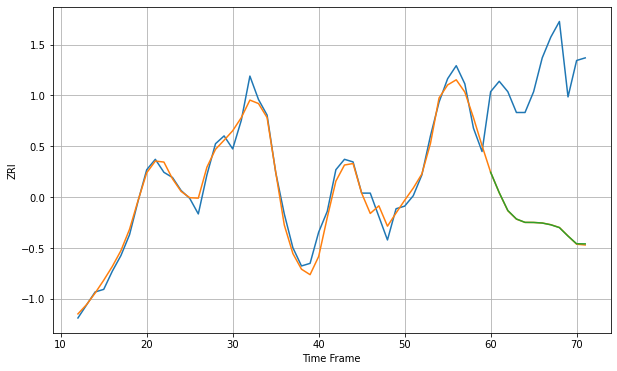

Wall time: 13.3 s
60624 3.5256207597427367 57.3129822118501 57.25220338534529 [1335.01981026 1327.1823358  1320.30690824 1317.04892973 1315.75990995
 1315.72440159 1315.50539954 1314.8330552  1313.74118375 1310.48916465
 1307.53532632 1307.49006158]

Got an mse at 0.0049 in round 109 and stopped training

60 60 12


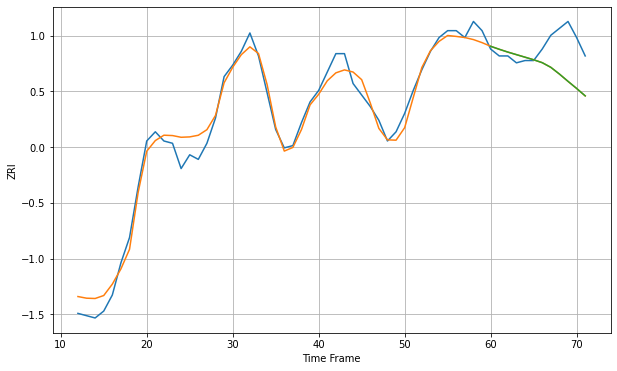

Wall time: 7.61 s
60625 4.993081298685997 13.30818448023447 13.29908968638004 [1547.20363501 1545.90114983 1544.67887265 1543.56696852 1542.45918051
 1541.33818364 1540.07099644 1538.04740292 1535.12676066 1531.95552986
 1528.86680258 1525.62841306]

Got an mse at 0.0050 in round 133 and stopped training

60 60 12


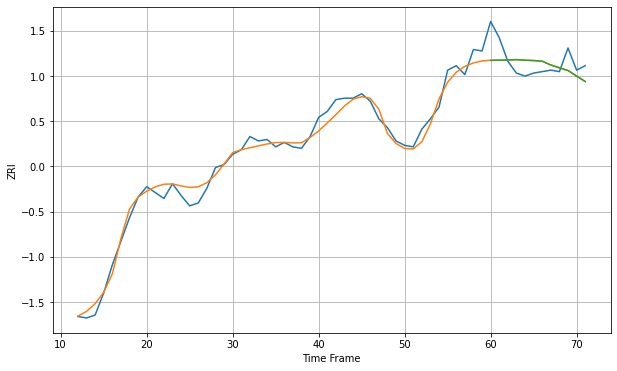

Wall time: 8.37 s
60626 5.499175634341344 11.65911568997187 11.654405315152847 [1364.64906822 1364.7539976  1364.88986239 1365.12331861 1364.7153854
 1364.51522514 1364.04292025 1361.47178231 1359.59629316 1357.72669194
 1354.00574896 1350.31778551]

Got an mse at 0.0050 in round 258 and stopped training

60 60 12


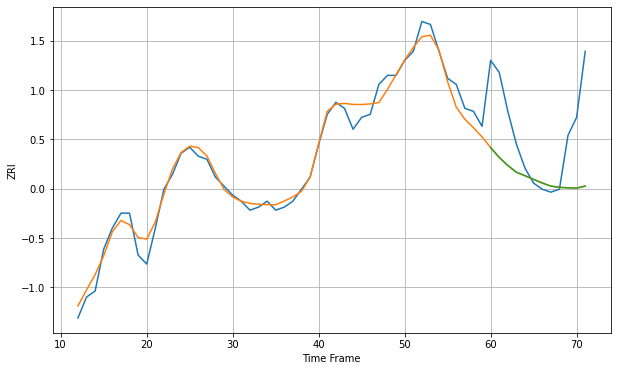

Wall time: 11.7 s
60628 3.355796002308941 20.353078653958832 20.36298283176458 [1172.88140112 1169.60540216 1166.91788859 1164.66330565 1163.49309978
 1162.28604818 1161.06923374 1160.03546821 1159.61780182 1159.47788537
 1159.36375122 1159.99901699]

Got an mse at 0.0049 in round 375 and stopped training

60 60 12


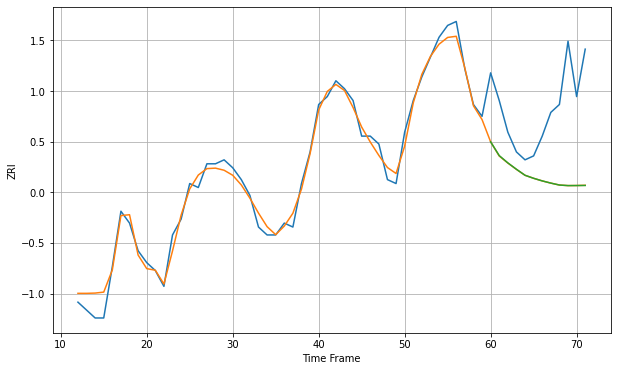

Wall time: 14.1 s
60629 2.3800290969932374 19.404172485491934 19.402946149083427 [1212.54945419 1209.07103774 1207.23304782 1205.61402835 1204.095843
 1203.32948339 1202.67325422 1202.11360312 1201.62544655 1201.48338953
 1201.4977311  1201.51755431]

Got an mse at 0.0049 in round 221 and stopped training

60 60 12


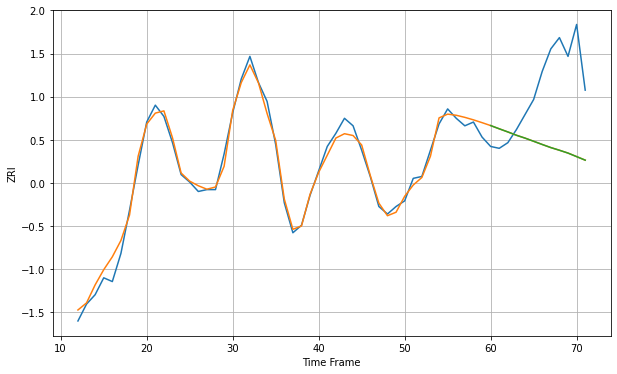

Wall time: 10.6 s
60630 4.021005507466656 38.53242846681124 38.535706476099016 [1522.12686543 1520.40411961 1518.73208725 1516.96400578 1515.44455256
 1513.75822011 1512.04805285 1510.3967978  1508.9802164  1507.46496914
 1505.57991513 1503.69086071]
60 60 12


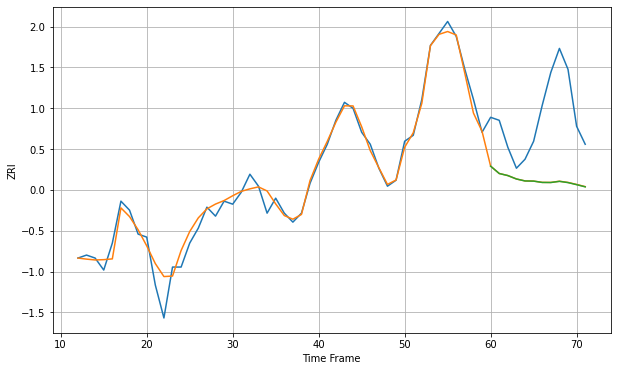

Wall time: 18 s
60632 3.3360710024908187 23.965030684229887 23.99690770487466 [1307.68257161 1305.23224188 1304.54648973 1303.40484591 1302.74895
 1302.69514376 1302.25226784 1302.22502406 1302.61455543 1302.1985144
 1301.51027775 1300.78161415]

Got an mse at 0.0049 in round 481 and stopped training

60 60 12


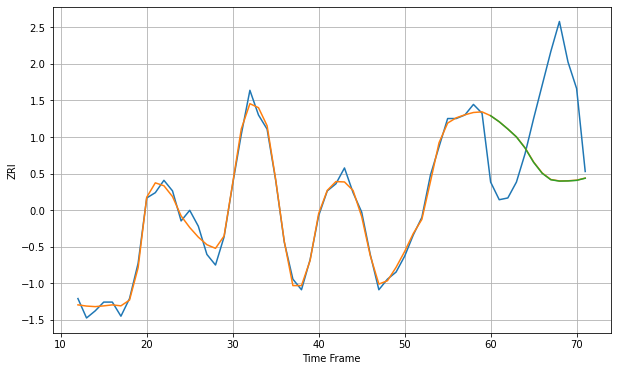

Wall time: 16.8 s
60634 3.769161493382568 49.42172722395012 49.498035417296634 [1584.59576823 1581.1698494  1577.06604787 1572.58612633 1566.29877412
 1558.18129296 1551.95142135 1548.32575059 1547.54480527 1547.6365015
 1547.96524637 1549.18068992]
60 60 12


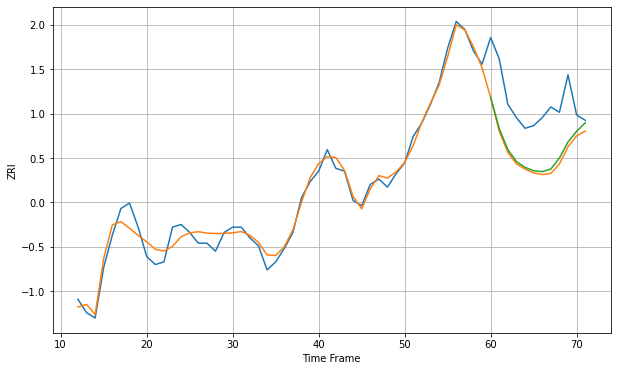

Wall time: 17.2 s
60636 3.323518197774985 19.697250756330668 18.597338272313994 [1187.58515003 1175.91395656 1168.06015647 1163.55176801 1161.39328823
 1160.12851715 1159.7814645  1160.75795361 1164.86490791 1170.88259265
 1174.87476574 1178.03916411]

Got an mse at 0.0050 in round 240 and stopped training

60 60 12


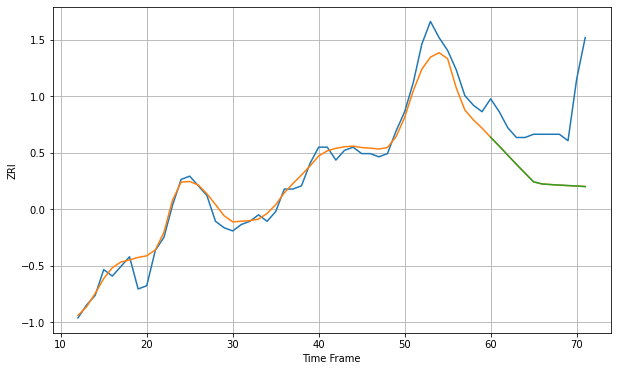

Wall time: 11 s
60637 3.676716629479737 20.18750898434828 20.189146170135142 [1202.07248906 1199.32807265 1196.50486003 1193.68081529 1190.93333539
 1188.23205882 1187.57693333 1187.39338408 1187.22789381 1187.07935656
 1186.94815292 1186.77534372]

Got an mse at 0.0050 in round 274 and stopped training

60 60 12


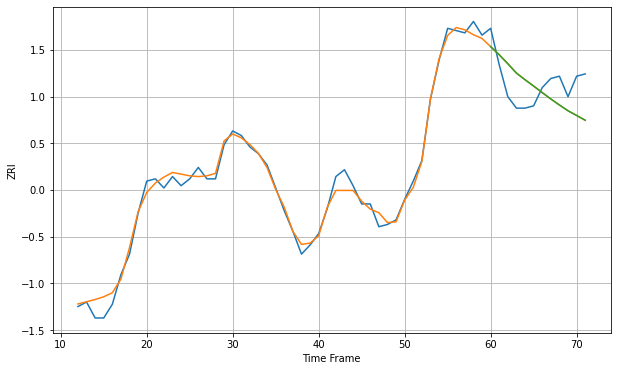

Wall time: 11.8 s
60639 3.398349978020721 12.084244190038964 12.081534150558532 [1377.96701819 1374.40210485 1370.47188084 1366.37454252 1363.45280822
 1360.67677229 1357.82339196 1355.01034962 1352.37394028 1349.84522335
 1347.78185659 1345.69805369]

Got an mse at 0.0049 in round 86 and stopped training

60 60 12


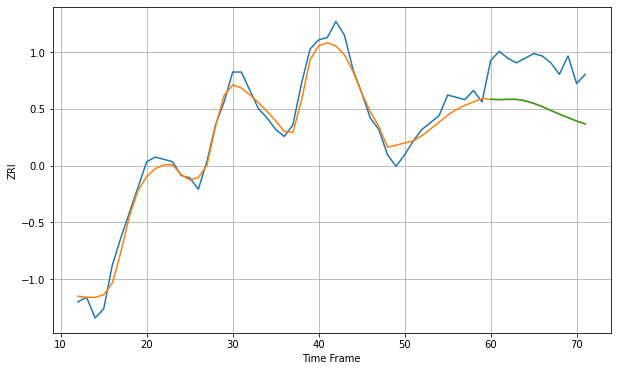

Wall time: 7.59 s
60640 4.648563826294822 19.928404422897273 19.957490978639587 [1487.12349334 1486.99436961 1487.11238185 1487.11498487 1486.47942461
 1485.3660367  1483.97154916 1482.26828233 1480.68671131 1479.15147366
 1477.66205017 1476.37489888]

Got an mse at 0.0050 in round 303 and stopped training

60 60 12


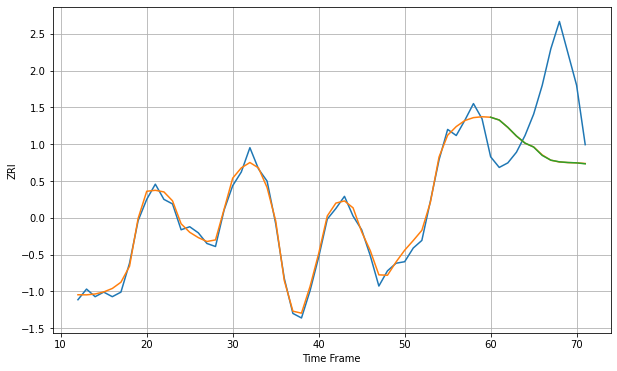

Wall time: 12.6 s
60641 4.114075501335809 47.172969635708036 47.18553195891466 [1559.01420322 1557.17661052 1552.35798143 1546.69037771 1542.01107148
 1539.40656962 1533.8964736  1530.78061781 1529.68216945 1529.24535301
 1529.00100443 1528.386263  ]
60 60 12


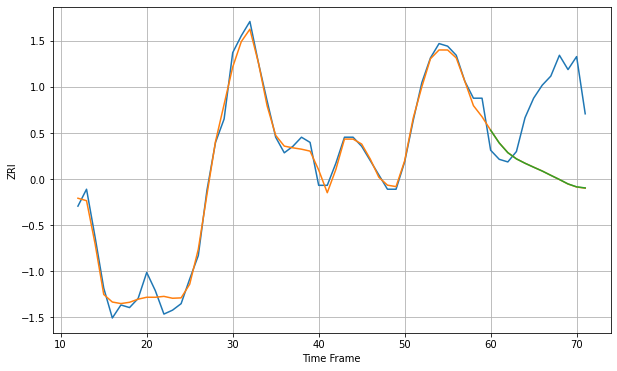

Wall time: 17.3 s
60642 6.536082859478983 61.17089896396269 61.12169059737988 [1959.39491199 1949.58155716 1942.10901833 1937.33551022 1933.96605764
 1930.93922666 1927.99783557 1924.6985842  1921.48610849 1918.09027898
 1915.8479833  1914.99170467]

Got an mse at 0.0050 in round 386 and stopped training

60 60 12


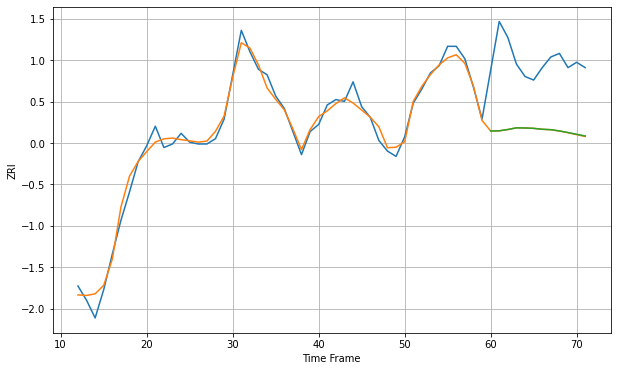

Wall time: 15 s
60644 4.611692149928581 40.64571456630929 40.58285134561999 [1228.32972141 1228.4133457  1229.14861052 1230.09773551 1230.01359057
 1229.80187418 1229.29179199 1229.05314403 1228.35146683 1227.45627393
 1226.46408986 1225.52276393]

Got an mse at 0.0049 in round 153 and stopped training

60 60 12


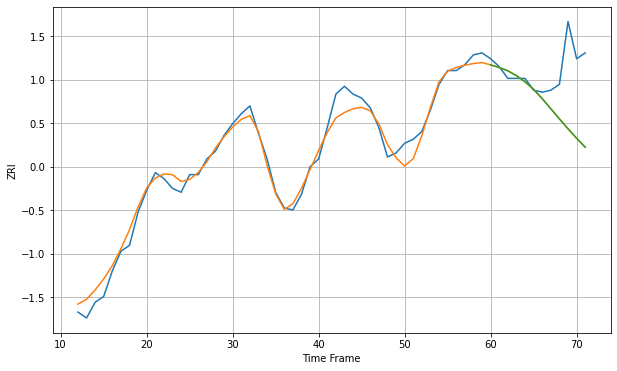

Wall time: 9.11 s
60645 5.095281407424441 24.779112727713258 24.78906217126443 [1495.86805137 1494.58868396 1492.86662728 1490.42673202 1487.28127314
 1483.41363803 1478.69356801 1473.54385806 1468.40011195 1463.34968246
 1458.51050753 1453.96128553]

Got an mse at 0.0050 in round 188 and stopped training

60 60 12


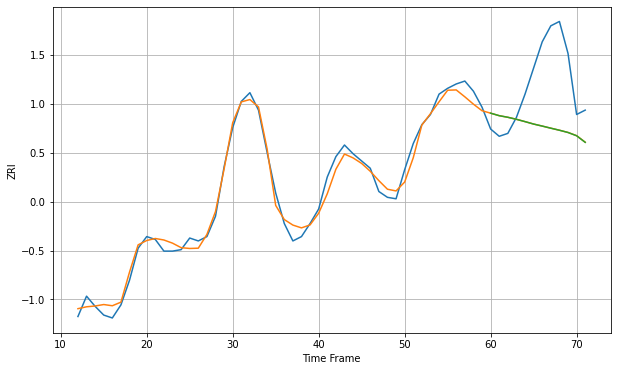

Wall time: 9.43 s
60647 5.626208365545377 40.68311373503136 40.696954397662644 [1621.90383691 1620.17806364 1619.07767476 1617.68330739 1616.09071118
 1614.41844016 1613.03060628 1611.5731945  1610.16270477 1608.61253956
 1606.36195387 1601.83757791]

Got an mse at 0.0050 in round 326 and stopped training

60 60 12


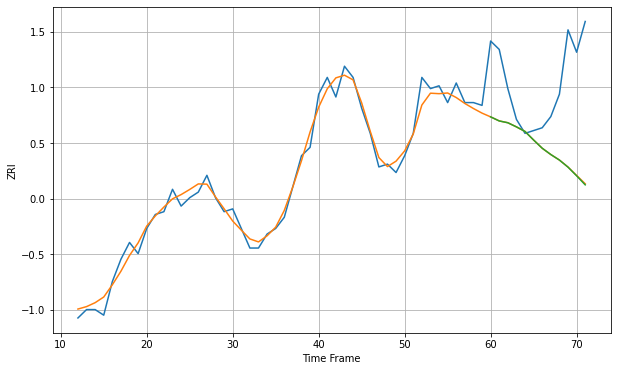

Wall time: 12.9 s
60649 3.3592003141904834 28.954270441205008 29.040683936648232 [1093.89349947 1092.43405521 1091.78995497 1090.31524555 1088.67726931
 1085.61896107 1082.68000178 1080.42928994 1078.45113054 1075.9217825
 1072.82603613 1069.59223991]

Got an mse at 0.0050 in round 229 and stopped training

60 60 12


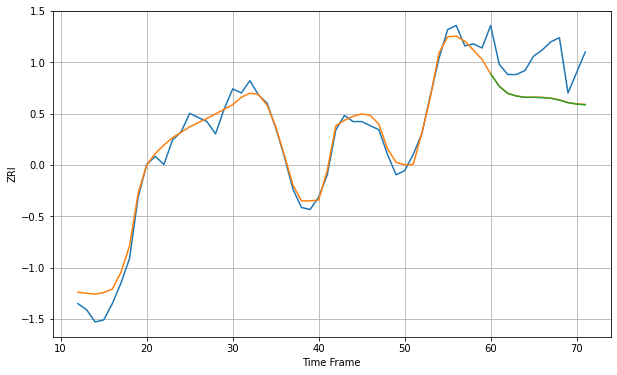

Wall time: 10.7 s
60651 4.994963778302964 19.514813706673674 19.59959358163274 [1351.40061905 1345.27425523 1341.76160148 1340.47784764 1339.85813139
 1339.86272968 1339.73687885 1339.37631382 1338.50593948 1337.19718779
 1336.54329677 1336.16651154]

Got an mse at 0.0050 in round 151 and stopped training

60 60 12


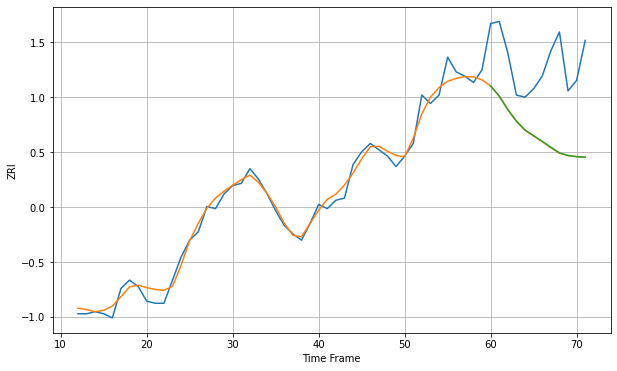

Wall time: 8.71 s
60653 3.8214790151631326 35.98744562986184 35.90725175419453 [1421.31477956 1416.50238276 1410.09362333 1404.60819934 1400.36670087
 1397.69894765 1394.97352588 1392.1965594  1389.52183098 1388.27214813
 1387.71439505 1387.44601179]
60 60 12


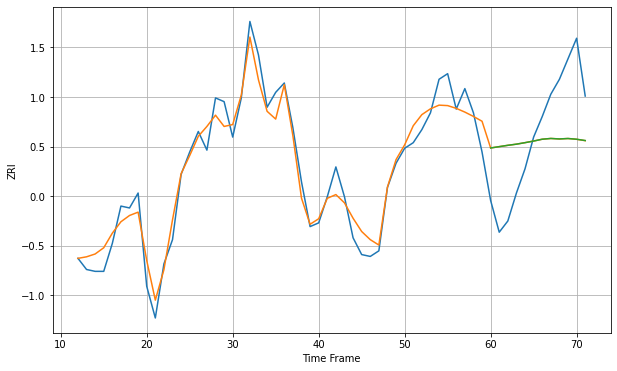

Wall time: 17.3 s
60654 8.69244592719823 32.2809550578116 32.27080793146078 [2157.15967435 2157.87763883 2158.58627562 2159.20729547 2160.01283774
 2160.87479894 2161.85908635 2162.26296142 2162.00375439 2162.24053993
 2161.84658441 2161.15426745]

Got an mse at 0.0049 in round 233 and stopped training

60 60 12


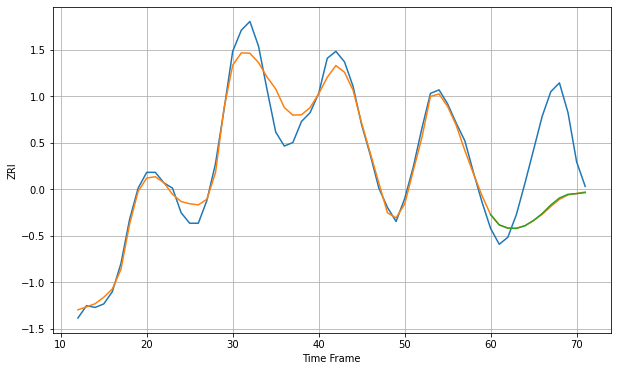

Wall time: 10.9 s
60657 7.625391421002902 37.474548346962834 37.1501368828242 [1730.89374507 1725.05751391 1723.21077506 1723.05997642 1724.54860289
 1727.60960205 1731.55575695 1736.41274042 1740.37249646 1742.47916956
 1742.88135263 1743.45873654]

Got an mse at 0.0048 in round 112 and stopped training

60 60 12


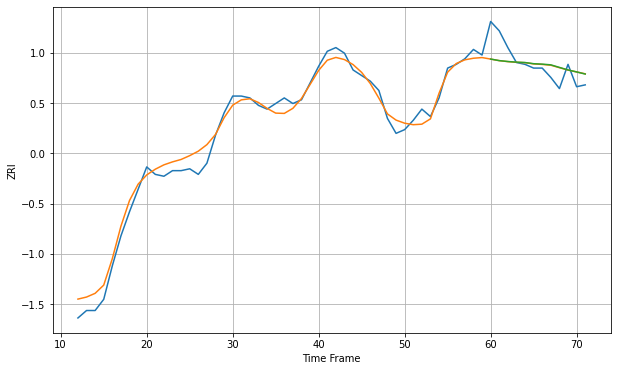

Wall time: 7.63 s
60660 5.047597401313173 9.154922735098816 9.172348829775709 [1391.8329978  1391.00973425 1390.52544338 1390.18253674 1389.97741034
 1389.34781148 1389.11667318 1388.74007043 1387.36622942 1386.00192497
 1384.94230109 1383.80075233]
60 60 12


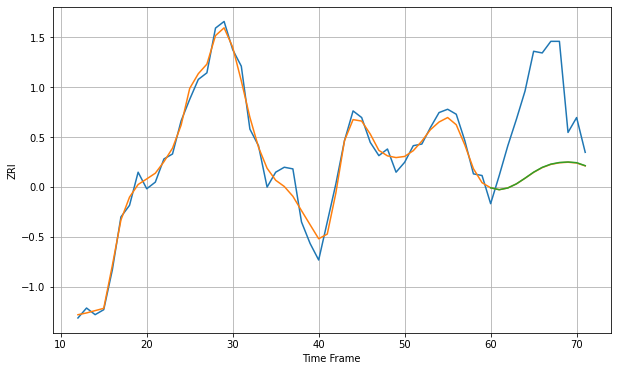

Wall time: 16.7 s
60661 6.04404954877883 47.67953228279103 47.589930339062995 [2060.583319   2059.43447724 2060.49068565 2062.96884494 2066.38898298
 2070.01114849 2072.92270164 2074.86871041 2075.85485658 2076.17188836
 2075.74363838 2073.94533372]

Got an mse at 0.0049 in round 343 and stopped training

60 60 12


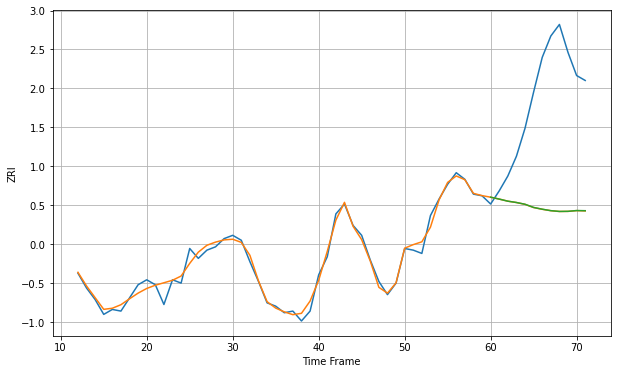

Wall time: 12.8 s
60804 3.681894043006363 72.49296425683877 72.4498507081349 [1365.13861734 1363.98635895 1362.7245549  1361.92672228 1360.8475118
 1358.92405531 1357.85608923 1356.9743245  1356.49941621 1356.56490278
 1357.03597862 1356.93539433]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


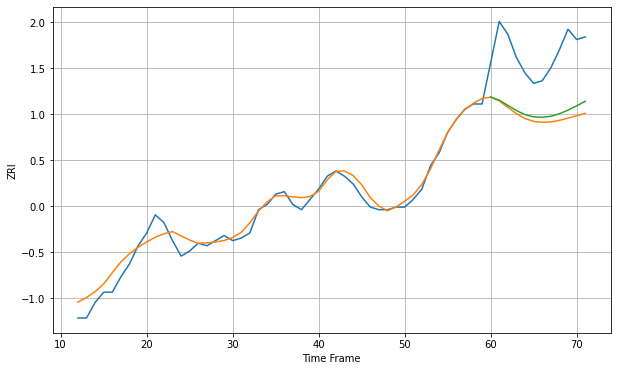

Wall time: 8.57 s
61104 3.448447466738738 24.693560462582894 22.65566468741457 [636.6826024  635.43946969 633.46195947 631.45492234 629.87461056
 629.00224172 628.82469909 629.23827756 630.2063067  631.59647404
 633.27208608 635.04281245]

Got an mse at 0.0049 in round 177 and stopped training

60 60 12


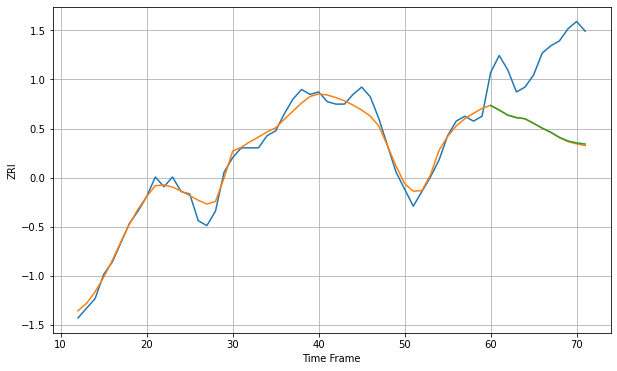

Wall time: 9.11 s
63104 3.574907975450281 32.17669869257746 32.000197831684474 [834.45405735 832.52193277 830.42738481 829.41206829 828.94961469
 827.07165729 825.11341562 823.40928755 821.34785023 819.82307712
 819.06084627 818.57050547]

Got an mse at 0.0050 in round 126 and stopped training

60 60 12


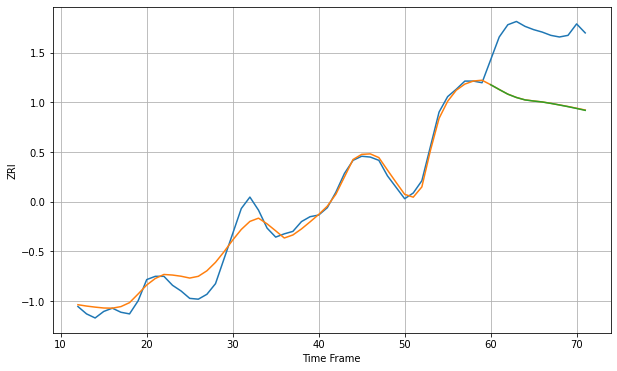

Wall time: 7.69 s
63105 11.617356428814723 84.14876223944954 84.27149635094807 [1199.58465476 1193.681248   1187.99149128 1183.90461934 1180.94708619
 1179.59260927 1178.42665237 1176.6926029  1174.74611617 1172.71348507
 1170.49473812 1168.18942014]

Got an mse at 0.0049 in round 316 and stopped training

60 60 12


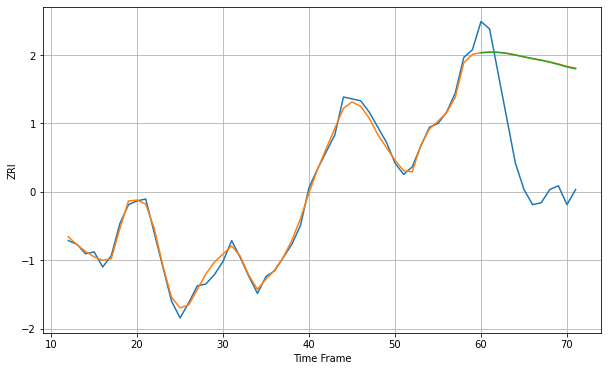

Wall time: 12.4 s
63107 2.6792106172074197 57.656312389364665 57.51313346990364 [777.48532542 777.75391453 777.66312851 777.12826326 776.24453612
 775.2405277  774.28608102 773.44895044 772.43154363 771.25060748
 769.89606222 768.94621694]

Got an mse at 0.0049 in round 110 and stopped training

60 60 12


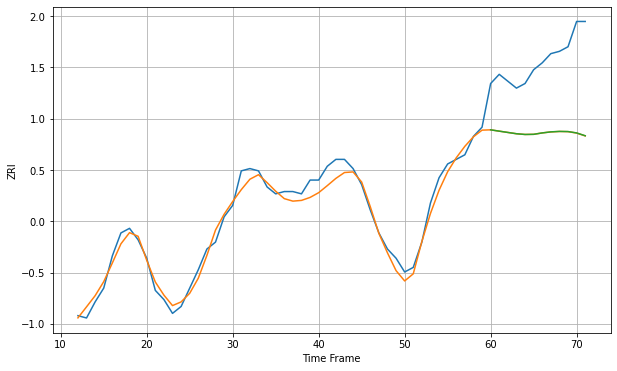

Wall time: 7.85 s
63108 3.809601331718113 32.525580123685835 32.49791337671176 [936.8540131  936.2774423  935.71810795 935.15400634 934.83528591
 934.89713886 935.50647819 935.97146484 936.17044018 936.10275403
 935.51116523 934.28634862]

Got an mse at 0.0050 in round 360 and stopped training

60 60 12


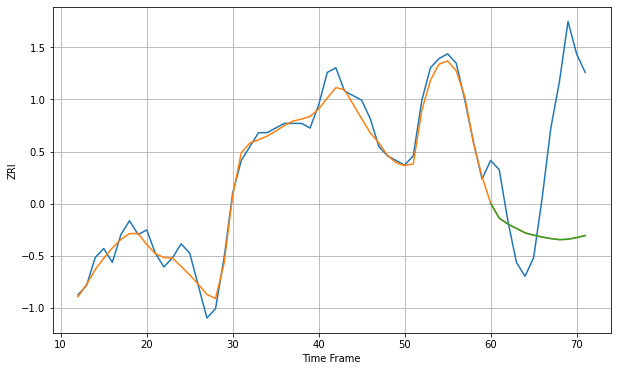

Wall time: 13.7 s
63109 2.225578098367531 24.466966791367057 24.47674519970945 [736.75783409 733.53468165 732.28464135 731.32854713 730.38518626
 729.87370448 729.46688625 729.13487911 728.90845757 728.997639
 729.34531474 729.75754268]

Got an mse at 0.0049 in round 191 and stopped training

60 60 12


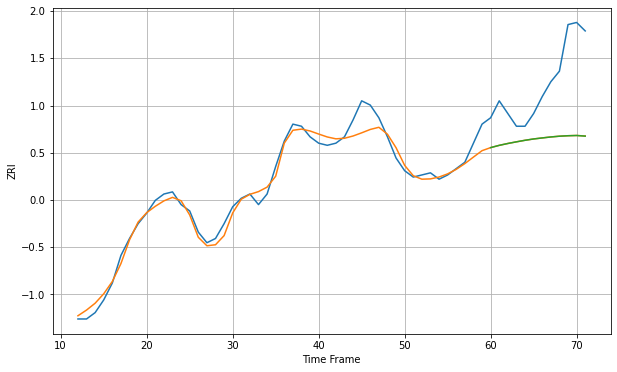

Wall time: 9.44 s
63110 4.4845980895576245 30.47815167853422 30.488386055265533 [872.91092923 873.97931455 874.85777851 875.63829827 876.36713915
 876.99630686 877.47771002 877.93704318 878.29685214 878.51897185
 878.63228482 878.33717331]

Got an mse at 0.0050 in round 176 and stopped training

60 60 12


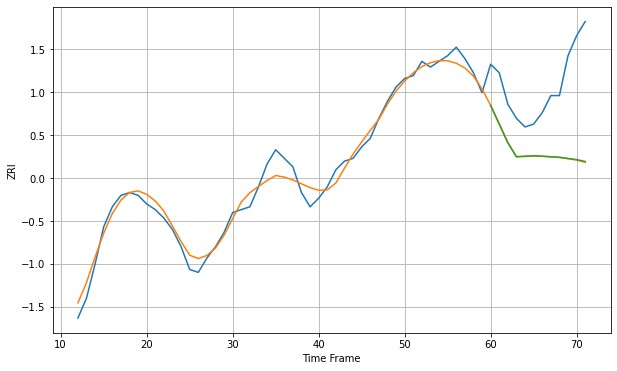

Wall time: 9.2 s
63111 3.357216218351996 25.713745251308495 25.641371638662637 [676.55244346 669.97841938 663.39338976 658.50018725 658.75160133
 658.88045115 658.7633857  658.55042838 658.37895071 657.95478606
 657.5440416  656.87968741]
60 60 12


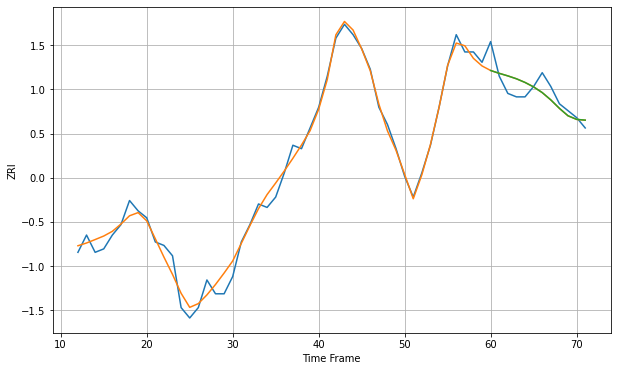

Wall time: 16.9 s
63112 2.4262144032245656 4.073701314865236 4.069582010440566 [772.63132111 771.81241379 771.0714334  770.23595512 769.17793328
 767.88557682 766.24341642 764.12618297 761.68035635 759.52983757
 758.48879704 758.26526158]

Got an mse at 0.0049 in round 236 and stopped training

60 60 12


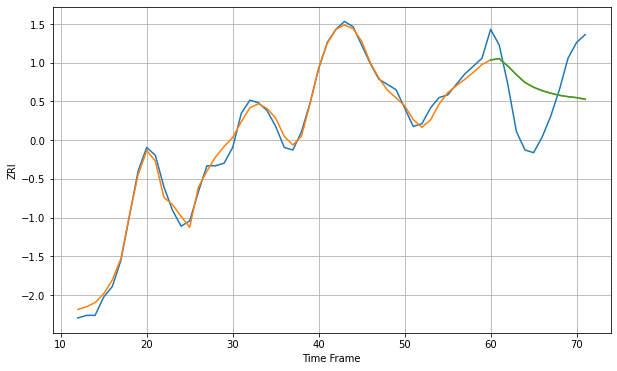

Wall time: 10.5 s
63113 2.5067460186002135 17.377375268264466 17.363680896998044 [749.33469953 749.81845466 747.01055973 743.68523365 740.74691384
 738.93114622 737.61645885 736.66238368 735.86052374 735.34929682
 734.97992744 734.40857939]

Got an mse at 0.0050 in round 320 and stopped training

60 60 12


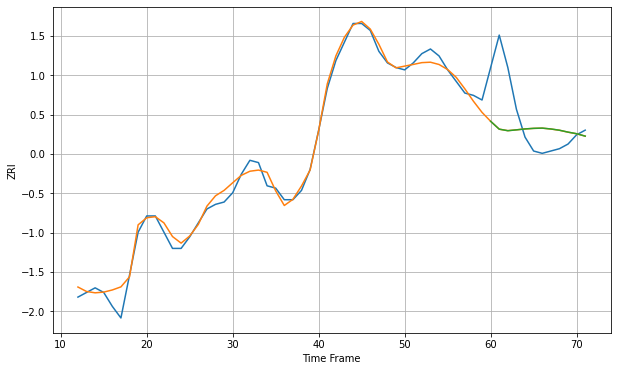

Wall time: 12.3 s
63115 3.4730900505765723 16.870712111277182 16.878080590814175 [657.81805611 654.4242531  653.76254917 654.12234403 654.52472826
 654.77437392 654.88179057 654.51290267 653.97961847 653.15310657
 652.46579595 651.42445564]

Got an mse at 0.0050 in round 120 and stopped training

60 60 12


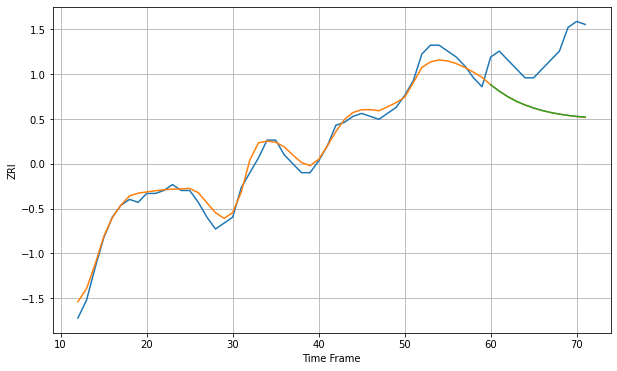

Wall time: 8.26 s
63116 2.70153600238346 19.5507324928952 19.52118130020905 [692.66770142 690.49028452 688.63284677 687.07284199 685.8371347
 684.81359033 683.97321583 683.28802488 682.75111431 682.32591267
 681.99355007 681.75420759]

Got an mse at 0.0050 in round 78 and stopped training

60 60 12


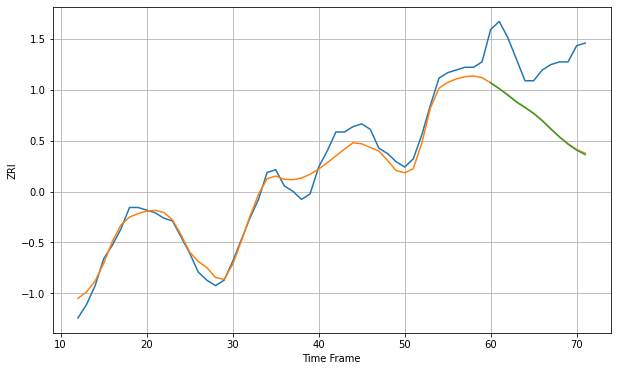

Wall time: 6.92 s
63118 3.8948817975796715 25.367059994012234 25.499921066438777 [725.23879859 723.07149714 720.70072893 718.15256187 716.09469716
 713.88079257 711.21406696 708.13362233 705.15979721 702.50116641
 700.26145465 698.61425368]

Got an mse at 0.0050 in round 251 and stopped training

60 60 12


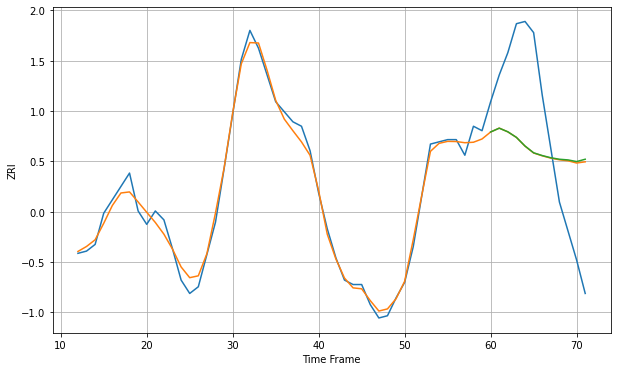

Wall time: 11.4 s
63130 3.6413801362152394 38.89390088654951 39.11200126815139 [1031.42488327 1033.13464168 1031.50989714 1029.00694016 1025.12412238
 1022.08767828 1020.85408602 1019.87037457 1019.19802529 1018.90166294
 1018.15765322 1019.20398531]

Got an mse at 0.0050 in round 136 and stopped training

60 60 12


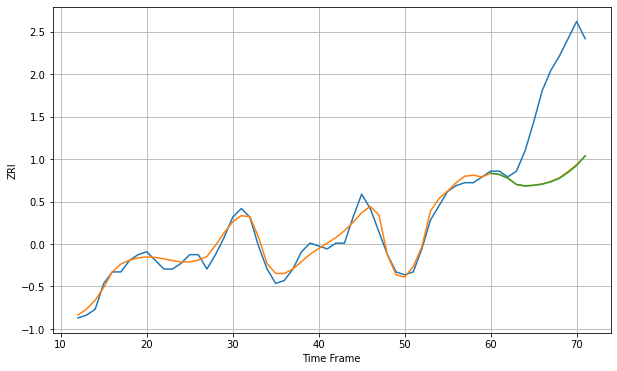

Wall time: 8.51 s
63139 2.502056047841043 30.599028596768015 30.726758699875795 [805.27467377 804.86254643 803.56003037 801.37190526 800.8630885
 801.08184022 801.49431973 802.29627148 803.50242092 805.54635225
 807.97433281 811.28992171]

Got an mse at 0.0049 in round 246 and stopped training

60 60 12


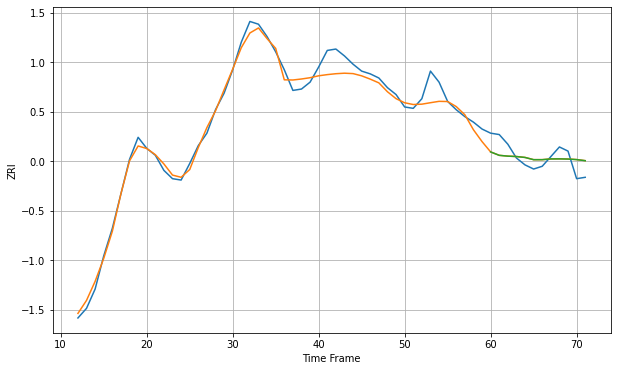

Wall time: 11.1 s
64111 6.886606811882001 9.284387823965464 9.278461989446047 [997.40500854 994.93175698 994.34357769 994.05110539 993.39217722
 991.77327125 991.77917276 992.31922648 992.35676428 992.2228879
 991.83054723 991.04911687]

Got an mse at 0.0050 in round 190 and stopped training

60 60 12


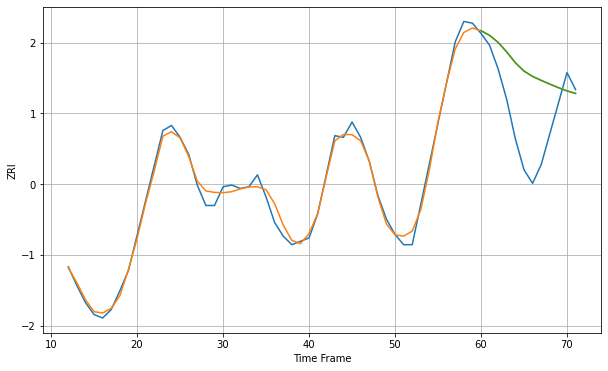

Wall time: 9.59 s
64801 3.917927575379626 33.96782835666341 34.00062295190474 [822.59231804 819.84135807 815.66999278 810.05283677 803.74987925
 798.90243911 795.76957894 793.45606688 791.28382729 789.16874333
 787.25337597 785.7470007 ]

Got an mse at 0.0049 in round 211 and stopped training

60 60 12


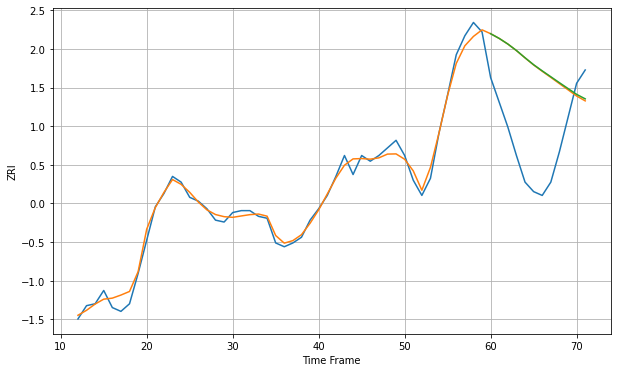

Wall time: 10.4 s
64804 3.5788000947214997 45.12059374060969 45.22505664669847 [863.08063389 860.59503627 857.65775365 854.24752006 850.42887232
 846.77577277 843.53754682 840.43778726 837.31048357 834.24927666
 831.18411847 828.80910338]

Got an mse at 0.0049 in round 292 and stopped training

60 60 12


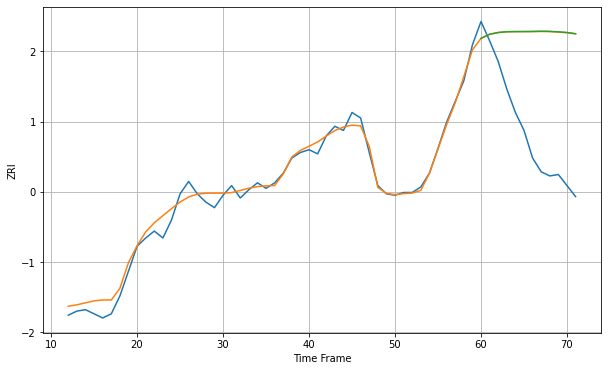

Wall time: 12.9 s
64834 5.705076708462363 80.37079850499549 80.46301492289821 [907.74608885 910.70269922 911.9815942  912.56003091 912.6774844
 912.69493946 912.76670981 912.89517954 912.80504636 912.46861736
 912.00530214 911.12208209]

Got an mse at 0.0049 in round 229 and stopped training

60 60 12


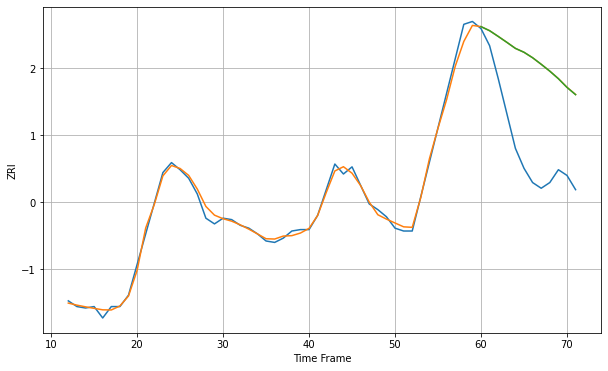

Wall time: 10.8 s
64836 3.4325623737386444 63.716859198701364 63.696501100843975 [866.37330789 863.52396597 859.51590588 855.38469433 851.12241689
 848.39404202 844.56198064 839.9693823  835.15746709 829.85496969
 823.75211205 818.65082346]

Got an mse at 0.0049 in round 119 and stopped training

60 60 12


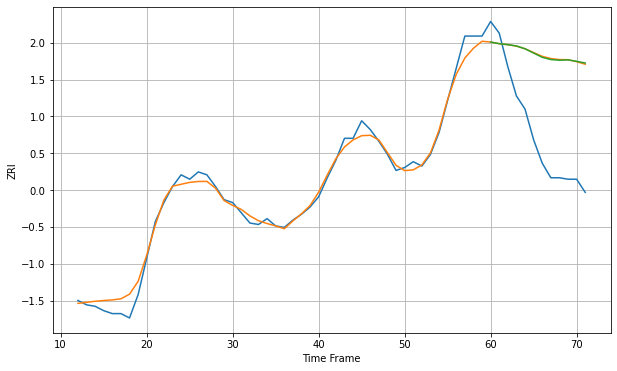

Wall time: 8.12 s
64870 5.271533710129587 62.14169191434001 62.04093451373137 [878.89338871 877.79053722 877.13796445 876.22017407 874.31628458
 871.36367736 868.47155327 866.93055705 866.45663894 866.69052633
 865.73163102 864.54720661]

Got an mse at 0.0049 in round 408 and stopped training

60 60 12


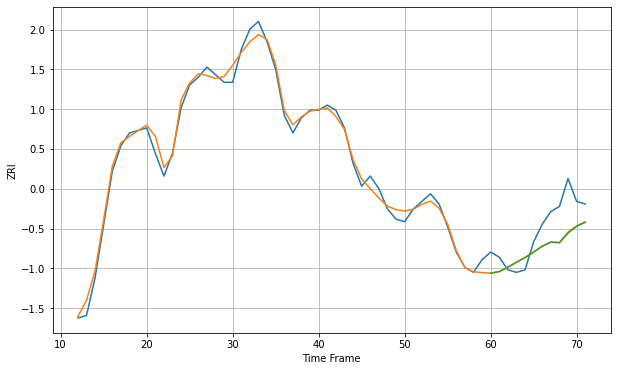

Wall time: 14.8 s
65201 2.847838922341769 9.894570530482962 9.97448058899141 [777.67794091 778.29452889 780.00137403 781.991274   783.85133531
 785.99675097 788.3165887  789.97470681 789.70865962 793.49864176
 796.18072188 797.74732698]

Got an mse at 0.0049 in round 396 and stopped training

60 60 12


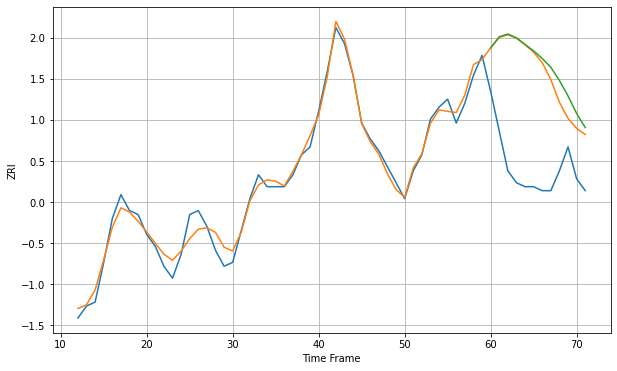

Wall time: 15.3 s
65202 2.2411516121169117 25.97894989507262 27.235608681789422 [800.89684849 803.67141113 804.3847737  803.4237849  801.7802281
 800.13230442 798.2449372  796.01692017 792.68409029 788.82522598
 784.41357059 780.88348183]
60 60 12


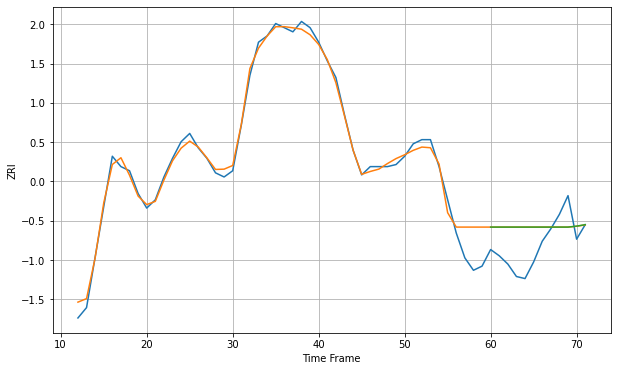

Wall time: 17 s
65203 5.2965266011874546 14.285562285628243 14.287951530556706 [823.83251669 823.83251669 823.83251669 823.83251669 823.83251669
 823.83251669 823.83251669 823.83251669 823.83251669 823.83251669
 824.29468    824.99982243]

Got an mse at 0.0049 in round 266 and stopped training

60 60 12


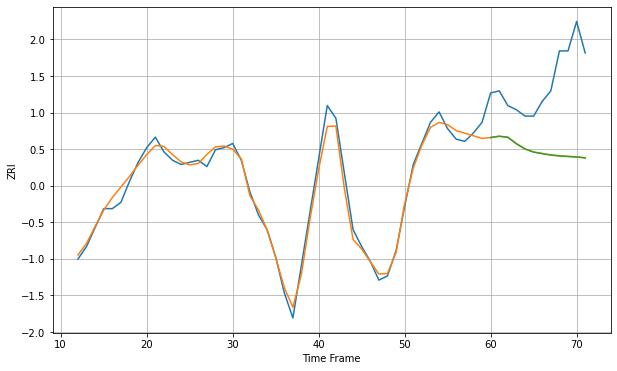

Wall time: 11.4 s
66061 3.567107454908737 35.487404573829686 35.524180625496165 [1004.80505043 1005.41405641 1004.92024368 1001.84807057  999.35545425
  997.89006034  997.15644324  996.47522607  996.06021038  995.79891802
  995.55818752  995.13215677]

Got an mse at 0.0050 in round 258 and stopped training

60 60 12


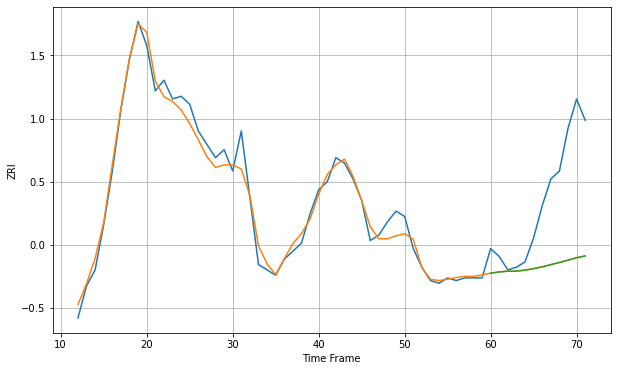

Wall time: 11.7 s
66213 4.09193722759302 31.01437328480308 30.98892328855203 [1022.78043201 1023.23367947 1023.50710844 1023.54527884 1023.91923785
 1024.45871484 1025.16065995 1025.97460514 1026.78414796 1027.66899884
 1028.57994975 1029.22419818]

Got an mse at 0.0050 in round 58 and stopped training

60 60 12


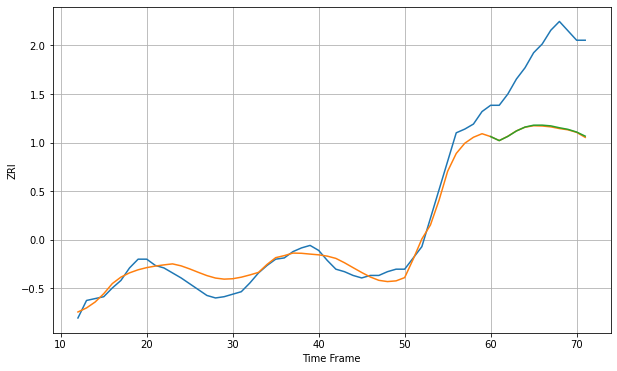

Wall time: 6.53 s
66214 8.240240126150216 61.401635948445204 60.98276695946772 [822.99065405 819.78036574 823.12760696 827.46895013 830.59144275
 832.0988097  832.12699287 831.5412508  830.03974477 828.76055115
 826.62235629 823.34622485]

Got an mse at 0.0050 in round 219 and stopped training

60 60 12


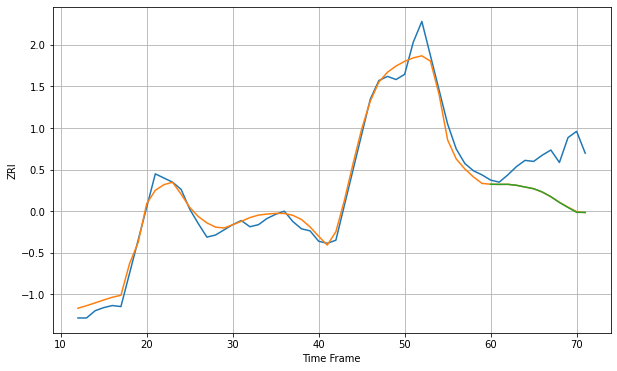

Wall time: 10.8 s
66215 9.028425720609341 41.167694942570435 41.29893351620584 [1027.99024389 1027.85759639 1027.92108769 1026.99655926 1025.30996536
 1023.69885215 1020.52481833 1016.00079502 1010.44225304 1005.55271741
 1000.88173009 1000.846179  ]

Got an mse at 0.0050 in round 140 and stopped training

60 60 12


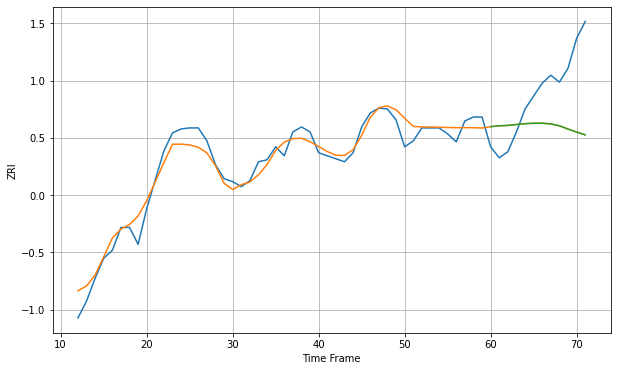

Wall time: 8.28 s
66223 11.18916869009009 53.74535316860007 53.782963068717045 [1426.27332185 1427.14392602 1427.51959916 1428.44426951 1429.27575688
 1429.65956139 1429.74779503 1429.01541966 1427.14095797 1423.87984399
 1420.83439027 1417.99185809]

Got an mse at 0.0049 in round 212 and stopped training

60 60 12


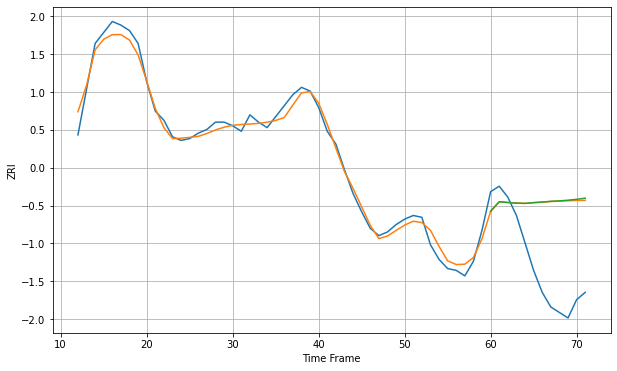

Wall time: 10.2 s
66502 4.142270675919738 41.92361858250662 42.18564498469746 [830.29612556 835.49677367 835.08698264 834.73374854 834.60325006
 835.01724312 835.31794524 835.73715799 835.98343099 836.34559724
 836.83616166 837.43619044]

Got an mse at 0.0050 in round 455 and stopped training

60 60 12


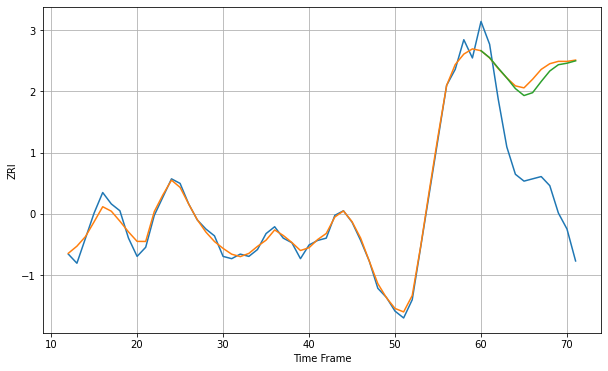

Wall time: 15.9 s
66614 2.680720705040614 49.17932265778746 47.455020246786816 [932.17138637 929.12457733 924.58555209 920.23624553 915.56835036
 912.52004621 913.77929157 918.67866572 923.28956082 926.03917677
 926.69423055 927.74251655]
60 60 12


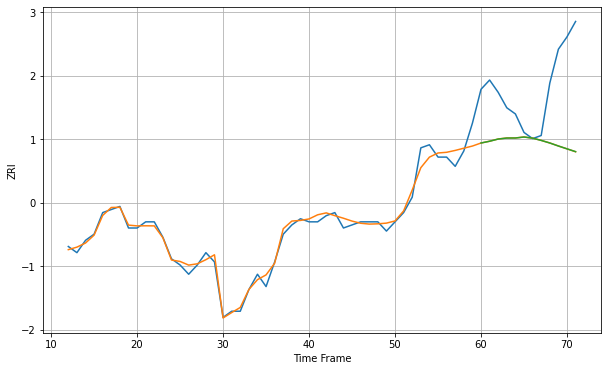

Wall time: 16.6 s
67218 2.206981759232935 21.517837482543506 21.51624229541802 [644.56956103 645.14315425 645.85763321 646.18021371 646.18685428
 646.51250626 646.14532106 645.41266291 644.57596364 643.60095542
 642.68185547 641.76789447]

Got an mse at 0.0050 in round 302 and stopped training

60 60 12


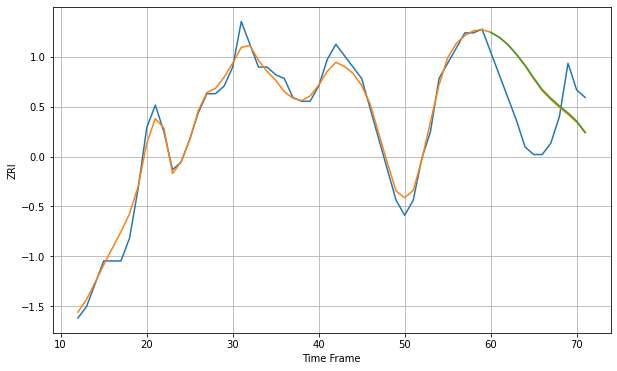

Wall time: 12.5 s
72205 2.6047485043973517 13.621641793726196 13.699737593619181 [743.15814243 741.85297468 739.94890995 737.40478851 734.52207005
 731.17248171 728.0884265  725.81166552 723.79180323 721.93533013
 719.82005363 716.83714784]

Got an mse at 0.0050 in round 214 and stopped training

60 60 12


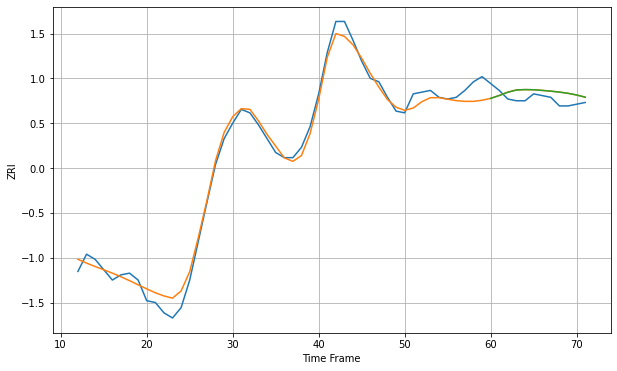

Wall time: 10.2 s
72712 5.257148843713114 5.5096766379266375 5.502079923331828 [918.37834635 920.04786871 921.95188338 923.24109348 923.48180498
 923.38545782 923.00897023 922.57740644 922.03158662 921.31829861
 920.3455981  919.07615673]

Got an mse at 0.0050 in round 387 and stopped training

60 60 12


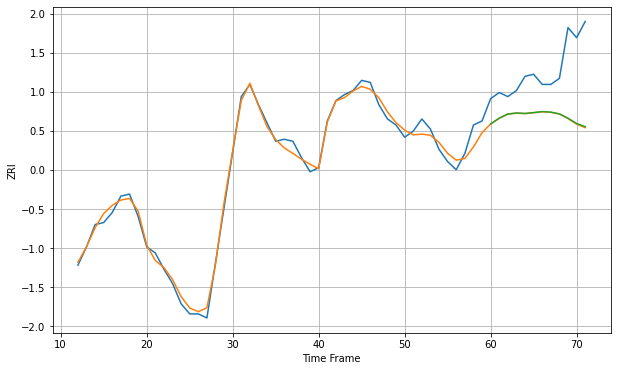

Wall time: 14.4 s
72764 3.342629017193083 26.527073665146485 26.347503313109776 [911.53049197 914.39840868 916.45227174 916.92996146 916.70827689
 917.13663344 917.61927577 917.35270095 916.50775036 914.36640946
 911.76979628 910.20076804]

Got an mse at 0.0050 in round 441 and stopped training

60 60 12


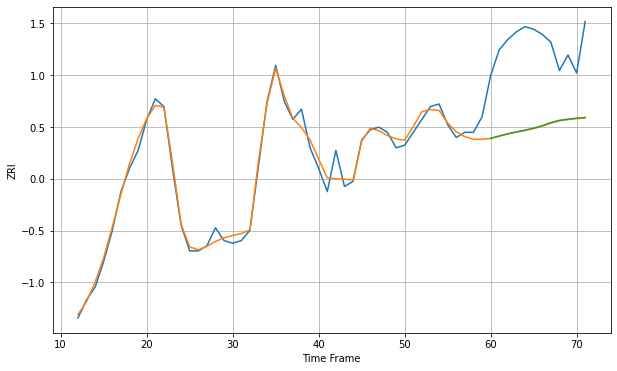

Wall time: 15.7 s
73071 3.128613702899641 32.478543566344015 32.34734300249469 [846.64691801 847.58248836 848.46006482 849.15820685 849.84927645
 850.61443723 851.56793586 852.76393716 853.6572377  854.11456795
 854.50273398 854.76672959]

Got an mse at 0.0048 in round 198 and stopped training

60 60 12


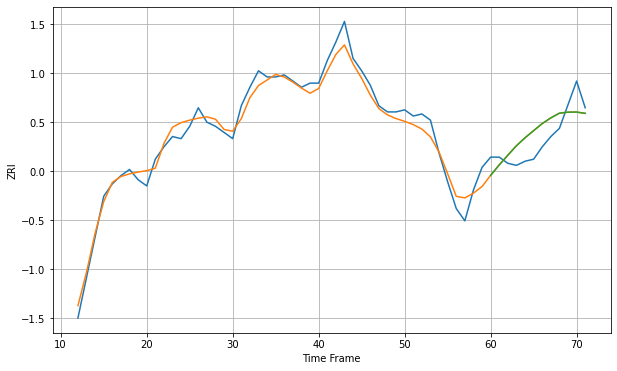

Wall time: 9.84 s
73159 4.854923118455449 9.292777732643495 9.286683398206732 [695.142516   700.21018986 704.94258817 709.53518911 713.41729587
 716.88638891 720.3161663  723.09006955 725.37754278 725.88408795
 725.93263915 725.31139453]

Got an mse at 0.0050 in round 68 and stopped training

60 60 12


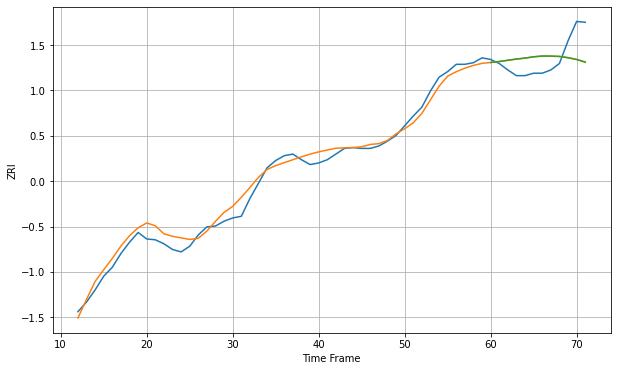

Wall time: 6.72 s
75001 9.766488606823591 24.816570293479472 24.727899482428462 [1292.2642647  1293.44453412 1295.02282641 1296.50556154 1297.71501074
 1299.30751389 1300.27761562 1300.17803695 1299.81011863 1298.30502579
 1296.09461379 1292.85840677]

Got an mse at 0.0050 in round 114 and stopped training

60 60 12


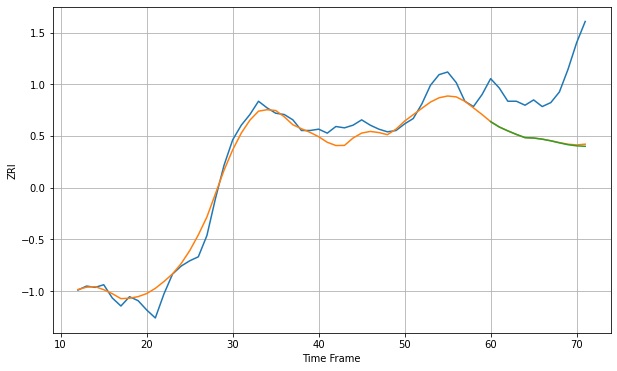

Wall time: 8.05 s
75010 8.401880040575193 45.569822891228604 45.98746790216193 [1236.65761886 1232.6557699  1229.7360986  1227.08253157 1224.62409127
 1224.33964114 1223.47604734 1222.21900964 1220.70306054 1219.30742651
 1218.45471792 1218.1109886 ]

Got an mse at 0.0049 in round 74 and stopped training

60 60 12


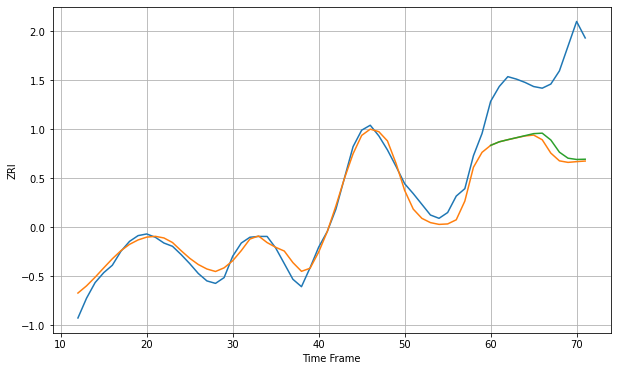

Wall time: 7.01 s
75013 11.611137731457443 100.03200164448603 96.31071002789288 [1408.56056962 1412.87659202 1415.46919571 1417.90651517 1420.37384424
 1422.8062714  1423.38421914 1415.09475304 1400.29272649 1392.99004251
 1391.45577915 1391.75227276]

Got an mse at 0.0050 in round 58 and stopped training

60 60 12


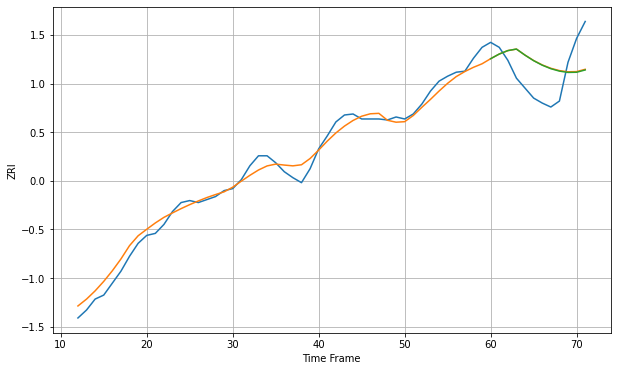

Wall time: 6.93 s
75024 8.31309910634189 30.593551998815016 30.62621025727959 [1359.56895783 1364.263602   1367.7193814  1369.26306106 1363.12537861
 1357.59641442 1353.05295008 1349.54476695 1347.09236986 1345.77811152
 1345.94430601 1348.26509917]

Got an mse at 0.0050 in round 104 and stopped training

60 60 12


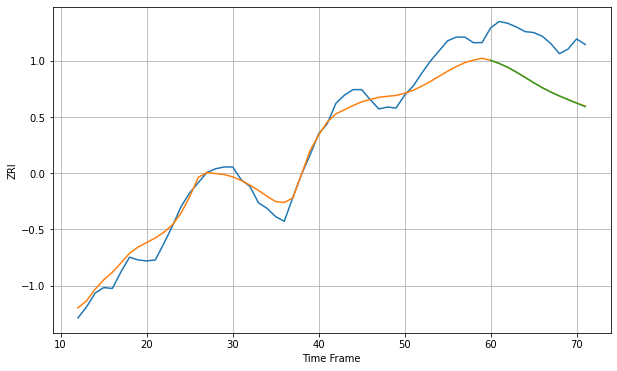

Wall time: 7.54 s
75039 14.22824455411572 52.992856392617135 53.13663895166453 [1502.81508125 1499.38111337 1495.15676456 1489.94583828 1484.30909947
 1478.55929213 1473.12193843 1468.32596902 1464.03536074 1460.10694949
 1456.26578307 1452.55418572]

Got an mse at 0.0050 in round 141 and stopped training

60 60 12


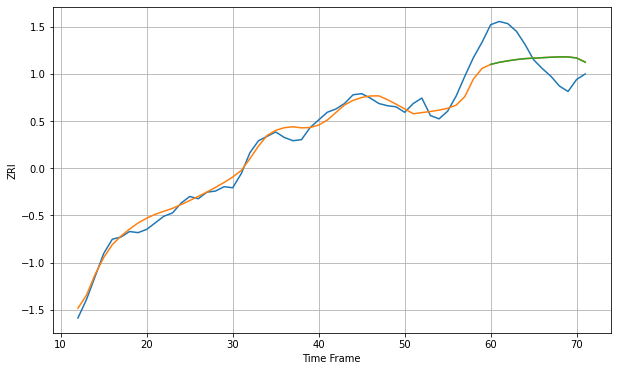

Wall time: 8.77 s
75050 7.8168989540619584 24.707196858218204 24.66727043992678 [1168.74907581 1170.65470984 1172.02002532 1173.17098977 1174.03527831
 1174.46630472 1174.88965746 1175.30128451 1175.60817199 1175.58055188
 1174.56503516 1170.75284231]

Got an mse at 0.0049 in round 172 and stopped training

60 60 12


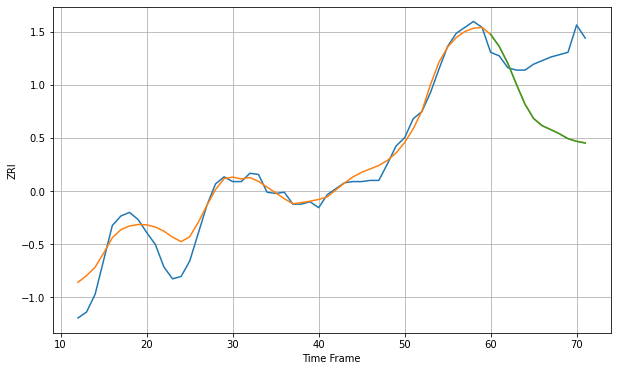

Wall time: 9.14 s
75052 12.378674414095729 55.716711554058264 55.81167547204498 [1135.12375291 1124.89420203 1110.61601351 1092.96731837 1076.16430677
 1064.15449955 1058.07509503 1054.79811787 1051.25989742 1047.14160514
 1044.88147738 1043.42880849]

Got an mse at 0.0050 in round 167 and stopped training

60 60 12


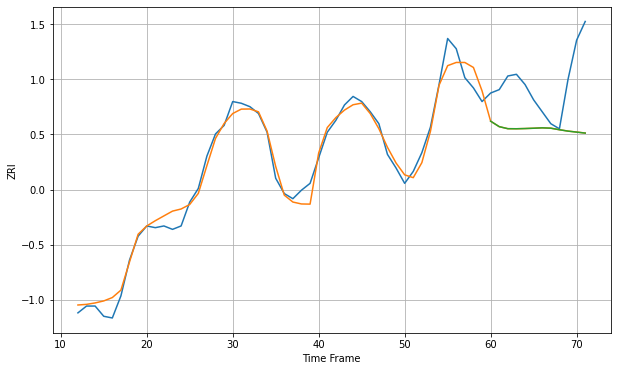

Wall time: 9.18 s
75056 5.878537246896199 31.454574993332994 31.47243091760736 [1346.47338314 1343.27289733 1342.08017404 1342.04128988 1342.16520632
 1342.34572077 1342.57412425 1342.3694832  1341.46290677 1340.65087676
 1340.06276301 1339.4834034 ]

Got an mse at 0.0049 in round 52 and stopped training

60 60 12


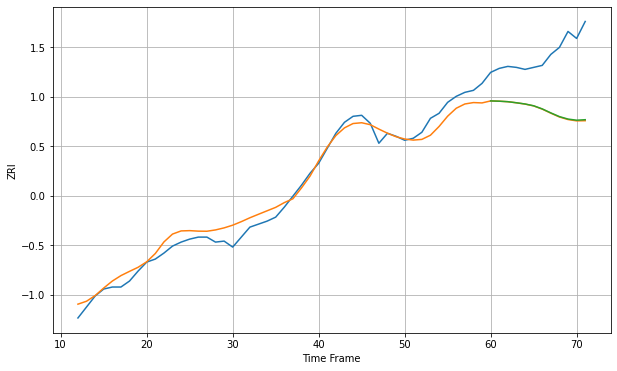

Wall time: 6.54 s
75063 9.597017887382824 59.04585769203485 58.66943114790376 [1212.41566848 1212.13861304 1211.64398484 1210.56694029 1209.34414383
 1207.55283594 1204.42780479 1200.42719506 1196.70052234 1194.23944832
 1193.10245218 1193.59939693]

Got an mse at 0.0050 in round 80 and stopped training

60 60 12


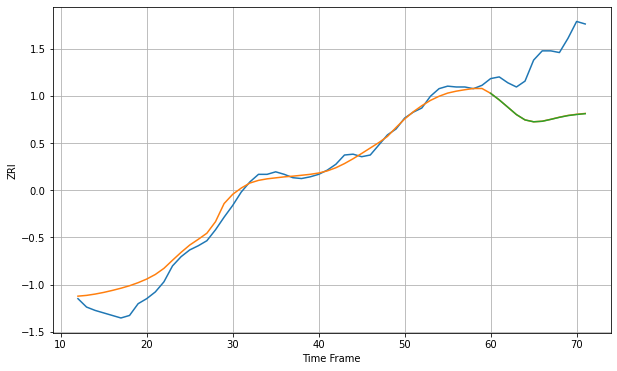

Wall time: 7.12 s
75067 12.81949027479186 71.92461163557648 72.0379603158788 [1195.44406723 1187.65958123 1178.94658383 1170.16796202 1163.80422559
 1161.56038267 1162.1858822  1164.43173756 1166.8823196  1168.93655475
 1170.25099273 1171.21944094]

Got an mse at 0.0050 in round 143 and stopped training

60 60 12


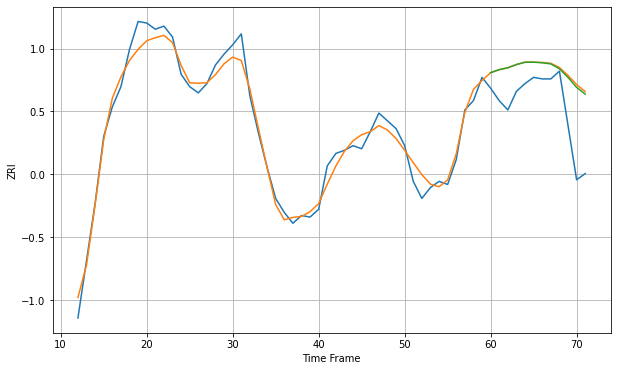

Wall time: 8.76 s
75070 7.0462791160012035 28.346053298148544 27.613676926063807 [1571.01673528 1572.96336672 1574.16237902 1576.24846216 1577.7423261
 1577.75424863 1577.39248166 1576.64063389 1573.53531865 1567.97420855
 1561.54052199 1557.22725462]

Got an mse at 0.0050 in round 90 and stopped training

60 60 12


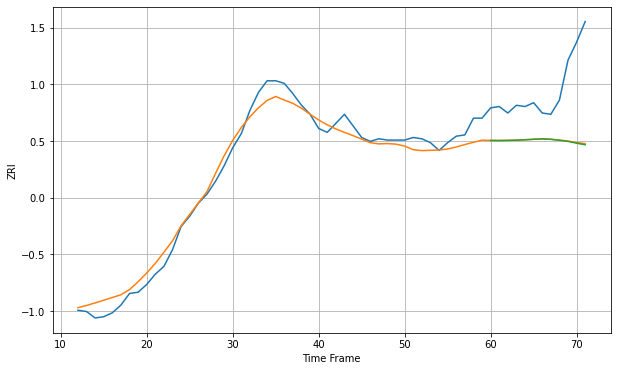

Wall time: 7.35 s
75074 8.255003611400731 45.380598553209076 45.65218592796969 [1232.71135986 1232.64774379 1232.75046147 1232.91900439 1233.23963047
 1233.60002723 1233.91054492 1233.56054626 1232.85450518 1231.96718131
 1230.59032285 1229.35641259]

Got an mse at 0.0050 in round 124 and stopped training

60 60 12


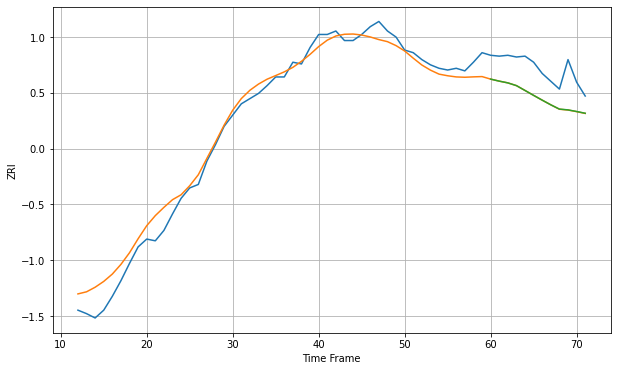

Wall time: 8.05 s
75081 14.371001706249764 34.01600826440797 33.96110321711253 [1269.50294618 1267.16833202 1265.16002497 1261.99560209 1256.39718445
 1250.74630922 1245.22054885 1239.84643991 1234.92271085 1234.02538252
 1232.15814503 1230.13686703]

Got an mse at 0.0049 in round 60 and stopped training

60 60 12


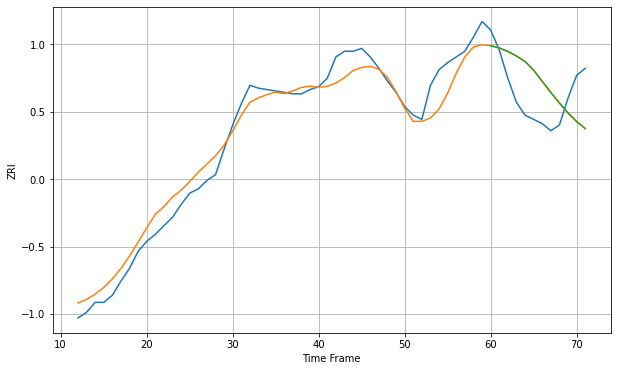

Wall time: 6.92 s
75093 10.858749091919865 27.406628201965123 27.398583652132036 [1398.94100345 1397.35167281 1394.87043842 1391.68604869 1387.81243427
 1381.65289188 1373.82361966 1365.97372726 1358.52400346 1351.52838197
 1345.42735995 1340.56971266]

Got an mse at 0.0050 in round 145 and stopped training

60 60 12


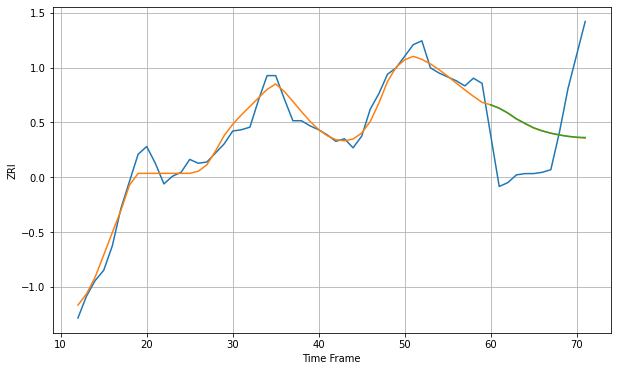

Wall time: 8.63 s
75201 8.203606238552222 47.63617790630815 47.62860487814255 [1661.36560657 1658.73014344 1655.02543429 1650.52430215 1646.92943661
 1643.55808644 1641.15223727 1639.3223882  1637.92550757 1636.88058634
 1636.19824491 1635.96682395]

Got an mse at 0.0050 in round 267 and stopped training

60 60 12


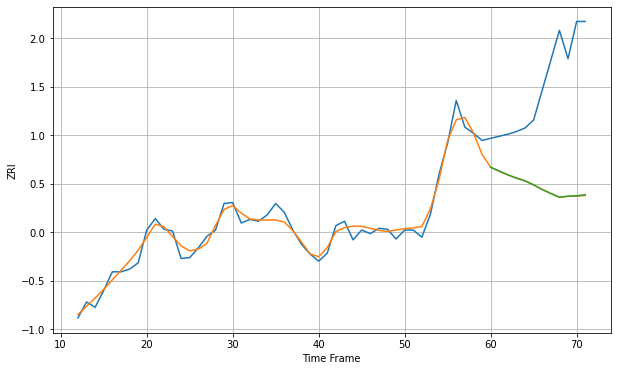

Wall time: 11.6 s
75202 8.360723831064673 125.13738001862741 124.94915567230676 [1574.78064073 1570.38189662 1566.20938209 1562.59803826 1559.45481512
 1554.9519703  1549.69367888 1545.2751443  1540.98323217 1542.18319121
 1542.59178623 1543.88467174]

Got an mse at 0.0050 in round 85 and stopped training

60 60 12


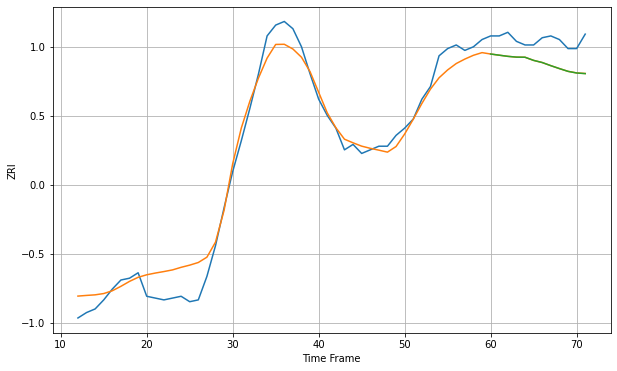

Wall time: 7.54 s
75204 8.744887005833387 13.27760931744881 13.290203043177625 [1499.99423099 1499.34729075 1498.70886611 1498.28185132 1498.20902422
 1496.47347656 1495.29064592 1493.55482007 1491.93517469 1490.40413328
 1489.50438275 1489.15457629]

Got an mse at 0.0050 in round 182 and stopped training

60 60 12


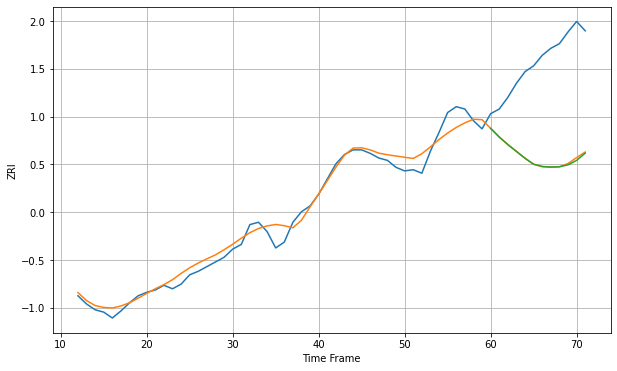

Wall time: 9.64 s
75206 7.734105509703256 84.68679923928157 85.15708901621072 [1369.44987836 1362.0414503  1355.54080337 1349.67788839 1343.79170829
 1338.71687582 1336.75377072 1336.3262025  1336.51418955 1338.17416357
 1341.98117123 1348.20570126]

Got an mse at 0.0050 in round 200 and stopped training

60 60 12


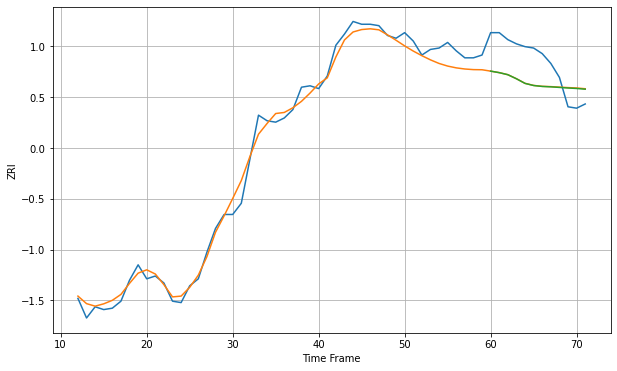

Wall time: 10.4 s
75214 6.897087751777957 21.622091462242555 21.617393845015933 [1207.48883318 1206.40886564 1204.93536237 1202.03033828 1198.71961507
 1197.20235465 1196.53509163 1196.26305697 1195.84712744 1195.43845231
 1195.08776644 1194.58219758]

Got an mse at 0.0049 in round 66 and stopped training

60 60 12


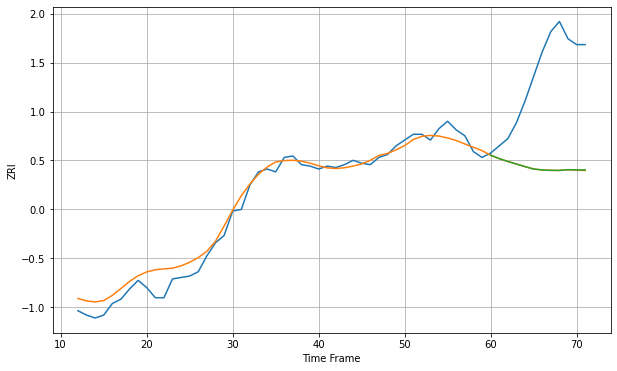

Wall time: 6.61 s
75219 6.914711536385745 68.97508599004603 68.90108339715195 [1443.51763917 1441.17997569 1439.19837324 1437.44924682 1435.64403477
 1433.99212071 1433.34800799 1433.07728454 1433.02441181 1433.53568714
 1433.38366057 1433.33430247]

Got an mse at 0.0050 in round 68 and stopped training

60 60 12


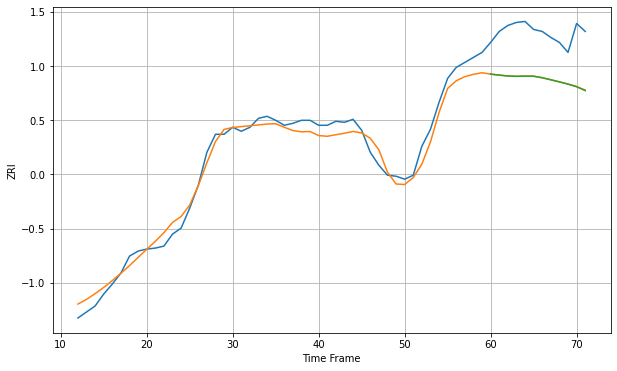

Wall time: 6.99 s
75235 10.036711588747433 47.894918923113885 47.99069280438819 [1427.26064079 1426.24444802 1425.4120127  1425.04962076 1425.23724908
 1425.1690275  1423.62285763 1421.58359365 1419.45701555 1417.23207598
 1414.6139611  1410.73088713]

Got an mse at 0.0050 in round 68 and stopped training

60 60 12


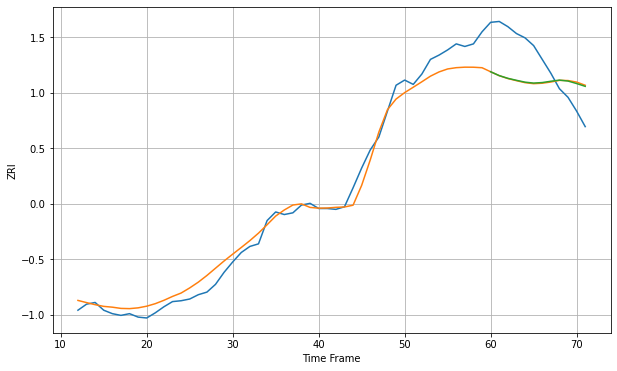

Wall time: 6.88 s
75243 13.90216212343544 44.06149915980938 43.57273307685897 [1112.64803658 1108.18473008 1105.03794681 1102.73657828 1100.58373793
 1099.51417503 1100.12384315 1101.636626   1102.96115792 1101.86171603
 1098.98752221 1095.74595251]

Got an mse at 0.0050 in round 135 and stopped training

60 60 12


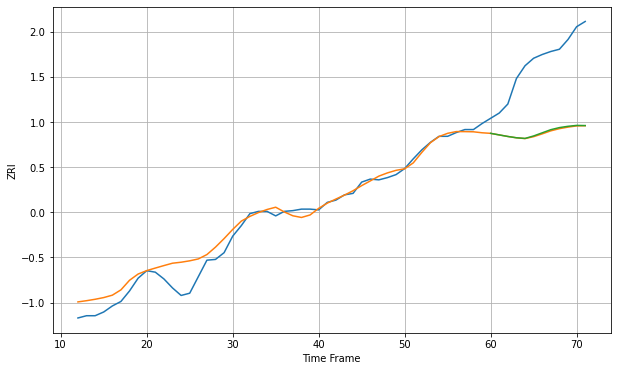

Wall time: 9.01 s
75244 14.253343956556925 97.30152948323747 96.591266625749 [1363.95134843 1361.86326609 1359.79814979 1358.06966217 1357.18997688
 1360.48244384 1364.65598928 1368.85259427 1371.61424075 1373.34323313
 1374.53950038 1374.31322862]

Got an mse at 0.0050 in round 193 and stopped training

60 60 12


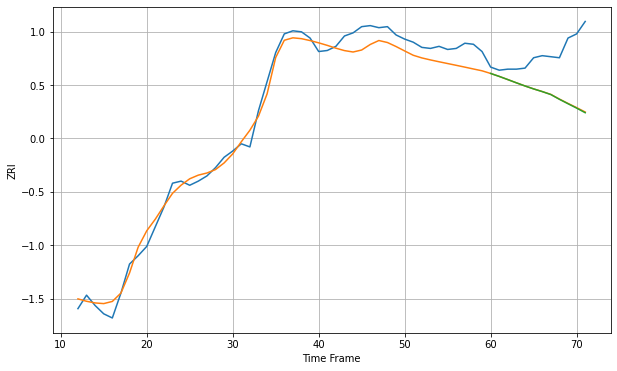

Wall time: 10.1 s
75248 11.496367711377342 43.12213342941777 43.36994638882315 [1256.85234994 1253.99830994 1250.93610453 1247.80902477 1244.77302411
 1241.94537475 1239.36824539 1236.51249751 1231.91791128 1227.64111865
 1223.43027727 1218.97479375]

Got an mse at 0.0049 in round 144 and stopped training

60 60 12


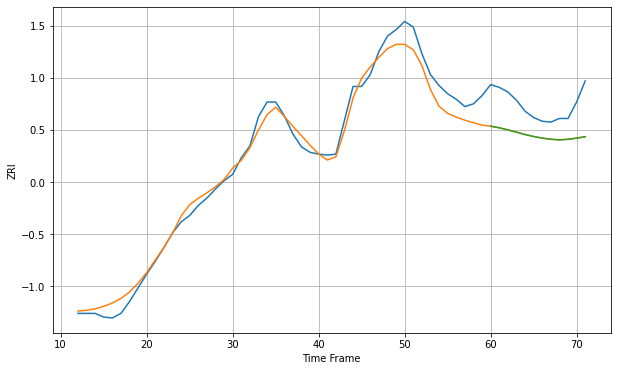

Wall time: 8.62 s
75287 12.562660666051382 35.397436231233335 35.4388641336366 [1122.58555371 1120.80620265 1118.55764954 1116.04425875 1113.47657203
 1111.2834961  1109.56279347 1108.26353897 1107.63227648 1108.21985792
 1109.47393112 1111.0318016 ]

Got an mse at 0.0050 in round 224 and stopped training

60 60 12


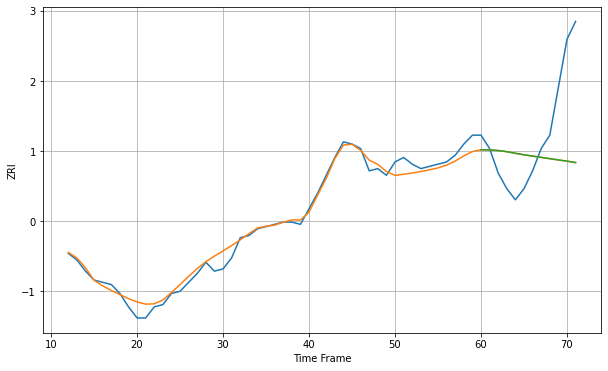

Wall time: 10.9 s
75703 3.3451053276683265 27.862091579908117 27.85481190689248 [902.46806664 902.36711139 902.10413867 901.5918846  900.87368473
 900.18208772 899.61146414 899.04615887 898.45648275 897.89213231
 897.34873977 896.72689555]

Got an mse at 0.0048 in round 43 and stopped training

60 60 12


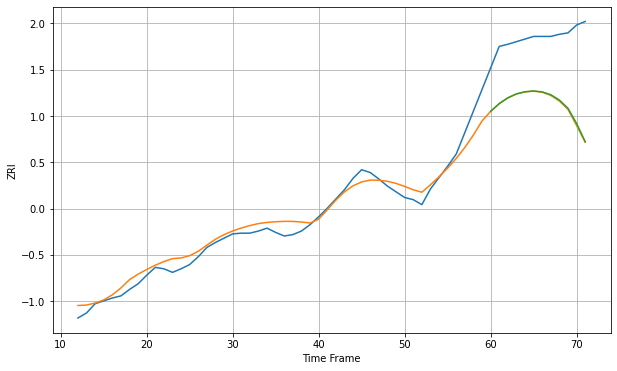

Wall time: 6.2 s
76006 13.369638036872676 97.67473925189047 96.83052478469384 [ 992.84207803 1003.72742172 1011.81439048 1017.35071165 1020.35526985
 1021.4919474  1020.19873039 1016.22125157 1008.70574191  997.13129231
  975.88829787  950.30544377]

Got an mse at 0.0049 in round 87 and stopped training

60 60 12


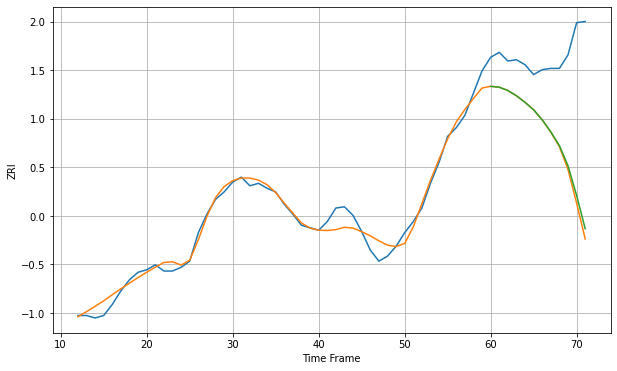

Wall time: 7.53 s
76010 6.7163510610925785 78.41211031522018 75.53779818256032 [1068.49863204 1067.78310356 1065.12974178 1060.86825857 1055.51048267
 1049.47020232 1041.37377722 1031.63523439 1020.48706952 1004.1768641
  980.21893996  953.19846183]

Got an mse at 0.0049 in round 498 and stopped training

60 60 12


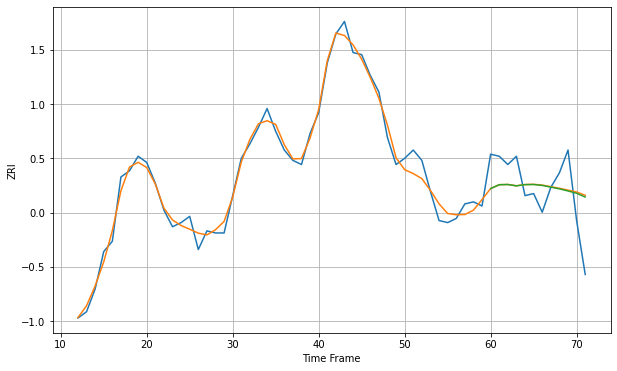

Wall time: 17 s
76012 4.212725486821135 15.95109617240465 15.789393156079962 [1211.41499117 1213.26218366 1213.36653347 1212.71182737 1213.32173969
 1213.3532711  1212.93008137 1212.11163305 1211.26294847 1210.2466413
 1209.13934249 1207.33286419]

Got an mse at 0.0049 in round 147 and stopped training

60 60 12


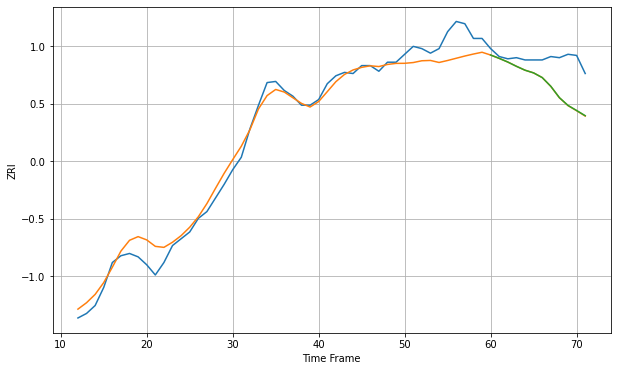

Wall time: 8.49 s
76015 11.400120855109932 26.40452916832715 26.292603357199326 [1274.34163988 1271.3789753  1268.13268665 1264.37873653 1260.93752255
 1258.5454186  1254.42857951 1246.70549752 1236.67974388 1229.7990077
 1225.32315013 1220.75258193]

Got an mse at 0.0049 in round 99 and stopped training

60 60 12


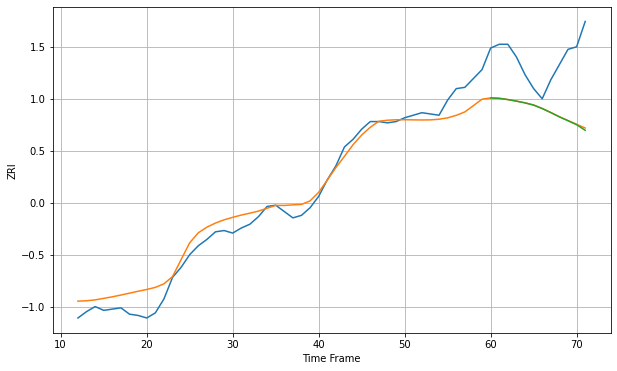

Wall time: 7.3 s
76017 10.723630940861659 44.29293482331047 44.64671111740673 [1034.65887133 1034.33838179 1033.36644678 1032.12336126 1030.72831087
 1028.99943651 1026.26006638 1023.07341313 1019.71956252 1016.65947064
 1013.52906653 1009.10589021]

Got an mse at 0.0049 in round 86 and stopped training

60 60 12


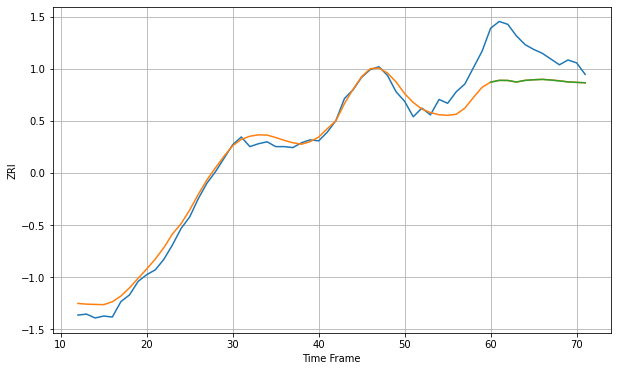

Wall time: 7.58 s
76039 11.482163372088976 38.12731810056754 38.13896920359113 [1243.96287802 1245.830228   1245.72179998 1244.10705725 1245.78945795
 1246.43310806 1246.81347164 1246.16384503 1245.24363173 1244.21909089
 1243.71285054 1243.35958167]

Got an mse at 0.0050 in round 114 and stopped training

60 60 12


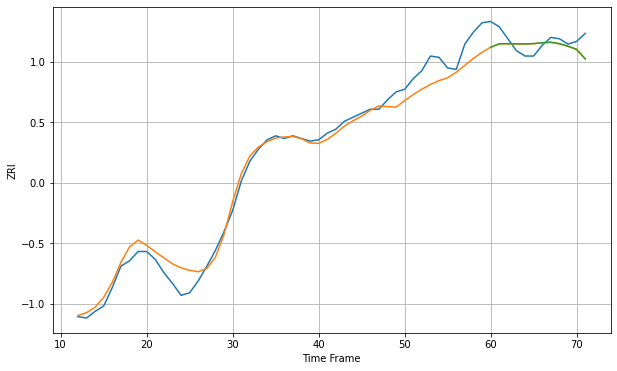

Wall time: 7.76 s
76051 9.302643784400054 9.96173132306148 9.934765814518094 [1387.5955682  1390.17375856 1390.29273695 1390.14537958 1390.12233824
 1390.36719168 1390.98767394 1391.42696573 1390.28799513 1388.46174361
 1386.06578634 1378.91878339]

Got an mse at 0.0049 in round 109 and stopped training

60 60 12


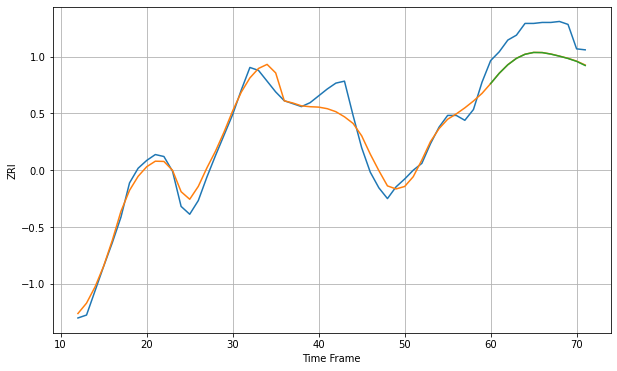

Wall time: 8.01 s
76107 11.494704083746708 27.274105918254026 27.37830726463725 [1309.52787763 1320.03371068 1328.75709625 1335.29117676 1339.4683387
 1341.31362222 1341.17995299 1339.64934898 1337.52864886 1335.1864241
 1332.22006271 1327.98143592]

Got an mse at 0.0049 in round 122 and stopped training

60 60 12


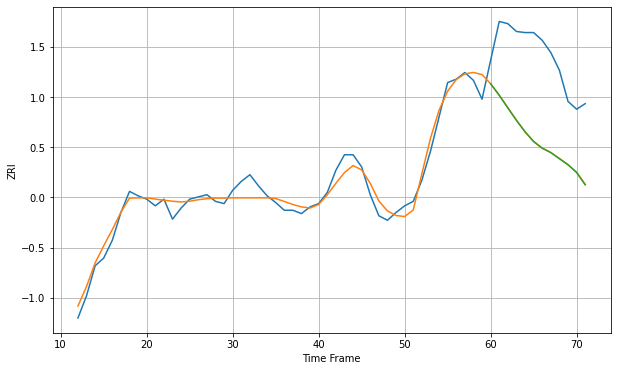

Wall time: 8.1 s
76108 8.682911443675694 76.47522815375409 76.5511066994404 [1133.91392525 1123.55792302 1112.21735677 1101.0291706  1090.65451733
 1081.88913168 1075.89574101 1071.91376973 1066.43428294 1060.95004911
 1053.98857458 1042.96218843]

Got an mse at 0.0050 in round 89 and stopped training

60 60 12


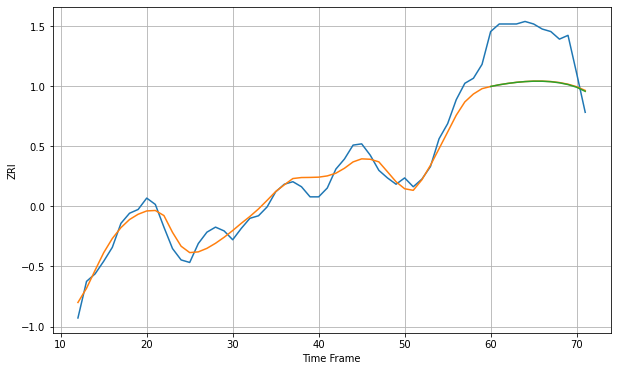

Wall time: 7.19 s
76116 8.65798277808934 40.06530243084952 40.11811116161765 [1161.46349855 1162.82066051 1163.88672747 1164.74623894 1165.33993034
 1165.66094046 1165.63167184 1165.25038045 1164.39177059 1162.98938581
 1160.8730666  1157.61198203]

Got an mse at 0.0050 in round 89 and stopped training

60 60 12


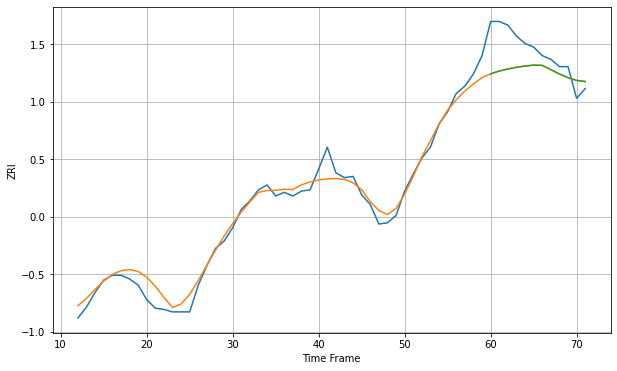

Wall time: 7.7 s
76132 8.013001944289162 23.274851284232657 23.291790240407067 [1282.08025802 1284.357519   1286.01941668 1287.41321194 1288.44485222
 1289.17077478 1289.02592372 1285.51338004 1281.97770696 1278.99755736
 1276.71576763 1275.76319818]

Got an mse at 0.0049 in round 147 and stopped training

60 60 12


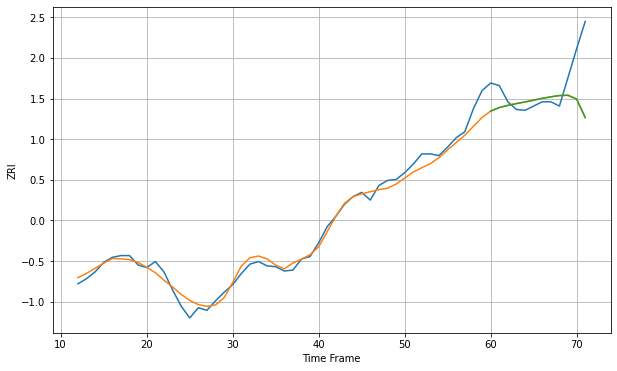

Wall time: 8.96 s
76133 8.83718394864479 39.521320305933145 39.44635654918467 [1034.15394728 1038.20359317 1040.81606873 1042.90323239 1044.82533948
 1046.91545585 1049.02288307 1050.83970082 1052.31302987 1052.66466923
 1048.21468163 1026.63176174]

Got an mse at 0.0050 in round 74 and stopped training

60 60 12


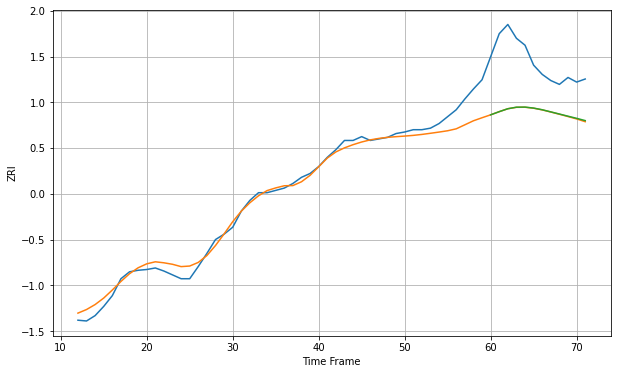

Wall time: 7 s
76137 13.413247099006309 70.18292171018427 69.93506925610605 [1230.36535777 1234.48163447 1238.28921449 1240.31297785 1240.4335164
 1239.1531823  1236.96780072 1234.19620132 1231.39664264 1228.57527817
 1225.8097628  1222.86459609]

Got an mse at 0.0050 in round 403 and stopped training

60 60 12


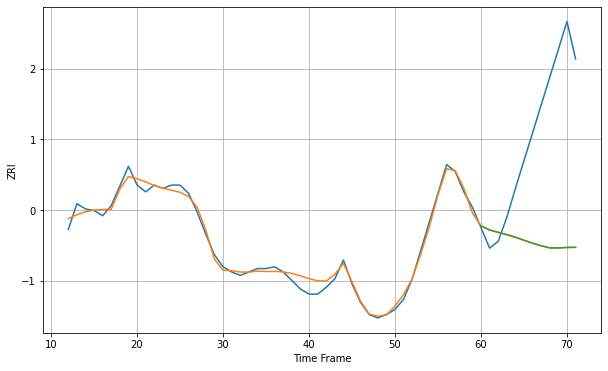

Wall time: 15.1 s
76522 3.400680291299334 75.11907879772605 75.1138950884032 [596.07667219 593.62609233 592.25463764 590.93334145 589.36664889
 587.5883868  585.88092103 584.35488667 583.14202112 583.10118279
 583.38446956 583.46906077]
60 60 12


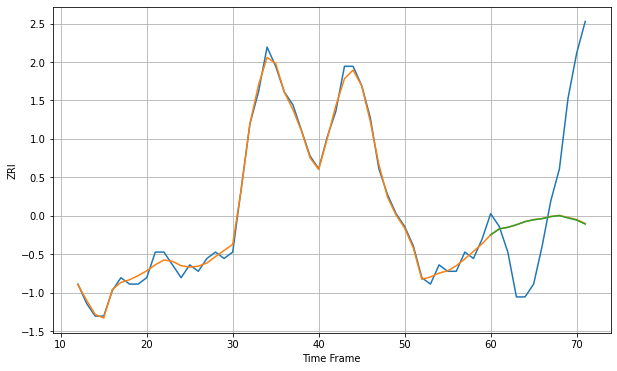

Wall time: 17.6 s
76543 0.860334825714465 14.379816411552945 14.418479649128226 [590.68705459 591.61574445 591.86791014 592.26177228 592.75140641
 593.04584055 593.2200959  593.53395557 593.69310113 593.32439345
 592.99328456 592.37128183]

Got an mse at 0.0050 in round 211 and stopped training

60 60 12


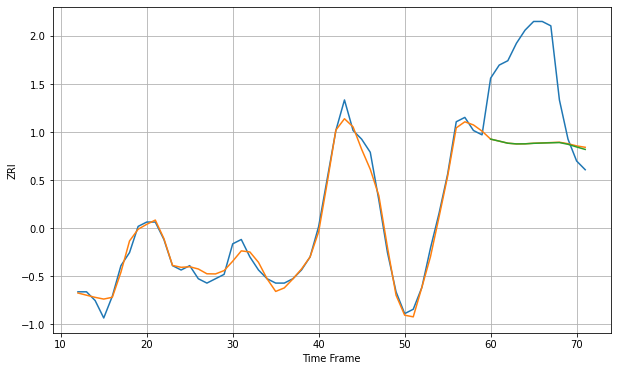

Wall time: 10.4 s
76549 1.6641118914330641 19.31201060523082 19.313281879353728 [675.01568581 674.55615213 674.08157558 673.91883838 673.93612518
 674.05712077 674.12107484 674.17946642 674.22963722 673.83028149
 673.21772329 672.65307153]
60 60 12


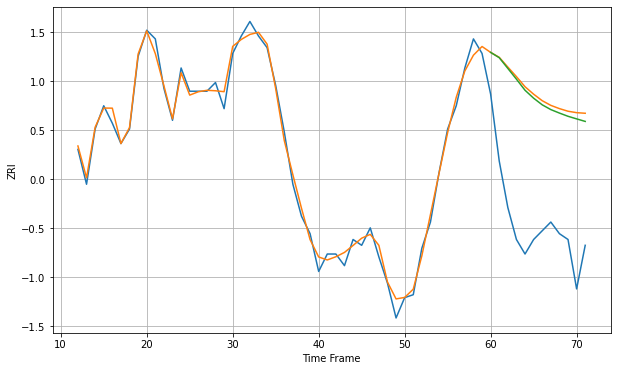

Wall time: 17 s
77004 2.743354312014743 46.46740781654074 45.15122037134642 [1412.35935278 1410.53747054 1406.84781494 1403.1504705  1399.33150722
 1396.60562759 1394.32223406 1392.68241718 1391.48850912 1390.38114955
 1389.48806653 1388.61805418]
60 60 12


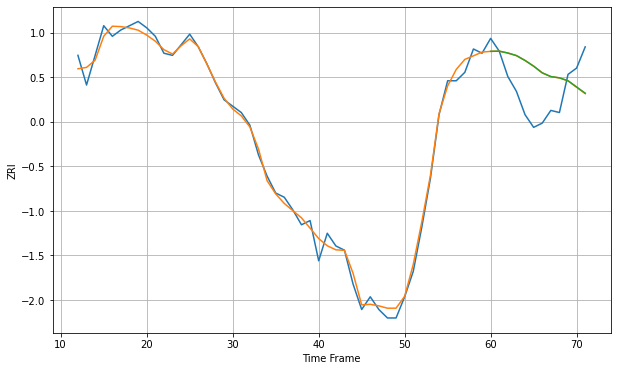

Wall time: 17.6 s
77006 3.5296589879303157 17.322856399873707 17.298584132262057 [1422.89176718 1422.98073093 1422.10298266 1420.88320068 1418.59511974
 1415.8998921  1412.74789546 1410.97784515 1410.39002578 1409.0150971
 1406.06930759 1403.12776331]
60 60 12


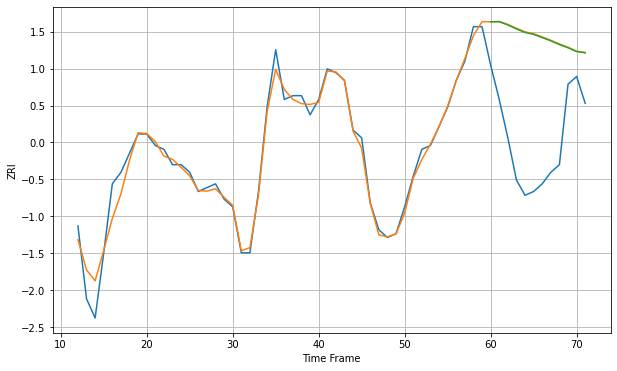

Wall time: 17.2 s
77007 2.770577046540762 29.51717265819737 29.389232965443153 [1496.28201019 1496.29122046 1495.45298578 1494.41886081 1493.4815351
 1492.99356956 1492.15004642 1491.29531931 1490.32585435 1489.49887979
 1488.51759049 1488.17635912]

Got an mse at 0.0050 in round 453 and stopped training

60 60 12


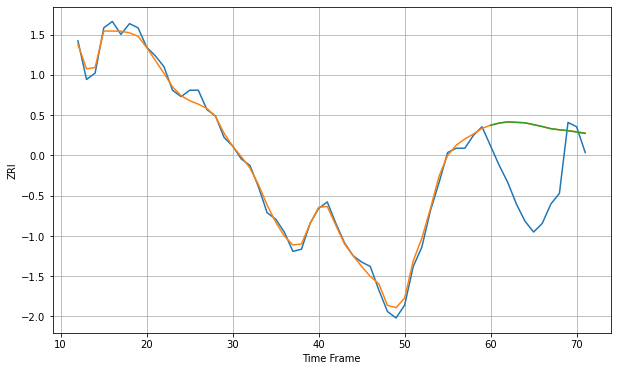

Wall time: 16.3 s
77019 2.719468700685803 31.05405155399421 31.04602698282147 [1414.68672375 1415.72778511 1416.24845601 1416.05048928 1415.83293172
 1414.96733364 1414.10005389 1413.09938525 1412.56328562 1412.15398541
 1411.52082522 1410.8958762 ]
60 60 12


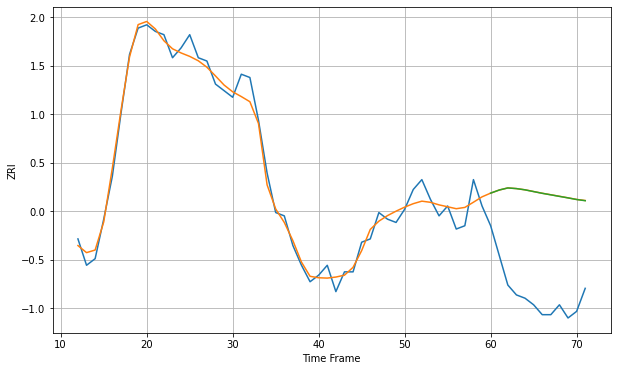

Wall time: 17.1 s
77027 3.241107571393743 31.13717775090302 31.118391503464174 [1441.89789596 1442.84532049 1443.47478333 1443.27402332 1442.89811864
 1442.37099397 1441.84535734 1441.3839028  1440.91150576 1440.45516752
 1439.95929668 1439.60207689]

Got an mse at 0.0050 in round 191 and stopped training

60 60 12


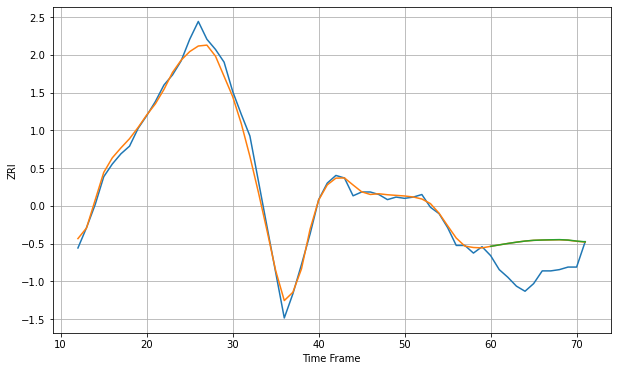

Wall time: 9.47 s
77042 5.824026617591931 25.20793072975612 25.25336001526573 [1171.28051359 1172.43780427 1173.54959694 1174.55084379 1175.43462138
 1176.02745263 1176.27178822 1176.42673994 1176.56029225 1176.2541193
 1175.43819287 1174.84710235]

Got an mse at 0.0050 in round 172 and stopped training

60 60 12


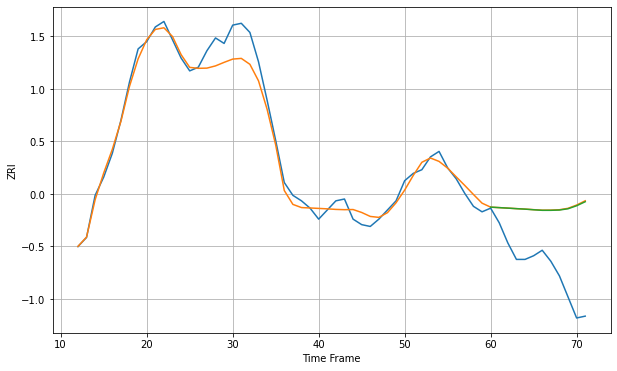

Wall time: 9.56 s
77054 6.572249155249928 35.682831885340846 35.49214399658489 [1254.55519894 1254.29280161 1254.01718012 1253.72602198 1253.46051868
 1253.12370134 1252.81984018 1252.81952629 1252.97407631 1253.66901617
 1255.31425441 1257.51164038]
60 60 12


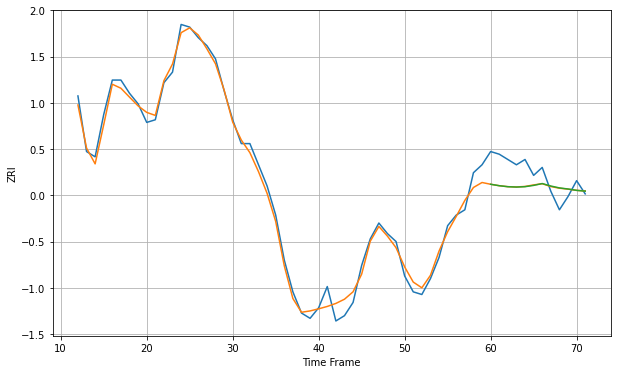

Wall time: 17.4 s
77056 3.0761601429501173 7.7291865328561755 7.762002454378076 [1443.64032488 1443.09315832 1442.71706517 1442.58319951 1442.72441432
 1443.20967589 1443.90856745 1442.97858819 1442.26352798 1441.84909053
 1441.34046337 1441.04807374]

Got an mse at 0.0049 in round 398 and stopped training

60 60 12


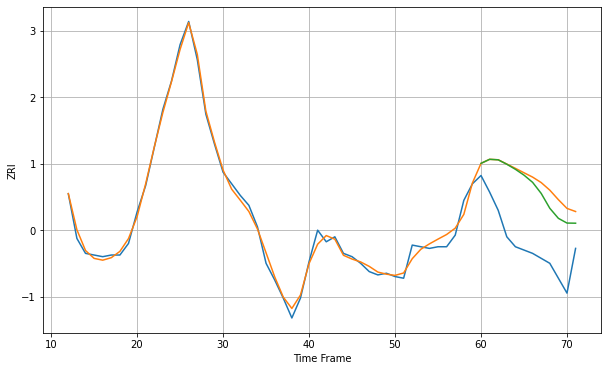

Wall time: 14.7 s
77057 3.439818061957314 40.04823785365077 35.74334116389726 [1447.33238568 1449.7816603  1449.48173292 1446.80794688 1443.75229919
 1440.22400472 1435.88226115 1429.19524287 1420.22752378 1414.14756249
 1411.3006903  1411.21448514]

Got an mse at 0.0050 in round 244 and stopped training

60 60 12


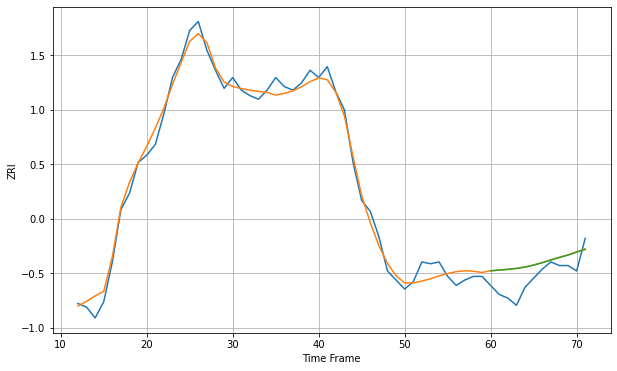

Wall time: 10.8 s
77063 5.027369904384287 10.4523214802142 10.430141132384346 [1270.10015998 1270.47996447 1270.89289663 1271.40084846 1272.15214577
 1273.26257087 1274.55327449 1276.05950719 1277.47324848 1278.80045784
 1280.38915548 1281.92547181]

Got an mse at 0.0049 in round 102 and stopped training

60 60 12


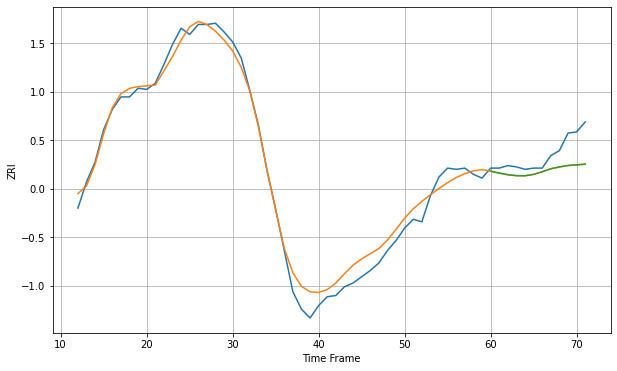

Wall time: 7.53 s
77077 8.713120263720194 15.749587858537017 15.766713333815805 [1187.53468572 1186.01589601 1184.70132486 1183.94630708 1183.88513878
 1184.97856394 1187.05097831 1189.47259477 1190.91714619 1192.0812638
 1192.5699556  1193.15171971]
60 60 12


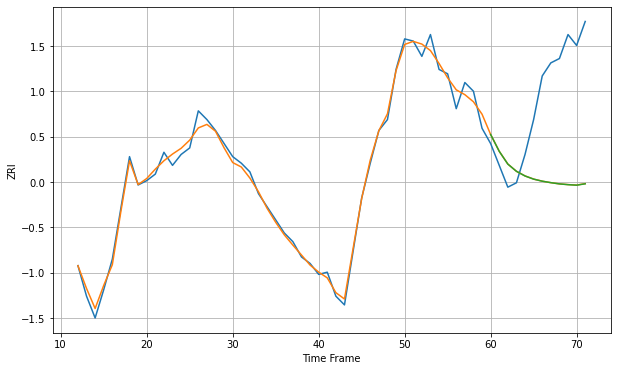

Wall time: 16.9 s
77090 3.2767713881064475 44.7784594658118 44.80357505716843 [961.16563119 953.44407481 947.58184485 944.2682527  942.13322085
 940.68888728 939.74160461 939.06410211 938.49605063 938.14811429
 937.9046951  938.54098265]

Got an mse at 0.0050 in round 399 and stopped training

60 60 12


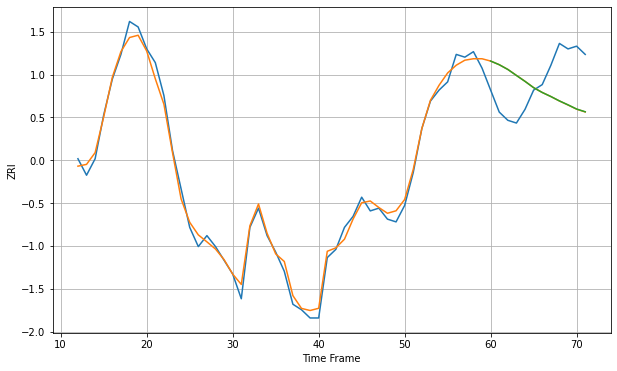

Wall time: 14.6 s
77098 2.706995351858429 16.119658629479055 16.093583615603336 [1502.57959876 1501.2476187  1499.51703776 1497.32872491 1495.17699945
 1492.88332196 1491.13676602 1489.66889166 1488.05935249 1486.62622524
 1485.10197719 1484.10495315]

Got an mse at 0.0050 in round 124 and stopped training

60 60 12


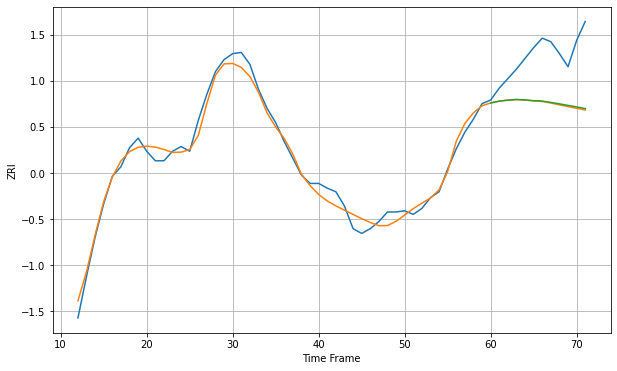

Wall time: 8.29 s
77380 6.903709893364198 42.355855935446705 41.81905094913193 [1414.55768773 1416.0664727  1416.93298702 1417.46760902 1417.10299262
 1416.48601838 1416.13752295 1415.02602623 1413.80178939 1412.53139155
 1411.22640501 1409.89396171]

Got an mse at 0.0049 in round 62 and stopped training

60 60 12


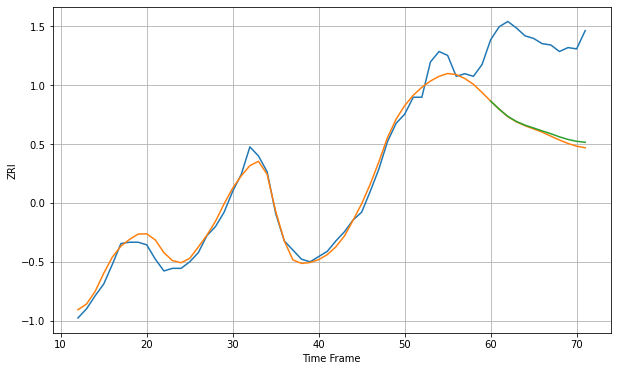

Wall time: 6.77 s
77429 7.468329057975181 70.26487479918131 68.6681204292893 [1184.06777602 1177.82431035 1172.29977331 1168.43823917 1165.60909409
 1163.43876047 1161.19052492 1159.06521962 1156.67052755 1154.6822849
 1153.23712444 1152.51892801]

Got an mse at 0.0050 in round 485 and stopped training

60 60 12


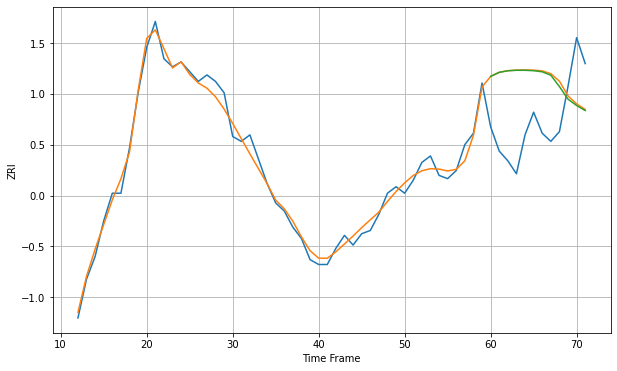

Wall time: 18.3 s
77494 5.132567222435924 40.31839816183621 40.074320333791675 [1286.08481522 1288.57282889 1289.56457444 1289.86604666 1289.8593878
 1289.61430929 1288.92874953 1286.83031956 1279.8149675  1272.03112766
 1268.13982061 1265.02559965]

Got an mse at 0.0050 in round 86 and stopped training

60 60 12


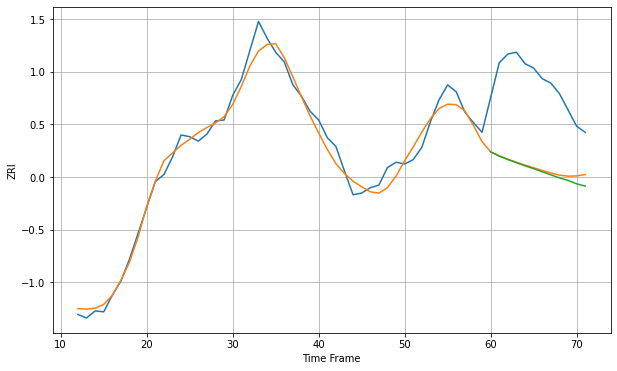

Wall time: 7.43 s
77550 11.298952813536273 96.662437388046 98.91067629848968 [1117.8008227  1112.98507228 1109.150812   1105.48030021 1101.9394524
 1098.68249331 1095.19864808 1091.67703417 1088.20590381 1085.38348666
 1081.47485671 1078.92277789]

Got an mse at 0.0049 in round 95 and stopped training

60 60 12


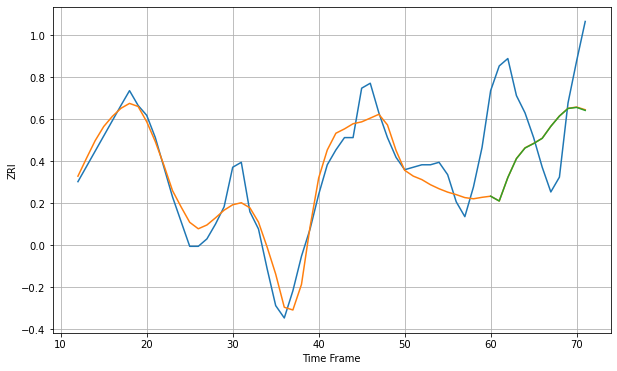

Wall time: 7.4 s
77584 7.415396145279797 30.37112672590032 30.407291763204984 [1398.28686024 1396.33951713 1405.84080426 1413.47988294 1417.7840637
 1419.59211658 1421.70111688 1426.552861   1430.69211381 1433.77939237
 1434.22470201 1433.0073508 ]

Got an mse at 0.0050 in round 240 and stopped training

60 60 12


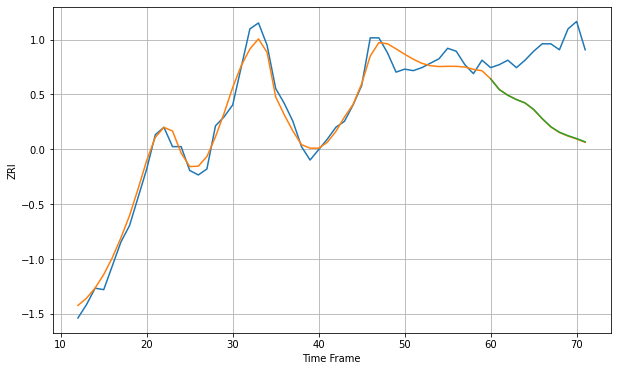

Wall time: 11.1 s
77598 6.871723002243522 48.032709789617634 47.863882788884666 [1113.48747678 1106.34364105 1102.47913233 1099.59645174 1097.31766126
 1092.97096019 1086.80524105 1081.3604545  1077.68125788 1075.3443722
 1073.43262977 1071.21439755]

Got an mse at 0.0050 in round 265 and stopped training

60 60 12


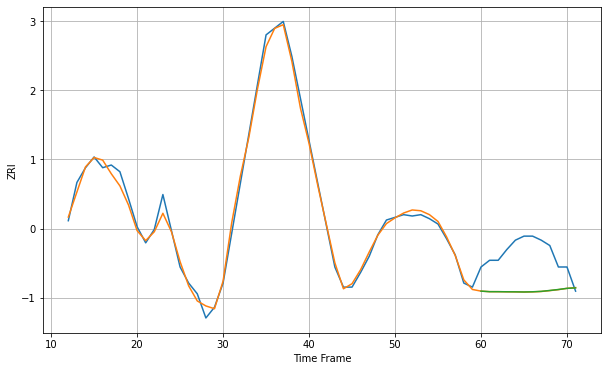

Wall time: 11.9 s
77840 4.484004065683493 29.58154967664882 29.529422311776198 [851.00914617 850.60372745 850.59723819 850.52456799 850.48430806
 850.38840308 850.52449719 850.8391367  851.49855411 852.22395435
 853.08433689 853.41860545]

Got an mse at 0.0049 in round 267 and stopped training

60 60 12


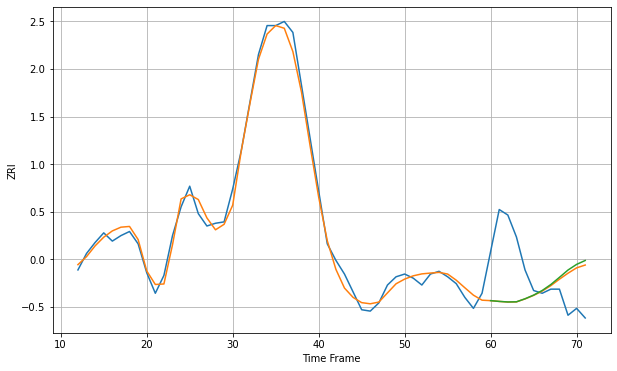

Wall time: 11.7 s
77845 5.669956708232157 36.33051994170039 36.98574884882129 [957.62122095 957.06749136 956.66954472 956.77602526 958.97770877
 961.6598025  965.03214388 969.36482156 974.57918633 979.9320316
 984.04000309 986.88103792]

Got an mse at 0.0049 in round 179 and stopped training

60 60 12


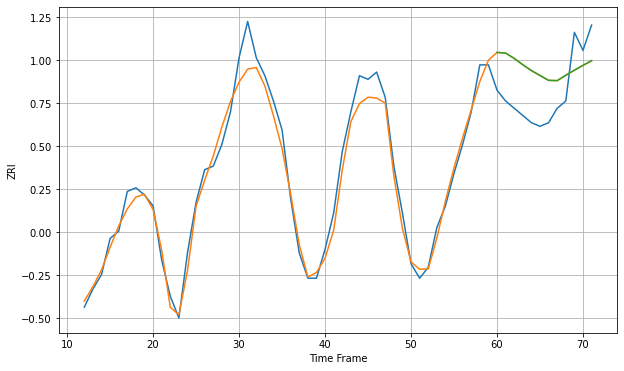

Wall time: 9.33 s
78130 3.8018108486732833 11.357665237625213 11.35234332158903 [1156.44539935 1156.26182149 1154.77619583 1153.03459781 1151.41737228
 1150.05637041 1148.71910629 1148.64100556 1150.12203298 1151.53697656
 1152.87510998 1154.18190035]
60 60 12


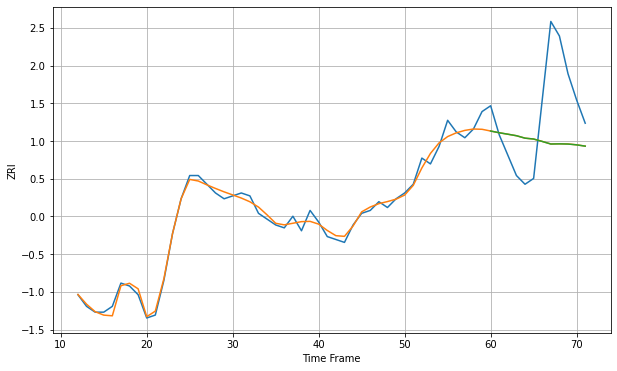

Wall time: 17.2 s
78201 2.032388319528877 20.386567135618442 20.401330652242038 [883.30945109 882.71485249 882.21671883 881.69764555 880.86082934
 880.55679978 879.72570865 878.83677021 878.89409539 878.83182761
 878.54927771 878.1064121 ]
60 60 12


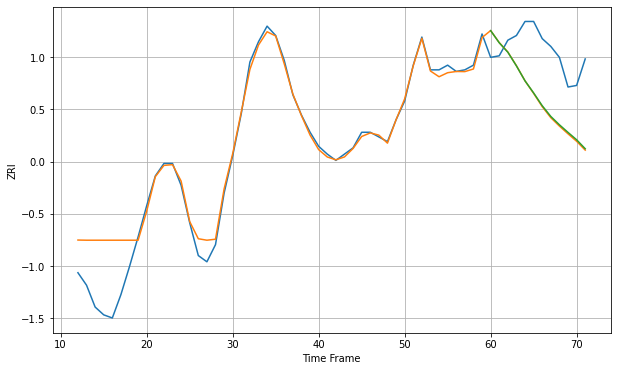

Wall time: 17.3 s
78209 14.329434075479975 36.38667754922459 35.876707306674035 [1269.15132932 1261.35197662 1255.30277235 1246.53001243 1236.9339597
 1229.20809263 1221.01203218 1214.12706824 1208.79474141 1203.91461701
 1199.19287935 1193.4522018 ]

Got an mse at 0.0050 in round 231 and stopped training

60 60 12


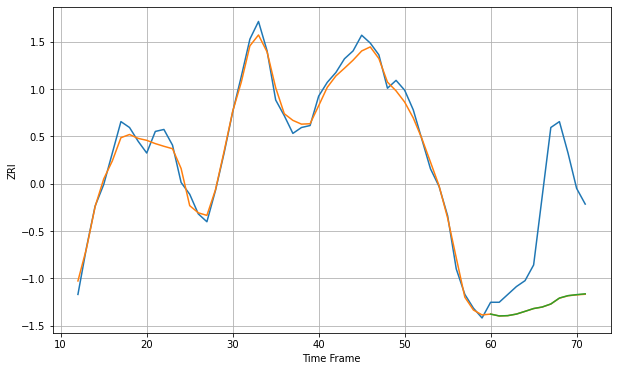

Wall time: 10.6 s
78210 4.218491373967388 50.67831971304402 50.629764045961515 [931.97563909 931.02866607 931.19408523 931.98712099 933.37705707
 934.80664296 935.58678933 937.12453788 940.14320276 941.37367569
 941.88512753 942.29947259]

Got an mse at 0.0050 in round 326 and stopped training

60 60 12


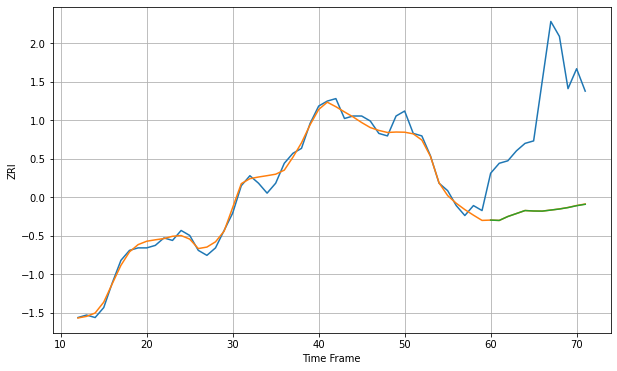

Wall time: 12.9 s
78212 2.6593605917541527 44.89213998569852 44.91859161140876 [890.16957571 890.03044021 891.60828519 892.80055481 894.01000556
 893.82144842 893.77099702 894.19414962 894.62584668 895.20042977
 895.95285843 896.51455341]
60 60 12


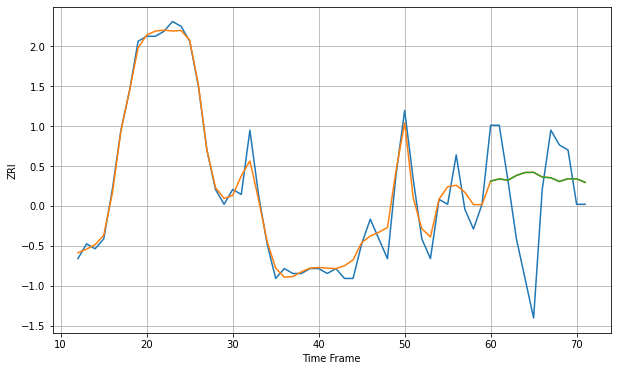

Wall time: 16.8 s
78213 2.4284955556631447 12.821223103281753 12.821157965791036 [927.69198814 928.14540047 927.86642734 928.83767074 929.43830437
 929.4710791  928.520795   928.37596596 927.61732715 928.17019369
 928.16068861 927.45229835]
60 60 12


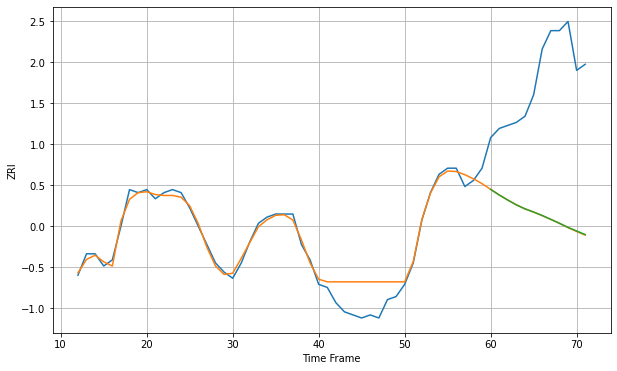

Wall time: 16.8 s
78216 4.119658919849925 46.27268954615852 46.21043497114634 [968.0730682  966.23246547 964.56694379 962.99103502 961.69972486
 960.65735208 959.51278784 958.27257955 956.99328358 955.64570611
 954.45405274 953.29428434]

Got an mse at 0.0049 in round 253 and stopped training

60 60 12


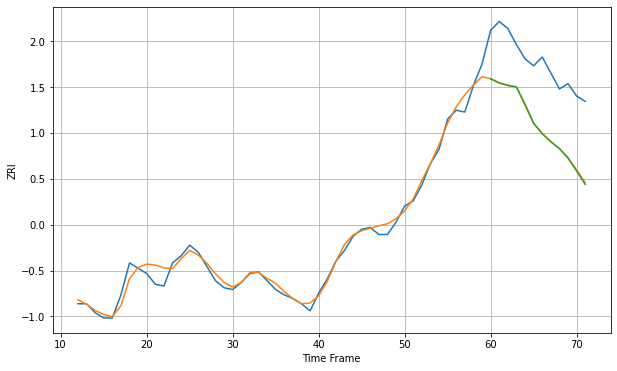

Wall time: 11.1 s
78229 3.88507620016382 35.75199787896268 35.880542710903946 [1035.74618771 1033.38638506 1031.98285657 1031.14135943 1021.49194697
 1010.72494251 1004.85661391 1000.26588839  996.39418052  991.01997482
  983.80729839  976.22570835]
60 60 12


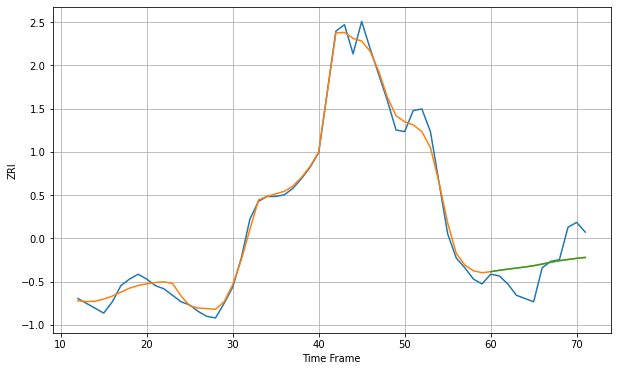

Wall time: 16.9 s
78233 5.214998248591793 14.125233832042685 14.127808948968385 [958.57003608 959.40662274 960.13935716 960.80127359 961.47260496
 962.2618874  963.28744917 964.41448292 965.34263207 966.08972747
 966.7906211  967.35384173]

Got an mse at 0.0050 in round 154 and stopped training

60 60 12


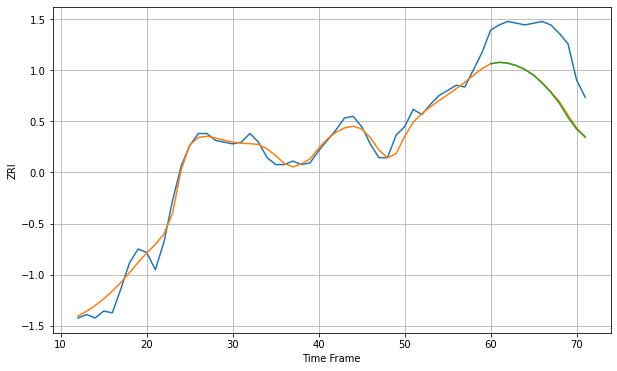

Wall time: 8.68 s
78240 5.045288478209963 30.197258202313012 30.599878664830882 [1093.46086794 1094.29654729 1093.82331743 1092.36547823 1090.07211664
 1086.76989286 1082.20464877 1076.89226827 1070.46367727 1062.35151728
 1055.55714176 1051.10627553]

Got an mse at 0.0050 in round 107 and stopped training

60 60 12


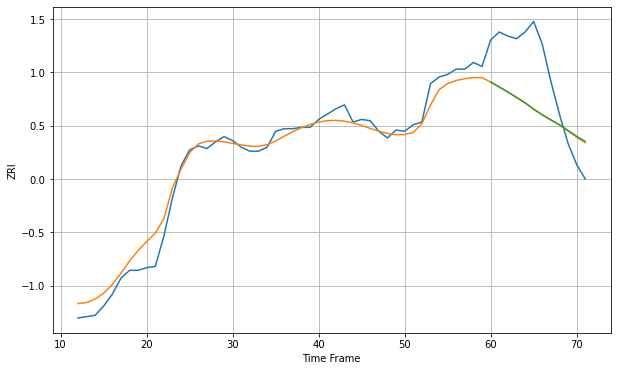

Wall time: 7.49 s
78249 8.380476354585335 39.562630551764336 39.64741373660403 [1121.22091811 1117.53824278 1113.70220124 1109.66212924 1105.53400267
 1100.76199193 1096.57037585 1092.64208158 1088.99506504 1084.66107152
 1080.25026054 1076.41449484]

Got an mse at 0.0050 in round 312 and stopped training

60 60 12


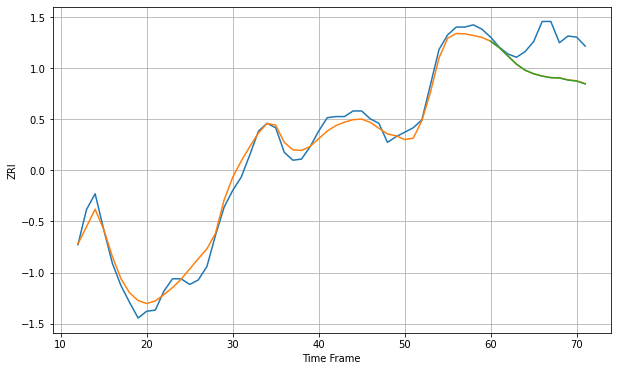

Wall time: 12.5 s
78256 8.434647653776407 30.56934323010815 30.680017508540647 [1230.32713333 1224.68010861 1217.23456666 1209.87396544 1204.46497937
 1201.25009718 1199.1465375  1197.75692594 1197.49298837 1195.6400322
 1194.72481474 1192.15484933]

Got an mse at 0.0050 in round 208 and stopped training

60 60 12


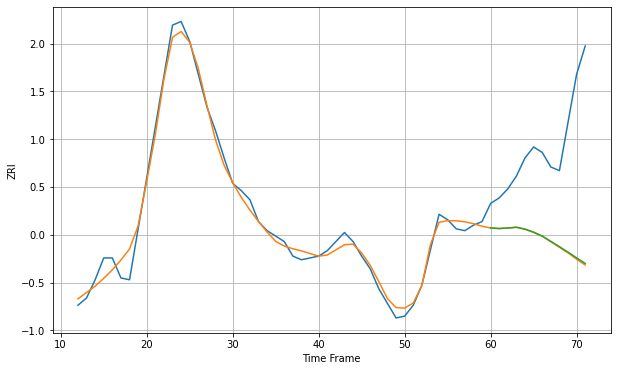

Wall time: 10.2 s
78521 4.750572824092614 58.47010650067212 58.12551396924737 [748.49094573 748.1700928  748.44906765 748.86729636 747.83351473
 746.16087393 744.03941411 741.12859953 738.19592706 735.20119637
 732.02402463 728.98740308]

Got an mse at 0.0049 in round 82 and stopped training

60 60 12


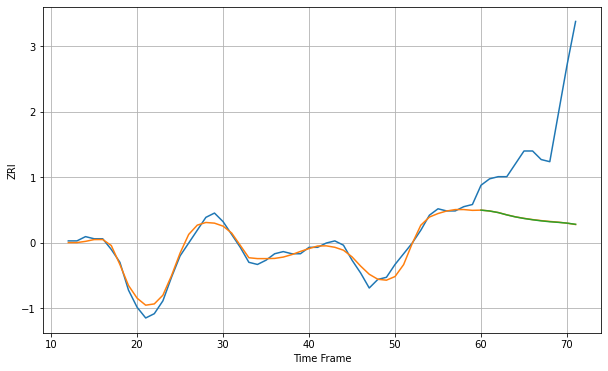

Wall time: 7.28 s
78550 2.6265262342418163 42.99699067002195 43.01145447902784 [765.37423075 764.96766414 764.23768448 763.15332088 762.21219348
 761.4817573  760.87878958 760.36739953 759.95711255 759.66217391
 759.30536013 758.74772931]

Got an mse at 0.0050 in round 238 and stopped training

60 60 12


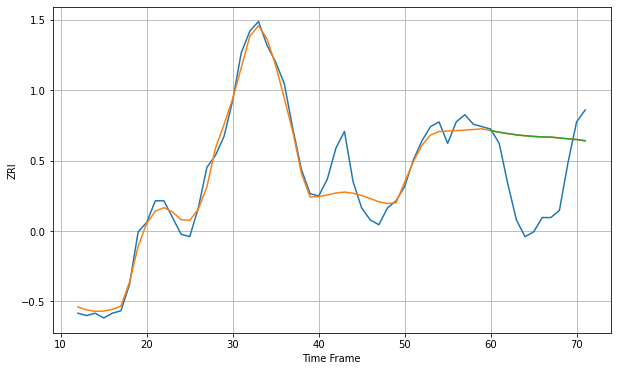

Wall time: 10.6 s
78613 6.069312431030336 26.78896137175574 26.793347820980365 [1297.35275728 1296.69211017 1296.10445095 1295.58557604 1295.21206923
 1294.92821659 1294.70919383 1294.64415383 1294.28271423 1293.93834282
 1293.62735741 1293.1195282 ]

Got an mse at 0.0050 in round 234 and stopped training

60 60 12


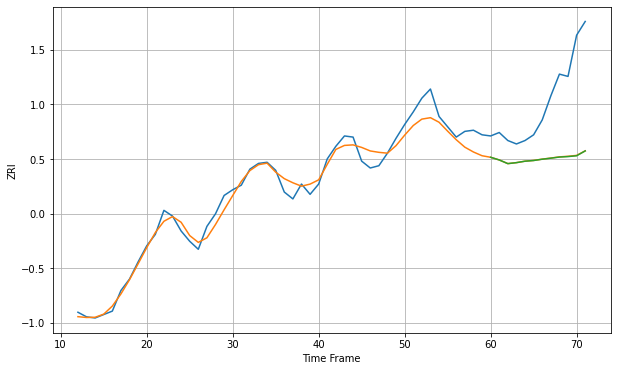

Wall time: 10.7 s
78660 9.002178441395477 58.04750166081475 58.15921228273295 [1268.37057155 1266.03718538 1262.83009325 1263.67947487 1264.94058291
 1265.54751553 1266.67876935 1267.58201462 1268.56539054 1268.97958308
 1269.67537799 1273.93788049]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


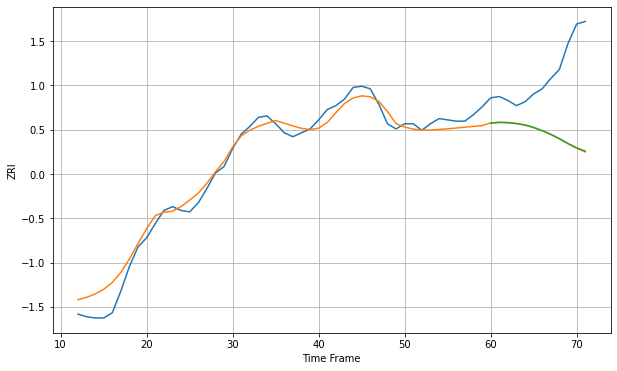

Wall time: 8.41 s
78664 8.471433321829199 52.74500532986394 52.570777710447715 [1154.56888512 1155.05296988 1154.88757554 1154.1669109  1153.03044989
 1151.12640706 1148.67499005 1145.8416873  1142.4477192  1138.73286936
 1135.4485234  1132.81734848]

Got an mse at 0.0049 in round 88 and stopped training

60 60 12


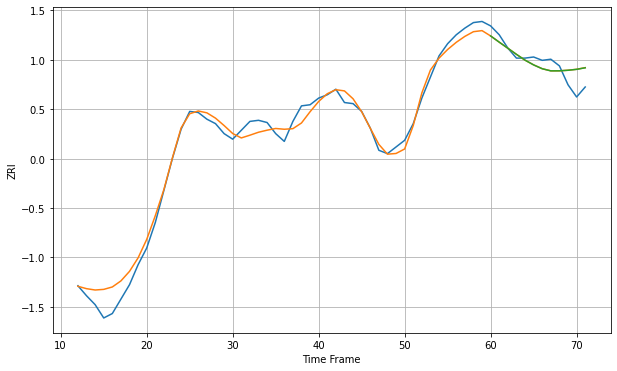

Wall time: 7.07 s
78666 8.617647109162757 11.081082795499308 11.0544545780126 [1136.95365808 1131.36561893 1125.88651334 1120.39557464 1115.1608513
 1110.88840108 1107.43969259 1105.51391872 1105.54797704 1106.04737958
 1106.87674455 1108.29268556]
60 60 12


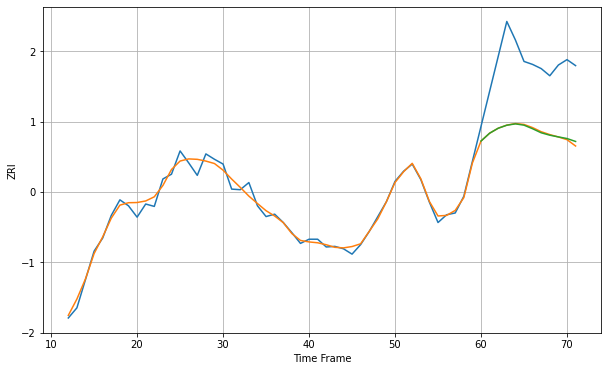

Wall time: 17 s
78701 9.34039159259934 116.82154090117052 116.46145723683269 [2199.55225664 2212.67403615 2221.03668333 2226.07520252 2228.34290787
 2226.16876751 2220.16204518 2213.40950479 2209.3707942  2206.47571074
 2203.78647736 2198.86873106]

Got an mse at 0.0049 in round 65 and stopped training

60 60 12


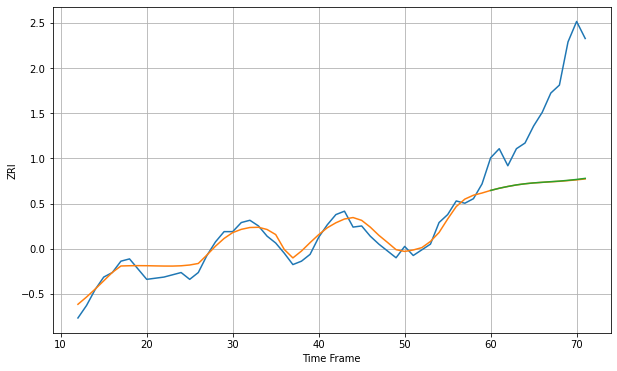

Wall time: 6.7 s
78702 6.6020083691355325 78.46966084095386 78.28513874638512 [1601.27256341 1603.18209241 1604.76263497 1606.13209466 1607.14090624
 1607.90678035 1608.43060815 1608.97598771 1609.46988037 1610.1667601
 1610.93595622 1611.89106979]

Got an mse at 0.0050 in round 90 and stopped training

60 60 12


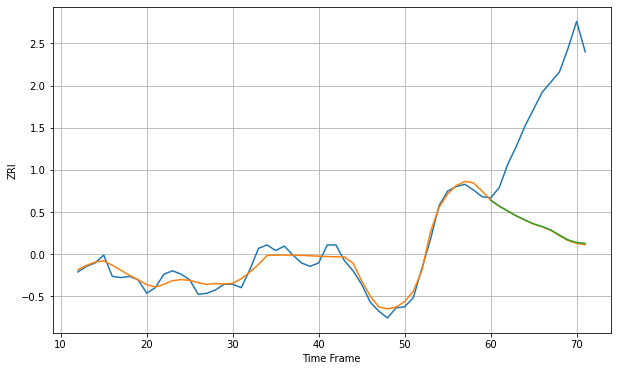

Wall time: 7.11 s
78703 6.1251731919568835 120.49641221780058 120.04486911696843 [1810.90367279 1805.57951305 1801.24049476 1796.88734644 1793.18673082
 1789.83899372 1787.4075274  1784.41145798 1779.82186228 1775.5682716
 1773.22805585 1772.32170812]

Got an mse at 0.0050 in round 221 and stopped training

60 60 12


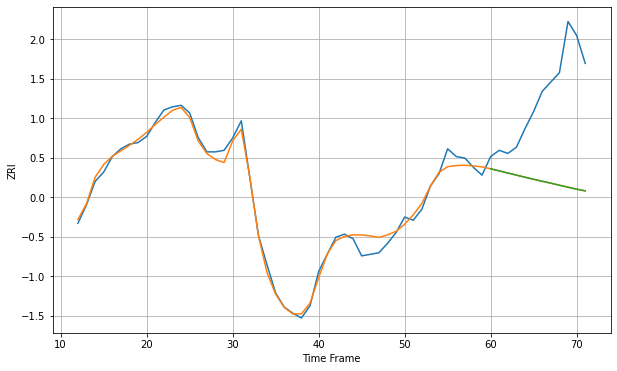

Wall time: 10.4 s
78704 4.555577900539119 60.8182207527077 60.84999089060146 [1524.112713   1522.74706908 1521.37827482 1520.01297623 1518.66913923
 1517.36970717 1516.05525179 1514.83442145 1513.49840395 1512.2215327
 1510.95751971 1509.81083357]

Got an mse at 0.0048 in round 112 and stopped training

60 60 12


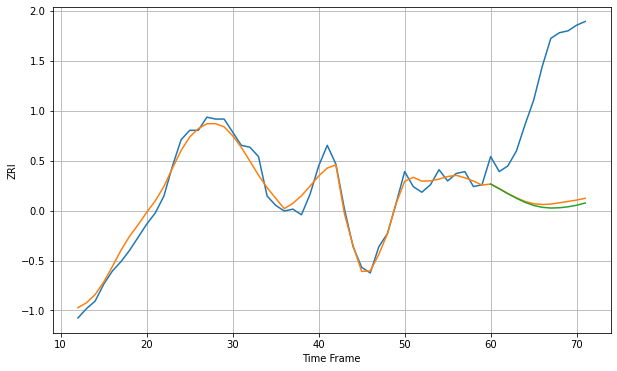

Wall time: 7.61 s
78705 4.69048483327977 66.51584436855826 68.22701102312934 [1526.35888849 1523.87267768 1521.22193491 1518.79181166 1516.60445361
 1514.97603005 1513.96496564 1513.58018259 1513.72723858 1514.24541427
 1515.07860596 1516.25980237]

Got an mse at 0.0050 in round 67 and stopped training

60 60 12


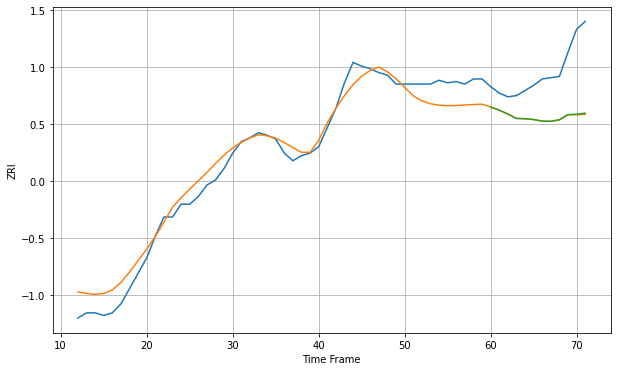

Wall time: 6.8 s
78728 11.359103231748485 38.426158120454616 38.19610439756841 [1208.10655276 1205.5558917  1202.56896465 1199.11247333 1198.90667711
 1198.23757463 1197.00801019 1196.89022622 1198.11762746 1202.14397623
 1202.36589013 1203.2902695 ]

Got an mse at 0.0049 in round 181 and stopped training

60 60 12


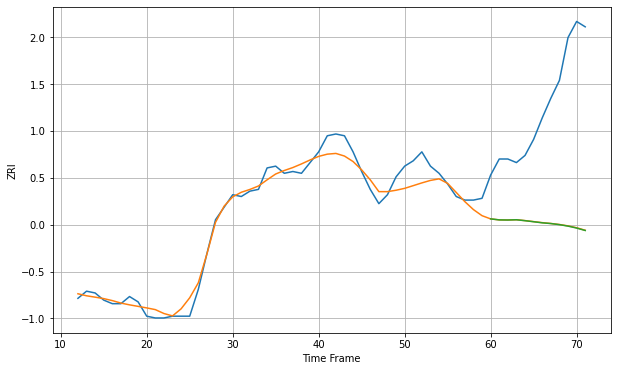

Wall time: 9.24 s
78729 5.998686011696949 70.52758774854446 70.6114078395567 [1195.47561097 1194.91198847 1194.8458742  1194.98660132 1194.46552646
 1193.87464123 1193.26914136 1192.85548327 1192.24762099 1191.42416937
 1190.33871913 1188.98143691]

Got an mse at 0.0049 in round 181 and stopped training

60 60 12


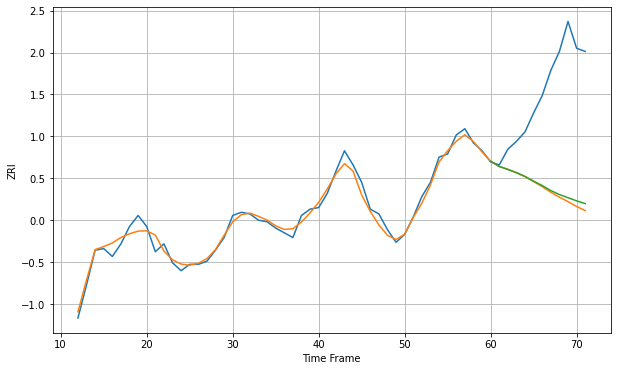

Wall time: 9.21 s
78735 4.050465517530258 67.33554964933134 65.62667220501913 [1528.39776743 1525.07105058 1523.21730388 1521.12594277 1518.74137754
 1515.76870846 1512.9253199  1509.76884666 1507.28004598 1505.2490163
 1503.25478108 1501.51843357]

Got an mse at 0.0049 in round 163 and stopped training

60 60 12


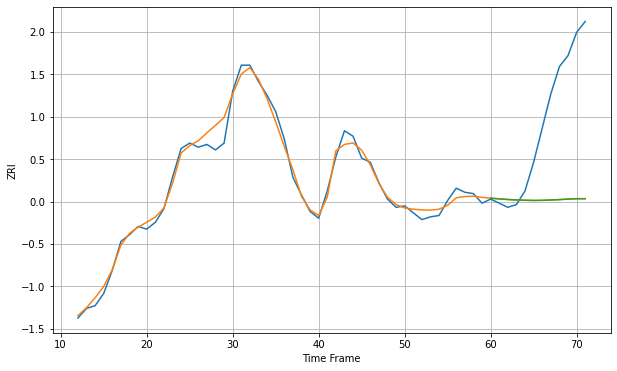

Wall time: 9.34 s
78741 5.588030370434248 71.7987115569126 71.80112398116134 [1279.69714933 1279.15386838 1278.69368501 1278.36082397 1278.14125347
 1278.01070244 1278.0824703  1278.33119563 1278.62986533 1278.99333784
 1279.28568649 1279.28568649]

Got an mse at 0.0050 in round 183 and stopped training

60 60 12


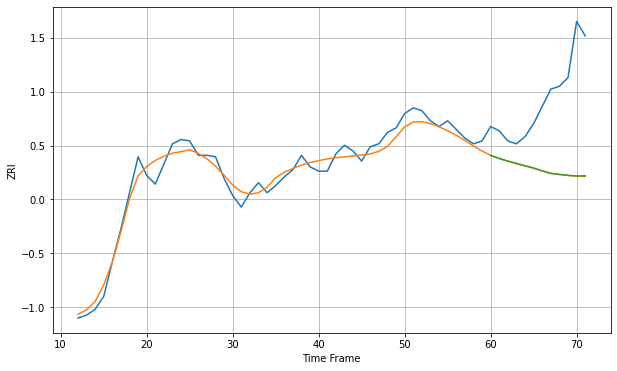

Wall time: 9.2 s
78744 6.3930872356936925 55.828914341966446 55.747582162296716 [1262.94623853 1260.80364576 1259.00202719 1257.32338416 1255.70546632
 1254.13702069 1252.17350296 1250.47123673 1249.77074083 1249.05261255
 1248.66829635 1248.76584052]

Got an mse at 0.0050 in round 120 and stopped training

60 60 12


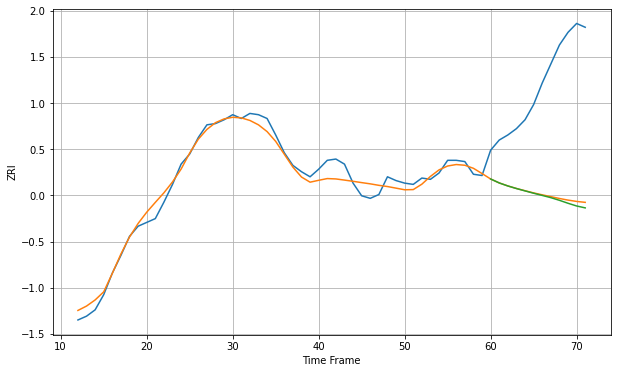

Wall time: 7.94 s
78745 6.45901562657103 92.76362360315335 94.35663510235372 [1261.26466963 1258.14344636 1255.76204199 1253.72675275 1251.86770535
 1250.02067271 1248.29143474 1246.53913593 1244.4389947  1242.10726211
 1239.9643692  1238.45729565]

Got an mse at 0.0049 in round 215 and stopped training

60 60 12


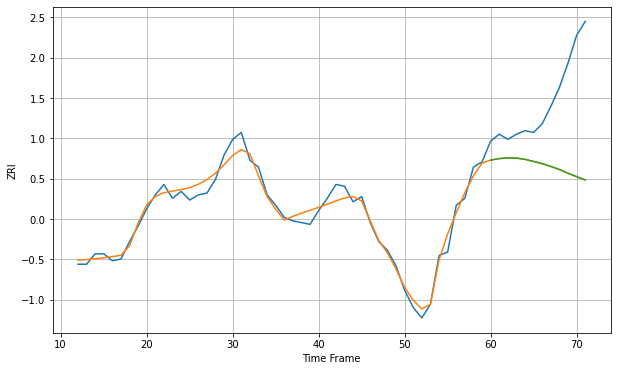

Wall time: 10 s
78746 4.578840318824237 44.89254287493254 44.876837760334595 [1544.02996574 1544.92864405 1545.31865992 1545.20467825 1544.47825154
 1543.28459183 1542.00251061 1540.4280283  1538.59618503 1536.45624395
 1534.51268403 1532.66091685]

Got an mse at 0.0049 in round 139 and stopped training

60 60 12


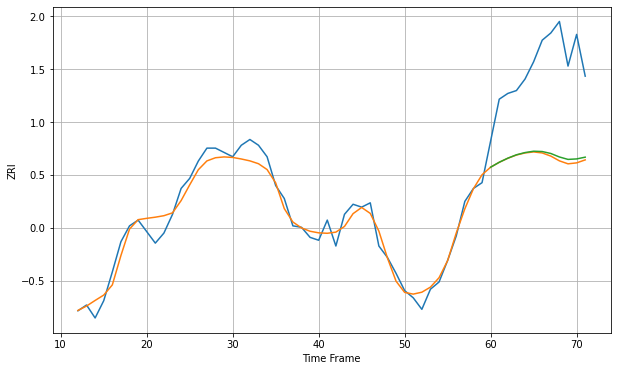

Wall time: 8.18 s
78748 7.251306965383154 65.60325711987667 64.19406377510366 [1323.75492329 1327.17838998 1330.02882738 1332.36917455 1333.91990389
 1334.85275673 1334.63190737 1333.27785715 1330.85182422 1329.16752392
 1329.49971464 1330.72480775]

Got an mse at 0.0049 in round 79 and stopped training

60 60 12


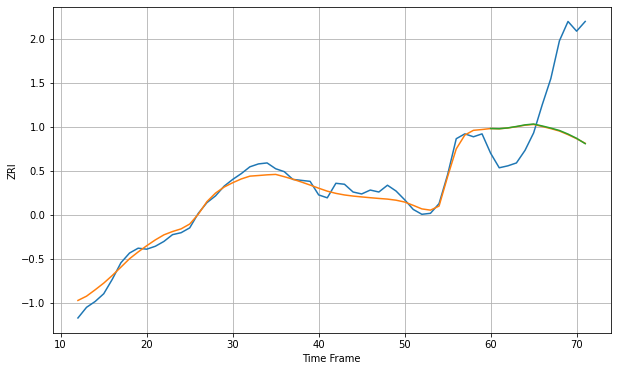

Wall time: 7.08 s
78749 7.184372402888537 70.43934872601058 70.28106183307938 [1298.50882441 1298.32011635 1299.17750205 1300.62547474 1302.29072453
 1303.16190236 1301.16197263 1298.98213417 1296.50986048 1292.80148143
 1288.40561904 1282.89027215]

Got an mse at 0.0049 in round 77 and stopped training

60 60 12


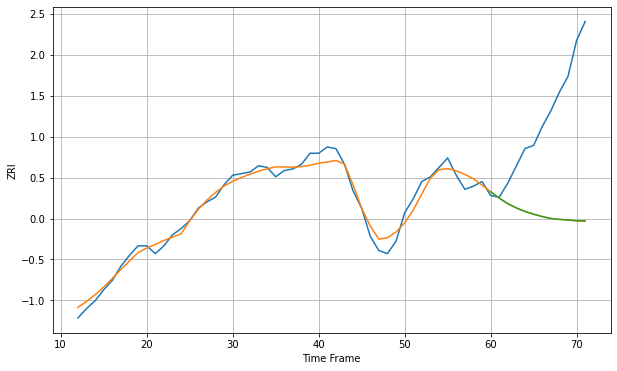

Wall time: 6.72 s
78750 4.799361393918869 68.84971136318399 68.7775969652325 [1278.44376899 1274.3851293  1270.82563452 1268.11351521 1265.89587461
 1264.1509713  1262.66731907 1261.42165055 1260.85092133 1260.49052573
 1260.00725242 1259.8862567 ]

Got an mse at 0.0050 in round 250 and stopped training

60 60 12


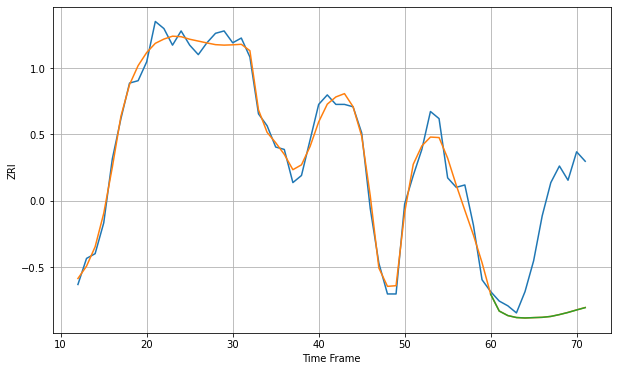

Wall time: 11 s
78751 4.68758580710806 41.9039949469891 41.91654474796231 [1362.91155937 1355.78478761 1353.87156082 1353.0514452  1352.86371081
 1353.01252039 1353.13675245 1353.51766636 1354.29014054 1355.19664022
 1356.24764153 1357.23576947]

Got an mse at 0.0050 in round 83 and stopped training

60 60 12


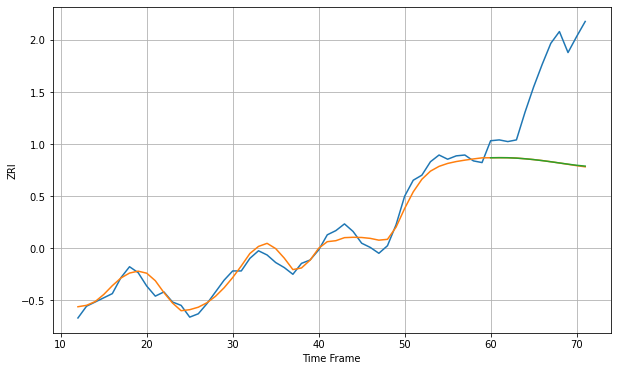

Wall time: 7.05 s
78752 9.02233052562688 108.39983628194484 108.23125388631678 [1326.73782074 1326.84309867 1326.76444317 1326.30774645 1325.53000756
 1324.53649842 1323.34142063 1321.97363048 1320.53128819 1319.11254099
 1317.77172676 1316.7763118 ]

Got an mse at 0.0049 in round 147 and stopped training

60 60 12


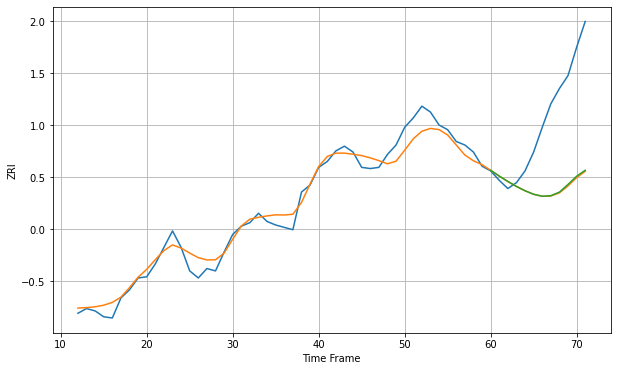

Wall time: 8.42 s
78753 8.80701293830613 68.52153460826722 67.97352706230707 [1146.50761021 1141.59499973 1137.01202109 1132.79951938 1129.12067867
 1126.13393166 1124.46690822 1124.91407611 1127.96001146 1134.50592749
 1141.48006028 1146.54999212]

Got an mse at 0.0049 in round 163 and stopped training

60 60 12


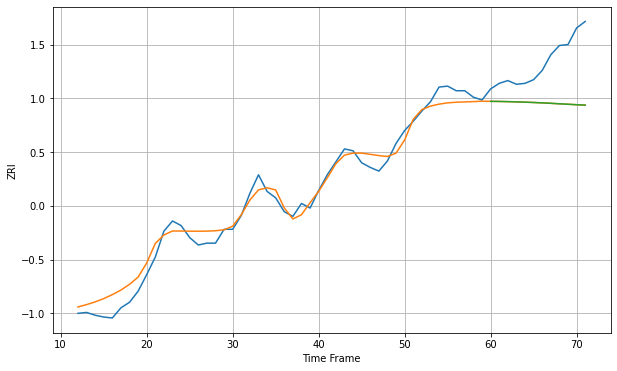

Wall time: 9.01 s
78754 11.239907928795684 49.803990390480145 49.78346141761973 [1223.53598734 1223.42654987 1223.21996018 1222.95015514 1222.65078933
 1222.29042052 1221.88942679 1221.39455885 1220.88062566 1220.37895798
 1219.88819852 1219.43375097]

Got an mse at 0.0049 in round 229 and stopped training

60 60 12


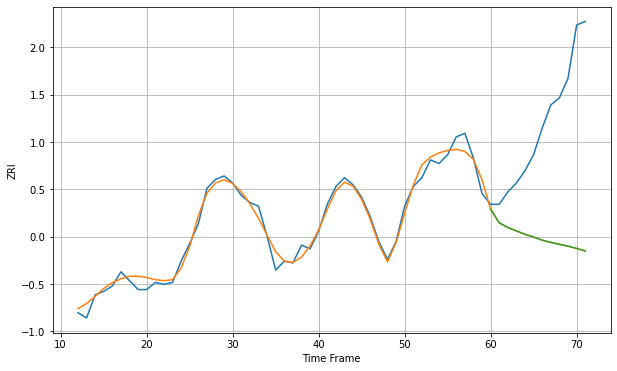

Wall time: 10.4 s
78757 4.146121643924469 72.46860512803927 72.41739141784656 [1257.23328364 1249.59771037 1246.98545364 1245.04569768 1243.14939198
 1241.59704998 1239.82601015 1238.57504305 1237.48574308 1236.44590549
 1235.18899207 1233.82260952]

Got an mse at 0.0049 in round 112 and stopped training

60 60 12


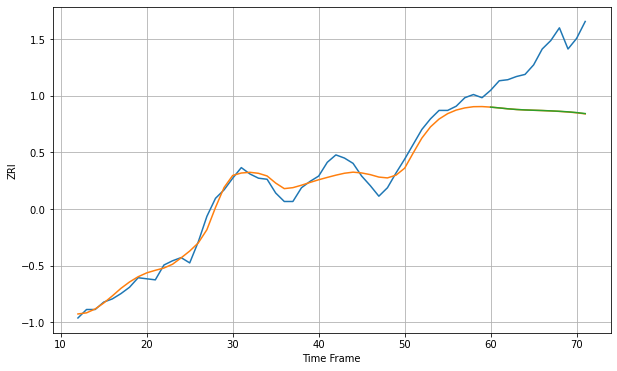

Wall time: 7.8 s
78758 8.028671753430928 54.55427079335069 54.45620158219734 [1317.12790105 1316.36264952 1315.53399631 1314.88769574 1314.46499457
 1314.16300598 1313.90900114 1313.57404042 1313.17132001 1312.65866239
 1311.95779381 1311.01530075]

Got an mse at 0.0050 in round 88 and stopped training

60 60 12


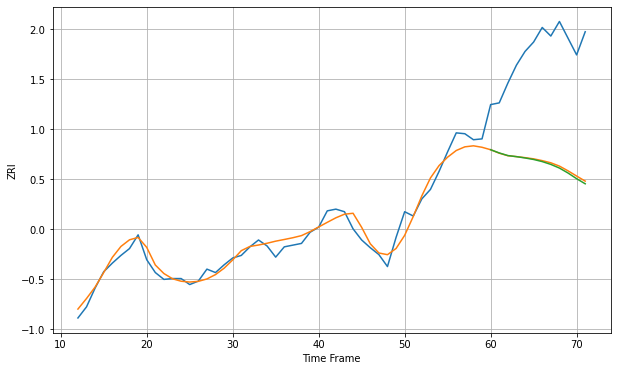

Wall time: 7.35 s
78759 9.895394064616973 131.51088258627408 132.99212149369365 [1475.33682599 1471.58078511 1468.5239234  1467.24777142 1465.73039838
 1463.94718098 1461.49411339 1458.20544523 1453.9341983  1448.16301239
 1441.54012681 1435.57849411]

Got an mse at 0.0050 in round 225 and stopped training

60 60 12


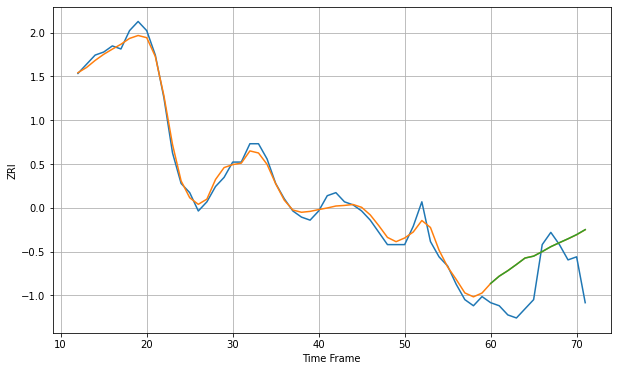

Wall time: 10.6 s
79912 2.2591103161306414 12.331608854200699 12.335946417057812 [974.28675723 976.67572166 978.47074516 980.4955524  982.60695547
 983.22365781 984.71609378 986.32304793 987.63748843 988.9131345
 990.27462157 991.89886407]

Got an mse at 0.0050 in round 248 and stopped training

60 60 12


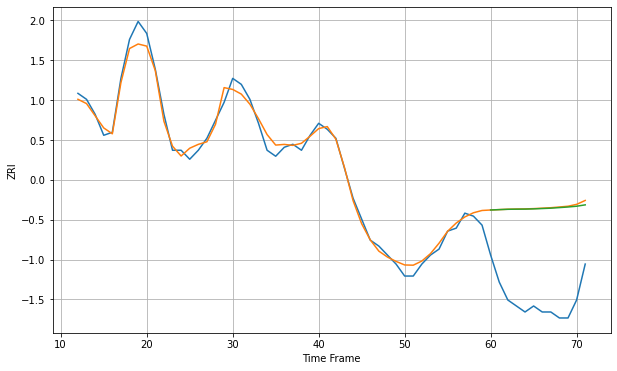

Wall time: 10.9 s
79936 2.5160419426261913 31.18301181767841 30.959507918272035 [913.05360124 913.17628782 913.28487923 913.32816838 913.35000014
 913.42644209 913.54158306 913.66091416 913.85552829 914.05426107
 914.31227175 914.76871785]

Got an mse at 0.0050 in round 37 and stopped training

60 60 12


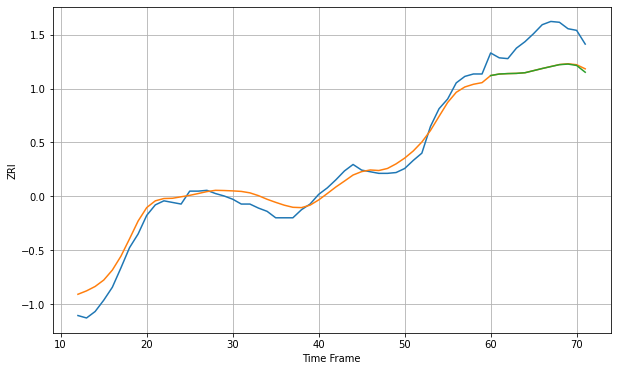

Wall time: 6.41 s
80021 13.26516603976935 40.30666169690877 40.73379815917529 [1589.03727898 1590.94656405 1591.48457721 1591.74025052 1592.55952273
 1595.15342547 1597.76782827 1600.16950708 1602.51968437 1603.26355815
 1601.53510051 1593.17396907]

Got an mse at 0.0050 in round 74 and stopped training

60 60 12


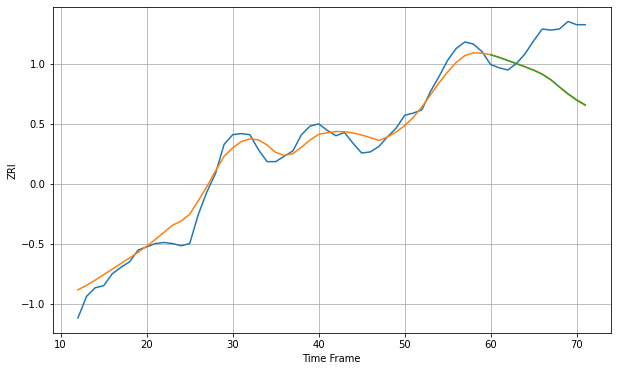

Wall time: 6.92 s
80027 10.468702602103082 43.7634229969899 43.53664877831407 [1623.17675784 1620.6373504  1617.77567305 1614.84218609 1611.90618432
 1608.8213629  1605.13065898 1599.98181058 1593.33539981 1586.97855607
 1581.35661256 1576.74685293]

Got an mse at 0.0049 in round 69 and stopped training

60 60 12


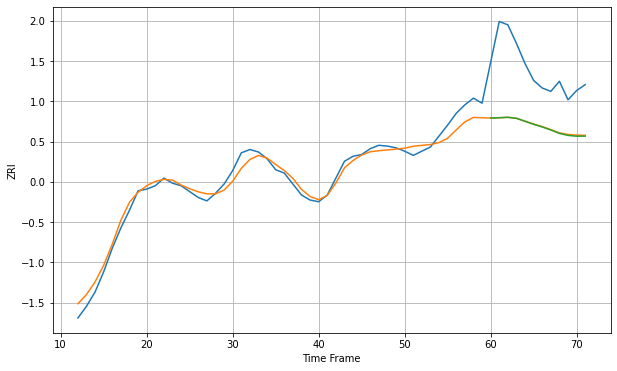

Wall time: 7.03 s
80033 9.407743768041998 71.15649801259455 71.49523370036928 [1264.34456337 1264.73125959 1265.23999652 1264.04806578 1260.47400125
 1256.89724359 1253.73056308 1250.17820193 1246.10030592 1243.70506013
 1242.79524982 1242.88017671]

Got an mse at 0.0049 in round 64 and stopped training

60 60 12


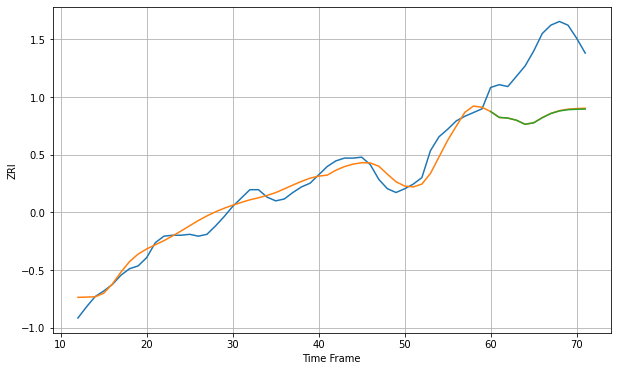

Wall time: 6.46 s
80111 10.109342036588258 70.08348801861139 70.36403259403072 [1593.08508754 1586.78113386 1586.05498422 1583.74781074 1579.39380849
 1580.93676378 1586.40952427 1590.92583452 1593.70875091 1595.10401959
 1595.55140475 1595.71982213]

Got an mse at 0.0050 in round 53 and stopped training

60 60 12


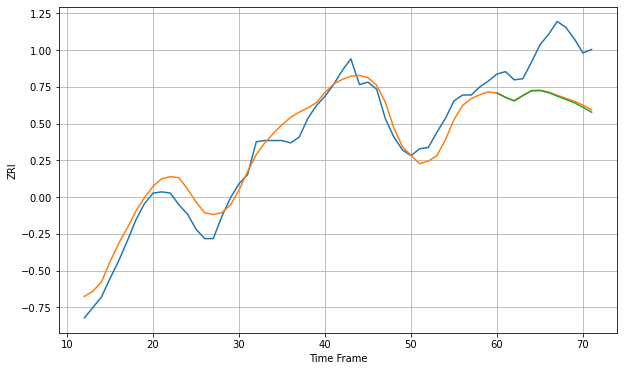

Wall time: 7.11 s
80112 12.721240963687842 41.84413859249657 42.6853389818729 [1768.72155816 1764.95317379 1761.94641935 1766.41237997 1770.56893209
 1770.79123812 1769.02159134 1766.09781503 1763.21140163 1760.3191059
 1756.50657701 1752.24431931]

Got an mse at 0.0050 in round 103 and stopped training

60 60 12


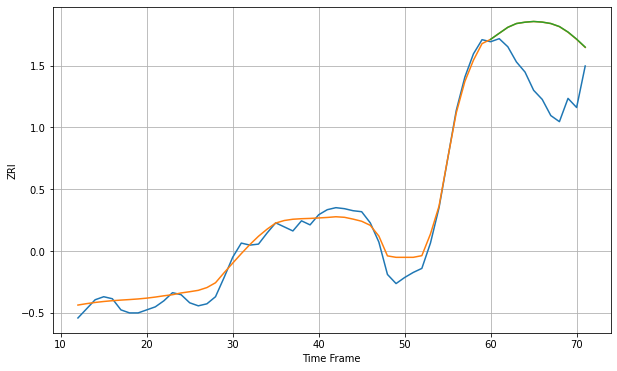

Wall time: 8.07 s
80120 9.757922156036594 58.42088313207828 58.49387689169344 [1671.35123263 1677.34745627 1683.24258221 1686.97056198 1688.30803653
 1689.00711716 1688.40134309 1686.99251167 1683.97402251 1678.54776595
 1671.56116063 1663.62926905]

Got an mse at 0.0050 in round 164 and stopped training

60 60 12


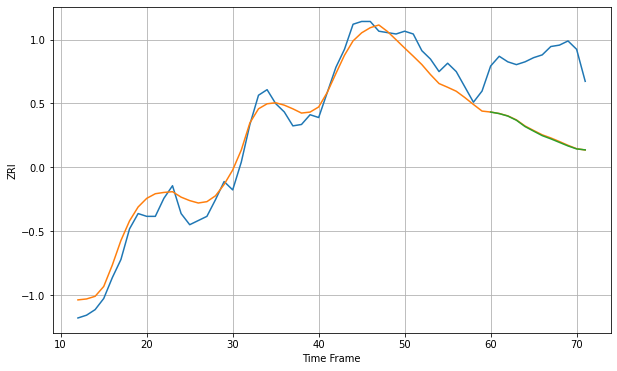

Wall time: 9.32 s
80124 9.716919726013968 54.98612925327686 55.326271444123485 [1587.93067726 1586.81968664 1585.0435782  1582.03480566 1577.51152944
 1574.22104847 1570.98184232 1568.67459733 1566.12422196 1563.5871397
 1561.44675161 1560.74367674]

Got an mse at 0.0050 in round 226 and stopped training

60 60 12


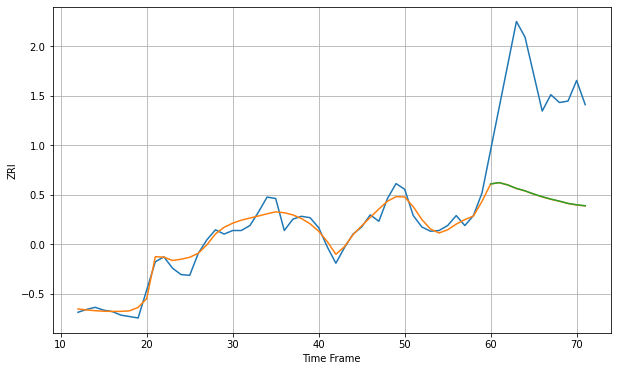

Wall time: 11.1 s
80129 10.955340967119634 158.09990184747215 157.95558288056586 [1894.50616231 1896.32524552 1893.07059853 1888.17083135 1884.8085961
 1880.38821263 1876.5404203  1873.2000582  1870.36712147 1867.16339234
 1865.18973779 1863.82004361]

Got an mse at 0.0050 in round 345 and stopped training

60 60 12


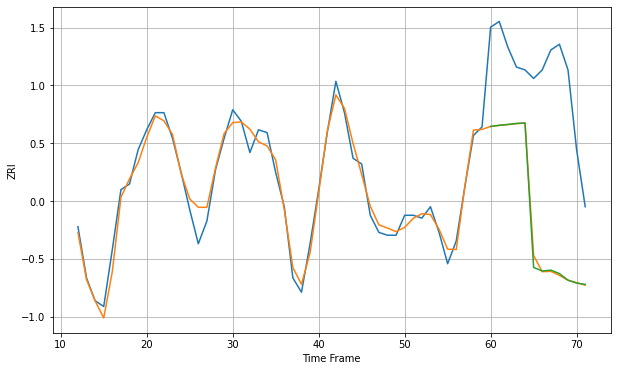

Wall time: 13.9 s
80202 3.750475204764481 53.13373831290508 53.38494703374926 [2000.16604954 2000.56390436 2000.85734596 2001.2147923  2001.39004142
 1950.68912361 1949.45300807 1949.7640646  1948.54459047 1946.24548593
 1945.21336158 1944.74677855]

Got an mse at 0.0050 in round 49 and stopped training

60 60 12


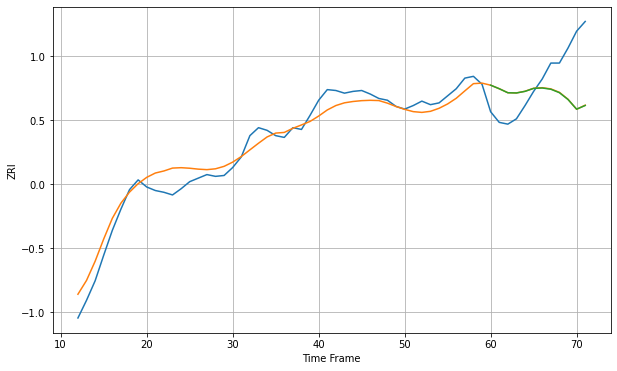

Wall time: 6.19 s
80203 13.356678329018314 47.30352153176863 47.41368589893874 [1596.00775795 1592.00436599 1587.45579734 1587.20521622 1589.04225349
 1592.390921   1592.83521205 1591.44334604 1587.53721633 1579.82906422
 1568.91091385 1573.06443224]

Got an mse at 0.0050 in round 165 and stopped training

60 60 12


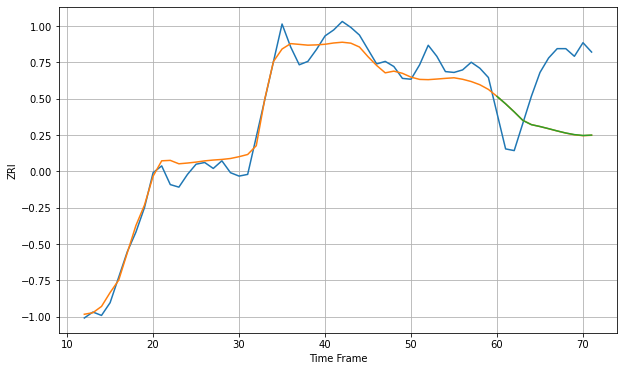

Wall time: 8.93 s
80204 15.373486632178018 74.59693638000817 74.49557600497269 [1823.81384146 1815.05256414 1805.57787837 1795.57256973 1790.54764222
 1788.33737064 1785.81277766 1783.16885361 1780.73550635 1778.82140019
 1777.80977499 1778.24210355]

Got an mse at 0.0050 in round 74 and stopped training

60 60 12


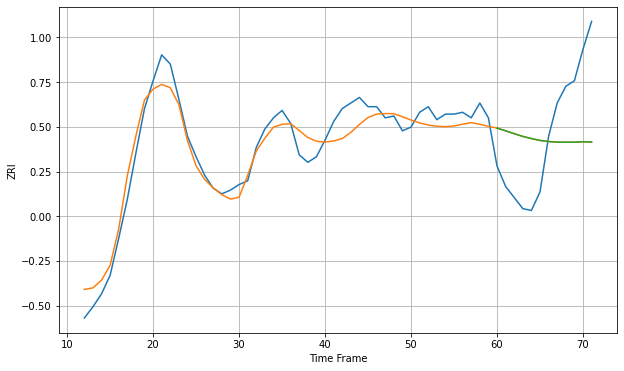

Wall time: 6.72 s
80205 8.17239898798074 35.94248655808929 35.92377590237433 [1665.47354422 1663.988154   1662.47383351 1660.9674871  1659.82864634
 1658.80928785 1658.21786685 1657.90101161 1657.8434011  1657.86356373
 1658.08663533 1657.97592155]

Got an mse at 0.0050 in round 204 and stopped training

60 60 12


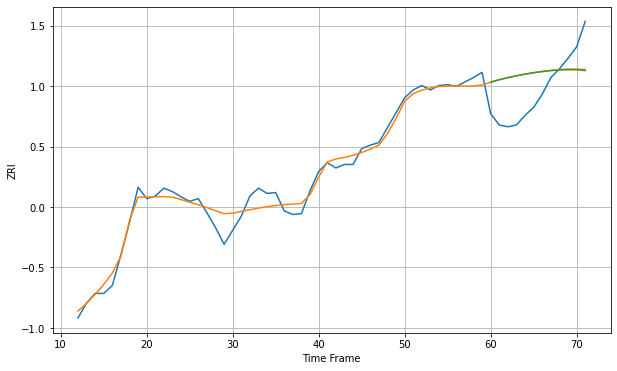

Wall time: 10.4 s
80210 10.337548846351671 39.30097471555667 39.46859394738494 [1635.75523094 1638.57666861 1640.96976031 1643.06795247 1644.89507688
 1646.58332451 1647.85969376 1648.9069201  1649.68121464 1649.96954945
 1649.84030624 1649.09536804]

Got an mse at 0.0049 in round 111 and stopped training

60 60 12


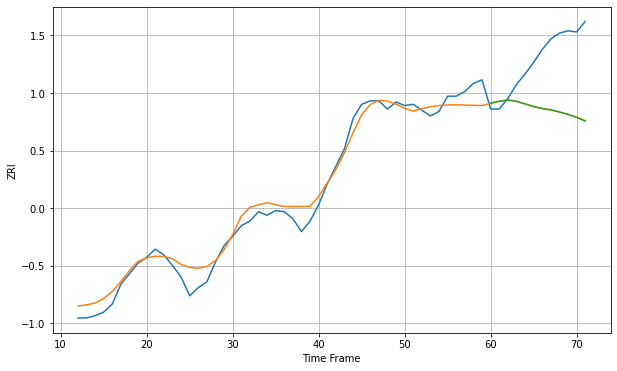

Wall time: 7.71 s
80211 9.766117717339718 50.66831527361053 50.81784759564167 [1698.93641976 1700.62899004 1701.6855977  1700.57741409 1698.39486255
 1696.08130243 1694.39517586 1693.22395514 1691.39009589 1689.29404207
 1686.79721502 1683.60752133]

Got an mse at 0.0050 in round 84 and stopped training

60 60 12


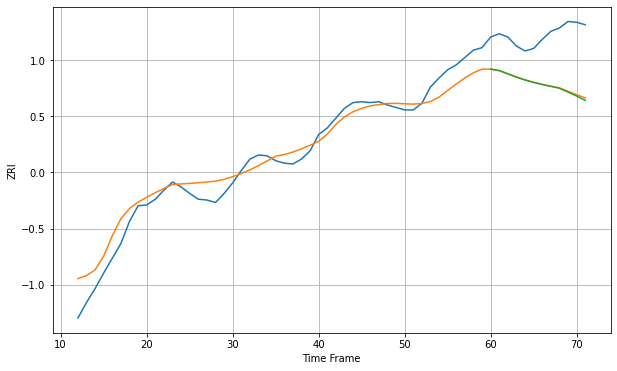

Wall time: 7.2 s
80214 17.225731192248094 61.81823395462331 62.57370014224474 [1282.82854492 1281.01496059 1277.0807341  1273.1229974  1269.57894659
 1266.64968556 1264.06885    1261.84165064 1259.49156948 1254.78277218
 1249.98892912 1244.56578726]

Got an mse at 0.0049 in round 85 and stopped training

60 60 12


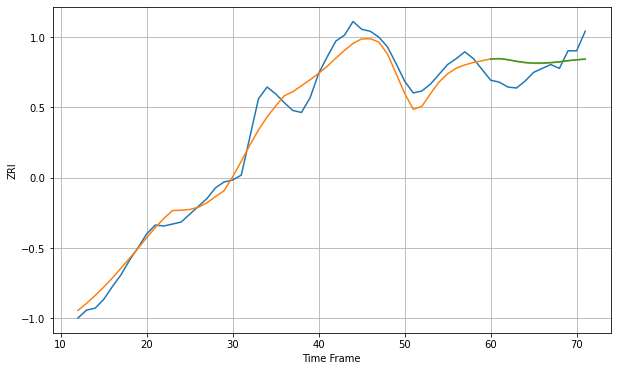

Wall time: 7.01 s
80218 12.791251499617964 18.443204837350677 18.496449418710345 [1448.67913474 1449.01595396 1447.99256956 1446.33799726 1445.12732337
 1444.48830228 1444.51047731 1445.03127527 1445.81917042 1447.00270117
 1447.89465083 1448.57475682]

Got an mse at 0.0050 in round 52 and stopped training

60 60 12


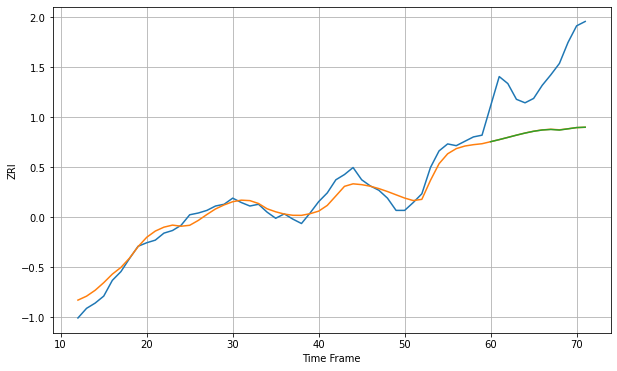

Wall time: 6.45 s
80226 9.657374451444978 73.64337786060617 73.6882991515923 [1445.55187513 1447.91463539 1450.43069833 1453.00187003 1455.39847888
 1457.4476603  1458.91925671 1459.53419007 1458.85285308 1460.25698397
 1461.67926533 1462.09853949]

Got an mse at 0.0050 in round 78 and stopped training

60 60 12


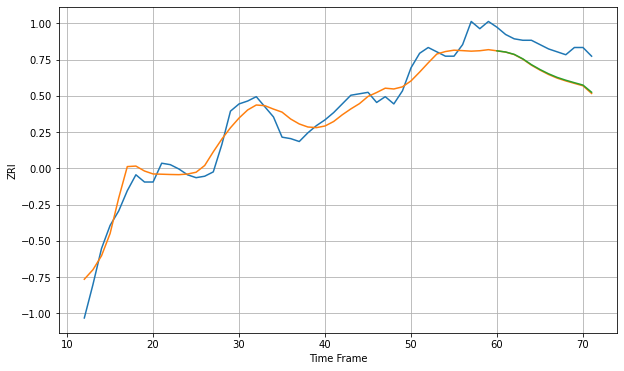

Wall time: 6.75 s
80229 9.824267001272101 18.84350211341801 18.4376174299156 [1392.69067598 1391.89294137 1390.25412508 1387.17330079 1383.15053128
 1379.78467678 1376.81583734 1374.32934711 1372.37867755 1370.66885321
 1369.02292536 1364.0674431 ]

Got an mse at 0.0049 in round 91 and stopped training

60 60 12


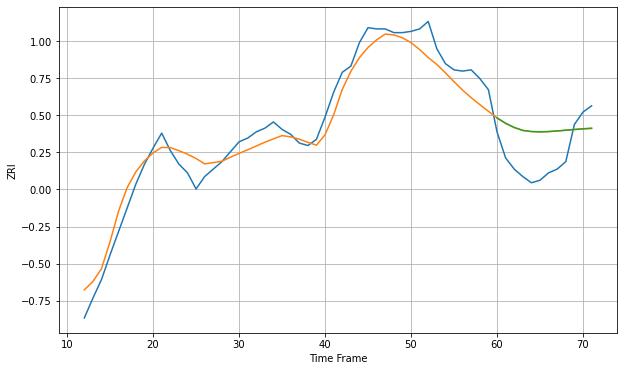

Wall time: 7.45 s
80231 12.683921447043158 28.668133166007305 28.66342134106732 [1335.2735987  1330.90299163 1327.54911881 1325.18409313 1324.26481728
 1324.0257416  1324.2665216  1324.76614989 1325.37260835 1325.97139917
 1326.50726007 1326.99540197]

Got an mse at 0.0050 in round 93 and stopped training

60 60 12


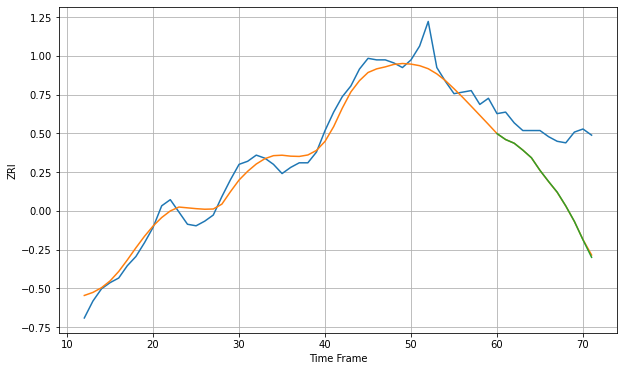

Wall time: 7.35 s
80233 8.311889907997154 40.945683875273325 41.18418336733035 [1407.99976862 1404.13820664 1401.73651439 1397.28076308 1392.30477949
 1384.06938915 1376.81669365 1369.89775634 1360.89412257 1350.86169555
 1338.86445144 1327.49112932]

Got an mse at 0.0049 in round 92 and stopped training

60 60 12


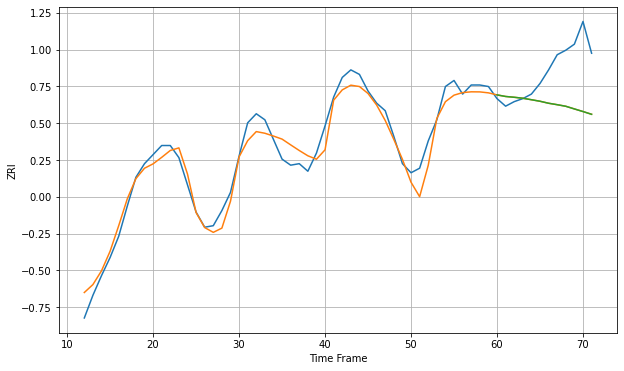

Wall time: 6.99 s
80237 8.170327016800094 29.101274448251164 29.10638172638593 [1450.46599614 1449.41772502 1448.89224579 1448.2516824  1447.26790361
 1446.25707871 1444.9388922  1443.98636836 1442.93796054 1441.17741284
 1439.45806643 1437.63351592]

Got an mse at 0.0049 in round 79 and stopped training

60 60 12


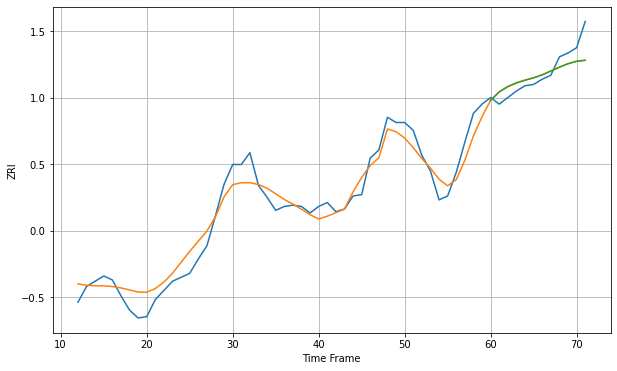

Wall time: 6.84 s
80301 10.489969210856042 10.68996178382041 10.718707413569648 [1760.92781172 1767.33236908 1771.37696248 1774.17972815 1776.26692449
 1778.03078843 1780.28324553 1783.19385557 1786.12969454 1788.75586458
 1790.62337162 1791.38816349]

Got an mse at 0.0050 in round 149 and stopped training

60 60 12


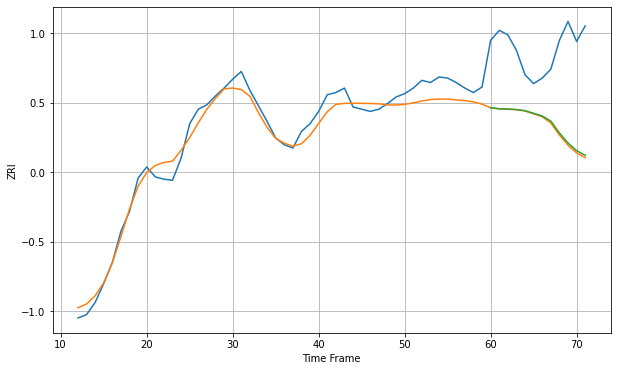

Wall time: 8.62 s
80401 10.302975209759444 73.73182714966923 72.61872347888324 [1536.34166183 1535.3671023  1535.08866638 1534.67750996 1533.67640875
 1531.27783528 1528.84144379 1524.33689166 1513.55753916 1504.54829164
 1497.6487981  1493.4904625 ]

Got an mse at 0.0049 in round 45 and stopped training

60 60 12


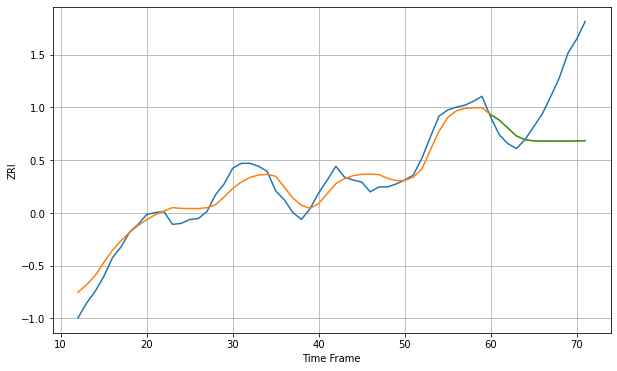

Wall time: 6.27 s
80503 11.733701659295985 58.5377446628268 58.563916822352795 [1397.48686918 1391.93716913 1383.88283229 1375.82323192 1371.92685375
 1370.77122099 1370.58017327 1370.49584391 1370.48552273 1370.53693563
 1370.6946871  1370.97066015]

Got an mse at 0.0050 in round 87 and stopped training

60 60 12


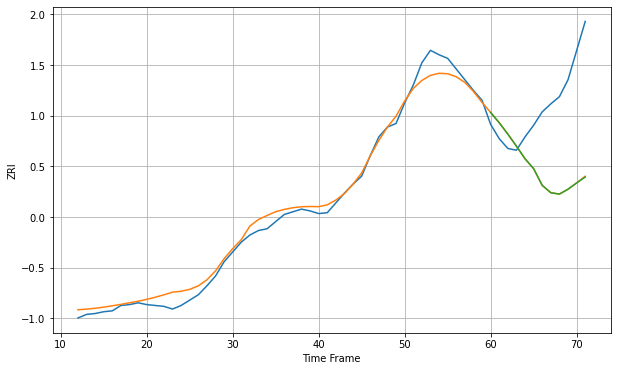

Wall time: 7.24 s
80904 9.59826947868079 91.06387436693461 91.20938049575413 [988.3616256  976.81385066 964.1064545  950.60947312 936.45520011
 925.33850402 906.67170198 898.33347145 896.85428661 902.37350008
 909.33967935 915.91834747]

Got an mse at 0.0050 in round 167 and stopped training

60 60 12


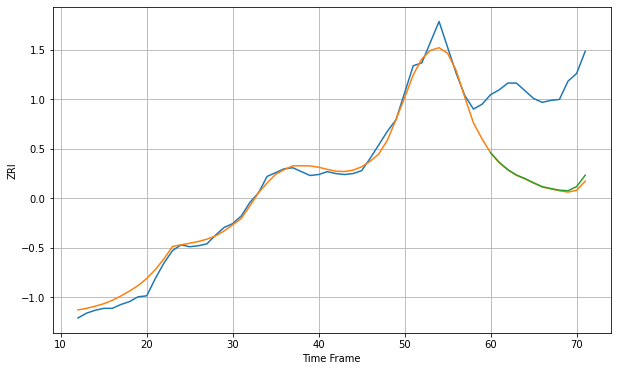

Wall time: 9.09 s
80915 9.197176284741984 97.54249290009447 96.08557405379032 [887.553613   877.62190864 870.13554432 864.53095996 860.77023743
 856.44906959 852.39471482 850.45689797 848.72397581 848.19441366
 852.47691838 864.2776061 ]

Got an mse at 0.0049 in round 65 and stopped training

60 60 12


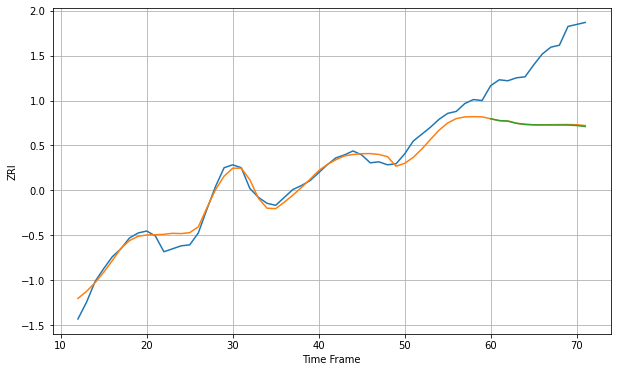

Wall time: 7.17 s
84047 8.892681491828485 71.48035917488171 71.83956175967225 [1085.56397747 1083.71401748 1083.23323241 1080.98820595 1079.88365066
 1079.41988129 1079.3235548  1079.32060997 1079.27186397 1079.19771324
 1078.74471818 1077.72515494]

Got an mse at 0.0049 in round 151 and stopped training

60 60 12


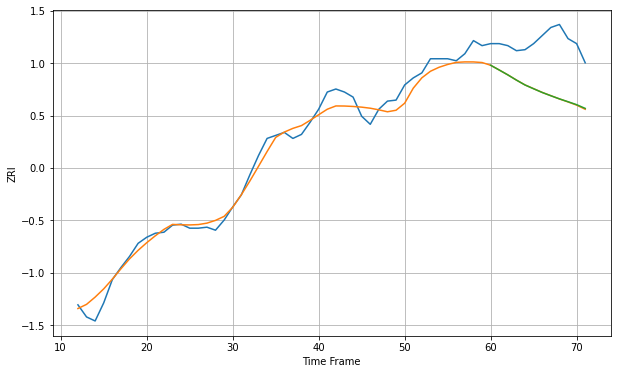

Wall time: 8.72 s
84095 9.802163652856901 49.191398472807855 49.07542114437698 [1315.55659796 1310.83379942 1306.00576414 1300.83081765 1295.99321536
 1292.25213834 1288.56188493 1285.3420417  1282.21037008 1279.38035637
 1276.47710691 1272.77930803]

Got an mse at 0.0049 in round 53 and stopped training

60 60 12


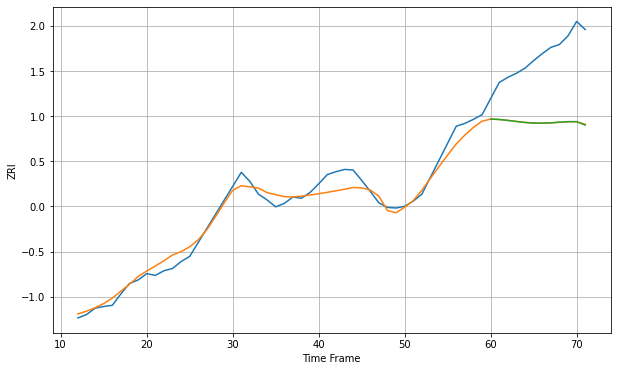

Wall time: 7.04 s
84102 15.003350556230291 118.47566167644317 118.55501068453113 [1083.4679379  1082.73924974 1081.17189918 1079.30010151 1077.58061688
 1076.5026744  1076.30824123 1076.94248074 1078.08629857 1079.03294737
 1079.0504004  1072.90971975]

Got an mse at 0.0050 in round 71 and stopped training

60 60 12


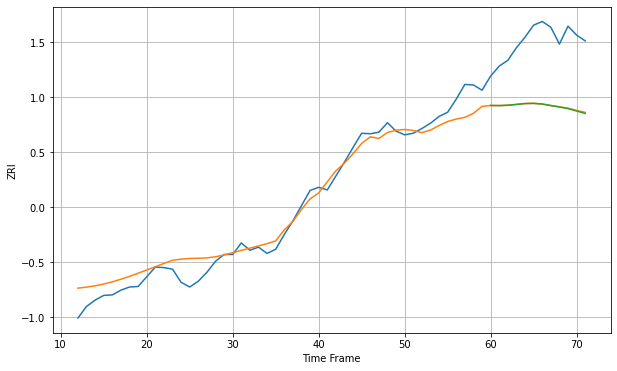

Wall time: 6.56 s
84103 24.588402892282474 126.08609318700313 126.5694654561423 [1338.93732334 1338.71875984 1339.30999249 1340.96666447 1342.61694233
 1342.92229176 1341.61401517 1338.68085323 1335.95676282 1332.94024377
 1328.33236699 1323.64024723]

Got an mse at 0.0049 in round 114 and stopped training

60 60 12


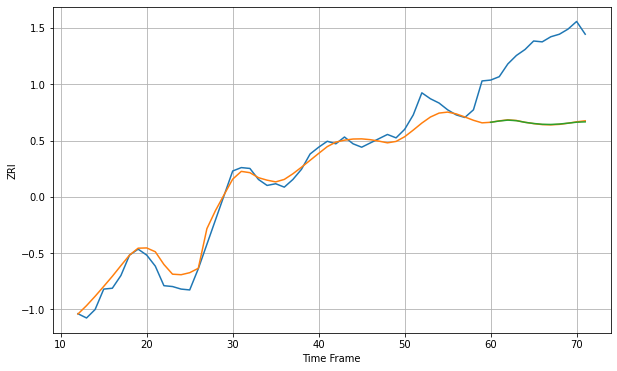

Wall time: 7.67 s
84106 13.503149091493553 91.41156511387997 91.48276346367088 [1213.32797301 1214.81744481 1215.88262519 1215.22113552 1213.27964132
 1211.92478668 1210.9707826  1210.77538781 1211.27615759 1212.30807648
 1213.4340821  1213.83680249]

Got an mse at 0.0050 in round 101 and stopped training

60 60 12


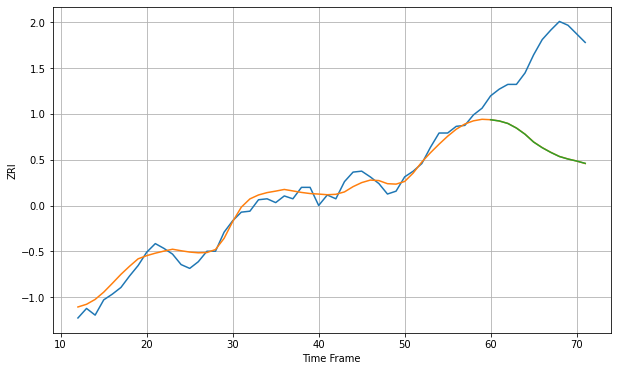

Wall time: 7.61 s
84119 8.644466561291253 100.37781512153877 100.4077348496921 [1009.94718324 1008.64132038 1006.03475759 1001.18509382  994.72202123
  986.50808626  980.58625216  975.64954188  971.35723711  968.70347117
  966.615892    964.16585205]

Got an mse at 0.0050 in round 146 and stopped training

60 60 12


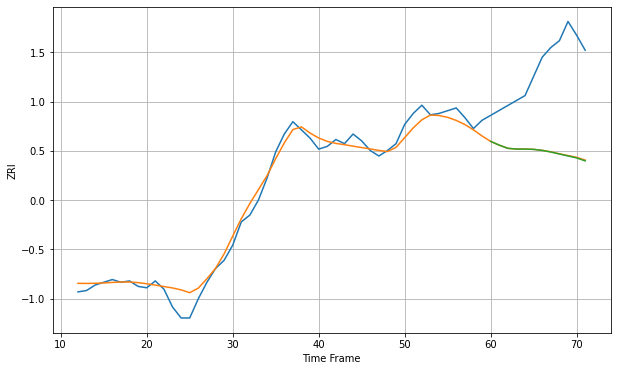

Wall time: 8.38 s
84403 6.8238188857740845 63.63517282872089 63.821502955181536 [869.62450958 866.91214522 864.59357937 864.05218107 864.02933427
 863.80712959 863.06052568 861.91061144 860.42326882 859.03456319
 857.60306912 855.41562817]

Got an mse at 0.0050 in round 131 and stopped training

60 60 12


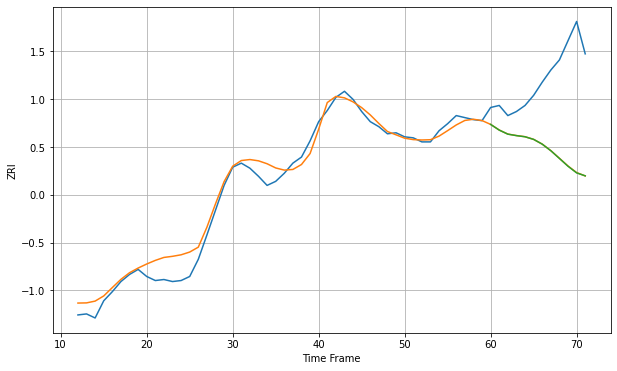

Wall time: 8.22 s
85008 10.556491162827001 79.75389246558176 79.85236788104925 [1037.27303675 1031.65749324 1027.64355541 1026.18975146 1025.05007024
 1022.47774756 1017.76312651 1011.29743905 1003.65091579  995.94044961
  989.38302519  986.44636443]

Got an mse at 0.0050 in round 96 and stopped training

60 60 12


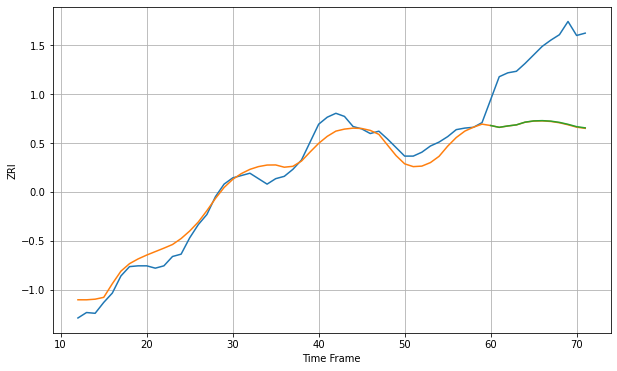

Wall time: 7.32 s
85014 13.516632832246293 94.44526202606187 94.0880322526736 [1161.29768827 1158.97313308 1160.76085327 1162.16017725 1165.6258608
 1167.21753253 1167.56917533 1166.93284398 1165.34155791 1162.84901501
 1159.84019677 1158.28009744]

Got an mse at 0.0050 in round 69 and stopped training

60 60 12


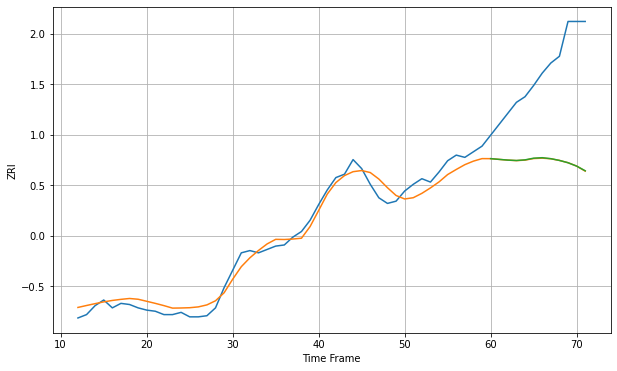

Wall time: 6.61 s
85015 7.969893543600993 84.17097325402224 84.05520920415012 [925.85191101 925.19496395 924.57234093 924.20943914 924.77070583
 926.26959625 926.70313316 925.83000729 924.29203788 922.22685074
 919.2219478  915.05425574]

Got an mse at 0.0050 in round 101 and stopped training

60 60 12


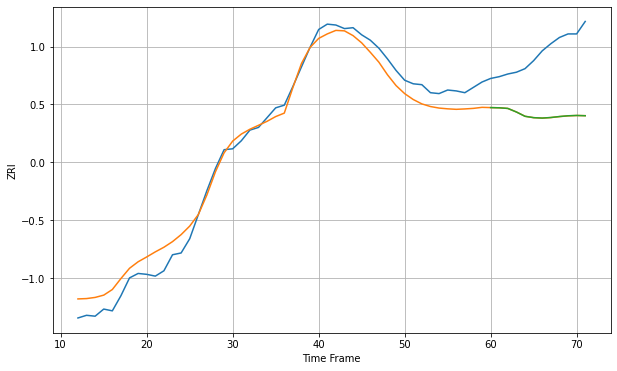

Wall time: 7.64 s
85016 15.371341496111048 71.4644760351604 71.43012129589927 [1285.27030795 1285.04777916 1284.32534263 1280.30329465 1275.49193848
 1273.9780149  1273.50478235 1274.14539742 1275.24266472 1276.08831094
 1276.44757579 1276.13724992]

Got an mse at 0.0049 in round 65 and stopped training

60 60 12


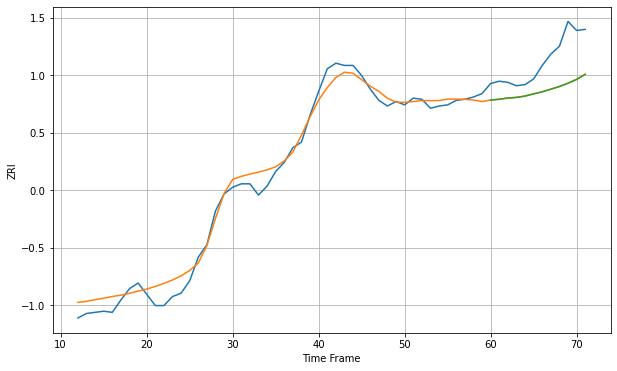

Wall time: 6.55 s
85018 9.010197987346162 29.267749036371203 29.348349241441728 [1200.33021072 1200.96781229 1202.07738333 1202.62127682 1203.78334138
 1205.76415801 1207.56414501 1209.89713819 1212.26175244 1215.17719022
 1218.56142774 1223.04691477]

Got an mse at 0.0050 in round 130 and stopped training

60 60 12


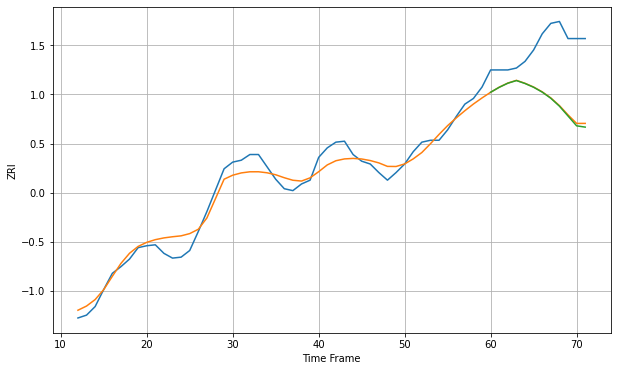

Wall time: 8.55 s
85020 10.841322779046564 60.13165997626125 61.2381730827259 [1094.50568983 1099.72650059 1104.01882038 1106.82414951 1103.72638846
 1099.76228565 1094.65707356 1088.1791633  1079.87494644 1069.53484705
 1059.18895514 1057.83169058]

Got an mse at 0.0050 in round 92 and stopped training

60 60 12


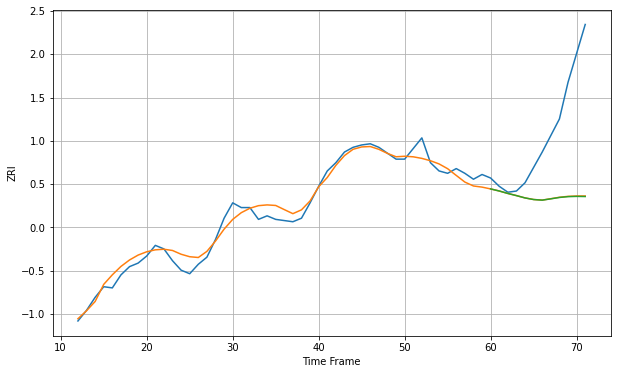

Wall time: 7.08 s
85027 7.035925193720174 67.63027376861605 67.81917580238485 [1014.78380321 1013.02784102 1010.95442688 1009.1252532  1007.15717547
 1005.79147657 1005.27786993 1006.39618908 1007.55972459 1008.25505486
 1008.46186464 1008.34480122]

Got an mse at 0.0050 in round 130 and stopped training

60 60 12


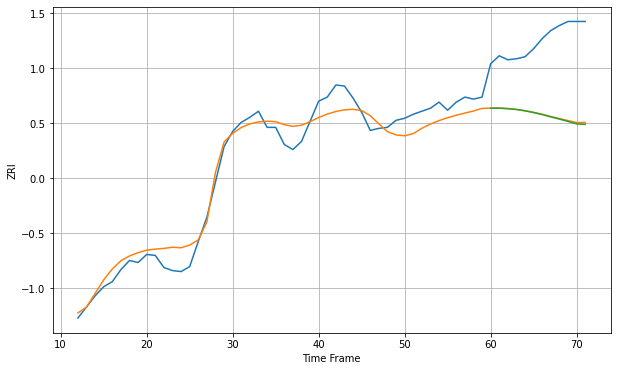

Wall time: 8.33 s
85032 13.394232218552839 74.9955199238626 75.58395215372802 [1149.0352856  1149.05254979 1148.57634459 1147.7243723  1146.40945239
 1144.67655865 1142.7111851  1140.37745019 1138.18481797 1135.90537366
 1133.42676766 1132.92979464]

Got an mse at 0.0050 in round 68 and stopped training

60 60 12


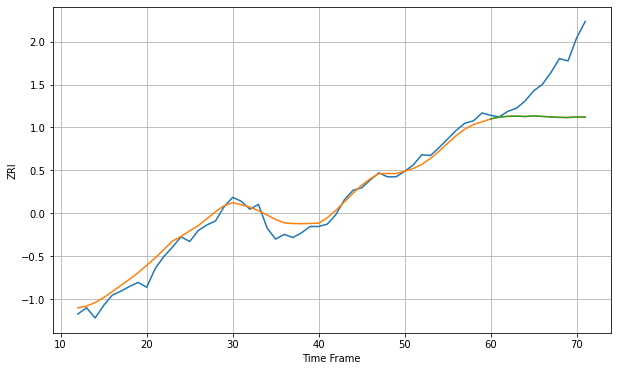

Wall time: 6.52 s
85044 9.926940551777971 59.00954872822809 58.972654509595166 [1345.41130323 1347.76639415 1348.67382227 1348.99299131 1348.50474186
 1349.18643862 1348.62259448 1347.95985121 1347.40739136 1347.22343363
 1347.94763386 1347.82819364]

Got an mse at 0.0049 in round 59 and stopped training

60 60 12


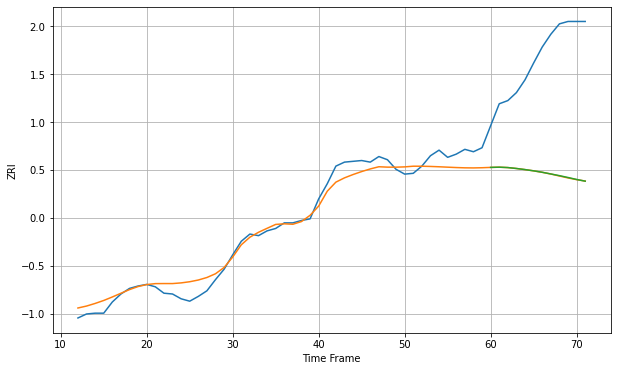

Wall time: 6.41 s
85201 12.436986895130804 148.50847113593926 148.36958672813248 [1022.39598371 1022.67439765 1022.20155906 1021.04942226 1019.66625449
 1018.10900355 1016.31365191 1014.20298307 1012.08171631 1009.76771669
 1007.30626566 1005.1731526 ]

Got an mse at 0.0050 in round 66 and stopped training

60 60 12


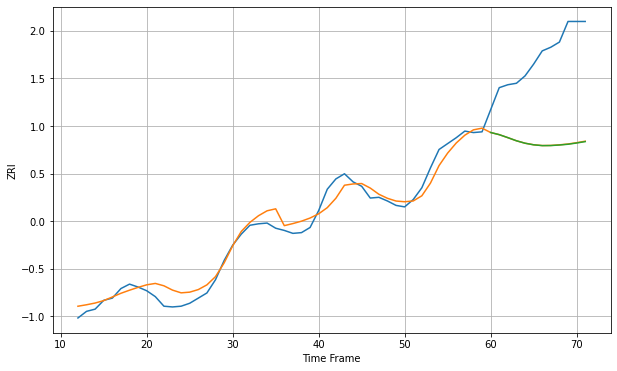

Wall time: 6.7 s
85204 12.914635851670011 119.69819999889388 119.90180601214256 [1116.08572503 1113.17258936 1109.11814119 1104.84712701 1101.5193307
 1099.35862781 1098.2533368  1098.34739728 1099.08011521 1100.12319282
 1101.79649153 1103.70117547]

Got an mse at 0.0050 in round 170 and stopped training

60 60 12


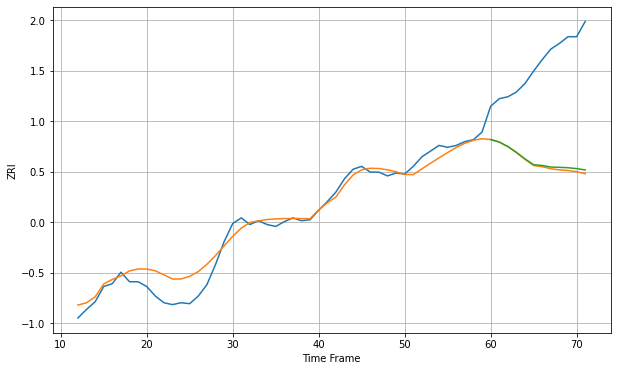

Wall time: 9.45 s
85224 12.198871202001799 107.01427075527137 105.17303791254874 [1146.15208567 1143.53489013 1138.83436687 1132.71503943 1125.79648392
 1119.77690608 1118.9344306  1117.31614096 1117.00557254 1116.58078554
 1115.67673085 1114.24836217]

Got an mse at 0.0049 in round 103 and stopped training

60 60 12


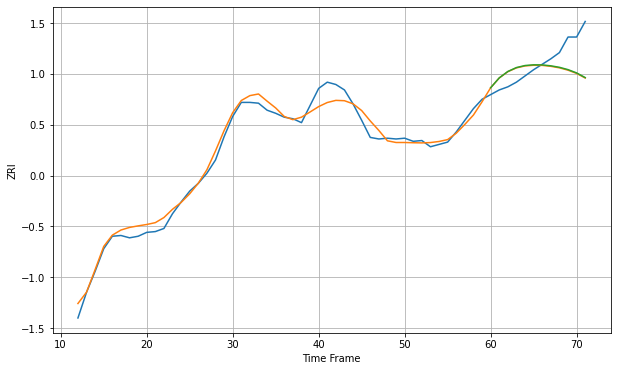

Wall time: 7.51 s
85251 10.00391993906281 30.258395665371214 29.99387395288762 [1402.80489513 1415.49360881 1423.73123842 1428.7705161  1431.38486817
 1432.30632784 1432.17364129 1431.01248168 1429.0922103  1426.1138662
 1421.88935964 1415.90401628]

Got an mse at 0.0049 in round 108 and stopped training

60 60 12


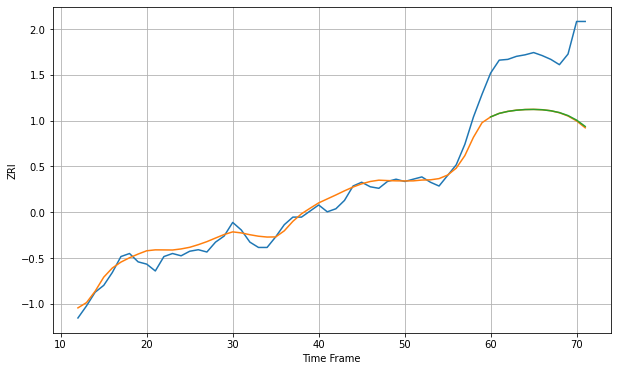

Wall time: 7.89 s
85260 11.505386619963323 84.68965574346235 84.26070920754955 [1475.14762518 1479.80193725 1482.39663815 1483.97459426 1484.81365493
 1485.01515305 1484.58534901 1483.26792488 1480.86218768 1476.89927614
 1470.90335792 1462.57102365]

Got an mse at 0.0050 in round 178 and stopped training

60 60 12


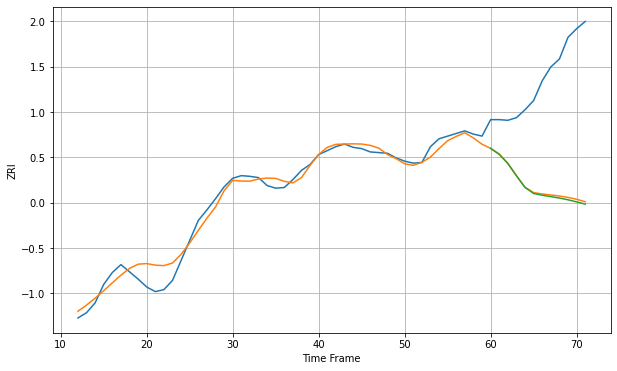

Wall time: 9.56 s
85281 13.498544545209727 173.5446357177034 175.76516585828526 [1183.39295113 1174.45588066 1160.49645739 1141.8140082  1124.03514876
 1114.98224609 1112.30685265 1110.20143378 1107.98549776 1105.35856012
 1102.19101116 1098.75931551]

Got an mse at 0.0050 in round 97 and stopped training

60 60 12


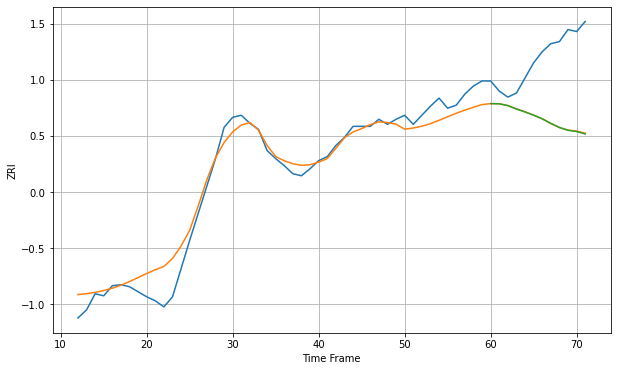

Wall time: 7.54 s
85282 14.195424532121958 67.52588048210659 67.67857626735102 [1184.5579593  1184.37172421 1182.54717745 1179.21209038 1176.28798686
 1173.08538037 1169.50936755 1164.95820109 1160.96052314 1158.08287064
 1156.83547311 1154.50173593]

Got an mse at 0.0049 in round 97 and stopped training

60 60 12


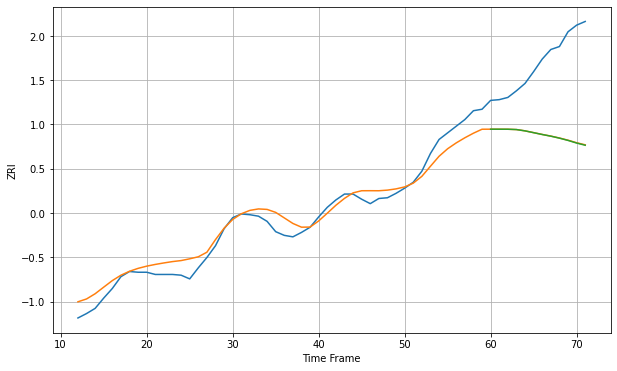

Wall time: 8.6 s
85283 15.092552353451918 105.40075694066407 105.60580741399696 [1167.94772164 1167.91804518 1167.87991436 1167.44707392 1165.66396153
 1163.22709737 1160.7522976  1158.48271568 1155.80554849 1152.73650293
 1149.16628391 1146.17496262]

Got an mse at 0.0049 in round 72 and stopped training

60 60 12


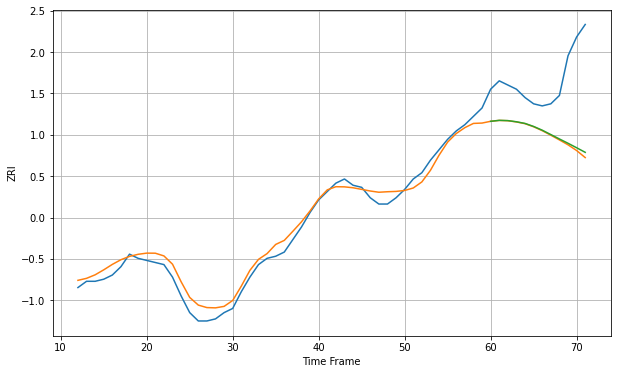

Wall time: 7.32 s
85705 4.0369201251345554 30.372337485874304 29.587026472844663 [703.62118239 704.07729618 703.95755267 703.40069447 702.6033041
 701.16014982 699.3658377  697.27432507 695.16409105 693.10375138
 690.95897589 688.76124686]

Got an mse at 0.0050 in round 87 and stopped training

60 60 12


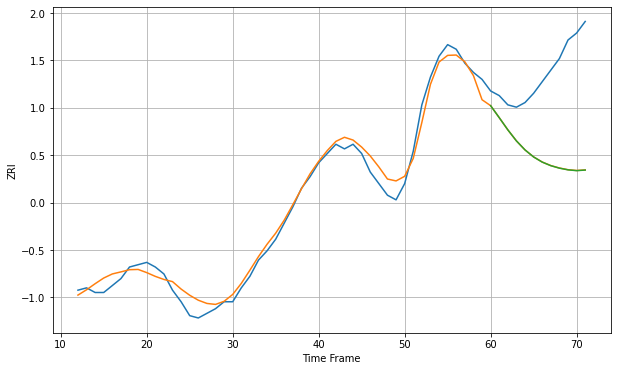

Wall time: 7.51 s
85716 4.178068528033658 38.22021582962155 38.26107069024008 [741.64125989 736.47777585 731.2163105  726.4397542  722.53596537
 719.50746697 717.28480992 715.74090237 714.67556316 713.944686
 713.59636688 713.85287618]

Got an mse at 0.0049 in round 156 and stopped training

60 60 12


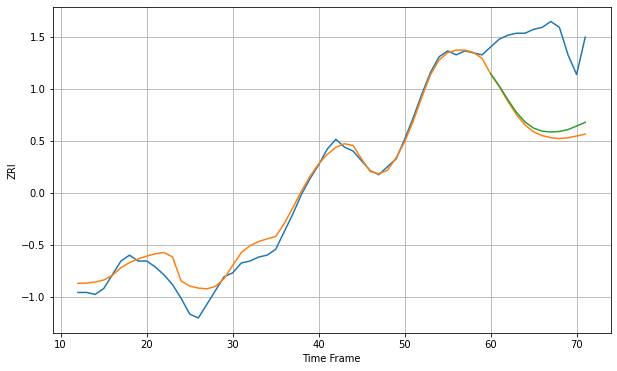

Wall time: 8.62 s
85719 5.506868111149564 44.22659570916554 41.658340304612274 [793.33164096 787.15487979 780.14702171 773.74583033 768.79494091
 765.66513818 764.13970528 763.71277873 763.95964153 764.95846798
 766.72573524 768.64627864]

Got an mse at 0.0050 in round 69 and stopped training

60 60 12


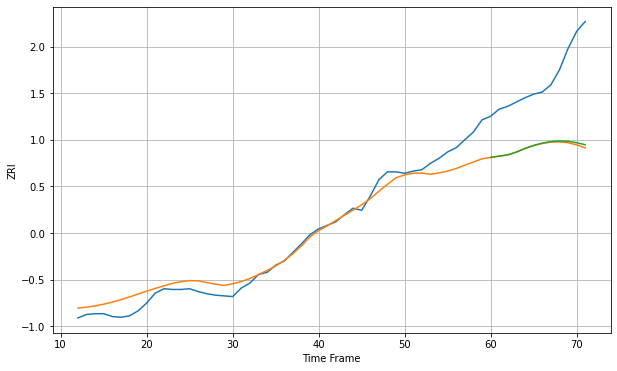

Wall time: 7.51 s
86314 17.057152195866784 101.50260114824975 100.03129379807655 [1012.22156916 1014.13527562 1015.86311556 1019.83608493 1024.89790822
 1029.10756193 1032.33894896 1034.48079422 1035.36947504 1034.85902967
 1032.90615047 1030.01978746]

Got an mse at 0.0050 in round 242 and stopped training

60 60 12


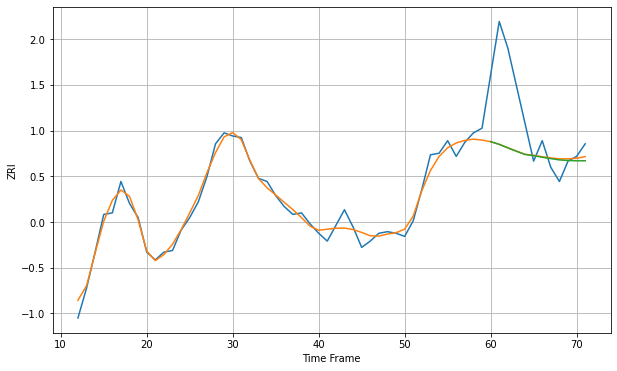

Wall time: 11.1 s
87111 4.609117314795867 34.804852252708535 34.87151854599164 [909.39996691 907.66428538 905.44809258 903.26769249 901.20371398
 900.48350008 899.43770499 898.57993005 897.7588845  897.38291485
 897.16986196 897.21076361]

Got an mse at 0.0050 in round 151 and stopped training

60 60 12


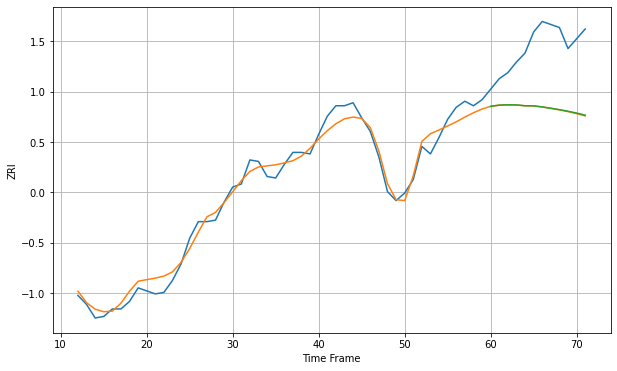

Wall time: 8.7 s
89030 6.186643505568684 43.05104330486428 42.90750722225743 [861.60643976 862.40054834 862.6212946  862.54423699 861.99052838
 861.91420196 861.2117296  860.33973928 859.40130725 858.35173035
 857.14479138 855.75724044]

Got an mse at 0.0049 in round 100 and stopped training

60 60 12


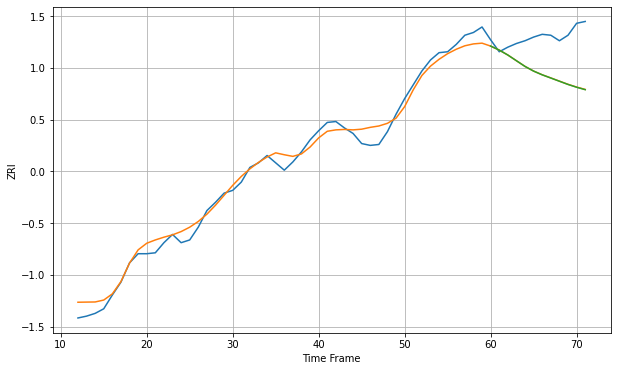

Wall time: 7.54 s
89052 9.562190164975869 42.657337343017325 42.76745649485877 [1457.18230895 1452.81906416 1447.4480696  1441.21444493 1435.01369209
 1429.9198182  1425.86251709 1422.39914399 1418.88010646 1415.38682613
 1412.34549628 1409.68833387]

Got an mse at 0.0050 in round 249 and stopped training

60 60 12


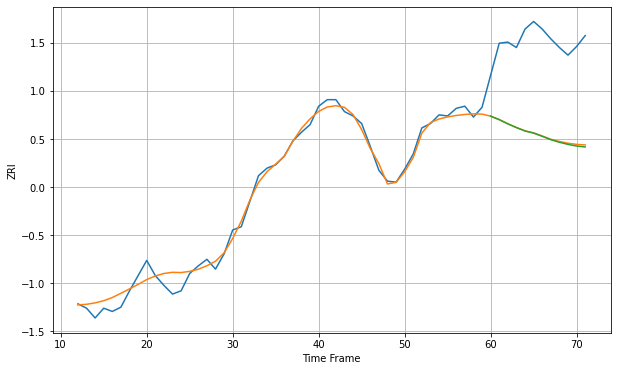

Wall time: 11.6 s
89101 7.139611824797983 85.31315613486912 85.87686803649123 [863.81464214 860.62367482 856.75210097 853.28391994 850.17290995
 848.21323496 845.26068909 842.15550192 839.77307407 837.81473208
 836.29395302 835.44479878]

Got an mse at 0.0050 in round 118 and stopped training

60 60 12


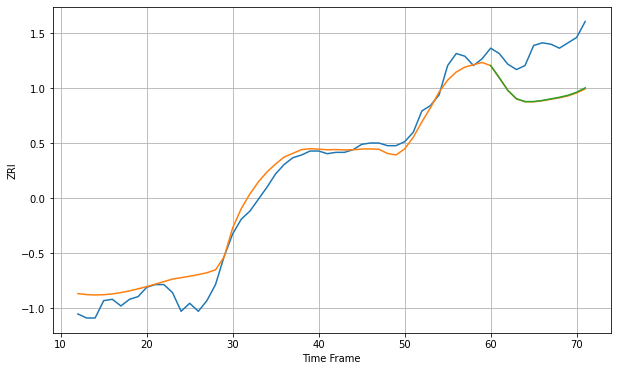

Wall time: 8.71 s
89108 10.030052413833737 34.987625952849555 34.674840139349115 [1073.95734367 1064.94853185 1055.44477312 1049.16253935 1047.03244675
 1047.02456678 1047.8369147  1049.0185496  1050.23074561 1051.73660825
 1054.0254924  1057.31431709]

Got an mse at 0.0050 in round 81 and stopped training

60 60 12


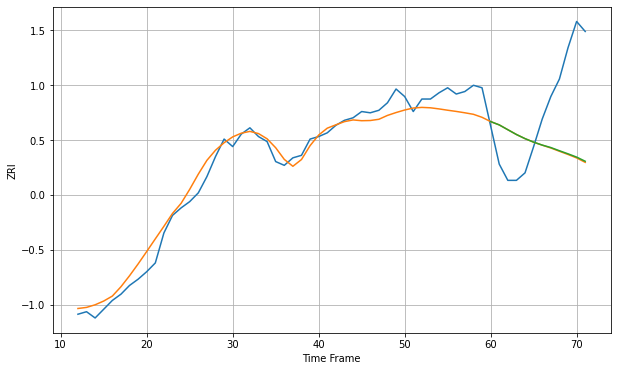

Wall time: 7.06 s
89117 10.055809690491325 57.96331839708627 57.60261031881825 [1259.97146296 1257.32320424 1253.4694411  1249.6481124  1246.35247419
 1243.55170808 1241.19854793 1239.22504426 1236.67498778 1234.20823463
 1231.5997442  1228.26867038]
60 60 12


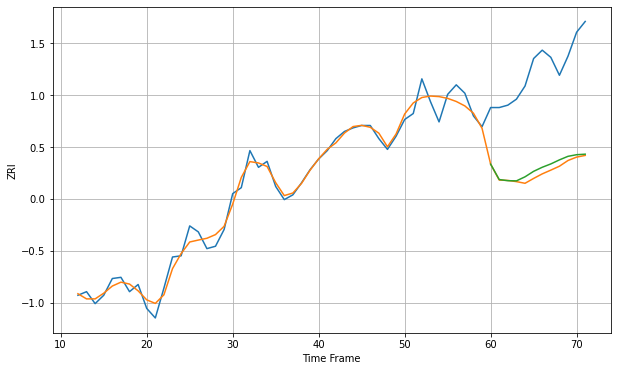

Wall time: 17.6 s
89119 7.0564133631079775 85.53430970147161 82.45208900017363 [1084.65785697 1071.77308599 1070.83772858 1070.67735372 1074.06676597
 1078.65093405 1082.04939119 1084.84935091 1088.2288287  1091.21036536
 1092.55567258 1093.00322749]

Got an mse at 0.0050 in round 68 and stopped training

60 60 12


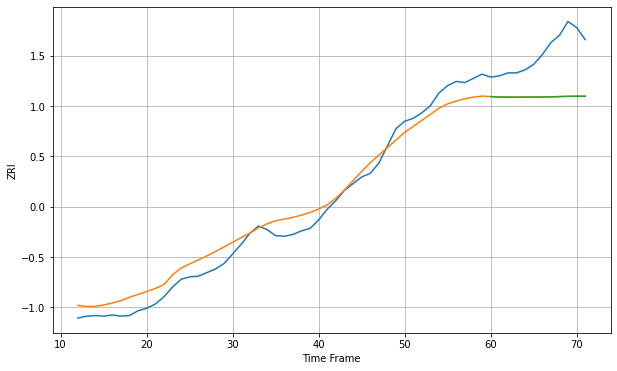

Wall time: 6.97 s
89502 21.459460678164252 76.59537172197983 76.63145166230389 [1031.85702376 1031.1509861  1030.97598039 1031.02081256 1031.05997087
 1031.14274287 1031.19437909 1031.47287582 1031.83283419 1032.25660628
 1032.4214167  1032.3772902 ]

Got an mse at 0.0050 in round 200 and stopped training

60 60 12


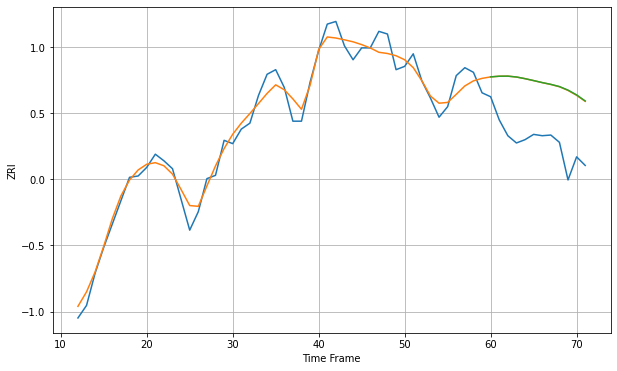

Wall time: 9.7 s
90001 17.292302037793334 88.70664298941531 88.92509881255054 [2365.06966323 2366.08256948 2366.20267276 2364.90173266 2362.3979196
 2359.48671587 2356.46343503 2353.7681722  2350.42489144 2345.03413726
 2337.81885351 2328.59152765]

Got an mse at 0.0050 in round 474 and stopped training

60 60 12


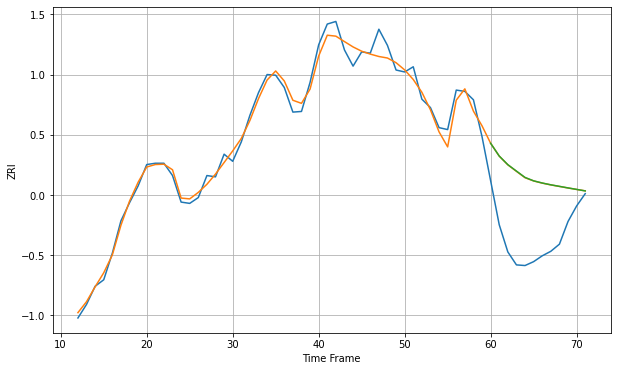

Wall time: 16.6 s
90002 13.489212861496231 100.79314422937989 101.0011365462389 [2300.84396931 2281.09631184 2267.81259316 2257.89833122 2248.10387009
 2242.81888679 2239.46881792 2236.69474754 2234.30810965 2231.8982911
 2229.59907702 2227.27705811]

Got an mse at 0.0049 in round 56 and stopped training

60 60 12


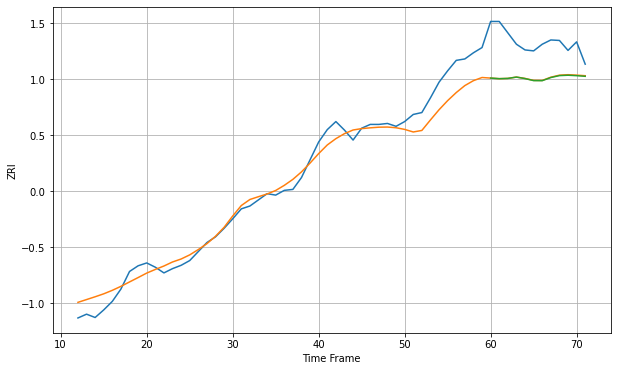

Wall time: 6.9 s
90003 29.053410023986626 79.44526581555529 79.8518477318072 [2020.65180732 2019.41268229 2019.95372244 2022.75542505 2019.60988565
 2015.33360123 2015.17625619 2021.80710743 2025.87660957 2026.67827107
 2025.74958363 2024.40873778]

Got an mse at 0.0050 in round 143 and stopped training

60 60 12


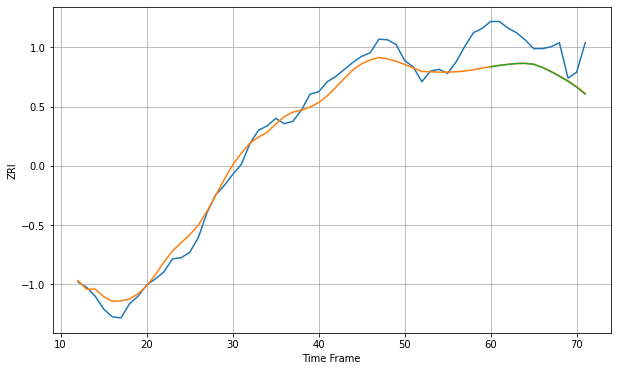

Wall time: 8.69 s
90004 21.528750525059337 53.24661097485958 53.58471366235572 [2207.31453795 2209.55740893 2211.33131574 2212.74746009 2213.01014252
 2211.4990327  2206.16833926 2199.14509954 2191.39247051 2182.66928695
 2172.7599828  2161.0305812 ]

Got an mse at 0.0050 in round 87 and stopped training

60 60 12


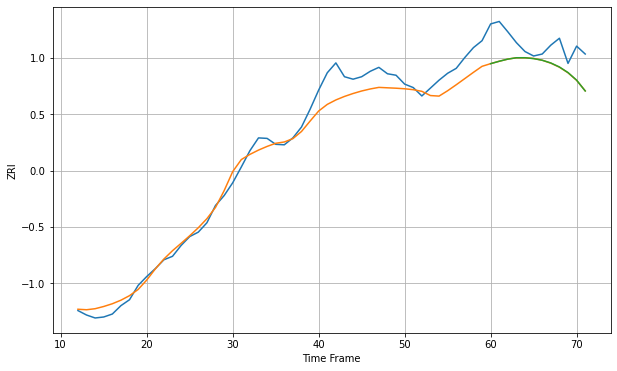

Wall time: 6.95 s
90006 26.83431498372868 52.308007945031704 52.226370681706314 [2123.48255553 2128.35728472 2132.70451503 2135.46990941 2135.51061736
 2133.6874759  2130.39808889 2124.8422878  2116.729088   2105.4331655
 2090.01041923 2068.13373681]

Got an mse at 0.0049 in round 148 and stopped training

60 60 12


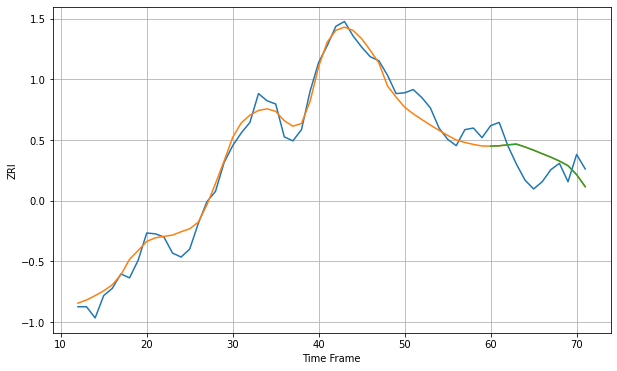

Wall time: 8.97 s
90007 14.284626975664798 27.656954838061417 27.66360186022542 [2225.43512543 2225.87808617 2227.06720453 2227.94543022 2224.42010911
 2220.38234219 2215.97453167 2211.70757226 2206.84021471 2201.0532367
 2189.88910505 2174.84017171]

Got an mse at 0.0049 in round 217 and stopped training

60 60 12


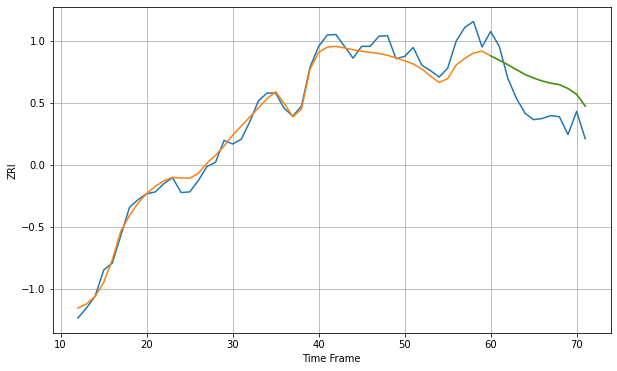

Wall time: 11.3 s
90011 18.10184874730248 53.48970831488403 53.36428386712778 [2364.94817953 2357.67011674 2349.90915897 2341.59414863 2333.43829598
 2327.46673745 2322.40459224 2318.68819211 2316.17395432 2309.61435515
 2299.75700841 2279.888632  ]

Got an mse at 0.0049 in round 144 and stopped training

60 60 12


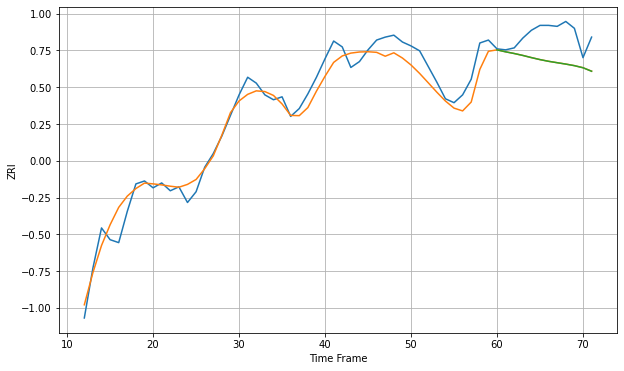

Wall time: 9.25 s
90012 13.814273250969416 28.497214634162564 28.520419858643443 [2412.97980288 2410.98071711 2409.25770779 2407.28788866 2405.07034518
 2403.02378596 2401.2783609  2399.83767988 2398.43231456 2396.83676641
 2394.70483893 2391.13343813]

Got an mse at 0.0050 in round 348 and stopped training

60 60 12


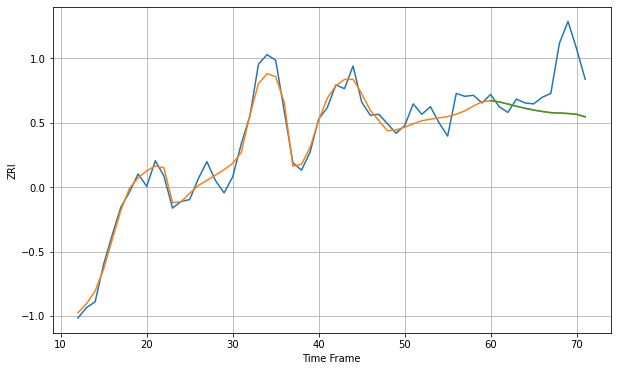

Wall time: 14 s
90015 11.133687061366969 42.97182423831202 42.89670755128059 [2516.36445692 2515.07894542 2512.87179955 2510.55905909 2508.33665261
 2506.51819595 2504.97454444 2503.7395804  2503.35343674 2502.86681636
 2502.08433626 2499.51264608]

Got an mse at 0.0050 in round 90 and stopped training

60 60 12


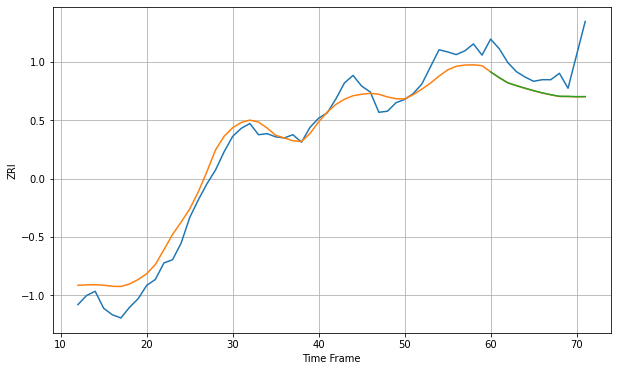

Wall time: 7.39 s
90016 27.3351182862702 57.15651742382655 56.950443590457795 [2297.55097256 2286.82812627 2277.19598201 2271.95535986 2267.11128105
 2262.56064921 2258.41191264 2254.96310852 2251.94471233 2251.82404465
 2251.29964804 2251.38804799]

Got an mse at 0.0049 in round 98 and stopped training

60 60 12


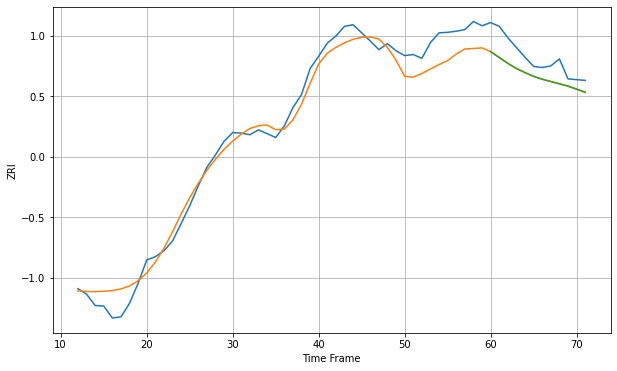

Wall time: 7.94 s
90018 27.089710528627453 35.930702958184355 35.82255369298125 [2200.37660914 2189.52597791 2178.69618223 2169.19496118 2161.71698814
 2154.70718012 2149.46604179 2145.26610555 2141.12519422 2136.74847322
 2131.37187707 2125.56785192]

Got an mse at 0.0049 in round 101 and stopped training

60 60 12


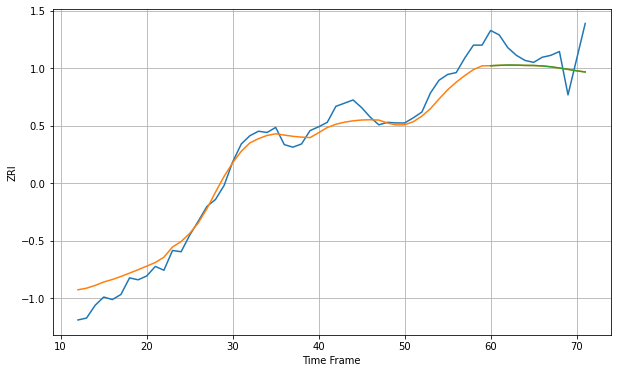

Wall time: 8.28 s
90019 20.24946452266672 35.69467400838145 35.70084553595251 [2273.71524014 2274.32538697 2274.76736194 2274.65680263 2274.23549435
 2274.12492271 2273.40504626 2272.0673054  2270.12111231 2268.01332819
 2265.73909002 2263.88430872]

Got an mse at 0.0046 in round 276 and stopped training

60 60 12


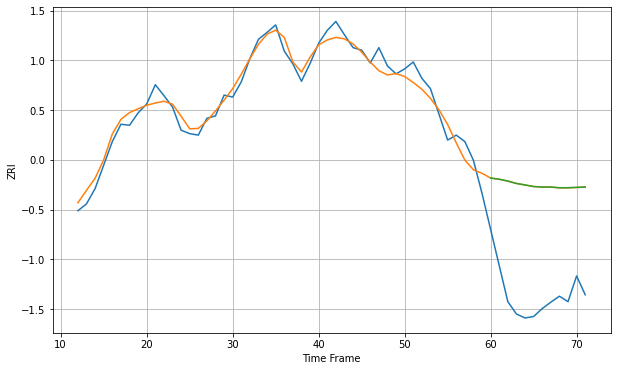

Wall time: 12 s
90022 19.994290360409337 225.02124352633743 225.11951284057648 [2265.18293337 2262.69228046 2258.96845546 2254.18032197 2251.15438774
 2247.9798971  2247.01625802 2246.890553   2245.57089582 2245.57806674
 2246.33521537 2247.08015104]

Got an mse at 0.0049 in round 396 and stopped training

60 60 12


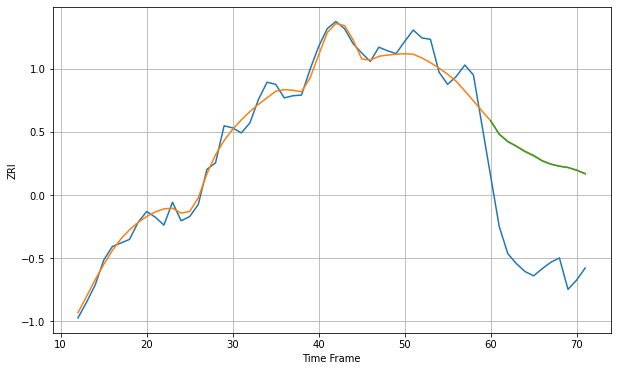

Wall time: 15.1 s
90023 14.911326834496723 147.08302059030842 146.89177473509494 [2243.04133382 2224.21846951 2213.84861303 2207.15936586 2199.75527107
 2193.9986749  2186.80276512 2182.26441556 2179.42267011 2177.68029422
 2173.90942363 2169.02897342]

Got an mse at 0.0050 in round 88 and stopped training

60 60 12


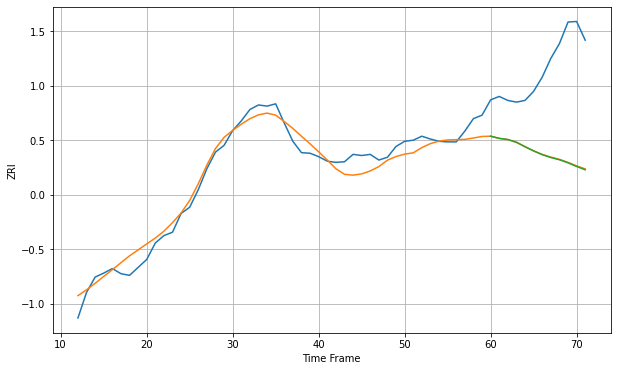

Wall time: 7.7 s
90024 19.028569631116646 159.18249612326667 159.80906832283534 [2895.04528052 2891.14451377 2889.12085066 2884.37257731 2876.45890061
 2869.08986245 2862.53363384 2857.50065046 2853.53019988 2848.13227289
 2841.70925846 2835.87284505]

Got an mse at 0.0050 in round 106 and stopped training

60 60 12


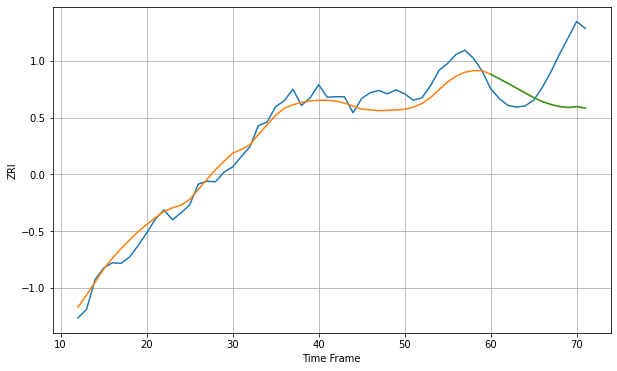

Wall time: 7.79 s
90025 20.280665828068866 77.91433124117013 77.84068422189293 [3027.11984435 3019.39151742 3011.3806099  3003.14915461 2994.75780664
 2986.66322711 2979.75365905 2974.56273673 2971.04223318 2969.32707171
 2971.0290287  2968.14413148]

Got an mse at 0.0049 in round 88 and stopped training

60 60 12


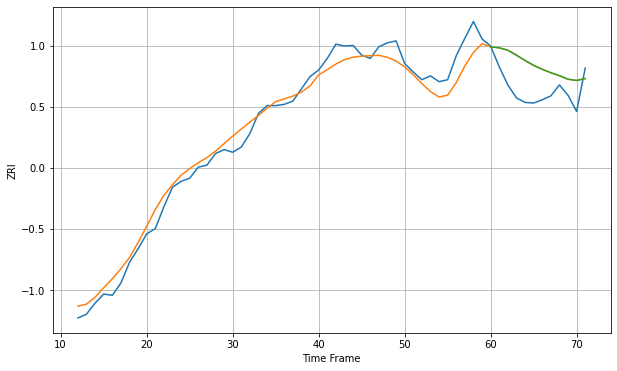

Wall time: 7.17 s
90026 19.111790419442077 43.304922223354914 43.34821823683652 [2471.82690963 2470.30558879 2466.59461599 2458.94705426 2450.74998694
 2443.21721958 2437.16457577 2431.91651582 2427.35696916 2421.76147584
 2419.86590015 2422.85907803]

Got an mse at 0.0049 in round 74 and stopped training

60 60 12


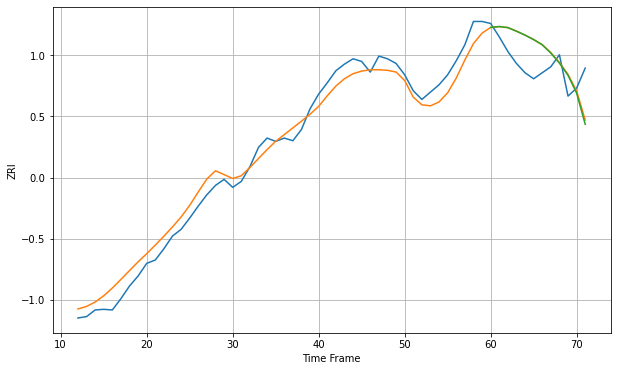

Wall time: 6.97 s
90027 18.71438032788698 40.931156331994366 41.857211451911155 [2354.04280558 2355.36338923 2353.78852055 2348.42038032 2342.50143859
 2335.74631011 2327.97187958 2315.5344671  2300.48837095 2282.19980582
 2255.50525787 2208.65276504]

Got an mse at 0.0050 in round 168 and stopped training

60 60 12


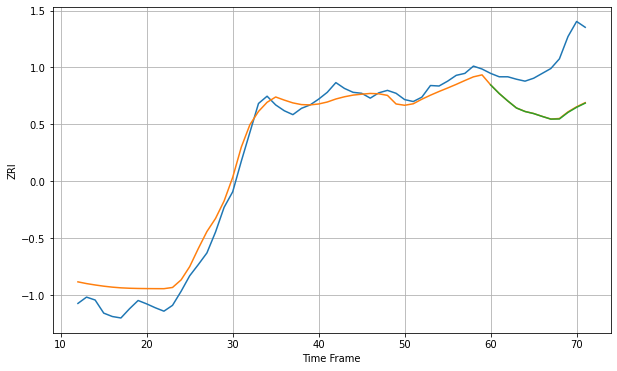

Wall time: 9.01 s
90028 27.470473038307254 104.02673236953568 104.5694672575651 [2398.28199304 2380.49946836 2365.07958873 2350.72858075 2343.44743779
 2339.22655405 2333.30096355 2327.78832611 2328.06833087 2341.62696922
 2352.12283203 2360.71245341]

Got an mse at 0.0050 in round 170 and stopped training

60 60 12


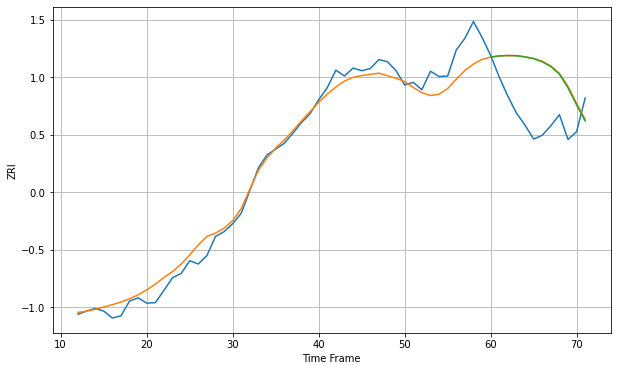

Wall time: 9.86 s
90029 24.833809948629355 96.66589194286043 95.93088616683843 [2427.74421138 2429.92491586 2430.67658026 2430.31368831 2427.99759457
 2424.58545368 2418.87873518 2409.83344076 2395.45427011 2369.65726424
 2337.27825586 2306.97510449]
60 60 12


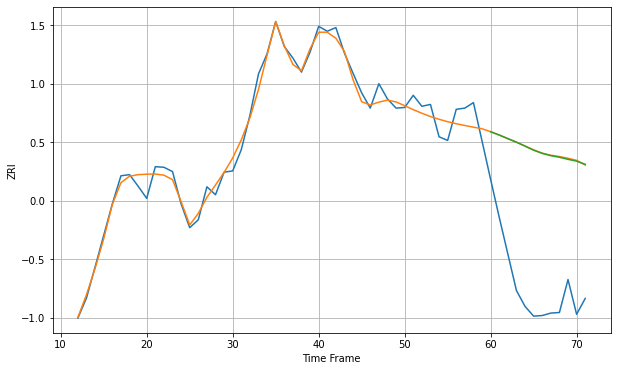

Wall time: 17.2 s
90031 16.369868184450628 226.69132043358195 226.2474872516519 [2440.28316063 2434.82171125 2428.96759199 2423.11544582 2416.63107636
 2409.99855058 2404.81837707 2401.05533347 2398.4221152  2395.00491314
 2392.08482993 2386.86516126]

Got an mse at 0.0049 in round 153 and stopped training

60 60 12


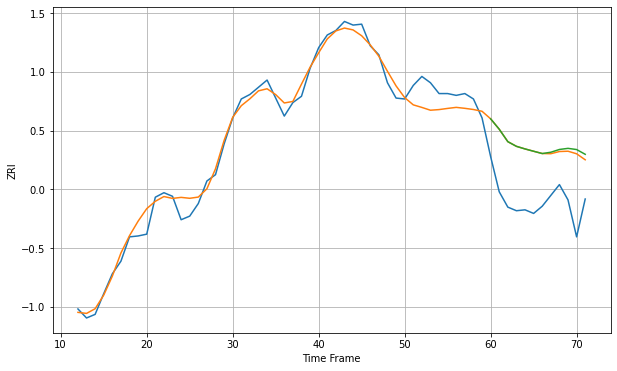

Wall time: 8.64 s
90032 12.521977493264378 62.25217816974213 63.659036278103734 [2057.96937833 2046.42756461 2032.61003246 2027.44007284 2024.55746895
 2021.98548724 2019.45311698 2020.89199506 2023.96758625 2025.20140954
 2023.89229457 2018.59988527]

Got an mse at 0.0050 in round 244 and stopped training

60 60 12


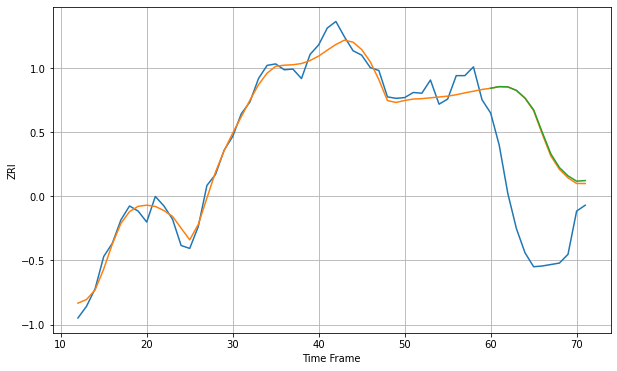

Wall time: 11 s
90033 14.085700260653873 140.99268206736699 142.1937202922054 [2295.75750399 2297.97709228 2297.64465638 2292.86783844 2282.37596061
 2266.35360086 2235.78856893 2206.24139451 2187.4688505  2176.10619861
 2168.86588396 2169.65346808]

Got an mse at 0.0050 in round 88 and stopped training

60 60 12


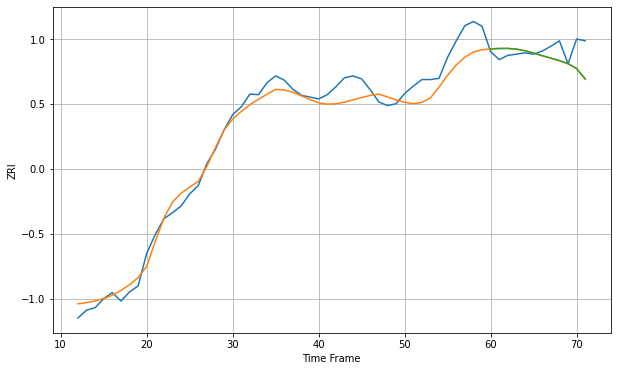

Wall time: 7.16 s
90034 21.981198269377 26.59506636968776 26.53468985852805 [2622.66289843 2623.36592635 2623.45458279 2622.24450266 2619.64492396
 2615.80169444 2611.41213065 2607.40522495 2603.21601754 2598.35968929
 2590.14066577 2572.98704848]

Got an mse at 0.0050 in round 141 and stopped training

60 60 12


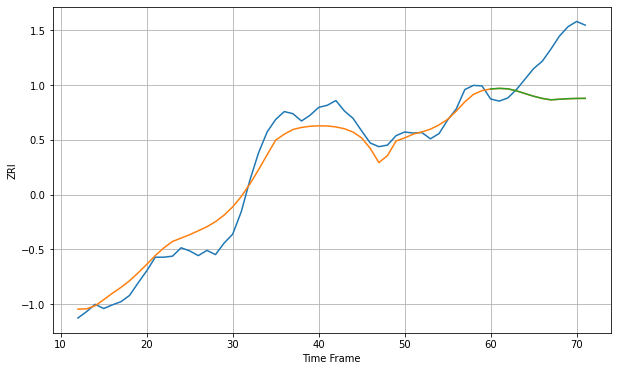

Wall time: 8.3 s
90035 28.386160403835984 88.37943503774329 88.36230519743137 [2950.16973628 2951.25818835 2950.44728161 2946.58520615 2941.37472941
 2936.27464129 2932.11792268 2929.4155026  2930.52209726 2931.56216225
 2932.08622796 2932.19695052]

Got an mse at 0.0050 in round 188 and stopped training

60 60 12


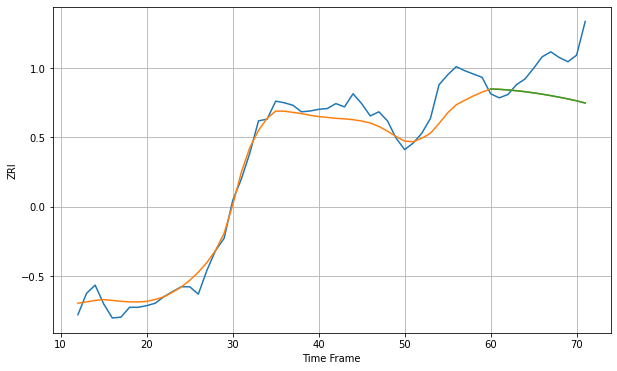

Wall time: 10 s
90036 17.814233408555783 44.3491489738738 44.36052787990463 [2566.80502817 2566.38212967 2565.63773865 2564.67776729 2563.48672043
 2562.09212139 2560.4851317  2558.70029879 2556.75579421 2554.67758699
 2552.37667933 2549.68127921]

Got an mse at 0.0049 in round 210 and stopped training

60 60 12


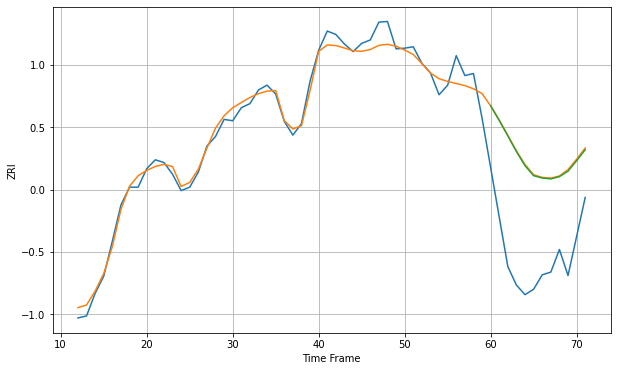

Wall time: 10 s
90037 14.41482058715162 147.1227911055727 145.97278578780188 [2320.80817053 2299.57548401 2277.09510682 2253.95037519 2233.31294011
 2218.76152602 2215.40007516 2214.08585454 2217.41469533 2225.3793456
 2240.65875982 2256.69881169]

Got an mse at 0.0050 in round 109 and stopped training

60 60 12


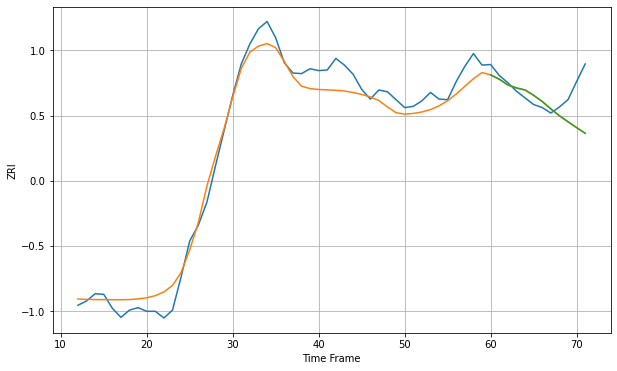

Wall time: 8.02 s
90038 23.202520186808766 42.119510999444216 42.18064576427555 [2419.85222466 2412.8337932  2403.40420935 2398.39387134 2395.02198897
 2386.2595745  2376.11993767 2363.84551799 2352.50243626 2342.63474486
 2332.91006803 2323.53428149]

Got an mse at 0.0050 in round 402 and stopped training

60 60 12


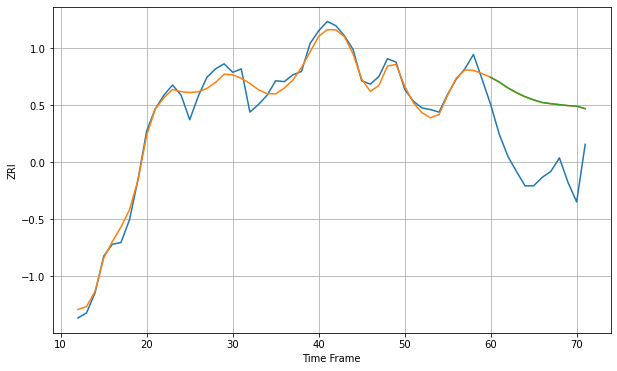

Wall time: 15.1 s
90039 10.609273500720047 82.7077467113393 82.80420478518229 [2481.09966538 2475.46042242 2468.6782009  2462.99435415 2458.22078307
 2454.46823658 2451.35820581 2449.98138852 2448.85619111 2447.72484552
 2447.07861433 2444.11483435]

Got an mse at 0.0049 in round 193 and stopped training

60 60 12


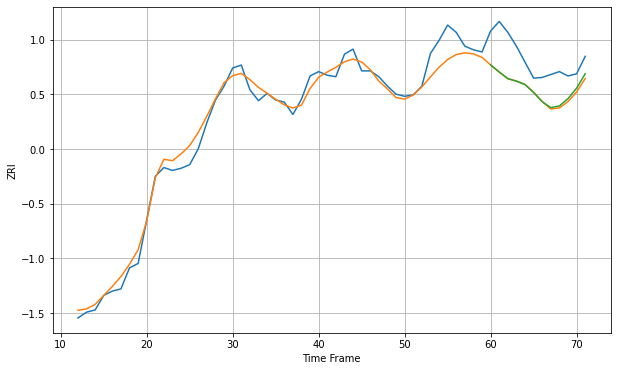

Wall time: 9.76 s
90041 14.916247676967961 44.126114668130896 42.91767317619878 [2155.15371298 2145.44524429 2136.35684899 2132.81890984 2128.10977631
 2117.35080686 2104.5760133  2096.43014799 2098.8453526  2108.79851608
 2123.21204138 2142.99821681]

Got an mse at 0.0050 in round 88 and stopped training

60 60 12


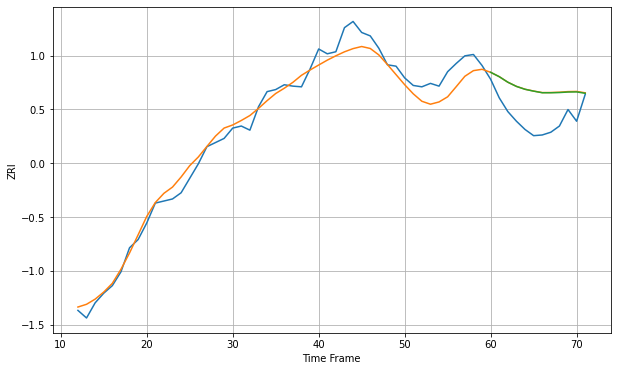

Wall time: 7.51 s
90042 17.06621127305215 45.79782992007653 45.57463250159072 [2179.08823429 2172.7525587  2164.69551024 2158.61085026 2154.40883418
 2151.71474283 2149.39038961 2149.36882267 2149.6707351  2150.43689206
 2150.59984935 2148.59177137]

Got an mse at 0.0050 in round 168 and stopped training

60 60 12


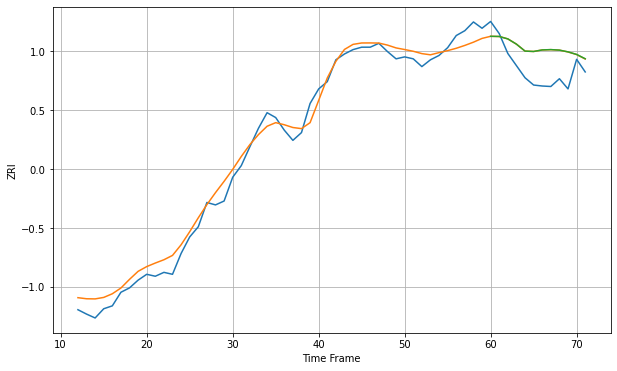

Wall time: 9.26 s
90043 21.542433281632917 52.44074322748995 52.511249311386564 [2257.4120391  2257.04546858 2252.07385926 2241.27194374 2226.93918728
 2226.17567618 2229.34485703 2230.01153699 2228.96184716 2225.33568981
 2220.07801829 2211.20202996]

Got an mse at 0.0050 in round 118 and stopped training

60 60 12


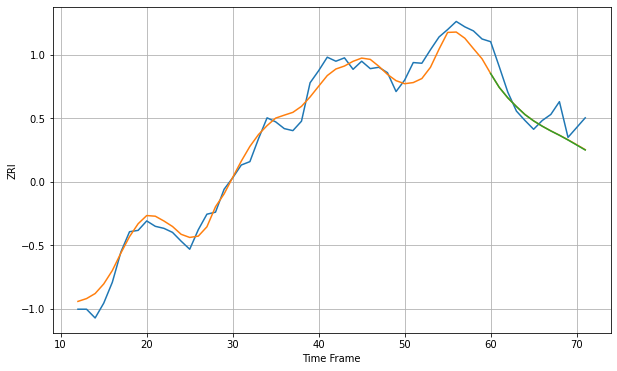

Wall time: 8.14 s
90044 17.04007503098364 28.21923684310528 28.34626554986852 [2165.71840859 2145.18797806 2129.61323195 2116.71285889 2104.7887771
 2095.46090684 2087.59982828 2080.57779112 2074.11373791 2067.12750035
 2059.74721122 2052.29849258]

Got an mse at 0.0050 in round 81 and stopped training

60 60 12


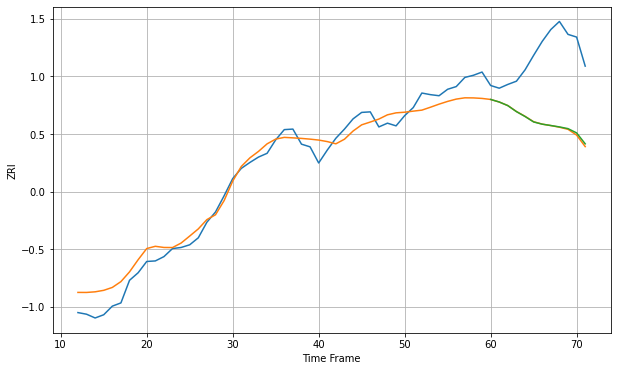

Wall time: 7.08 s
90045 24.25907102544229 132.11939698437385 131.02266370623585 [2568.0793618  2563.34203051 2556.61349073 2545.46809431 2536.42675074
 2526.27562001 2522.12678565 2519.64179238 2517.0393123  2513.86168237
 2505.92769611 2485.60171868]

Got an mse at 0.0050 in round 47 and stopped training

60 60 12


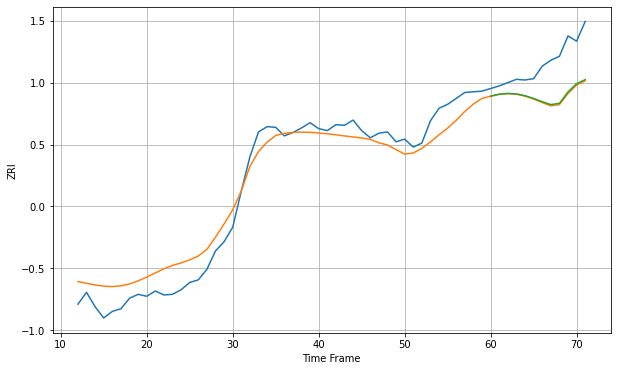

Wall time: 6.44 s
90046 25.67976470479839 54.91515491204375 53.53153263635002 [2488.36843098 2491.32216954 2492.47331346 2491.75944752 2489.04930412
 2484.86219825 2479.93546113 2475.54097835 2477.44762062 2494.8272413
 2507.42336348 2513.54772578]

Got an mse at 0.0050 in round 73 and stopped training

60 60 12


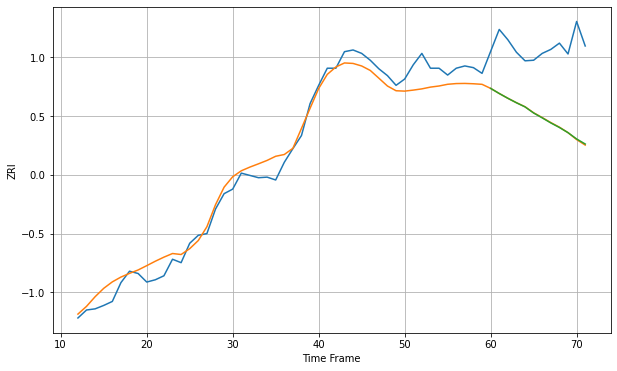

Wall time: 6.79 s
90047 22.76510106480406 126.877660342324 126.70876683638785 [2056.63612016 2047.6835175  2039.27742286 2031.4304608  2024.19379436
 2013.478785   2004.9436519  1996.04745145 1988.06573271 1978.98601935
 1967.93772842 1959.10424362]

Got an mse at 0.0050 in round 298 and stopped training

60 60 12


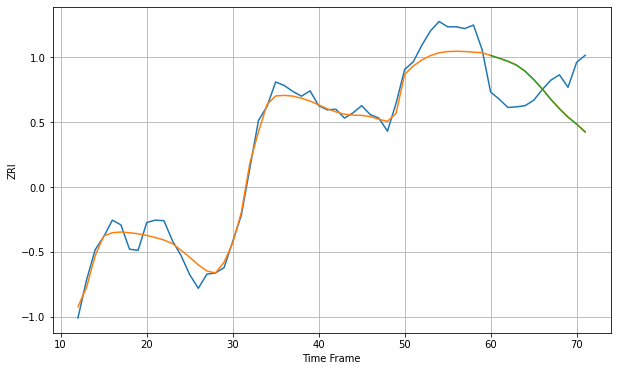

Wall time: 12.4 s
90048 21.75967420202256 69.8438591185092 69.9057801752492 [2889.61600563 2884.97524287 2879.89746659 2873.48431727 2863.15725502
 2849.21504937 2833.32706026 2815.67889747 2799.8276599  2785.69135964
 2773.84655306 2760.63505261]

Got an mse at 0.0050 in round 232 and stopped training

60 60 12


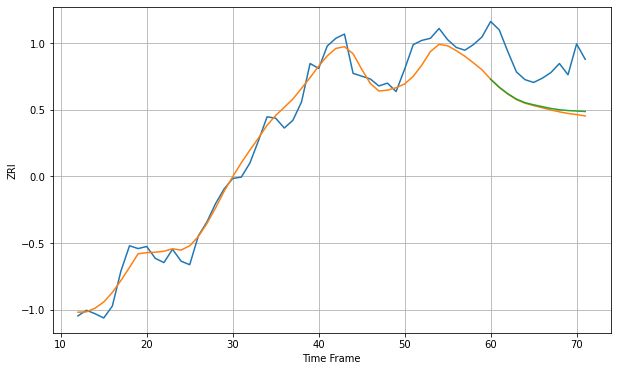

Wall time: 11.2 s
90061 18.62422160846957 64.5657016795882 62.329660524343105 [2163.58315816 2152.16111684 2142.88656178 2135.22385135 2130.13212144
 2127.11332776 2124.46860979 2121.92149212 2120.0619809  2118.90364047
 2118.25974154 2117.57713442]

Got an mse at 0.0050 in round 178 and stopped training

60 60 12


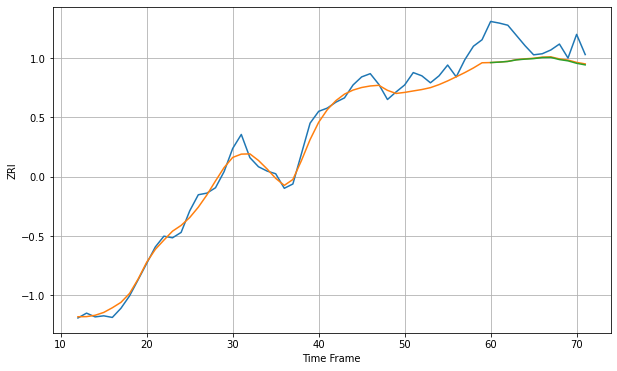

Wall time: 9.39 s
90062 17.07025805980504 43.052467246801854 43.50078874178972 [2050.61863216 2051.46395657 2052.69763863 2055.64308745 2057.02211836
 2057.96745374 2059.8925469  2060.20562254 2056.19852337 2053.80465565
 2049.26903136 2046.32476923]

Got an mse at 0.0050 in round 256 and stopped training

60 60 12


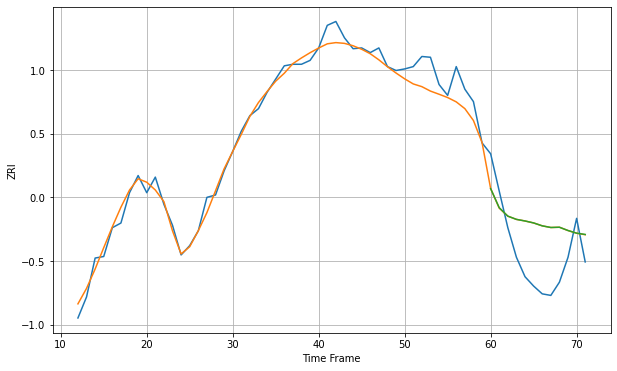

Wall time: 11.3 s
90063 15.548182166728514 57.575699558123915 57.58501491281481 [2226.24604749 2201.67215429 2190.86702538 2186.68565085 2184.63928767
 2182.11864424 2178.40065258 2176.27224014 2176.60411797 2172.37702331
 2168.98015866 2167.31398415]
60 60 12


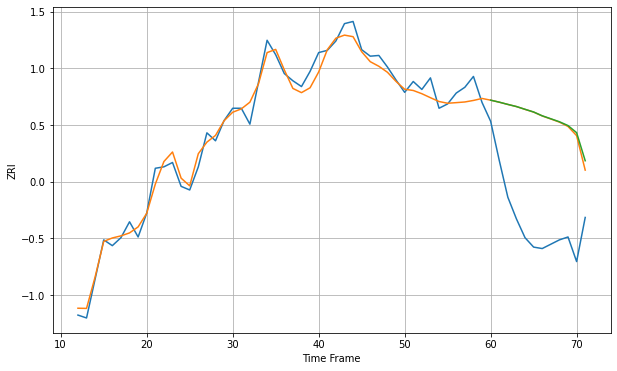

Wall time: 17.1 s
90065 13.581900618602484 147.8377741562338 149.01038486244434 [2413.17999199 2410.40163581 2407.30079954 2404.37017322 2400.54448444
 2396.83538479 2391.55765104 2387.45632592 2383.32263326 2378.06448068
 2368.22081559 2329.41835008]

Got an mse at 0.0050 in round 143 and stopped training

60 60 12


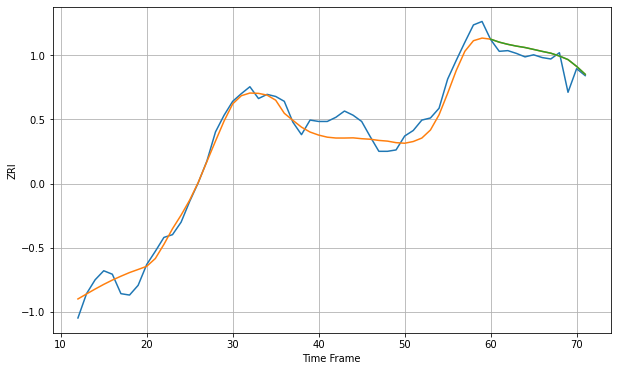

Wall time: 8.54 s
90066 17.081847128662275 15.828168323951843 15.858133249535822 [2707.50606801 2703.22109796 2700.06700647 2697.52215572 2695.48585598
 2692.74352764 2689.92076041 2687.32816343 2683.24408335 2678.12990002
 2668.35498131 2656.97834656]

Got an mse at 0.0050 in round 224 and stopped training

60 60 12


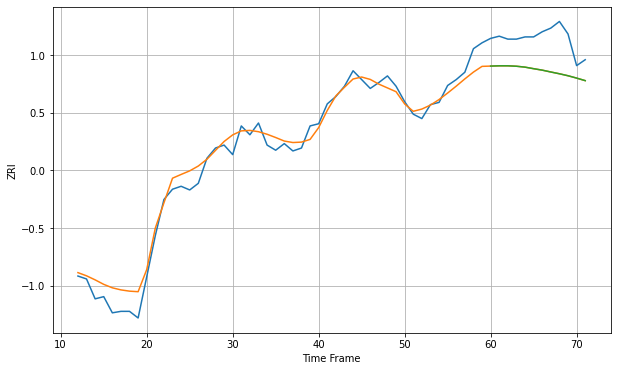

Wall time: 10.5 s
90068 15.955906832100014 45.56859343039009 45.57199560799316 [2388.35828383 2388.71840798 2388.72540661 2388.15126451 2386.91049964
 2384.80945384 2382.84231063 2380.32214627 2377.90814058 2375.22402724
 2372.03099899 2368.58611497]

Got an mse at 0.0050 in round 104 and stopped training

60 60 12


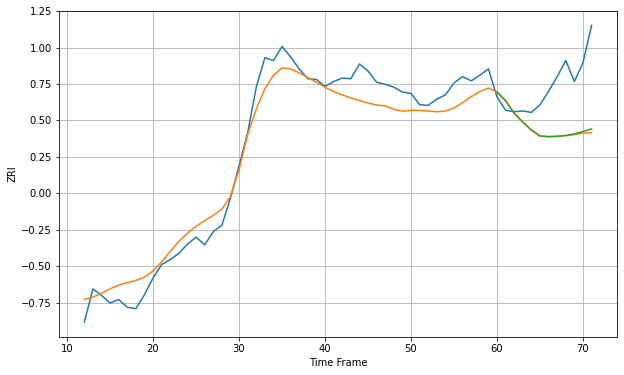

Wall time: 8.21 s
90069 24.820162774691955 73.76249301122095 72.45148802752573 [2717.06364273 2704.52831191 2686.78216129 2674.27064696 2662.80511131
 2654.29476357 2653.44446782 2653.89127674 2655.13901642 2657.36092001
 2660.68902799 2664.33208067]

Got an mse at 0.0049 in round 263 and stopped training

60 60 12


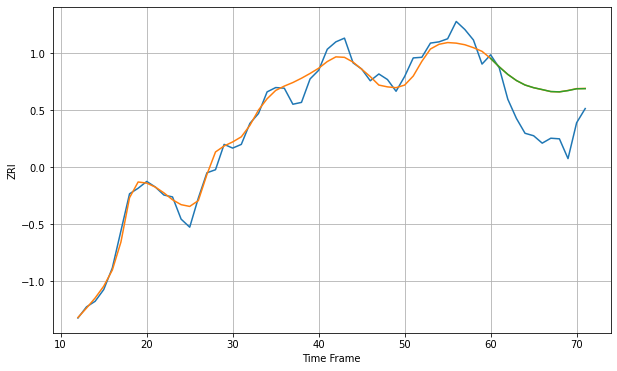

Wall time: 11.5 s
90220 16.19048077718857 66.36164627680822 66.32504253406222 [2181.17088299 2167.56543681 2155.26697692 2145.40975298 2138.1584417
 2133.79437701 2130.74966277 2127.55058811 2127.03231217 2129.08758585
 2132.01054404 2132.2283625 ]

Got an mse at 0.0049 in round 239 and stopped training

60 60 12


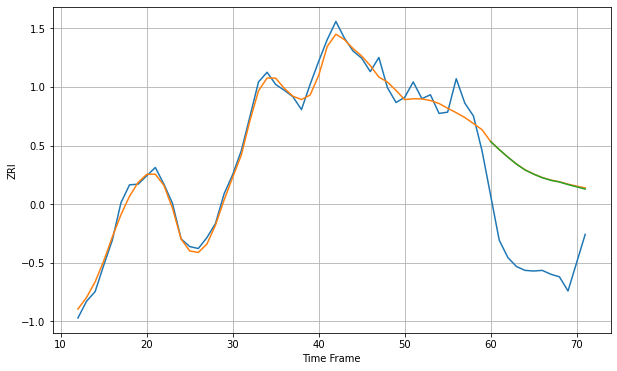

Wall time: 11.3 s
90221 14.899434812047586 139.91253366340595 139.55337884922523 [2233.31828057 2220.79662829 2209.08845967 2198.28294217 2189.18085622
 2182.61464983 2177.12050675 2173.0817024  2170.38655224 2166.39919135
 2162.88161349 2159.38685289]

Got an mse at 0.0050 in round 83 and stopped training

60 60 12


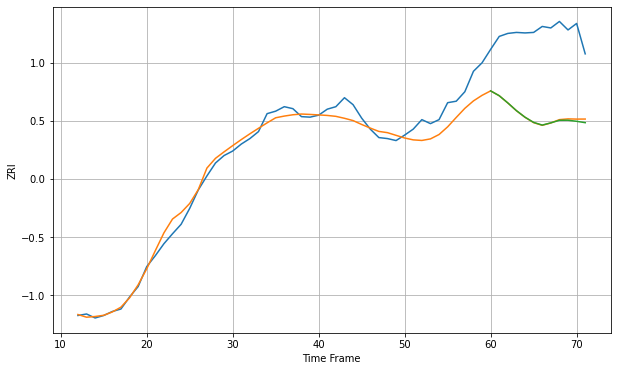

Wall time: 7.86 s
90232 22.46435474926767 165.0895027588791 166.23120640037698 [2714.7005375  2705.01263789 2690.51765863 2675.04739148 2661.89381595
 2651.45928773 2646.06360772 2650.52958883 2655.71148445 2655.84513217
 2653.65297212 2650.90470672]

Got an mse at 0.0050 in round 184 and stopped training

60 60 12


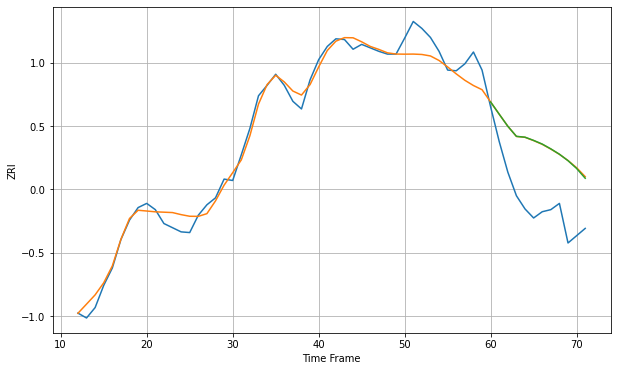

Wall time: 9.64 s
90247 16.73105523825808 85.42908173846625 85.27162182139953 [2308.02201112 2290.41304166 2273.0724545  2258.53991787 2257.35314025
 2252.70120679 2247.44857824 2240.54564108 2232.81731605 2223.52309014
 2212.30684594 2198.22031658]

Got an mse at 0.0049 in round 203 and stopped training

60 60 12


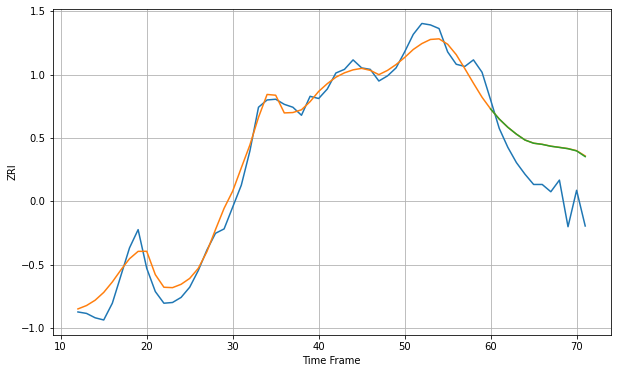

Wall time: 9.93 s
90250 17.105252552437136 58.234836525986346 58.034358487942 [2262.59112798 2248.85269004 2237.5131359  2228.05197315 2219.99245117
 2215.60682257 2214.02407147 2211.48272207 2209.84849084 2208.09698061
 2205.09009673 2197.20183509]

Got an mse at 0.0050 in round 126 and stopped training

60 60 12


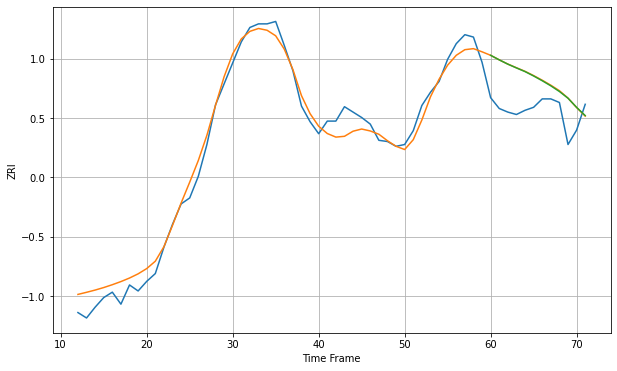

Wall time: 7.95 s
90254 19.703185164062955 58.22532893569266 57.9465793549413 [2759.60343752 2752.01773093 2744.8781809  2738.60537205 2732.48737102
 2725.1714123  2717.25602414 2708.75416453 2699.29713082 2688.14736153
 2672.84082904 2659.17819474]

Got an mse at 0.0050 in round 447 and stopped training

60 60 12


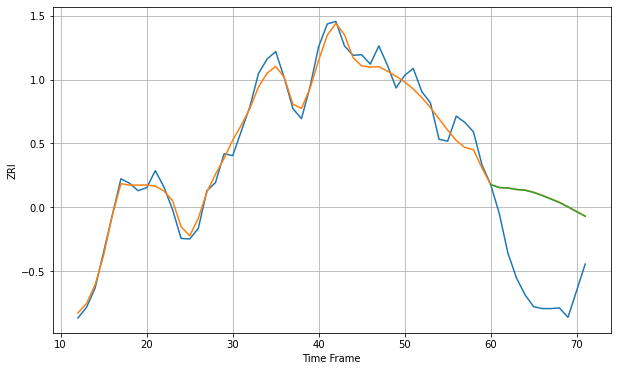

Wall time: 15.6 s
90255 17.21973805505859 140.91145320885437 140.62619162708 [2258.81178276 2254.09371529 2253.30344467 2250.91471765 2249.7237282
 2246.21883947 2241.30151523 2235.75103646 2230.11552353 2223.16196754
 2215.65329784 2208.37951498]

Got an mse at 0.0050 in round 405 and stopped training

60 60 12


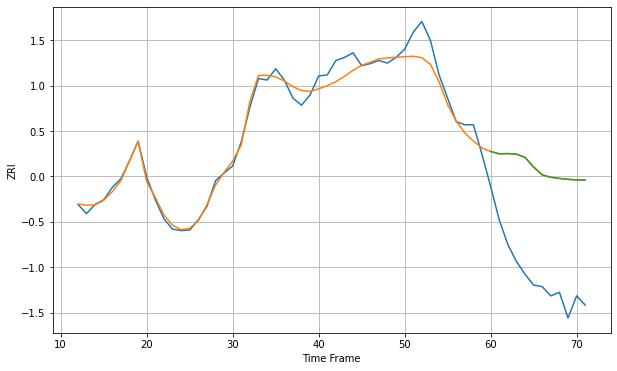

Wall time: 14.5 s
90260 20.06964683261003 210.62524870944688 210.85516056520677 [2469.05950433 2464.40017193 2464.90052909 2463.89193166 2457.6993909
 2438.9811995  2423.55063152 2418.90343487 2416.64136297 2414.81105718
 2413.67769164 2413.3805439 ]

Got an mse at 0.0049 in round 270 and stopped training

60 60 12


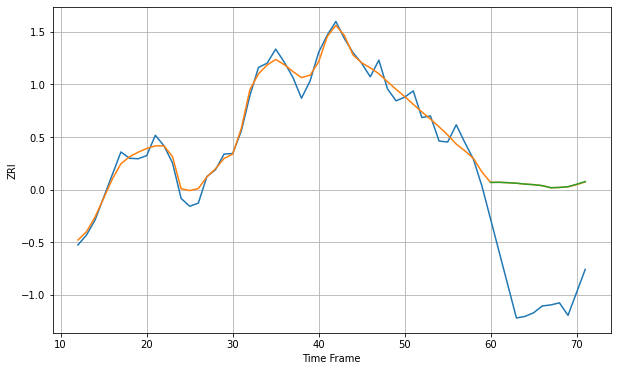

Wall time: 11.4 s
90262 16.138539792787274 211.38759157270155 211.5452055077726 [2239.67826029 2239.89042374 2239.17585429 2238.16617559 2236.53624926
 2235.36639139 2233.53717069 2229.54348607 2230.006253   2231.60495605
 2236.14063317 2241.3514644 ]

Got an mse at 0.0049 in round 239 and stopped training

60 60 12


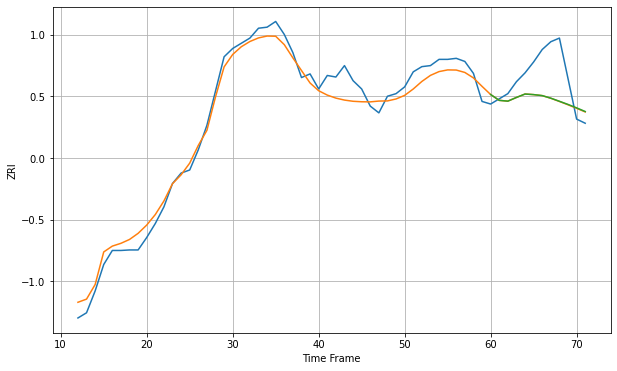

Wall time: 10.6 s
90266 22.52492736601858 61.36455203693007 61.27693998867917 [2889.2991283  2878.10005705 2876.54679084 2883.6685248  2890.25591159
 2889.13621468 2887.20917808 2882.26063516 2876.2961377  2870.23785992
 2863.63941964 2856.57959586]
60 60 12


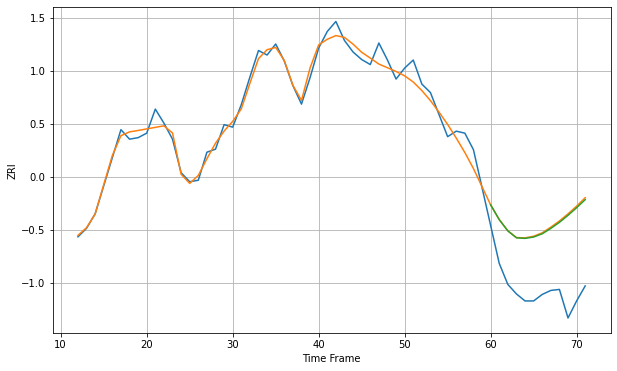

Wall time: 16.6 s
90270 17.24241077822274 137.18098927654762 135.2424070426177 [2188.88555328 2159.38914322 2136.91608953 2123.06328606 2121.90639063
 2124.63219432 2131.07422054 2141.82544082 2153.94443142 2167.99307746
 2183.10552345 2199.27648188]

Got an mse at 0.0049 in round 163 and stopped training

60 60 12


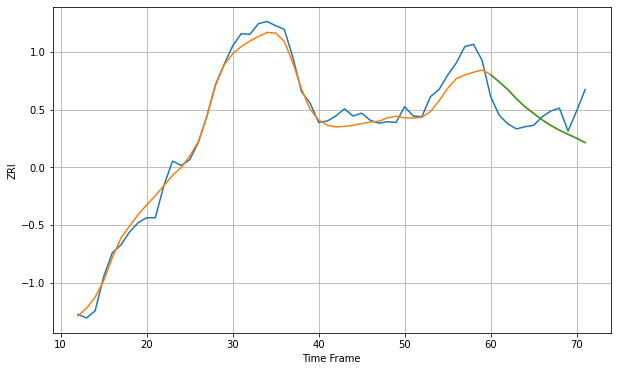

Wall time: 9.4 s
90277 14.876269285319289 37.17969274582253 37.17479416423861 [2672.80076678 2662.65082808 2651.87178318 2639.05991963 2627.8457488
 2618.62220165 2609.55914331 2601.90027652 2595.13993075 2589.57068825
 2583.9344131  2577.82792031]

Got an mse at 0.0050 in round 214 and stopped training

60 60 12


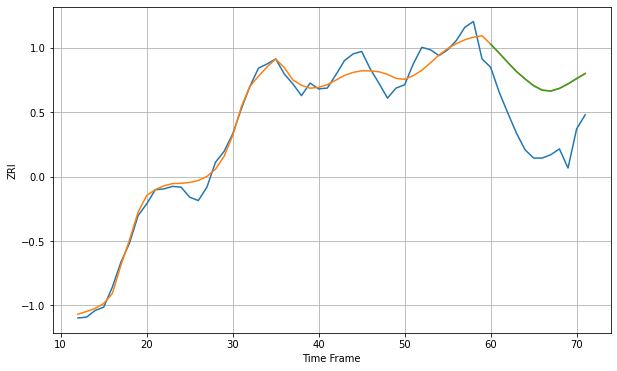

Wall time: 10 s
90278 12.126963079449258 71.36701841490454 71.25183989223837 [2525.75009523 2514.9863261  2503.7151405  2492.95175788 2483.95136213
 2475.73055104 2470.38837743 2469.41192546 2472.68843063 2478.06847837
 2484.42113098 2490.37602422]

Got an mse at 0.0050 in round 234 and stopped training

60 60 12


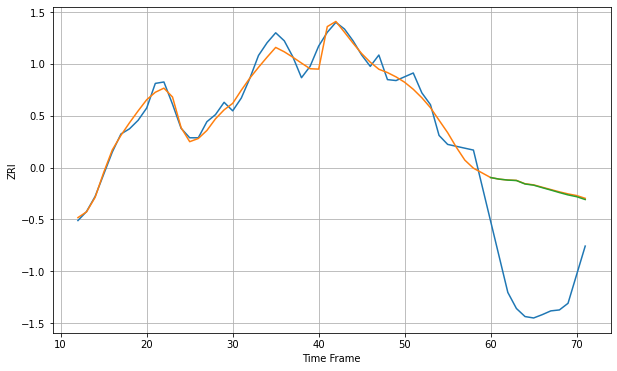

Wall time: 10.4 s
90280 18.73708848923021 226.5733046218794 225.64671262606527 [2300.89368644 2297.53729469 2295.54262665 2294.59982663 2287.29730808
 2284.79986194 2279.53269351 2274.47448438 2269.16108552 2264.23439157
 2260.44777369 2254.42424072]

Got an mse at 0.0050 in round 152 and stopped training

60 60 12


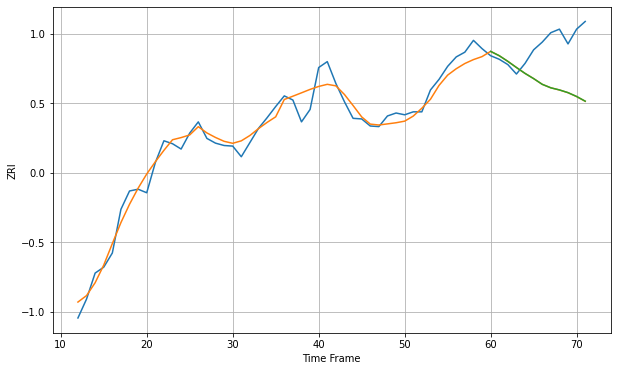

Wall time: 8.73 s
90291 18.044828505670555 73.8439548737429 73.77470291270582 [3192.35308979 3185.02595908 3175.46014591 3165.08174897 3155.0651027
 3146.26327857 3136.59292791 3130.6760339  3127.10625991 3122.50357348
 3116.00467433 3108.05047149]

Got an mse at 0.0050 in round 80 and stopped training

60 60 12


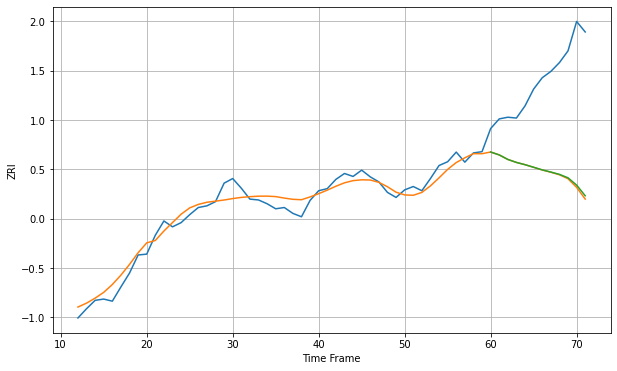

Wall time: 6.83 s
90292 20.40692477005992 236.34300961656243 234.07067088411463 [3136.14750378 3129.23545054 3118.4820635  3111.36325884 3106.01542885
 3099.84239526 3093.61805089 3088.44853905 3082.95415216 3074.78052717
 3057.45301164 3031.99567099]

Got an mse at 0.0050 in round 208 and stopped training

60 60 12


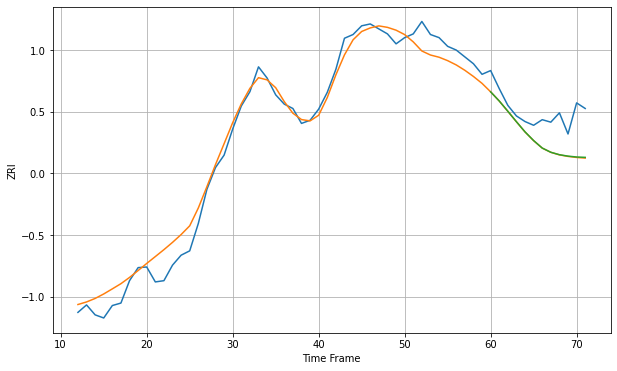

Wall time: 10 s
90301 21.682841310060613 47.46600903266372 47.092329826064066 [2142.7869805  2128.07665073 2111.57880865 2094.73079195 2078.38119122
 2064.40625918 2052.37388631 2045.5630159  2041.65164656 2039.36878699
 2037.96016924 2037.38787647]
60 60 12


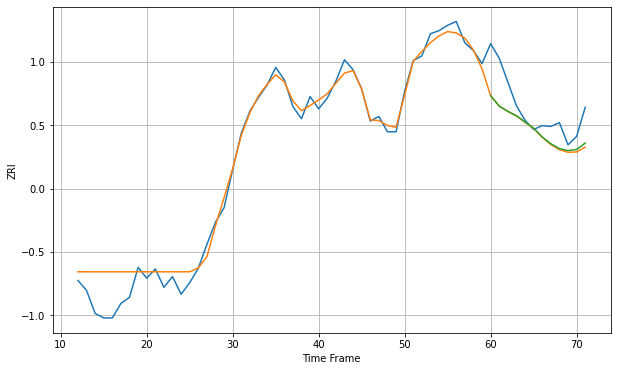

Wall time: 16.7 s
90302 19.08622133527423 35.86329860343979 34.84940281022098 [2257.11617324 2243.49984433 2236.7026196  2230.99900604 2222.77222356
 2214.72263836 2203.2916124  2194.44158951 2188.03837748 2185.48985302
 2186.90625907 2195.21931147]

Got an mse at 0.0050 in round 270 and stopped training

60 60 12


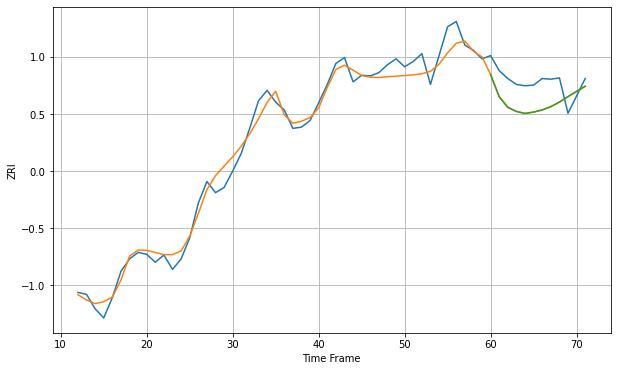

Wall time: 11.3 s
90303 16.348704639847366 36.25636821680182 36.237133482221424 [2022.89905731 1989.13458334 1973.11456245 1966.80694998 1963.81921726
 1965.86644639 1969.20956674 1974.19790456 1981.12140811 1989.54252244
 1997.51956223 2005.40736437]

Got an mse at 0.0048 in round 324 and stopped training

60 60 12


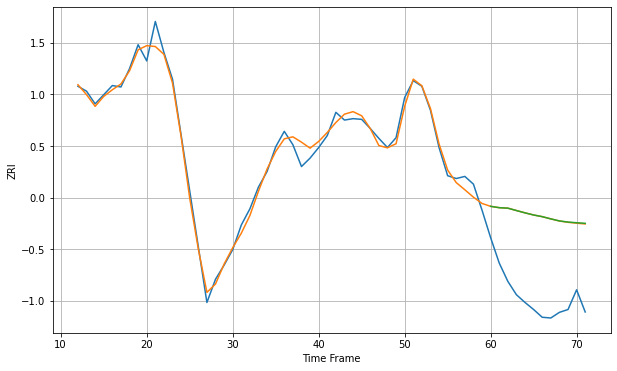

Wall time: 12.7 s
90304 11.209319069810437 117.04205884600015 117.20288401155103 [2499.50464481 2497.59602647 2496.91916861 2493.54522517 2490.23939143
 2487.21098648 2484.86428736 2481.6887788  2478.81051631 2477.17298188
 2476.21405326 2475.39096384]

Got an mse at 0.0049 in round 225 and stopped training

60 60 12


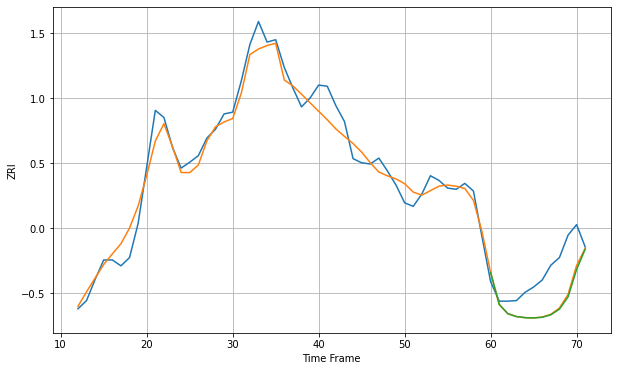

Wall time: 10.4 s
90404 22.885084476511043 57.17165755582801 58.91094335437892 [3049.56101589 2995.45018937 2979.73645565 2974.83350182 2972.99216659
 2972.45657819 2973.64735924 2977.8173733  2987.44540449 3008.18130626
 3054.80801523 3089.2386875 ]

Got an mse at 0.0050 in round 201 and stopped training

60 60 12


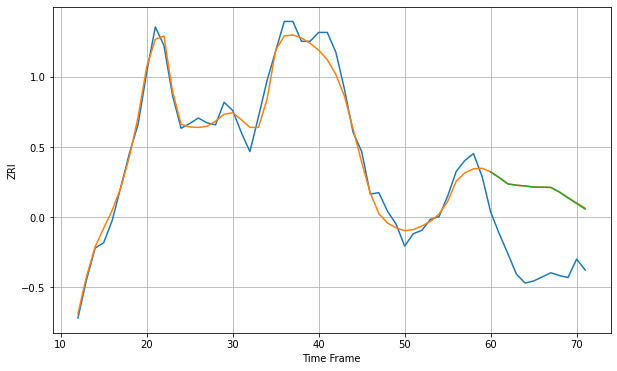

Wall time: 10 s
90405 16.036919901167106 112.70110096200365 112.48147300849928 [3044.38373476 3035.98145563 3026.82868981 3024.8257695  3023.7648499
 3022.10705316 3022.01632916 3021.63631715 3014.79196427 3006.35302152
 2998.1497231  2989.99357677]

Got an mse at 0.0050 in round 139 and stopped training

60 60 12


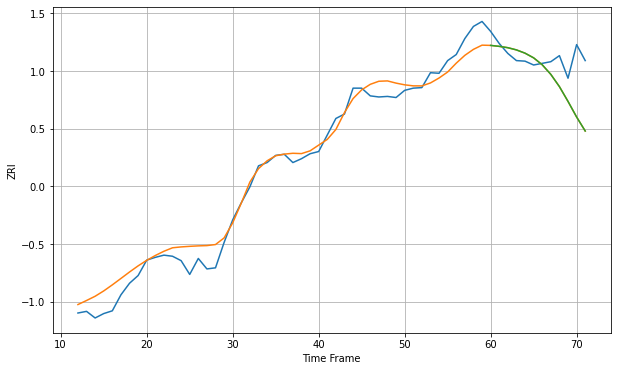

Wall time: 8.2 s
90501 22.975671158285927 58.176169344034264 58.14159477761085 [2125.56640834 2123.83110998 2121.41833004 2117.42072824 2111.48109078
 2102.98757534 2090.41508685 2072.99136902 2050.78380574 2023.96847359
 1995.67152598 1970.25997711]

Got an mse at 0.0050 in round 225 and stopped training

60 60 12


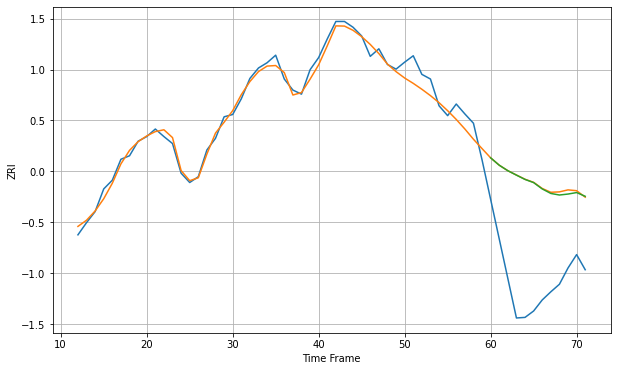

Wall time: 10.8 s
90640 14.584501994718394 172.82851494007213 171.540931909743 [2216.43916183 2203.76101268 2194.27368188 2186.71157477 2179.30831699
 2173.84586637 2162.96224767 2155.19636599 2152.50055576 2154.15482319
 2156.7012457  2150.27360248]

Got an mse at 0.0049 in round 261 and stopped training

60 60 12


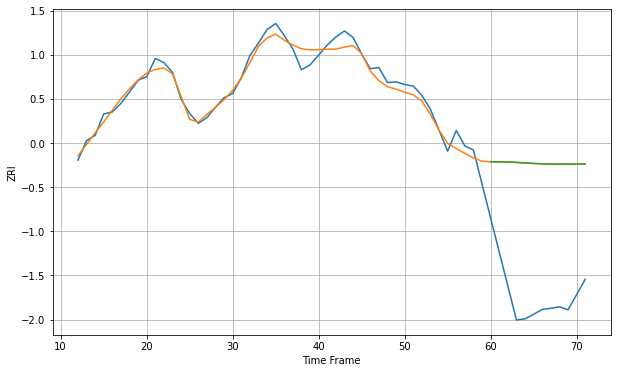

Wall time: 11.1 s
90723 22.056584889605762 353.22645142398244 353.15407271711723 [2390.07047551 2389.59480803 2389.50001586 2388.21547238 2386.75017867
 2385.48601213 2384.40710956 2383.63973915 2383.65759281 2383.55600179
 2383.81627404 2384.05778958]

Got an mse at 0.0050 in round 88 and stopped training

60 60 12


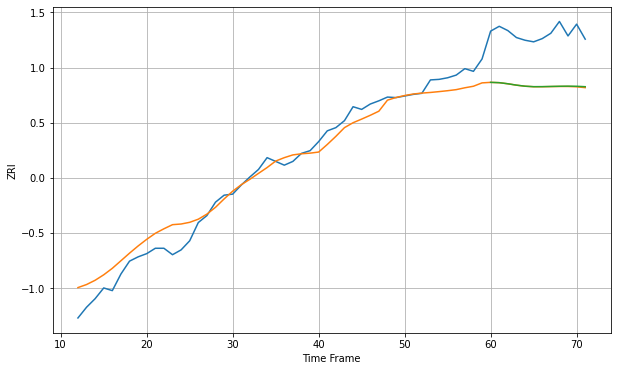

Wall time: 7.04 s
90731 25.070904020920874 98.17781244647672 97.78550681717061 [2016.43033333 2015.86001401 2013.82324088 2011.27186126 2009.29470532
 2008.39500509 2008.46096842 2008.81052947 2009.1484668  2009.35585313
 2009.14745282 2008.34189168]

Got an mse at 0.0050 in round 168 and stopped training

60 60 12


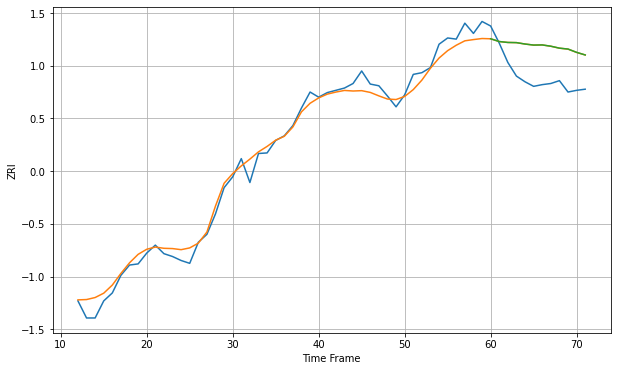

Wall time: 8.99 s
90744 16.712929391027814 58.45339036285615 58.49922274651096 [2200.56792734 2195.73468951 2194.11839025 2193.81578143 2191.34277353
 2189.51670393 2189.78567238 2187.51876179 2184.12510337 2182.53242108
 2176.74052083 2172.14257642]

Got an mse at 0.0049 in round 36 and stopped training

60 60 12


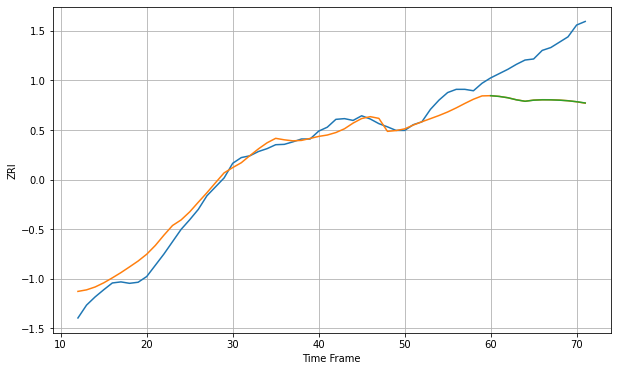

Wall time: 5.95 s
90802 30.62129464237878 143.30501825430017 143.29855405206482 [1968.23721415 1966.16135423 1962.46836369 1956.66914132 1952.57854779
 1955.66715894 1956.69694743 1956.56069135 1955.68076243 1954.06367224
 1951.37761776 1947.86493836]

Got an mse at 0.0050 in round 151 and stopped training

60 60 12


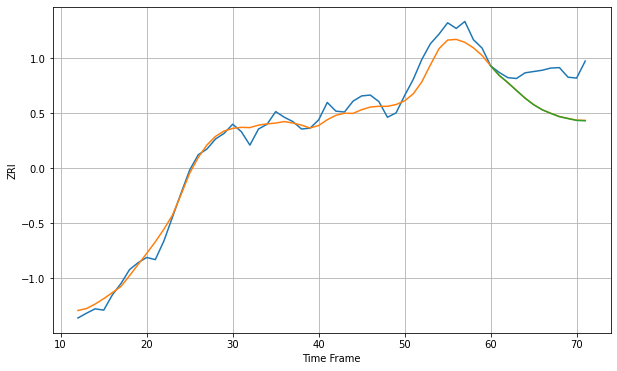

Wall time: 8.47 s
90803 22.85900353485904 80.90326647122484 81.21209287958592 [2100.99481217 2079.11117615 2062.60491033 2044.63877273 2027.03261288
 2011.87573575 2000.10377803 1991.85268877 1984.34376206 1979.93597304
 1975.79458799 1974.96894097]

Got an mse at 0.0049 in round 59 and stopped training

60 60 12


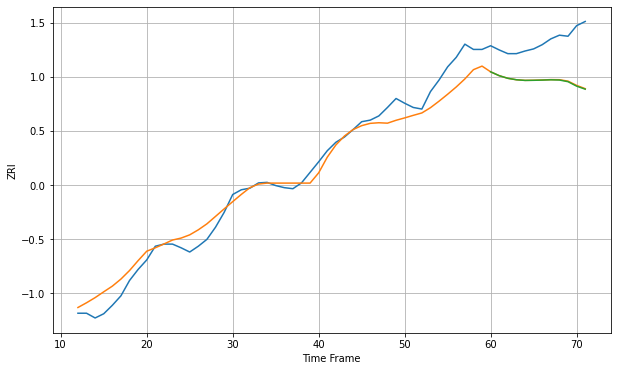

Wall time: 6.59 s
90804 25.555244017688338 76.32496512829829 76.85664005310616 [1907.53865216 1900.22794037 1895.26133793 1892.48881115 1891.26999566
 1891.46836591 1891.8789539  1892.43097303 1892.00122818 1888.85716628
 1880.39652209 1874.66082211]

Got an mse at 0.0050 in round 102 and stopped training

60 60 12


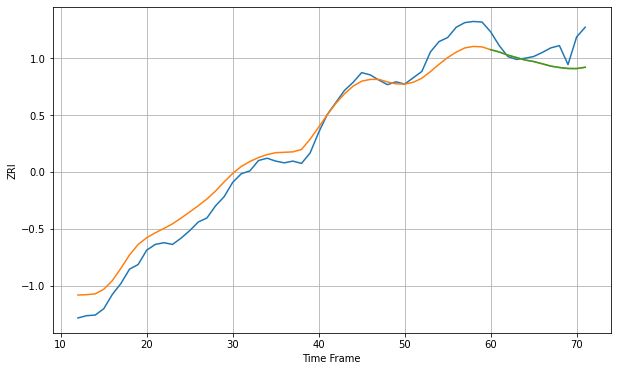

Wall time: 7.34 s
90805 25.72025682001043 31.545289494568603 31.589012047289366 [1936.89047719 1932.95771412 1927.47826785 1923.29314888 1918.91367991
 1916.3048678  1912.36360535 1908.29471212 1905.8864332  1904.16333505
 1903.99241094 1906.23966549]

Got an mse at 0.0049 in round 58 and stopped training

60 60 12


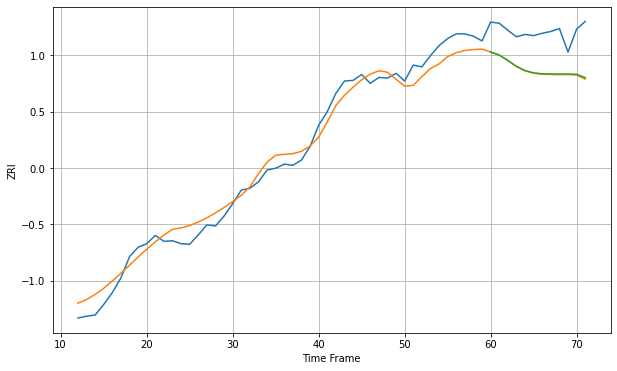

Wall time: 6.55 s
90806 19.822682449916993 65.75702672044166 64.92740253854116 [1891.24589698 1886.03305224 1876.85679517 1866.89651849 1859.67934896
 1855.76846262 1854.22848958 1853.93756795 1853.76659471 1853.74898166
 1853.46661304 1847.70333888]

Got an mse at 0.0050 in round 60 and stopped training

60 60 12


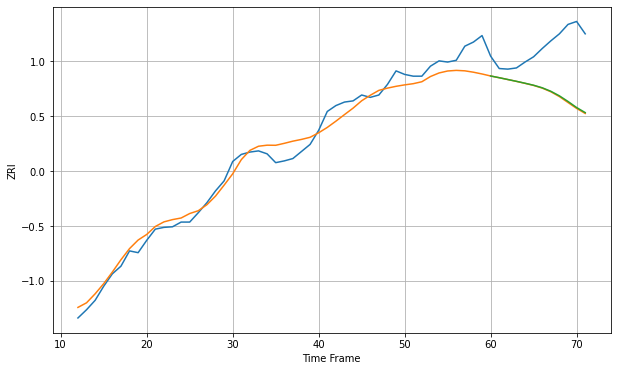

Wall time: 6.26 s
90807 20.109119691121656 85.20065511612559 84.27366021992917 [1870.31984589 1867.40109912 1864.33669916 1861.27033932 1858.01875752
 1854.60296931 1850.27626956 1844.36060936 1836.56691882 1827.02675983
 1816.71335168 1808.1146088 ]

Got an mse at 0.0049 in round 86 and stopped training

60 60 12


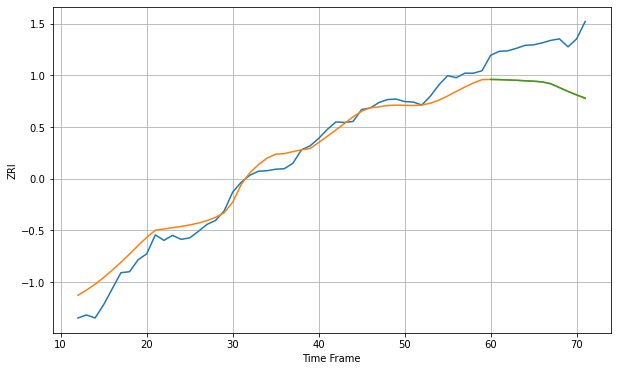

Wall time: 7.03 s
90813 24.8393247524918 87.40061891710852 87.22289063268138 [1806.4764226  1806.13139414 1805.49607896 1804.81773628 1803.8321401
 1802.99920653 1801.53491686 1797.7499783  1790.01151274 1782.27749092
 1775.36248234 1769.17885123]

Got an mse at 0.0050 in round 81 and stopped training

60 60 12


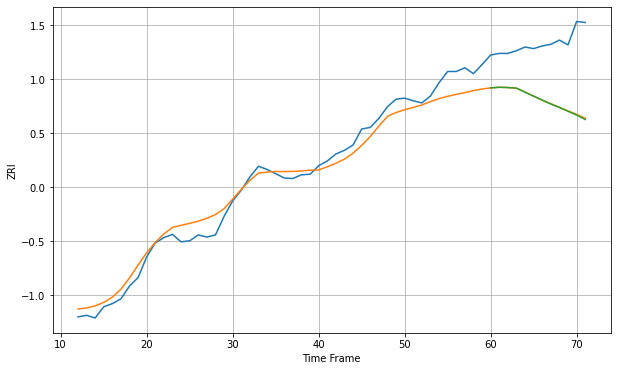

Wall time: 7.34 s
90814 22.00283328857459 111.41606979159825 112.04439752245274 [1909.21655872 1910.36031267 1909.87709526 1908.71509123 1901.27553931
 1893.63256784 1886.13946962 1879.03235369 1872.36454564 1865.32737352
 1858.13745794 1849.94529386]

Got an mse at 0.0050 in round 130 and stopped training

60 60 12


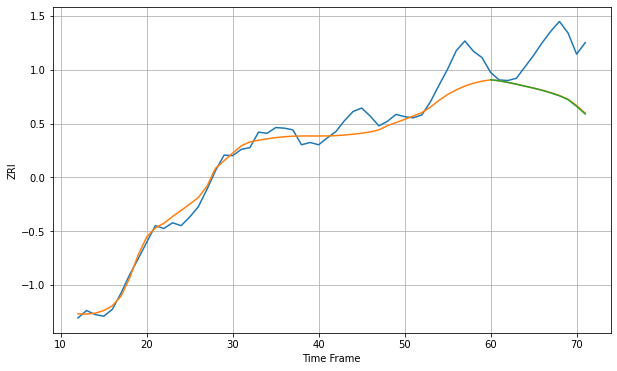

Wall time: 8.42 s
90815 24.008350077500214 79.65959010437132 80.2283102667317 [1894.32752777 1892.53073881 1889.7598591  1886.58262575 1883.12829505
 1879.75144149 1875.97696031 1871.47797786 1866.37497058 1859.69217562
 1847.95010487 1834.66790897]

Got an mse at 0.0049 in round 210 and stopped training

60 60 12


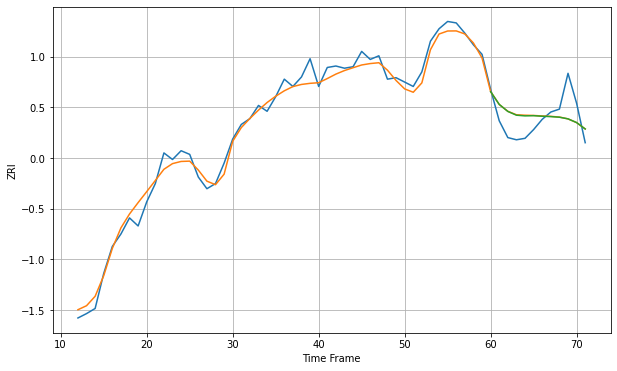

Wall time: 10.7 s
91016 11.866100865738954 28.104579586562753 27.91572464518456 [2236.89136436 2219.40685691 2209.80034864 2204.66138834 2203.70501009
 2204.0016439  2203.21584351 2202.71634435 2201.89203672 2199.64002877
 2194.56074777 2185.77931339]

Got an mse at 0.0050 in round 154 and stopped training

60 60 12


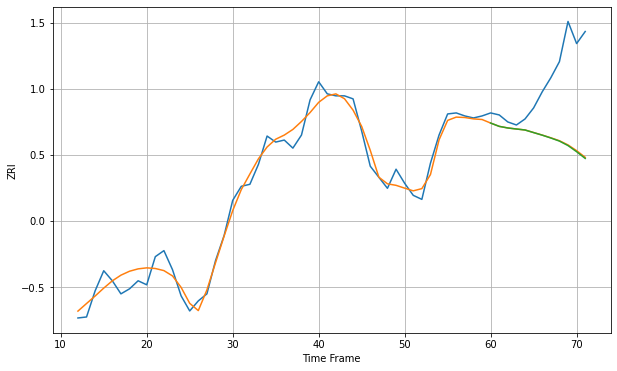

Wall time: 9.18 s
91101 10.227889135428866 67.52574827174223 67.98926700997296 [2141.9277912  2138.63008933 2137.02994927 2135.99862796 2135.02058811
 2132.4363937  2129.8779206  2127.0561248  2123.97771689 2119.51713187
 2113.41685753 2106.72753365]

Got an mse at 0.0050 in round 152 and stopped training

60 60 12


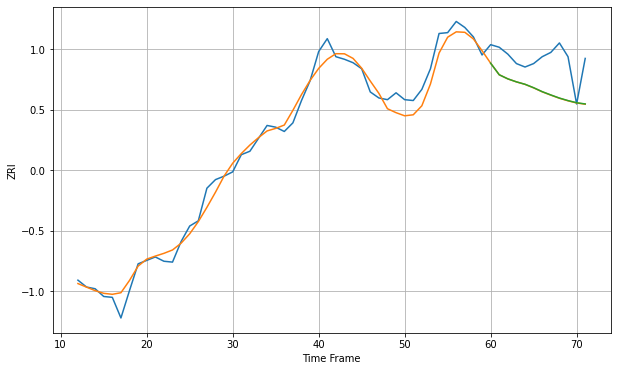

Wall time: 8.76 s
91104 11.716170967343054 38.44928095205166 38.285977057341185 [2042.45771551 2028.9902198  2024.22209438 2020.7434866  2017.91213864
 2013.92725998 2009.33477945 2005.50748503 2001.87963768 1998.93511622
 1996.44138092 1995.03587721]
60 60 12


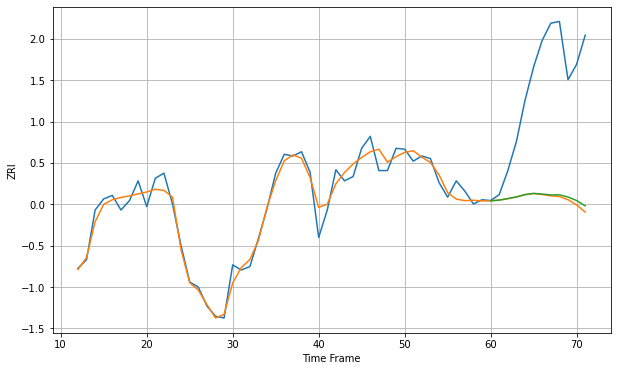

Wall time: 17.2 s
91105 11.61699991778253 142.33797050525465 140.2853322167239 [2643.73099985 2644.54304084 2646.27599942 2648.24798708 2650.98357946
 2652.40683415 2651.59041899 2650.58996196 2650.66891614 2648.18003661
 2644.00645395 2637.80564494]

Got an mse at 0.0050 in round 176 and stopped training

60 60 12


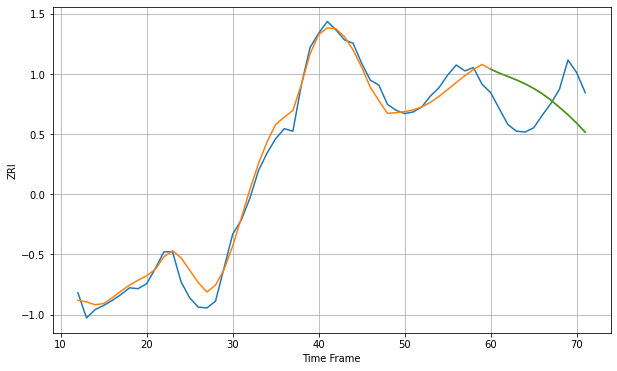

Wall time: 9.81 s
91106 13.054416769258792 46.87293718518071 46.99340568575879 [2225.01965049 2220.38477595 2216.33264491 2212.23307106 2207.61526724
 2202.0905536  2195.71619451 2188.14962845 2179.39133231 2170.39238335
 2160.50180595 2149.71824635]

Got an mse at 0.0050 in round 241 and stopped training

60 60 12


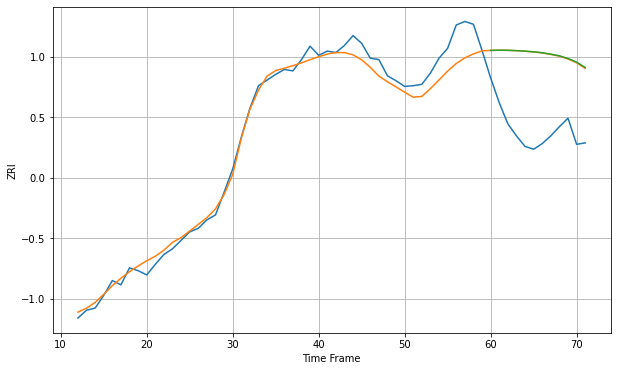

Wall time: 10.9 s
91107 17.38742163385664 108.34535946325154 108.72436307459213 [2210.01521433 2210.28982061 2210.1091035  2209.70397701 2208.93545036
 2208.01558518 2206.70552347 2204.67511427 2202.35955583 2198.5823389
 2193.42627318 2185.86212931]

Got an mse at 0.0050 in round 145 and stopped training

60 60 12


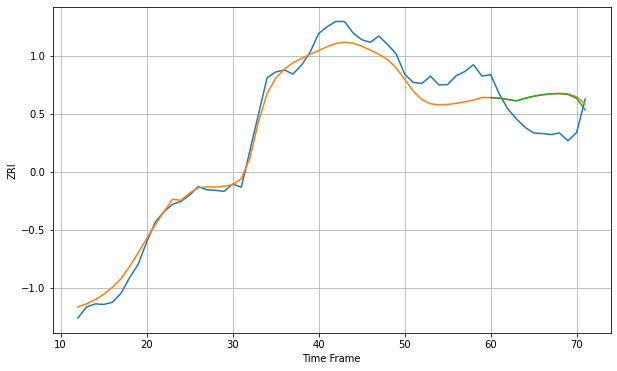

Wall time: 8.55 s
91205 27.098694813027063 59.041061890938984 58.860805768281566 [2310.82341712 2309.76759581 2307.26785327 2304.65161217 2309.61727781
 2313.49682879 2316.30332436 2318.02906943 2318.63042773 2316.94730124
 2309.49617979 2287.32624579]

Got an mse at 0.0050 in round 61 and stopped training

60 60 12


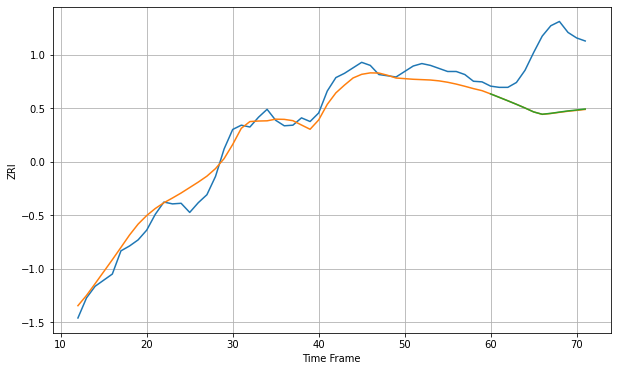

Wall time: 6.66 s
91355 17.765877768434443 99.22509934048034 98.94331817394833 [2211.25462945 2205.64539504 2199.99852492 2194.21382567 2188.1722529
 2181.76331974 2177.9139752  2179.4245422  2181.45441991 2183.39217606
 2184.8768283  2186.52668383]

Got an mse at 0.0050 in round 131 and stopped training

60 60 12


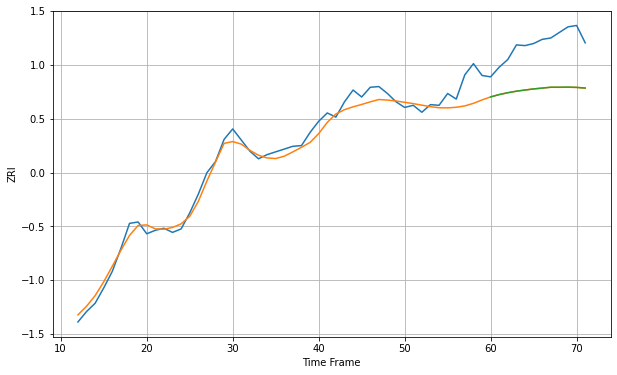

Wall time: 8.3 s
91367 15.63035326453937 66.79422033857595 66.69898321140704 [2245.08719216 2248.49161056 2251.14957455 2253.355657   2255.01943823
 2256.61439934 2257.83601916 2259.0909071  2259.05201056 2259.23594072
 2258.91020555 2257.8892777 ]

Got an mse at 0.0050 in round 172 and stopped training

60 60 12


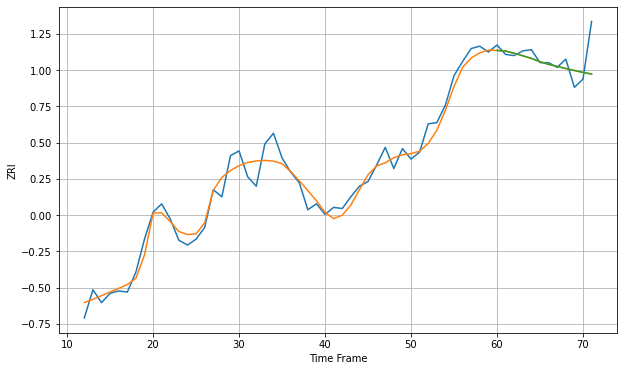

Wall time: 9.06 s
91505 9.233345266216562 14.157805732893278 14.163310596534744 [2330.38326088 2329.84349595 2327.99983863 2325.83573129 2323.61289769
 2320.73861733 2318.51999351 2316.82312335 2314.9786217  2313.32109723
 2311.69196266 2310.31628255]

Got an mse at 0.0050 in round 115 and stopped training

60 60 12


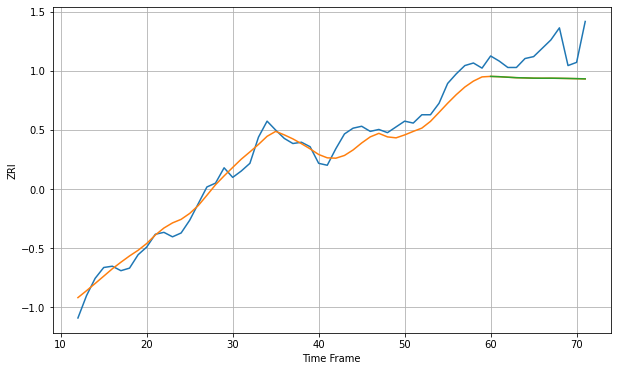

Wall time: 7.88 s
91601 17.436476174166266 45.92562268373445 45.900767075478576 [2319.04006772 2318.57822644 2317.75301372 2317.03339183 2316.69255429
 2316.26478024 2316.1701876  2316.22167524 2316.04557016 2315.83094139
 2315.54350898 2315.19137043]

Got an mse at 0.0049 in round 86 and stopped training

60 60 12


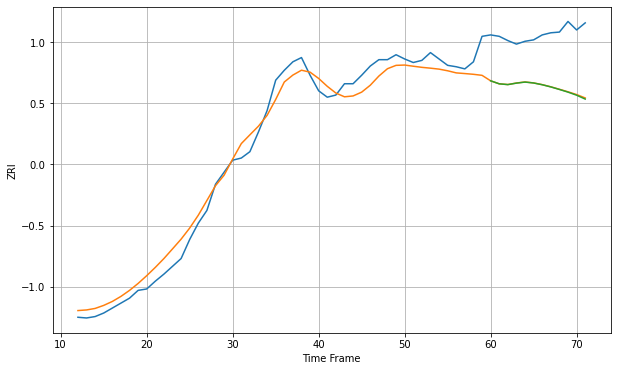

Wall time: 7.04 s
91730 17.48734472826263 76.02225226483823 76.43848362054123 [1640.13495243 1635.8749216  1634.77828013 1636.86043448 1638.3362128
 1637.04899871 1634.58664195 1631.50070613 1627.91330916 1624.14014524
 1619.80567662 1614.33486392]

Got an mse at 0.0050 in round 73 and stopped training

60 60 12


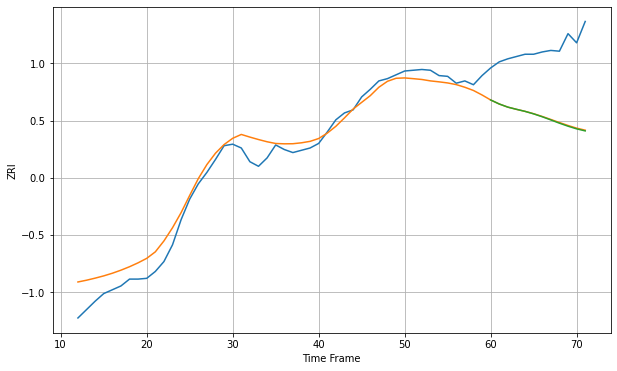

Wall time: 7.2 s
91764 17.702238124995823 89.8388417208746 90.33134181473052 [1619.01459594 1613.74082549 1609.61940154 1606.74971891 1604.04633515
 1600.78523123 1596.98536169 1592.83119122 1588.5541138  1584.6091905
 1581.12001683 1578.41909404]

Got an mse at 0.0050 in round 178 and stopped training

60 60 12


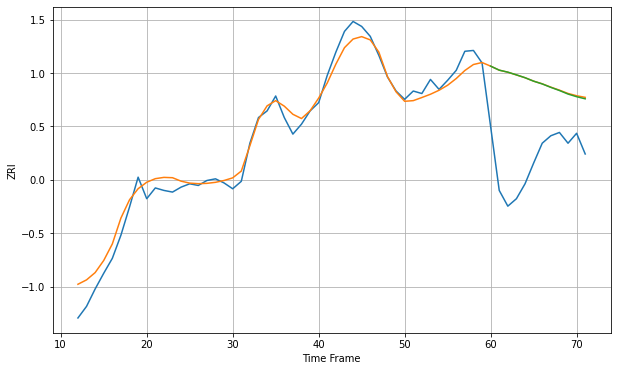

Wall time: 9.85 s
91766 14.057999743773589 101.091149684337 100.90036657890082 [2060.06235812 2055.22365676 2052.7871562  2049.51425111 2046.10364381
 2041.91311078 2038.59672053 2034.44245402 2030.64834924 2026.35709408
 2023.17303518 2020.61275446]

Got an mse at 0.0049 in round 147 and stopped training

60 60 12


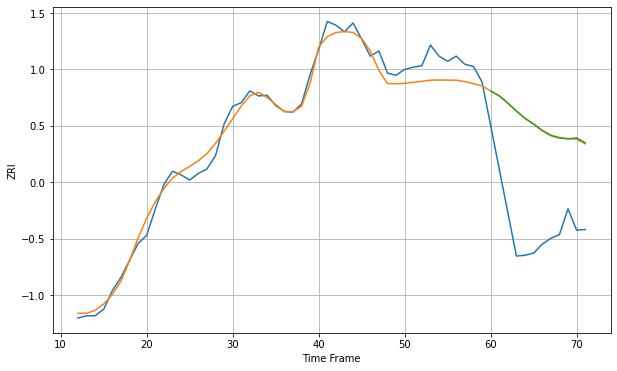

Wall time: 9.1 s
91776 15.913166756939663 140.3501558468052 140.34175348929406 [2192.81321365 2186.19988493 2176.30293796 2165.54757357 2155.59695864
 2147.80081565 2138.90100011 2132.23824469 2128.97424298 2127.84345938
 2129.16989132 2122.47974467]

Got an mse at 0.0050 in round 168 and stopped training

60 60 12


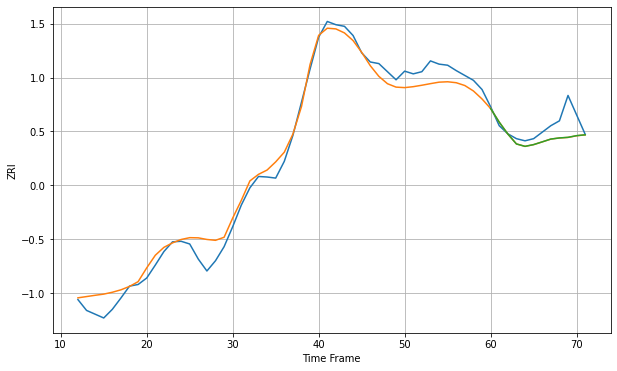

Wall time: 9.31 s
91801 22.33266859254173 28.64950207605187 28.573351650629572 [2157.73196294 2132.57233727 2110.61808228 2092.24289007 2087.74916983
 2090.99527595 2096.06601858 2101.26405181 2103.35223339 2104.47398692
 2107.58362014 2109.19130665]

Got an mse at 0.0050 in round 165 and stopped training

60 60 12


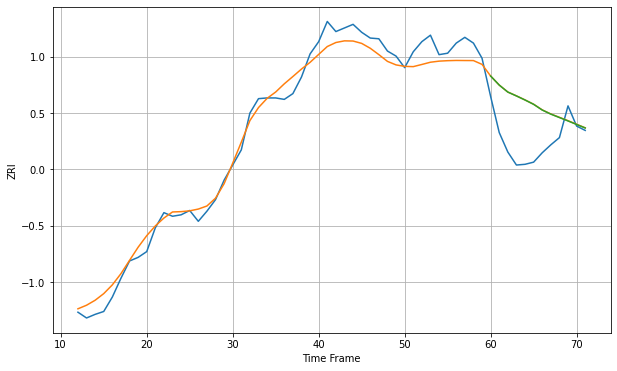

Wall time: 8.97 s
91803 16.91313876443463 59.33878632441584 59.25515803749269 [2073.37736942 2060.81667765 2051.12107272 2045.77490018 2040.13717696
 2034.13924068 2026.24778577 2020.55300527 2015.83178968 2011.12935089
 2006.19200036 2001.35271471]

Got an mse at 0.0050 in round 93 and stopped training

60 60 12


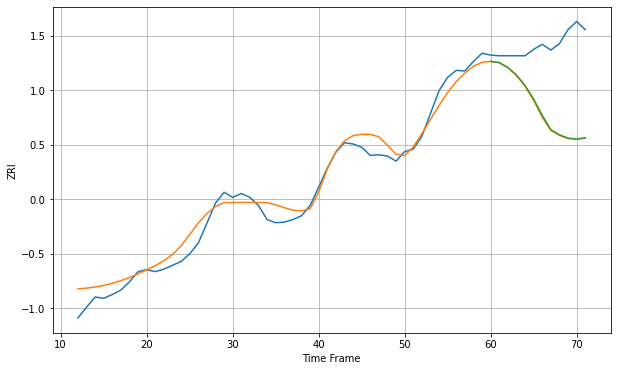

Wall time: 7.38 s
91913 17.898335544645946 113.02203218280604 112.17627579765606 [2233.12324178 2231.16335901 2223.58046922 2211.74233602 2195.23008213
 2173.78826404 2148.1551337  2125.65488703 2117.56043864 2112.2603802
 2110.87491721 2112.67965592]

Got an mse at 0.0049 in round 44 and stopped training

60 60 12


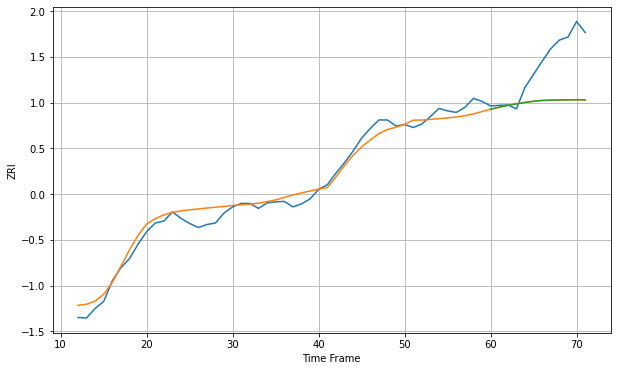

Wall time: 6.48 s
92008 16.861814536392544 87.98793680276856 87.81581568192517 [2038.40649913 2042.35119495 2046.06466353 2049.13198154 2051.92224106
 2054.22510428 2055.86301757 2056.53426529 2056.80715868 2057.05754469
 2057.35993978 2057.0720897 ]

Got an mse at 0.0049 in round 60 and stopped training

60 60 12


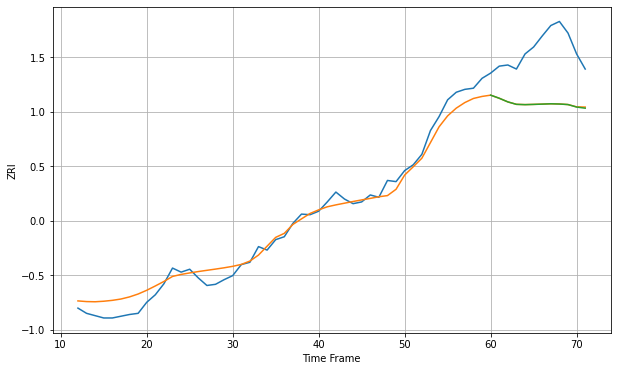

Wall time: 6.53 s
92101 17.678832301149168 95.5663077940173 95.75042010569335 [2302.0151433  2296.67748283 2290.38976987 2286.14872982 2285.63786395
 2286.04616103 2286.54595285 2287.12774248 2286.69840322 2285.78442291
 2281.4973508  2279.54182847]

Got an mse at 0.0049 in round 73 and stopped training

60 60 12


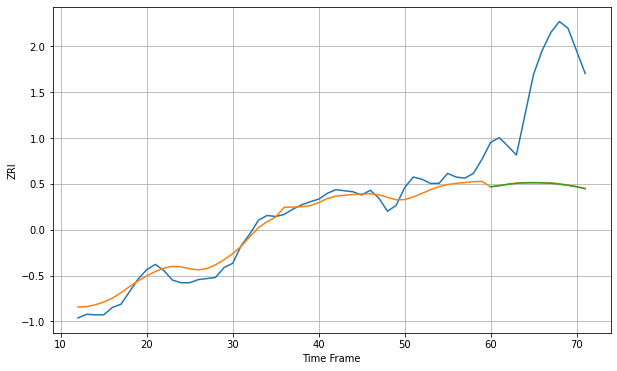

Wall time: 6.88 s
92103 17.379022594571644 209.5089492672653 209.97962469872317 [1962.47573132 1964.65936669 1967.27417845 1969.18079379 1970.02072447
 1970.17243101 1969.87937302 1969.24660358 1967.50637534 1965.27340986
 1962.46151896 1958.6972497 ]

Got an mse at 0.0050 in round 53 and stopped training

60 60 12


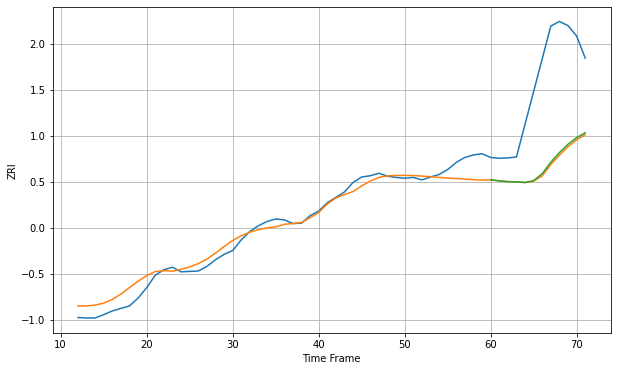

Wall time: 6.25 s
92104 23.49136878723254 214.72970967370526 211.0876441471113 [1758.28243463 1755.78850152 1753.78751916 1753.5824998  1751.81734601
 1756.26554949 1772.91141698 1800.44025564 1823.62632925 1843.61944353
 1859.52305897 1871.38870717]

Got an mse at 0.0049 in round 44 and stopped training

60 60 12


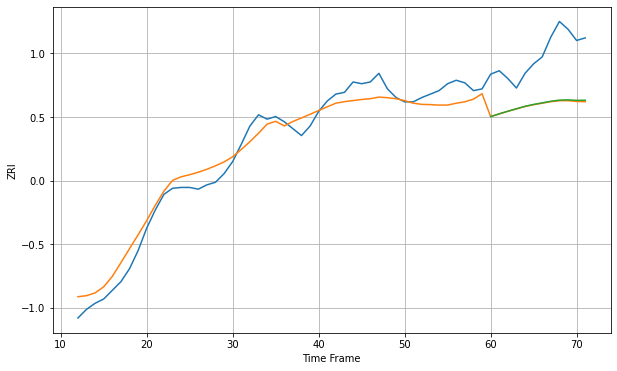

Wall time: 7.1 s
92108 15.118081339332567 61.059771774134994 60.45673248202861 [1951.92599946 1955.1410557  1958.16528991 1961.0270521  1963.82702487
 1966.03584515 1967.82373879 1969.71342746 1970.98827128 1971.33004663
 1970.72279729 1970.90010885]

Got an mse at 0.0050 in round 78 and stopped training

60 60 12


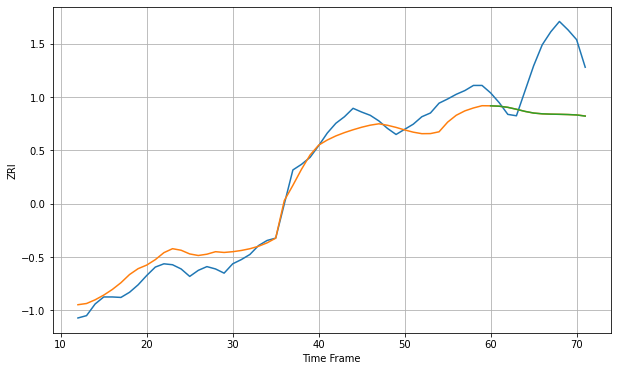

Wall time: 7.17 s
92117 30.064311975282315 121.00199779152463 121.02227041173569 [2144.35606644 2143.50890121 2141.09138722 2136.97652495 2132.40646771
 2128.87648545 2127.22149483 2126.51240194 2126.17417938 2125.67922045
 2124.78993518 2122.31427172]

Got an mse at 0.0050 in round 79 and stopped training

60 60 12


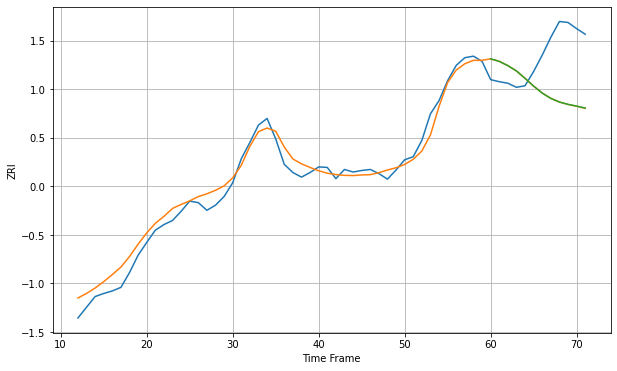

Wall time: 7.07 s
92122 19.62806705037131 100.53253716296163 100.42049476808886 [2452.75096348 2447.83668448 2439.47713799 2429.08049597 2414.53699759
 2399.30765172 2385.69302593 2375.30453018 2368.15172128 2363.54891291
 2360.19285178 2356.23561288]

Got an mse at 0.0050 in round 43 and stopped training

60 60 12


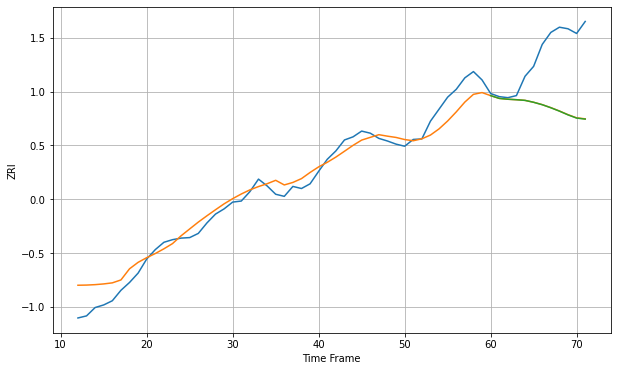

Wall time: 6.56 s
92123 25.045038654723406 113.567348970732 113.80211880915948 [2255.94341524 2250.6373857  2249.02003438 2248.11035658 2246.82045692
 2243.17297252 2238.55417953 2232.73299204 2226.23068525 2219.08196648
 2212.92108039 2210.95066497]

Got an mse at 0.0050 in round 104 and stopped training

60 60 12


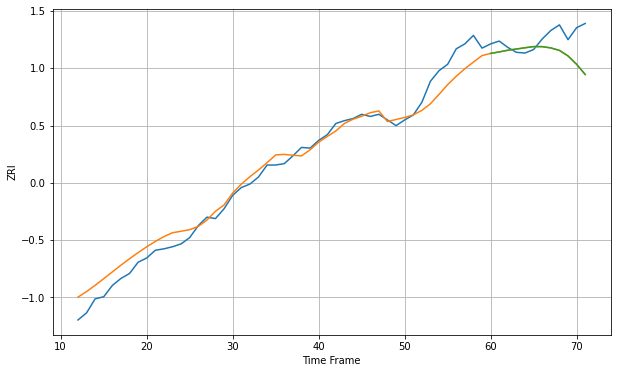

Wall time: 7.68 s
92126 17.415530533736135 30.376612044710704 30.348651101716204 [2072.4863706  2074.60626892 2076.96287337 2078.70972415 2080.48189516
 2082.16617917 2082.08442739 2080.27456409 2076.75260435 2068.92376084
 2057.03875218 2042.58293044]

Got an mse at 0.0050 in round 94 and stopped training

60 60 12


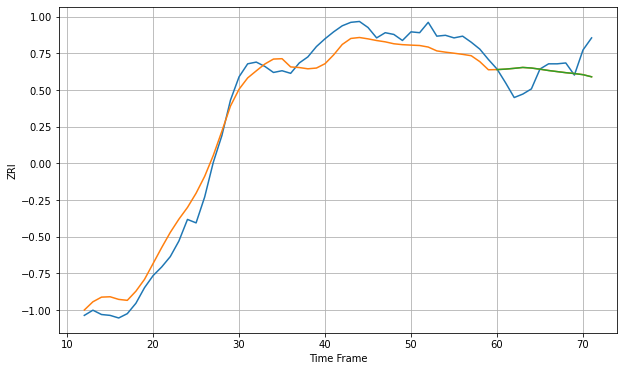

Wall time: 7.45 s
92128 17.39835002987735 22.418016212957568 22.43667177254415 [2159.31739443 2159.88849567 2160.77344117 2161.81536606 2161.13408918
 2159.80619198 2158.26365688 2157.00218779 2155.75137329 2154.7409043
 2153.43812274 2150.9548905 ]

Got an mse at 0.0050 in round 152 and stopped training

60 60 12


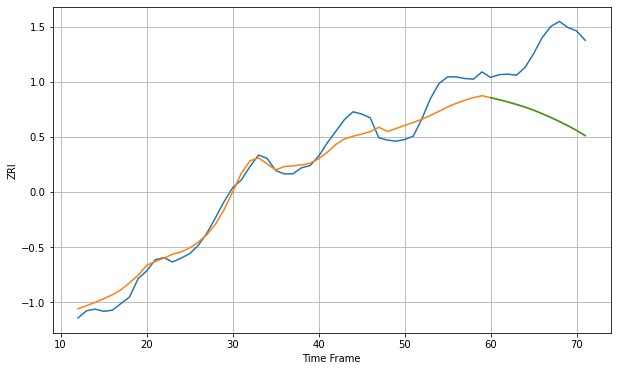

Wall time: 9.43 s
92130 23.46704986129791 127.77085648825984 127.74791324786305 [2540.56866439 2536.83270764 2532.78997844 2528.29240193 2523.49187629
 2517.93552257 2511.60758567 2504.76789379 2497.53279626 2489.74716147
 2481.38395126 2472.1292535 ]

Got an mse at 0.0048 in round 176 and stopped training

60 60 12


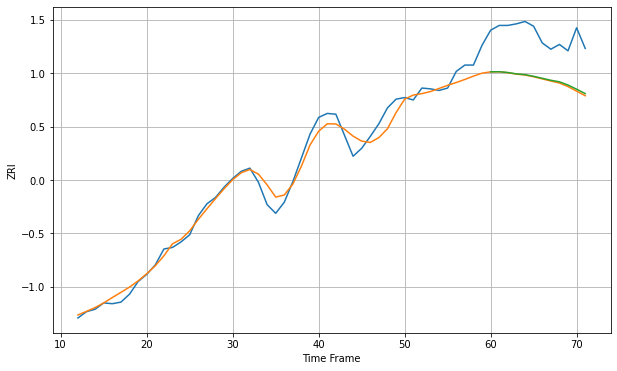

Wall time: 9.61 s
92410 11.97761717074364 58.0339124272747 57.02579186586369 [1274.44627263 1274.62835623 1273.61009624 1271.89079539 1270.95371784
 1268.82561617 1266.3478541  1263.80762135 1261.87983401 1257.81170596
 1252.53746246 1247.05995333]

Got an mse at 0.0050 in round 27 and stopped training

60 60 12


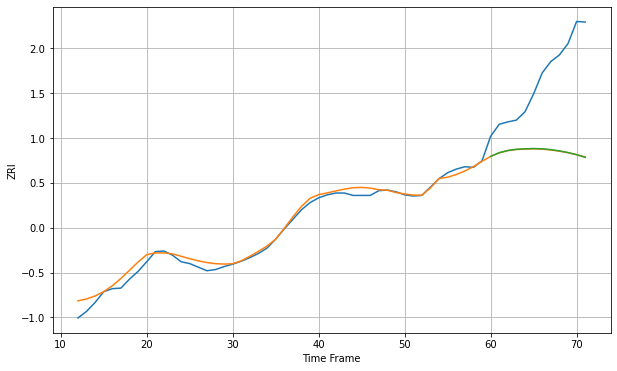

Wall time: 6.2 s
92507 8.863301900962538 134.90510500703553 134.8152703938054 [1484.296467   1490.39439284 1494.16335958 1496.17582388 1496.96885585
 1497.47668651 1496.94711295 1495.5979549  1493.47287415 1490.70076364
 1487.08135593 1482.64044328]

Got an mse at 0.0049 in round 219 and stopped training

60 60 12


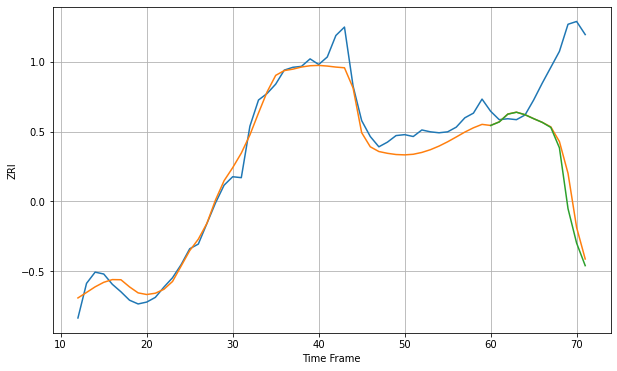

Wall time: 10.7 s
92602 14.57657976728857 110.78679212118203 120.16201273096596 [2457.81889936 2461.56420077 2469.90940211 2471.97390066 2469.3058389
 2465.09052869 2461.13421463 2455.71748111 2433.90592154 2368.87481489
 2332.06076164 2307.94852704]

Got an mse at 0.0050 in round 180 and stopped training

60 60 12


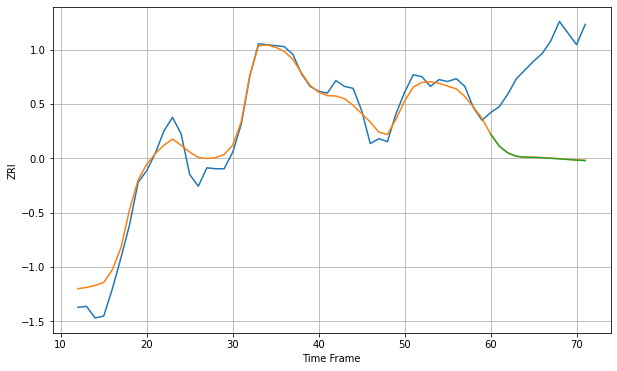

Wall time: 9.51 s
92603 13.402013536880952 102.96626783919825 103.11191498588568 [2871.76906068 2859.38402681 2852.34997295 2848.86858358 2847.86663237
 2847.76310548 2847.35758937 2846.79651897 2846.22145794 2845.55889354
 2844.87980887 2844.33498028]

Got an mse at 0.0049 in round 55 and stopped training

60 60 12


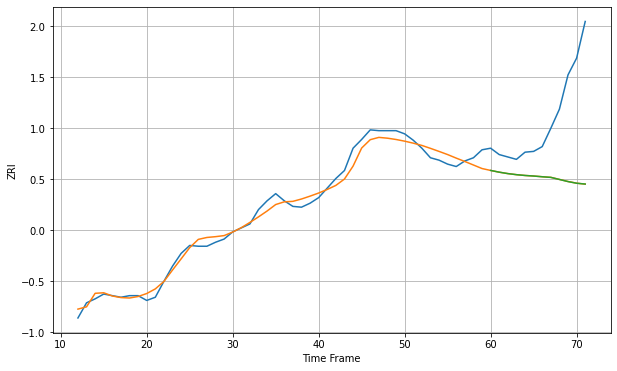

Wall time: 6.58 s
92612 9.063531999064978 91.75538131033056 91.76746730361427 [2384.09842622 2381.9170483  2380.13980623 2378.79188096 2377.78524215
 2377.08569747 2376.17332302 2375.37805479 2372.77407142 2370.12681937
 2368.04104028 2367.0252791 ]

Got an mse at 0.0049 in round 90 and stopped training

60 60 12


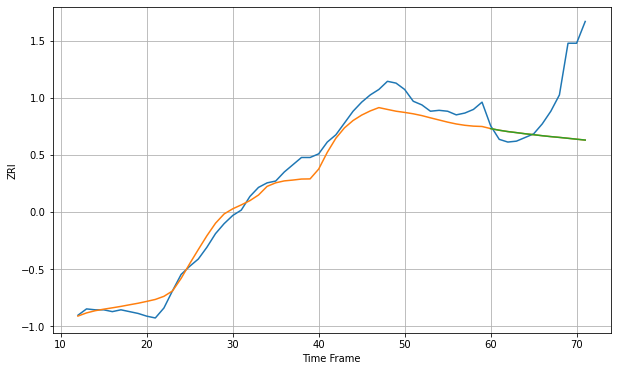

Wall time: 8.02 s
92618 13.959555975309677 59.721749458198616 59.72556819224608 [2097.84886056 2096.04470746 2094.57048669 2093.40616999 2092.167481
 2091.12412071 2089.99888057 2089.00576284 2088.13566397 2087.15813924
 2086.15633269 2085.1919774 ]

Got an mse at 0.0049 in round 280 and stopped training

60 60 12


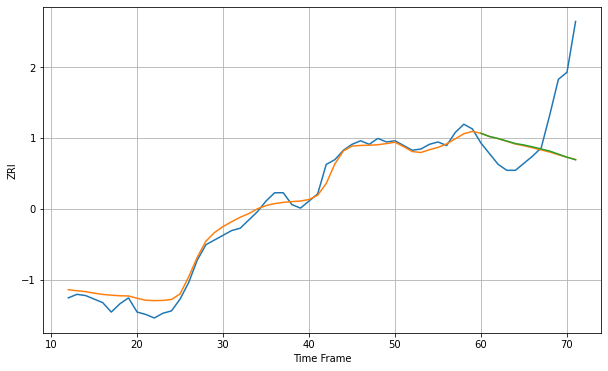

Wall time: 12.1 s
92620 6.646248448883343 46.56591858848451 46.56739844781704 [1925.31289669 1922.59091611 1920.89375128 1918.77775419 1916.68616659
 1915.43394655 1913.83693906 1912.06070387 1910.25984387 1907.71300636
 1905.11428663 1902.89289798]

Got an mse at 0.0050 in round 115 and stopped training

60 60 12


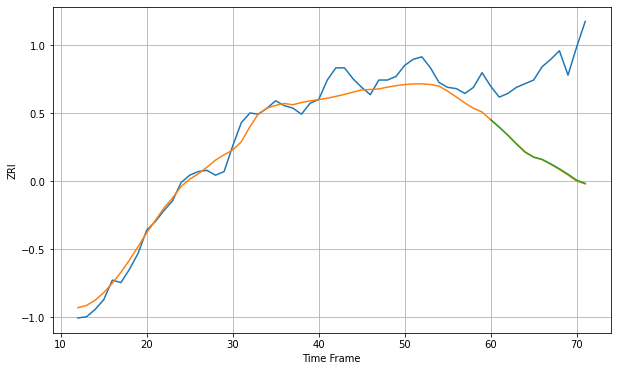

Wall time: 8.11 s
92626 10.821421948886268 76.88150625695148 76.59242387120375 [2181.52641983 2175.40224223 2168.86393085 2161.64086201 2154.94226852
 2150.75822955 2148.89954142 2145.3076727  2141.25405727 2136.80610117
 2132.02643648 2129.26494503]

Got an mse at 0.0049 in round 364 and stopped training

60 60 12


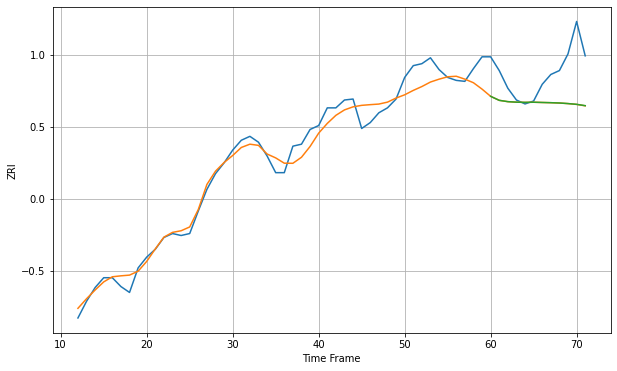

Wall time: 13.8 s
92627 12.080037138031402 37.96481566100263 37.92098141511466 [2273.74754614 2269.67540449 2268.33792956 2267.80997373 2267.59155471
 2267.74363664 2267.49242412 2267.27283572 2266.95774526 2266.37442439
 2265.59894023 2264.25997401]

Got an mse at 0.0050 in round 43 and stopped training

60 60 12


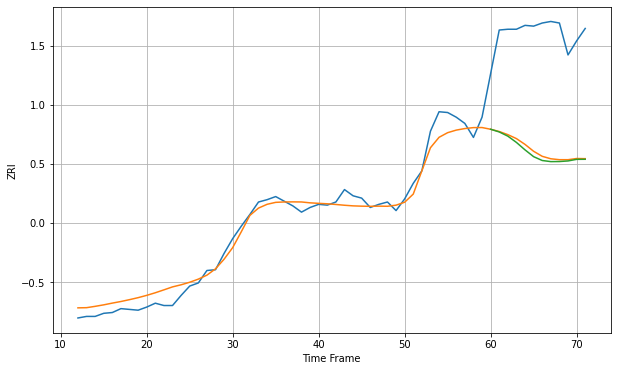

Wall time: 6.09 s
92647 12.382023568597718 149.9178033800057 153.10404767919147 [2103.49470053 2100.03870075 2094.65195769 2086.57033217 2076.99467323
 2068.27673512 2063.34604217 2061.91538    2062.02133217 2062.76998882
 2064.83435819 2064.91443795]

Got an mse at 0.0050 in round 90 and stopped training

60 60 12


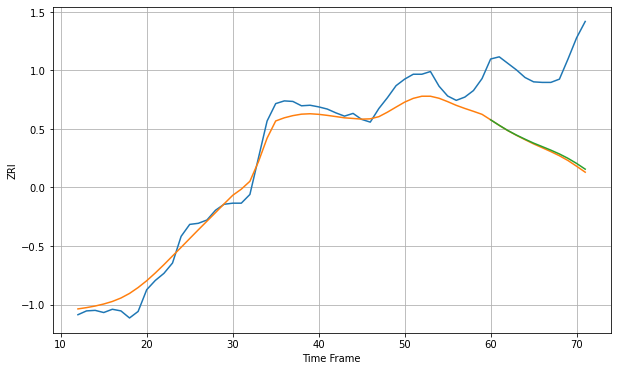

Wall time: 7.65 s
92648 25.124893618521295 158.6260044236763 156.04012257284018 [2258.23063883 2248.11082614 2238.5600391  2230.1948962  2222.61136104
 2215.374599   2209.00058177 2202.50941906 2195.48546731 2187.39130891
 2178.05289353 2167.53158821]

Got an mse at 0.0049 in round 463 and stopped training

60 60 12


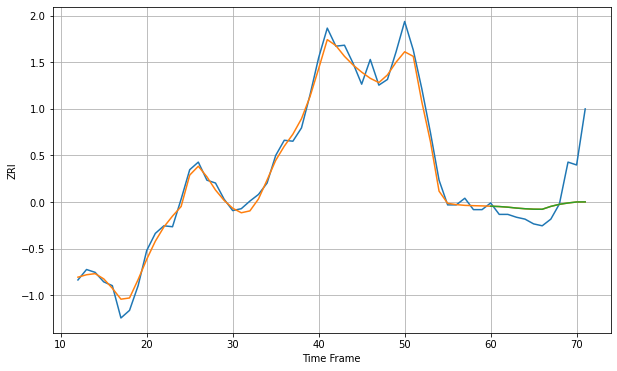

Wall time: 16.6 s
92651 9.343376712350437 34.186644556740376 34.17262215630404 [2563.60905965 2563.24606745 2562.60288045 2561.65329637 2560.94465828
 2560.48461625 2560.39091638 2563.41947058 2565.59803039 2567.0116654
 2568.07234435 2568.13721177]

Got an mse at 0.0049 in round 56 and stopped training

60 60 12


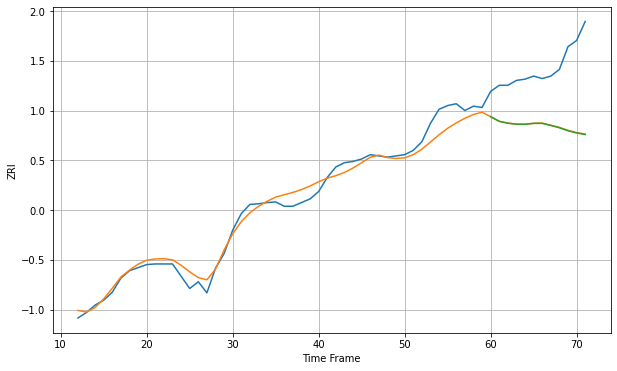

Wall time: 6.4 s
92656 15.018034761241 100.24866130658384 100.65631191821358 [2223.93533879 2216.32069455 2213.34643823 2211.66941666 2211.50487839
 2213.009125   2213.00180567 2209.62096847 2205.8309067  2200.9562842
 2197.4098376  2194.80621544]

Got an mse at 0.0050 in round 121 and stopped training

60 60 12


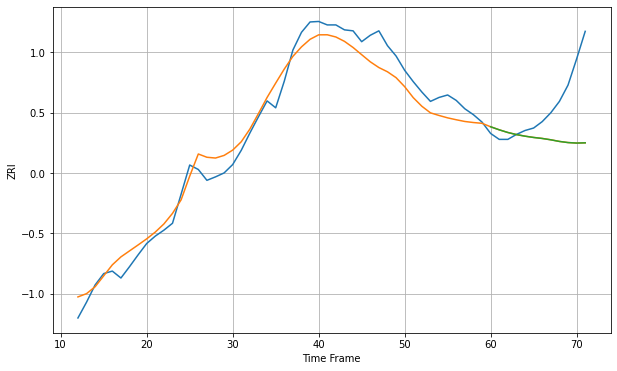

Wall time: 8.08 s
92660 31.035852473655396 93.83856849826249 93.86162436646582 [2886.55800667 2880.37548208 2874.95622173 2870.72050654 2867.46992766
 2864.86299431 2862.83820997 2860.11113565 2856.8143869  2854.52487051
 2853.52958155 2854.0149004 ]

Got an mse at 0.0050 in round 264 and stopped training

60 60 12


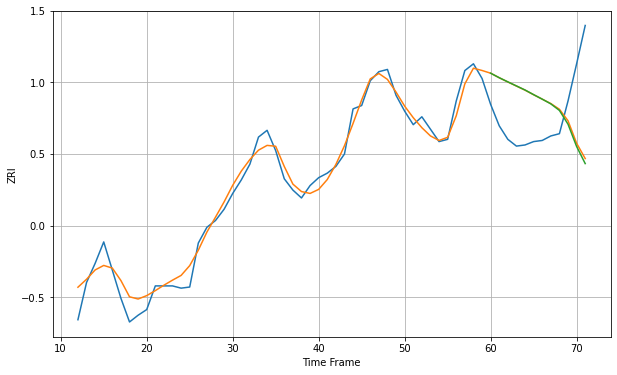

Wall time: 11.9 s
92663 9.991817610365779 53.18444043064241 54.42065214329882 [2342.66472843 2338.65129991 2334.96575156 2331.37500526 2327.76480203
 2323.64815037 2319.64138557 2315.44781939 2309.63217662 2297.42123832
 2277.63704238 2262.47376057]

Got an mse at 0.0050 in round 151 and stopped training

60 60 12


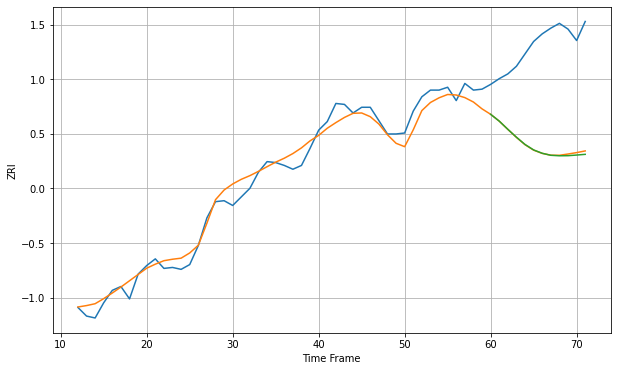

Wall time: 9.67 s
92672 11.165862264849224 106.47152645242635 107.2690008582925 [2200.62668399 2193.47425927 2184.90272858 2176.61004583 2168.98596882
 2163.26188294 2159.7441896  2157.63561465 2157.12871881 2157.22438035
 2157.88247623 2158.63803378]

Got an mse at 0.0050 in round 88 and stopped training

60 60 12


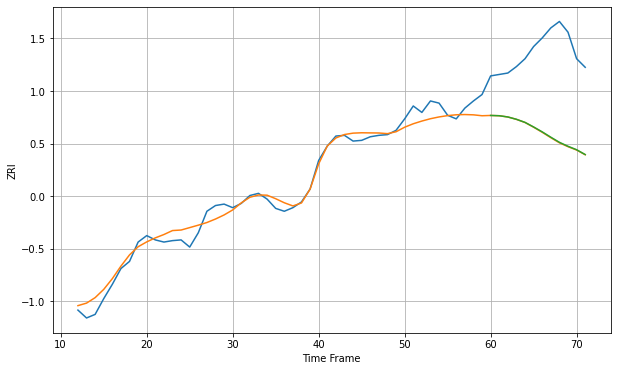

Wall time: 7.91 s
92673 12.580380678911702 116.36159110941279 115.97098971872884 [2182.76830261 2182.38454296 2180.65584511 2177.40742773 2173.10068113
 2166.68938262 2159.8583054  2152.39873501 2145.26276997 2139.71342308
 2134.91017175 2128.1646705 ]

Got an mse at 0.0050 in round 265 and stopped training

60 60 12


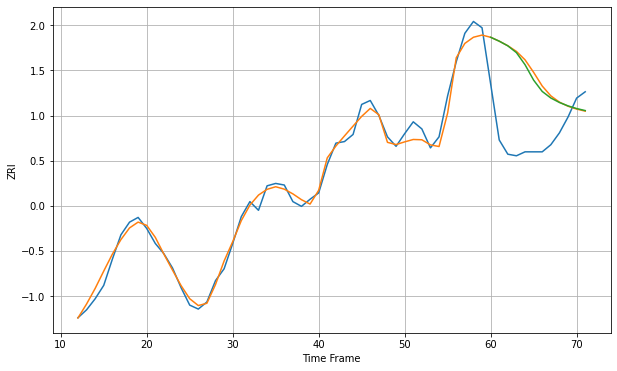

Wall time: 11.5 s
92677 9.636027567767968 87.73336743425703 85.20729502137746 [2454.98607787 2450.05650043 2444.14940366 2435.54070394 2420.28749945
 2400.75529774 2386.4114371  2378.12891515 2372.4633266  2368.1570612
 2364.79572525 2362.2285501 ]

Got an mse at 0.0050 in round 249 and stopped training

60 60 12


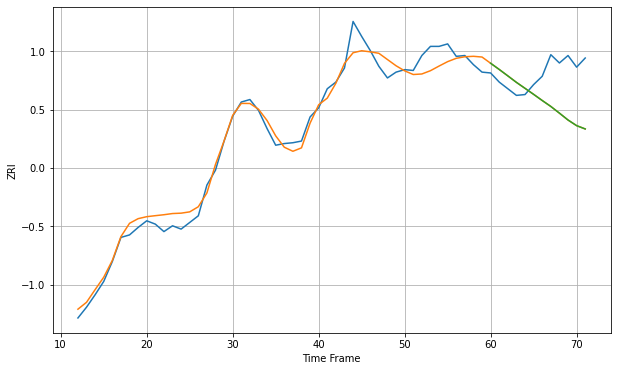

Wall time: 11.6 s
92691 12.977862264927156 48.06195326857012 48.049946556139965 [2127.67260147 2120.21163363 2112.48128628 2104.66584517 2097.47325272
 2090.23649863 2082.83069648 2075.67534047 2067.63135199 2059.39480181
 2052.57844393 2048.57600405]

Got an mse at 0.0050 in round 108 and stopped training

60 60 12


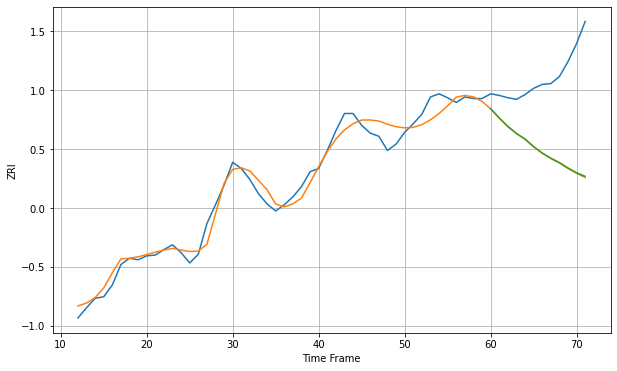

Wall time: 7.58 s
92692 12.985893894186896 102.90051339486601 102.37162817807041 [2163.00637101 2151.3106502  2140.53244244 2131.54188934 2124.49579911
 2114.83694963 2106.7360054  2100.1764183  2094.60096451 2087.77171929
 2081.59702544 2077.08757752]

Got an mse at 0.0049 in round 90 and stopped training

60 60 12


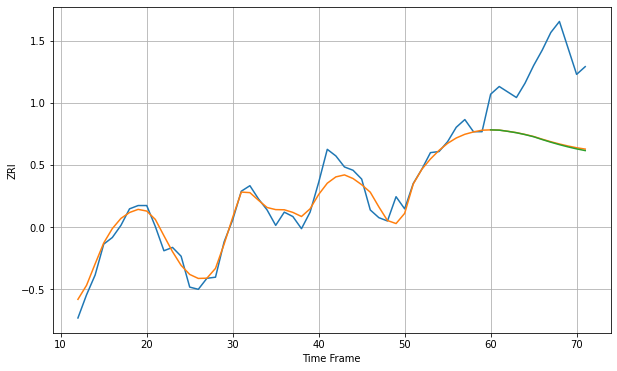

Wall time: 7.26 s
92707 9.647284556950629 69.42847780943487 69.91526686182056 [2158.65818559 2158.40933413 2157.31521704 2156.05141136 2154.3717533
 2152.42783453 2149.87093214 2147.46399397 2145.24551629 2143.21551694
 2141.41000718 2139.85290943]

Got an mse at 0.0050 in round 191 and stopped training

60 60 12


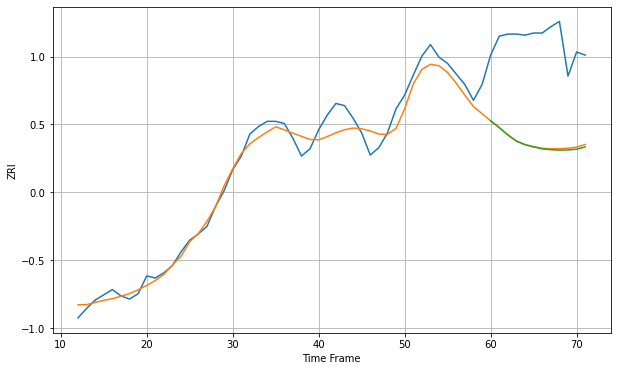

Wall time: 9.81 s
92780 11.296034595162844 97.3568298807987 98.10633522177758 [2076.47989646 2070.06996507 2063.10180614 2057.21348812 2053.79843233
 2051.6919519  2049.85124555 2049.039301   2048.63331851 2048.84605318
 2049.51219742 2051.6767133 ]

Got an mse at 0.0050 in round 89 and stopped training

60 60 12


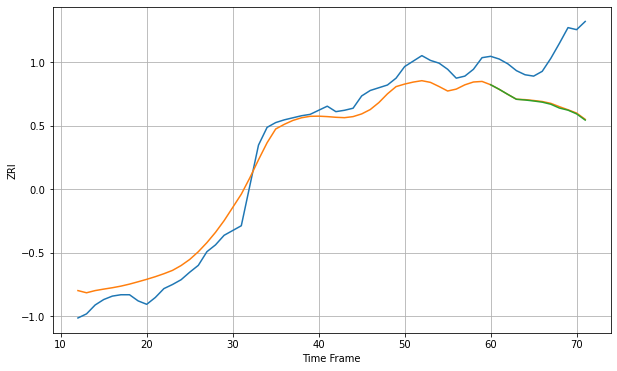

Wall time: 7.71 s
92782 23.03325875054723 78.97401575428336 79.73692904578556 [2357.39154219 2350.64482802 2343.23299494 2336.11824974 2335.07676162
 2333.6224768  2331.91263798 2328.84182346 2323.24609874 2320.18278275
 2314.70879786 2305.66233851]

Got an mse at 0.0049 in round 54 and stopped training

60 60 12


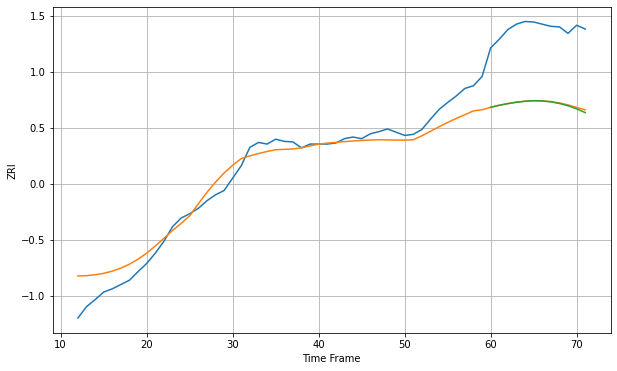

Wall time: 6.33 s
92805 27.172692681537807 139.05724634796454 140.1291640036098 [1913.07163355 1916.79177161 1919.88273552 1922.40754104 1924.21596607
 1925.14006123 1924.77885654 1923.0851895  1920.17114108 1915.95832523
 1910.17273288 1903.29175102]

Got an mse at 0.0048 in round 44 and stopped training

60 60 12


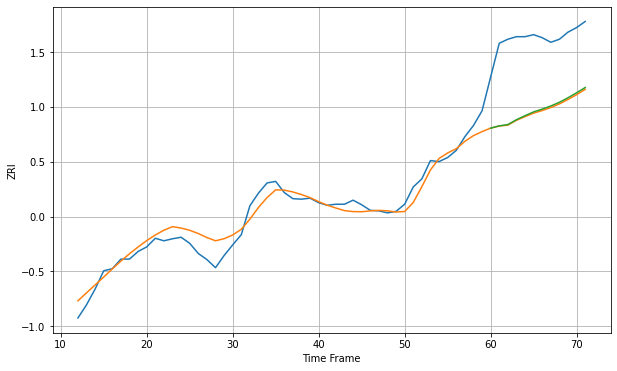

Wall time: 6.56 s
92806 20.389430150515576 143.58504179869604 141.41651628197243 [2167.88380172 2172.37253843 2174.92641392 2184.45005724 2192.40442861
 2199.89853164 2205.34772601 2211.53276708 2218.82031744 2227.75188191
 2237.53928707 2247.93387599]

Got an mse at 0.0049 in round 62 and stopped training

60 60 12


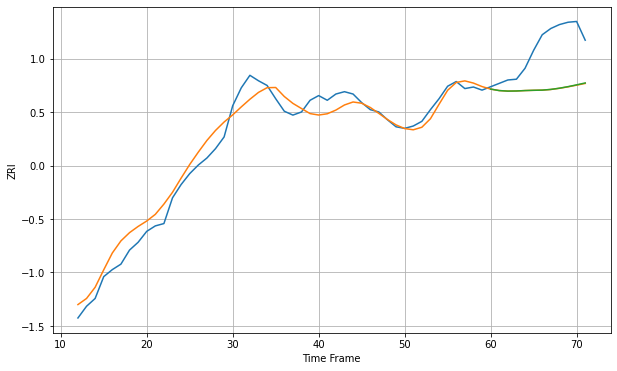

Wall time: 6.67 s
92832 15.201612523951074 56.55365649749843 56.38888702554434 [1952.3400832  1950.42953575 1949.75337976 1949.91683912 1950.45034893
 1950.78104776 1951.01274728 1951.91366051 1953.48178676 1955.46380765
 1957.77754075 1960.20888063]

Got an mse at 0.0050 in round 118 and stopped training

60 60 12


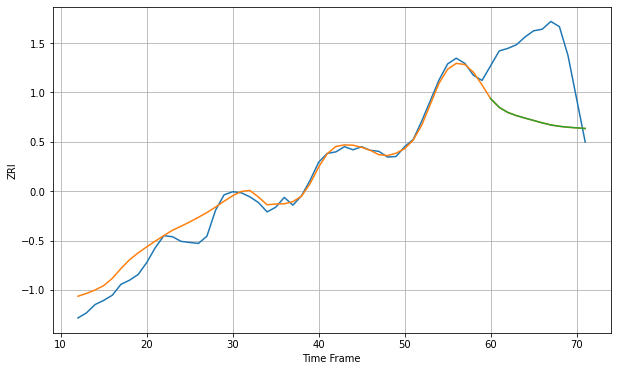

Wall time: 8.3 s
93001 20.52900112707929 140.68677035548245 140.64107541347707 [2139.82299421 2123.080361   2113.21475051 2107.13130514 2102.22765525
 2097.71346539 2093.08954127 2089.03174012 2086.4303504  2084.62771203
 2083.43381487 2082.26406929]

Got an mse at 0.0050 in round 139 and stopped training

60 60 12


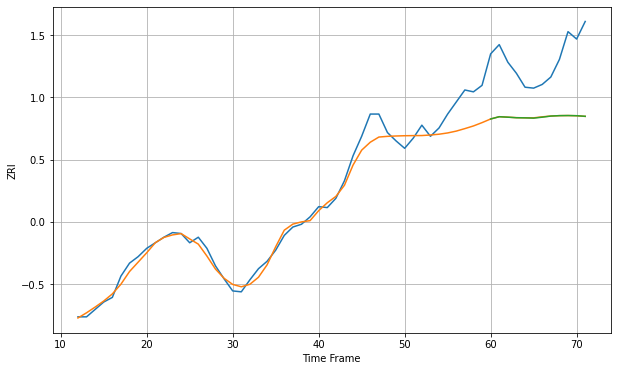

Wall time: 8.68 s
93010 13.822343939660886 65.32721833018557 65.34781602854802 [2012.67249106 2015.13114149 2014.62576328 2014.04418513 2013.90635581
 2013.60531057 2014.62694478 2015.83366016 2016.28886552 2016.40887869
 2016.22645049 2015.57170869]

Got an mse at 0.0049 in round 42 and stopped training

60 60 12


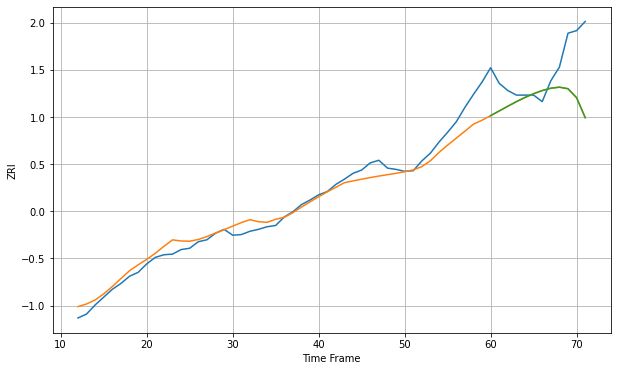

Wall time: 6.43 s
93030 16.498400497266154 63.78600449791047 63.89070523840331 [1839.48203114 1846.72012555 1853.95766927 1860.96252932 1867.41806797
 1873.17440736 1877.98443702 1881.57922778 1883.17509678 1880.7814146
 1867.01459271 1836.15493555]

Got an mse at 0.0049 in round 173 and stopped training

60 60 12


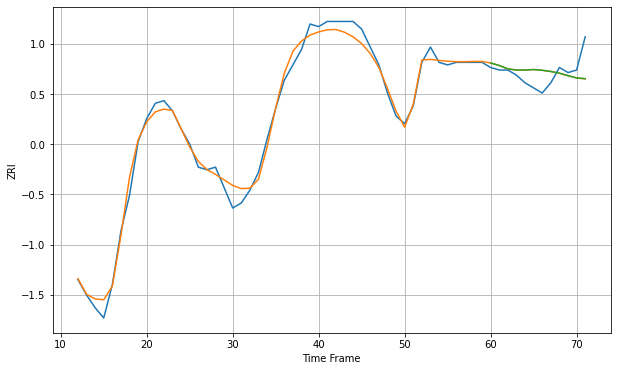

Wall time: 9.27 s
93304 3.2678048944646236 6.277018896913628 6.26075542909189 [882.76401719 881.77241068 880.45105538 879.99802579 880.00875681
 880.18359394 879.89781729 879.43536471 878.75929679 877.80435189
 876.91739906 876.61623013]

Got an mse at 0.0049 in round 211 and stopped training

60 60 12


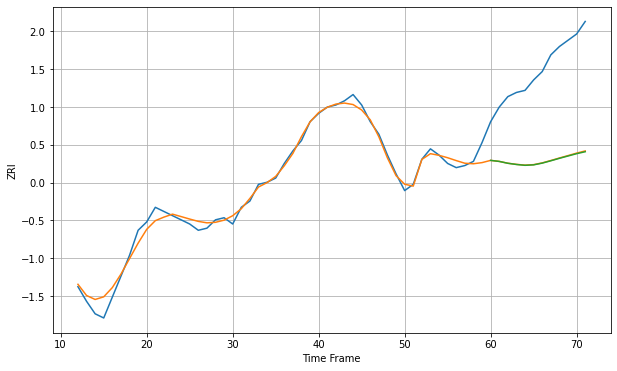

Wall time: 10.1 s
93305 3.252558380342144 44.3682242743464 44.51789519861584 [784.46942358 783.97756999 783.0846108  782.50799152 782.111857
 782.32592377 783.15850591 784.27930022 785.45949796 786.57289954
 787.67336676 788.62068375]

Got an mse at 0.0050 in round 159 and stopped training

60 60 12


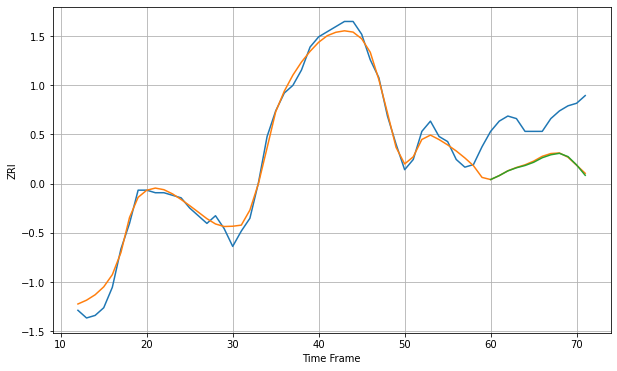

Wall time: 8.8 s
93307 3.6848849728351705 19.169029184279697 19.356918694830107 [850.15339588 851.68928096 853.53391063 854.75674582 855.65075215
 856.90404875 858.68228092 859.84744265 860.41605506 859.12066243
 855.8690076  851.82209416]

Got an mse at 0.0049 in round 185 and stopped training

60 60 12


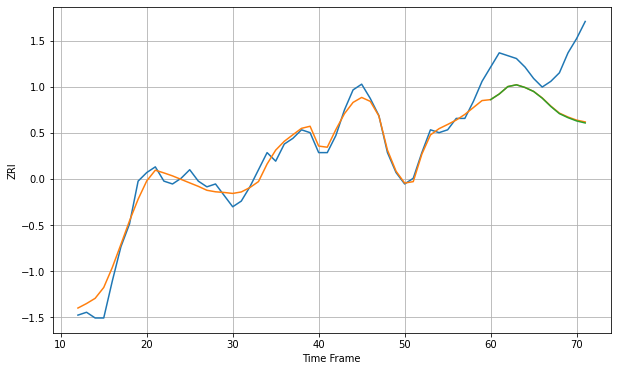

Wall time: 9.49 s
93308 3.2661989658099717 17.003636575834893 17.154528868252303 [843.58780989 845.5555795  848.15336642 848.78007223 847.83572742
 846.4467589  844.09540872 841.18522787 838.66715509 837.25489106
 836.11204721 835.39790251]

Got an mse at 0.0050 in round 135 and stopped training

60 60 12


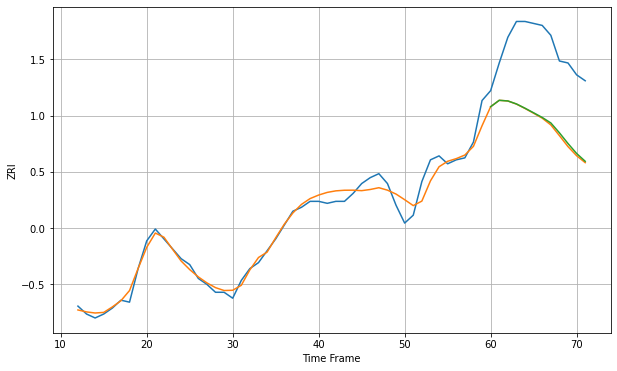

Wall time: 8.41 s
93309 4.412997456020614 38.809654658651944 38.21777377702302 [1030.8702214  1034.10959229 1033.79679851 1032.27338811 1030.11095592
 1027.79434212 1025.44325152 1022.66867941 1017.67131184 1012.23981483
 1007.21845339 1003.26000219]

Got an mse at 0.0049 in round 57 and stopped training

60 60 12


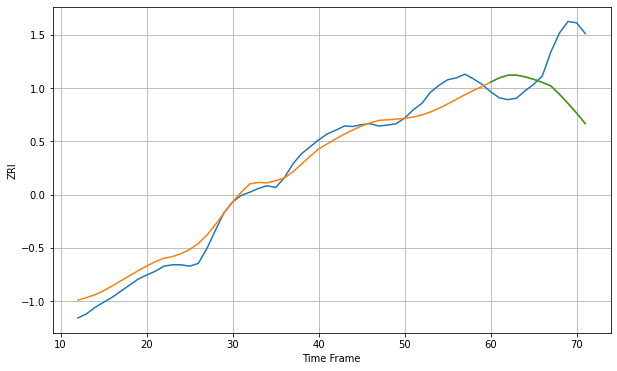

Wall time: 6.39 s
93906 24.456421643138462 107.73386953407363 107.61351336074242 [1789.8569674  1799.04025108 1804.76363888 1804.98404235 1801.33701774
 1795.97727329 1789.33222161 1781.72682169 1763.66090596 1743.71442262
 1723.0589996  1700.43451148]

Got an mse at 0.0050 in round 99 and stopped training

60 60 12


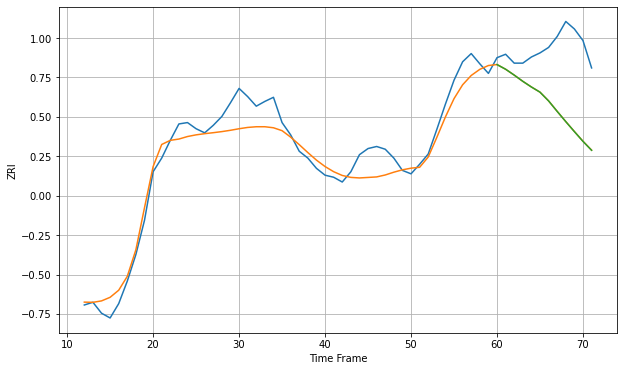

Wall time: 7.43 s
94010 23.648132383805642 93.60529883081836 93.69237402042236 [2710.91090278 2704.07957969 2695.50414833 2686.39302276 2678.08015318
 2670.50839157 2657.71371135 2642.35324495 2627.36813622 2612.78042312
 2598.50348045 2585.43731622]

Got an mse at 0.0050 in round 118 and stopped training

60 60 12


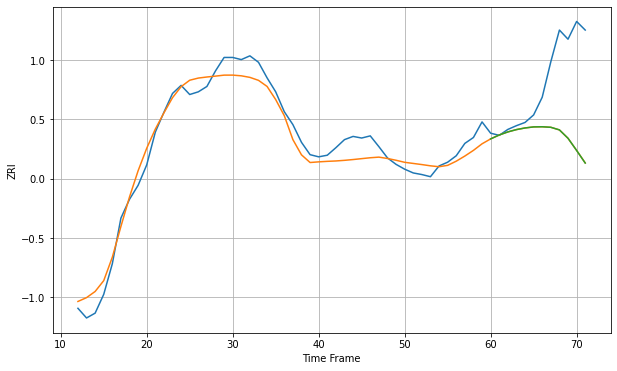

Wall time: 8.15 s
94025 23.986877138498798 131.05054800379392 131.08897182452787 [3326.36794888 3333.65439918 3339.35801571 3343.69327691 3346.75076517
 3348.70462424 3348.98184809 3347.98519799 3343.14539769 3327.58330623
 3304.87927343 3281.41715645]

Got an mse at 0.0050 in round 142 and stopped training

60 60 12


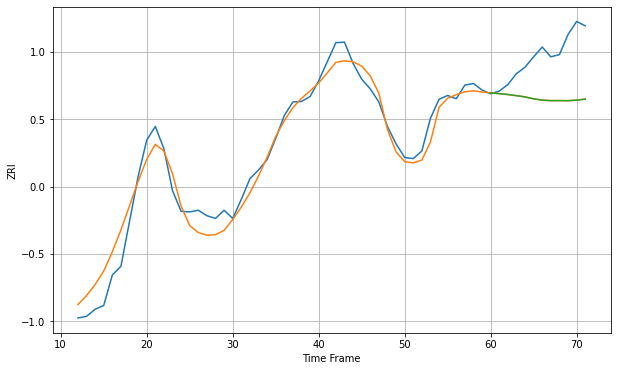

Wall time: 8.41 s
94040 26.42810065921495 85.57376231589419 85.62222054792454 [3387.84760833 3386.30926234 3384.73581393 3382.65503339 3380.31562502
 3376.81007951 3374.32533801 3373.47047598 3373.52871648 3373.34258795
 3374.36490619 3376.24830321]

Got an mse at 0.0050 in round 83 and stopped training

60 60 12


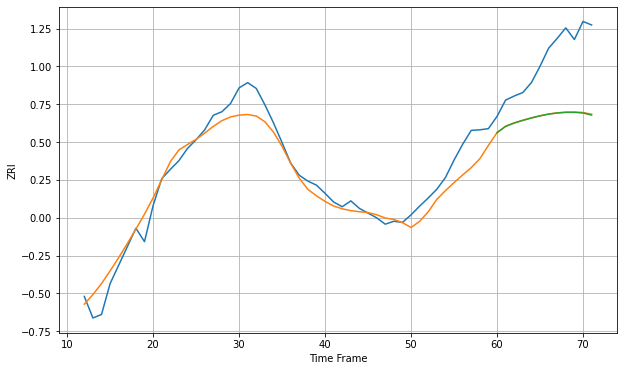

Wall time: 7.41 s
94061 26.379135068043325 104.70064127975559 105.12450847965695 [3024.072061   3034.95709087 3040.74064412 3045.24216276 3049.32577085
 3052.96616877 3055.92538305 3057.89627373 3058.9820332  3058.96084861
 3057.9150318  3054.29014445]

Got an mse at 0.0050 in round 138 and stopped training

60 60 12


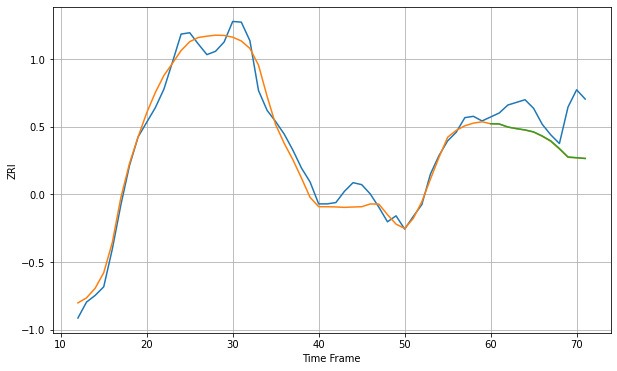

Wall time: 8.76 s
94066 16.77892022009079 50.98839175742664 50.79272190519248 [2826.8302424  2826.47081068 2821.85913942 2819.4875524  2817.53139042
 2814.54718465 2808.44443657 2800.95117886 2789.46375493 2776.71149444
 2775.66056535 2774.50290804]

Got an mse at 0.0049 in round 105 and stopped training

60 60 12


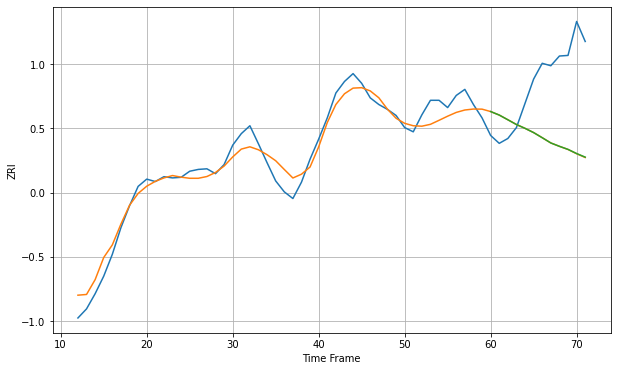

Wall time: 8.48 s
94085 19.61490411895171 121.07102262915667 120.93373706635249 [3000.43103409 2994.6536017  2986.90190852 2979.04918747 2972.72667861
 2965.71575089 2957.27699778 2948.6233797  2943.09247688 2938.0269747
 2931.18366653 2925.2895929 ]

Got an mse at 0.0049 in round 174 and stopped training

60 60 12


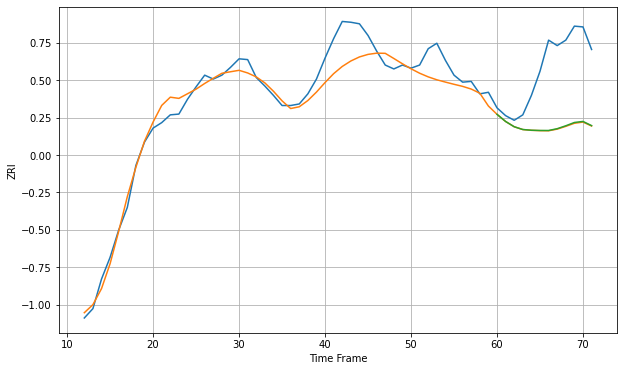

Wall time: 9.46 s
94086 20.30416876263327 84.63060098187275 84.15214368586513 [2891.67780838 2882.49124544 2875.73347331 2872.16540342 2871.23087001
 2870.91861994 2870.91936598 2873.20686436 2876.96771096 2881.19275357
 2882.5443322  2877.16685258]

Got an mse at 0.0050 in round 73 and stopped training

60 60 12


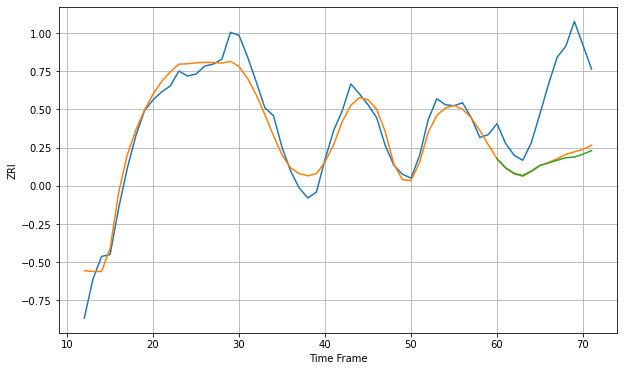

Wall time: 7.46 s
94087 14.199617960545929 75.80465620353277 78.13343320953157 [2681.52605963 2672.52719804 2666.85752774 2664.57534867 2669.25933978
 2674.86466102 2677.3621637  2680.03458751 2682.61192643 2683.30160195
 2686.15183277 2689.81514172]

Got an mse at 0.0049 in round 167 and stopped training

60 60 12


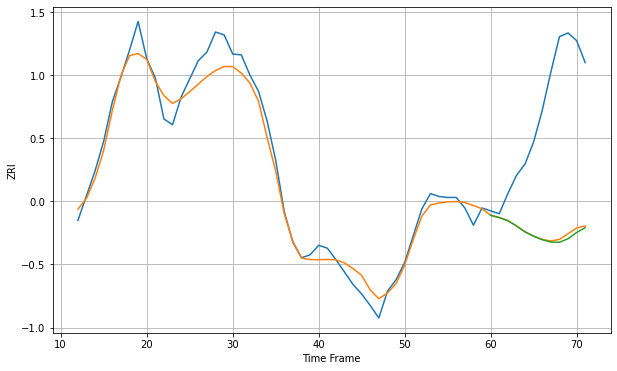

Wall time: 9.46 s
94103 14.8148797242359 136.68836283479754 138.66392559898242 [3482.32143813 3479.96717351 3476.81440832 3471.23341525 3465.0479696
 3460.45853803 3456.81731116 3454.31349797 3454.14996269 3457.80683257
 3464.3373723  3469.40299028]

Got an mse at 0.0050 in round 129 and stopped training

60 60 12


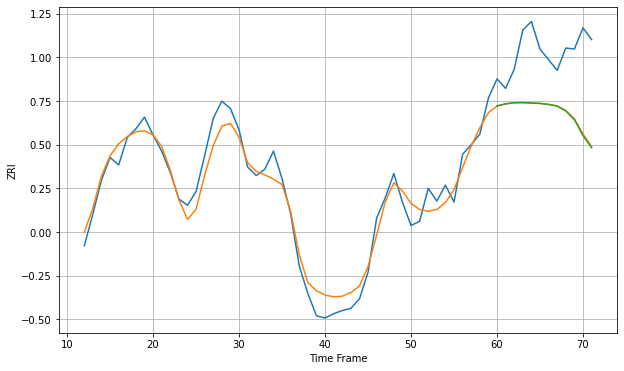

Wall time: 8.79 s
94105 13.094547657424307 61.7645895157144 62.24150916206264 [3981.47894485 3983.48626257 3984.51816759 3984.69800974 3984.2045568
 3983.90962937 3982.94575929 3981.35005171 3976.84406346 3968.57458794
 3953.56762594 3942.21152263]

Got an mse at 0.0049 in round 88 and stopped training

60 60 12


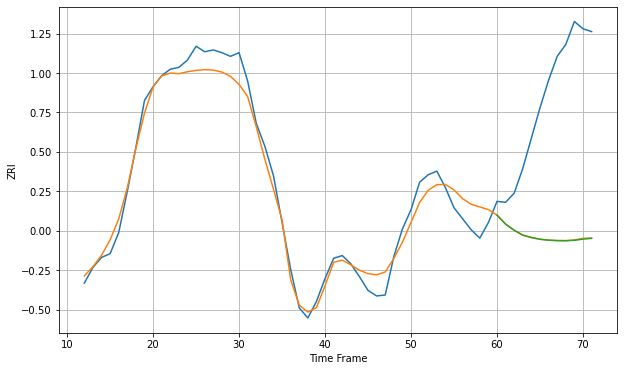

Wall time: 7.36 s
94107 15.556297219217159 162.1875747038891 162.38344479205062 [3835.04672585 3825.23154035 3818.54719809 3813.23154031 3810.62615897
 3808.76080072 3807.74843448 3807.2806796  3807.15354929 3807.60052374
 3808.93700969 3809.71862009]

Got an mse at 0.0050 in round 181 and stopped training

60 60 12


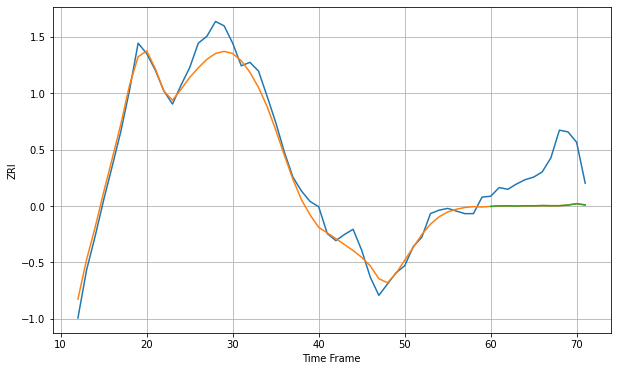

Wall time: 10 s
94109 13.530622095265194 48.58352585843531 48.571263562374405 [3371.29410214 3371.8977776  3371.94042533 3371.72348788 3372.07409747
 3371.97527094 3372.29194183 3372.12312268 3372.13796721 3372.83665753
 3374.42688766 3373.09041354]

Got an mse at 0.0050 in round 138 and stopped training

60 60 12


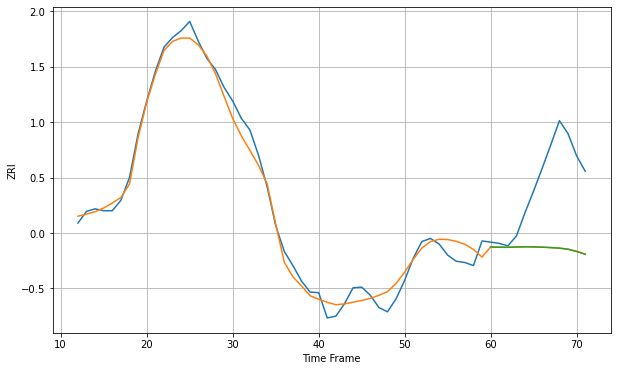

Wall time: 8.52 s
94110 17.12442909633 121.04385196735284 121.14876085798336 [3860.27338925 3859.73229832 3859.65590803 3860.09864218 3860.45101625
 3860.30104139 3859.86958614 3859.15218998 3858.23715698 3856.48941464
 3852.81418341 3848.32255863]

Got an mse at 0.0050 in round 236 and stopped training

60 60 12


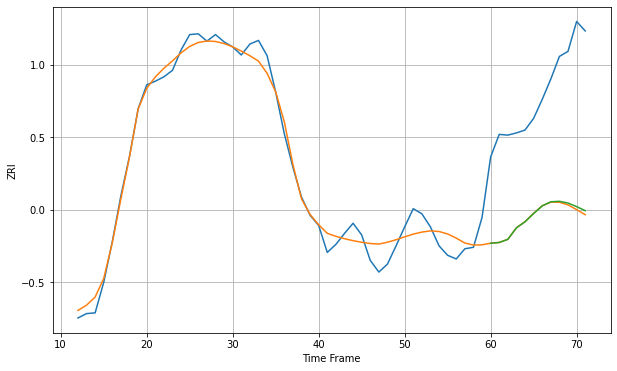

Wall time: 11.2 s
94115 16.92155045307589 175.82172110399873 174.2877105073234 [3437.59210223 3438.64489748 3442.89803078 3458.76679973 3467.05921634
 3478.39155399 3488.81824791 3494.48727392 3495.14100263 3492.76874503
 3487.84235272 3482.30304227]

Got an mse at 0.0049 in round 134 and stopped training

60 60 12


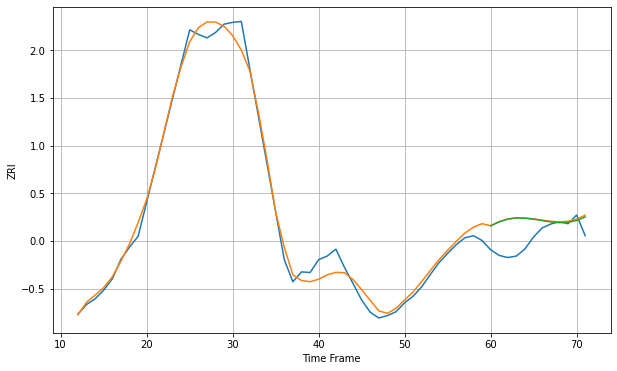

Wall time: 8.44 s
94158 31.642340067519452 77.41929450490632 76.8314146246848 [3983.19943836 3996.55933303 4005.67136955 4009.37500371 4008.51909521
 4005.17862035 4000.52426786 3996.13167556 3993.51064197 3994.50202154
 4000.86308638 4012.67825019]

Got an mse at 0.0050 in round 68 and stopped training

60 60 12


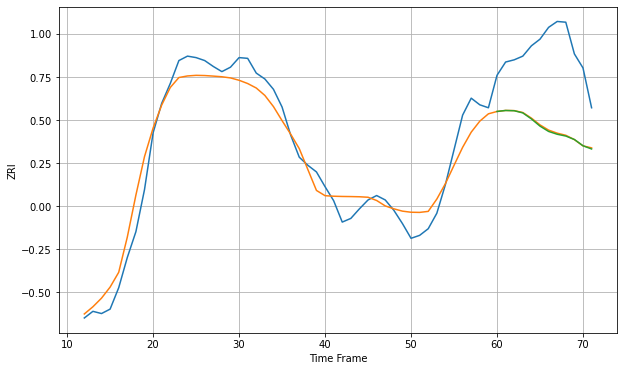

Wall time: 7.19 s
94401 23.111015546254322 105.62168161102332 106.44134150969062 [2811.97976235 2813.31978424 2812.97435313 2810.0377524  2801.87718666
 2792.10817105 2784.90776446 2781.08406328 2778.65918645 2773.95881686
 2765.50156943 2761.12667534]

Got an mse at 0.0050 in round 54 and stopped training

60 60 12


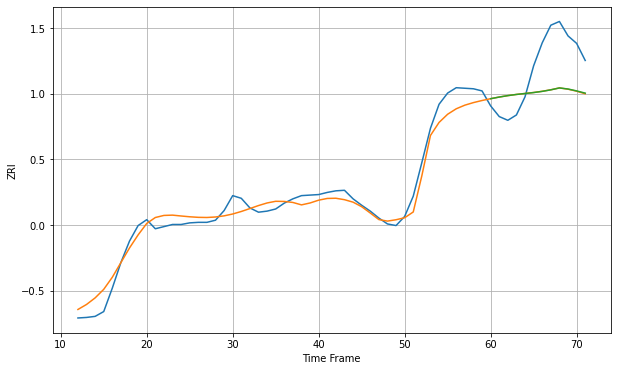

Wall time: 7.08 s
94403 19.599385371975295 75.18196808500137 75.04320383610688 [3092.43127381 3095.52735633 3098.1989688  3100.38413142 3102.14493444
 3103.92655814 3106.14606878 3109.01335903 3112.59197757 3110.57151134
 3107.01244677 3102.87735918]

Got an mse at 0.0047 in round 46 and stopped training

60 60 12


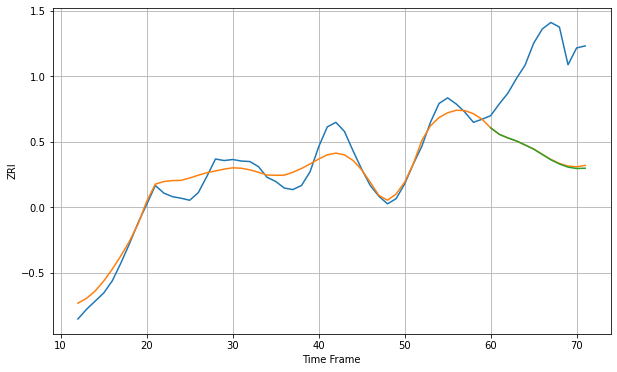

Wall time: 6.92 s
94404 23.35291189619587 193.12580728826572 194.4563424634868 [3125.19767635 3112.52339198 3105.39395539 3099.43653802 3091.57454115
 3083.49225174 3073.0020124  3062.54718528 3054.18421064 3048.03695238
 3045.34413833 3045.88273758]

Got an mse at 0.0050 in round 127 and stopped training

60 60 12


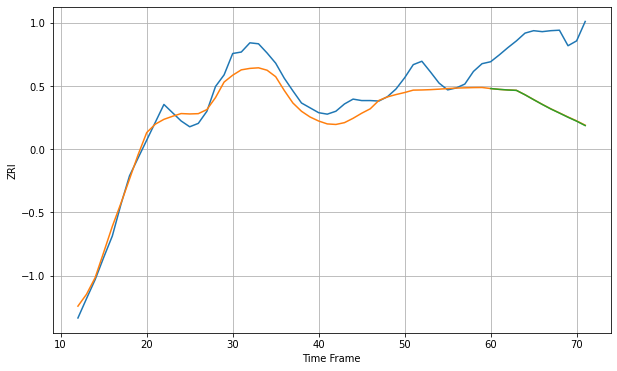

Wall time: 7.89 s
94501 26.999165596898898 139.69042216641 140.0197978521986 [2563.77451185 2562.05235732 2560.82799439 2559.98944658 2550.86867089
 2540.86789097 2531.03086415 2521.68052704 2513.2499343  2504.61077289
 2496.53415803 2487.42774647]

Got an mse at 0.0049 in round 63 and stopped training

60 60 12


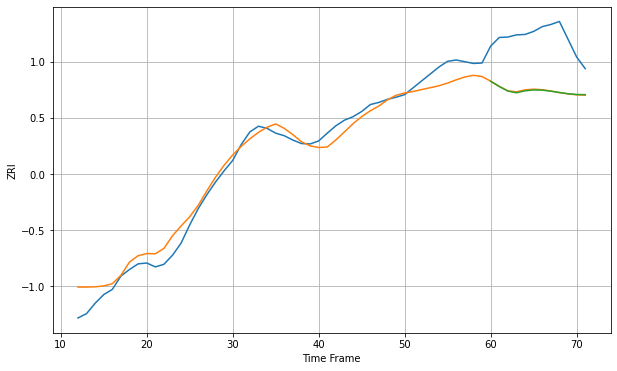

Wall time: 7.53 s
94509 26.996354345407386 124.3158034319152 124.90876626128131 [1865.92015362 1853.80694421 1843.25247644 1839.25553837 1843.7157044
 1845.88098065 1845.32985302 1842.97934338 1839.86095208 1837.06573384
 1835.29350486 1834.95385813]

Got an mse at 0.0049 in round 139 and stopped training

60 60 12


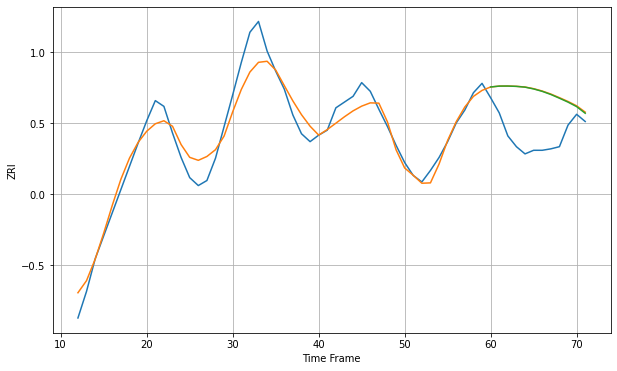

Wall time: 8.7 s
94530 20.804834732455216 63.2609692799982 62.919941567813595 [2465.974961   2467.18357425 2467.25309446 2466.79360397 2465.72838516
 2463.26114119 2459.88252032 2455.54551627 2450.36679473 2444.92872179
 2438.67745558 2429.45327964]

Got an mse at 0.0050 in round 106 and stopped training

60 60 12


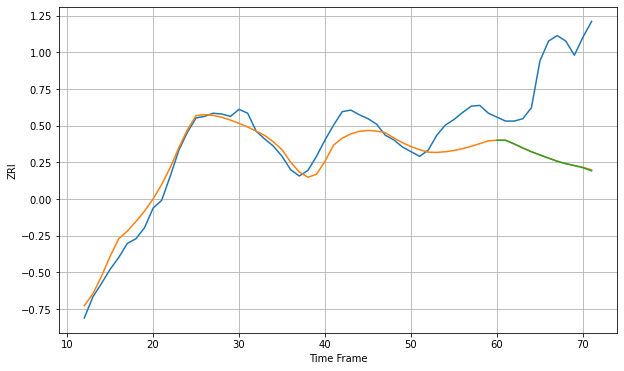

Wall time: 8.02 s
94538 20.66591708605271 121.38840822752286 121.56865204790576 [2428.54537703 2428.53933851 2423.85480468 2418.76445986 2413.96076998
 2409.80522406 2405.87150929 2401.86073374 2398.76888986 2396.28227158
 2393.52348872 2389.6049349 ]

Got an mse at 0.0049 in round 113 and stopped training

60 60 12


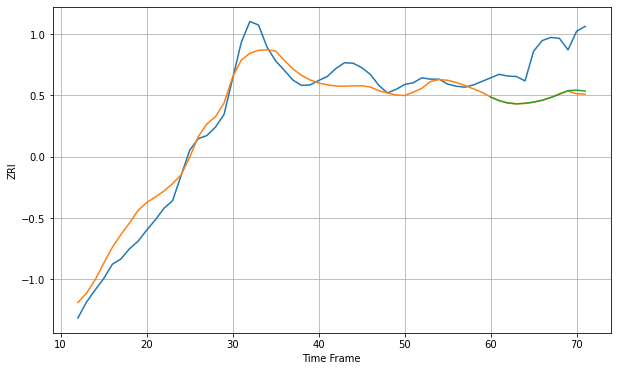

Wall time: 8.08 s
94541 33.123552434475606 105.03240560683831 103.31562386498739 [2340.64754785 2332.61921317 2327.42194412 2325.57169968 2326.79156858
 2329.47169748 2333.4566122  2339.50801516 2347.18057615 2355.16740403
 2356.35402733 2354.10811968]

Got an mse at 0.0048 in round 85 and stopped training

60 60 12


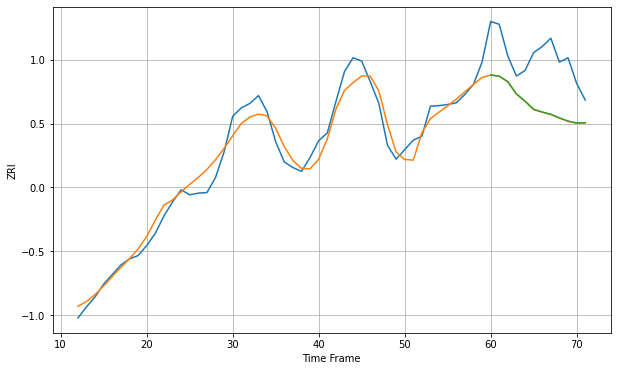

Wall time: 7.37 s
94549 21.46669200937572 89.95749507967707 89.6525812546816 [2721.93280865 2719.87190639 2709.9413799  2687.94357252 2675.21373105
 2660.37808303 2655.54177008 2651.43862199 2645.03612642 2639.3300177
 2635.83113676 2636.40907982]

Got an mse at 0.0049 in round 64 and stopped training

60 60 12


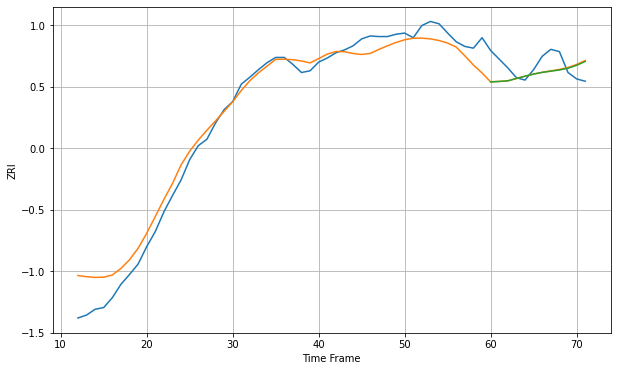

Wall time: 6.68 s
94565 26.49549537515435 28.931020889298896 28.811120671536003 [1949.90199631 1950.65380292 1951.67282801 1955.77900012 1959.68411026
 1963.32596641 1966.18440261 1968.29455935 1970.34631864 1973.44718162
 1978.37945967 1985.07284523]

Got an mse at 0.0050 in round 171 and stopped training

60 60 12


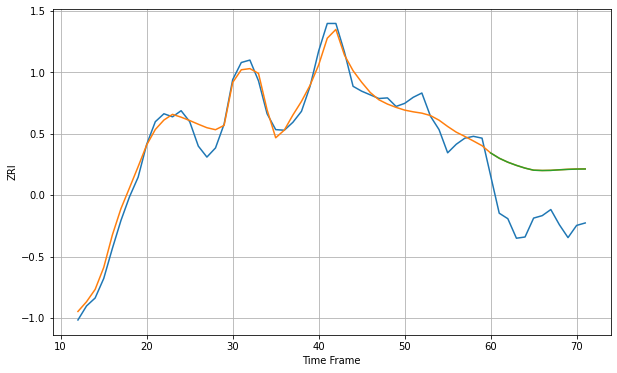

Wall time: 9.02 s
94568 17.61777500227718 90.36049574525995 90.28092762122375 [2741.75377051 2733.09843503 2726.60535382 2721.38878321 2716.91590403
 2713.49679278 2712.97139821 2713.18619471 2714.09841593 2714.83022884
 2715.31877716 2715.44705605]

Got an mse at 0.0050 in round 90 and stopped training

60 60 12


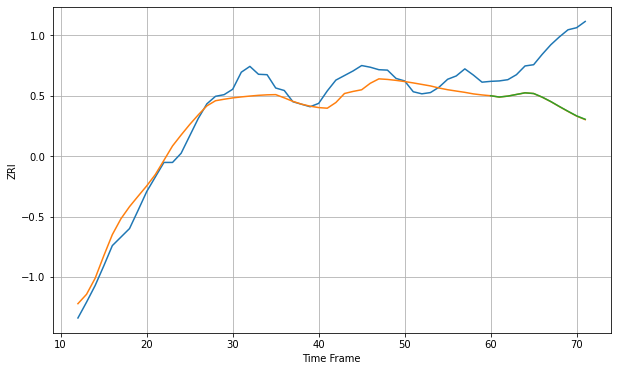

Wall time: 7.26 s
94603 33.11520374972164 133.06303880325157 132.76112227918196 [2343.39049189 2340.29480107 2342.49156469 2346.47268632 2350.40152539
 2348.77139022 2340.0242103  2329.40464374 2317.48268619 2306.01525331
 2294.95959661 2286.77788667]

Got an mse at 0.0050 in round 57 and stopped training

60 60 12


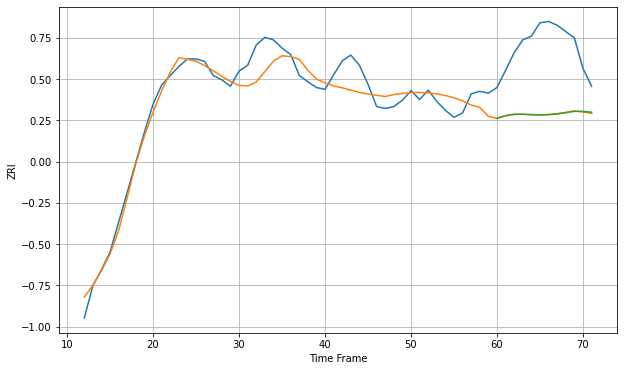

Wall time: 6.34 s
94608 22.94449540966332 109.43129892578021 109.53337759723425 [2750.44753511 2754.6548552  2756.70816384 2756.8547126  2756.29773187
 2755.85788074 2756.19527122 2757.3371658  2759.24399792 2761.4117675
 2761.5080634  2760.11822193]

Got an mse at 0.0050 in round 70 and stopped training

60 60 12


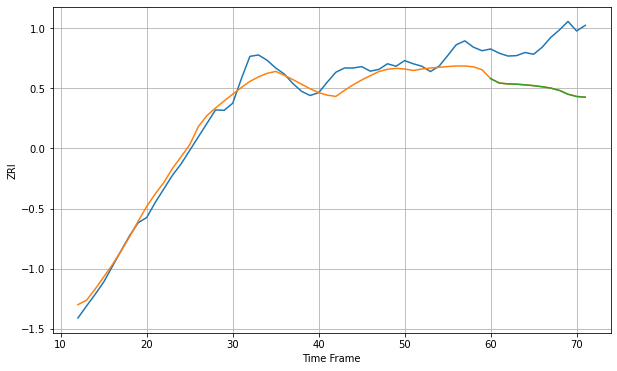

Wall time: 6.71 s
94621 32.542900121270996 136.72430866428397 136.92985833917183 [2446.87112976 2434.42226745 2431.97205082 2431.13525202 2429.21100986
 2426.91109405 2423.76240589 2419.95669033 2413.37276929 2402.50002778
 2396.08540918 2394.0106253 ]

Got an mse at 0.0049 in round 82 and stopped training

60 60 12


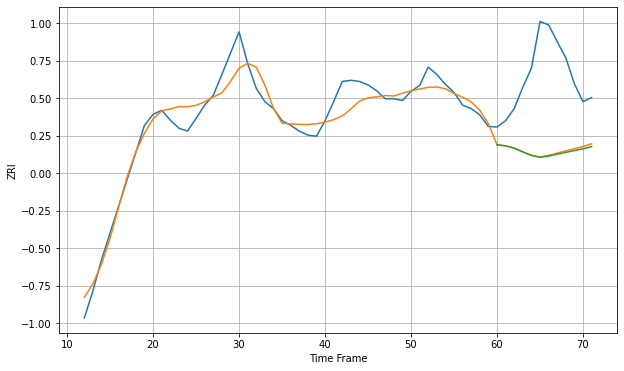

Wall time: 7.29 s
94703 24.03183143679618 140.73822289234755 142.13458028097688 [2732.2130422  2730.3558223  2726.36609318 2719.84621708 2713.83420348
 2710.48092297 2712.58597436 2715.87075091 2719.12479293 2722.17309594
 2725.25548712 2729.0346273 ]

Got an mse at 0.0050 in round 91 and stopped training

60 60 12


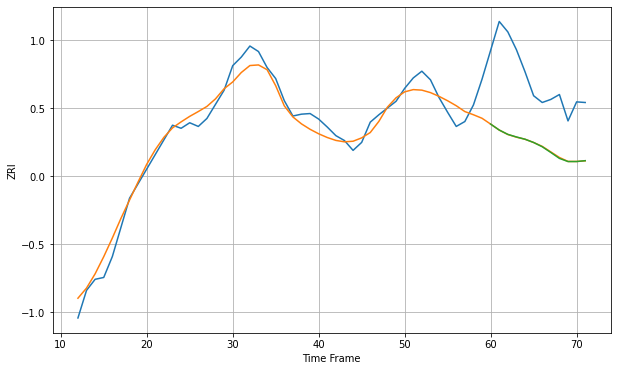

Wall time: 7.5 s
94801 19.528153853728323 114.59515180804085 114.72707394386363 [2207.79937239 2198.14261175 2191.0608925  2186.86476652 2183.16918369
 2177.85124684 2170.9177395  2161.60517822 2151.9347892  2146.81483902
 2146.84045114 2148.24546878]

Got an mse at 0.0050 in round 140 and stopped training

60 60 12


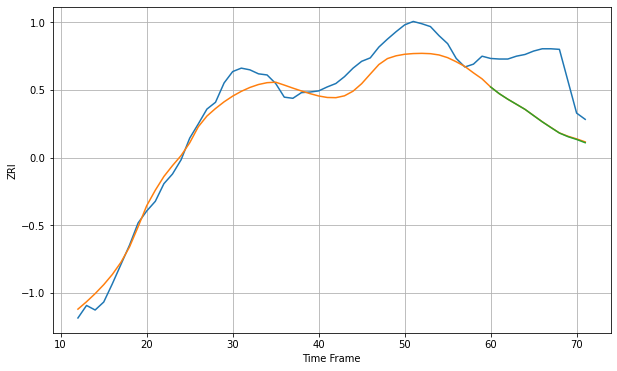

Wall time: 8.36 s
94806 27.021115265511952 95.9711389749466 96.18554380959532 [2094.87666367 2083.15744238 2073.36997974 2064.49452128 2055.56333964
 2044.59529052 2033.71842319 2023.74547302 2013.95231583 2007.55621911
 2002.70996026 1996.96647355]

Got an mse at 0.0049 in round 61 and stopped training

60 60 12


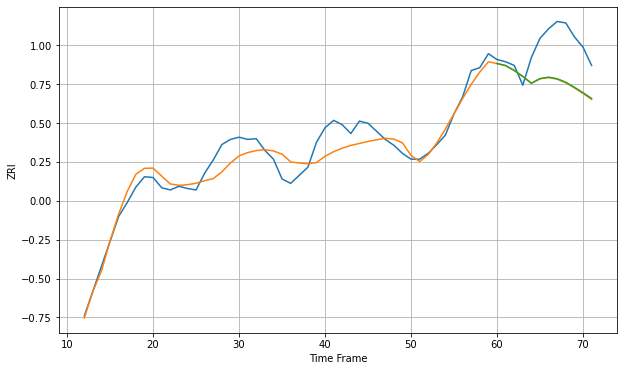

Wall time: 6.7 s
94901 18.345389030852257 52.32336061121606 51.80250073855082 [2629.59080446 2626.78255474 2620.1388292  2611.94956082 2602.66941883
 2608.98546624 2610.95737793 2608.80127206 2604.0215603  2597.16149311
 2589.78801469 2581.86084319]

Got an mse at 0.0049 in round 79 and stopped training

60 60 12


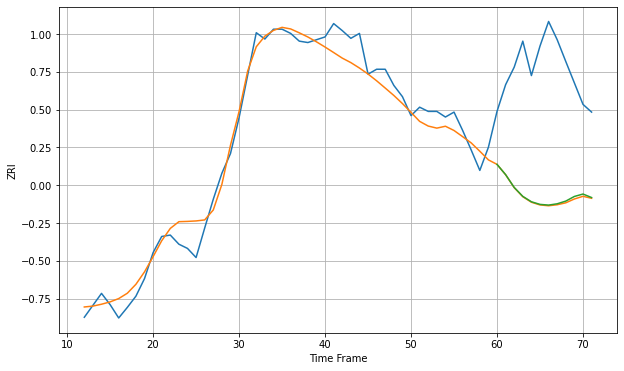

Wall time: 7.25 s
94903 20.834450937932083 184.39818474482246 183.1808171601954 [2571.60969889 2557.01666479 2538.76803651 2526.07265574 2518.39916238
 2514.65945429 2513.6630975  2515.51833748 2519.35121082 2525.95253236
 2529.39559833 2524.41653845]

Got an mse at 0.0050 in round 61 and stopped training

60 60 12


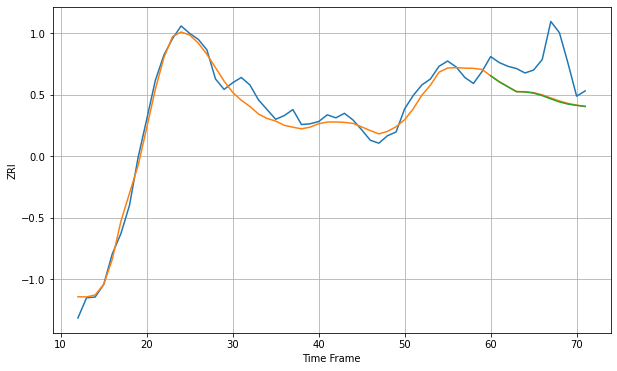

Wall time: 6.48 s
95008 12.693558056228204 49.26689778395326 49.891409045247904 [2605.27711646 2597.23472944 2590.64811268 2584.03546204 2583.65721844
 2582.07987077 2578.71449888 2574.36777065 2570.24523074 2567.37360511
 2565.64945754 2564.31371427]

Got an mse at 0.0050 in round 68 and stopped training

60 60 12


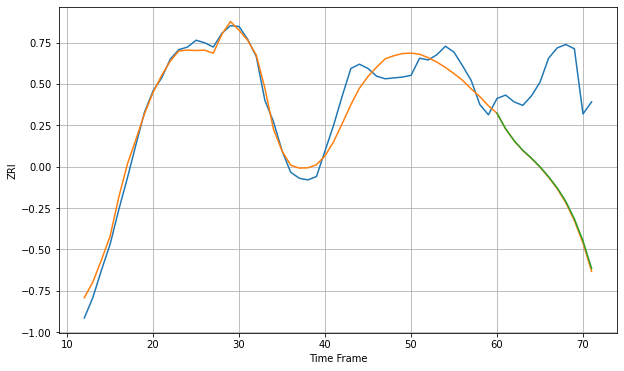

Wall time: 7.29 s
95014 15.553945190980965 130.41568475126036 129.0207670914076 [3191.74109617 3173.6837586  3159.73060339 3148.57699221 3139.48930581
 3129.42523512 3117.78678955 3104.85415344 3089.03391138 3068.60159847
 3043.01251651 3010.88117284]

Got an mse at 0.0050 in round 176 and stopped training

60 60 12


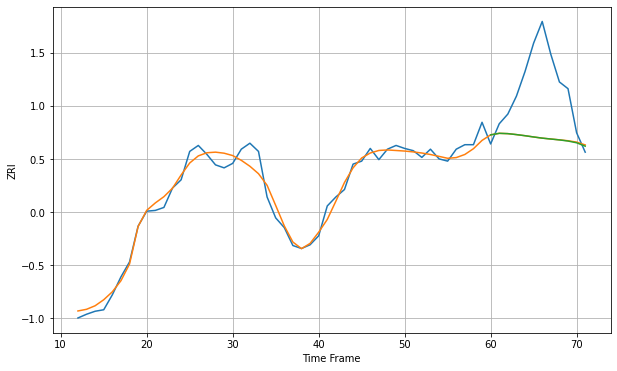

Wall time: 9.67 s
95050 11.54575419328967 79.16050264519114 79.19372141607947 [2688.17548043 2690.23074357 2689.81190784 2688.52688502 2687.03480423
 2685.35030171 2683.79625142 2682.60153717 2681.41581441 2679.91129308
 2677.57744073 2673.03556914]

Got an mse at 0.0050 in round 53 and stopped training

60 60 12


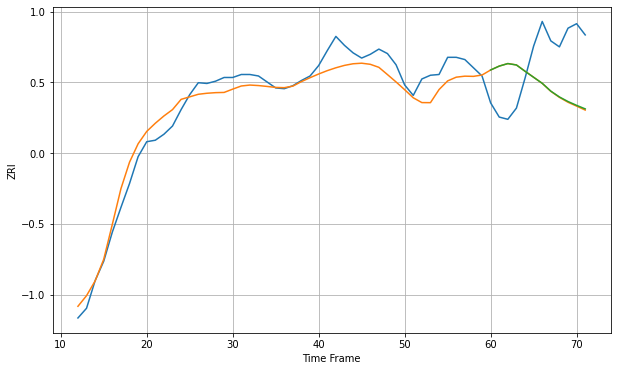

Wall time: 6.87 s
95051 18.896516734655016 73.87004556164678 73.3769241711192 [2847.02397519 2852.25120754 2855.61155432 2853.74380682 2845.33392249
 2837.24912581 2829.19803001 2818.73224058 2810.92844184 2804.80083357
 2799.68101877 2794.96050349]

Got an mse at 0.0050 in round 79 and stopped training

60 60 12


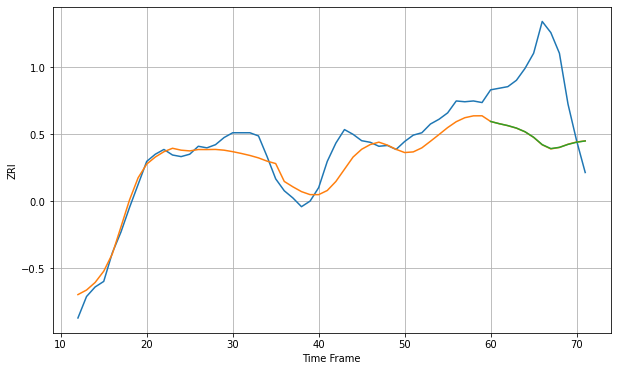

Wall time: 7.08 s
95112 18.77325109024399 86.9970267517887 86.87669512486929 [2543.19024309 2540.41346949 2537.98780608 2534.87941899 2530.25872701
 2523.33289265 2514.04643894 2509.07870706 2510.63449642 2514.35900506
 2517.13232617 2518.68674824]

Got an mse at 0.0049 in round 112 and stopped training

60 60 12


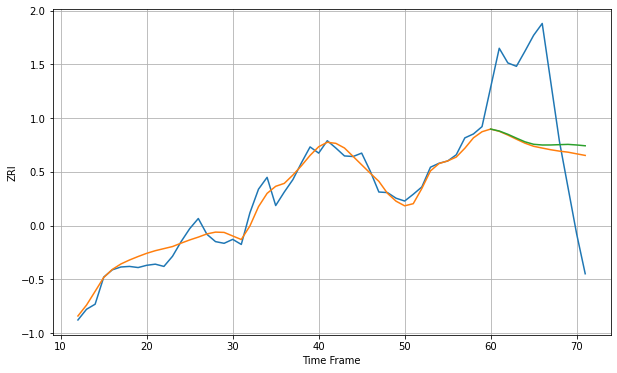

Wall time: 7.8 s
95116 15.752783614753522 146.4209515418463 148.2048407928555 [2566.65674753 2563.2084657  2557.41936199 2550.59096712 2544.02392586
 2539.67141179 2538.39049032 2538.45762667 2538.99574358 2539.50656797
 2538.44284579 2537.01350935]

Got an mse at 0.0050 in round 211 and stopped training

60 60 12


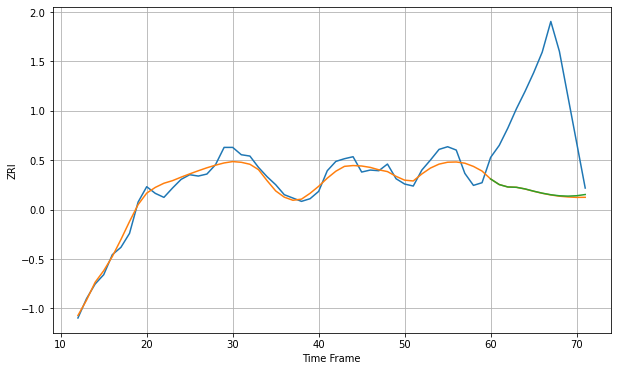

Wall time: 10.5 s
95117 11.968429632173056 149.61560294188658 149.21222385934686 [2519.58100887 2511.24380234 2507.60320735 2507.10873197 2504.67269671
 2501.32182422 2498.3200338  2495.95573076 2494.36914201 2493.87041605
 2494.4625442  2496.27438792]

Got an mse at 0.0049 in round 51 and stopped training

60 60 12


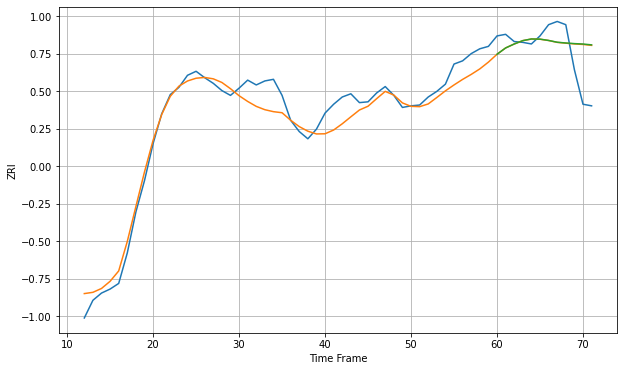

Wall time: 6.81 s
95123 17.13562979015837 34.99436137217474 35.20728479831147 [2775.16711765 2783.0322559  2787.9720034  2792.14657545 2794.216095
 2793.99254608 2792.3936144  2790.1569195  2789.22429982 2788.45000761
 2787.91966924 2786.89431064]

Got an mse at 0.0049 in round 63 and stopped training

60 60 12


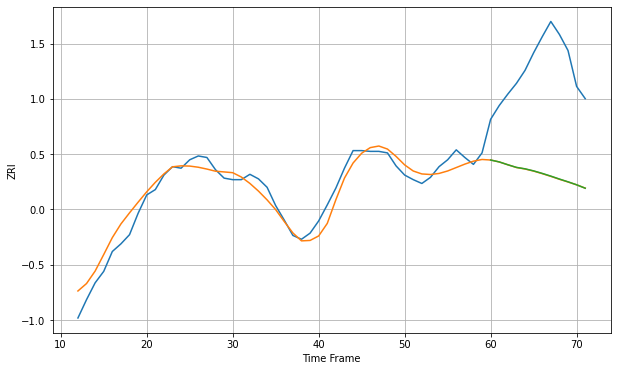

Wall time: 6.4 s
95128 14.016017918832855 141.00189026845402 140.8154534418021 [2533.69154197 2531.20337652 2527.49875371 2524.06512096 2522.18780484
 2519.48347544 2516.20071258 2512.63542311 2508.80170818 2505.17039744
 2501.28299161 2496.78228689]

Got an mse at 0.0050 in round 79 and stopped training

60 60 12


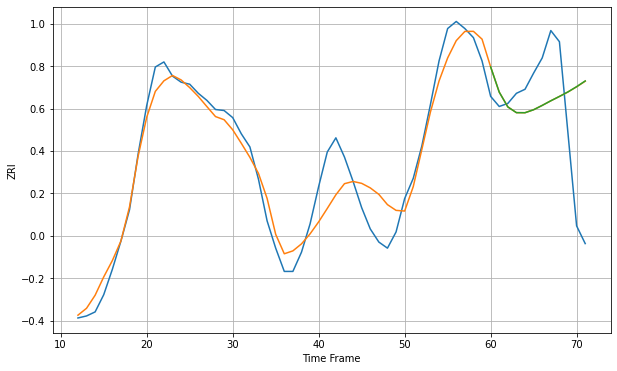

Wall time: 7.15 s
95134 21.042867341481866 70.4511926017899 70.5268907260779 [3129.14183437 3104.19538942 3089.55924866 3083.88952144 3083.82735559
 3086.77695163 3091.06342341 3095.61378035 3099.91797322 3104.41947
 3109.5601239  3115.21996407]

Got an mse at 0.0049 in round 75 and stopped training

60 60 12


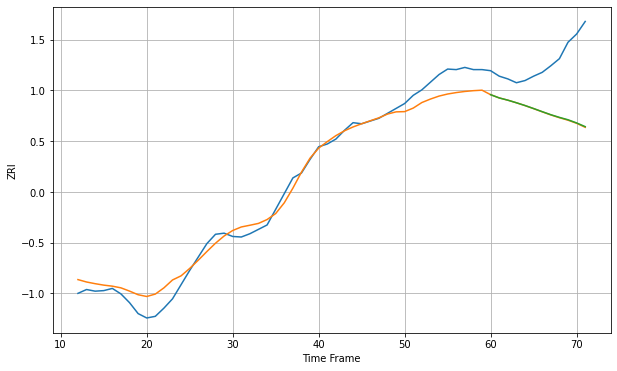

Wall time: 6.78 s
95207 22.223616246413155 100.52860920867523 100.01820176679836 [1196.1504832  1190.22286467 1186.15386814 1181.40191219 1176.34812314
 1170.82496021 1165.12267621 1159.56824335 1154.67682238 1150.32118206
 1144.54164767 1137.76002109]

Got an mse at 0.0049 in round 88 and stopped training

60 60 12


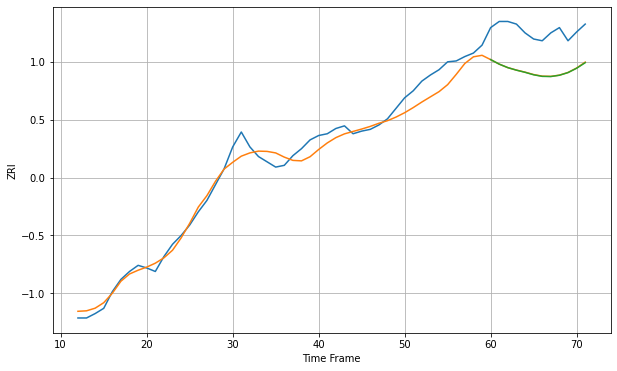

Wall time: 7.14 s
95608 12.06463179922425 45.41980695840913 45.59488116385194 [1409.52072001 1404.35551102 1400.35862188 1397.49471888 1395.0385534
 1392.21801649 1390.40962112 1390.22113772 1391.68042614 1394.72612976
 1399.65862907 1405.99954222]

Got an mse at 0.0050 in round 55 and stopped training

60 60 12


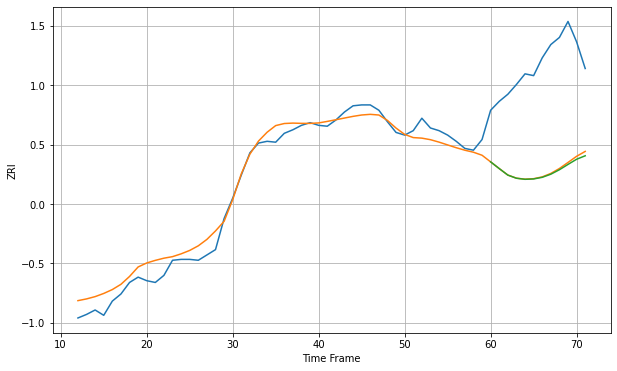

Wall time: 6.35 s
95678 12.190365052970192 118.13467895448977 119.3501452767792 [1642.8274646  1635.2786221  1627.94294325 1624.39823165 1623.19627712
 1623.60535388 1625.43031083 1628.95255018 1633.988334   1639.97684194
 1645.7990854  1649.70614867]

Got an mse at 0.0049 in round 71 and stopped training

60 60 12


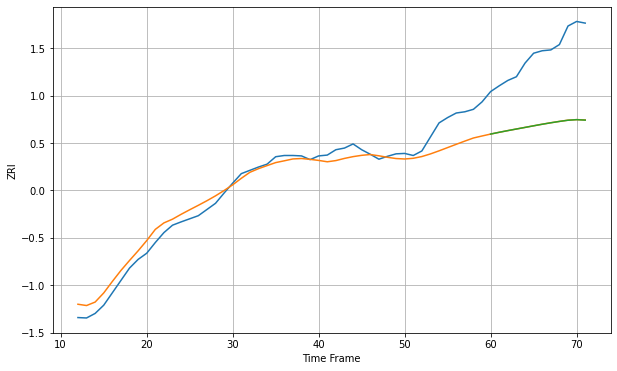

Wall time: 6.77 s
95816 31.91966332980939 175.84228044186986 175.93990383151288 [1388.96907078 1393.27071219 1397.33567114 1401.22217857 1405.07754257
 1408.98387174 1412.79098475 1416.32268224 1419.60064437 1422.49607025
 1423.85811504 1422.79165285]

Got an mse at 0.0050 in round 96 and stopped training

60 60 12


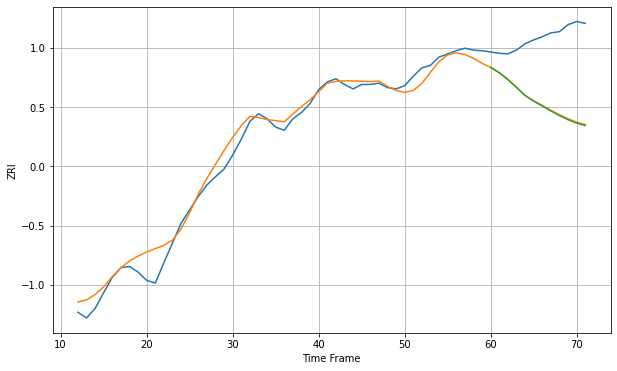

Wall time: 7.11 s
95826 16.82891952551094 107.2215693572388 108.12609139610161 [1415.81553988 1407.46489105 1396.76269372 1384.45623599 1371.62730299
 1362.82910215 1355.21553059 1347.41441544 1340.13021693 1333.61862915
 1328.26094989 1324.44258327]

Got an mse at 0.0050 in round 60 and stopped training

60 60 12


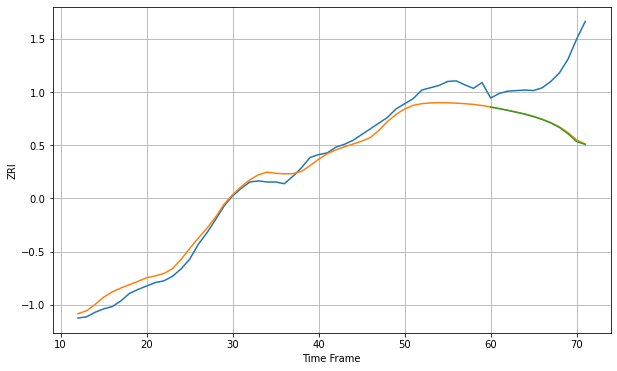

Wall time: 7.1 s
95831 17.547111232338406 99.23152908389572 100.1503369175424 [1519.2374495  1516.46485684 1513.39873323 1510.17620835 1506.751788
 1502.46321397 1497.4543705  1491.30273928 1483.43767941 1472.39863579
 1458.78426368 1453.7955598 ]

Got an mse at 0.0050 in round 72 and stopped training

60 60 12


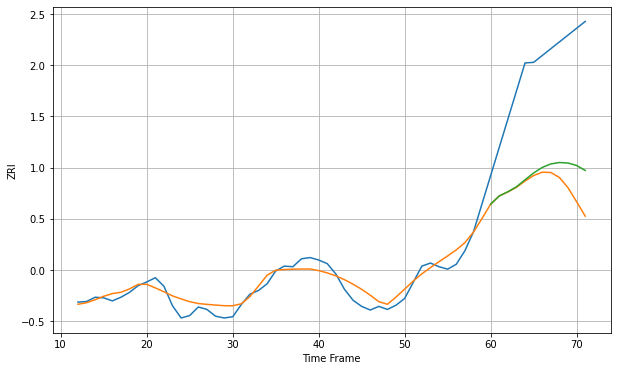

Wall time: 6.74 s
95928 14.433839646273235 202.46000800501886 177.79622876088155 [1438.53426192 1452.02747773 1458.87933698 1466.96499241 1478.5185033
 1489.62323552 1498.7270715  1504.50808069 1506.80557663 1505.96533336
 1501.91955848 1493.8644826 ]

Got an mse at 0.0050 in round 151 and stopped training

60 60 12


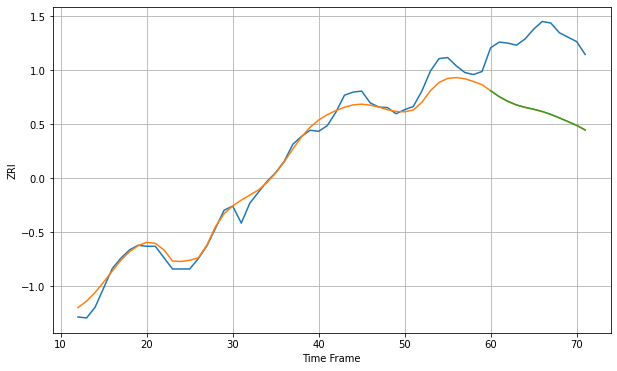

Wall time: 9.45 s
96150 18.23217186592395 144.38061807990232 144.21030374611752 [1615.67932648 1604.25282467 1595.23223076 1588.22414379 1583.56482084
 1579.83783412 1575.45968092 1569.82959177 1562.99179542 1555.83038132
 1548.5041841  1539.62538021]

Got an mse at 0.0050 in round 88 and stopped training

60 60 12


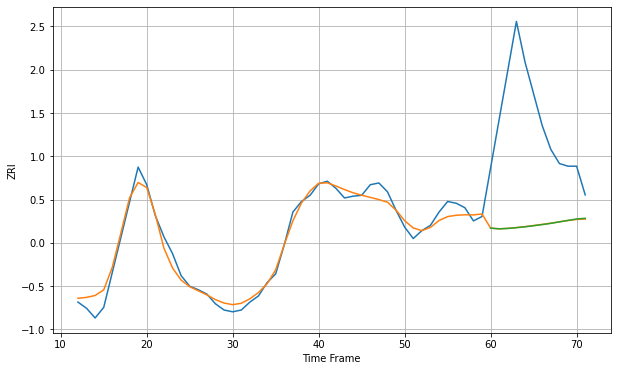

Wall time: 7.41 s
96826 9.315169199009347 127.78036929690006 127.84989477190213 [1519.78102718 1519.02929103 1519.4606104  1520.31796763 1521.32583917
 1522.53392722 1523.81629321 1525.22534906 1526.90495898 1528.58189162
 1530.18323805 1530.95375599]

Got an mse at 0.0050 in round 52 and stopped training

60 60 12


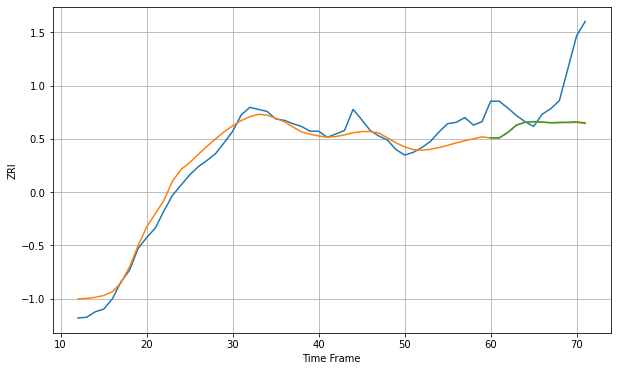

Wall time: 6.88 s
97030 16.648125663715557 66.99556582862552 66.6424181922182 [1343.16007033 1343.19039848 1351.15438534 1361.91465413 1366.19342618
 1367.02975587 1366.35012765 1365.51769205 1365.91549076 1366.17955638
 1366.68946203 1365.21756313]

Got an mse at 0.0050 in round 104 and stopped training

60 60 12


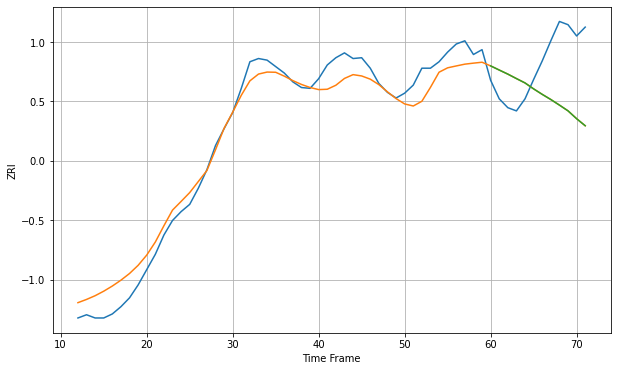

Wall time: 8.04 s
97035 19.881376385670958 70.83536270123184 70.85223626512415 [1570.87139019 1565.71485222 1560.65330577 1555.11203188 1549.70277344
 1542.32262513 1535.51918847 1529.11176328 1522.19456713 1515.05048415
 1505.31119091 1496.58721113]

Got an mse at 0.0049 in round 113 and stopped training

60 60 12


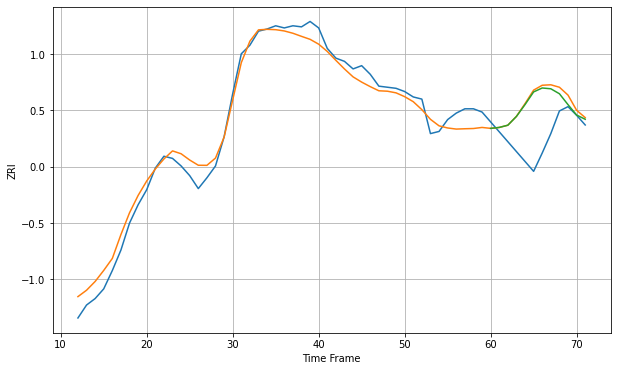

Wall time: 7.83 s
97062 10.734960707485453 37.15923717823958 35.59439590306465 [1440.85059855 1441.70969586 1443.77748999 1451.89142713 1462.90009116
 1474.65964676 1478.30732661 1477.5727281  1472.96258602 1462.83679811
 1453.21065695 1449.28360902]

Got an mse at 0.0049 in round 58 and stopped training

60 60 12


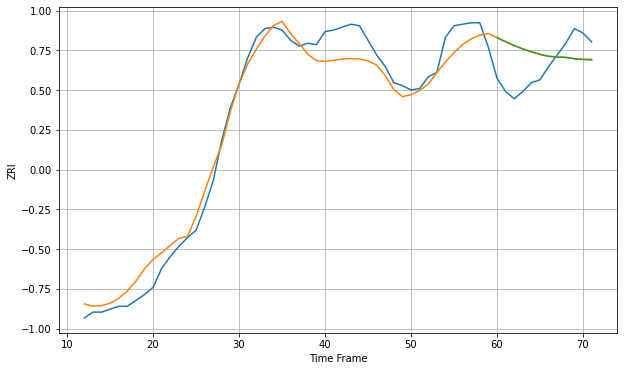

Wall time: 6.58 s
97070 11.077198637770037 22.151334045878436 22.20070976375204 [1380.78360547 1378.04461286 1375.42800731 1373.1307615  1371.21554508
 1369.42398136 1368.15181878 1367.55320608 1367.33724869 1366.40719346
 1365.90393583 1365.50773831]

Got an mse at 0.0050 in round 97 and stopped training

60 60 12


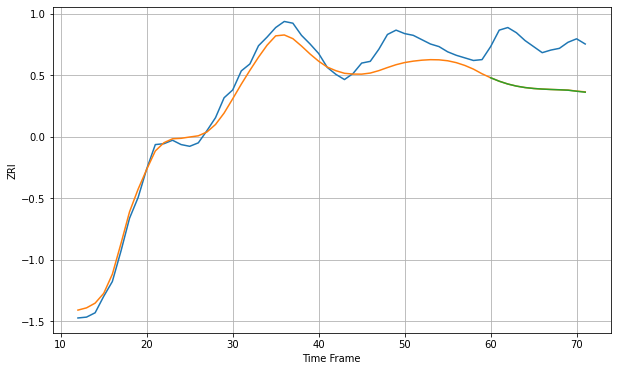

Wall time: 7.24 s
97124 14.984785742457715 53.148405108435774 53.21777303334529 [1474.07864652 1470.07438539 1466.8467822  1464.44649957 1462.77621549
 1461.69724982 1461.01582849 1460.54550505 1460.18683433 1459.73345515
 1458.51959678 1457.42388745]

Got an mse at 0.0050 in round 134 and stopped training

60 60 12


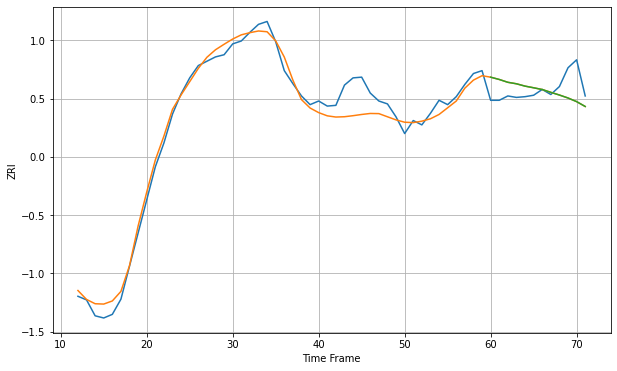

Wall time: 8.49 s
97209 16.581559034344703 26.355427478660353 26.350032842521347 [1758.96737062 1755.79756059 1751.88290561 1749.82430739 1746.59371846
 1744.29904205 1741.88144339 1737.98018974 1734.26878999 1730.17604358
 1725.17433998 1718.46914426]

Got an mse at 0.0050 in round 190 and stopped training

60 60 12


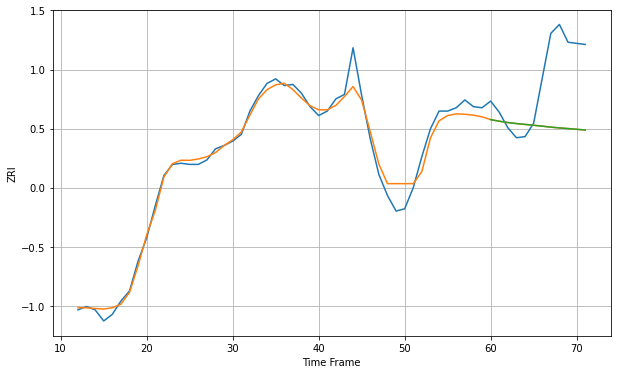

Wall time: 9.61 s
97214 8.833589533006702 54.98829229772187 54.98779284712844 [1563.31779521 1561.88916477 1560.68318961 1559.76304522 1559.00399078
 1558.24316252 1557.43348587 1556.5522764  1555.83921703 1555.25091102
 1554.59497842 1553.99823044]

Got an mse at 0.0049 in round 92 and stopped training

60 60 12


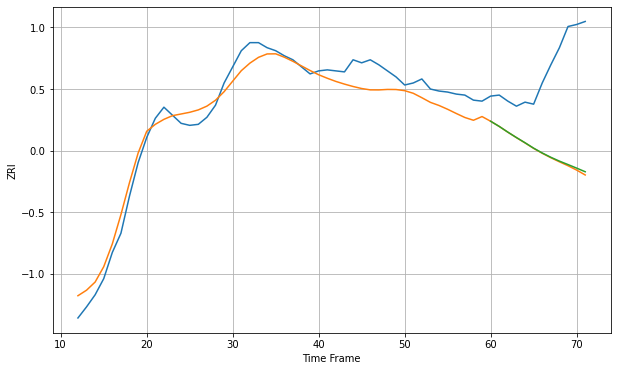

Wall time: 7.72 s
97229 14.623611431209168 89.568627219545 88.5590225407466 [1418.05265055 1412.93057461 1407.27525795 1401.90682678 1396.74581702
 1391.37395472 1386.60615193 1382.33418287 1378.52532236 1375.10466944
 1371.60330736 1367.98835925]

Got an mse at 0.0050 in round 120 and stopped training

60 60 12


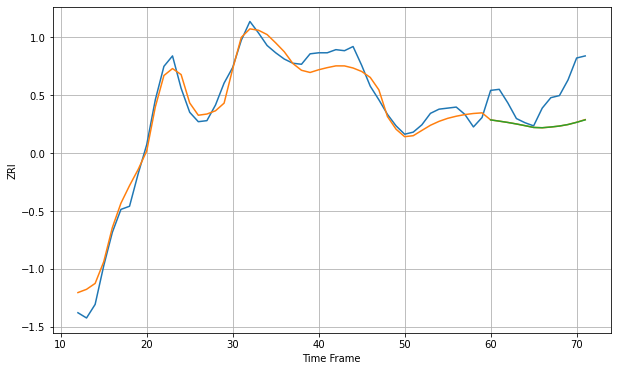

Wall time: 8.02 s
97239 11.123978263490661 33.477457061350975 33.51103564183614 [1608.7209948  1607.52984219 1606.27289971 1604.81519233 1603.20094556
 1601.4898341  1601.21924959 1601.91745224 1602.8500427  1604.2915859
 1606.39373636 1608.76575139]

Got an mse at 0.0049 in round 169 and stopped training

60 60 12


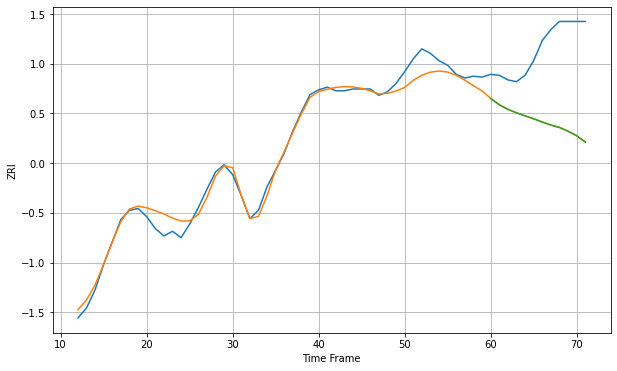

Wall time: 9.6 s
97401 10.155042942630564 86.55774196945438 86.58025498256072 [1254.69389529 1247.73625581 1242.71027919 1238.89551847 1235.58729916
 1232.33726765 1228.79272787 1225.46768246 1222.85120709 1218.72539859
 1213.77217115 1206.84070477]

Got an mse at 0.0050 in round 68 and stopped training

60 60 12


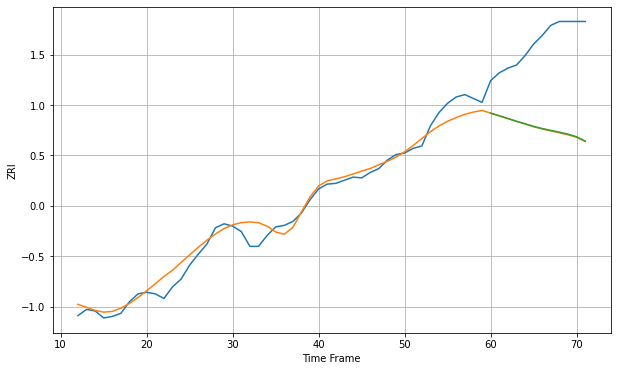

Wall time: 6.83 s
97402 12.967630114377503 113.14069454253048 112.68840182731563 [1105.22969768 1101.76270559 1098.30366851 1094.76603745 1091.51694335
 1088.10446252 1085.38429558 1083.0291406  1080.73331211 1078.15329533
 1074.84271972 1069.30655302]

Got an mse at 0.0050 in round 233 and stopped training

60 60 12


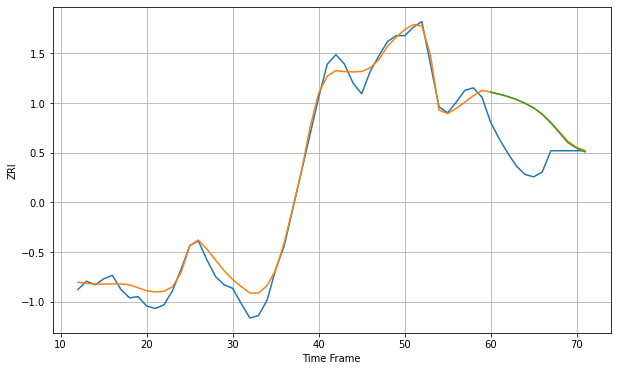

Wall time: 11.1 s
97477 8.701319840571568 38.53328615662054 38.38463524383412 [1095.4190511  1093.6961612  1091.7176259  1089.1918286  1085.97740339
 1082.11253672 1076.71079518 1069.48319407 1061.13260753 1052.77117648
 1048.12553862 1044.98997282]

Got an mse at 0.0050 in round 98 and stopped training

60 60 12


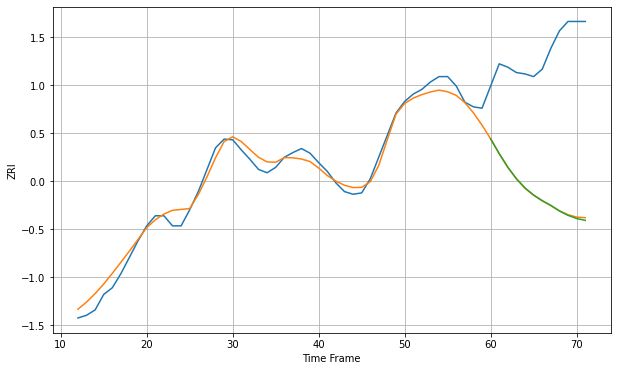

Wall time: 7.63 s
97501 12.902616293064437 213.80148042286484 214.46411852266036 [1057.43281336 1035.41357884 1015.20829749  998.13356353  984.35111807
  973.8495542   965.56040815  958.3855151   950.16254199  943.62491397
  938.95327574  936.18955511]

Got an mse at 0.0049 in round 87 and stopped training

60 60 12


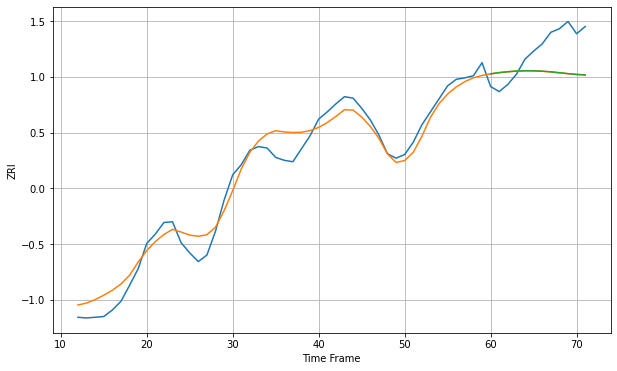

Wall time: 7.33 s
98004 18.400678719821354 44.0838296640769 44.064842769429504 [2277.59133481 2279.26525493 2280.4948164  2281.38146253 2281.83705483
 2281.7457126  2281.22536571 2280.3130428  2279.10514646 2277.82911732
 2276.72030908 2276.1412417 ]

Got an mse at 0.0050 in round 117 and stopped training

60 60 12


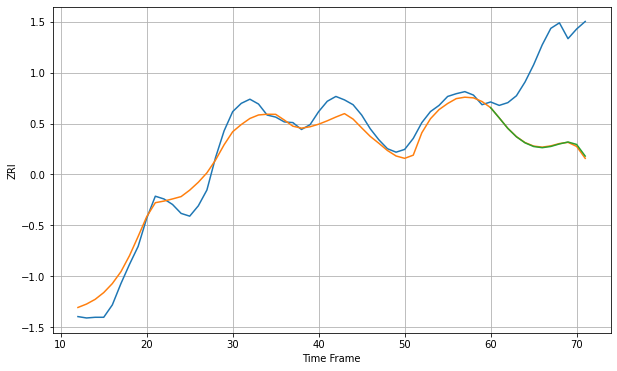

Wall time: 8.2 s
98005 18.424360086406494 129.2663279284503 128.80153446199188 [1951.70215282 1936.79940599 1921.57056085 1909.35270435 1900.57778414
 1895.23764575 1893.52540149 1895.31547522 1898.9651775  1901.82019161
 1898.23607182 1881.31924264]

Got an mse at 0.0050 in round 80 and stopped training

60 60 12


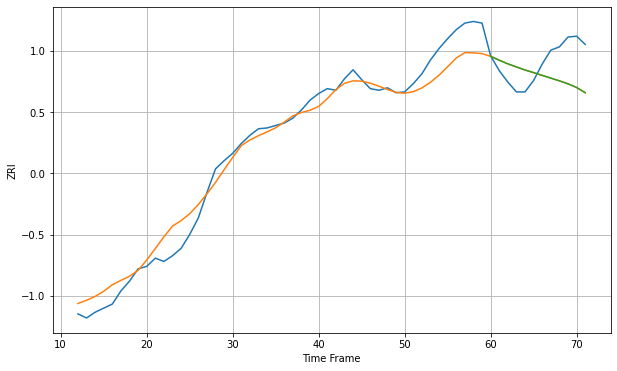

Wall time: 7 s
98012 18.709791266661526 36.7154963037299 36.650092119374946 [1776.44270155 1771.70215046 1767.2700771  1763.45338653 1759.75731913
 1756.5377496  1753.18844896 1749.83341638 1746.49705363 1742.88190397
 1738.41834705 1732.11656578]

Got an mse at 0.0050 in round 118 and stopped training

60 60 12


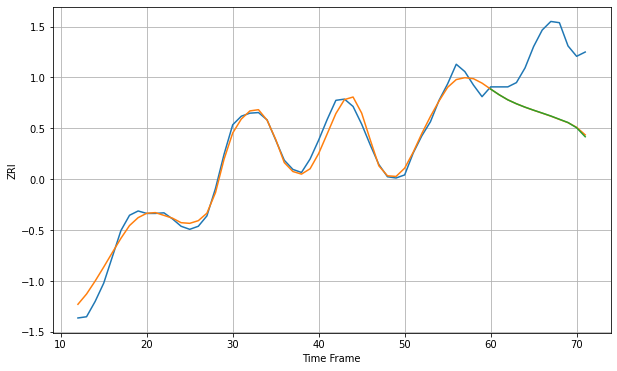

Wall time: 8.46 s
98029 13.629494015910455 104.84923914803679 105.14754642375958 [2117.39351208 2108.04589482 2099.80882027 2093.37498644 2087.81220724
 2082.85579901 2078.165315   2073.3692774  2068.01029599 2062.69610995
 2054.12445832 2039.45833864]

Got an mse at 0.0049 in round 104 and stopped training

60 60 12


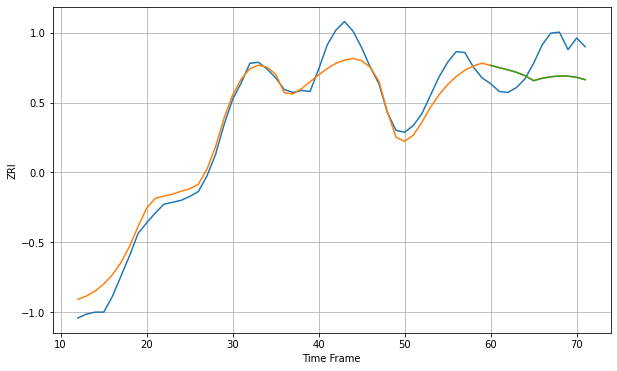

Wall time: 7.68 s
98034 15.073728651129365 30.051454063584497 30.048487906866097 [1850.83972034 1848.51553739 1846.22705755 1843.70951174 1840.34985193
 1835.01804825 1837.48750798 1839.08555059 1839.91490318 1839.76023989
 1838.59051952 1836.20474381]

Got an mse at 0.0050 in round 101 and stopped training

60 60 12


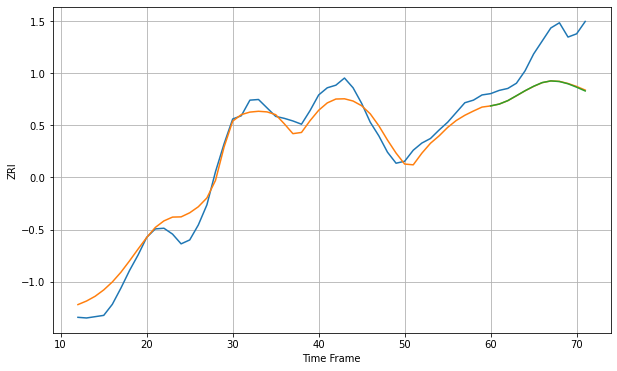

Wall time: 7.43 s
98052 19.753291049153862 62.32267676056476 62.67241755284665 [2102.13471456 2104.9631602  2110.27319444 2117.80000393 2125.46135113
 2132.333281   2138.02440888 2140.58163413 2139.61941489 2136.15934162
 2130.91653757 2125.10024057]

Got an mse at 0.0049 in round 115 and stopped training

60 60 12


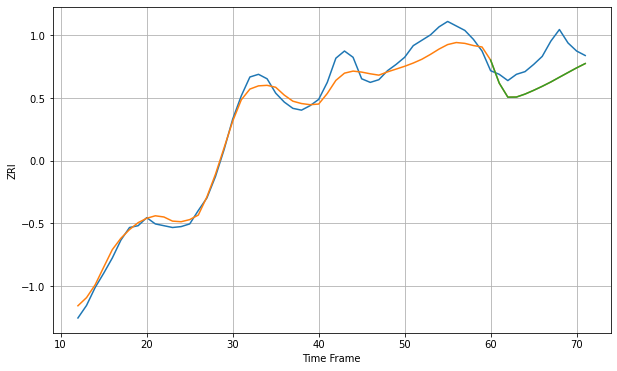

Wall time: 7.45 s
98056 11.671516217459425 29.214230272762038 29.204400492697154 [1645.8853358  1620.20026706 1604.50390306 1604.62031679 1607.94262749
 1612.10199042 1616.60628608 1621.44674303 1626.76044443 1631.99456634
 1637.19857877 1642.01525686]

Got an mse at 0.0050 in round 136 and stopped training

60 60 12


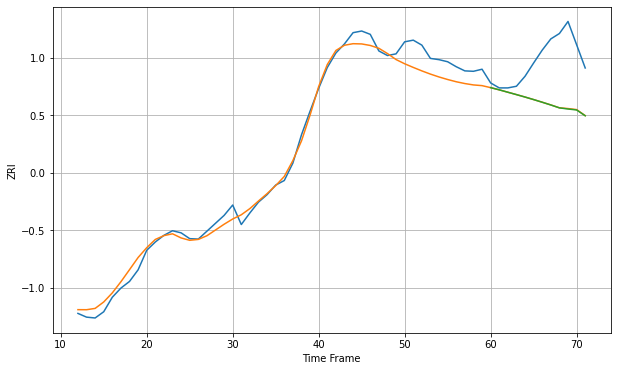

Wall time: 8.29 s
98101 25.19326174172372 117.4195806261995 117.766325270891 [2556.6647549  2551.36407476 2545.61216433 2539.88892949 2534.01345902
 2527.88761179 2521.4956286  2514.90692846 2507.89865831 2505.20260722
 2502.89347202 2488.91371012]

Got an mse at 0.0050 in round 214 and stopped training

60 60 12


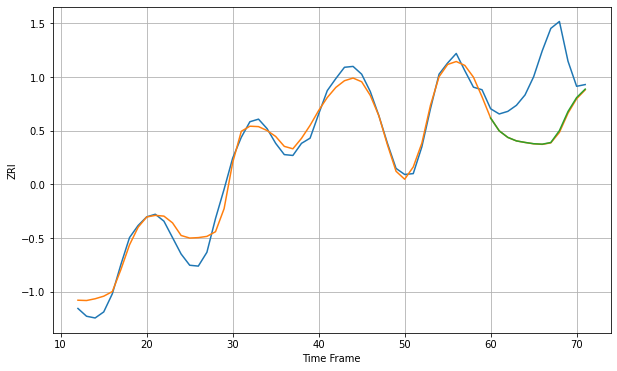

Wall time: 10.1 s
98102 12.183657414179482 71.69711714232767 71.12845079498935 [1981.23714147 1966.45098978 1958.88255088 1954.84280146 1953.06520942
 1951.57214939 1951.04181738 1952.98049541 1966.75498248 1988.8699758
 2004.94394559 2014.73571267]

Got an mse at 0.0050 in round 86 and stopped training

60 60 12


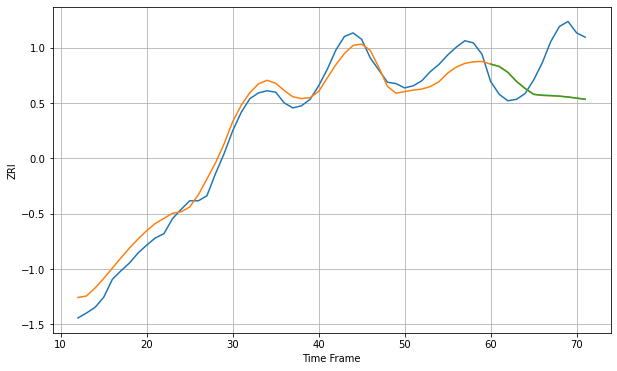

Wall time: 6.98 s
98103 17.396679017589676 64.11073373988758 63.94177239478754 [1915.34864309 1911.97944402 1903.78949273 1891.22322862 1881.33931062
 1873.12242762 1871.73092213 1871.29031533 1870.51822493 1869.36824134
 1867.77643523 1866.29243512]

Got an mse at 0.0050 in round 124 and stopped training

60 60 12


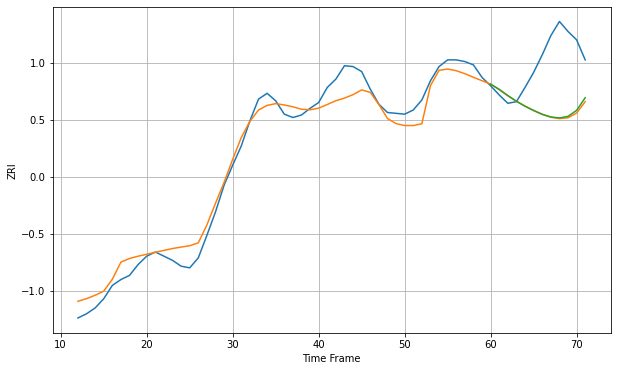

Wall time: 8.02 s
98105 15.54035760734188 65.64093302320003 64.61391935348838 [1820.9965968  1814.60047962 1807.19322217 1800.47082583 1794.54946277
 1789.4026693  1784.86242333 1781.68190237 1780.4640588  1782.38262615
 1789.57237727 1804.72268599]

Got an mse at 0.0050 in round 158 and stopped training

60 60 12


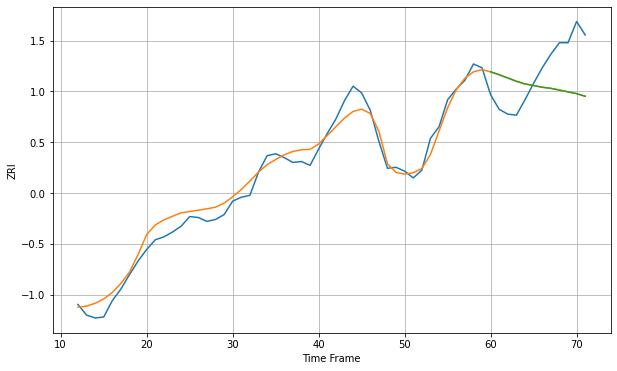

Wall time: 8.73 s
98107 10.851609916311125 41.85565551172707 41.828919281997074 [1959.83063459 1956.85279426 1953.46860331 1950.05502755 1947.2883853
 1945.7105186  1943.93426523 1942.76544853 1941.01479214 1939.1202502
 1937.26118023 1934.58882269]

Got an mse at 0.0049 in round 80 and stopped training

60 60 12


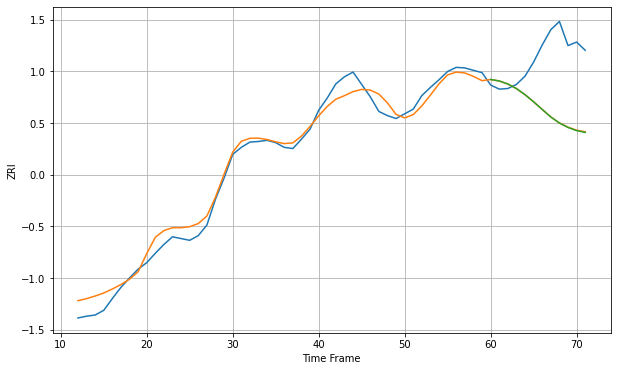

Wall time: 7.05 s
98109 16.79876162064901 104.27944118813922 104.59998582347856 [2069.36338013 2066.87604305 2061.67366512 2053.9484447  2043.56373936
 2031.46297015 2018.41819284 2005.66903495 1995.33520574 1987.80313997
 1982.44830665 1979.39121999]

Got an mse at 0.0050 in round 119 and stopped training

60 60 12


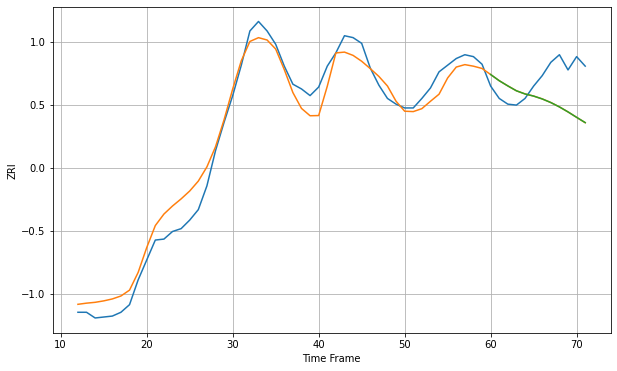

Wall time: 7.98 s
98115 15.974953720760753 36.740792575403695 36.737860514734024 [1850.18678105 1843.65609774 1838.18313937 1833.04169295 1829.72441636
 1827.48332177 1824.47639501 1820.67003301 1816.07911001 1810.82336259
 1805.12757919 1799.57347196]

Got an mse at 0.0050 in round 122 and stopped training

60 60 12


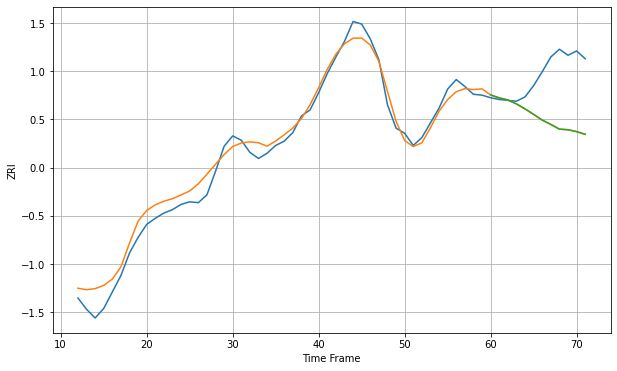

Wall time: 7.68 s
98119 12.997396445425078 59.54838756240056 59.61167585108871 [1895.25924877 1891.87146293 1889.44374954 1884.91140218 1879.15703925
 1872.80646368 1866.26990022 1861.22923075 1855.78575638 1855.0748283
 1852.83627457 1849.79274821]

Got an mse at 0.0050 in round 174 and stopped training

60 60 12


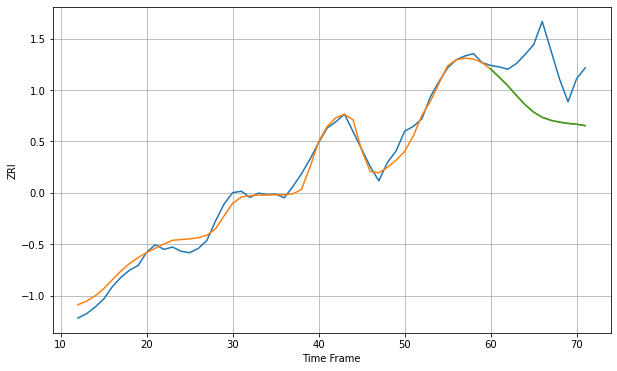

Wall time: 9.42 s
98121 16.672194264189205 106.37374767899414 106.3431994155675 [2304.43357318 2287.11193734 2269.00121585 2248.60040757 2229.17553676
 2213.31530366 2202.3656491  2196.00141231 2192.13003734 2189.54164257
 2187.65320798 2184.75824054]

Got an mse at 0.0050 in round 123 and stopped training

60 60 12


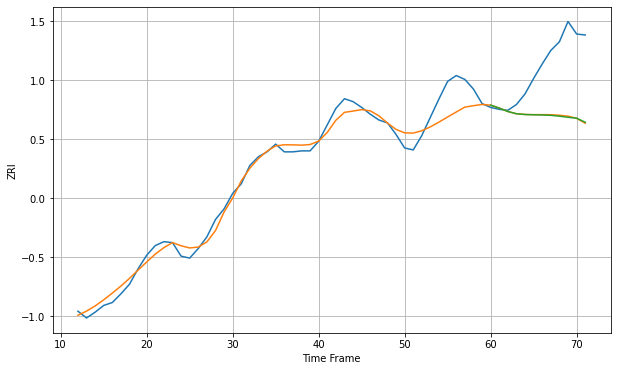

Wall time: 8.14 s
98122 11.963232704758642 58.097944375356526 58.318710325037685 [1891.36040686 1888.33880488 1884.77741951 1882.45247278 1881.67284157
 1881.37841076 1881.17165222 1880.82023339 1879.91519378 1878.79147876
 1877.87321112 1873.64964096]

Got an mse at 0.0050 in round 130 and stopped training

60 60 12


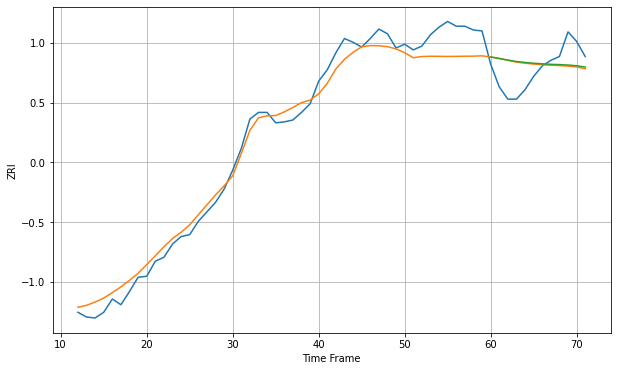

Wall time: 8.42 s
98133 15.14400619206988 24.868442087582455 24.767891050552333 [1738.48972655 1736.97053727 1735.25974922 1733.73653199 1732.72352612
 1731.92345696 1731.28201702 1730.76823552 1730.45252696 1730.00515382
 1729.26101829 1727.88782813]

Got an mse at 0.0050 in round 80 and stopped training

60 60 12


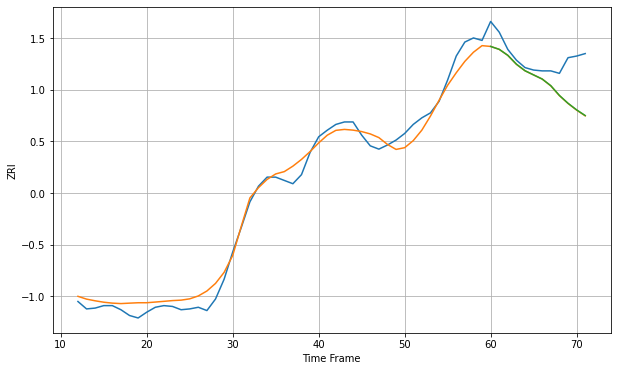

Wall time: 7.17 s
98201 11.861091952276311 36.228758292124375 36.062953132400594 [1463.68199945 1460.14775434 1452.88570466 1442.12617027 1434.15502652
 1429.10250393 1424.07600328 1416.02065332 1404.16819893 1394.68693573
 1386.65972993 1379.78074766]

Got an mse at 0.0050 in round 71 and stopped training

60 60 12


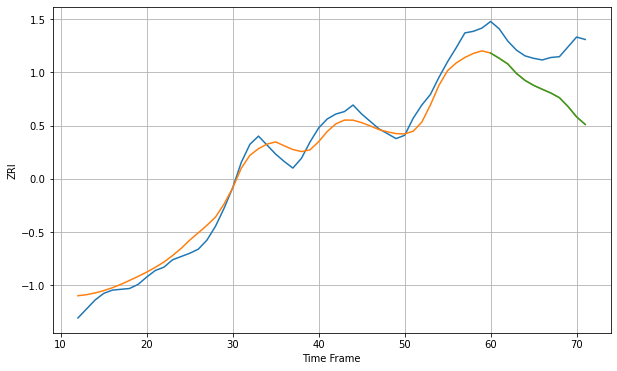

Wall time: 7 s
98203 14.110439413118987 55.95331558060705 55.961922987783446 [1502.39507719 1495.99944192 1488.99534693 1477.4941011  1469.03275709
 1462.95850874 1458.24305338 1453.65994843 1447.95102885 1437.25589953
 1424.48867127 1415.33777549]

Got an mse at 0.0049 in round 78 and stopped training

60 60 12


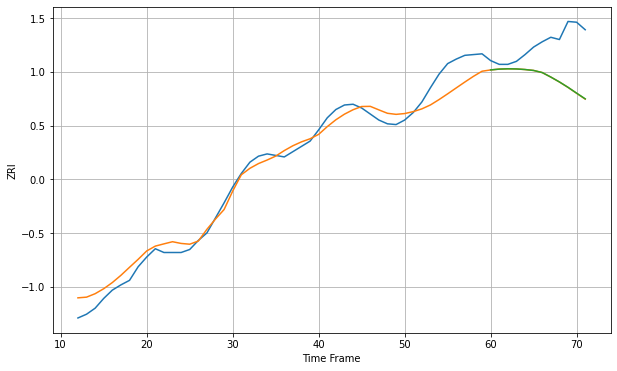

Wall time: 6.84 s
98204 16.040275497527492 53.57271574016552 53.46709112159238 [1429.61987149 1430.68163437 1431.09955338 1430.90402341 1430.13647739
 1428.8894999  1426.09663171 1420.13010738 1413.64164279 1406.50161549
 1398.75604185 1391.18532003]

Got an mse at 0.0049 in round 53 and stopped training

60 60 12


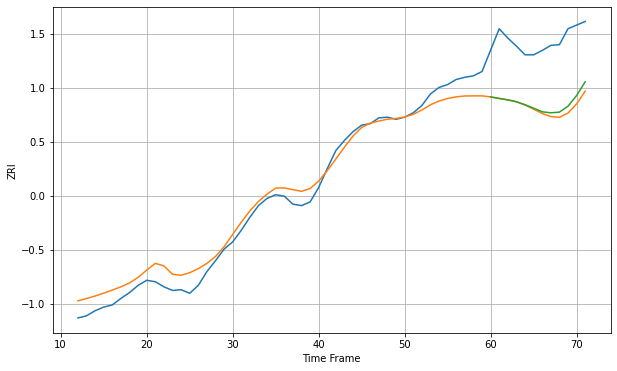

Wall time: 6.24 s
98405 16.574309529246165 90.74921590911866 86.10320397125744 [1207.88627519 1205.80981713 1203.80227513 1201.29044544 1197.1612197
 1192.40774023 1187.37024079 1186.0274432  1186.94964678 1195.07100003
 1209.87094892 1228.88727326]

Got an mse at 0.0049 in round 52 and stopped training

60 60 12


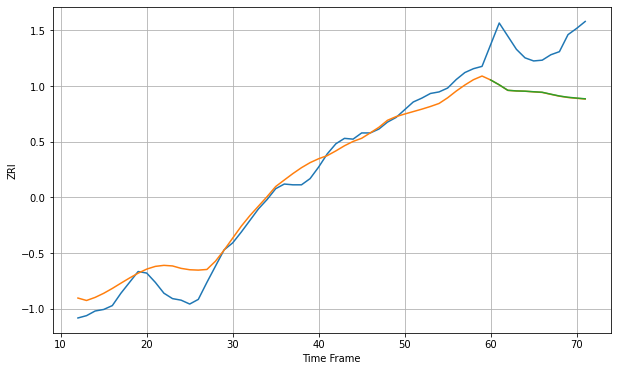

Wall time: 6.67 s
98409 17.67186194945501 65.91472405428081 65.74465070815548 [1248.4388005  1242.1562259  1235.10618777 1234.28627399 1233.95188286
 1233.20968384 1232.54806242 1230.07433568 1227.72645123 1226.09725453
 1225.04010621 1224.09626393]

Got an mse at 0.0050 in round 57 and stopped training

60 60 12


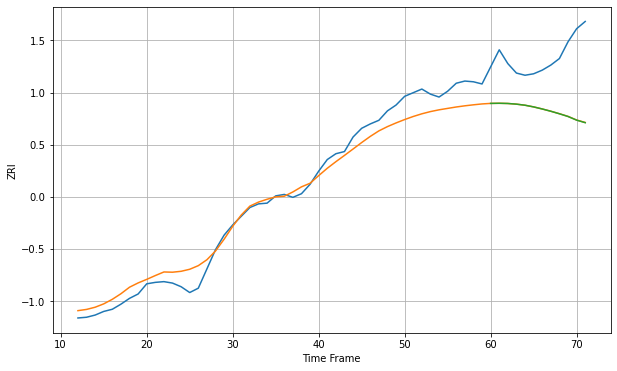

Wall time: 6.4 s
98444 18.207874637281382 78.96547011518649 79.05803989841498 [1199.25316249 1199.42236256 1199.15145779 1198.2288388  1196.73519511
 1194.42658878 1191.58178164 1188.44805287 1184.98213137 1181.23778742
 1176.24112135 1172.71692267]

Got an mse at 0.0049 in round 72 and stopped training

60 60 12


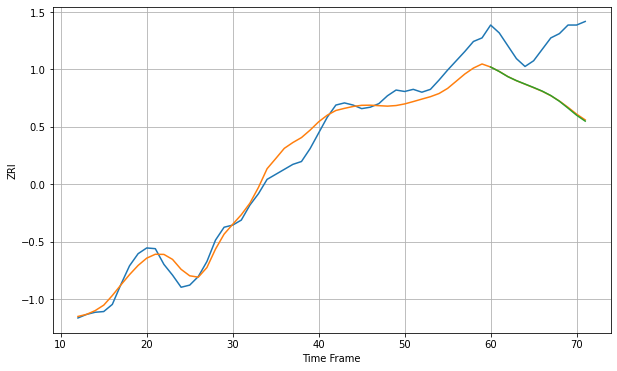

Wall time: 7.25 s
98466 17.43853349508924 80.56987350957095 81.13974468091303 [1352.23653032 1345.98423943 1338.77620419 1333.18546184 1328.37008616
 1323.57226408 1318.51997025 1312.31562422 1304.33080671 1294.72159303
 1284.76916626 1276.49831528]

Got an mse at 0.0050 in round 84 and stopped training

60 60 12


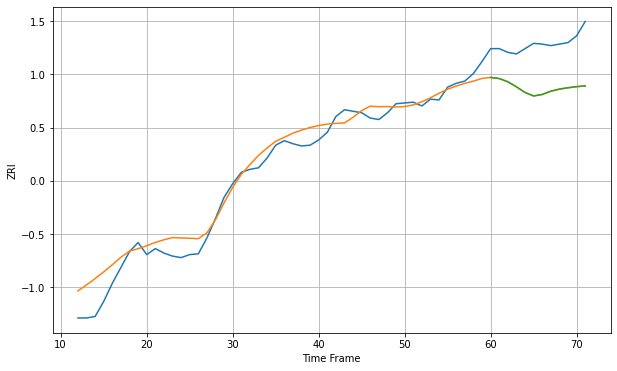

Wall time: 7.13 s
98498 17.66661939837928 59.10029257835878 58.954592046962276 [1364.84952602 1363.36440803 1359.08795506 1352.38979284 1344.8476239
 1340.30056221 1342.28626237 1346.70598636 1349.4830857  1351.2830767
 1352.67705836 1353.56735386]

Got an mse at 0.0050 in round 93 and stopped training

60 60 12


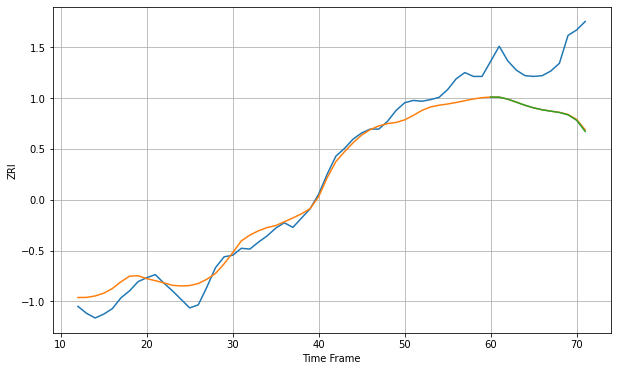

Wall time: 7.66 s
98499 16.207011712131774 74.00743438532211 74.56297665775065 [1253.35269205 1253.22522553 1250.63418724 1246.71541021 1242.75221992
 1239.44881723 1236.91692586 1235.11614034 1233.42426849 1230.37711268
 1223.35354632 1208.88707017]

Got an mse at 0.0050 in round 124 and stopped training

60 60 12


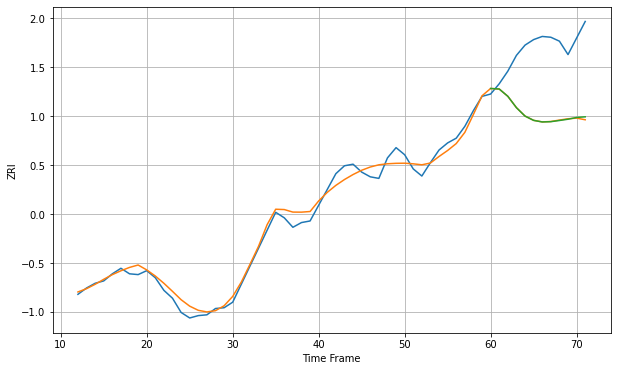

Wall time: 8.02 s
99207 9.342461268336285 86.46925312271587 86.0813671302191 [1036.0206634  1035.33642818 1026.09930446 1011.6965957  1001.0277556
  995.57984149  993.5625721   993.927869    995.41471101  997.03585464
  999.2709631  1000.07580265]

Got an mse at 0.0049 in round 197 and stopped training

60 60 12


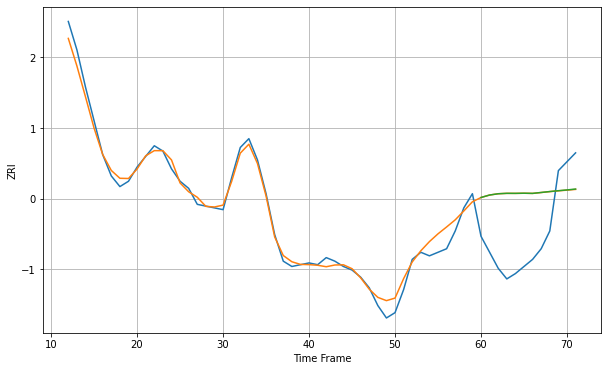

Wall time: 9.76 s
99501 4.586721398996611 32.95144956082882 32.940971725162434 [1264.86148798 1266.2476465  1266.96928093 1267.2007749  1267.18045921
 1267.26604341 1267.16993032 1267.6847127  1268.2127313  1268.68260184
 1269.12013881 1269.61920221]

Got an mse at 0.0050 in round 325 and stopped training

60 60 12


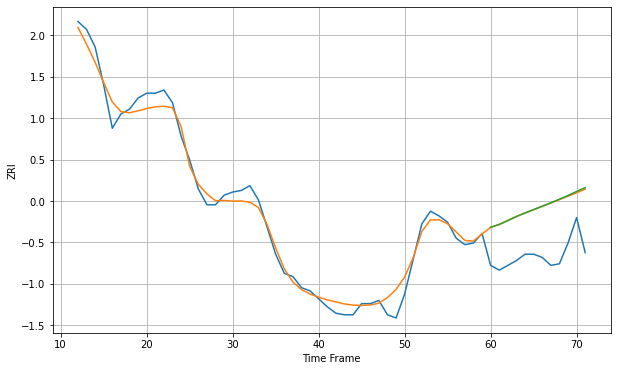

Wall time: 13.1 s
99504 6.427407407796282 30.623698522492987 30.86557158208202 [1439.84967463 1441.66955997 1444.14267168 1446.66411782 1448.86651426
 1450.99487972 1453.12123205 1455.26972098 1457.4927071  1459.8483578
 1462.35608539 1464.73522272]

Got an mse at 0.0050 in round 198 and stopped training

60 60 12


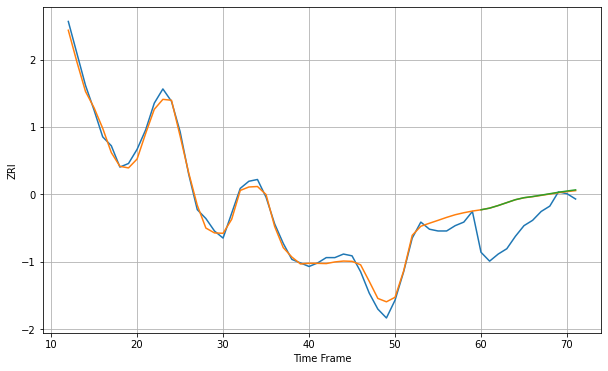

Wall time: 10.4 s
99508 3.80243836411771 17.994669304159782 18.030942281991006 [1279.93523532 1280.86644714 1282.32838606 1283.98027178 1285.62256144
 1286.74942195 1287.39553646 1288.17841627 1288.98413418 1289.7940137
 1290.50496543 1291.1536063 ]

Got an mse at 0.0050 in round 285 and stopped training

60 60 12


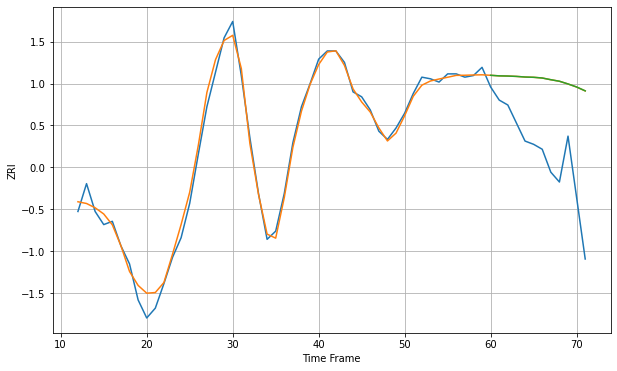

Wall time: 12.3 s
99654 4.98729331027069 49.617516764031215 49.636511977614084 [1336.14516128 1335.78814787 1335.68568489 1335.46484596 1335.0870293
 1334.91889564 1334.49013772 1333.44513577 1332.51543893 1330.85916811
 1329.01554566 1326.64270196]


In [13]:
score_dict = {"zip":[], "RMSE_train":[], "RMSE_test":[], "RMSE_pure":[], "forecast":[]};
with tf.device('/cpu:0'):
    for ZONE in zip_ids:
        %time M_train, M_test, M_pure, forecast = NN_test(ZONE, plot=True);
        print(ZONE, M_train, M_test, M_pure, forecast);

        score_dict["zip"].append(ZONE);
        score_dict["RMSE_train"].append(M_train);
        score_dict["RMSE_test"].append(M_test);
        score_dict["RMSE_pure"].append(M_pure);
        score_dict["forecast"].append(forecast);

In [14]:
print(len(score_dict["RMSE_pure"]), sum(score_dict["RMSE_test"])/len(score_dict["RMSE_test"]),
      sum(score_dict["RMSE_pure"])/len(score_dict["RMSE_pure"]));

1301 62.09389600365879 62.03311141282013


In [15]:
test = pd.DataFrame(score_dict);
test.head()

,zip,RMSE_train,RMSE_test,RMSE_pure,forecast
0,1013,7.381646,73.010080,73.192353,"[1087.0556975843444, 1081.8584133124405, 1076...."
1,1020,10.586569,72.974924,73.418510,"[1115.965909337196, 1112.6408955737102, 1110.5..."
2,1040,7.415311,55.513778,55.371281,"[1091.9127567339547, 1086.6707855502602, 1083...."
3,1085,8.211525,61.786702,61.640786,"[1157.6387713569884, 1153.185003763619, 1148.3..."
4,1104,8.347810,49.313595,49.558641,"[1115.8716280303192, 1112.8587876280133, 1109...."


In [16]:
test.to_csv('NN_feature_window_12_overfit.csv', index = False)